# Convert XML to CSV

In [1]:
import os
from PIL import Image
import random
import numpy as np

In [2]:
# modify the directories and class file to fit
datapath = '/home/philong/Desktop/Khang_food/dataset/FOOD256/UECFOOD256'
labelpath = 'labels'
classfilename = '/home/philong/Desktop/Khang_food/Food_Detection/food256.names'


In [7]:
xml_train_list = []
xml_test_list = []
xml_foodonly_list = []
def convert_yolo_bbox(img_size, box):
    # img_bbox file is [0:img] [1:left X] [2:bottom Y] [3:right X] [4:top Y]
    dw = 1./img_size[0]
    dh = 1./img_size[1]
    x = (int(box[1]) + int(box[3]))/2.0
    y = (int(box[2]) + int(box[4]))/2.0
    w = abs(int(box[3]) - int(box[1]))
    h = abs(int(box[4]) - int(box[2]))
    x = x*dw
    w = w*dw
    y = y*dh
    h = h*dh
    # Yolo bbox is center x, y and width, height
    return (x,y,w,h)

def generate_bbox_file(datapath, labelpath, classid, classname):
    dataDir = os.path.join(datapath, str(classid))
    labelDir = os.path.join(labelpath, str(classid))
    bb_filename = os.path.join(dataDir, 'bb_info.txt')
    if not os.path.exists(labelDir):
        os.makedirs(labelDir)
    with open(bb_filename) as fp:
        for line in fp.readlines():
            # img_bbox file is [0:img] [1:left X] [2:bottom Y] [3:right X] [4:top Y]
            img_bbox = line.strip('\n').split(' ')
            if img_bbox[0] != 'img':
                img_bbox_filename = os.path.join(dataDir, img_bbox[0]+'.txt')
#                 with open(img_bbox_filename, 'w') as f:
#                     # [number of bbox]
#                     # [left X] [top Y] [right X] [bottom Y] [class name]
#                     f.write('1\n')
#                     f.write('%s %s %s %s %s\n' %(img_bbox[1], img_bbox[4], img_bbox[3], img_bbox[2], classname))
#                     f.close()

                image_filename = os.path.join(dataDir, img_bbox[0]+'.jpg')
                yolo_label_filename = os.path.join(labelDir, img_bbox[0]+'.txt')
                img = Image.open(image_filename)
#                 with open(yolo_label_filename, 'w') as f:
#                     img = Image.open(image_filename)
#                     yolo_bbox = convert_yolo_bbox(img.size, img_bbox)
#                     if (yolo_bbox[2] > 1) or (yolo_bbox[3] > 1):
#                         print("image %s bbox is " %(image_filename) + ' '.join(map(str, yolo_bbox)))
#                     f.write(str(classid-1) + ' ' + ' '.join(map(str, yolo_bbox)) + '\n')
#                     img.close()
#                     f.close()
                #############################################
                xmin = int(img_bbox[1])
                ymin = int(img_bbox[2])
                xmax = int(img_bbox[3])
                ymax = int(img_bbox[4])
                
                value = (image_filename,
                 int(img.size[0]),
                 int(img.size[1]),
                 'food',
                 xmin,
                 ymin,
                 xmax,
                 ymax
                 )
                img.close() 
                #xml_foodonly_list.append(value)

                train_or_test = random.randint(1,10)
                if train_or_test >2:
                    xml_foodonly_list.append(value)
                    xml_train_list.append(value)
                else:
                    xml_test_list.append(value)
#                     if random.randint(1,10) < 8 and coco_count < len(coco_list):
#                         img = Image.open(coco_list[coco_count])
#                         value = (coco_list[coco_count],
#                              int(img.size[0]),
#                              int(img.size[1]),
#                              'no',
#                              None,
#                              None,
#                              None,
#                              None
#                              )
#                         coco_count = coco_count + 1 
#                         xml_train_list.append(value)
#                         img.close()
        fp.close()

In [8]:
classid = 0
classid2name = {}
if os.path.exists(classfilename):
    with open(classfilename) as cf:
        for line in cf.readlines():
            classname = line.strip('\n')
            classid = classid + 1
            classid2name[classid] = classname

for id in classid2name.keys():
    print("generating %d %s" %(id, classid2name[id]))
    generate_bbox_file(datapath, labelpath, id, classid2name[id])
print(len(xml_foodonly_list))

generating 1 rice
generating 2 eels on rice
generating 3 pilaf
generating 4 chicken-'n'-egg on rice
generating 5 pork cutlet on rice
generating 6 beef curry
generating 7 sushi
generating 8 chicken rice
generating 9 fried rice
generating 10 tempura bowl
generating 11 bibimbap
generating 12 toast
generating 13 croissant
generating 14 roll bread
generating 15 raisin bread
generating 16 chip butty
generating 17 hamburger
generating 18 pizza
generating 19 sandwiches
generating 20 udon noodle
generating 21 tempura udon
generating 22 soba noodle
generating 23 ramen noodle
generating 24 beef noodle
generating 25 tensin noodle
generating 26 fried noodle
generating 27 spaghetti
generating 28 Japanese-style pancake
generating 29 takoyaki
generating 30 gratin
generating 31 sauteed vegetables
generating 32 croquette
generating 33 grilled eggplant
generating 34 sauteed spinach
generating 35 vegetable tempura
generating 36 miso soup
generating 37 potage
generating 38 sausage
generating 39 oden
genera

6254 25391 25391


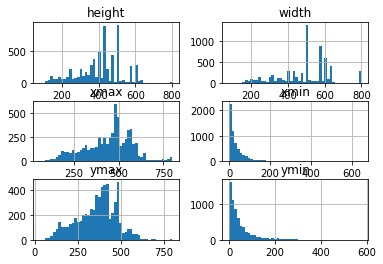

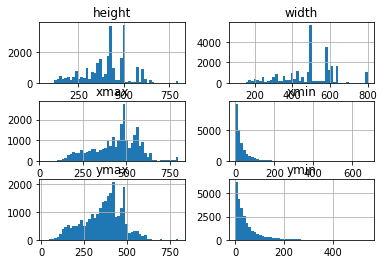

In [16]:
print(len(xml_test_list),len(xml_train_list),len(xml_foodonly_list))
#for i in xml_foodonly_list:
#    print(i)

column_name = ['filename', 'width', 'height', 'class', 'xmin', 'ymin', 'xmax', 'ymax']
test_khang = pd.DataFrame(xml_test_list, columns=column_name)
train_khang = pd.DataFrame(xml_train_list, columns=column_name)
hist = test_khang.hist(bins=50)
hist = train_khang.hist(bins=50)

In [10]:
def get_concat_hv_blank(im1, im2 , im3 , im4, bbox_list, color=(255, 255, 255)):
    ## 1 -> 2
    ## 3 -> 4
    bbox_temp = []
    im_start  = []
    index = []
    dst = Image.new('RGB', (max(im1.width + im2.width ,im3.width + im4.width) , max(im1.height + im3.height, im2.height + im4.height )), color)
    im_start.append((0                            , 0                           ))
    im_start.append(( max( im1.width, im3.width)  , 0                           ))
    im_start.append((0                            , max( im1.height, im2.height)))
    im_start.append(( max( im1.width, im3.width)  , max( im1.height, im2.height)))
    dst.paste(im1, im_start[0])
    dst.paste(im2, im_start[1])
    dst.paste(im3, im_start[2])
    dst.paste(im4, im_start[3])
    
    for im_star in im_start:
        index.append(np.concatenate((np.array(im_star), np.array(im_star)), axis=0))
        #print(index)
    for idx, bbox in enumerate(bbox_list):
        bbox_temp.append( index[idx] +  np.array(bbox_list[idx]) )
    return dst , bbox_temp

random.shuffle(xml_foodonly_list)   

In [11]:
#Extend 4 food in a image
xml_train_extend_4 = []
xml_test_extend_4 = []
food_extend_path = '/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/'
for idx in range(len(xml_foodonly_list)):
    if (idx + 1 )% 4 == 0:
        im  = []
        box = []
        for i in range(4):
            im.append(Image.open(xml_foodonly_list[idx-i][0]))
            box.append([xml_foodonly_list[idx-i][4],xml_foodonly_list[idx-i][5],xml_foodonly_list[idx-i][6],xml_foodonly_list[idx-i][7]])
        dist,bbox = get_concat_hv_blank(im[0],im[1],im[2],im[3],box)
        dist.save(food_extend_path+str(idx)+'.jpg')
#         fig,ax = plt.subplots(1)
#         ax.imshow(dist)
        for box in bbox:
            xmin = int(box[0])
            ymin = int(box[1])
            xmax = int(box[2])
            ymax = int(box[3])
            value = (food_extend_path+str(idx)+'.jpg',
                 int(dist.size[0]),
                 int(dist.size[1]),
                 'food',
                 xmin,
                 ymin,
                 xmax,
                 ymax
                 )
            train_or_test = random.randint(1,10)
            print(idx,'/',value)
            if train_or_test >2:
                xml_train_extend_4.append(value)
            else:
                xml_test_extend_4.append(value)

3 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/3.jpg', 1400, 888, 'food', 24, 30, 579, 380)
3 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/3.jpg', 1400, 888, 'food', 845, 12, 1100, 180)
3 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/3.jpg', 1400, 888, 'food', 233, 458, 376, 553)
3 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/3.jpg', 1400, 888, 'food', 820, 408, 1328, 753)
7 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7.jpg', 1110, 769, 'food', 31, 45, 457, 422)
7 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7.jpg', 1110, 769, 'food', 528, 56, 1081, 393)
7 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7.jpg', 1110, 769, 'food', 33, 516, 373, 732)
7 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7.jpg', 1110, 769, 'food', 549, 521, 902, 813)
11 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/11.jpg', 1140, 932, 'food', 225, 43, 485, 284)
11 /

83 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/83.jpg', 1189, 888, 'food', 5, 6, 389, 444)
83 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/83.jpg', 1189, 888, 'food', 660, 33, 997, 320)
83 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/83.jpg', 1189, 888, 'food', 32, 505, 594, 872)
83 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/83.jpg', 1189, 888, 'food', 700, 532, 1124, 871)
87 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/87.jpg', 1000, 860, 'food', 14, 18, 310, 240)
87 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/87.jpg', 1000, 860, 'food', 622, 84, 952, 304)
87 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/87.jpg', 1000, 860, 'food', 71, 455, 407, 795)
87 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/87.jpg', 1000, 860, 'food', 512, 385, 985, 841)
91 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/91.jpg', 1177, 846, 'food', 415, 31, 576

159 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/159.jpg', 879, 980, 'food', 20, 35, 468, 443)
159 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/159.jpg', 879, 980, 'food', 500, 52, 833, 387)
159 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/159.jpg', 879, 980, 'food', 0, 547, 377, 779)
159 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/159.jpg', 879, 980, 'food', 516, 540, 970, 964)
163 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/163.jpg', 1120, 980, 'food', 1, 12, 351, 383)
163 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/163.jpg', 1120, 980, 'food', 641, 60, 980, 315)
163 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/163.jpg', 1120, 980, 'food', 108, 601, 509, 926)
163 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/163.jpg', 1120, 980, 'food', 712, 510, 1085, 794)
167 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/167.jpg', 1120, 785, 'food

231 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/231.jpg', 1217, 855, 'food', 68, 30, 515, 353)
231 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/231.jpg', 1217, 855, 'food', 589, 186, 819, 436)
231 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/231.jpg', 1217, 855, 'food', 12, 539, 270, 653)
231 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/231.jpg', 1217, 855, 'food', 580, 530, 1077, 849)
235 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/235.jpg', 1229, 950, 'food', 34, 21, 522, 395)
235 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/235.jpg', 1229, 950, 'food', 652, 27, 1114, 483)
235 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/235.jpg', 1229, 950, 'food', 15, 513, 583, 888)
235 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/235.jpg', 1229, 950, 'food', 965, 601, 1227, 840)
239 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/239.jpg', 1140, 90

307 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/307.jpg', 1073, 913, 'food', 102, 75, 409, 337)
307 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/307.jpg', 1073, 913, 'food', 723, 71, 995, 237)
307 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/307.jpg', 1073, 913, 'food', 0, 433, 640, 913)
307 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/307.jpg', 1073, 913, 'food', 665, 493, 1052, 954)
311 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/311.jpg', 1000, 766, 'food', 22, 17, 266, 273)
311 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/311.jpg', 1000, 766, 'food', 532, 16, 1066, 409)
311 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/311.jpg', 1000, 766, 'food', 28, 450, 479, 784)
311 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/311.jpg', 1000, 766, 'food', 557, 451, 968, 745)
315 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/315.jpg', 755, 823, 

383 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/383.jpg', 1240, 855, 'food', 84, 33, 548, 440)
383 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/383.jpg', 1240, 855, 'food', 1011, 125, 1218, 287)
383 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/383.jpg', 1240, 855, 'food', 36, 489, 475, 855)
383 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/383.jpg', 1240, 855, 'food', 640, 480, 940, 772)
387 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/387.jpg', 1098, 792, 'food', 0, 0, 197, 148)
387 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/387.jpg', 1098, 792, 'food', 509, 6, 990, 365)
387 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/387.jpg', 1098, 792, 'food', 28, 437, 468, 825)
387 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/387.jpg', 1098, 792, 'food', 522, 387, 1053, 738)
391 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/391.jpg', 980, 718, '

455 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/455.jpg', 1140, 980, 'food', 34, 10, 558, 366)
455 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/455.jpg', 1140, 980, 'food', 630, 29, 1041, 481)
455 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/455.jpg', 1140, 980, 'food', 71, 535, 431, 822)
455 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/455.jpg', 1140, 980, 'food', 612, 644, 860, 882)
459 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/459.jpg', 1100, 784, 'food', 96, 70, 415, 238)
459 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/459.jpg', 1100, 784, 'food', 611, 10, 988, 286)
459 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/459.jpg', 1100, 784, 'food', 46, 335, 543, 767)
459 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/459.jpg', 1100, 784, 'food', 790, 488, 1038, 635)
463 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/463.jpg', 1151, 906,

527 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/527.jpg', 928, 1057, 'food', 154, 183, 219, 262)
527 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/527.jpg', 928, 1057, 'food', 300, 246, 508, 454)
527 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/527.jpg', 928, 1057, 'food', 81, 517, 244, 663)
527 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/527.jpg', 928, 1057, 'food', 304, 499, 722, 1035)
531 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/531.jpg', 1000, 800, 'food', 25, 12, 496, 475)
531 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/531.jpg', 1000, 800, 'food', 536, 88, 699, 295)
531 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/531.jpg', 1000, 800, 'food', 4, 512, 304, 779)
531 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/531.jpg', 1000, 800, 'food', 526, 579, 981, 931)
535 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/535.jpg', 1154, 933

599 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/599.jpg', 1377, 913, 'food', 0, 27, 230, 173)
599 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/599.jpg', 1377, 913, 'food', 880, 148, 1026, 276)
599 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/599.jpg', 1377, 913, 'food', 396, 676, 711, 988)
599 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/599.jpg', 1377, 913, 'food', 807, 505, 1369, 898)
603 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/603.jpg', 1040, 908, 'food', 54, 58, 342, 204)
603 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/603.jpg', 1040, 908, 'food', 463, 39, 920, 360)
603 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/603.jpg', 1040, 908, 'food', 13, 520, 375, 713)
603 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/603.jpg', 1040, 908, 'food', 400, 584, 678, 890)
607 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/607.jpg', 1045, 101

671 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/671.jpg', 1140, 913, 'food', 0, 180, 364, 472)
671 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/671.jpg', 1140, 913, 'food', 657, 102, 1113, 462)
671 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/671.jpg', 1140, 913, 'food', 21, 514, 560, 907)
671 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/671.jpg', 1140, 913, 'food', 643, 512, 932, 793)
675 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/675.jpg', 1078, 1112, 'food', 11, 252, 369, 589)
675 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/675.jpg', 1078, 1112, 'food', 500, 0, 670, 134)
675 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/675.jpg', 1078, 1112, 'food', 4, 624, 485, 1099)
675 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/675.jpg', 1078, 1112, 'food', 527, 642, 1050, 1038)
679 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/679.jpg', 1100

743 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/743.jpg', 1217, 913, 'food', 496, 156, 640, 430)
743 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/743.jpg', 1217, 913, 'food', 701, 51, 1061, 328)
743 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/743.jpg', 1217, 913, 'food', 54, 523, 567, 853)
743 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/743.jpg', 1217, 913, 'food', 737, 605, 1212, 872)
747 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/747.jpg', 1140, 933, 'food', 10, 29, 485, 477)
747 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/747.jpg', 1140, 933, 'food', 729, 180, 1153, 384)
747 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/747.jpg', 1140, 933, 'food', 3, 501, 573, 931)
747 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/747.jpg', 1140, 933, 'food', 596, 503, 1048, 859)
751 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/751.jpg', 1155, 

819 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/819.jpg', 1100, 1027, 'food', 25, 96, 412, 521)
819 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/819.jpg', 1100, 1027, 'food', 618, 28, 1135, 418)
819 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/819.jpg', 1100, 1027, 'food', 60, 604, 547, 988)
819 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/819.jpg', 1100, 1027, 'food', 620, 631, 1092, 942)
823 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/823.jpg', 1412, 888, 'food', 551, 181, 800, 400)
823 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/823.jpg', 1412, 888, 'food', 817, 74, 1280, 368)
823 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/823.jpg', 1412, 888, 'food', 0, 508, 350, 713)
823 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/823.jpg', 1412, 888, 'food', 960, 559, 1036, 642)
827 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/827.jpg', 100

891 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/891.jpg', 1166, 894, 'food', 128, 109, 579, 358)
891 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/891.jpg', 1166, 894, 'food', 608, 14, 1136, 398)
891 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/891.jpg', 1166, 894, 'food', 9, 435, 498, 795)
891 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/891.jpg', 1166, 894, 'food', 617, 444, 1084, 849)
895 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/895.jpg', 993, 1057, 'food', 4, 9, 422, 560)
895 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/895.jpg', 993, 1057, 'food', 435, 3, 990, 414)
895 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/895.jpg', 993, 1057, 'food', 0, 680, 360, 1000)
895 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/895.jpg', 993, 1057, 'food', 471, 581, 693, 755)
899 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/899.jpg', 1140, 980, '

967 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/967.jpg', 1113, 887, 'food', 6, 108, 493, 450)
967 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/967.jpg', 1113, 887, 'food', 551, 35, 1082, 381)
967 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/967.jpg', 1113, 887, 'food', 0, 500, 352, 788)
967 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/967.jpg', 1113, 887, 'food', 944, 506, 1130, 644)
971 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/971.jpg', 1381, 1007, 'food', 15, 12, 476, 489)
971 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/971.jpg', 1381, 1007, 'food', 646, 30, 1155, 366)
971 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/971.jpg', 1381, 1007, 'food', 79, 528, 515, 847)
971 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/971.jpg', 1381, 1007, 'food', 581, 500, 1381, 1100)
975 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/975.jpg', 1140

1039 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/1039.jpg', 1380, 1177, 'food', 0, 337, 240, 600)
1039 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/1039.jpg', 1380, 1177, 'food', 821, 3, 1369, 399)
1039 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/1039.jpg', 1380, 1177, 'food', 4, 607, 428, 1172)
1039 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/1039.jpg', 1380, 1177, 'food', 829, 697, 1226, 1091)
1043 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/1043.jpg', 851, 915, 'food', 45, 38, 572, 376)
1043 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/1043.jpg', 851, 915, 'food', 634, 0, 801, 188)
1043 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/1043.jpg', 851, 915, 'food', 18, 435, 484, 900)
1043 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/1043.jpg', 851, 915, 'food', 601, 415, 781, 550)
1047 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/1047

1115 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/1115.jpg', 980, 1000, 'food', 12, 18, 462, 487)
1115 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/1115.jpg', 980, 1000, 'food', 500, 0, 800, 225)
1115 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/1115.jpg', 980, 1000, 'food', 107, 633, 496, 937)
1115 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/1115.jpg', 980, 1000, 'food', 703, 900, 799, 1012)
1119 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/1119.jpg', 1189, 933, 'food', 82, 25, 577, 372)
1119 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/1119.jpg', 1189, 933, 'food', 637, 10, 1012, 409)
1119 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/1119.jpg', 1189, 933, 'food', 0, 433, 145, 553)
1119 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/1119.jpg', 1189, 933, 'food', 638, 510, 1094, 849)
1123 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/112

1187 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/1187.jpg', 1112, 875, 'food', 72, 44, 543, 360)
1187 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/1187.jpg', 1112, 875, 'food', 643, 64, 1074, 422)
1187 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/1187.jpg', 1112, 875, 'food', 42, 500, 412, 860)
1187 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/1187.jpg', 1112, 875, 'food', 743, 600, 1112, 875)
1191 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/1191.jpg', 1077, 894, 'food', 3, 52, 474, 408)
1191 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/1191.jpg', 1077, 894, 'food', 585, 52, 830, 196)
1191 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/1191.jpg', 1077, 894, 'food', 5, 470, 537, 866)
1191 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/1191.jpg', 1077, 894, 'food', 584, 506, 1037, 913)
1195 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/1195

1263 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/1263.jpg', 1032, 1155, 'food', 10, 41, 476, 489)
1263 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/1263.jpg', 1032, 1155, 'food', 612, 139, 978, 468)
1263 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/1263.jpg', 1032, 1155, 'food', 367, 632, 508, 754)
1263 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/1263.jpg', 1032, 1155, 'food', 612, 601, 1021, 1130)
1267 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/1267.jpg', 720, 646, 'food', 12, 33, 151, 123)
1267 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/1267.jpg', 720, 646, 'food', 532, 18, 975, 481)
1267 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/1267.jpg', 720, 646, 'food', 25, 520, 495, 958)
1267 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/1267.jpg', 720, 646, 'food', 501, 501, 720, 646)
1271 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/1

1335 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/1335.jpg', 1140, 776, 'food', 16, 48, 585, 379)
1335 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/1335.jpg', 1140, 776, 'food', 648, 30, 1102, 367)
1335 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/1335.jpg', 1140, 776, 'food', 12, 474, 260, 609)
1335 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/1335.jpg', 1140, 776, 'food', 602, 465, 999, 612)
1339 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/1339.jpg', 1154, 913, 'food', 30, 16, 555, 406)
1339 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/1339.jpg', 1154, 913, 'food', 635, 18, 1167, 393)
1339 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/1339.jpg', 1154, 913, 'food', 133, 460, 606, 664)
1339 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/1339.jpg', 1154, 913, 'food', 618, 433, 972, 913)
1343 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/13

1407 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/1407.jpg', 1081, 995, 'food', 10, 4, 496, 495)
1407 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/1407.jpg', 1081, 995, 'food', 584, 16, 1061, 487)
1407 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/1407.jpg', 1081, 995, 'food', 5, 503, 569, 922)
1407 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/1407.jpg', 1081, 995, 'food', 581, 510, 1069, 962)
1411 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/1411.jpg', 1047, 1189, 'food', 6, 25, 400, 563)
1411 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/1411.jpg', 1047, 1189, 'food', 581, 31, 1019, 343)
1411 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/1411.jpg', 1047, 1189, 'food', 28, 688, 399, 1095)
1411 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/1411.jpg', 1047, 1189, 'food', 545, 710, 694, 834)
1415 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/

1483 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/1483.jpg', 1231, 980, 'food', 0, 70, 449, 439)
1483 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/1483.jpg', 1231, 980, 'food', 595, 12, 1086, 472)
1483 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/1483.jpg', 1231, 980, 'food', 12, 589, 491, 964)
1483 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/1483.jpg', 1231, 980, 'food', 607, 625, 1040, 958)
1487 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/1487.jpg', 1140, 875, 'food', 36, 36, 280, 206)
1487 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/1487.jpg', 1140, 875, 'food', 665, 43, 861, 228)
1487 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/1487.jpg', 1140, 875, 'food', 2, 378, 636, 714)
1487 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/1487.jpg', 1140, 875, 'food', 644, 402, 1116, 858)
1491 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/1491

1559 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/1559.jpg', 1100, 882, 'food', 325, 78, 600, 336)
1559 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/1559.jpg', 1100, 882, 'food', 772, 15, 1100, 245)
1559 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/1559.jpg', 1100, 882, 'food', 9, 455, 559, 874)
1559 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/1559.jpg', 1100, 882, 'food', 629, 457, 857, 634)
1563 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/1563.jpg', 850, 911, 'food', 47, 87, 310, 263)
1563 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/1563.jpg', 850, 911, 'food', 398, 66, 656, 260)
1563 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/1563.jpg', 850, 911, 'food', 10, 366, 320, 590)
1563 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/1563.jpg', 850, 911, 'food', 352, 362, 777, 911)
1567 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/1567.jpg

1635 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/1635.jpg', 1300, 1007, 'food', 45, 25, 603, 354)
1635 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/1635.jpg', 1300, 1007, 'food', 829, 27, 1287, 475)
1635 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/1635.jpg', 1300, 1007, 'food', 186, 500, 493, 795)
1635 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/1635.jpg', 1300, 1007, 'food', 834, 514, 1284, 839)
1639 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/1639.jpg', 1240, 913, 'food', 31, 12, 254, 210)
1639 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/1639.jpg', 1240, 913, 'food', 612, 9, 1167, 418)
1639 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/1639.jpg', 1240, 913, 'food', 54, 454, 592, 872)
1639 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/1639.jpg', 1240, 913, 'food', 600, 433, 1240, 913)
1643 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_e

1711 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/1711.jpg', 1077, 933, 'food', 28, 21, 510, 427)
1711 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/1711.jpg', 1077, 933, 'food', 592, 10, 1061, 335)
1711 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/1711.jpg', 1077, 933, 'food', 48, 508, 464, 897)
1711 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/1711.jpg', 1077, 933, 'food', 609, 474, 1083, 789)
1715 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/1715.jpg', 1027, 808, 'food', 119, 0, 450, 252)
1715 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/1715.jpg', 1027, 808, 'food', 498, 16, 1001, 413)
1715 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/1715.jpg', 1027, 808, 'food', 0, 434, 200, 633)
1715 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/1715.jpg', 1027, 808, 'food', 456, 480, 900, 783)
1719 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/171

1783 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/1783.jpg', 1060, 825, 'food', 25, 41, 184, 110)
1783 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/1783.jpg', 1060, 825, 'food', 680, 62, 1168, 462)
1783 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/1783.jpg', 1060, 825, 'food', 0, 480, 600, 901)
1783 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/1783.jpg', 1060, 825, 'food', 607, 501, 1007, 805)
1787 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/1787.jpg', 1044, 958, 'food', 2, 47, 376, 338)
1787 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/1787.jpg', 1044, 958, 'food', 543, 24, 633, 360)
1787 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/1787.jpg', 1044, 958, 'food', 4, 394, 427, 905)
1787 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/1787.jpg', 1044, 958, 'food', 449, 395, 1030, 777)
1791 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/1791.

1855 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/1855.jpg', 1140, 1077, 'food', 12, 60, 426, 557)
1855 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/1855.jpg', 1140, 1077, 'food', 562, 54, 1087, 357)
1855 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/1855.jpg', 1140, 1077, 'food', 18, 599, 490, 1039)
1855 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/1855.jpg', 1140, 1077, 'food', 510, 600, 1104, 941)
1859 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/1859.jpg', 1112, 783, 'food', 34, 6, 571, 367)
1859 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/1859.jpg', 1112, 783, 'food', 618, 4, 1107, 472)
1859 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/1859.jpg', 1112, 783, 'food', 43, 515, 493, 806)
1859 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/1859.jpg', 1112, 783, 'food', 665, 534, 791, 621)
1863 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4

1927 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/1927.jpg', 951, 780, 'food', 26, 29, 528, 413)
1927 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/1927.jpg', 951, 780, 'food', 564, 18, 822, 360)
1927 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/1927.jpg', 951, 780, 'food', 66, 420, 463, 757)
1927 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/1927.jpg', 951, 780, 'food', 634, 480, 966, 682)
1931 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/1931.jpg', 937, 866, 'food', 0, 66, 356, 426)
1931 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/1931.jpg', 937, 866, 'food', 368, 24, 669, 194)
1931 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/1931.jpg', 937, 866, 'food', 0, 480, 198, 604)
1931 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/1931.jpg', 937, 866, 'food', 372, 489, 926, 884)
1935 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/1935.jpg', 937,

1999 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/1999.jpg', 1280, 1100, 'food', 0, 96, 162, 204)
1999 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/1999.jpg', 1280, 1100, 'food', 537, 147, 950, 487)
1999 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/1999.jpg', 1280, 1100, 'food', 282, 578, 480, 788)
1999 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/1999.jpg', 1280, 1100, 'food', 1040, 676, 1278, 893)
2003 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2003.jpg', 1012, 840, 'food', 6, 40, 141, 150)
2003 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2003.jpg', 1012, 840, 'food', 400, 1, 965, 426)
2003 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2003.jpg', 1012, 840, 'food', 55, 465, 343, 718)
2003 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2003.jpg', 1012, 840, 'food', 447, 496, 922, 795)
2007 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/

2071 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2071.jpg', 770, 946, 'food', 0, 0, 210, 150)
2071 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2071.jpg', 770, 946, 'food', 332, 55, 735, 369)
2071 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2071.jpg', 770, 946, 'food', 6, 494, 234, 554)
2071 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2071.jpg', 770, 946, 'food', 261, 481, 716, 937)
2075 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2075.jpg', 1039, 898, 'food', 62, 53, 347, 293)
2075 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2075.jpg', 1039, 898, 'food', 553, 130, 816, 193)
2075 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2075.jpg', 1039, 898, 'food', 5, 607, 417, 1002)
2075 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2075.jpg', 1039, 898, 'food', 550, 485, 829, 738)
2079 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2079.jpg', 

2147 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2147.jpg', 1111, 995, 'food', 34, 31, 559, 387)
2147 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2147.jpg', 1111, 995, 'food', 605, 17, 1012, 564)
2147 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2147.jpg', 1111, 995, 'food', 0, 679, 498, 913)
2147 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2147.jpg', 1111, 995, 'food', 603, 598, 1162, 986)
2151 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2151.jpg', 1100, 883, 'food', 75, 101, 498, 334)
2151 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2151.jpg', 1100, 883, 'food', 948, 171, 1098, 350)
2151 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2151.jpg', 1100, 883, 'food', 17, 479, 487, 933)
2151 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2151.jpg', 1100, 883, 'food', 656, 531, 1004, 801)
2155 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/

2219 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2219.jpg', 1024, 967, 'food', 15, 6, 571, 404)
2219 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2219.jpg', 1024, 967, 'food', 655, 17, 966, 280)
2219 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2219.jpg', 1024, 967, 'food', 4, 419, 441, 950)
2219 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2219.jpg', 1024, 967, 'food', 619, 415, 1179, 812)
2223 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2223.jpg', 1019, 1113, 'food', 99, 11, 592, 392)
2223 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2223.jpg', 1019, 1113, 'food', 613, 91, 1015, 554)
2223 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2223.jpg', 1019, 1113, 'food', 1, 658, 360, 980)
2223 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2223.jpg', 1019, 1113, 'food', 619, 633, 1101, 1050)
2227 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/

2291 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2291.jpg', 963, 744, 'food', 0, 0, 450, 337)
2291 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2291.jpg', 963, 744, 'food', 763, 84, 940, 214)
2291 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2291.jpg', 963, 744, 'food', 53, 382, 574, 748)
2291 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2291.jpg', 963, 744, 'food', 676, 381, 932, 602)
2295 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2295.jpg', 1000, 875, 'food', 29, 35, 462, 452)
2295 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2295.jpg', 1000, 875, 'food', 595, 64, 998, 416)
2295 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2295.jpg', 1000, 875, 'food', 18, 509, 428, 816)
2295 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2295.jpg', 1000, 875, 'food', 517, 507, 990, 860)
2299 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2299.jpg', 

2363 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2363.jpg', 1140, 980, 'food', 1, 22, 495, 489)
2363 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2363.jpg', 1140, 980, 'food', 896, 266, 1074, 480)
2363 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2363.jpg', 1140, 980, 'food', 48, 512, 457, 828)
2363 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2363.jpg', 1140, 980, 'food', 529, 522, 953, 956)
2367 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2367.jpg', 1000, 1000, 'food', 68, 0, 258, 148)
2367 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2367.jpg', 1000, 1000, 'food', 512, 14, 984, 468)
2367 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2367.jpg', 1000, 1000, 'food', 78, 625, 389, 939)
2367 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2367.jpg', 1000, 1000, 'food', 514, 518, 993, 975)
2371 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2

2435 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2435.jpg', 1280, 1109, 'food', 0, 0, 400, 266)
2435 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2435.jpg', 1280, 1109, 'food', 484, 36, 903, 529)
2435 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2435.jpg', 1280, 1109, 'food', 280, 707, 480, 903)
2435 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2435.jpg', 1280, 1109, 'food', 480, 578, 1262, 1063)
2439 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2439.jpg', 1154, 933, 'food', 21, 34, 557, 414)
2439 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2439.jpg', 1154, 933, 'food', 584, 9, 1126, 429)
2439 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2439.jpg', 1154, 933, 'food', 0, 467, 254, 723)
2439 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2439.jpg', 1154, 933, 'food', 592, 464, 1020, 928)
2443 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/

2511 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2511.jpg', 1112, 908, 'food', 40, 12, 493, 370)
2511 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2511.jpg', 1112, 908, 'food', 515, 58, 885, 464)
2511 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2511.jpg', 1112, 908, 'food', 39, 587, 421, 925)
2511 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2511.jpg', 1112, 908, 'food', 568, 530, 905, 877)
2515 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2515.jpg', 1252, 913, 'food', 43, 57, 530, 353)
2515 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2515.jpg', 1252, 913, 'food', 666, 18, 1122, 462)
2515 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2515.jpg', 1252, 913, 'food', 32, 517, 570, 952)
2515 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2515.jpg', 1252, 913, 'food', 668, 551, 1186, 875)
2519 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/251

2583 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2583.jpg', 1000, 1000, 'food', 1, 89, 495, 359)
2583 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2583.jpg', 1000, 1000, 'food', 529, 39, 987, 483)
2583 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2583.jpg', 1000, 1000, 'food', 50, 500, 384, 684)
2583 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2583.jpg', 1000, 1000, 'food', 503, 533, 992, 989)
2587 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2587.jpg', 933, 810, 'food', 56, 42, 216, 102)
2587 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2587.jpg', 933, 810, 'food', 354, 28, 916, 394)
2587 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2587.jpg', 933, 810, 'food', 11, 474, 314, 870)
2587 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2587.jpg', 933, 810, 'food', 484, 565, 697, 756)
2591 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2591.j

2659 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2659.jpg', 1072, 1011, 'food', 100, 9, 495, 295)
2659 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2659.jpg', 1072, 1011, 'food', 594, 64, 995, 408)
2659 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2659.jpg', 1072, 1011, 'food', 5, 601, 421, 1126)
2659 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2659.jpg', 1072, 1011, 'food', 671, 580, 1057, 896)
2663 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2663.jpg', 983, 928, 'food', 4, 8, 489, 487)
2663 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2663.jpg', 983, 928, 'food', 583, 0, 748, 124)
2663 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2663.jpg', 983, 928, 'food', 10, 512, 559, 915)
2663 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2663.jpg', 983, 928, 'food', 653, 540, 983, 794)
2667 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2667.jp

2735 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2735.jpg', 1140, 913, 'food', 27, 10, 535, 414)
2735 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2735.jpg', 1140, 913, 'food', 695, 55, 1051, 360)
2735 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2735.jpg', 1140, 913, 'food', 178, 549, 478, 761)
2735 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2735.jpg', 1140, 913, 'food', 647, 445, 1127, 918)
2739 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2739.jpg', 813, 972, 'food', 61, 0, 271, 239)
2739 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2739.jpg', 813, 972, 'food', 430, 52, 744, 309)
2739 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2739.jpg', 813, 972, 'food', 22, 396, 232, 632)
2739 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2739.jpg', 813, 972, 'food', 518, 507, 732, 877)
2743 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2743.jp

2811 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2811.jpg', 1217, 778, 'food', 100, 17, 602, 366)
2811 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2811.jpg', 1217, 778, 'food', 679, 19, 1210, 404)
2811 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2811.jpg', 1217, 778, 'food', 0, 462, 191, 600)
2811 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2811.jpg', 1217, 778, 'food', 707, 453, 1186, 764)
2815 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2815.jpg', 1154, 913, 'food', 418, 244, 640, 464)
2815 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2815.jpg', 1154, 913, 'food', 640, 0, 820, 240)
2815 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2815.jpg', 1154, 913, 'food', 3, 494, 557, 894)
2815 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2815.jpg', 1154, 913, 'food', 672, 525, 1166, 857)
2819 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/28

2883 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2883.jpg', 1112, 840, 'food', 59, 48, 421, 286)
2883 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2883.jpg', 1112, 840, 'food', 518, 9, 1044, 413)
2883 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2883.jpg', 1112, 840, 'food', 15, 448, 470, 808)
2883 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2883.jpg', 1112, 840, 'food', 530, 439, 1096, 804)
2887 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2887.jpg', 1078, 1045, 'food', 32, 0, 624, 480)
2887 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2887.jpg', 1078, 1045, 'food', 642, 209, 1039, 554)
2887 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2887.jpg', 1078, 1045, 'food', 28, 654, 475, 1088)
2887 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2887.jpg', 1078, 1045, 'food', 645, 618, 1210, 1037)
2891 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_

2955 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2955.jpg', 1112, 908, 'food', 28, 13, 585, 401)
2955 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2955.jpg', 1112, 908, 'food', 626, 12, 1099, 493)
2955 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2955.jpg', 1112, 908, 'food', 1, 670, 369, 989)
2955 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2955.jpg', 1112, 908, 'food', 612, 500, 832, 642)
2959 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2959.jpg', 1300, 857, 'food', 20, 81, 471, 420)
2959 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2959.jpg', 1300, 857, 'food', 565, 180, 921, 450)
2959 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2959.jpg', 1300, 857, 'food', 41, 561, 118, 636)
2959 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2959.jpg', 1300, 857, 'food', 584, 561, 1085, 834)
2963 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/296

3031 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/3031.jpg', 1111, 928, 'food', 10, 12, 493, 491)
3031 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/3031.jpg', 1111, 928, 'food', 557, 83, 1103, 385)
3031 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/3031.jpg', 1111, 928, 'food', 80, 545, 355, 763)
3031 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/3031.jpg', 1111, 928, 'food', 524, 552, 953, 965)
3035 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/3035.jpg', 1077, 952, 'food', 222, 66, 346, 171)
3035 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/3035.jpg', 1077, 952, 'food', 507, 64, 1051, 429)
3035 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/3035.jpg', 1077, 952, 'food', 14, 478, 418, 957)
3035 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/3035.jpg', 1077, 952, 'food', 509, 438, 784, 629)
3039 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/30

3107 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/3107.jpg', 1232, 788, 'food', 0, 29, 736, 531)
3107 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/3107.jpg', 1232, 788, 'food', 808, 16, 1215, 532)
3107 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/3107.jpg', 1232, 788, 'food', 44, 600, 189, 697)
3107 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/3107.jpg', 1232, 788, 'food', 885, 655, 975, 761)
3111 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/3111.jpg', 1077, 933, 'food', 107, 35, 485, 460)
3111 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/3111.jpg', 1077, 933, 'food', 516, 10, 1062, 420)
3111 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/3111.jpg', 1077, 933, 'food', 5, 511, 403, 826)
3111 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/3111.jpg', 1077, 933, 'food', 525, 579, 971, 950)
3115 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/3115

3179 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/3179.jpg', 1057, 972, 'food', 2, 137, 405, 599)
3179 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/3179.jpg', 1057, 972, 'food', 976, 180, 1046, 332)
3179 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/3179.jpg', 1057, 972, 'food', 37, 612, 453, 972)
3179 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/3179.jpg', 1057, 972, 'food', 489, 622, 1022, 1030)
3183 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/3183.jpg', 1440, 864, 'food', 82, 41, 211, 120)
3183 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/3183.jpg', 1440, 864, 'food', 1036, 162, 1360, 480)
3183 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/3183.jpg', 1440, 864, 'food', 167, 537, 631, 955)
3183 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/3183.jpg', 1440, 864, 'food', 814, 535, 1012, 715)
3187 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_

3251 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/3251.jpg', 1140, 933, 'food', 43, 70, 465, 460)
3251 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/3251.jpg', 1140, 933, 'food', 625, 25, 1145, 331)
3251 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/3251.jpg', 1140, 933, 'food', 16, 557, 573, 920)
3251 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/3251.jpg', 1140, 933, 'food', 670, 637, 924, 852)
3255 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/3255.jpg', 1130, 875, 'food', 0, 60, 546, 420)
3255 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/3255.jpg', 1130, 875, 'food', 640, 16, 1126, 475)
3255 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/3255.jpg', 1130, 875, 'food', 4, 540, 276, 620)
3255 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/3255.jpg', 1130, 875, 'food', 642, 509, 1117, 859)
3259 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/3259

3323 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/3323.jpg', 1251, 908, 'food', 13, 6, 607, 401)
3323 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/3323.jpg', 1251, 908, 'food', 611, 75, 893, 327)
3323 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/3323.jpg', 1251, 908, 'food', 34, 439, 464, 860)
3323 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/3323.jpg', 1251, 908, 'food', 611, 408, 863, 728)
3327 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/3327.jpg', 1300, 1170, 'food', 0, 241, 208, 468)
3327 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/3327.jpg', 1300, 1170, 'food', 674, 38, 1223, 539)
3327 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/3327.jpg', 1300, 1170, 'food', 3, 576, 496, 1059)
3327 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/3327.jpg', 1300, 1170, 'food', 666, 678, 948, 916)
3331 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/3

3399 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/3399.jpg', 1077, 1033, 'food', 0, 0, 224, 150)
3399 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/3399.jpg', 1077, 1033, 'food', 621, 11, 1258, 251)
3399 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/3399.jpg', 1077, 1033, 'food', 3, 614, 493, 1091)
3399 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/3399.jpg', 1077, 1033, 'food', 525, 616, 1066, 1018)
3403 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/3403.jpg', 1140, 880, 'food', 25, 29, 487, 435)
3403 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/3403.jpg', 1140, 880, 'food', 766, 20, 1265, 450)
3403 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/3403.jpg', 1140, 880, 'food', 4, 503, 627, 788)
3403 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/3403.jpg', 1140, 880, 'food', 689, 503, 925, 873)
3407 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/

3471 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/3471.jpg', 1177, 860, 'food', 9, 8, 481, 460)
3471 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/3471.jpg', 1177, 860, 'food', 652, 30, 1036, 243)
3471 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/3471.jpg', 1177, 860, 'food', 263, 503, 422, 652)
3471 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/3471.jpg', 1177, 860, 'food', 603, 505, 1158, 920)
3475 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/3475.jpg', 1181, 925, 'food', 100, 0, 500, 375)
3475 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/3475.jpg', 1181, 925, 'food', 716, 7, 893, 268)
3475 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/3475.jpg', 1181, 925, 'food', 39, 569, 544, 912)
3475 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/3475.jpg', 1181, 925, 'food', 584, 530, 1173, 911)
3479 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/3479

3543 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/3543.jpg', 1036, 695, 'food', 55, 22, 192, 143)
3543 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/3543.jpg', 1036, 695, 'food', 483, 74, 790, 259)
3543 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/3543.jpg', 1036, 695, 'food', 22, 332, 452, 568)
3543 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/3543.jpg', 1036, 695, 'food', 506, 369, 980, 680)
3547 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/3547.jpg', 1217, 733, 'food', 318, 64, 468, 170)
3547 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/3547.jpg', 1217, 733, 'food', 674, 14, 1175, 418)
3547 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/3547.jpg', 1217, 733, 'food', 8, 526, 269, 707)
3547 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/3547.jpg', 1217, 733, 'food', 657, 480, 1040, 780)
3551 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/355

3615 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/3615.jpg', 1130, 973, 'food', 15, 14, 479, 489)
3615 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/3615.jpg', 1130, 973, 'food', 636, 14, 1115, 472)
3615 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/3615.jpg', 1130, 973, 'food', 0, 561, 630, 948)
3615 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/3615.jpg', 1130, 973, 'food', 634, 542, 920, 840)
3619 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/3619.jpg', 950, 989, 'food', 3, 12, 487, 495)
3619 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/3619.jpg', 950, 989, 'food', 610, 73, 835, 245)
3619 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/3619.jpg', 950, 989, 'food', 31, 550, 471, 950)
3619 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/3619.jpg', 950, 989, 'food', 510, 533, 798, 800)
3623 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/3623.jpg',

3691 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/3691.jpg', 1174, 837, 'food', 21, 5, 544, 414)
3691 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/3691.jpg', 1174, 837, 'food', 670, 67, 1155, 358)
3691 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/3691.jpg', 1174, 837, 'food', 101, 483, 470, 703)
3691 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/3691.jpg', 1174, 837, 'food', 598, 518, 1071, 761)
3695 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/3695.jpg', 1189, 888, 'food', 16, 118, 338, 390)
3695 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/3695.jpg', 1189, 888, 'food', 612, 0, 1038, 319)
3695 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/3695.jpg', 1189, 888, 'food', 93, 554, 451, 828)
3695 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/3695.jpg', 1189, 888, 'food', 756, 523, 1138, 860)
3699 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/3

3763 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/3763.jpg', 850, 644, 'food', 0, 0, 230, 165)
3763 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/3763.jpg', 850, 644, 'food', 637, 14, 1094, 371)
3763 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/3763.jpg', 850, 644, 'food', 401, 555, 592, 723)
3763 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/3763.jpg', 850, 644, 'food', 600, 394, 850, 644)
3767 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/3767.jpg', 1080, 810, 'food', 21, 43, 482, 466)
3767 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/3767.jpg', 1080, 810, 'food', 590, 15, 1052, 313)
3767 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/3767.jpg', 1080, 810, 'food', 0, 526, 400, 773)
3767 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/3767.jpg', 1080, 810, 'food', 500, 500, 1140, 978)
3771 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/3771.jpg

3839 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/3839.jpg', 1140, 960, 'food', 0, 7, 500, 375)
3839 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/3839.jpg', 1140, 960, 'food', 520, 10, 1140, 480)
3839 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/3839.jpg', 1140, 960, 'food', 2, 482, 387, 771)
3839 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/3839.jpg', 1140, 960, 'food', 528, 521, 1097, 912)
3843 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/3843.jpg', 1280, 874, 'food', 20, 68, 576, 400)
3843 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/3843.jpg', 1280, 874, 'food', 640, 0, 1280, 426)
3843 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/3843.jpg', 1280, 874, 'food', 32, 486, 507, 862)
3843 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/3843.jpg', 1280, 874, 'food', 641, 481, 888, 663)
3847 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/3847.j

3915 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/3915.jpg', 1077, 809, 'food', 20, 0, 320, 240)
3915 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/3915.jpg', 1077, 809, 'food', 608, 24, 971, 291)
3915 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/3915.jpg', 1077, 809, 'food', 3, 316, 562, 736)
3915 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/3915.jpg', 1077, 809, 'food', 578, 329, 1070, 794)
3919 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/3919.jpg', 1300, 980, 'food', 14, 53, 162, 126)
3919 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/3919.jpg', 1300, 980, 'food', 800, 4, 1440, 480)
3919 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/3919.jpg', 1300, 980, 'food', 42, 801, 337, 1064)
3919 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/3919.jpg', 1300, 980, 'food', 801, 502, 1296, 955)
3923 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/3923

3987 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/3987.jpg', 1440, 1033, 'food', 132, 48, 476, 354)
3987 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/3987.jpg', 1440, 1033, 'food', 706, 96, 1018, 375)
3987 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/3987.jpg', 1440, 1033, 'food', 14, 672, 493, 1035)
3987 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/3987.jpg', 1440, 1033, 'food', 659, 623, 1195, 950)
3991 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/3991.jpg', 1224, 815, 'food', 19, 10, 583, 379)
3991 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/3991.jpg', 1224, 815, 'food', 627, 18, 1195, 391)
3991 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/3991.jpg', 1224, 815, 'food', 24, 430, 524, 799)
3991 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/3991.jpg', 1224, 815, 'food', 612, 431, 1071, 736)
3995 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food

4063 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/4063.jpg', 1092, 860, 'food', 22, 57, 460, 334)
4063 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/4063.jpg', 1092, 860, 'food', 515, 11, 1092, 392)
4063 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/4063.jpg', 1092, 860, 'food', 20, 433, 482, 876)
4063 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/4063.jpg', 1092, 860, 'food', 500, 422, 830, 655)
4067 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/4067.jpg', 1050, 1151, 'food', 42, 110, 413, 431)
4067 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/4067.jpg', 1050, 1151, 'food', 808, 12, 1355, 437)
4067 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/4067.jpg', 1050, 1151, 'food', 282, 692, 544, 901)
4067 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/4067.jpg', 1050, 1151, 'food', 800, 551, 1050, 725)
4071 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_

4139 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/4139.jpg', 1100, 808, 'food', 127, 44, 340, 212)
4139 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/4139.jpg', 1100, 808, 'food', 634, 14, 1169, 407)
4139 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/4139.jpg', 1100, 808, 'food', 231, 478, 534, 731)
4139 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/4139.jpg', 1100, 808, 'food', 631, 568, 838, 721)
4143 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/4143.jpg', 931, 866, 'food', 32, 185, 96, 219)
4143 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/4143.jpg', 931, 866, 'food', 431, 18, 804, 338)
4143 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/4143.jpg', 931, 866, 'food', 4, 378, 424, 889)
4143 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/4143.jpg', 931, 866, 'food', 438, 404, 899, 804)
4147 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/4147.jp

4215 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/4215.jpg', 779, 884, 'food', 100, 13, 410, 371)
4215 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/4215.jpg', 779, 884, 'food', 533, 12, 707, 430)
4215 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/4215.jpg', 779, 884, 'food', 3, 652, 331, 923)
4215 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/4215.jpg', 779, 884, 'food', 515, 621, 778, 856)
4219 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/4219.jpg', 846, 1077, 'food', 46, 75, 421, 466)
4219 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/4219.jpg', 846, 1077, 'food', 500, 0, 846, 230)
4219 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/4219.jpg', 846, 1077, 'food', 5, 548, 430, 932)
4219 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/4219.jpg', 846, 1077, 'food', 500, 572, 860, 861)
4223 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/4223.jpg', 

4291 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/4291.jpg', 1189, 793, 'food', 52, 18, 256, 188)
4291 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/4291.jpg', 1189, 793, 'food', 1014, 31, 1185, 188)
4291 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/4291.jpg', 1189, 793, 'food', 109, 395, 499, 721)
4291 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/4291.jpg', 1189, 793, 'food', 655, 387, 1133, 738)
4295 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/4295.jpg', 877, 800, 'food', 10, 20, 320, 240)
4295 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/4295.jpg', 877, 800, 'food', 579, 143, 946, 468)
4295 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/4295.jpg', 877, 800, 'food', 37, 507, 557, 929)
4295 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/4295.jpg', 877, 800, 'food', 596, 590, 857, 734)
4299 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/4299

4367 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/4367.jpg', 1377, 933, 'food', 90, 46, 454, 315)
4367 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/4367.jpg', 1377, 933, 'food', 1080, 306, 1348, 550)
4367 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/4367.jpg', 1377, 933, 'food', 6, 620, 495, 1089)
4367 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/4367.jpg', 1377, 933, 'food', 577, 600, 977, 900)
4371 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/4371.jpg', 1217, 960, 'food', 42, 77, 446, 341)
4371 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/4371.jpg', 1217, 960, 'food', 577, 84, 1127, 396)
4371 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/4371.jpg', 1217, 960, 'food', 27, 537, 558, 896)
4371 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/4371.jpg', 1217, 960, 'food', 653, 557, 1127, 868)
4375 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/

4443 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/4443.jpg', 1077, 814, 'food', 46, 14, 515, 393)
4443 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/4443.jpg', 1077, 814, 'food', 577, 0, 1012, 332)
4443 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/4443.jpg', 1077, 814, 'food', 74, 483, 318, 699)
4443 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/4443.jpg', 1077, 814, 'food', 577, 433, 919, 913)
4447 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/4447.jpg', 1000, 833, 'food', 14, 29, 478, 481)
4447 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/4447.jpg', 1000, 833, 'food', 506, 66, 981, 447)
4447 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/4447.jpg', 1000, 833, 'food', 30, 512, 413, 833)
4447 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/4447.jpg', 1000, 833, 'food', 603, 632, 788, 723)
4451 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/4451.

4515 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/4515.jpg', 1412, 907, 'food', 61, 37, 499, 342)
4515 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/4515.jpg', 1412, 907, 'food', 629, 29, 1025, 340)
4515 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/4515.jpg', 1412, 907, 'food', 14, 593, 495, 1051)
4515 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/4515.jpg', 1412, 907, 'food', 612, 568, 845, 739)
4519 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/4519.jpg', 1135, 1140, 'food', 142, 38, 658, 476)
4519 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/4519.jpg', 1135, 1140, 'food', 806, 52, 1127, 481)
4519 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/4519.jpg', 1135, 1140, 'food', 0, 530, 160, 620)
4519 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/4519.jpg', 1135, 1140, 'food', 811, 606, 1178, 1081)
4523 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_

4591 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/4591.jpg', 1262, 928, 'food', 12, 15, 485, 367)
4591 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/4591.jpg', 1262, 928, 'food', 623, 166, 805, 343)
4591 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/4591.jpg', 1262, 928, 'food', 1, 454, 618, 843)
4591 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/4591.jpg', 1262, 928, 'food', 900, 762, 1227, 928)
4595 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/4595.jpg', 1217, 726, 'food', 45, 50, 548, 427)
4595 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/4595.jpg', 1217, 726, 'food', 677, 31, 1125, 426)
4595 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/4595.jpg', 1217, 726, 'food', 5, 448, 245, 613)
4595 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/4595.jpg', 1217, 726, 'food', 604, 485, 828, 703)
4599 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/4599

4663 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/4663.jpg', 852, 857, 'food', 186, 65, 545, 428)
4663 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/4663.jpg', 852, 857, 'food', 612, 0, 792, 121)
4663 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/4663.jpg', 852, 857, 'food', 66, 529, 546, 811)
4663 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/4663.jpg', 852, 857, 'food', 633, 480, 831, 613)
4667 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/4667.jpg', 1077, 1033, 'food', 41, 21, 555, 402)
4667 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/4667.jpg', 1077, 1033, 'food', 602, 83, 1033, 472)
4667 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/4667.jpg', 1077, 1033, 'food', 55, 577, 504, 884)
4667 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/4667.jpg', 1077, 1033, 'food', 577, 598, 977, 1018)
4671 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/467

4739 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/4739.jpg', 1154, 866, 'food', 10, 21, 549, 418)
4739 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/4739.jpg', 1154, 866, 'food', 623, 1, 1125, 337)
4739 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/4739.jpg', 1154, 866, 'food', 90, 525, 524, 824)
4739 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/4739.jpg', 1154, 866, 'food', 636, 448, 815, 575)
4743 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/4743.jpg', 1217, 933, 'food', 0, 0, 248, 210)
4743 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/4743.jpg', 1217, 933, 'food', 674, 56, 1119, 441)
4743 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/4743.jpg', 1217, 933, 'food', 68, 576, 606, 934)
4743 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/4743.jpg', 1217, 933, 'food', 692, 518, 1101, 911)
4747 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/4747.

4811 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/4811.jpg', 1077, 776, 'food', 5, 7, 569, 418)
4811 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/4811.jpg', 1077, 776, 'food', 633, 8, 1004, 387)
4811 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/4811.jpg', 1077, 776, 'food', 0, 438, 180, 604)
4811 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/4811.jpg', 1077, 776, 'food', 613, 433, 1057, 793)
4815 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/4815.jpg', 1090, 808, 'food', 0, 17, 498, 330)
4815 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/4815.jpg', 1090, 808, 'food', 646, 10, 1109, 430)
4815 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/4815.jpg', 1090, 808, 'food', 1, 441, 567, 859)
4815 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/4815.jpg', 1090, 808, 'food', 621, 520, 963, 758)
4819 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/4819.jpg

4883 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/4883.jpg', 1161, 908, 'food', 245, 14, 333, 236)
4883 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/4883.jpg', 1161, 908, 'food', 650, 20, 1130, 483)
4883 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/4883.jpg', 1161, 908, 'food', 39, 544, 503, 833)
4883 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/4883.jpg', 1161, 908, 'food', 649, 530, 1235, 887)
4887 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/4887.jpg', 1080, 693, 'food', 411, 172, 534, 274)
4887 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/4887.jpg', 1080, 693, 'food', 628, 87, 1008, 315)
4887 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/4887.jpg', 1080, 693, 'food', 0, 360, 398, 696)
4887 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/4887.jpg', 1080, 693, 'food', 714, 446, 900, 583)
4891 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/

4959 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/4959.jpg', 1120, 1040, 'food', 2, 52, 140, 202)
4959 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/4959.jpg', 1120, 1040, 'food', 480, 0, 1280, 600)
4959 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/4959.jpg', 1120, 1040, 'food', 4, 728, 480, 1294)
4959 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/4959.jpg', 1120, 1040, 'food', 508, 640, 942, 947)
4963 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/4963.jpg', 800, 930, 'food', 9, 136, 253, 357)
4963 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/4963.jpg', 800, 930, 'food', 604, 39, 1092, 470)
4963 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/4963.jpg', 800, 930, 'food', 78, 594, 427, 781)
4963 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/4963.jpg', 800, 930, 'food', 600, 500, 800, 700)
4967 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/4967.

5031 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5031.jpg', 1048, 832, 'food', 18, 12, 485, 487)
5031 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5031.jpg', 1048, 832, 'food', 508, 9, 1000, 334)
5031 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5031.jpg', 1048, 832, 'food', 15, 512, 485, 816)
5031 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5031.jpg', 1048, 832, 'food', 571, 532, 972, 916)
5035 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5035.jpg', 1000, 933, 'food', 9, 14, 465, 491)
5035 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5035.jpg', 1000, 933, 'food', 669, 43, 966, 274)
5035 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5035.jpg', 1000, 933, 'food', 16, 516, 528, 916)
5035 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5035.jpg', 1000, 933, 'food', 671, 500, 772, 583)
5039 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5039.j

5103 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5103.jpg', 1240, 1058, 'food', 13, 140, 267, 380)
5103 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5103.jpg', 1240, 1058, 'food', 600, 0, 1240, 480)
5103 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5103.jpg', 1240, 1058, 'food', 17, 491, 473, 801)
5103 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5103.jpg', 1240, 1058, 'food', 600, 525, 1029, 1050)
5107 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5107.jpg', 1000, 807, 'food', 0, 13, 400, 352)
5107 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5107.jpg', 1000, 807, 'food', 550, 32, 1042, 396)
5107 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5107.jpg', 1000, 807, 'food', 157, 514, 362, 737)
5107 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5107.jpg', 1000, 807, 'food', 523, 464, 945, 785)
5111 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_e

5175 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5175.jpg', 1000, 875, 'food', 10, 87, 496, 491)
5175 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5175.jpg', 1000, 875, 'food', 524, 7, 902, 351)
5175 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5175.jpg', 1000, 875, 'food', 90, 581, 417, 817)
5175 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5175.jpg', 1000, 875, 'food', 562, 500, 968, 875)
5179 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5179.jpg', 985, 1190, 'food', 17, 183, 390, 498)
5179 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5179.jpg', 985, 1190, 'food', 583, 14, 1005, 552)
5179 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5179.jpg', 985, 1190, 'food', 7, 578, 512, 1006)
5179 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5179.jpg', 985, 1190, 'food', 580, 672, 949, 1078)
5183 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/518

5247 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5247.jpg', 1177, 933, 'food', 73, 50, 427, 377)
5247 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5247.jpg', 1177, 933, 'food', 608, 2, 1102, 334)
5247 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5247.jpg', 1177, 933, 'food', 15, 451, 485, 920)
5247 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5247.jpg', 1177, 933, 'food', 607, 463, 1140, 809)
5251 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5251.jpg', 1188, 1073, 'food', 0, 61, 201, 394)
5251 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5251.jpg', 1188, 1073, 'food', 638, 169, 840, 351)
5251 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5251.jpg', 1188, 1073, 'food', 61, 659, 539, 1056)
5251 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5251.jpg', 1188, 1073, 'food', 638, 646, 1151, 1041)
5255 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_e

5323 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5323.jpg', 1064, 1033, 'food', 0, 17, 264, 200)
5323 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5323.jpg', 1064, 1033, 'food', 558, 0, 1211, 600)
5323 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5323.jpg', 1064, 1033, 'food', 90, 636, 375, 877)
5323 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5323.jpg', 1064, 1033, 'food', 499, 657, 1028, 986)
5327 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5327.jpg', 1140, 1055, 'food', 460, 191, 634, 361)
5327 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5327.jpg', 1140, 1055, 'food', 654, 33, 1110, 460)
5327 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5327.jpg', 1140, 1055, 'food', 35, 620, 404, 995)
5327 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5327.jpg', 1140, 1055, 'food', 719, 521, 1188, 918)
5331 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/fo

5399 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5399.jpg', 1077, 806, 'food', 3, 10, 571, 414)
5399 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5399.jpg', 1077, 806, 'food', 617, 33, 1042, 472)
5399 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5399.jpg', 1077, 806, 'food', 18, 526, 495, 852)
5399 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5399.jpg', 1077, 806, 'food', 577, 516, 757, 617)
5403 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5403.jpg', 917, 1010, 'food', 22, 9, 306, 265)
5403 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5403.jpg', 917, 1010, 'food', 352, 9, 755, 550)
5403 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5403.jpg', 917, 1010, 'food', 4, 583, 331, 843)
5403 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5403.jpg', 917, 1010, 'food', 399, 589, 855, 982)
5407 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5407.jpg

5471 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5471.jpg', 1282, 1111, 'food', 393, 80, 585, 225)
5471 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5471.jpg', 1282, 1111, 'food', 633, 61, 1258, 432)
5471 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5471.jpg', 1282, 1111, 'food', 14, 521, 448, 772)
5471 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5471.jpg', 1282, 1111, 'food', 848, 707, 1193, 944)
5475 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5475.jpg', 1252, 888, 'food', 168, 184, 464, 416)
5475 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5475.jpg', 1252, 888, 'food', 674, 51, 1244, 397)
5475 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5475.jpg', 1252, 888, 'food', 84, 561, 481, 758)
5475 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5475.jpg', 1252, 888, 'food', 710, 524, 1218, 924)
5479 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/foo

5543 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5543.jpg', 1229, 888, 'food', 15, 22, 598, 385)
5543 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5543.jpg', 1229, 888, 'food', 694, 0, 863, 156)
5543 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5543.jpg', 1229, 888, 'food', 4, 481, 392, 789)
5543 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5543.jpg', 1229, 888, 'food', 789, 568, 1048, 779)
5547 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5547.jpg', 1026, 977, 'food', 15, 41, 414, 495)
5547 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5547.jpg', 1026, 977, 'food', 522, 69, 782, 392)
5547 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5547.jpg', 1026, 977, 'food', 46, 659, 435, 843)
5547 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5547.jpg', 1026, 977, 'food', 539, 607, 988, 957)
5551 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5551.j

5619 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5619.jpg', 1118, 1050, 'food', 266, 213, 468, 408)
5619 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5619.jpg', 1118, 1050, 'food', 800, 17, 1250, 328)
5619 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5619.jpg', 1118, 1050, 'food', 348, 504, 586, 660)
5619 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5619.jpg', 1118, 1050, 'food', 821, 550, 1098, 726)
5623 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5623.jpg', 996, 677, 'food', 13, 0, 196, 147)
5623 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5623.jpg', 996, 677, 'food', 886, 42, 1252, 286)
5623 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5623.jpg', 996, 677, 'food', 13, 600, 640, 1080)
5623 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5623.jpg', 996, 677, 'food', 661, 615, 715, 659)
5627 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4

5691 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5691.jpg', 1077, 875, 'food', 23, 21, 479, 364)
5691 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5691.jpg', 1077, 875, 'food', 552, 34, 1055, 407)
5691 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5691.jpg', 1077, 875, 'food', 34, 451, 484, 901)
5691 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5691.jpg', 1077, 875, 'food', 500, 433, 760, 633)
5695 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5695.jpg', 1440, 1033, 'food', 32, 180, 504, 420)
5695 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5695.jpg', 1440, 1033, 'food', 830, 123, 1132, 429)
5695 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5695.jpg', 1440, 1033, 'food', 3, 450, 726, 1050)
5695 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5695.jpg', 1440, 1033, 'food', 842, 622, 1052, 833)
5699 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_

5767 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5767.jpg', 1077, 793, 'food', 3, 2, 481, 487)
5767 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5767.jpg', 1077, 793, 'food', 539, 14, 1062, 400)
5767 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5767.jpg', 1077, 793, 'food', 38, 536, 360, 770)
5767 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5767.jpg', 1077, 793, 'food', 503, 504, 941, 860)
5771 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5771.jpg', 1211, 815, 'food', 28, 18, 580, 392)
5771 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5771.jpg', 1211, 815, 'food', 894, 29, 1164, 181)
5771 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5771.jpg', 1211, 815, 'food', 32, 431, 597, 786)
5771 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5771.jpg', 1211, 815, 'food', 639, 419, 751, 521)
5775 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5775.

5839 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5839.jpg', 900, 687, 'food', 60, 40, 354, 244)
5839 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5839.jpg', 900, 687, 'food', 500, 0, 900, 300)
5839 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5839.jpg', 900, 687, 'food', 10, 339, 419, 676)
5839 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5839.jpg', 900, 687, 'food', 523, 347, 869, 589)
5843 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5843.jpg', 1027, 950, 'food', 0, 52, 390, 263)
5843 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5843.jpg', 1027, 950, 'food', 522, 34, 963, 425)
5843 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5843.jpg', 1027, 950, 'food', 2, 458, 404, 1032)
5843 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5843.jpg', 1027, 950, 'food', 450, 433, 751, 664)
5847 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5847.jpg', 

5915 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5915.jpg', 1412, 1032, 'food', 22, 18, 600, 377)
5915 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5915.jpg', 1412, 1032, 'food', 1005, 55, 1412, 321)
5915 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5915.jpg', 1412, 1032, 'food', 15, 618, 481, 1083)
5915 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5915.jpg', 1412, 1032, 'food', 639, 648, 1133, 999)
5919 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5919.jpg', 933, 1057, 'food', 5, 101, 357, 385)
5919 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5919.jpg', 933, 1057, 'food', 468, 15, 920, 383)
5919 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5919.jpg', 933, 1057, 'food', 16, 561, 430, 994)
5919 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5919.jpg', 933, 1057, 'food', 503, 480, 793, 717)
5923 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_e

5991 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5991.jpg', 1000, 873, 'food', 54, 6, 423, 321)
5991 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5991.jpg', 1000, 873, 'food', 654, 43, 1116, 472)
5991 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5991.jpg', 1000, 873, 'food', 16, 568, 478, 912)
5991 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5991.jpg', 1000, 873, 'food', 640, 549, 920, 821)
5995 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5995.jpg', 1112, 907, 'food', 30, 19, 614, 351)
5995 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5995.jpg', 1112, 907, 'food', 655, 20, 938, 489)
5995 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5995.jpg', 1112, 907, 'food', 4, 566, 495, 968)
5995 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5995.jpg', 1112, 907, 'food', 706, 535, 1198, 876)
5999 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5999.

6063 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/6063.jpg', 1000, 878, 'food', 99, 68, 280, 194)
6063 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/6063.jpg', 1000, 878, 'food', 514, 14, 989, 362)
6063 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/6063.jpg', 1000, 878, 'food', 28, 392, 478, 819)
6063 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/6063.jpg', 1000, 878, 'food', 628, 593, 842, 726)
6067 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/6067.jpg', 1300, 840, 'food', 20, 33, 465, 468)
6067 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/6067.jpg', 1300, 840, 'food', 520, 255, 935, 600)
6067 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/6067.jpg', 1300, 840, 'food', 0, 600, 400, 859)
6067 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/6067.jpg', 1300, 840, 'food', 522, 618, 816, 816)
6071 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/6071.

6135 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/6135.jpg', 1040, 780, 'food', 53, 190, 360, 465)
6135 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/6135.jpg', 1040, 780, 'food', 668, 22, 1039, 263)
6135 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/6135.jpg', 1040, 780, 'food', 70, 481, 347, 741)
6135 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/6135.jpg', 1040, 780, 'food', 661, 494, 924, 701)
6139 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/6139.jpg', 758, 840, 'food', 3, 20, 402, 590)
6139 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/6139.jpg', 758, 840, 'food', 465, 14, 723, 248)
6139 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/6139.jpg', 758, 840, 'food', 12, 611, 198, 740)
6139 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/6139.jpg', 758, 840, 'food', 418, 644, 820, 1156)
6143 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/6143.jp

6207 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/6207.jpg', 1255, 1008, 'food', 164, 192, 488, 330)
6207 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/6207.jpg', 1255, 1008, 'food', 678, 25, 1192, 387)
6207 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/6207.jpg', 1255, 1008, 'food', 304, 666, 366, 782)
6207 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/6207.jpg', 1255, 1008, 'food', 1021, 498, 1365, 736)
6211 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/6211.jpg', 972, 1057, 'food', 68, 3, 399, 144)
6211 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/6211.jpg', 972, 1057, 'food', 614, 69, 1042, 521)
6211 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/6211.jpg', 972, 1057, 'food', 57, 628, 552, 957)
6211 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/6211.jpg', 972, 1057, 'food', 673, 743, 786, 874)
6215 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food

6279 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/6279.jpg', 1197, 924, 'food', 75, 84, 503, 366)
6279 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/6279.jpg', 1197, 924, 'food', 634, 29, 1097, 402)
6279 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/6279.jpg', 1197, 924, 'food', 69, 478, 396, 736)
6279 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/6279.jpg', 1197, 924, 'food', 603, 451, 1055, 908)
6283 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/6283.jpg', 980, 860, 'food', 31, 32, 210, 172)
6283 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/6283.jpg', 980, 860, 'food', 515, 45, 978, 466)
6283 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/6283.jpg', 980, 860, 'food', 6, 520, 476, 966)
6283 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/6283.jpg', 980, 860, 'food', 500, 501, 927, 848)
6287 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/6287.jpg

6355 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/6355.jpg', 1177, 913, 'food', 0, 0, 204, 152)
6355 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/6355.jpg', 1177, 913, 'food', 648, 64, 1204, 472)
6355 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/6355.jpg', 1177, 913, 'food', 342, 622, 543, 812)
6355 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/6355.jpg', 1177, 913, 'food', 614, 516, 1131, 896)
6359 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/6359.jpg', 1255, 841, 'food', 45, 43, 418, 349)
6359 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/6359.jpg', 1255, 841, 'food', 907, 0, 1060, 136)
6359 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/6359.jpg', 1255, 841, 'food', 19, 476, 592, 781)
6359 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/6359.jpg', 1255, 841, 'food', 638, 419, 1185, 822)
6363 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/636

6427 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/6427.jpg', 1440, 1008, 'food', 69, 57, 750, 591)
6427 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/6427.jpg', 1440, 1008, 'food', 1128, 0, 1228, 62)
6427 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/6427.jpg', 1440, 1008, 'food', 1, 610, 604, 999)
6427 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/6427.jpg', 1440, 1008, 'food', 863, 625, 1226, 921)
6431 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/6431.jpg', 1054, 860, 'food', 4, 58, 485, 437)
6431 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/6431.jpg', 1054, 860, 'food', 500, 0, 850, 262)
6431 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/6431.jpg', 1054, 860, 'food', 54, 519, 457, 813)
6431 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/6431.jpg', 1054, 860, 'food', 530, 521, 1038, 908)
6435 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/64

6499 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/6499.jpg', 1100, 933, 'food', 88, 45, 482, 373)
6499 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/6499.jpg', 1100, 933, 'food', 600, 0, 1044, 346)
6499 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/6499.jpg', 1100, 933, 'food', 15, 458, 481, 891)
6499 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/6499.jpg', 1100, 933, 'food', 600, 448, 1147, 801)
6503 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/6503.jpg', 880, 951, 'food', 0, 11, 380, 255)
6503 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/6503.jpg', 880, 951, 'food', 606, 110, 1050, 479)
6503 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/6503.jpg', 880, 951, 'food', 7, 542, 554, 932)
6503 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/6503.jpg', 880, 951, 'food', 590, 610, 807, 855)
6507 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/6507.jpg

6571 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/6571.jpg', 1040, 1108, 'food', 123, 112, 373, 413)
6571 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/6571.jpg', 1040, 1108, 'food', 828, 30, 990, 130)
6571 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/6571.jpg', 1040, 1108, 'food', 8, 595, 403, 1038)
6571 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/6571.jpg', 1040, 1108, 'food', 818, 603, 1282, 987)
6575 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/6575.jpg', 1280, 753, 'food', 6, 0, 462, 360)
6575 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/6575.jpg', 1280, 753, 'food', 628, 52, 831, 241)
6575 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/6575.jpg', 1280, 753, 'food', 61, 401, 278, 540)
6575 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/6575.jpg', 1280, 753, 'food', 524, 470, 884, 722)
6579 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/

6647 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/6647.jpg', 1183, 895, 'food', 28, 73, 457, 415)
6647 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/6647.jpg', 1183, 895, 'food', 723, 60, 846, 189)
6647 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/6647.jpg', 1183, 895, 'food', 28, 464, 519, 860)
6647 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/6647.jpg', 1183, 895, 'food', 543, 590, 731, 836)
6651 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/6651.jpg', 1208, 1111, 'food', 37, 43, 471, 447)
6651 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/6651.jpg', 1208, 1111, 'food', 534, 36, 696, 130)
6651 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/6651.jpg', 1208, 1111, 'food', 5, 540, 401, 1080)
6651 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/6651.jpg', 1208, 1111, 'food', 500, 560, 1281, 1030)
6655 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4

6719 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/6719.jpg', 1178, 865, 'food', 225, 88, 405, 201)
6719 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/6719.jpg', 1178, 865, 'food', 610, 144, 1044, 430)
6719 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/6719.jpg', 1178, 865, 'food', 9, 440, 325, 674)
6719 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/6719.jpg', 1178, 865, 'food', 839, 560, 1153, 836)
6723 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/6723.jpg', 1140, 952, 'food', 9, 6, 484, 483)
6723 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/6723.jpg', 1140, 952, 'food', 641, 153, 1070, 567)
6723 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/6723.jpg', 1140, 952, 'food', 12, 580, 636, 955)
6723 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/6723.jpg', 1140, 952, 'food', 707, 634, 1083, 922)
6727 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/6

6799 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/6799.jpg', 1000, 1100, 'food', 82, 13, 451, 287)
6799 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/6799.jpg', 1000, 1100, 'food', 535, 152, 964, 475)
6799 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/6799.jpg', 1000, 1100, 'food', 25, 525, 146, 613)
6799 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/6799.jpg', 1000, 1100, 'food', 575, 566, 1295, 1044)
6803 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/6803.jpg', 1297, 1010, 'food', 29, 26, 404, 531)
6803 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/6803.jpg', 1297, 1010, 'food', 683, 91, 1018, 380)
6803 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/6803.jpg', 1297, 1010, 'food', 5, 600, 573, 1004)
6803 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/6803.jpg', 1297, 1010, 'food', 577, 669, 1297, 1117)
6807 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/

6875 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/6875.jpg', 1224, 824, 'food', 29, 42, 482, 340)
6875 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/6875.jpg', 1224, 824, 'food', 500, 168, 1140, 368)
6875 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/6875.jpg', 1224, 824, 'food', 12, 501, 470, 840)
6875 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/6875.jpg', 1224, 824, 'food', 536, 515, 1185, 782)
6879 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/6879.jpg', 1077, 1023, 'food', 19, 21, 495, 414)
6879 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/6879.jpg', 1077, 1023, 'food', 614, 37, 1058, 475)
6879 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/6879.jpg', 1077, 1023, 'food', 4, 505, 496, 896)
6879 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/6879.jpg', 1077, 1023, 'food', 577, 681, 927, 1023)
6883 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_e

6947 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/6947.jpg', 1217, 913, 'food', 0, 0, 320, 192)
6947 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/6947.jpg', 1217, 913, 'food', 640, 0, 1280, 480)
6947 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/6947.jpg', 1217, 913, 'food', 286, 568, 636, 896)
6947 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/6947.jpg', 1217, 913, 'food', 813, 566, 1117, 795)
6951 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/6951.jpg', 1027, 770, 'food', 0, 0, 450, 337)
6951 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/6951.jpg', 1027, 770, 'food', 595, 36, 1135, 423)
6951 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/6951.jpg', 1027, 770, 'food', 10, 463, 567, 829)
6951 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/6951.jpg', 1027, 770, 'food', 577, 433, 977, 733)
6955 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/6955.j

7019 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7019.jpg', 1170, 884, 'food', 50, 25, 499, 379)
7019 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7019.jpg', 1170, 884, 'food', 679, 34, 1149, 411)
7019 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7019.jpg', 1170, 884, 'food', 342, 566, 596, 744)
7019 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7019.jpg', 1170, 884, 'food', 639, 477, 1111, 817)
7023 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7023.jpg', 1008, 1045, 'food', 10, 33, 376, 561)
7023 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7023.jpg', 1008, 1045, 'food', 609, 129, 894, 356)
7023 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7023.jpg', 1008, 1045, 'food', 7, 633, 470, 1021)
7023 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7023.jpg', 1008, 1045, 'food', 589, 640, 722, 752)
7027 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_e

7095 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7095.jpg', 1200, 919, 'food', 27, 2, 145, 116)
7095 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7095.jpg', 1200, 919, 'food', 600, 0, 1025, 317)
7095 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7095.jpg', 1200, 919, 'food', 366, 325, 533, 455)
7095 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7095.jpg', 1200, 919, 'food', 649, 362, 1143, 865)
7099 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7099.jpg', 913, 973, 'food', 6, 139, 227, 471)
7099 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7099.jpg', 913, 973, 'food', 567, 33, 920, 357)
7099 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7099.jpg', 913, 973, 'food', 70, 636, 415, 920)
7099 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7099.jpg', 913, 973, 'food', 522, 753, 901, 1090)
7103 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7103.jp

7171 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7171.jpg', 927, 913, 'food', 0, 36, 360, 390)
7171 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7171.jpg', 927, 913, 'food', 598, 35, 1052, 472)
7171 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7171.jpg', 927, 913, 'food', 1, 525, 571, 927)
7171 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7171.jpg', 927, 913, 'food', 614, 513, 912, 698)
7175 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7175.jpg', 1120, 980, 'food', 0, 0, 230, 301)
7175 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7175.jpg', 1120, 980, 'food', 569, 110, 906, 372)
7175 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7175.jpg', 1120, 980, 'food', 49, 540, 417, 821)
7175 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7175.jpg', 1120, 980, 'food', 540, 544, 1060, 966)
7179 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7179.jpg',

7247 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7247.jpg', 1027, 771, 'food', 64, 25, 380, 283)
7247 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7247.jpg', 1027, 771, 'food', 602, 63, 1146, 346)
7247 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7247.jpg', 1027, 771, 'food', 18, 445, 566, 853)
7247 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7247.jpg', 1027, 771, 'food', 577, 457, 817, 599)
7251 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7251.jpg', 1000, 517, 'food', 25, 23, 479, 341)
7251 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7251.jpg', 1000, 517, 'food', 518, 51, 1000, 375)
7251 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7251.jpg', 1000, 517, 'food', 16, 383, 183, 493)
7251 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7251.jpg', 1000, 517, 'food', 500, 375, 682, 510)
7255 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/725

7323 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7323.jpg', 1160, 1012, 'food', 64, 42, 566, 362)
7323 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7323.jpg', 1160, 1012, 'food', 817, 41, 1279, 425)
7323 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7323.jpg', 1160, 1012, 'food', 318, 685, 800, 1100)
7323 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7323.jpg', 1160, 1012, 'food', 800, 554, 1158, 922)
7327 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7327.jpg', 1377, 1050, 'food', 64, 58, 242, 240)
7327 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7327.jpg', 1377, 1050, 'food', 618, 118, 910, 388)
7327 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7327.jpg', 1377, 1050, 'food', 21, 495, 557, 857)
7327 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7327.jpg', 1377, 1050, 'food', 1010, 450, 1377, 790)
7331 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256

7395 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7395.jpg', 1120, 825, 'food', 62, 2, 258, 196)
7395 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7395.jpg', 1120, 825, 'food', 1020, 132, 1243, 336)
7395 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7395.jpg', 1120, 825, 'food', 15, 556, 218, 683)
7395 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7395.jpg', 1120, 825, 'food', 557, 475, 922, 773)
7399 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7399.jpg', 831, 1000, 'food', 1, 14, 485, 481)
7399 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7399.jpg', 831, 1000, 'food', 500, 0, 650, 150)
7399 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7399.jpg', 831, 1000, 'food', 12, 564, 485, 991)
7399 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7399.jpg', 831, 1000, 'food', 541, 578, 793, 801)
7403 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7403.

7467 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7467.jpg', 1052, 933, 'food', 16, 72, 448, 487)
7467 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7467.jpg', 1052, 933, 'food', 518, 7, 1071, 411)
7467 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7467.jpg', 1052, 933, 'food', 61, 525, 468, 908)
7467 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7467.jpg', 1052, 933, 'food', 534, 604, 975, 939)
7471 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7471.jpg', 1154, 866, 'food', 4, 6, 360, 267)
7471 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7471.jpg', 1154, 866, 'food', 600, 10, 1148, 423)
7471 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7471.jpg', 1154, 866, 'food', 9, 463, 549, 856)
7471 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7471.jpg', 1154, 866, 'food', 609, 440, 1090, 858)
7475 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7475.j

7543 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7543.jpg', 1010, 937, 'food', 3, 88, 283, 343)
7543 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7543.jpg', 1010, 937, 'food', 616, 30, 1012, 348)
7543 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7543.jpg', 1010, 937, 'food', 275, 541, 575, 879)
7543 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7543.jpg', 1010, 937, 'food', 620, 590, 962, 980)
7547 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7547.jpg', 1400, 1047, 'food', 18, 31, 454, 487)
7547 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7547.jpg', 1400, 1047, 'food', 613, 55, 1141, 435)
7547 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7547.jpg', 1400, 1047, 'food', 7, 661, 210, 858)
7547 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7547.jpg', 1400, 1047, 'food', 621, 620, 1388, 1055)
7551 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex

7615 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7615.jpg', 933, 1100, 'food', 0, 0, 300, 300)
7615 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7615.jpg', 933, 1100, 'food', 455, 75, 828, 457)
7615 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7615.jpg', 933, 1100, 'food', 8, 636, 424, 1107)
7615 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7615.jpg', 933, 1100, 'food', 468, 693, 904, 1041)
7619 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7619.jpg', 1064, 1000, 'food', 6, 2, 492, 481)
7619 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7619.jpg', 1064, 1000, 'food', 556, 44, 1035, 385)
7619 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7619.jpg', 1064, 1000, 'food', 14, 533, 496, 983)
7619 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7619.jpg', 1064, 1000, 'food', 587, 554, 779, 682)
7623 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/762

7687 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7687.jpg', 1138, 826, 'food', 1, 6, 583, 399)
7687 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7687.jpg', 1138, 826, 'food', 625, 117, 1126, 373)
7687 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7687.jpg', 1138, 826, 'food', 0, 408, 203, 560)
7687 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7687.jpg', 1138, 826, 'food', 745, 579, 1035, 828)
7691 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7691.jpg', 1217, 933, 'food', 68, 36, 604, 417)
7691 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7691.jpg', 1217, 933, 'food', 661, 18, 1209, 393)
7691 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7691.jpg', 1217, 933, 'food', 65, 652, 297, 754)
7691 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7691.jpg', 1217, 933, 'food', 646, 505, 1125, 965)
7695 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/769

7763 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7763.jpg', 855, 890, 'food', 31, 16, 207, 137)
7763 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7763.jpg', 855, 890, 'food', 295, 34, 843, 346)
7763 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7763.jpg', 855, 890, 'food', 0, 412, 190, 542)
7763 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7763.jpg', 855, 890, 'food', 310, 584, 443, 765)
7767 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7767.jpg', 1077, 793, 'food', 45, 12, 477, 336)
7767 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7767.jpg', 1077, 793, 'food', 718, 49, 859, 212)
7767 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7767.jpg', 1077, 793, 'food', 122, 441, 501, 735)
7767 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7767.jpg', 1077, 793, 'food', 614, 426, 1048, 807)
7771 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7771.jpg

7835 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7835.jpg', 1280, 1300, 'food', 420, 201, 776, 546)
7835 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7835.jpg', 1280, 1300, 'food', 842, 0, 1208, 328)
7835 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7835.jpg', 1280, 1300, 'food', 0, 831, 538, 1300)
7835 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7835.jpg', 1280, 1300, 'food', 816, 641, 1335, 1009)
7839 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7839.jpg', 1412, 1240, 'food', 15, 13, 598, 396)
7839 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7839.jpg', 1412, 1240, 'food', 962, 130, 1287, 508)
7839 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7839.jpg', 1412, 1240, 'food', 125, 604, 521, 936)
7839 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7839.jpg', 1412, 1240, 'food', 644, 1010, 826, 1202)
7843 / ('/home/philong/Desktop/Khang_food/dataset/FOOD2

7911 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7911.jpg', 1217, 913, 'food', 75, 48, 512, 369)
7911 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7911.jpg', 1217, 913, 'food', 643, 7, 1200, 411)
7911 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7911.jpg', 1217, 913, 'food', 12, 639, 261, 863)
7911 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7911.jpg', 1217, 913, 'food', 645, 461, 1204, 853)
7915 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7915.jpg', 1400, 900, 'food', 15, 23, 596, 393)
7915 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7915.jpg', 1400, 900, 'food', 600, 100, 1400, 309)
7915 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7915.jpg', 1400, 900, 'food', 15, 481, 465, 875)
7915 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7915.jpg', 1400, 900, 'food', 620, 451, 1070, 808)
7919 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7

7983 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7983.jpg', 912, 783, 'food', 81, 21, 440, 348)
7983 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7983.jpg', 912, 783, 'food', 640, 132, 814, 280)
7983 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7983.jpg', 912, 783, 'food', 3, 376, 312, 604)
7983 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7983.jpg', 912, 783, 'food', 613, 401, 905, 665)
7987 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7987.jpg', 1140, 860, 'food', 182, 159, 371, 282)
7987 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7987.jpg', 1140, 860, 'food', 671, 0, 1073, 354)
7987 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7987.jpg', 1140, 860, 'food', 0, 360, 592, 840)
7987 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7987.jpg', 1140, 860, 'food', 655, 378, 1135, 837)
7991 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7991.jp

8055 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/8055.jpg', 1000, 933, 'food', 50, 18, 564, 377)
8055 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/8055.jpg', 1000, 933, 'food', 580, 42, 933, 438)
8055 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/8055.jpg', 1000, 933, 'food', 25, 523, 487, 919)
8055 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/8055.jpg', 1000, 933, 'food', 598, 493, 1062, 804)
8059 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/8059.jpg', 1155, 857, 'food', 46, 36, 531, 331)
8059 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/8059.jpg', 1155, 857, 'food', 605, 41, 1086, 420)
8059 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/8059.jpg', 1155, 857, 'food', 0, 457, 540, 836)
8059 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/8059.jpg', 1155, 857, 'food', 623, 438, 1072, 788)
8063 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/806

8127 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/8127.jpg', 1000, 748, 'food', 35, 26, 360, 232)
8127 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/8127.jpg', 1000, 748, 'food', 500, 44, 780, 293)
8127 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/8127.jpg', 1000, 748, 'food', 14, 403, 467, 689)
8127 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/8127.jpg', 1000, 748, 'food', 518, 388, 976, 733)
8131 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/8131.jpg', 1203, 797, 'food', 9, 8, 591, 392)
8131 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/8131.jpg', 1203, 797, 'food', 646, 31, 1169, 409)
8131 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/8131.jpg', 1203, 797, 'food', 0, 433, 136, 567)
8131 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/8131.jpg', 1203, 797, 'food', 640, 432, 1092, 784)
8135 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/8135.j

8199 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/8199.jpg', 1200, 720, 'food', 425, 243, 590, 372)
8199 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/8199.jpg', 1200, 720, 'food', 853, 38, 1163, 265)
8199 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/8199.jpg', 1200, 720, 'food', 14, 417, 425, 710)
8199 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/8199.jpg', 1200, 720, 'food', 828, 418, 1396, 799)
8203 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/8203.jpg', 1015, 1078, 'food', 328, 215, 424, 323)
8203 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/8203.jpg', 1015, 1078, 'food', 702, 55, 1015, 367)
8203 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/8203.jpg', 1015, 1078, 'food', 0, 500, 270, 702)
8203 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/8203.jpg', 1015, 1078, 'food', 648, 543, 1059, 986)
8207 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/foo

8275 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/8275.jpg', 910, 900, 'food', 84, 19, 376, 316)
8275 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/8275.jpg', 910, 900, 'food', 480, 0, 910, 306)
8275 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/8275.jpg', 910, 900, 'food', 3, 695, 229, 865)
8275 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/8275.jpg', 910, 900, 'food', 519, 665, 976, 1073)
8279 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/8279.jpg', 1088, 980, 'food', 25, 19, 411, 557)
8279 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/8279.jpg', 1088, 980, 'food', 468, 18, 923, 477)
8279 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/8279.jpg', 1088, 980, 'food', 24, 606, 390, 863)
8279 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/8279.jpg', 1088, 980, 'food', 448, 577, 922, 1057)
8283 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/8283.jpg'

8347 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/8347.jpg', 1077, 952, 'food', 39, 151, 446, 447)
8347 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/8347.jpg', 1077, 952, 'food', 641, 45, 1130, 405)
8347 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/8347.jpg', 1077, 952, 'food', 66, 535, 539, 939)
8347 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/8347.jpg', 1077, 952, 'food', 592, 527, 1072, 762)
8351 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/8351.jpg', 1090, 979, 'food', 63, 70, 523, 426)
8351 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/8351.jpg', 1090, 979, 'food', 671, 55, 766, 151)
8351 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/8351.jpg', 1090, 979, 'food', 4, 485, 495, 972)
8351 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/8351.jpg', 1090, 979, 'food', 633, 495, 1153, 849)
8355 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/83

8423 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/8423.jpg', 1166, 880, 'food', 12, 35, 490, 468)
8423 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/8423.jpg', 1166, 880, 'food', 544, 25, 1037, 393)
8423 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/8423.jpg', 1166, 880, 'food', 9, 525, 506, 829)
8423 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/8423.jpg', 1166, 880, 'food', 744, 628, 1074, 960)
8427 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/8427.jpg', 1224, 1048, 'food', 9, 8, 589, 392)
8427 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/8427.jpg', 1224, 1048, 'food', 657, 37, 1151, 365)
8427 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/8427.jpg', 1224, 1048, 'food', 16, 540, 346, 873)
8427 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/8427.jpg', 1224, 1048, 'food', 857, 843, 964, 953)
8431 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/8

8499 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/8499.jpg', 1008, 801, 'food', 213, 8, 316, 98)
8499 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/8499.jpg', 1008, 801, 'food', 676, 45, 1169, 423)
8499 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/8499.jpg', 1008, 801, 'food', 24, 454, 583, 816)
8499 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/8499.jpg', 1008, 801, 'food', 623, 441, 1000, 774)
8503 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/8503.jpg', 1140, 1057, 'food', 18, 25, 481, 479)
8503 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/8503.jpg', 1140, 1057, 'food', 585, 57, 1037, 381)
8503 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/8503.jpg', 1140, 1057, 'food', 39, 500, 480, 840)
8503 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/8503.jpg', 1140, 1057, 'food', 505, 588, 928, 1052)
8507 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex

8571 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/8571.jpg', 1140, 864, 'food', 12, 5, 482, 420)
8571 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/8571.jpg', 1140, 864, 'food', 650, 65, 1182, 453)
8571 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/8571.jpg', 1140, 864, 'food', 119, 570, 512, 893)
8571 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/8571.jpg', 1140, 864, 'food', 577, 501, 857, 659)
8575 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/8575.jpg', 1300, 1032, 'food', 3, 3, 576, 423)
8575 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/8575.jpg', 1300, 1032, 'food', 800, 0, 1300, 375)
8575 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/8575.jpg', 1300, 1032, 'food', 20, 645, 250, 840)
8575 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/8575.jpg', 1300, 1032, 'food', 800, 438, 1198, 732)
8579 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/8

8647 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/8647.jpg', 1043, 824, 'food', 7, 5, 251, 88)
8647 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/8647.jpg', 1043, 824, 'food', 644, 18, 1068, 454)
8647 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/8647.jpg', 1043, 824, 'food', 30, 574, 587, 897)
8647 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/8647.jpg', 1043, 824, 'food', 618, 508, 1034, 817)
8651 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/8651.jpg', 1377, 1200, 'food', 1, 168, 286, 410)
8651 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/8651.jpg', 1377, 1200, 'food', 803, 1, 1366, 423)
8651 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/8651.jpg', 1377, 1200, 'food', 500, 623, 748, 875)
8651 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/8651.jpg', 1377, 1200, 'food', 857, 626, 1229, 950)
8655 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/

8723 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/8723.jpg', 1010, 937, 'food', 6, 8, 478, 493)
8723 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/8723.jpg', 1010, 937, 'food', 595, 10, 1003, 321)
8723 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/8723.jpg', 1010, 937, 'food', 45, 532, 519, 887)
8723 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/8723.jpg', 1010, 937, 'food', 583, 521, 1003, 1024)
8727 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/8727.jpg', 1077, 1077, 'food', 10, 50, 420, 536)
8727 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/8727.jpg', 1077, 1077, 'food', 582, 39, 985, 379)
8727 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/8727.jpg', 1077, 1077, 'food', 10, 589, 495, 1060)
8727 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/8727.jpg', 1077, 1077, 'food', 503, 584, 1066, 1006)
8731 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_e

8799 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/8799.jpg', 814, 706, 'food', 18, 4, 183, 132)
8799 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/8799.jpg', 814, 706, 'food', 402, 43, 1012, 382)
8799 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/8799.jpg', 814, 706, 'food', 46, 460, 395, 770)
8799 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/8799.jpg', 814, 706, 'food', 433, 406, 802, 706)
8803 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/8803.jpg', 1166, 974, 'food', 21, 21, 509, 444)
8803 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/8803.jpg', 1166, 974, 'food', 727, 102, 972, 355)
8803 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/8803.jpg', 1166, 974, 'food', 17, 488, 490, 961)
8803 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/8803.jpg', 1166, 974, 'food', 526, 512, 1166, 930)
8807 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/8807.jp

8871 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/8871.jpg', 1000, 1000, 'food', 29, 20, 473, 359)
8871 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/8871.jpg', 1000, 1000, 'food', 509, 6, 982, 475)
8871 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/8871.jpg', 1000, 1000, 'food', 32, 517, 289, 738)
8871 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/8871.jpg', 1000, 1000, 'food', 542, 560, 957, 972)
8875 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/8875.jpg', 1077, 875, 'food', 132, 21, 345, 268)
8875 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/8875.jpg', 1077, 875, 'food', 597, 20, 1059, 356)
8875 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/8875.jpg', 1077, 875, 'food', 19, 385, 555, 779)
8875 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/8875.jpg', 1077, 875, 'food', 602, 414, 1044, 845)
8879 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4

8947 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/8947.jpg', 1190, 907, 'food', 85, 47, 421, 393)
8947 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/8947.jpg', 1190, 907, 'food', 613, 0, 1113, 400)
8947 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/8947.jpg', 1190, 907, 'food', 65, 532, 580, 864)
8947 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/8947.jpg', 1190, 907, 'food', 751, 595, 1170, 911)
8951 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/8951.jpg', 1300, 980, 'food', 6, 42, 320, 240)
8951 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/8951.jpg', 1300, 980, 'food', 1012, 0, 1385, 358)
8951 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/8951.jpg', 1300, 980, 'food', 6, 551, 376, 950)
8951 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/8951.jpg', 1300, 980, 'food', 823, 498, 1276, 973)
8955 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/8955

9019 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/9019.jpg', 1000, 1077, 'food', 6, 37, 493, 483)
9019 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/9019.jpg', 1000, 1077, 'food', 523, 135, 939, 491)
9019 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/9019.jpg', 1000, 1077, 'food', 4, 508, 498, 993)
9019 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/9019.jpg', 1000, 1077, 'food', 505, 519, 928, 1062)
9023 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/9023.jpg', 1112, 1033, 'food', 11, 13, 587, 397)
9023 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/9023.jpg', 1112, 1033, 'food', 615, 4, 1101, 493)
9023 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/9023.jpg', 1112, 1033, 'food', 14, 507, 269, 710)
9023 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/9023.jpg', 1112, 1033, 'food', 644, 512, 1363, 1011)
9027 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food

9095 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/9095.jpg', 1140, 1065, 'food', 5, 24, 262, 241)
9095 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/9095.jpg', 1140, 1065, 'food', 825, 84, 1240, 323)
9095 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/9095.jpg', 1140, 1065, 'food', 0, 480, 750, 1061)
9095 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/9095.jpg', 1140, 1065, 'food', 893, 701, 1038, 832)
9099 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/9099.jpg', 1190, 933, 'food', 23, 35, 475, 481)
9099 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/9099.jpg', 1190, 933, 'food', 627, 27, 1098, 481)
9099 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/9099.jpg', 1190, 933, 'food', 40, 516, 526, 828)
9099 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/9099.jpg', 1190, 933, 'food', 643, 559, 1152, 920)
9103 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex

9167 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/9167.jpg', 1280, 864, 'food', 44, 8, 568, 480)
9167 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/9167.jpg', 1280, 864, 'food', 1116, 130, 1280, 264)
9167 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/9167.jpg', 1280, 864, 'food', 115, 514, 396, 838)
9167 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/9167.jpg', 1280, 864, 'food', 800, 532, 1091, 855)
9171 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/9171.jpg', 1188, 793, 'food', 14, 9, 560, 427)
9171 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/9171.jpg', 1188, 793, 'food', 590, 10, 1168, 392)
9171 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/9171.jpg', 1188, 793, 'food', 100, 464, 369, 724)
9171 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/9171.jpg', 1188, 793, 'food', 602, 456, 1052, 743)
9175 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4

9239 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/9239.jpg', 1000, 907, 'food', 18, 16, 481, 479)
9239 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/9239.jpg', 1000, 907, 'food', 514, 10, 987, 487)
9239 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/9239.jpg', 1000, 907, 'food', 36, 561, 232, 730)
9239 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/9239.jpg', 1000, 907, 'food', 540, 547, 1086, 805)
9243 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/9243.jpg', 1187, 889, 'food', 15, 17, 369, 270)
9243 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/9243.jpg', 1187, 889, 'food', 679, 93, 1193, 393)
9243 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/9243.jpg', 1187, 889, 'food', 0, 433, 640, 913)
9243 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/9243.jpg', 1187, 889, 'food', 687, 467, 1128, 788)
9247 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/924

9315 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/9315.jpg', 1057, 840, 'food', 7, 7, 567, 429)
9315 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/9315.jpg', 1057, 840, 'food', 577, 156, 724, 295)
9315 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/9315.jpg', 1057, 840, 'food', 241, 499, 466, 718)
9315 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/9315.jpg', 1057, 840, 'food', 602, 508, 896, 802)
9319 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/9319.jpg', 1000, 1140, 'food', 0, 13, 476, 529)
9319 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/9319.jpg', 1000, 1140, 'food', 534, 43, 970, 427)
9319 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/9319.jpg', 1000, 1140, 'food', 10, 675, 487, 1110)
9319 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/9319.jpg', 1000, 1140, 'food', 509, 658, 992, 1106)
9323 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/

9391 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/9391.jpg', 1140, 952, 'food', 21, 13, 434, 236)
9391 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/9391.jpg', 1140, 952, 'food', 669, 73, 1127, 298)
9391 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/9391.jpg', 1140, 952, 'food', 393, 558, 498, 725)
9391 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/9391.jpg', 1140, 952, 'food', 648, 525, 1060, 1020)
9395 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/9395.jpg', 1011, 1077, 'food', 17, 53, 456, 429)
9395 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/9395.jpg', 1011, 1077, 'food', 607, 39, 1056, 472)
9395 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/9395.jpg', 1011, 1077, 'food', 42, 513, 317, 718)
9395 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/9395.jpg', 1011, 1077, 'food', 588, 608, 985, 927)
9399 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_

9463 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/9463.jpg', 830, 720, 'food', 24, 27, 586, 352)
9463 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/9463.jpg', 830, 720, 'food', 656, 9, 783, 113)
9463 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/9463.jpg', 830, 720, 'food', 70, 393, 384, 630)
9463 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/9463.jpg', 830, 720, 'food', 726, 387, 977, 790)
9467 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/9467.jpg', 1252, 930, 'food', 358, 41, 537, 193)
9467 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/9467.jpg', 1252, 930, 'food', 688, 46, 862, 133)
9467 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/9467.jpg', 1252, 930, 'food', 152, 458, 332, 686)
9467 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/9467.jpg', 1252, 930, 'food', 666, 461, 1242, 842)
9471 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/9471.jp

9535 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/9535.jpg', 1169, 922, 'food', 12, 8, 556, 366)
9535 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/9535.jpg', 1169, 922, 'food', 615, 42, 1173, 413)
9535 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/9535.jpg', 1169, 922, 'food', 15, 436, 579, 831)
9535 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/9535.jpg', 1169, 922, 'food', 635, 460, 1102, 912)
9539 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/9539.jpg', 1077, 866, 'food', 138, 149, 457, 317)
9539 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/9539.jpg', 1077, 866, 'food', 597, 56, 1072, 456)
9539 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/9539.jpg', 1077, 866, 'food', 23, 503, 548, 909)
9539 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/9539.jpg', 1077, 866, 'food', 577, 500, 737, 620)
9543 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/9

9607 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/9607.jpg', 1200, 1012, 'food', 16, 25, 381, 530)
9607 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/9607.jpg', 1200, 1012, 'food', 621, 18, 1084, 470)
9607 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/9607.jpg', 1200, 1012, 'food', 39, 637, 547, 982)
9607 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/9607.jpg', 1200, 1012, 'food', 806, 747, 1183, 1003)
9611 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/9611.jpg', 1078, 865, 'food', 25, 43, 540, 356)
9611 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/9611.jpg', 1078, 865, 'food', 615, 54, 1063, 472)
9611 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/9611.jpg', 1078, 865, 'food', 5, 501, 573, 927)
9611 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/9611.jpg', 1078, 865, 'food', 602, 518, 905, 830)
9615 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex

9679 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/9679.jpg', 1300, 1100, 'food', 25, 25, 485, 475)
9679 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/9679.jpg', 1300, 1100, 'food', 868, 45, 1327, 382)
9679 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/9679.jpg', 1300, 1100, 'food', 16, 518, 744, 1100)
9679 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/9679.jpg', 1300, 1100, 'food', 818, 516, 1284, 985)
9683 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/9683.jpg', 1100, 833, 'food', 37, 18, 489, 362)
9683 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/9683.jpg', 1100, 833, 'food', 695, 119, 937, 340)
9683 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/9683.jpg', 1100, 833, 'food', 33, 431, 205, 514)
9683 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/9683.jpg', 1100, 833, 'food', 534, 425, 1048, 800)
9687 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_

9751 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/9751.jpg', 1217, 913, 'food', 25, 59, 546, 409)
9751 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/9751.jpg', 1217, 913, 'food', 648, 13, 1148, 435)
9751 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/9751.jpg', 1217, 913, 'food', 32, 486, 570, 918)
9751 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/9751.jpg', 1217, 913, 'food', 674, 497, 1213, 876)
9755 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/9755.jpg', 1000, 875, 'food', 17, 31, 490, 433)
9755 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/9755.jpg', 1000, 875, 'food', 500, 0, 820, 240)
9755 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/9755.jpg', 1000, 875, 'food', 7, 515, 432, 857)
9755 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/9755.jpg', 1000, 875, 'food', 526, 583, 940, 989)
9759 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/9759.

9827 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/9827.jpg', 951, 771, 'food', 9, 29, 421, 485)
9827 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/9827.jpg', 951, 771, 'food', 500, 76, 707, 338)
9827 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/9827.jpg', 951, 771, 'food', 38, 513, 108, 574)
9827 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/9827.jpg', 951, 771, 'food', 510, 507, 1064, 920)
9831 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/9831.jpg', 1233, 1077, 'food', 2, 72, 333, 219)
9831 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/9831.jpg', 1233, 1077, 'food', 826, 20, 1259, 464)
9831 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/9831.jpg', 1233, 1077, 'food', 1, 590, 756, 1070)
9831 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/9831.jpg', 1233, 1077, 'food', 828, 538, 1201, 1021)
9835 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/983

9899 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/9899.jpg', 833, 1077, 'food', 7, 37, 493, 435)
9899 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/9899.jpg', 833, 1077, 'food', 500, 78, 755, 417)
9899 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/9899.jpg', 833, 1077, 'food', 54, 581, 354, 932)
9899 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/9899.jpg', 833, 1077, 'food', 508, 508, 883, 792)
9903 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/9903.jpg', 1033, 977, 'food', 35, 192, 391, 471)
9903 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/9903.jpg', 1033, 977, 'food', 540, 5, 822, 136)
9903 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/9903.jpg', 1033, 977, 'food', 0, 577, 403, 863)
9903 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/9903.jpg', 1033, 977, 'food', 576, 606, 1011, 1056)
9907 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/9907.

9971 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/9971.jpg', 1110, 933, 'food', 12, 16, 476, 487)
9971 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/9971.jpg', 1110, 933, 'food', 585, 31, 1000, 285)
9971 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/9971.jpg', 1110, 933, 'food', 16, 528, 567, 914)
9971 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/9971.jpg', 1110, 933, 'food', 591, 527, 1091, 950)
9975 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/9975.jpg', 1140, 823, 'food', 65, 33, 496, 462)
9975 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/9975.jpg', 1140, 823, 'food', 614, 48, 1128, 341)
9975 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/9975.jpg', 1140, 823, 'food', 0, 500, 300, 680)
9975 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/9975.jpg', 1140, 823, 'food', 508, 505, 1019, 955)
9979 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/99

10043 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10043.jpg', 801, 808, 'food', 36, 24, 282, 234)
10043 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10043.jpg', 801, 808, 'food', 577, 162, 1057, 381)
10043 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10043.jpg', 801, 808, 'food', 27, 685, 531, 1051)
10043 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10043.jpg', 801, 808, 'food', 577, 649, 801, 797)
10047 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10047.jpg', 1300, 1077, 'food', 14, 43, 399, 543)
10047 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10047.jpg', 1300, 1077, 'food', 610, 86, 740, 298)
10047 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10047.jpg', 1300, 1077, 'food', 1, 579, 495, 1062)
10047 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10047.jpg', 1300, 1077, 'food', 715, 702, 1070, 1017)
10051 / ('/home/philong/Desktop/Khang_food/dataset/

10115 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10115.jpg', 1154, 883, 'food', 25, 19, 551, 387)
10115 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10115.jpg', 1154, 883, 'food', 595, 16, 1135, 429)
10115 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10115.jpg', 1154, 883, 'food', 20, 461, 444, 768)
10115 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10115.jpg', 1154, 883, 'food', 599, 556, 853, 794)
10119 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10119.jpg', 880, 937, 'food', 0, 0, 256, 192)
10119 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10119.jpg', 880, 937, 'food', 410, 112, 831, 533)
10119 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10119.jpg', 880, 937, 'food', 74, 596, 366, 866)
10119 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10119.jpg', 880, 937, 'food', 422, 581, 697, 911)
10123 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/f

10187 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10187.jpg', 875, 980, 'food', 8, 52, 640, 392)
10187 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10187.jpg', 875, 980, 'food', 640, 0, 860, 129)
10187 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10187.jpg', 875, 980, 'food', 23, 509, 482, 975)
10187 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10187.jpg', 875, 980, 'food', 645, 536, 1012, 959)
10191 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10191.jpg', 1300, 1100, 'food', 0, 30, 800, 532)
10191 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10191.jpg', 1300, 1100, 'food', 818, 60, 1293, 429)
10191 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10191.jpg', 1300, 1100, 'food', 7, 693, 492, 1087)
10191 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10191.jpg', 1300, 1100, 'food', 815, 616, 1282, 1081)
10195 / ('/home/philong/Desktop/Khang_food/dataset/FOOD

10259 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10259.jpg', 1251, 841, 'food', 61, 76, 139, 146)
10259 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10259.jpg', 1251, 841, 'food', 656, 34, 1184, 396)
10259 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10259.jpg', 1251, 841, 'food', 0, 433, 640, 913)
10259 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10259.jpg', 1251, 841, 'food', 706, 475, 1231, 800)
10263 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10263.jpg', 800, 630, 'food', 136, 182, 297, 375)
10263 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10263.jpg', 800, 630, 'food', 500, 0, 800, 237)
10263 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10263.jpg', 800, 630, 'food', 11, 380, 333, 620)
10263 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10263.jpg', 800, 630, 'food', 541, 375, 817, 585)
10267 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256

10331 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10331.jpg', 945, 970, 'food', 39, 50, 286, 430)
10331 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10331.jpg', 945, 970, 'food', 555, 11, 1106, 401)
10331 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10331.jpg', 945, 970, 'food', 31, 531, 504, 936)
10331 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10331.jpg', 945, 970, 'food', 589, 515, 729, 636)
10335 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10335.jpg', 1409, 1177, 'food', 2, 62, 422, 536)
10335 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10335.jpg', 1409, 1177, 'food', 828, 41, 1148, 231)
10335 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10335.jpg', 1409, 1177, 'food', 441, 598, 623, 772)
10335 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10335.jpg', 1409, 1177, 'food', 813, 611, 1372, 976)
10339 / ('/home/philong/Desktop/Khang_food/dataset/FO

10407 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10407.jpg', 1412, 1100, 'food', 189, 138, 268, 219)
10407 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10407.jpg', 1412, 1100, 'food', 629, 14, 1083, 477)
10407 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10407.jpg', 1412, 1100, 'food', 3, 579, 470, 891)
10407 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10407.jpg', 1412, 1100, 'food', 712, 600, 842, 736)
10411 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10411.jpg', 1077, 1033, 'food', 21, 27, 490, 483)
10411 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10411.jpg', 1077, 1033, 'food', 630, 10, 1169, 418)
10411 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10411.jpg', 1077, 1033, 'food', 19, 525, 598, 894)
10411 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10411.jpg', 1077, 1033, 'food', 615, 617, 977, 952)
10415 / ('/home/philong/Desktop/Khang_food/da

10479 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10479.jpg', 1154, 933, 'food', 23, 66, 479, 477)
10479 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10479.jpg', 1154, 933, 'food', 585, 70, 829, 208)
10479 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10479.jpg', 1154, 933, 'food', 50, 527, 494, 895)
10479 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10479.jpg', 1154, 933, 'food', 629, 528, 1083, 864)
10483 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10483.jpg', 1020, 748, 'food', 0, 0, 320, 204)
10483 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10483.jpg', 1020, 748, 'food', 628, 54, 1090, 391)
10483 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10483.jpg', 1020, 748, 'food', 0, 545, 597, 855)
10483 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10483.jpg', 1020, 748, 'food', 600, 436, 1001, 748)
10487 / ('/home/philong/Desktop/Khang_food/dataset/FOOD2

10551 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10551.jpg', 1140, 837, 'food', 0, 0, 358, 465)
10551 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10551.jpg', 1140, 837, 'food', 640, 0, 1090, 337)
10551 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10551.jpg', 1140, 837, 'food', 12, 508, 640, 774)
10551 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10551.jpg', 1140, 837, 'food', 650, 490, 1129, 977)
10555 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10555.jpg', 1082, 892, 'food', 68, 122, 481, 437)
10555 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10555.jpg', 1082, 892, 'food', 544, 34, 973, 353)
10555 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10555.jpg', 1082, 892, 'food', 33, 531, 482, 859)
10555 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10555.jpg', 1082, 892, 'food', 551, 519, 957, 855)
10559 / ('/home/philong/Desktop/Khang_food/dataset/FOOD2

10623 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10623.jpg', 900, 766, 'food', 15, 10, 373, 288)
10623 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10623.jpg', 900, 766, 'food', 595, 105, 886, 305)
10623 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10623.jpg', 900, 766, 'food', 6, 339, 100, 423)
10623 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10623.jpg', 900, 766, 'food', 412, 343, 886, 735)
10627 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10627.jpg', 1177, 866, 'food', 45, 0, 566, 450)
10627 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10627.jpg', 1177, 866, 'food', 618, 16, 1153, 416)
10627 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10627.jpg', 1177, 866, 'food', 26, 478, 370, 708)
10627 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10627.jpg', 1177, 866, 'food', 654, 486, 1151, 852)
10631 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/

10699 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10699.jpg', 1077, 808, 'food', 0, 0, 350, 322)
10699 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10699.jpg', 1077, 808, 'food', 534, 15, 964, 356)
10699 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10699.jpg', 1077, 808, 'food', 3, 441, 496, 700)
10699 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10699.jpg', 1077, 808, 'food', 539, 405, 1015, 782)
10703 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10703.jpg', 1077, 822, 'food', 7, 14, 475, 472)
10703 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10703.jpg', 1077, 822, 'food', 503, 36, 1071, 423)
10703 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10703.jpg', 1077, 822, 'food', 16, 539, 428, 719)
10703 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10703.jpg', 1077, 822, 'food', 515, 506, 911, 800)
10707 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256

10775 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10775.jpg', 1280, 935, 'food', 64, 21, 712, 678)
10775 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10775.jpg', 1280, 935, 'food', 872, 211, 1019, 283)
10775 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10775.jpg', 1280, 935, 'food', 2, 725, 260, 863)
10775 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10775.jpg', 1280, 935, 'food', 899, 905, 1348, 1121)
10779 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10779.jpg', 1011, 883, 'food', 34, 37, 150, 123)
10779 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10779.jpg', 1011, 883, 'food', 474, 27, 944, 411)
10779 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10779.jpg', 1011, 883, 'food', 48, 546, 395, 884)
10779 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10779.jpg', 1011, 883, 'food', 413, 433, 1011, 883)
10783 / ('/home/philong/Desktop/Khang_food/dataset/F

10847 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10847.jpg', 866, 1189, 'food', 37, 139, 393, 468)
10847 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10847.jpg', 866, 1189, 'food', 435, 93, 864, 480)
10847 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10847.jpg', 866, 1189, 'food', 16, 740, 400, 1138)
10847 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10847.jpg', 866, 1189, 'food', 433, 577, 694, 737)
10851 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10851.jpg', 1111, 799, 'food', 51, 3, 464, 260)
10851 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10851.jpg', 1111, 799, 'food', 538, 39, 1089, 379)
10851 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10851.jpg', 1111, 799, 'food', 10, 422, 492, 889)
10851 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10851.jpg', 1111, 799, 'food', 533, 429, 877, 604)
10855 / ('/home/philong/Desktop/Khang_food/dataset/FOO

10923 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10923.jpg', 1178, 932, 'food', 14, 52, 559, 403)
10923 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10923.jpg', 1178, 932, 'food', 621, 37, 1145, 423)
10923 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10923.jpg', 1178, 932, 'food', 18, 506, 479, 918)
10923 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10923.jpg', 1178, 932, 'food', 592, 502, 954, 855)
10927 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10927.jpg', 1077, 933, 'food', 4, 29, 464, 487)
10927 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10927.jpg', 1077, 933, 'food', 603, 20, 1048, 472)
10927 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10927.jpg', 1077, 933, 'food', 57, 510, 555, 909)
10927 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10927.jpg', 1077, 933, 'food', 635, 548, 1009, 848)
10931 / ('/home/philong/Desktop/Khang_food/dataset/FOO

10995 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10995.jpg', 794, 535, 'food', 35, 8, 176, 145)
10995 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10995.jpg', 794, 535, 'food', 480, 4, 875, 294)
10995 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10995.jpg', 794, 535, 'food', 216, 414, 378, 498)
10995 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10995.jpg', 794, 535, 'food', 480, 387, 555, 473)
10999 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10999.jpg', 1027, 913, 'food', 14, 25, 542, 413)
10999 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10999.jpg', 1027, 913, 'food', 640, 7, 1085, 344)
10999 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10999.jpg', 1027, 913, 'food', 76, 443, 294, 635)
10999 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10999.jpg', 1027, 913, 'food', 670, 459, 916, 625)
11003 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/fo

11071 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/11071.jpg', 1297, 768, 'food', 0, 33, 720, 500)
11071 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/11071.jpg', 1297, 768, 'food', 770, 54, 1277, 391)
11071 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/11071.jpg', 1297, 768, 'food', 0, 561, 156, 683)
11071 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/11071.jpg', 1297, 768, 'food', 730, 511, 1198, 823)
11075 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/11075.jpg', 1300, 933, 'food', 23, 48, 567, 393)
11075 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/11075.jpg', 1300, 933, 'food', 584, 9, 1150, 427)
11075 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/11075.jpg', 1300, 933, 'food', 7, 480, 498, 910)
11075 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/11075.jpg', 1300, 933, 'food', 670, 463, 948, 820)
11079 / ('/home/philong/Desktop/Khang_food/dataset/FOOD25

11147 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/11147.jpg', 1100, 810, 'food', 52, 51, 532, 447)
11147 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/11147.jpg', 1100, 810, 'food', 636, 92, 983, 360)
11147 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/11147.jpg', 1100, 810, 'food', 0, 450, 420, 780)
11147 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/11147.jpg', 1100, 810, 'food', 632, 480, 1133, 803)
11151 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/11151.jpg', 833, 1078, 'food', 66, 246, 193, 400)
11151 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/11151.jpg', 833, 1078, 'food', 439, 35, 857, 497)
11151 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/11151.jpg', 833, 1078, 'food', 98, 646, 297, 1068)
11151 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/11151.jpg', 833, 1078, 'food', 446, 672, 803, 991)
11155 / ('/home/philong/Desktop/Khang_food/dataset/FOO

11219 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/11219.jpg', 882, 633, 'food', 9, 9, 551, 359)
11219 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/11219.jpg', 882, 633, 'food', 631, 31, 843, 201)
11219 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/11219.jpg', 882, 633, 'food', 42, 468, 196, 627)
11219 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/11219.jpg', 882, 633, 'food', 650, 448, 1052, 793)
11223 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/11223.jpg', 1154, 808, 'food', 63, 28, 567, 423)
11223 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/11223.jpg', 1154, 808, 'food', 587, 18, 1132, 414)
11223 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/11223.jpg', 1154, 808, 'food', 0, 433, 160, 553)
11223 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/11223.jpg', 1154, 808, 'food', 583, 436, 1073, 806)
11227 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/f

11291 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/11291.jpg', 1178, 865, 'food', 73, 57, 521, 400)
11291 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/11291.jpg', 1178, 865, 'food', 605, 10, 1141, 417)
11291 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/11291.jpg', 1178, 865, 'food', 0, 462, 151, 577)
11291 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/11291.jpg', 1178, 865, 'food', 607, 477, 1158, 878)
11295 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/11295.jpg', 980, 708, 'food', 3, 185, 150, 375)
11295 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/11295.jpg', 980, 708, 'food', 527, 3, 669, 143)
11295 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/11295.jpg', 980, 708, 'food', 2, 458, 500, 649)
11295 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/11295.jpg', 980, 708, 'food', 752, 399, 966, 558)
11299 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/fo

11363 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/11363.jpg', 1280, 978, 'food', 2, 28, 640, 468)
11363 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/11363.jpg', 1280, 978, 'food', 705, 0, 1240, 480)
11363 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/11363.jpg', 1280, 978, 'food', 18, 507, 476, 955)
11363 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/11363.jpg', 1280, 978, 'food', 670, 505, 943, 708)
11367 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/11367.jpg', 1212, 852, 'food', 44, 5, 384, 297)
11367 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/11367.jpg', 1212, 852, 'food', 633, 22, 1206, 411)
11367 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/11367.jpg', 1212, 852, 'food', 296, 545, 610, 745)
11367 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/11367.jpg', 1212, 852, 'food', 612, 528, 1068, 852)
11371 / ('/home/philong/Desktop/Khang_food/dataset/FOOD

11439 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/11439.jpg', 1112, 1112, 'food', 14, 96, 382, 594)
11439 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/11439.jpg', 1112, 1112, 'food', 500, 18, 750, 151)
11439 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/11439.jpg', 1112, 1112, 'food', 34, 637, 478, 1101)
11439 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/11439.jpg', 1112, 1112, 'food', 536, 627, 1077, 963)
11443 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/11443.jpg', 1154, 1011, 'food', 5, 104, 411, 330)
11443 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/11443.jpg', 1154, 1011, 'food', 577, 5, 1137, 431)
11443 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/11443.jpg', 1154, 1011, 'food', 20, 543, 417, 955)
11443 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/11443.jpg', 1154, 1011, 'food', 577, 433, 749, 623)
11447 / ('/home/philong/Desktop/Khang_food/dat

11515 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/11515.jpg', 1000, 942, 'food', 38, 12, 546, 432)
11515 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/11515.jpg', 1000, 942, 'food', 609, 0, 734, 107)
11515 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/11515.jpg', 1000, 942, 'food', 45, 469, 478, 898)
11515 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/11515.jpg', 1000, 942, 'food', 564, 510, 1014, 817)
11519 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/11519.jpg', 992, 1140, 'food', 16, 46, 502, 467)
11519 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/11519.jpg', 992, 1140, 'food', 532, 8, 632, 115)
11519 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/11519.jpg', 992, 1140, 'food', 28, 655, 213, 803)
11519 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/11519.jpg', 992, 1140, 'food', 519, 667, 830, 1081)
11523 / ('/home/philong/Desktop/Khang_food/dataset/FOOD2

11587 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/11587.jpg', 1075, 720, 'food', 52, 15, 537, 317)
11587 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/11587.jpg', 1075, 720, 'food', 595, 141, 730, 292)
11587 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/11587.jpg', 1075, 720, 'food', 0, 473, 210, 622)
11587 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/11587.jpg', 1075, 720, 'food', 595, 419, 1075, 779)
11591 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/11591.jpg', 1112, 951, 'food', 43, 108, 419, 487)
11591 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/11591.jpg', 1112, 951, 'food', 584, 13, 1077, 402)
11591 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/11591.jpg', 1112, 951, 'food', 3, 580, 496, 947)
11591 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/11591.jpg', 1112, 951, 'food', 685, 667, 1004, 865)
11595 / ('/home/philong/Desktop/Khang_food/dataset/FO

11663 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/11663.jpg', 1415, 1032, 'food', 15, 20, 461, 343)
11663 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/11663.jpg', 1415, 1032, 'food', 615, 306, 880, 555)
11663 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/11663.jpg', 1415, 1032, 'food', 0, 600, 413, 919)
11663 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/11663.jpg', 1415, 1032, 'food', 647, 650, 1154, 1005)
11667 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/11667.jpg', 1140, 888, 'food', 104, 158, 580, 452)
11667 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/11667.jpg', 1140, 888, 'food', 649, 23, 1136, 356)
11667 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/11667.jpg', 1140, 888, 'food', 21, 498, 594, 871)
11667 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/11667.jpg', 1140, 888, 'food', 675, 553, 1132, 820)
11671 / ('/home/philong/Desktop/Khang_food/dat

11735 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/11735.jpg', 1110, 825, 'food', 17, 26, 471, 356)
11735 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/11735.jpg', 1110, 825, 'food', 609, 37, 1020, 362)
11735 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/11735.jpg', 1110, 825, 'food', 2, 398, 579, 835)
11735 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/11735.jpg', 1110, 825, 'food', 600, 492, 686, 625)
11739 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/11739.jpg', 960, 980, 'food', 29, 116, 484, 470)
11739 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/11739.jpg', 960, 980, 'food', 640, 0, 850, 158)
11739 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/11739.jpg', 960, 980, 'food', 28, 502, 626, 980)
11739 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/11739.jpg', 960, 980, 'food', 640, 520, 960, 740)
11743 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/f

11811 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/11811.jpg', 1300, 1100, 'food', 19, 7, 553, 422)
11811 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/11811.jpg', 1300, 1100, 'food', 587, 22, 1061, 479)
11811 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/11811.jpg', 1300, 1100, 'food', 23, 533, 439, 954)
11811 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/11811.jpg', 1300, 1100, 'food', 583, 686, 1357, 1095)
11815 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/11815.jpg', 1130, 980, 'food', 34, 125, 347, 395)
11815 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/11815.jpg', 1130, 980, 'food', 670, 28, 1152, 428)
11815 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/11815.jpg', 1130, 980, 'food', 390, 568, 604, 780)
11815 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/11815.jpg', 1130, 980, 'food', 672, 512, 1117, 825)
11819 / ('/home/philong/Desktop/Khang_food/dat

11883 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/11883.jpg', 950, 838, 'food', 54, 58, 442, 458)
11883 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/11883.jpg', 950, 838, 'food', 581, 40, 692, 138)
11883 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/11883.jpg', 950, 838, 'food', 72, 554, 375, 801)
11883 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/11883.jpg', 950, 838, 'food', 537, 533, 979, 985)
11887 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/11887.jpg', 1000, 980, 'food', 0, 0, 490, 375)
11887 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/11887.jpg', 1000, 980, 'food', 507, 14, 993, 493)
11887 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/11887.jpg', 1000, 980, 'food', 0, 500, 200, 650)
11887 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/11887.jpg', 1000, 980, 'food', 501, 504, 1138, 976)
11891 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/foo

11955 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/11955.jpg', 877, 619, 'food', 28, 62, 592, 360)
11955 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/11955.jpg', 877, 619, 'food', 640, 39, 822, 170)
11955 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/11955.jpg', 877, 619, 'food', 66, 447, 255, 576)
11955 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/11955.jpg', 877, 619, 'food', 621, 411, 1170, 836)
11959 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/11959.jpg', 1160, 1058, 'food', 62, 10, 582, 473)
11959 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/11959.jpg', 1160, 1058, 'food', 656, 2, 1156, 326)
11959 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/11959.jpg', 1160, 1058, 'food', 1, 529, 300, 693)
11959 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/11959.jpg', 1160, 1058, 'food', 763, 485, 937, 661)
11963 / ('/home/philong/Desktop/Khang_food/dataset/FOOD2

12031 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/12031.jpg', 1154, 840, 'food', 27, 36, 567, 425)
12031 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/12031.jpg', 1154, 840, 'food', 616, 9, 1144, 407)
12031 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/12031.jpg', 1154, 840, 'food', 36, 442, 197, 585)
12031 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/12031.jpg', 1154, 840, 'food', 636, 495, 1078, 833)
12035 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/12035.jpg', 1113, 857, 'food', 66, 129, 279, 252)
12035 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/12035.jpg', 1113, 857, 'food', 500, 0, 1100, 450)
12035 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/12035.jpg', 1113, 857, 'food', 283, 538, 415, 663)
12035 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/12035.jpg', 1113, 857, 'food', 624, 472, 1032, 816)
12039 / ('/home/philong/Desktop/Khang_food/dataset/F

12107 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/12107.jpg', 1112, 893, 'food', 9, 37, 485, 468)
12107 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/12107.jpg', 1112, 893, 'food', 640, 59, 1013, 284)
12107 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/12107.jpg', 1112, 893, 'food', 0, 500, 524, 891)
12107 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/12107.jpg', 1112, 893, 'food', 655, 566, 1023, 886)
12111 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/12111.jpg', 1140, 859, 'food', 122, 24, 521, 386)
12111 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/12111.jpg', 1140, 859, 'food', 722, 28, 1057, 266)
12111 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/12111.jpg', 1140, 859, 'food', 23, 467, 553, 822)
12111 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/12111.jpg', 1140, 859, 'food', 671, 503, 1049, 917)
12115 / ('/home/philong/Desktop/Khang_food/dataset/FO

12179 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/12179.jpg', 1048, 696, 'food', 88, 31, 283, 155)
12179 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/12179.jpg', 1048, 696, 'food', 572, 11, 687, 102)
12179 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/12179.jpg', 1048, 696, 'food', 11, 379, 438, 693)
12179 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/12179.jpg', 1048, 696, 'food', 976, 652, 1100, 798)
12183 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/12183.jpg', 1273, 1025, 'food', 2, 0, 306, 240)
12183 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/12183.jpg', 1273, 1025, 'food', 588, 85, 1052, 483)
12183 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/12183.jpg', 1273, 1025, 'food', 5, 505, 564, 928)
12183 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/12183.jpg', 1273, 1025, 'food', 573, 500, 1243, 1025)
12187 / ('/home/philong/Desktop/Khang_food/dataset/

12251 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/12251.jpg', 1177, 1010, 'food', 37, 31, 475, 477)
12251 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/12251.jpg', 1177, 1010, 'food', 613, 86, 1000, 556)
12251 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/12251.jpg', 1177, 1010, 'food', 30, 596, 548, 1007)
12251 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/12251.jpg', 1177, 1010, 'food', 755, 657, 1177, 965)
12255 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/12255.jpg', 1088, 884, 'food', 1, 0, 478, 356)
12255 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/12255.jpg', 1088, 884, 'food', 557, 137, 1008, 416)
12255 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/12255.jpg', 1088, 884, 'food', 10, 470, 495, 887)
12255 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/12255.jpg', 1088, 884, 'food', 571, 467, 950, 845)
12259 / ('/home/philong/Desktop/Khang_food/datase

12327 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/12327.jpg', 1377, 933, 'food', 30, 16, 558, 423)
12327 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/12327.jpg', 1377, 933, 'food', 602, 0, 1377, 596)
12327 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/12327.jpg', 1377, 933, 'food', 3, 608, 496, 1060)
12327 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/12327.jpg', 1377, 933, 'food', 610, 643, 977, 857)
12331 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/12331.jpg', 1238, 917, 'food', 0, 0, 530, 480)
12331 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/12331.jpg', 1238, 917, 'food', 671, 24, 1195, 389)
12331 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/12331.jpg', 1238, 917, 'food', 9, 495, 603, 862)
12331 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/12331.jpg', 1238, 917, 'food', 647, 498, 1121, 948)
12335 / ('/home/philong/Desktop/Khang_food/dataset/FOOD25

12399 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/12399.jpg', 1224, 841, 'food', 42, 20, 583, 404)
12399 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/12399.jpg', 1224, 841, 'food', 703, 52, 1053, 323)
12399 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/12399.jpg', 1224, 841, 'food', 101, 426, 520, 822)
12399 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/12399.jpg', 1224, 841, 'food', 675, 476, 1145, 824)
12403 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/12403.jpg', 1191, 826, 'food', 75, 34, 483, 364)
12403 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/12403.jpg', 1191, 826, 'food', 607, 1, 1175, 402)
12403 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/12403.jpg', 1191, 826, 'food', 55, 460, 554, 817)
12403 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/12403.jpg', 1191, 826, 'food', 588, 554, 786, 724)
12407 / ('/home/philong/Desktop/Khang_food/dataset/FO

12471 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/12471.jpg', 1000, 1000, 'food', 10, 18, 471, 491)
12471 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/12471.jpg', 1000, 1000, 'food', 503, 33, 990, 420)
12471 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/12471.jpg', 1000, 1000, 'food', 13, 530, 225, 682)
12471 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/12471.jpg', 1000, 1000, 'food', 504, 504, 995, 985)
12475 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/12475.jpg', 1252, 980, 'food', 40, 47, 479, 447)
12475 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/12475.jpg', 1252, 980, 'food', 640, 30, 920, 373)
12475 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/12475.jpg', 1252, 980, 'food', 0, 566, 640, 980)
12475 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/12475.jpg', 1252, 980, 'food', 643, 505, 1246, 904)
12479 / ('/home/philong/Desktop/Khang_food/dataset/F

12547 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/12547.jpg', 848, 707, 'food', 76, 14, 221, 121)
12547 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/12547.jpg', 848, 707, 'food', 538, 22, 1087, 366)
12547 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/12547.jpg', 848, 707, 'food', 31, 417, 454, 904)
12547 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/12547.jpg', 848, 707, 'food', 504, 482, 784, 672)
12551 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/12551.jpg', 1100, 833, 'food', 32, 81, 487, 389)
12551 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/12551.jpg', 1100, 833, 'food', 570, 63, 771, 258)
12551 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/12551.jpg', 1100, 833, 'food', 110, 609, 375, 769)
12551 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/12551.jpg', 1100, 833, 'food', 507, 503, 1058, 795)
12555 / ('/home/philong/Desktop/Khang_food/dataset/FOOD25

12623 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/12623.jpg', 1077, 1000, 'food', 52, 41, 522, 411)
12623 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/12623.jpg', 1077, 1000, 'food', 586, 31, 1070, 479)
12623 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/12623.jpg', 1077, 1000, 'food', 18, 533, 364, 985)
12623 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/12623.jpg', 1077, 1000, 'food', 589, 518, 1053, 991)
12627 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/12627.jpg', 842, 609, 'food', 7, 14, 255, 160)
12627 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/12627.jpg', 842, 609, 'food', 629, 28, 1156, 427)
12627 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/12627.jpg', 842, 609, 'food', 28, 446, 606, 785)
12627 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/12627.jpg', 842, 609, 'food', 624, 459, 762, 534)
12631 / ('/home/philong/Desktop/Khang_food/dataset/FOO

12695 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/12695.jpg', 1077, 860, 'food', 32, 22, 608, 348)
12695 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/12695.jpg', 1077, 860, 'food', 651, 13, 1027, 381)
12695 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/12695.jpg', 1077, 860, 'food', 7, 412, 487, 885)
12695 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/12695.jpg', 1077, 860, 'food', 661, 414, 1204, 823)
12699 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/12699.jpg', 1140, 1000, 'food', 122, 84, 542, 458)
12699 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/12699.jpg', 1140, 1000, 'food', 646, 18, 1099, 431)
12699 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/12699.jpg', 1140, 1000, 'food', 0, 638, 291, 927)
12699 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/12699.jpg', 1140, 1000, 'food', 665, 527, 1115, 972)
12703 / ('/home/philong/Desktop/Khang_food/datase

12771 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/12771.jpg', 1240, 944, 'food', 162, 10, 431, 272)
12771 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/12771.jpg', 1240, 944, 'food', 600, 0, 1240, 480)
12771 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/12771.jpg', 1240, 944, 'food', 6, 537, 457, 783)
12771 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/12771.jpg', 1240, 944, 'food', 670, 697, 874, 850)
12775 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/12775.jpg', 936, 933, 'food', 120, 43, 453, 368)
12775 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/12775.jpg', 936, 933, 'food', 649, 1, 900, 422)
12775 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/12775.jpg', 936, 933, 'food', 10, 523, 484, 969)
12775 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/12775.jpg', 936, 933, 'food', 577, 481, 851, 684)
12779 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/f

12843 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/12843.jpg', 900, 911, 'food', 18, 30, 479, 324)
12843 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/12843.jpg', 900, 911, 'food', 698, 131, 865, 268)
12843 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/12843.jpg', 900, 911, 'food', 9, 400, 429, 845)
12843 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/12843.jpg', 900, 911, 'food', 500, 367, 812, 537)
12847 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/12847.jpg', 1009, 952, 'food', 108, 43, 477, 380)
12847 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/12847.jpg', 1009, 952, 'food', 577, 156, 952, 490)
12847 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/12847.jpg', 1009, 952, 'food', 14, 604, 482, 1033)
12847 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/12847.jpg', 1009, 952, 'food', 592, 589, 1059, 942)
12851 / ('/home/philong/Desktop/Khang_food/dataset/FOOD2

12919 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/12919.jpg', 1440, 855, 'food', 0, 0, 250, 172)
12919 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/12919.jpg', 1440, 855, 'food', 800, 25, 1300, 375)
12919 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/12919.jpg', 1440, 855, 'food', 25, 385, 718, 973)
12919 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/12919.jpg', 1440, 855, 'food', 848, 555, 1412, 772)
12923 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/12923.jpg', 1154, 933, 'food', 304, 187, 573, 364)
12923 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/12923.jpg', 1154, 933, 'food', 595, 55, 1132, 393)
12923 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/12923.jpg', 1154, 933, 'food', 42, 470, 478, 897)
12923 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/12923.jpg', 1154, 933, 'food', 604, 446, 909, 651)
12927 / ('/home/philong/Desktop/Khang_food/dataset/FO

12991 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/12991.jpg', 1112, 782, 'food', 66, 120, 470, 328)
12991 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/12991.jpg', 1112, 782, 'food', 638, 29, 1088, 479)
12991 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/12991.jpg', 1112, 782, 'food', 268, 630, 487, 851)
12991 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/12991.jpg', 1112, 782, 'food', 612, 625, 859, 691)
12995 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/12995.jpg', 1117, 978, 'food', 3, 6, 481, 485)
12995 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/12995.jpg', 1117, 978, 'food', 671, 6, 813, 135)
12995 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/12995.jpg', 1117, 978, 'food', 18, 652, 289, 895)
12995 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/12995.jpg', 1117, 978, 'food', 654, 519, 1078, 834)
12999 / ('/home/philong/Desktop/Khang_food/dataset/FOOD

13063 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/13063.jpg', 1160, 1080, 'food', 30, 284, 363, 582)
13063 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/13063.jpg', 1160, 1080, 'food', 800, 57, 1142, 405)
13063 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/13063.jpg', 1160, 1080, 'food', 265, 630, 522, 820)
13063 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/13063.jpg', 1160, 1080, 'food', 817, 640, 1032, 725)
13067 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/13067.jpg', 1190, 907, 'food', 9, 135, 298, 404)
13067 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/13067.jpg', 1190, 907, 'food', 642, 17, 1084, 409)
13067 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/13067.jpg', 1190, 907, 'food', 13, 515, 568, 905)
13067 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/13067.jpg', 1190, 907, 'food', 665, 516, 1134, 905)
13071 / ('/home/philong/Desktop/Khang_food/dat

13135 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/13135.jpg', 1140, 787, 'food', 79, 85, 443, 422)
13135 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/13135.jpg', 1140, 787, 'food', 638, 87, 1082, 328)
13135 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/13135.jpg', 1140, 787, 'food', 28, 576, 370, 757)
13135 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/13135.jpg', 1140, 787, 'food', 518, 523, 962, 856)
13139 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/13139.jpg', 1077, 966, 'food', 10, 14, 482, 475)
13139 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/13139.jpg', 1077, 966, 'food', 510, 16, 1010, 416)
13139 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/13139.jpg', 1077, 966, 'food', 1, 573, 177, 648)
13139 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/13139.jpg', 1077, 966, 'food', 500, 500, 1300, 1033)
13143 / ('/home/philong/Desktop/Khang_food/dataset/FO

13211 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/13211.jpg', 1377, 1226, 'food', 0, 0, 265, 217)
13211 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/13211.jpg', 1377, 1226, 'food', 609, 134, 986, 420)
13211 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/13211.jpg', 1377, 1226, 'food', 28, 451, 551, 849)
13211 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/13211.jpg', 1377, 1226, 'food', 1015, 794, 1377, 1157)
13215 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/13215.jpg', 1224, 800, 'food', 59, 51, 566, 394)
13215 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/13215.jpg', 1224, 800, 'food', 633, 6, 1210, 402)
13215 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/13215.jpg', 1224, 800, 'food', 62, 465, 516, 755)
13215 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/13215.jpg', 1224, 800, 'food', 618, 415, 1108, 775)
13219 / ('/home/philong/Desktop/Khang_food/datase

13283 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/13283.jpg', 932, 884, 'food', 22, 22, 585, 396)
13283 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/13283.jpg', 932, 884, 'food', 612, 16, 898, 240)
13283 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/13283.jpg', 932, 884, 'food', 16, 413, 515, 864)
13283 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/13283.jpg', 932, 884, 'food', 619, 440, 861, 675)
13287 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/13287.jpg', 948, 1154, 'food', 6, 51, 491, 339)
13287 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/13287.jpg', 948, 1154, 'food', 531, 60, 941, 533)
13287 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/13287.jpg', 948, 1154, 'food', 11, 583, 497, 894)
13287 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/13287.jpg', 948, 1154, 'food', 523, 641, 924, 1028)
13291 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/f

13359 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/13359.jpg', 1400, 1177, 'food', 2, 7, 424, 562)
13359 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/13359.jpg', 1400, 1177, 'food', 804, 0, 1434, 477)
13359 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/13359.jpg', 1400, 1177, 'food', 26, 687, 713, 1092)
13359 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/13359.jpg', 1400, 1177, 'food', 824, 634, 1093, 850)
13363 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/13363.jpg', 1077, 1000, 'food', 36, 34, 571, 414)
13363 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/13363.jpg', 1077, 1000, 'food', 616, 91, 1011, 404)
13363 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/13363.jpg', 1077, 1000, 'food', 381, 562, 500, 751)
13363 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/13363.jpg', 1077, 1000, 'food', 587, 529, 1058, 964)
13367 / ('/home/philong/Desktop/Khang_food/da

13431 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/13431.jpg', 945, 908, 'food', 3, 35, 327, 456)
13431 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/13431.jpg', 945, 908, 'food', 361, 119, 904, 389)
13431 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/13431.jpg', 945, 908, 'food', 13, 531, 342, 824)
13431 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/13431.jpg', 945, 908, 'food', 369, 550, 706, 933)
13435 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/13435.jpg', 1140, 980, 'food', 7, 50, 496, 462)
13435 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/13435.jpg', 1140, 980, 'food', 679, 25, 1171, 402)
13435 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/13435.jpg', 1140, 980, 'food', 158, 520, 488, 748)
13435 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/13435.jpg', 1140, 980, 'food', 721, 505, 1100, 838)
13439 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256

13503 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/13503.jpg', 1140, 858, 'food', 20, 27, 495, 477)
13503 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/13503.jpg', 1140, 858, 'food', 658, 20, 1102, 351)
13503 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/13503.jpg', 1140, 858, 'food', 8, 505, 391, 821)
13503 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/13503.jpg', 1140, 858, 'food', 521, 536, 800, 727)
13507 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/13507.jpg', 950, 782, 'food', 0, 24, 600, 337)
13507 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/13507.jpg', 950, 782, 'food', 653, 38, 898, 228)
13507 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/13507.jpg', 950, 782, 'food', 6, 429, 121, 522)
13507 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/13507.jpg', 950, 782, 'food', 603, 410, 1081, 883)
13511 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/fo

13575 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/13575.jpg', 1000, 933, 'food', 9, 18, 571, 420)
13575 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/13575.jpg', 1000, 933, 'food', 616, 37, 877, 400)
13575 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/13575.jpg', 1000, 933, 'food', 7, 510, 462, 920)
13575 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/13575.jpg', 1000, 933, 'food', 583, 543, 1072, 924)
13579 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/13579.jpg', 1154, 808, 'food', 45, 27, 522, 369)
13579 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/13579.jpg', 1154, 808, 'food', 605, 1, 1171, 423)
13579 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/13579.jpg', 1154, 808, 'food', 372, 463, 497, 572)
13579 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/13579.jpg', 1154, 808, 'food', 615, 543, 993, 792)
13583 / ('/home/philong/Desktop/Khang_food/dataset/FOOD2

13647 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/13647.jpg', 1173, 1168, 'food', 1, 36, 751, 586)
13647 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/13647.jpg', 1173, 1168, 'food', 855, 172, 1143, 531)
13647 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/13647.jpg', 1173, 1168, 'food', 21, 717, 480, 993)
13647 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/13647.jpg', 1173, 1168, 'food', 873, 743, 1215, 1078)
13651 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/13651.jpg', 1057, 860, 'food', 81, 25, 535, 394)
13651 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/13651.jpg', 1057, 860, 'food', 604, 31, 1004, 354)
13651 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/13651.jpg', 1057, 860, 'food', 98, 499, 396, 727)
13651 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/13651.jpg', 1057, 860, 'food', 583, 446, 1064, 917)
13655 / ('/home/philong/Desktop/Khang_food/data

13723 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/13723.jpg', 978, 810, 'food', 4, 94, 460, 504)
13723 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/13723.jpg', 978, 810, 'food', 543, 9, 704, 163)
13723 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/13723.jpg', 978, 810, 'food', 12, 542, 485, 745)
13723 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/13723.jpg', 978, 810, 'food', 544, 561, 934, 867)
13727 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/13727.jpg', 1000, 878, 'food', 71, 70, 242, 220)
13727 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/13727.jpg', 1000, 878, 'food', 735, 43, 1032, 283)
13727 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/13727.jpg', 1000, 878, 'food', 16, 553, 430, 1001)
13727 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/13727.jpg', 1000, 878, 'food', 473, 482, 738, 682)
13731 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/f

13799 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/13799.jpg', 1177, 933, 'food', 2, 4, 346, 236)
13799 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/13799.jpg', 1177, 933, 'food', 603, 133, 908, 447)
13799 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/13799.jpg', 1177, 933, 'food', 117, 540, 510, 863)
13799 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/13799.jpg', 1177, 933, 'food', 630, 519, 1155, 904)
13803 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/13803.jpg', 977, 933, 'food', 23, 14, 549, 404)
13803 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/13803.jpg', 977, 933, 'food', 667, 104, 934, 224)
13803 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/13803.jpg', 977, 933, 'food', 10, 445, 360, 916)
13803 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/13803.jpg', 977, 933, 'food', 577, 433, 997, 748)
13807 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256

13871 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/13871.jpg', 1217, 913, 'food', 0, 0, 300, 183)
13871 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/13871.jpg', 1217, 913, 'food', 772, 80, 964, 194)
13871 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/13871.jpg', 1217, 913, 'food', 70, 578, 588, 904)
13871 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/13871.jpg', 1217, 913, 'food', 685, 550, 1144, 871)
13875 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/13875.jpg', 1290, 1190, 'food', 258, 77, 565, 422)
13875 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/13875.jpg', 1290, 1190, 'food', 627, 0, 1302, 591)
13875 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/13875.jpg', 1290, 1190, 'food', 53, 698, 587, 1081)
13875 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/13875.jpg', 1290, 1190, 'food', 626, 706, 1101, 1150)
13879 / ('/home/philong/Desktop/Khang_food/datase

13947 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/13947.jpg', 1100, 915, 'food', 15, 41, 489, 481)
13947 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/13947.jpg', 1100, 915, 'food', 777, 133, 1069, 297)
13947 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/13947.jpg', 1100, 915, 'food', 103, 512, 566, 894)
13947 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/13947.jpg', 1100, 915, 'food', 602, 500, 814, 720)
13951 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/13951.jpg', 1184, 825, 'food', 56, 70, 541, 450)
13951 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/13951.jpg', 1184, 825, 'food', 800, 93, 1184, 422)
13951 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/13951.jpg', 1184, 825, 'food', 120, 602, 400, 854)
13951 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/13951.jpg', 1184, 825, 'food', 824, 518, 982, 629)
13955 / ('/home/philong/Desktop/Khang_food/dataset/

14027 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/14027.jpg', 772, 744, 'food', 0, 0, 160, 132)
14027 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/14027.jpg', 772, 744, 'food', 408, 3, 1017, 391)
14027 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/14027.jpg', 772, 744, 'food', 19, 474, 404, 912)
14027 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/14027.jpg', 772, 744, 'food', 407, 438, 626, 543)
14031 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/14031.jpg', 1304, 998, 'food', 21, 49, 540, 378)
14031 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/14031.jpg', 1304, 998, 'food', 613, 0, 1304, 518)
14031 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/14031.jpg', 1304, 998, 'food', 46, 532, 406, 798)
14031 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/14031.jpg', 1304, 998, 'food', 713, 626, 1174, 890)
14035 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/fo

14099 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/14099.jpg', 840, 1218, 'food', 7, 60, 353, 317)
14099 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/14099.jpg', 840, 1218, 'food', 394, 122, 813, 474)
14099 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/14099.jpg', 840, 1218, 'food', 20, 664, 332, 956)
14099 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/14099.jpg', 840, 1218, 'food', 372, 692, 785, 1186)
14103 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/14103.jpg', 860, 741, 'food', 32, 42, 571, 379)
14103 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/14103.jpg', 860, 741, 'food', 612, 0, 842, 205)
14103 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/14103.jpg', 860, 741, 'food', 39, 428, 462, 729)
14103 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/14103.jpg', 860, 741, 'food', 683, 435, 894, 647)
14107 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/f

14175 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/14175.jpg', 1300, 1077, 'food', 220, 126, 423, 280)
14175 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/14175.jpg', 1300, 1077, 'food', 829, 8, 1265, 466)
14175 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/14175.jpg', 1300, 1077, 'food', 15, 619, 525, 1042)
14175 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/14175.jpg', 1300, 1077, 'food', 806, 628, 1223, 1104)
14179 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/14179.jpg', 1100, 907, 'food', 34, 52, 470, 462)
14179 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/14179.jpg', 1100, 907, 'food', 737, 97, 1070, 428)
14179 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/14179.jpg', 1100, 907, 'food', 63, 528, 600, 896)
14179 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/14179.jpg', 1100, 907, 'food', 643, 528, 1086, 818)
14183 / ('/home/philong/Desktop/Khang_food/da

14251 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/14251.jpg', 1187, 1190, 'food', 12, 13, 447, 501)
14251 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/14251.jpg', 1187, 1190, 'food', 476, 50, 945, 472)
14251 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/14251.jpg', 1187, 1190, 'food', 4, 649, 377, 1074)
14251 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/14251.jpg', 1187, 1190, 'food', 463, 546, 1258, 1145)
14255 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/14255.jpg', 1189, 841, 'food', 82, 34, 429, 400)
14255 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/14255.jpg', 1189, 841, 'food', 672, 0, 1045, 345)
14255 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/14255.jpg', 1189, 841, 'food', 40, 460, 577, 825)
14255 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/14255.jpg', 1189, 841, 'food', 619, 440, 1178, 846)
14259 / ('/home/philong/Desktop/Khang_food/datase

14323 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/14323.jpg', 897, 933, 'food', 9, 87, 370, 481)
14323 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/14323.jpg', 897, 933, 'food', 581, 70, 879, 184)
14323 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/14323.jpg', 897, 933, 'food', 34, 530, 560, 925)
14323 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/14323.jpg', 897, 933, 'food', 577, 500, 897, 740)
14327 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/14327.jpg', 857, 651, 'food', 0, 28, 162, 210)
14327 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/14327.jpg', 857, 651, 'food', 621, 37, 892, 408)
14327 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/14327.jpg', 857, 651, 'food', 43, 458, 588, 852)
14327 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/14327.jpg', 857, 651, 'food', 607, 450, 857, 638)
14331 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex

14395 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/14395.jpg', 990, 705, 'food', 59, 25, 290, 193)
14395 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/14395.jpg', 990, 705, 'food', 369, 9, 619, 208)
14395 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/14395.jpg', 990, 705, 'food', 17, 284, 339, 513)
14395 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/14395.jpg', 990, 705, 'food', 445, 312, 898, 743)
14399 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/14399.jpg', 820, 720, 'food', 217, 2, 307, 84)
14399 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/14399.jpg', 820, 720, 'food', 348, 39, 735, 291)
14399 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/14399.jpg', 820, 720, 'food', 24, 340, 292, 542)
14399 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/14399.jpg', 820, 720, 'food', 440, 390, 698, 590)
14403 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex

14471 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/14471.jpg', 1140, 980, 'food', 242, 66, 460, 204)
14471 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/14471.jpg', 1140, 980, 'food', 649, 14, 1129, 485)
14471 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/14471.jpg', 1140, 980, 'food', 10, 525, 479, 985)
14471 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/14471.jpg', 1140, 980, 'food', 713, 516, 1157, 772)
14475 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/14475.jpg', 1120, 974, 'food', 28, 97, 496, 389)
14475 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/14475.jpg', 1120, 974, 'food', 530, 39, 762, 228)
14475 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/14475.jpg', 1120, 974, 'food', 24, 536, 252, 732)
14475 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/14475.jpg', 1120, 974, 'food', 604, 500, 1012, 882)
14479 / ('/home/philong/Desktop/Khang_food/dataset/F

14543 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/14543.jpg', 1000, 758, 'food', 7, 12, 487, 487)
14543 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/14543.jpg', 1000, 758, 'food', 506, 43, 992, 429)
14543 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/14543.jpg', 1000, 758, 'food', 0, 500, 300, 758)
14543 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/14543.jpg', 1000, 758, 'food', 500, 500, 687, 650)
14547 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/14547.jpg', 1205, 980, 'food', 41, 0, 301, 285)
14547 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/14547.jpg', 1205, 980, 'food', 922, 152, 1198, 396)
14547 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/14547.jpg', 1205, 980, 'food', 73, 500, 432, 786)
14547 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/14547.jpg', 1205, 980, 'food', 607, 500, 1032, 959)
14551 / ('/home/philong/Desktop/Khang_food/dataset/FOOD2

14615 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/14615.jpg', 1078, 767, 'food', 7, 42, 471, 362)
14615 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/14615.jpg', 1078, 767, 'food', 500, 0, 917, 335)
14615 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/14615.jpg', 1078, 767, 'food', 30, 410, 495, 754)
14615 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/14615.jpg', 1078, 767, 'food', 604, 414, 998, 736)
14619 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/14619.jpg', 1210, 1377, 'food', 24, 28, 419, 536)
14619 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/14619.jpg', 1210, 1377, 'food', 600, 0, 890, 218)
14619 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/14619.jpg', 1210, 1377, 'food', 3, 763, 585, 1377)
14619 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/14619.jpg', 1210, 1377, 'food', 628, 616, 1187, 955)
14623 / ('/home/philong/Desktop/Khang_food/dataset/FOO

14687 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/14687.jpg', 1000, 725, 'food', 35, 20, 487, 422)
14687 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/14687.jpg', 1000, 725, 'food', 543, 72, 945, 412)
14687 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/14687.jpg', 1000, 725, 'food', 0, 525, 201, 708)
14687 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/14687.jpg', 1000, 725, 'food', 513, 530, 770, 687)
14691 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/14691.jpg', 1100, 876, 'food', 0, 49, 350, 263)
14691 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/14691.jpg', 1100, 876, 'food', 500, 24, 1072, 426)
14691 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/14691.jpg', 1100, 876, 'food', 0, 482, 496, 921)
14691 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/14691.jpg', 1100, 876, 'food', 500, 429, 1096, 876)
14695 / ('/home/philong/Desktop/Khang_food/dataset/FOOD25

14767 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/14767.jpg', 1183, 928, 'food', 20, 21, 564, 403)
14767 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/14767.jpg', 1183, 928, 'food', 929, 136, 1109, 326)
14767 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/14767.jpg', 1183, 928, 'food', 6, 458, 484, 906)
14767 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/14767.jpg', 1183, 928, 'food', 628, 473, 941, 699)
14771 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/14771.jpg', 1194, 936, 'food', 32, 131, 485, 472)
14771 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/14771.jpg', 1194, 936, 'food', 516, 82, 724, 165)
14771 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/14771.jpg', 1194, 936, 'food', 66, 592, 302, 811)
14771 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/14771.jpg', 1194, 936, 'food', 726, 603, 1261, 1039)
14775 / ('/home/philong/Desktop/Khang_food/dataset/F

14839 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/14839.jpg', 1058, 662, 'food', 0, 30, 219, 220)
14839 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/14839.jpg', 1058, 662, 'food', 480, 26, 710, 197)
14839 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/14839.jpg', 1058, 662, 'food', 82, 245, 433, 551)
14839 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/14839.jpg', 1058, 662, 'food', 511, 244, 789, 465)
14843 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/14843.jpg', 1066, 783, 'food', 24, 22, 581, 385)
14843 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/14843.jpg', 1066, 783, 'food', 642, 76, 891, 278)
14843 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/14843.jpg', 1066, 783, 'food', 4, 415, 489, 773)
14843 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/14843.jpg', 1066, 783, 'food', 634, 417, 1052, 753)
14847 / ('/home/philong/Desktop/Khang_food/dataset/FOOD25

14915 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/14915.jpg', 1078, 896, 'food', 0, 48, 375, 485)
14915 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/14915.jpg', 1078, 896, 'food', 689, 109, 800, 225)
14915 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/14915.jpg', 1078, 896, 'food', 284, 522, 442, 675)
14915 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/14915.jpg', 1078, 896, 'food', 548, 528, 1029, 926)
14919 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/14919.jpg', 1112, 753, 'food', 38, 0, 329, 253)
14919 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/14919.jpg', 1112, 753, 'food', 500, 53, 950, 256)
14919 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/14919.jpg', 1112, 753, 'food', 31, 398, 484, 760)
14919 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/14919.jpg', 1112, 753, 'food', 511, 363, 1069, 730)
14923 / ('/home/philong/Desktop/Khang_food/dataset/FOO

14987 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/14987.jpg', 1012, 884, 'food', 0, 0, 512, 384)
14987 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/14987.jpg', 1012, 884, 'food', 530, 33, 1002, 491)
14987 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/14987.jpg', 1012, 884, 'food', 7, 512, 498, 972)
14987 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/14987.jpg', 1012, 884, 'food', 512, 599, 893, 786)
14991 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/14991.jpg', 1154, 913, 'food', 10, 54, 320, 240)
14991 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/14991.jpg', 1154, 913, 'food', 651, 20, 1131, 261)
14991 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/14991.jpg', 1154, 913, 'food', 5, 512, 540, 896)
14991 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/14991.jpg', 1154, 913, 'food', 595, 510, 1143, 903)
14995 / ('/home/philong/Desktop/Khang_food/dataset/FOOD25

15059 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/15059.jpg', 1400, 950, 'food', 6, 48, 378, 388)
15059 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/15059.jpg', 1400, 950, 'food', 600, 0, 1063, 450)
15059 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/15059.jpg', 1400, 950, 'food', 4, 520, 496, 922)
15059 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/15059.jpg', 1400, 950, 'food', 615, 458, 1183, 837)
15063 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/15063.jpg', 933, 1010, 'food', 71, 110, 493, 443)
15063 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/15063.jpg', 933, 1010, 'food', 505, 26, 927, 555)
15063 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/15063.jpg', 933, 1010, 'food', 5, 624, 272, 868)
15063 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/15063.jpg', 933, 1010, 'food', 509, 584, 1073, 1000)
15067 / ('/home/philong/Desktop/Khang_food/dataset/FOOD

15131 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/15131.jpg', 1377, 900, 'food', 0, 66, 460, 488)
15131 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/15131.jpg', 1377, 900, 'food', 809, 10, 1348, 407)
15131 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/15131.jpg', 1377, 900, 'food', 34, 626, 384, 873)
15131 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/15131.jpg', 1377, 900, 'food', 832, 675, 920, 754)
15135 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/15135.jpg', 1100, 935, 'food', 113, 45, 371, 315)
15135 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/15135.jpg', 1100, 935, 'food', 511, 135, 680, 263)
15135 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/15135.jpg', 1100, 935, 'food', 33, 405, 270, 557)
15135 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/15135.jpg', 1100, 935, 'food', 800, 400, 1021, 615)
15139 / ('/home/philong/Desktop/Khang_food/dataset/FO

15203 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/15203.jpg', 1100, 1160, 'food', 14, 14, 478, 466)
15203 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/15203.jpg', 1100, 1160, 'food', 685, 0, 901, 266)
15203 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/15203.jpg', 1100, 1160, 'food', 13, 821, 340, 1186)
15203 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/15203.jpg', 1100, 1160, 'food', 641, 821, 779, 950)
15207 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/15207.jpg', 932, 576, 'food', 5, 11, 587, 401)
15207 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/15207.jpg', 932, 576, 'food', 834, 26, 907, 94)
15207 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/15207.jpg', 932, 576, 'food', 38, 453, 238, 562)
15207 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/15207.jpg', 932, 576, 'food', 612, 408, 872, 577)
15211 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256

15275 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/15275.jpg', 1209, 770, 'food', 37, 0, 576, 390)
15275 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/15275.jpg', 1209, 770, 'food', 686, 18, 1140, 409)
15275 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/15275.jpg', 1209, 770, 'food', 60, 484, 422, 763)
15275 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/15275.jpg', 1209, 770, 'food', 722, 470, 1002, 678)
15279 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/15279.jpg', 1311, 958, 'food', 21, 17, 568, 377)
15279 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/15279.jpg', 1311, 958, 'food', 706, 0, 1217, 343)
15279 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/15279.jpg', 1311, 958, 'food', 12, 572, 483, 982)
15279 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/15279.jpg', 1311, 958, 'food', 711, 562, 1171, 918)
15283 / ('/home/philong/Desktop/Khang_food/dataset/FOO

15351 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/15351.jpg', 1100, 883, 'food', 0, 0, 400, 300)
15351 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/15351.jpg', 1100, 883, 'food', 516, 75, 1057, 416)
15351 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/15351.jpg', 1100, 883, 'food', 25, 464, 479, 897)
15351 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/15351.jpg', 1100, 883, 'food', 795, 575, 1088, 869)
15355 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/15355.jpg', 1033, 952, 'food', 35, 28, 439, 289)
15355 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/15355.jpg', 1033, 952, 'food', 646, 99, 991, 371)
15355 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/15355.jpg', 1033, 952, 'food', 23, 498, 311, 820)
15355 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/15355.jpg', 1033, 952, 'food', 581, 499, 961, 841)
15359 / ('/home/philong/Desktop/Khang_food/dataset/FOOD2

15427 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/15427.jpg', 951, 983, 'food', 14, 28, 306, 206)
15427 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/15427.jpg', 951, 983, 'food', 378, 194, 739, 520)
15427 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/15427.jpg', 951, 983, 'food', 50, 594, 332, 769)
15427 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/15427.jpg', 951, 983, 'food', 375, 557, 945, 977)
15431 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/15431.jpg', 977, 675, 'food', 105, 53, 302, 205)
15431 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/15431.jpg', 977, 675, 'food', 587, 85, 1071, 346)
15431 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/15431.jpg', 977, 675, 'food', 209, 459, 569, 791)
15431 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/15431.jpg', 977, 675, 'food', 597, 458, 946, 584)
15435 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/f

15499 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/15499.jpg', 715, 744, 'food', 25, 0, 215, 139)
15499 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/15499.jpg', 715, 744, 'food', 225, 6, 710, 371)
15499 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/15499.jpg', 715, 744, 'food', 18, 384, 195, 532)
15499 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/15499.jpg', 715, 744, 'food', 233, 391, 694, 733)
15503 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/15503.jpg', 820, 1000, 'food', 0, 0, 320, 240)
15503 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/15503.jpg', 820, 1000, 'food', 329, 10, 801, 483)
15503 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/15503.jpg', 820, 1000, 'food', 9, 507, 200, 648)
15503 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/15503.jpg', 820, 1000, 'food', 330, 533, 815, 983)
15507 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_e

15571 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/15571.jpg', 1252, 930, 'food', 108, 72, 545, 404)
15571 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/15571.jpg', 1252, 930, 'food', 651, 35, 1154, 387)
15571 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/15571.jpg', 1252, 930, 'food', 280, 540, 593, 838)
15571 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/15571.jpg', 1252, 930, 'food', 702, 615, 1071, 803)
15575 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/15575.jpg', 1168, 933, 'food', 34, 43, 468, 481)
15575 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/15575.jpg', 1168, 933, 'food', 577, 4, 1057, 321)
15575 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/15575.jpg', 1168, 933, 'food', 18, 514, 571, 925)
15575 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/15575.jpg', 1168, 933, 'food', 599, 522, 1156, 904)
15579 / ('/home/philong/Desktop/Khang_food/dataset/

15643 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/15643.jpg', 1000, 767, 'food', 54, 30, 442, 311)
15643 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/15643.jpg', 1000, 767, 'food', 665, 41, 972, 321)
15643 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/15643.jpg', 1000, 767, 'food', 39, 378, 558, 793)
15643 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/15643.jpg', 1000, 767, 'food', 597, 475, 916, 675)
15647 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/15647.jpg', 930, 897, 'food', 23, 66, 495, 485)
15647 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/15647.jpg', 930, 897, 'food', 555, 35, 911, 281)
15647 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/15647.jpg', 930, 897, 'food', 51, 511, 486, 876)
15647 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/15647.jpg', 930, 897, 'food', 758, 662, 907, 780)
15651 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/f

15715 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/15715.jpg', 1140, 1057, 'food', 17, 17, 476, 356)
15715 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/15715.jpg', 1140, 1057, 'food', 577, 28, 1217, 430)
15715 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/15715.jpg', 1140, 1057, 'food', 7, 487, 553, 902)
15715 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/15715.jpg', 1140, 1057, 'food', 581, 494, 1007, 1035)
15719 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/15719.jpg', 1140, 766, 'food', 304, 20, 640, 334)
15719 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/15719.jpg', 1140, 766, 'food', 652, 3, 1124, 452)
15719 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/15719.jpg', 1140, 766, 'food', 36, 480, 389, 755)
15719 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/15719.jpg', 1140, 766, 'food', 658, 485, 1019, 780)
15723 / ('/home/philong/Desktop/Khang_food/datas

15787 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/15787.jpg', 1290, 813, 'food', 0, 0, 640, 539)
15787 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/15787.jpg', 1290, 813, 'food', 708, 39, 1152, 354)
15787 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/15787.jpg', 1290, 813, 'food', 0, 539, 295, 747)
15787 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/15787.jpg', 1290, 813, 'food', 827, 549, 1211, 934)
15791 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/15791.jpg', 897, 913, 'food', 18, 12, 555, 409)
15791 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/15791.jpg', 897, 913, 'food', 592, 25, 839, 232)
15791 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/15791.jpg', 897, 913, 'food', 1, 502, 346, 829)
15791 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/15791.jpg', 897, 913, 'food', 579, 437, 1007, 1002)
15795 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/f

15863 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/15863.jpg', 1072, 1078, 'food', 4, 7, 429, 568)
15863 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/15863.jpg', 1072, 1078, 'food', 444, 9, 1062, 271)
15863 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/15863.jpg', 1072, 1078, 'food', 15, 646, 367, 1061)
15863 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/15863.jpg', 1072, 1078, 'food', 439, 583, 880, 998)
15867 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/15867.jpg', 1200, 888, 'food', 0, 40, 289, 115)
15867 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/15867.jpg', 1200, 888, 'food', 800, 0, 933, 100)
15867 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/15867.jpg', 1200, 888, 'food', 220, 435, 426, 777)
15867 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/15867.jpg', 1200, 888, 'food', 800, 321, 1200, 540)
15871 / ('/home/philong/Desktop/Khang_food/dataset/FO

15935 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/15935.jpg', 1000, 933, 'food', 34, 25, 553, 411)
15935 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/15935.jpg', 1000, 933, 'food', 577, 0, 957, 285)
15935 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/15935.jpg', 1000, 933, 'food', 9, 485, 468, 872)
15935 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/15935.jpg', 1000, 933, 'food', 636, 489, 1056, 883)
15939 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/15939.jpg', 1189, 782, 'food', 5, 45, 250, 236)
15939 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/15939.jpg', 1189, 782, 'food', 603, 38, 1044, 375)
15939 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/15939.jpg', 1189, 782, 'food', 14, 450, 540, 793)
15939 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/15939.jpg', 1189, 782, 'food', 613, 380, 1179, 754)
15943 / ('/home/philong/Desktop/Khang_food/dataset/FOOD2

16007 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/16007.jpg', 1036, 932, 'food', 32, 20, 487, 472)
16007 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/16007.jpg', 1036, 932, 'food', 610, 31, 1077, 481)
16007 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/16007.jpg', 1036, 932, 'food', 76, 543, 588, 888)
16007 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/16007.jpg', 1036, 932, 'food', 656, 546, 990, 847)
16011 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/16011.jpg', 1000, 1008, 'food', 223, 310, 800, 566)
16011 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/16011.jpg', 1000, 1008, 'food', 800, 6, 995, 137)
16011 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/16011.jpg', 1000, 1008, 'food', 7, 642, 606, 984)
16011 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/16011.jpg', 1000, 1008, 'food', 840, 635, 958, 703)
16015 / ('/home/philong/Desktop/Khang_food/dataset/

16083 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/16083.jpg', 1327, 1042, 'food', 22, 37, 599, 379)
16083 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/16083.jpg', 1327, 1042, 'food', 631, 16, 1097, 479)
16083 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/16083.jpg', 1327, 1042, 'food', 34, 523, 548, 905)
16083 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/16083.jpg', 1327, 1042, 'food', 613, 500, 1363, 1042)
16087 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/16087.jpg', 1175, 1010, 'food', 41, 39, 560, 423)
16087 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/16087.jpg', 1175, 1010, 'food', 590, 27, 1145, 383)
16087 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/16087.jpg', 1175, 1010, 'food', 17, 457, 381, 985)
16087 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/16087.jpg', 1175, 1010, 'food', 598, 460, 1005, 847)
16091 / ('/home/philong/Desktop/Khang_food/

16159 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/16159.jpg', 670, 582, 'food', 0, 0, 220, 172)
16159 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/16159.jpg', 670, 582, 'food', 416, 60, 717, 232)
16159 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/16159.jpg', 670, 582, 'food', 13, 323, 344, 649)
16159 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/16159.jpg', 670, 582, 'food', 350, 300, 670, 540)
16163 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/16163.jpg', 1217, 1010, 'food', 0, 0, 640, 480)
16163 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/16163.jpg', 1217, 1010, 'food', 731, 50, 1105, 384)
16163 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/16163.jpg', 1217, 1010, 'food', 23, 498, 566, 894)
16163 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/16163.jpg', 1217, 1010, 'food', 663, 556, 1068, 1018)
16167 / ('/home/philong/Desktop/Khang_food/dataset/FOOD25

16231 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/16231.jpg', 800, 675, 'food', 14, 18, 478, 340)
16231 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/16231.jpg', 800, 675, 'food', 526, 20, 773, 276)
16231 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/16231.jpg', 800, 675, 'food', 5, 376, 395, 661)
16231 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/16231.jpg', 800, 675, 'food', 516, 381, 785, 671)
16235 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/16235.jpg', 1181, 1010, 'food', 73, 28, 474, 389)
16235 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/16235.jpg', 1181, 1010, 'food', 605, 48, 1137, 376)
16235 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/16235.jpg', 1181, 1010, 'food', 18, 514, 411, 988)
16235 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/16235.jpg', 1181, 1010, 'food', 1038, 490, 1214, 809)
16239 / ('/home/philong/Desktop/Khang_food/dataset/FOO

16307 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/16307.jpg', 1140, 987, 'food', 0, 0, 596, 480)
16307 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/16307.jpg', 1140, 987, 'food', 667, 117, 1033, 545)
16307 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/16307.jpg', 1140, 987, 'food', 46, 632, 584, 1076)
16307 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/16307.jpg', 1140, 987, 'food', 690, 621, 1110, 976)
16311 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/16311.jpg', 1191, 868, 'food', 160, 49, 576, 334)
16311 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/16311.jpg', 1191, 868, 'food', 868, 41, 1154, 254)
16311 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/16311.jpg', 1191, 868, 'food', 207, 571, 614, 891)
16311 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/16311.jpg', 1191, 868, 'food', 657, 472, 1147, 835)
16315 / ('/home/philong/Desktop/Khang_food/dataset

16383 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/16383.jpg', 1240, 888, 'food', 75, 32, 517, 348)
16383 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/16383.jpg', 1240, 888, 'food', 607, 27, 1199, 389)
16383 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/16383.jpg', 1240, 888, 'food', 405, 614, 495, 704)
16383 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/16383.jpg', 1240, 888, 'food', 620, 481, 1217, 866)
16387 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/16387.jpg', 865, 828, 'food', 6, 24, 418, 568)
16387 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/16387.jpg', 865, 828, 'food', 440, 60, 839, 521)
16387 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/16387.jpg', 865, 828, 'food', 0, 648, 250, 796)
16387 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/16387.jpg', 865, 828, 'food', 432, 578, 632, 728)
16391 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/

16459 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/16459.jpg', 977, 933, 'food', 30, 12, 372, 300)
16459 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/16459.jpg', 977, 933, 'food', 409, 36, 971, 425)
16459 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/16459.jpg', 977, 933, 'food', 0, 448, 150, 571)
16459 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/16459.jpg', 977, 933, 'food', 484, 468, 896, 872)
16463 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/16463.jpg', 920, 882, 'food', 37, 0, 328, 207)
16463 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/16463.jpg', 920, 882, 'food', 622, 14, 894, 230)
16463 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/16463.jpg', 920, 882, 'food', 70, 551, 435, 774)
16463 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/16463.jpg', 920, 882, 'food', 602, 492, 908, 668)
16467 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex

16535 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/16535.jpg', 1067, 925, 'food', 6, 60, 225, 489)
16535 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/16535.jpg', 1067, 925, 'food', 567, 9, 747, 102)
16535 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/16535.jpg', 1067, 925, 'food', 0, 514, 567, 925)
16535 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/16535.jpg', 1067, 925, 'food', 582, 510, 1042, 859)
16539 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/16539.jpg', 933, 915, 'food', 8, 28, 441, 319)
16539 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/16539.jpg', 933, 915, 'food', 471, 26, 868, 545)
16539 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/16539.jpg', 933, 915, 'food', 4, 617, 424, 1093)
16539 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/16539.jpg', 933, 915, 'food', 464, 599, 928, 889)
16543 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food

16607 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/16607.jpg', 1000, 1112, 'food', 50, 28, 538, 392)
16607 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/16607.jpg', 1000, 1112, 'food', 583, 153, 983, 520)
16607 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/16607.jpg', 1000, 1112, 'food', 7, 624, 484, 1101)
16607 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/16607.jpg', 1000, 1112, 'food', 662, 632, 1074, 1082)
16611 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/16611.jpg', 1077, 706, 'food', 0, 0, 363, 257)
16611 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/16611.jpg', 1077, 706, 'food', 634, 0, 970, 324)
16611 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/16611.jpg', 1077, 706, 'food', 128, 385, 542, 749)
16611 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/16611.jpg', 1077, 706, 'food', 598, 384, 1055, 645)
16615 / ('/home/philong/Desktop/Khang_food/dataset

16679 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/16679.jpg', 1077, 875, 'food', 71, 210, 353, 468)
16679 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/16679.jpg', 1077, 875, 'food', 535, 9, 979, 350)
16679 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/16679.jpg', 1077, 875, 'food', 85, 510, 492, 856)
16679 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/16679.jpg', 1077, 875, 'food', 581, 534, 1030, 897)
16683 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/16683.jpg', 1193, 787, 'food', 4, 56, 262, 334)
16683 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/16683.jpg', 1193, 787, 'food', 578, 0, 778, 130)
16683 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/16683.jpg', 1193, 787, 'food', 61, 392, 559, 774)
16683 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/16683.jpg', 1193, 787, 'food', 588, 390, 1086, 680)
16687 / ('/home/philong/Desktop/Khang_food/dataset/FOOD2

16755 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/16755.jpg', 1177, 807, 'food', 19, 7, 451, 356)
16755 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/16755.jpg', 1177, 807, 'food', 781, 44, 1178, 401)
16755 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/16755.jpg', 1177, 807, 'food', 34, 449, 512, 795)
16755 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/16755.jpg', 1177, 807, 'food', 767, 502, 947, 793)
16759 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/16759.jpg', 1377, 753, 'food', 23, 28, 132, 102)
16759 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/16759.jpg', 1377, 753, 'food', 800, 50, 1040, 254)
16759 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/16759.jpg', 1377, 753, 'food', 480, 521, 800, 850)
16759 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/16759.jpg', 1377, 753, 'food', 861, 329, 1367, 745)
16763 / ('/home/philong/Desktop/Khang_food/dataset/FO

16827 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/16827.jpg', 900, 657, 'food', 55, 73, 336, 234)
16827 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/16827.jpg', 900, 657, 'food', 514, 20, 688, 137)
16827 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/16827.jpg', 900, 657, 'food', 31, 314, 475, 642)
16827 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/16827.jpg', 900, 657, 'food', 500, 346, 900, 587)
16831 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/16831.jpg', 1300, 1007, 'food', 0, 145, 723, 538)
16831 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/16831.jpg', 1300, 1007, 'food', 834, 33, 1275, 479)
16831 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/16831.jpg', 1300, 1007, 'food', 24, 657, 567, 974)
16831 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/16831.jpg', 1300, 1007, 'food', 800, 805, 1170, 1100)
16835 / ('/home/philong/Desktop/Khang_food/dataset/FO

16899 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/16899.jpg', 1400, 873, 'food', 128, 37, 493, 318)
16899 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/16899.jpg', 1400, 873, 'food', 670, 24, 880, 180)
16899 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/16899.jpg', 1400, 873, 'food', 271, 458, 600, 778)
16899 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/16899.jpg', 1400, 873, 'food', 633, 620, 1282, 1023)
16903 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/16903.jpg', 768, 530, 'food', 37, 24, 387, 201)
16903 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/16903.jpg', 768, 530, 'food', 420, 0, 770, 262)
16903 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/16903.jpg', 768, 530, 'food', 30, 271, 420, 566)
16903 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/16903.jpg', 768, 530, 'food', 484, 288, 712, 460)
16907 / ('/home/philong/Desktop/Khang_food/dataset/FOOD25

16975 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/16975.jpg', 1217, 1057, 'food', 8, 91, 430, 444)
16975 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/16975.jpg', 1217, 1057, 'food', 654, 31, 1110, 483)
16975 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/16975.jpg', 1217, 1057, 'food', 21, 685, 473, 1026)
16975 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/16975.jpg', 1217, 1057, 'food', 688, 591, 1186, 948)
16979 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/16979.jpg', 1000, 980, 'food', 71, 42, 324, 259)
16979 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/16979.jpg', 1000, 980, 'food', 581, 111, 672, 376)
16979 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/16979.jpg', 1000, 980, 'food', 98, 592, 448, 828)
16979 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/16979.jpg', 1000, 980, 'food', 507, 500, 979, 967)
16983 / ('/home/philong/Desktop/Khang_food/datase

17047 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17047.jpg', 1212, 950, 'food', 24, 22, 585, 406)
17047 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17047.jpg', 1212, 950, 'food', 895, 157, 1142, 360)
17047 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17047.jpg', 1212, 950, 'food', 0, 455, 230, 676)
17047 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17047.jpg', 1212, 950, 'food', 621, 454, 1108, 939)
17051 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17051.jpg', 1113, 907, 'food', 2, 30, 246, 231)
17051 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17051.jpg', 1113, 907, 'food', 639, 31, 1084, 470)
17051 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17051.jpg', 1113, 907, 'food', 0, 520, 496, 939)
17051 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17051.jpg', 1113, 907, 'food', 646, 531, 788, 651)
17055 / ('/home/philong/Desktop/Khang_food/dataset/FOOD

17119 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17119.jpg', 980, 750, 'food', 0, 16, 178, 134)
17119 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17119.jpg', 980, 750, 'food', 512, 70, 898, 335)
17119 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17119.jpg', 980, 750, 'food', 51, 417, 426, 709)
17119 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17119.jpg', 980, 750, 'food', 581, 512, 866, 697)
17123 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17123.jpg', 840, 980, 'food', 32, 37, 468, 450)
17123 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17123.jpg', 840, 980, 'food', 537, 22, 719, 196)
17123 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17123.jpg', 840, 980, 'food', 1, 500, 360, 977)
17123 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17123.jpg', 840, 980, 'food', 500, 501, 978, 768)
17127 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex

17195 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17195.jpg', 1100, 1000, 'food', 25, 39, 482, 466)
17195 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17195.jpg', 1100, 1000, 'food', 648, 75, 1020, 412)
17195 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17195.jpg', 1100, 1000, 'food', 278, 540, 456, 657)
17195 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17195.jpg', 1100, 1000, 'food', 609, 529, 1095, 962)
17199 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17199.jpg', 1000, 952, 'food', 14, 4, 479, 472)
17199 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17199.jpg', 1000, 952, 'food', 531, 39, 973, 348)
17199 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17199.jpg', 1000, 952, 'food', 46, 513, 326, 700)
17199 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17199.jpg', 1000, 952, 'food', 500, 757, 928, 1072)
17203 / ('/home/philong/Desktop/Khang_food/datase

17271 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17271.jpg', 1372, 1080, 'food', 17, 205, 350, 480)
17271 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17271.jpg', 1372, 1080, 'food', 805, 68, 1320, 480)
17271 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17271.jpg', 1372, 1080, 'food', 445, 666, 685, 888)
17271 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17271.jpg', 1372, 1080, 'food', 887, 578, 1270, 866)
17275 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17275.jpg', 1250, 1033, 'food', 456, 328, 731, 588)
17275 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17275.jpg', 1250, 1033, 'food', 837, 30, 1228, 291)
17275 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17275.jpg', 1250, 1033, 'food', 9, 610, 564, 1014)
17275 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17275.jpg', 1250, 1033, 'food', 942, 614, 1317, 894)
17279 / ('/home/philong/Desktop/Khang_fo

17347 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17347.jpg', 867, 745, 'food', 0, 118, 245, 238)
17347 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17347.jpg', 867, 745, 'food', 537, 55, 1055, 378)
17347 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17347.jpg', 867, 745, 'food', 12, 451, 478, 914)
17347 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17347.jpg', 867, 745, 'food', 608, 604, 865, 696)
17351 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17351.jpg', 1077, 620, 'food', 29, 45, 464, 445)
17351 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17351.jpg', 1077, 620, 'food', 507, 52, 930, 342)
17351 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17351.jpg', 1077, 620, 'food', 0, 500, 178, 620)
17351 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17351.jpg', 1077, 620, 'food', 500, 500, 585, 578)
17355 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/f

17419 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17419.jpg', 1120, 886, 'food', 9, 11, 587, 390)
17419 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17419.jpg', 1120, 886, 'food', 640, 16, 954, 236)
17419 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17419.jpg', 1120, 886, 'food', 76, 447, 516, 854)
17419 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17419.jpg', 1120, 886, 'food', 661, 457, 1001, 764)
17423 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17423.jpg', 1077, 1073, 'food', 256, 114, 320, 218)
17423 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17423.jpg', 1077, 1073, 'food', 524, 45, 965, 600)
17423 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17423.jpg', 1077, 1073, 'food', 68, 669, 443, 1092)
17423 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17423.jpg', 1077, 1073, 'food', 674, 656, 1055, 1071)
17427 / ('/home/philong/Desktop/Khang_food/data

17495 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17495.jpg', 1154, 933, 'food', 10, 14, 560, 416)
17495 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17495.jpg', 1154, 933, 'food', 681, 59, 1056, 371)
17495 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17495.jpg', 1154, 933, 'food', 266, 449, 512, 700)
17495 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17495.jpg', 1154, 933, 'food', 583, 453, 1050, 910)
17499 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17499.jpg', 1188, 913, 'food', 1, 32, 571, 427)
17499 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17499.jpg', 1188, 913, 'food', 676, 18, 1153, 370)
17499 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17499.jpg', 1188, 913, 'food', 44, 435, 586, 887)
17499 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17499.jpg', 1188, 913, 'food', 886, 614, 1075, 801)
17503 / ('/home/philong/Desktop/Khang_food/dataset/F

17567 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17567.jpg', 1400, 804, 'food', 54, 25, 518, 395)
17567 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17567.jpg', 1400, 804, 'food', 600, 0, 830, 165)
17567 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17567.jpg', 1400, 804, 'food', 33, 558, 204, 678)
17567 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17567.jpg', 1400, 804, 'food', 920, 637, 1240, 940)
17571 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17571.jpg', 1147, 1040, 'food', 3, 99, 535, 584)
17571 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17571.jpg', 1147, 1040, 'food', 642, 11, 1047, 385)
17571 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17571.jpg', 1147, 1040, 'food', 30, 856, 286, 978)
17571 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17571.jpg', 1147, 1040, 'food', 550, 827, 981, 1151)
17575 / ('/home/philong/Desktop/Khang_food/dataset/

17639 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17639.jpg', 1177, 950, 'food', 66, 17, 538, 446)
17639 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17639.jpg', 1177, 950, 'food', 637, 16, 1130, 407)
17639 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17639.jpg', 1177, 950, 'food', 40, 525, 465, 877)
17639 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17639.jpg', 1177, 950, 'food', 694, 467, 1176, 887)
17643 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17643.jpg', 1000, 1000, 'food', 7, 20, 359, 493)
17643 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17643.jpg', 1000, 1000, 'food', 503, 3, 1073, 425)
17643 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17643.jpg', 1000, 1000, 'food', 200, 568, 495, 970)
17643 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17643.jpg', 1000, 1000, 'food', 515, 679, 931, 964)
17647 / ('/home/philong/Desktop/Khang_food/dataset

17715 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17715.jpg', 1190, 907, 'food', 63, 18, 546, 414)
17715 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17715.jpg', 1190, 907, 'food', 629, 40, 1167, 393)
17715 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17715.jpg', 1190, 907, 'food', 3, 438, 606, 822)
17715 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17715.jpg', 1190, 907, 'food', 654, 508, 1077, 903)
17719 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17719.jpg', 730, 665, 'food', 29, 22, 485, 477)
17719 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17719.jpg', 730, 665, 'food', 501, 109, 573, 192)
17719 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17719.jpg', 730, 665, 'food', 10, 517, 222, 650)
17719 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17719.jpg', 730, 665, 'food', 597, 596, 756, 748)
17723 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256

17787 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17787.jpg', 1100, 1100, 'food', 0, 58, 298, 296)
17787 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17787.jpg', 1100, 1100, 'food', 933, 191, 1343, 600)
17787 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17787.jpg', 1100, 1100, 'food', 28, 610, 540, 1014)
17787 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17787.jpg', 1100, 1100, 'food', 597, 639, 1030, 1047)
17791 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17791.jpg', 1000, 1000, 'food', 0, 0, 246, 215)
17791 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17791.jpg', 1000, 1000, 'food', 510, 33, 989, 477)
17791 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17791.jpg', 1000, 1000, 'food', 0, 537, 368, 867)
17791 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17791.jpg', 1000, 1000, 'food', 543, 531, 960, 962)
17795 / ('/home/philong/Desktop/Khang_food/data

17859 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17859.jpg', 1154, 933, 'food', 39, 39, 548, 416)
17859 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17859.jpg', 1154, 933, 'food', 618, 50, 1125, 402)
17859 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17859.jpg', 1154, 933, 'food', 15, 472, 467, 916)
17859 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17859.jpg', 1154, 933, 'food', 644, 482, 976, 782)
17863 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17863.jpg', 1111, 875, 'food', 30, 120, 593, 399)
17863 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17863.jpg', 1111, 875, 'food', 634, 8, 1098, 489)
17863 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17863.jpg', 1111, 875, 'food', 50, 525, 560, 905)
17863 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17863.jpg', 1111, 875, 'food', 621, 507, 1103, 857)
17867 / ('/home/philong/Desktop/Khang_food/dataset/FO

17931 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17931.jpg', 1100, 1100, 'food', 0, 0, 300, 225)
17931 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17931.jpg', 1100, 1100, 'food', 512, 4, 1312, 541)
17931 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17931.jpg', 1100, 1100, 'food', 101, 600, 499, 984)
17931 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17931.jpg', 1100, 1100, 'food', 546, 641, 996, 1058)
17935 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17935.jpg', 1440, 960, 'food', 483, 29, 751, 270)
17935 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17935.jpg', 1440, 960, 'food', 986, 118, 1425, 461)
17935 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17935.jpg', 1440, 960, 'food', 11, 502, 592, 876)
17935 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17935.jpg', 1440, 960, 'food', 832, 532, 1024, 688)
17939 / ('/home/philong/Desktop/Khang_food/datas

18003 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18003.jpg', 1300, 1032, 'food', 128, 68, 465, 380)
18003 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18003.jpg', 1300, 1032, 'food', 866, 50, 1242, 330)
18003 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18003.jpg', 1300, 1032, 'food', 5, 609, 572, 1024)
18003 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18003.jpg', 1300, 1032, 'food', 1148, 758, 1400, 994)
18007 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18007.jpg', 1154, 933, 'food', 12, 16, 314, 481)
18007 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18007.jpg', 1154, 933, 'food', 600, 17, 1055, 356)
18007 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18007.jpg', 1154, 933, 'food', 52, 534, 519, 929)
18007 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18007.jpg', 1154, 933, 'food', 586, 516, 1130, 918)
18011 / ('/home/philong/Desktop/Khang_food/dat

18075 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18075.jpg', 1058, 912, 'food', 0, 0, 480, 480)
18075 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18075.jpg', 1058, 912, 'food', 674, 97, 1000, 396)
18075 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18075.jpg', 1058, 912, 'food', 14, 509, 556, 917)
18075 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18075.jpg', 1058, 912, 'food', 612, 557, 1002, 795)
18079 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18079.jpg', 1061, 1160, 'food', 248, 142, 450, 346)
18079 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18079.jpg', 1061, 1160, 'food', 510, 78, 1064, 385)
18079 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18079.jpg', 1061, 1160, 'food', 36, 951, 219, 1127)
18079 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18079.jpg', 1061, 1160, 'food', 495, 802, 865, 1022)
18083 / ('/home/philong/Desktop/Khang_food/data

18147 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18147.jpg', 1154, 865, 'food', 30, 27, 549, 396)
18147 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18147.jpg', 1154, 865, 'food', 586, 14, 966, 284)
18147 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18147.jpg', 1154, 865, 'food', 12, 437, 566, 857)
18147 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18147.jpg', 1154, 865, 'food', 596, 448, 1102, 839)
18151 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18151.jpg', 963, 800, 'food', 190, 39, 280, 139)
18151 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18151.jpg', 963, 800, 'food', 814, 41, 1289, 381)
18151 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18151.jpg', 963, 800, 'food', 271, 720, 528, 908)
18151 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18151.jpg', 963, 800, 'food', 800, 500, 963, 627)
18155 / ('/home/philong/Desktop/Khang_food/dataset/FOOD2

18219 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18219.jpg', 980, 982, 'food', 0, 35, 480, 466)
18219 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18219.jpg', 980, 982, 'food', 492, 10, 970, 459)
18219 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18219.jpg', 980, 982, 'food', 207, 681, 386, 835)
18219 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18219.jpg', 980, 982, 'food', 497, 518, 955, 983)
18223 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18223.jpg', 1140, 888, 'food', 17, 22, 485, 475)
18223 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18223.jpg', 1140, 888, 'food', 682, 9, 934, 126)
18223 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18223.jpg', 1140, 888, 'food', 34, 525, 584, 873)
18223 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18223.jpg', 1140, 888, 'food', 792, 505, 1126, 692)
18227 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/f

18291 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18291.jpg', 1090, 840, 'food', 66, 9, 378, 299)
18291 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18291.jpg', 1090, 840, 'food', 506, 189, 1061, 413)
18291 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18291.jpg', 1090, 840, 'food', 52, 519, 393, 813)
18291 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18291.jpg', 1090, 840, 'food', 711, 513, 816, 597)
18295 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18295.jpg', 1077, 875, 'food', 78, 57, 440, 370)
18295 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18295.jpg', 1077, 875, 'food', 634, 4, 1012, 305)
18295 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18295.jpg', 1077, 875, 'food', 4, 390, 496, 879)
18295 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18295.jpg', 1077, 875, 'food', 514, 396, 1067, 809)
18299 / ('/home/philong/Desktop/Khang_food/dataset/FOOD

18363 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18363.jpg', 1217, 1080, 'food', 10, 9, 562, 418)
18363 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18363.jpg', 1217, 1080, 'food', 614, 34, 1202, 480)
18363 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18363.jpg', 1217, 1080, 'food', 0, 480, 320, 720)
18363 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18363.jpg', 1217, 1080, 'food', 731, 548, 1327, 932)
18367 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18367.jpg', 1440, 1027, 'food', 330, 60, 708, 412)
18367 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18367.jpg', 1440, 1027, 'food', 862, 105, 1278, 379)
18367 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18367.jpg', 1440, 1027, 'food', 43, 500, 431, 892)
18367 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18367.jpg', 1440, 1027, 'food', 849, 463, 1163, 740)
18371 / ('/home/philong/Desktop/Khang_food/d

18435 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18435.jpg', 1140, 938, 'food', 0, 1, 618, 477)
18435 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18435.jpg', 1140, 938, 'food', 693, 104, 918, 283)
18435 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18435.jpg', 1140, 938, 'food', 12, 560, 288, 701)
18435 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18435.jpg', 1140, 938, 'food', 647, 505, 1201, 928)
18439 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18439.jpg', 1047, 933, 'food', 17, 24, 535, 376)
18439 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18439.jpg', 1047, 933, 'food', 554, 12, 1043, 491)
18439 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18439.jpg', 1047, 933, 'food', 0, 545, 448, 798)
18439 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18439.jpg', 1047, 933, 'food', 696, 537, 1017, 828)
18443 / ('/home/philong/Desktop/Khang_food/dataset/FOOD

18507 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18507.jpg', 1112, 906, 'food', 9, 11, 604, 391)
18507 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18507.jpg', 1112, 906, 'food', 632, 75, 1091, 489)
18507 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18507.jpg', 1112, 906, 'food', 36, 508, 188, 620)
18507 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18507.jpg', 1112, 906, 'food', 669, 587, 1178, 880)
18511 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18511.jpg', 1041, 1027, 'food', 345, 38, 593, 347)
18511 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18511.jpg', 1041, 1027, 'food', 631, 33, 995, 345)
18511 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18511.jpg', 1041, 1027, 'food', 23, 543, 422, 976)
18511 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18511.jpg', 1041, 1027, 'food', 614, 486, 1028, 724)
18515 / ('/home/philong/Desktop/Khang_food/datase

18583 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18583.jpg', 1222, 908, 'food', 6, 4, 493, 491)
18583 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18583.jpg', 1222, 908, 'food', 627, 3, 1187, 362)
18583 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18583.jpg', 1222, 908, 'food', 9, 517, 598, 896)
18583 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18583.jpg', 1222, 908, 'food', 636, 564, 1109, 890)
18587 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18587.jpg', 1010, 1077, 'food', 28, 106, 457, 477)
18587 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18587.jpg', 1010, 1077, 'food', 584, 56, 1070, 393)
18587 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18587.jpg', 1010, 1077, 'food', 14, 512, 558, 898)
18587 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18587.jpg', 1010, 1077, 'food', 586, 524, 997, 1055)
18591 / ('/home/philong/Desktop/Khang_food/dataset/

18655 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18655.jpg', 1140, 980, 'food', 25, 41, 468, 445)
18655 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18655.jpg', 1140, 980, 'food', 640, 130, 868, 331)
18655 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18655.jpg', 1140, 980, 'food', 260, 646, 562, 932)
18655 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18655.jpg', 1140, 980, 'food', 652, 550, 1129, 846)
18659 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18659.jpg', 1040, 1058, 'food', 26, 4, 318, 272)
18659 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18659.jpg', 1040, 1058, 'food', 640, 0, 1040, 300)
18659 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18659.jpg', 1040, 1058, 'food', 31, 629, 430, 923)
18659 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18659.jpg', 1040, 1058, 'food', 703, 525, 1126, 849)
18663 / ('/home/philong/Desktop/Khang_food/datase

18727 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18727.jpg', 1111, 1000, 'food', 31, 39, 473, 470)
18727 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18727.jpg', 1111, 1000, 'food', 519, 25, 1099, 401)
18727 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18727.jpg', 1111, 1000, 'food', 35, 539, 460, 966)
18727 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18727.jpg', 1111, 1000, 'food', 505, 505, 1051, 918)
18731 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18731.jpg', 760, 1078, 'food', 0, 4, 496, 495)
18731 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18731.jpg', 760, 1078, 'food', 500, 37, 729, 195)
18731 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18731.jpg', 760, 1078, 'food', 17, 536, 429, 1044)
18731 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18731.jpg', 760, 1078, 'food', 557, 527, 730, 685)
18735 / ('/home/philong/Desktop/Khang_food/dataset/

18803 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18803.jpg', 990, 1048, 'food', 0, 166, 360, 444)
18803 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18803.jpg', 990, 1048, 'food', 544, 98, 827, 275)
18803 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18803.jpg', 990, 1048, 'food', 12, 492, 397, 707)
18803 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18803.jpg', 990, 1048, 'food', 414, 528, 807, 995)
18807 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18807.jpg', 1300, 836, 'food', 270, 68, 376, 300)
18807 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18807.jpg', 1300, 836, 'food', 500, 15, 750, 127)
18807 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18807.jpg', 1300, 836, 'food', 4, 350, 484, 817)
18807 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18807.jpg', 1300, 836, 'food', 622, 439, 1219, 879)
18811 / ('/home/philong/Desktop/Khang_food/dataset/FOOD

18879 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18879.jpg', 1440, 980, 'food', 16, 56, 620, 448)
18879 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18879.jpg', 1440, 980, 'food', 848, 0, 1150, 565)
18879 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18879.jpg', 1440, 980, 'food', 25, 814, 418, 1093)
18879 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18879.jpg', 1440, 980, 'food', 655, 619, 971, 870)
18883 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18883.jpg', 1154, 795, 'food', 18, 12, 558, 431)
18883 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18883.jpg', 1154, 795, 'food', 596, 21, 1119, 409)
18883 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18883.jpg', 1154, 795, 'food', 34, 463, 496, 766)
18883 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18883.jpg', 1154, 795, 'food', 638, 443, 991, 767)
18887 / ('/home/philong/Desktop/Khang_food/dataset/FOO

18951 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18951.jpg', 966, 859, 'food', 77, 23, 521, 352)
18951 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18951.jpg', 966, 859, 'food', 668, 18, 998, 282)
18951 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18951.jpg', 966, 859, 'food', 132, 474, 497, 840)
18951 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18951.jpg', 966, 859, 'food', 640, 436, 868, 652)
18955 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18955.jpg', 1032, 950, 'food', 416, 125, 540, 241)
18955 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18955.jpg', 1032, 950, 'food', 644, 28, 988, 556)
18955 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18955.jpg', 1032, 950, 'food', 84, 638, 492, 978)
18955 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18955.jpg', 1032, 950, 'food', 609, 603, 714, 692)
18959 / ('/home/philong/Desktop/Khang_food/dataset/FOOD25

19023 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/19023.jpg', 977, 800, 'food', 12, 2, 395, 300)
19023 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/19023.jpg', 977, 800, 'food', 658, 97, 985, 359)
19023 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/19023.jpg', 977, 800, 'food', 14, 483, 489, 920)
19023 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/19023.jpg', 977, 800, 'food', 504, 441, 667, 549)
19027 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/19027.jpg', 1411, 975, 'food', 9, 20, 493, 371)
19027 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/19027.jpg', 1411, 975, 'food', 834, 37, 1276, 470)
19027 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/19027.jpg', 1411, 975, 'food', 55, 525, 273, 735)
19027 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/19027.jpg', 1411, 975, 'food', 826, 530, 1382, 877)
19031 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/f

19095 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/19095.jpg', 980, 793, 'food', 167, 5, 569, 382)
19095 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/19095.jpg', 980, 793, 'food', 594, 39, 907, 247)
19095 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/19095.jpg', 980, 793, 'food', 45, 505, 457, 739)
19095 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/19095.jpg', 980, 793, 'food', 584, 462, 1062, 897)
19099 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/19099.jpg', 1233, 960, 'food', 1, 86, 428, 567)
19099 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/19099.jpg', 1233, 960, 'food', 661, 75, 1004, 373)
19099 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/19099.jpg', 1233, 960, 'food', 56, 600, 310, 883)
19099 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/19099.jpg', 1233, 960, 'food', 446, 742, 628, 924)
19103 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/

19167 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/19167.jpg', 917, 577, 'food', 61, 52, 513, 324)
19167 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/19167.jpg', 917, 577, 'food', 630, 43, 911, 316)
19167 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/19167.jpg', 917, 577, 'food', 0, 433, 176, 577)
19167 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/19167.jpg', 917, 577, 'food', 579, 433, 777, 579)
19171 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/19171.jpg', 1057, 933, 'food', 32, 34, 549, 409)
19171 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/19171.jpg', 1057, 933, 'food', 577, 4, 976, 342)
19171 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/19171.jpg', 1057, 933, 'food', 15, 472, 485, 849)
19171 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/19171.jpg', 1057, 933, 'food', 577, 433, 877, 658)
19175 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/foo

19239 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/19239.jpg', 1200, 1033, 'food', 21, 5, 562, 427)
19239 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/19239.jpg', 1200, 1033, 'food', 625, 12, 1162, 409)
19239 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/19239.jpg', 1200, 1033, 'food', 416, 479, 572, 621)
19239 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/19239.jpg', 1200, 1033, 'food', 600, 485, 1200, 1033)
19243 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/19243.jpg', 1252, 841, 'food', 55, 56, 527, 360)
19243 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/19243.jpg', 1252, 841, 'food', 858, 36, 1172, 314)
19243 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/19243.jpg', 1252, 841, 'food', 7, 483, 553, 909)
19243 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/19243.jpg', 1252, 841, 'food', 646, 510, 819, 597)
19247 / ('/home/philong/Desktop/Khang_food/datase

19311 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/19311.jpg', 1154, 1033, 'food', 48, 36, 499, 405)
19311 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/19311.jpg', 1154, 1033, 'food', 818, 30, 1349, 409)
19311 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/19311.jpg', 1154, 1033, 'food', 43, 527, 721, 1033)
19311 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/19311.jpg', 1154, 1033, 'food', 910, 499, 1120, 673)
19315 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/19315.jpg', 1112, 860, 'food', 130, 53, 400, 298)
19315 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/19315.jpg', 1112, 860, 'food', 940, 39, 1071, 159)
19315 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/19315.jpg', 1112, 860, 'food', 11, 368, 598, 752)
19315 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/19315.jpg', 1112, 860, 'food', 630, 403, 1094, 849)
19319 / ('/home/philong/Desktop/Khang_food/dat

19383 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/19383.jpg', 865, 855, 'food', 9, 8, 218, 179)
19383 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/19383.jpg', 865, 855, 'food', 464, 58, 728, 368)
19383 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/19383.jpg', 865, 855, 'food', 0, 480, 288, 705)
19383 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/19383.jpg', 865, 855, 'food', 353, 490, 790, 840)
19387 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/19387.jpg', 900, 980, 'food', 53, 45, 467, 443)
19387 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/19387.jpg', 900, 980, 'food', 509, 31, 887, 271)
19387 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/19387.jpg', 900, 980, 'food', 48, 587, 231, 813)
19387 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/19387.jpg', 900, 980, 'food', 501, 531, 890, 738)
19391 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4

19455 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/19455.jpg', 1078, 897, 'food', 0, 0, 246, 184)
19455 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/19455.jpg', 1078, 897, 'food', 609, 6, 1090, 329)
19455 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/19455.jpg', 1078, 897, 'food', 0, 385, 596, 771)
19455 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/19455.jpg', 1078, 897, 'food', 635, 481, 1024, 696)
19459 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/19459.jpg', 1077, 866, 'food', 3, 62, 496, 468)
19459 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/19459.jpg', 1077, 866, 'food', 528, 32, 1044, 405)
19459 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/19459.jpg', 1077, 866, 'food', 10, 500, 375, 640)
19459 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/19459.jpg', 1077, 866, 'food', 530, 514, 1046, 860)
19463 / ('/home/philong/Desktop/Khang_food/dataset/FOOD25

19527 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/19527.jpg', 933, 817, 'food', 78, 0, 390, 240)
19527 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/19527.jpg', 933, 817, 'food', 483, 35, 698, 200)
19527 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/19527.jpg', 933, 817, 'food', 96, 305, 386, 639)
19527 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/19527.jpg', 933, 817, 'food', 489, 270, 947, 735)
19531 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/19531.jpg', 1177, 1050, 'food', 19, 24, 281, 200)
19531 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/19531.jpg', 1177, 1050, 'food', 983, 6, 1363, 225)
19531 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/19531.jpg', 1177, 1050, 'food', 30, 648, 530, 1029)
19531 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/19531.jpg', 1177, 1050, 'food', 577, 601, 1177, 1050)
19535 / ('/home/philong/Desktop/Khang_food/dataset/FOO

19599 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/19599.jpg', 1411, 1133, 'food', 0, 0, 538, 533)
19599 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/19599.jpg', 1411, 1133, 'food', 809, 13, 1395, 397)
19599 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/19599.jpg', 1411, 1133, 'food', 88, 553, 687, 1079)
19599 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/19599.jpg', 1411, 1133, 'food', 812, 554, 1351, 899)
19603 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/19603.jpg', 1077, 980, 'food', 109, 37, 490, 346)
19603 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/19603.jpg', 1077, 980, 'food', 595, 22, 1056, 483)
19603 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/19603.jpg', 1077, 980, 'food', 0, 500, 306, 736)
19603 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/19603.jpg', 1077, 980, 'food', 577, 503, 937, 980)
19607 / ('/home/philong/Desktop/Khang_food/dataset

19671 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/19671.jpg', 1010, 1045, 'food', 23, 39, 549, 422)
19671 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/19671.jpg', 1010, 1045, 'food', 579, 0, 1007, 564)
19671 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/19671.jpg', 1010, 1045, 'food', 14, 750, 401, 1125)
19671 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/19671.jpg', 1010, 1045, 'food', 607, 587, 873, 777)
19675 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/19675.jpg', 1080, 1240, 'food', 21, 33, 214, 127)
19675 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/19675.jpg', 1080, 1240, 'food', 290, 0, 760, 640)
19675 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/19675.jpg', 1080, 1240, 'food', 19, 640, 245, 824)
19675 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/19675.jpg', 1080, 1240, 'food', 528, 670, 765, 848)
19679 / ('/home/philong/Desktop/Khang_food/datas

19747 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/19747.jpg', 1077, 1077, 'food', 14, 146, 422, 507)
19747 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/19747.jpg', 1077, 1077, 'food', 532, 43, 1042, 386)
19747 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/19747.jpg', 1077, 1077, 'food', 45, 606, 470, 1027)
19747 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/19747.jpg', 1077, 1077, 'food', 528, 589, 1017, 1002)
19751 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/19751.jpg', 1026, 666, 'food', 37, 27, 535, 409)
19751 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/19751.jpg', 1026, 666, 'food', 566, 62, 869, 345)
19751 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/19751.jpg', 1026, 666, 'food', 54, 463, 252, 648)
19751 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/19751.jpg', 1026, 666, 'food', 578, 461, 901, 743)
19755 / ('/home/philong/Desktop/Khang_food/data

19819 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/19819.jpg', 813, 735, 'food', 306, 135, 472, 361)
19819 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/19819.jpg', 813, 735, 'food', 520, 41, 672, 131)
19819 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/19819.jpg', 813, 735, 'food', 24, 384, 365, 644)
19819 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/19819.jpg', 813, 735, 'food', 512, 403, 928, 822)
19823 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/19823.jpg', 1140, 863, 'food', 16, 28, 175, 115)
19823 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/19823.jpg', 1140, 863, 'food', 513, 140, 960, 477)
19823 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/19823.jpg', 1140, 863, 'food', 6, 548, 482, 860)
19823 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/19823.jpg', 1140, 863, 'food', 532, 518, 1108, 833)
19827 / ('/home/philong/Desktop/Khang_food/dataset/FOOD25

19895 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/19895.jpg', 1224, 1048, 'food', 118, 85, 457, 324)
19895 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/19895.jpg', 1224, 1048, 'food', 652, 339, 866, 480)
19895 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/19895.jpg', 1224, 1048, 'food', 112, 655, 579, 1013)
19895 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/19895.jpg', 1224, 1048, 'food', 650, 660, 1189, 1039)
19899 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/19899.jpg', 1377, 960, 'food', 21, 168, 376, 593)
19899 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/19899.jpg', 1377, 960, 'food', 823, 28, 1358, 407)
19899 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/19899.jpg', 1377, 960, 'food', 18, 600, 462, 960)
19899 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/19899.jpg', 1377, 960, 'food', 893, 657, 1321, 1018)
19903 / ('/home/philong/Desktop/Khang_food

19971 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/19971.jpg', 1300, 1222, 'food', 18, 12, 473, 433)
19971 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/19971.jpg', 1300, 1222, 'food', 500, 0, 1300, 722)
19971 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/19971.jpg', 1300, 1222, 'food', 48, 795, 322, 878)
19971 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/19971.jpg', 1300, 1222, 'food', 512, 736, 993, 1172)
19975 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/19975.jpg', 1025, 781, 'food', 54, 18, 551, 413)
19975 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/19975.jpg', 1025, 781, 'food', 589, 26, 1013, 411)
19975 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/19975.jpg', 1025, 781, 'food', 0, 433, 350, 623)
19975 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/19975.jpg', 1025, 781, 'food', 952, 505, 1177, 774)
19979 / ('/home/philong/Desktop/Khang_food/dataset

20043 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/20043.jpg', 1189, 813, 'food', 116, 40, 380, 268)
20043 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/20043.jpg', 1189, 813, 'food', 577, 0, 777, 150)
20043 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/20043.jpg', 1189, 813, 'food', 36, 392, 540, 798)
20043 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/20043.jpg', 1189, 813, 'food', 578, 386, 1114, 730)
20047 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/20047.jpg', 1000, 680, 'food', 45, 58, 470, 450)
20047 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/20047.jpg', 1000, 680, 'food', 500, 204, 700, 481)
20047 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/20047.jpg', 1000, 680, 'food', 0, 510, 240, 668)
20047 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/20047.jpg', 1000, 680, 'food', 674, 522, 791, 593)
20051 / ('/home/philong/Desktop/Khang_food/dataset/FOOD

20115 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/20115.jpg', 1155, 1003, 'food', 18, 20, 484, 483)
20115 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/20115.jpg', 1155, 1003, 'food', 588, 59, 993, 548)
20115 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/20115.jpg', 1155, 1003, 'food', 41, 613, 565, 971)
20115 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/20115.jpg', 1155, 1003, 'food', 606, 582, 1091, 963)
20119 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/20119.jpg', 958, 698, 'food', 91, 129, 336, 338)
20119 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/20119.jpg', 958, 698, 'food', 630, 5, 947, 250)
20119 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/20119.jpg', 958, 698, 'food', 10, 408, 341, 665)
20119 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/20119.jpg', 958, 698, 'food', 677, 631, 941, 810)
20123 / ('/home/philong/Desktop/Khang_food/dataset/FOOD

20187 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/20187.jpg', 683, 797, 'food', 5, 23, 211, 214)
20187 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/20187.jpg', 683, 797, 'food', 531, 34, 753, 86)
20187 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/20187.jpg', 683, 797, 'food', 2, 335, 430, 770)
20187 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/20187.jpg', 683, 797, 'food', 433, 246, 683, 390)
20191 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/20191.jpg', 1154, 933, 'food', 19, 12, 562, 417)
20191 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/20191.jpg', 1154, 933, 'food', 591, 21, 1143, 382)
20191 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/20191.jpg', 1154, 933, 'food', 19, 443, 560, 856)
20191 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/20191.jpg', 1154, 933, 'food', 602, 478, 1037, 849)
20195 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/fo

20259 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/20259.jpg', 1040, 899, 'food', 4, 0, 466, 300)
20259 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/20259.jpg', 1040, 899, 'food', 775, 66, 986, 240)
20259 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/20259.jpg', 1040, 899, 'food', 66, 331, 570, 701)
20259 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/20259.jpg', 1040, 899, 'food', 643, 345, 1037, 912)
20263 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/20263.jpg', 1226, 907, 'food', 32, 15, 551, 325)
20263 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/20263.jpg', 1226, 907, 'food', 635, 62, 1218, 356)
20263 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/20263.jpg', 1226, 907, 'food', 40, 444, 456, 859)
20263 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/20263.jpg', 1226, 907, 'food', 630, 417, 1203, 805)
20267 / ('/home/philong/Desktop/Khang_food/dataset/FOOD

20331 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/20331.jpg', 1112, 933, 'food', 3, 80, 355, 434)
20331 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/20331.jpg', 1112, 933, 'food', 640, 30, 1169, 416)
20331 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/20331.jpg', 1112, 933, 'food', 131, 561, 470, 848)
20331 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/20331.jpg', 1112, 933, 'food', 635, 532, 1097, 905)
20335 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/20335.jpg', 1100, 740, 'food', 298, 3, 502, 180)
20335 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/20335.jpg', 1100, 740, 'food', 607, 27, 1067, 485)
20335 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/20335.jpg', 1100, 740, 'food', 0, 500, 350, 762)
20335 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/20335.jpg', 1100, 740, 'food', 600, 548, 920, 740)
20339 / ('/home/philong/Desktop/Khang_food/dataset/FOO

20403 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/20403.jpg', 1225, 813, 'food', 21, 23, 604, 392)
20403 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/20403.jpg', 1225, 813, 'food', 615, 1, 1011, 324)
20403 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/20403.jpg', 1225, 813, 'food', 40, 436, 586, 806)
20403 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/20403.jpg', 1225, 813, 'food', 669, 419, 1162, 790)
20407 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/20407.jpg', 1027, 729, 'food', 0, 54, 260, 131)
20407 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/20407.jpg', 1027, 729, 'food', 598, 10, 1045, 346)
20407 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/20407.jpg', 1027, 729, 'food', 18, 409, 438, 755)
20407 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/20407.jpg', 1027, 729, 'food', 577, 375, 1027, 729)
20411 / ('/home/philong/Desktop/Khang_food/dataset/FOO

20475 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/20475.jpg', 1140, 909, 'food', 0, 0, 400, 324)
20475 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/20475.jpg', 1140, 909, 'food', 503, 7, 1071, 418)
20475 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/20475.jpg', 1140, 909, 'food', 1, 468, 487, 796)
20475 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/20475.jpg', 1140, 909, 'food', 922, 653, 1132, 877)
20479 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/20479.jpg', 1218, 980, 'food', 32, 51, 400, 299)
20479 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/20479.jpg', 1218, 980, 'food', 609, 27, 1060, 487)
20479 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/20479.jpg', 1218, 980, 'food', 75, 566, 552, 883)
20479 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/20479.jpg', 1218, 980, 'food', 600, 500, 1210, 978)
20483 / ('/home/philong/Desktop/Khang_food/dataset/FOOD2

20547 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/20547.jpg', 1177, 900, 'food', 34, 0, 505, 389)
20547 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/20547.jpg', 1177, 900, 'food', 679, 18, 1077, 382)
20547 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/20547.jpg', 1177, 900, 'food', 104, 458, 495, 914)
20547 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/20547.jpg', 1177, 900, 'food', 629, 461, 1078, 747)
20551 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/20551.jpg', 1140, 1092, 'food', 86, 52, 520, 444)
20551 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/20551.jpg', 1140, 1092, 'food', 689, 35, 994, 568)
20551 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/20551.jpg', 1140, 1092, 'food', 23, 654, 462, 965)
20551 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/20551.jpg', 1140, 1092, 'food', 1006, 785, 1274, 1042)
20555 / ('/home/philong/Desktop/Khang_food/data

20623 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/20623.jpg', 1000, 783, 'food', 29, 24, 473, 368)
20623 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/20623.jpg', 1000, 783, 'food', 500, 8, 1000, 338)
20623 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/20623.jpg', 1000, 783, 'food', 12, 392, 291, 610)
20623 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/20623.jpg', 1000, 783, 'food', 545, 402, 1033, 759)
20627 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/20627.jpg', 1090, 913, 'food', 21, 5, 569, 422)
20627 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/20627.jpg', 1090, 913, 'food', 658, 29, 1097, 483)
20627 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/20627.jpg', 1090, 913, 'food', 38, 508, 560, 965)
20627 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/20627.jpg', 1090, 913, 'food', 655, 500, 1076, 838)
20631 / ('/home/philong/Desktop/Khang_food/dataset/FOO

20699 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/20699.jpg', 1077, 1000, 'food', 6, 12, 476, 481)
20699 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/20699.jpg', 1077, 1000, 'food', 531, 35, 973, 470)
20699 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/20699.jpg', 1077, 1000, 'food', 15, 539, 481, 968)
20699 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/20699.jpg', 1077, 1000, 'food', 570, 586, 1057, 898)
20703 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/20703.jpg', 1120, 908, 'food', 10, 15, 493, 373)
20703 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/20703.jpg', 1120, 908, 'food', 830, 0, 1223, 360)
20703 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/20703.jpg', 1120, 908, 'food', 15, 410, 766, 878)
20703 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/20703.jpg', 1120, 908, 'food', 1036, 384, 1106, 447)
20707 / ('/home/philong/Desktop/Khang_food/dataset

20775 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/20775.jpg', 1253, 707, 'food', 105, 96, 342, 231)
20775 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/20775.jpg', 1253, 707, 'food', 613, 35, 780, 150)
20775 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/20775.jpg', 1253, 707, 'food', 19, 313, 591, 684)
20775 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/20775.jpg', 1253, 707, 'food', 669, 328, 1179, 732)
20779 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/20779.jpg', 1377, 1100, 'food', 456, 125, 800, 351)
20779 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/20779.jpg', 1377, 1100, 'food', 852, 43, 1317, 416)
20779 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/20779.jpg', 1377, 1100, 'food', 6, 641, 481, 1079)
20779 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/20779.jpg', 1377, 1100, 'food', 804, 654, 1289, 1039)
20783 / ('/home/philong/Desktop/Khang_food/da

20847 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/20847.jpg', 1014, 794, 'food', 9, 10, 478, 370)
20847 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/20847.jpg', 1014, 794, 'food', 543, 0, 954, 336)
20847 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/20847.jpg', 1014, 794, 'food', 24, 389, 385, 669)
20847 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/20847.jpg', 1014, 794, 'food', 507, 428, 1029, 773)
20851 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/20851.jpg', 1100, 850, 'food', 390, 192, 505, 290)
20851 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/20851.jpg', 1100, 850, 'food', 600, 36, 1000, 354)
20851 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/20851.jpg', 1100, 850, 'food', 55, 461, 450, 740)
20851 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/20851.jpg', 1100, 850, 'food', 948, 477, 1200, 715)
20855 / ('/home/philong/Desktop/Khang_food/dataset/FO

20923 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/20923.jpg', 980, 1120, 'food', 46, 10, 227, 207)
20923 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/20923.jpg', 980, 1120, 'food', 500, 262, 650, 414)
20923 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/20923.jpg', 980, 1120, 'food', 35, 536, 468, 946)
20923 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/20923.jpg', 980, 1120, 'food', 500, 613, 740, 1041)
20927 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/20927.jpg', 1077, 913, 'food', 3, 4, 475, 462)
20927 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/20927.jpg', 1077, 913, 'food', 577, 18, 977, 300)
20927 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/20927.jpg', 1077, 913, 'food', 28, 503, 573, 884)
20927 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/20927.jpg', 1077, 913, 'food', 606, 536, 1050, 921)
20931 / ('/home/philong/Desktop/Khang_food/dataset/FOOD

20999 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/20999.jpg', 1300, 1177, 'food', 3, 10, 495, 493)
20999 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/20999.jpg', 1300, 1177, 'food', 850, 126, 1421, 486)
20999 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/20999.jpg', 1300, 1177, 'food', 43, 654, 728, 1131)
20999 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/20999.jpg', 1300, 1177, 'food', 812, 614, 1215, 1169)
21003 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/21003.jpg', 1064, 875, 'food', 21, 11, 544, 403)
21003 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/21003.jpg', 1064, 875, 'food', 597, 9, 1070, 360)
21003 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/21003.jpg', 1064, 875, 'food', 102, 494, 423, 840)
21003 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/21003.jpg', 1064, 875, 'food', 596, 542, 889, 826)
21007 / ('/home/philong/Desktop/Khang_food/data

21071 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/21071.jpg', 890, 927, 'food', 2, 0, 346, 234)
21071 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/21071.jpg', 890, 927, 'food', 354, 47, 835, 447)
21071 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/21071.jpg', 890, 927, 'food', 0, 579, 99, 712)
21071 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/21071.jpg', 890, 927, 'food', 350, 500, 849, 927)
21075 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/21075.jpg', 1224, 1017, 'food', 4, 18, 493, 485)
21075 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/21075.jpg', 1224, 1017, 'food', 623, 27, 1004, 570)
21075 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/21075.jpg', 1224, 1017, 'food', 7, 636, 608, 981)
21075 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/21075.jpg', 1224, 1017, 'food', 652, 634, 1172, 988)
21079 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/f

21147 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/21147.jpg', 1114, 1000, 'food', 13, 15, 223, 149)
21147 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/21147.jpg', 1114, 1000, 'food', 620, 10, 1090, 408)
21147 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/21147.jpg', 1114, 1000, 'food', 0, 539, 132, 771)
21147 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/21147.jpg', 1114, 1000, 'food', 642, 552, 1043, 968)
21151 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/21151.jpg', 1140, 1000, 'food', 2, 32, 634, 478)
21151 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/21151.jpg', 1140, 1000, 'food', 643, 29, 1111, 472)
21151 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/21151.jpg', 1140, 1000, 'food', 18, 539, 471, 822)
21151 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/21151.jpg', 1140, 1000, 'food', 647, 554, 1129, 981)
21155 / ('/home/philong/Desktop/Khang_food/dat

21219 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/21219.jpg', 1000, 800, 'food', 0, 0, 138, 147)
21219 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/21219.jpg', 1000, 800, 'food', 607, 10, 1096, 487)
21219 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/21219.jpg', 1000, 800, 'food', 418, 674, 600, 869)
21219 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/21219.jpg', 1000, 800, 'food', 633, 571, 988, 758)
21223 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/21223.jpg', 1355, 1017, 'food', 0, 66, 405, 130)
21223 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/21223.jpg', 1355, 1017, 'food', 609, 36, 1110, 400)
21223 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/21223.jpg', 1355, 1017, 'food', 75, 470, 474, 811)
21223 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/21223.jpg', 1355, 1017, 'food', 720, 457, 1189, 933)
21227 / ('/home/philong/Desktop/Khang_food/dataset/

21291 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/21291.jpg', 1077, 793, 'food', 25, 12, 468, 364)
21291 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/21291.jpg', 1077, 793, 'food', 509, 9, 1066, 425)
21291 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/21291.jpg', 1077, 793, 'food', 9, 485, 196, 553)
21291 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/21291.jpg', 1077, 793, 'food', 500, 433, 980, 793)
21295 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/21295.jpg', 1000, 1125, 'food', 93, 216, 296, 421)
21295 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/21295.jpg', 1000, 1125, 'food', 640, 30, 1000, 480)
21295 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/21295.jpg', 1000, 1125, 'food', 45, 560, 335, 750)
21295 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/21295.jpg', 1000, 1125, 'food', 644, 490, 1016, 1098)
21299 / ('/home/philong/Desktop/Khang_food/datase

21363 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/21363.jpg', 978, 960, 'food', 26, 40, 496, 270)
21363 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/21363.jpg', 978, 960, 'food', 574, 45, 927, 324)
21363 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/21363.jpg', 978, 960, 'food', 24, 374, 165, 443)
21363 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/21363.jpg', 978, 960, 'food', 498, 401, 728, 600)
21367 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/21367.jpg', 1178, 865, 'food', 48, 73, 544, 337)
21367 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/21367.jpg', 1178, 865, 'food', 609, 21, 1167, 422)
21367 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/21367.jpg', 1178, 865, 'food', 412, 576, 591, 748)
21367 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/21367.jpg', 1178, 865, 'food', 645, 469, 1156, 802)
21371 / ('/home/philong/Desktop/Khang_food/dataset/FOOD25

21435 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/21435.jpg', 1000, 980, 'food', 3, 46, 160, 74)
21435 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/21435.jpg', 1000, 980, 'food', 500, 41, 1040, 480)
21435 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/21435.jpg', 1000, 980, 'food', 37, 498, 459, 957)
21435 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/21435.jpg', 1000, 980, 'food', 526, 505, 965, 955)
21439 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/21439.jpg', 753, 879, 'food', 17, 28, 388, 291)
21439 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/21439.jpg', 753, 879, 'food', 589, 0, 733, 195)
21439 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/21439.jpg', 753, 879, 'food', 10, 446, 427, 859)
21439 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/21439.jpg', 753, 879, 'food', 433, 426, 623, 542)
21443 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/foo

21507 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/21507.jpg', 916, 698, 'food', 26, 19, 460, 346)
21507 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/21507.jpg', 916, 698, 'food', 519, 0, 916, 299)
21507 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/21507.jpg', 916, 698, 'food', 21, 404, 390, 694)
21507 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/21507.jpg', 916, 698, 'food', 519, 428, 676, 542)
21511 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/21511.jpg', 1077, 771, 'food', 37, 17, 471, 337)
21511 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/21511.jpg', 1077, 771, 'food', 611, 46, 1055, 391)
21511 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/21511.jpg', 1077, 771, 'food', 15, 441, 279, 677)
21511 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/21511.jpg', 1077, 771, 'food', 554, 485, 859, 697)
21515 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/f

21579 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/21579.jpg', 1218, 840, 'food', 10, 50, 557, 386)
21579 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/21579.jpg', 1218, 840, 'food', 638, 0, 1132, 481)
21579 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/21579.jpg', 1218, 840, 'food', 192, 481, 318, 606)
21579 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/21579.jpg', 1218, 840, 'food', 589, 648, 783, 820)
21583 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/21583.jpg', 783, 845, 'food', 42, 0, 338, 262)
21583 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/21583.jpg', 783, 845, 'food', 363, 115, 762, 538)
21583 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/21583.jpg', 783, 845, 'food', 0, 715, 186, 897)
21583 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/21583.jpg', 783, 845, 'food', 353, 593, 643, 787)
21587 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/f

21651 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/21651.jpg', 1140, 1280, 'food', 10, 15, 198, 121)
21651 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/21651.jpg', 1140, 1280, 'food', 685, 2, 1032, 531)
21651 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/21651.jpg', 1140, 1280, 'food', 98, 854, 481, 1270)
21651 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/21651.jpg', 1140, 1280, 'food', 500, 1032, 780, 1280)
21655 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/21655.jpg', 923, 866, 'food', 0, 0, 390, 561)
21655 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/21655.jpg', 923, 866, 'food', 390, 40, 891, 376)
21655 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/21655.jpg', 923, 866, 'food', 32, 589, 200, 738)
21655 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/21655.jpg', 923, 866, 'food', 423, 619, 882, 1006)
21659 / ('/home/philong/Desktop/Khang_food/dataset/FOO

21731 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/21731.jpg', 1440, 1008, 'food', 66, 73, 472, 365)
21731 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/21731.jpg', 1440, 1008, 'food', 810, 50, 1256, 406)
21731 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/21731.jpg', 1440, 1008, 'food', 15, 500, 748, 1096)
21731 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/21731.jpg', 1440, 1008, 'food', 830, 500, 1410, 980)
21735 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/21735.jpg', 1189, 813, 'food', 42, 15, 453, 331)
21735 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/21735.jpg', 1189, 813, 'food', 612, 129, 937, 380)
21735 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/21735.jpg', 1189, 813, 'food', 49, 410, 577, 771)
21735 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/21735.jpg', 1189, 813, 'food', 651, 405, 1151, 740)
21739 / ('/home/philong/Desktop/Khang_food/data

21803 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/21803.jpg', 1300, 1178, 'food', 28, 22, 568, 396)
21803 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/21803.jpg', 1300, 1178, 'food', 637, 48, 1037, 561)
21803 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/21803.jpg', 1300, 1178, 'food', 93, 662, 323, 840)
21803 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/21803.jpg', 1300, 1178, 'food', 627, 738, 828, 908)
21807 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/21807.jpg', 1000, 1057, 'food', 16, 38, 424, 543)
21807 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/21807.jpg', 1000, 1057, 'food', 644, 45, 1136, 481)
21807 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/21807.jpg', 1000, 1057, 'food', 128, 577, 640, 1057)
21807 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/21807.jpg', 1000, 1057, 'food', 655, 682, 994, 1040)
21811 / ('/home/philong/Desktop/Khang_food/

21875 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/21875.jpg', 1154, 688, 'food', 36, 30, 542, 413)
21875 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/21875.jpg', 1154, 688, 'food', 598, 28, 1128, 413)
21875 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/21875.jpg', 1154, 688, 'food', 0, 433, 340, 688)
21875 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/21875.jpg', 1154, 688, 'food', 577, 523, 756, 673)
21879 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/21879.jpg', 1087, 857, 'food', 33, 104, 394, 269)
21879 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/21879.jpg', 1087, 857, 'food', 715, 40, 991, 110)
21879 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/21879.jpg', 1087, 857, 'food', 16, 331, 588, 840)
21879 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/21879.jpg', 1087, 857, 'food', 673, 397, 985, 618)
21883 / ('/home/philong/Desktop/Khang_food/dataset/FOOD

21951 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/21951.jpg', 780, 584, 'food', 69, 67, 465, 342)
21951 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/21951.jpg', 780, 584, 'food', 480, 0, 780, 239)
21951 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/21951.jpg', 780, 584, 'food', 0, 360, 187, 572)
21951 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/21951.jpg', 780, 584, 'food', 480, 360, 830, 622)
21955 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/21955.jpg', 848, 550, 'food', 0, 11, 42, 76)
21955 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/21955.jpg', 848, 550, 'food', 484, 102, 653, 218)
21955 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/21955.jpg', 848, 550, 'food', 0, 276, 448, 432)
21955 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/21955.jpg', 848, 550, 'food', 511, 339, 781, 473)
21959 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2

22023 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22023.jpg', 934, 774, 'food', 52, 4, 247, 225)
22023 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22023.jpg', 934, 774, 'food', 443, 3, 754, 250)
22023 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22023.jpg', 934, 774, 'food', 39, 370, 400, 605)
22023 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22023.jpg', 934, 774, 'food', 457, 301, 912, 753)
22027 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22027.jpg', 1233, 1109, 'food', 269, 394, 564, 594)
22027 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22027.jpg', 1233, 1109, 'food', 806, 129, 1230, 545)
22027 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22027.jpg', 1233, 1109, 'food', 28, 636, 545, 1004)
22027 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22027.jpg', 1233, 1109, 'food', 820, 631, 1085, 1063)
22031 / ('/home/philong/Desktop/Khang_food/dataset/

22095 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22095.jpg', 960, 720, 'food', 176, 0, 312, 62)
22095 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22095.jpg', 960, 720, 'food', 609, 16, 1186, 458)
22095 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22095.jpg', 960, 720, 'food', 34, 507, 567, 882)
22095 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22095.jpg', 960, 720, 'food', 613, 556, 801, 668)
22099 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22099.jpg', 1154, 1023, 'food', 20, 24, 587, 392)
22099 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22099.jpg', 1154, 1023, 'food', 642, 13, 1149, 409)
22099 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22099.jpg', 1154, 1023, 'food', 4, 477, 489, 896)
22099 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22099.jpg', 1154, 1023, 'food', 699, 636, 989, 842)
22103 / ('/home/philong/Desktop/Khang_food/dataset/FOOD2

22167 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22167.jpg', 1100, 824, 'food', 27, 152, 258, 312)
22167 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22167.jpg', 1100, 824, 'food', 621, 22, 1063, 335)
22167 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22167.jpg', 1100, 824, 'food', 0, 374, 250, 562)
22167 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22167.jpg', 1100, 824, 'food', 604, 464, 1200, 772)
22171 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22171.jpg', 897, 835, 'food', 80, 18, 537, 392)
22171 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22171.jpg', 897, 835, 'food', 622, 0, 873, 188)
22171 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22171.jpg', 897, 835, 'food', 53, 538, 320, 724)
22171 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22171.jpg', 897, 835, 'food', 630, 429, 1185, 833)
22175 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256

22239 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22239.jpg', 1009, 933, 'food', 57, 12, 560, 422)
22239 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22239.jpg', 1009, 933, 'food', 590, 14, 998, 311)
22239 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22239.jpg', 1009, 933, 'food', 90, 453, 498, 926)
22239 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22239.jpg', 1009, 933, 'food', 582, 516, 907, 751)
22243 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22243.jpg', 1106, 918, 'food', 92, 65, 432, 272)
22243 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22243.jpg', 1106, 918, 'food', 537, 35, 1132, 399)
22243 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22243.jpg', 1106, 918, 'food', 9, 495, 481, 855)
22243 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22243.jpg', 1106, 918, 'food', 520, 430, 996, 890)
22247 / ('/home/philong/Desktop/Khang_food/dataset/FOOD2

22311 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22311.jpg', 1154, 880, 'food', 16, 14, 549, 423)
22311 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22311.jpg', 1154, 880, 'food', 587, 16, 1148, 420)
22311 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22311.jpg', 1154, 880, 'food', 62, 433, 233, 598)
22311 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22311.jpg', 1154, 880, 'food', 597, 475, 1116, 850)
22315 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22315.jpg', 1077, 827, 'food', 15, 12, 475, 338)
22315 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22315.jpg', 1077, 827, 'food', 541, 19, 1055, 411)
22315 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22315.jpg', 1077, 827, 'food', 50, 620, 205, 732)
22315 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22315.jpg', 1077, 827, 'food', 506, 439, 1006, 820)
22319 / ('/home/philong/Desktop/Khang_food/dataset/F

22383 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22383.jpg', 1000, 733, 'food', 4, 29, 479, 441)
22383 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22383.jpg', 1000, 733, 'food', 518, 87, 934, 362)
22383 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22383.jpg', 1000, 733, 'food', 0, 500, 200, 733)
22383 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22383.jpg', 1000, 733, 'food', 505, 538, 696, 657)
22387 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22387.jpg', 1078, 1000, 'food', 12, 91, 478, 462)
22387 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22387.jpg', 1078, 1000, 'food', 516, 16, 1065, 408)
22387 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22387.jpg', 1078, 1000, 'food', 23, 541, 471, 972)
22387 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22387.jpg', 1078, 1000, 'food', 518, 526, 658, 618)
22391 / ('/home/philong/Desktop/Khang_food/dataset/FO

22455 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22455.jpg', 1149, 984, 'food', 93, 77, 534, 431)
22455 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22455.jpg', 1149, 984, 'food', 581, 6, 1072, 398)
22455 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22455.jpg', 1149, 984, 'food', 18, 582, 464, 884)
22455 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22455.jpg', 1149, 984, 'food', 573, 492, 956, 980)
22459 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22459.jpg', 1183, 1015, 'food', 14, 27, 478, 458)
22459 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22459.jpg', 1183, 1015, 'food', 653, 163, 1013, 492)
22459 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22459.jpg', 1183, 1015, 'food', 11, 592, 601, 978)
22459 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22459.jpg', 1183, 1015, 'food', 645, 591, 1166, 1002)
22463 / ('/home/philong/Desktop/Khang_food/datas

22527 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22527.jpg', 880, 980, 'food', 108, 43, 244, 210)
22527 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22527.jpg', 880, 980, 'food', 401, 29, 814, 497)
22527 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22527.jpg', 880, 980, 'food', 18, 567, 220, 611)
22527 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22527.jpg', 880, 980, 'food', 460, 614, 969, 932)
22531 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22531.jpg', 1042, 956, 'food', 160, 20, 350, 150)
22531 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22531.jpg', 1042, 956, 'food', 521, 7, 956, 353)
22531 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22531.jpg', 1042, 956, 'food', 14, 416, 420, 905)
22531 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22531.jpg', 1042, 956, 'food', 501, 376, 1104, 781)
22535 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256

22603 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22603.jpg', 1148, 1011, 'food', 10, 7, 558, 416)
22603 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22603.jpg', 1148, 1011, 'food', 589, 12, 1121, 426)
22603 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22603.jpg', 1148, 1011, 'food', 70, 632, 320, 868)
22603 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22603.jpg', 1148, 1011, 'food', 610, 523, 1007, 963)
22607 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22607.jpg', 1077, 908, 'food', 0, 24, 320, 240)
22607 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22607.jpg', 1077, 908, 'food', 611, 54, 1141, 338)
22607 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22607.jpg', 1077, 908, 'food', 18, 420, 558, 824)
22607 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22607.jpg', 1077, 908, 'food', 594, 443, 1050, 895)
22611 / ('/home/philong/Desktop/Khang_food/dataset

22679 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22679.jpg', 1136, 897, 'food', 52, 23, 571, 373)
22679 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22679.jpg', 1136, 897, 'food', 643, 26, 1092, 419)
22679 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22679.jpg', 1136, 897, 'food', 4, 450, 489, 809)
22679 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22679.jpg', 1136, 897, 'food', 856, 702, 907, 837)
22683 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22683.jpg', 1000, 952, 'food', 23, 90, 496, 360)
22683 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22683.jpg', 1000, 952, 'food', 532, 35, 955, 263)
22683 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22683.jpg', 1000, 952, 'food', 4, 411, 420, 923)
22683 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22683.jpg', 1000, 952, 'food', 500, 375, 740, 567)
22687 / ('/home/philong/Desktop/Khang_food/dataset/FOOD25

22751 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22751.jpg', 1100, 1100, 'food', 63, 223, 600, 741)
22751 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22751.jpg', 1100, 1100, 'food', 717, 23, 985, 206)
22751 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22751.jpg', 1100, 1100, 'food', 12, 810, 297, 1071)
22751 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22751.jpg', 1100, 1100, 'food', 604, 962, 836, 1212)
22755 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22755.jpg', 1150, 846, 'food', 46, 34, 508, 409)
22755 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22755.jpg', 1150, 846, 'food', 588, 31, 792, 132)
22755 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22755.jpg', 1150, 846, 'food', 27, 474, 510, 833)
22755 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22755.jpg', 1150, 846, 'food', 577, 631, 830, 883)
22759 / ('/home/philong/Desktop/Khang_food/datase

22823 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22823.jpg', 1130, 907, 'food', 61, 123, 570, 391)
22823 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22823.jpg', 1130, 907, 'food', 613, 0, 793, 180)
22823 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22823.jpg', 1130, 907, 'food', 71, 419, 485, 859)
22823 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22823.jpg', 1130, 907, 'food', 616, 472, 1161, 822)
22827 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22827.jpg', 1083, 1102, 'food', 21, 166, 355, 374)
22827 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22827.jpg', 1083, 1102, 'food', 638, 58, 1197, 492)
22827 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22827.jpg', 1083, 1102, 'food', 32, 684, 548, 1047)
22827 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22827.jpg', 1083, 1102, 'food', 592, 691, 1048, 1017)
22831 / ('/home/philong/Desktop/Khang_food/dat

22899 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22899.jpg', 1100, 847, 'food', 367, 171, 600, 432)
22899 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22899.jpg', 1100, 847, 'food', 600, 3, 810, 184)
22899 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22899.jpg', 1100, 847, 'food', 84, 475, 486, 759)
22899 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22899.jpg', 1100, 847, 'food', 618, 458, 1092, 929)
22903 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22903.jpg', 1040, 510, 'food', 31, 54, 339, 222)
22903 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22903.jpg', 1040, 510, 'food', 414, 4, 1030, 351)
22903 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22903.jpg', 1040, 510, 'food', 1, 360, 180, 510)
22903 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22903.jpg', 1040, 510, 'food', 400, 360, 600, 510)
22907 / ('/home/philong/Desktop/Khang_food/dataset/FOOD

22975 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22975.jpg', 1092, 768, 'food', 30, 84, 463, 268)
22975 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22975.jpg', 1092, 768, 'food', 489, 6, 1088, 392)
22975 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22975.jpg', 1092, 768, 'food', 26, 427, 342, 700)
22975 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22975.jpg', 1092, 768, 'food', 492, 411, 1098, 760)
22979 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22979.jpg', 1077, 1140, 'food', 0, 108, 480, 488)
22979 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22979.jpg', 1077, 1140, 'food', 540, 35, 971, 334)
22979 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22979.jpg', 1077, 1140, 'food', 3, 660, 482, 1110)
22979 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22979.jpg', 1077, 1140, 'food', 507, 647, 1058, 1058)
22983 / ('/home/philong/Desktop/Khang_food/datase

23047 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/23047.jpg', 1077, 875, 'food', 34, 18, 537, 404)
23047 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/23047.jpg', 1077, 875, 'food', 748, 82, 989, 350)
23047 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/23047.jpg', 1077, 875, 'food', 19, 444, 308, 664)
23047 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/23047.jpg', 1077, 875, 'food', 587, 503, 1050, 918)
23051 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/23051.jpg', 872, 885, 'food', 0, 0, 300, 396)
23051 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/23051.jpg', 872, 885, 'food', 414, 122, 799, 545)
23051 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/23051.jpg', 872, 885, 'food', 85, 595, 355, 877)
23051 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/23051.jpg', 872, 885, 'food', 432, 601, 833, 876)
23055 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/f

23123 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/23123.jpg', 1440, 1032, 'food', 18, 40, 372, 284)
23123 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/23123.jpg', 1440, 1032, 'food', 728, 25, 1162, 309)
23123 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/23123.jpg', 1440, 1032, 'food', 72, 442, 288, 620)
23123 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/23123.jpg', 1440, 1032, 'food', 1155, 765, 1241, 847)
23127 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/23127.jpg', 1012, 841, 'food', 1, 6, 606, 394)
23127 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/23127.jpg', 1012, 841, 'food', 671, 0, 962, 250)
23127 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/23127.jpg', 1012, 841, 'food', 23, 420, 562, 824)
23127 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/23127.jpg', 1012, 841, 'food', 625, 479, 1045, 903)
23131 / ('/home/philong/Desktop/Khang_food/dataset/

23195 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/23195.jpg', 1189, 866, 'food', 36, 22, 594, 374)
23195 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/23195.jpg', 1189, 866, 'food', 617, 30, 1169, 427)
23195 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/23195.jpg', 1189, 866, 'food', 59, 433, 350, 575)
23195 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/23195.jpg', 1189, 866, 'food', 621, 469, 1165, 838)
23199 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/23199.jpg', 1045, 908, 'food', 21, 74, 418, 533)
23199 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/23199.jpg', 1045, 908, 'food', 494, 39, 1037, 384)
23199 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/23199.jpg', 1045, 908, 'food', 24, 619, 436, 835)
23199 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/23199.jpg', 1045, 908, 'food', 465, 591, 959, 1041)
23203 / ('/home/philong/Desktop/Khang_food/dataset/F

23267 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/23267.jpg', 1217, 864, 'food', 4, 188, 172, 384)
23267 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/23267.jpg', 1217, 864, 'food', 689, 27, 1051, 309)
23267 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/23267.jpg', 1217, 864, 'food', 454, 464, 640, 690)
23267 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/23267.jpg', 1217, 864, 'food', 667, 403, 1213, 800)
23271 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/23271.jpg', 1300, 920, 'food', 20, 29, 288, 168)
23271 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/23271.jpg', 1300, 920, 'food', 500, 118, 740, 318)
23271 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/23271.jpg', 1300, 920, 'food', 62, 476, 407, 784)
23271 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/23271.jpg', 1300, 920, 'food', 500, 593, 773, 830)
23275 / ('/home/philong/Desktop/Khang_food/dataset/F

23339 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/23339.jpg', 1377, 887, 'food', 116, 0, 395, 148)
23339 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/23339.jpg', 1377, 887, 'food', 861, 66, 1281, 380)
23339 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/23339.jpg', 1377, 887, 'food', 17, 510, 608, 873)
23339 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/23339.jpg', 1377, 887, 'food', 823, 506, 1282, 833)
23343 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/23343.jpg', 1251, 953, 'food', 0, 0, 187, 146)
23343 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/23343.jpg', 1251, 953, 'food', 739, 31, 1241, 473)
23343 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/23343.jpg', 1251, 953, 'food', 84, 501, 536, 841)
23343 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/23343.jpg', 1251, 953, 'food', 611, 473, 1251, 953)
23347 / ('/home/philong/Desktop/Khang_food/dataset/FOO

23411 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/23411.jpg', 1100, 800, 'food', 0, 7, 199, 279)
23411 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/23411.jpg', 1100, 800, 'food', 527, 5, 1064, 411)
23411 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/23411.jpg', 1100, 800, 'food', 31, 468, 476, 914)
23411 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/23411.jpg', 1100, 800, 'food', 500, 433, 699, 578)
23415 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/23415.jpg', 1108, 875, 'food', 18, 12, 390, 360)
23415 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/23415.jpg', 1108, 875, 'food', 649, 0, 1108, 375)
23415 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/23415.jpg', 1108, 875, 'food', 85, 451, 507, 744)
23415 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/23415.jpg', 1108, 875, 'food', 614, 397, 1090, 837)
23419 / ('/home/philong/Desktop/Khang_food/dataset/FOOD25

23487 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/23487.jpg', 1177, 913, 'food', 42, 52, 568, 438)
23487 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/23487.jpg', 1177, 913, 'food', 634, 55, 1128, 384)
23487 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/23487.jpg', 1177, 913, 'food', 54, 457, 420, 799)
23487 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/23487.jpg', 1177, 913, 'food', 621, 504, 940, 843)
23491 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/23491.jpg', 1077, 769, 'food', 9, 18, 526, 398)
23491 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/23491.jpg', 1077, 769, 'food', 583, 8, 1056, 320)
23491 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/23491.jpg', 1077, 769, 'food', 83, 531, 322, 671)
23491 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/23491.jpg', 1077, 769, 'food', 609, 465, 1130, 833)
23495 / ('/home/philong/Desktop/Khang_food/dataset/FOOD

23559 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/23559.jpg', 1240, 958, 'food', 36, 165, 357, 409)
23559 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/23559.jpg', 1240, 958, 'food', 722, 92, 862, 210)
23559 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/23559.jpg', 1240, 958, 'food', 464, 627, 640, 799)
23559 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/23559.jpg', 1240, 958, 'food', 646, 593, 908, 833)
23563 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/23563.jpg', 1100, 772, 'food', 32, 19, 535, 359)
23563 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/23563.jpg', 1100, 772, 'food', 616, 36, 920, 281)
23563 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/23563.jpg', 1100, 772, 'food', 28, 462, 462, 738)
23563 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/23563.jpg', 1100, 772, 'food', 730, 456, 937, 653)
23567 / ('/home/philong/Desktop/Khang_food/dataset/FOO

23635 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/23635.jpg', 1300, 1013, 'food', 6, 24, 495, 320)
23635 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/23635.jpg', 1300, 1013, 'food', 532, 25, 1013, 406)
23635 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/23635.jpg', 1300, 1013, 'food', 71, 475, 404, 684)
23635 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/23635.jpg', 1300, 1013, 'food', 500, 413, 1300, 1013)
23639 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/23639.jpg', 1400, 829, 'food', 398, 3, 688, 258)
23639 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/23639.jpg', 1400, 829, 'food', 843, 45, 1280, 356)
23639 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/23639.jpg', 1400, 829, 'food', 23, 603, 218, 807)
23639 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/23639.jpg', 1400, 829, 'food', 840, 661, 1345, 937)
23643 / ('/home/philong/Desktop/Khang_food/datas

23707 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/23707.jpg', 1240, 930, 'food', 4, 36, 573, 420)
23707 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/23707.jpg', 1240, 930, 'food', 675, 0, 923, 212)
23707 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/23707.jpg', 1240, 930, 'food', 16, 526, 296, 678)
23707 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/23707.jpg', 1240, 930, 'food', 750, 505, 952, 686)
23711 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/23711.jpg', 1154, 841, 'food', 7, 98, 577, 399)
23711 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/23711.jpg', 1154, 841, 'food', 612, 54, 828, 286)
23711 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/23711.jpg', 1154, 841, 'food', 39, 417, 573, 826)
23711 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/23711.jpg', 1154, 841, 'food', 644, 440, 1156, 806)
23715 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256

23783 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/23783.jpg', 920, 815, 'food', 10, 14, 468, 337)
23783 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/23783.jpg', 920, 815, 'food', 500, 50, 581, 114)
23783 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/23783.jpg', 920, 815, 'food', 0, 375, 200, 525)
23783 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/23783.jpg', 920, 815, 'food', 532, 389, 996, 860)
23787 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/23787.jpg', 1300, 1007, 'food', 20, 44, 338, 344)
23787 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/23787.jpg', 1300, 1007, 'food', 538, 6, 1094, 374)
23787 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/23787.jpg', 1300, 1007, 'food', 0, 445, 481, 757)
23787 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/23787.jpg', 1300, 1007, 'food', 500, 416, 1300, 1007)
23791 / ('/home/philong/Desktop/Khang_food/dataset/FOOD2

23859 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/23859.jpg', 1140, 1077, 'food', 21, 50, 465, 472)
23859 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/23859.jpg', 1140, 1077, 'food', 520, 0, 1128, 480)
23859 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/23859.jpg', 1140, 1077, 'food', 97, 668, 358, 925)
23859 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/23859.jpg', 1140, 1077, 'food', 515, 516, 1102, 856)
23863 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/23863.jpg', 1112, 1000, 'food', 4, 2, 490, 472)
23863 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/23863.jpg', 1112, 1000, 'food', 523, 16, 971, 433)
23863 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/23863.jpg', 1112, 1000, 'food', 20, 562, 475, 947)
23863 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/23863.jpg', 1112, 1000, 'food', 576, 525, 1077, 869)
23867 / ('/home/philong/Desktop/Khang_food/datas

23935 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/23935.jpg', 1094, 900, 'food', 0, 0, 360, 480)
23935 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/23935.jpg', 1094, 900, 'food', 600, 3, 763, 126)
23935 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/23935.jpg', 1094, 900, 'food', 48, 497, 514, 866)
23935 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/23935.jpg', 1094, 900, 'food', 599, 550, 984, 855)
23939 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/23939.jpg', 1412, 938, 'food', 10, 10, 489, 491)
23939 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/23939.jpg', 1412, 938, 'food', 612, 0, 1063, 338)
23939 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/23939.jpg', 1412, 938, 'food', 89, 586, 539, 834)
23939 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/23939.jpg', 1412, 938, 'food', 672, 603, 1088, 798)
23943 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256

24007 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/24007.jpg', 1418, 980, 'food', 0, 0, 180, 135)
24007 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/24007.jpg', 1418, 980, 'food', 799, 145, 1265, 489)
24007 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/24007.jpg', 1418, 980, 'food', 0, 500, 778, 679)
24007 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/24007.jpg', 1418, 980, 'food', 856, 500, 1098, 758)
24011 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/24011.jpg', 1014, 862, 'food', 9, 67, 424, 500)
24011 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/24011.jpg', 1014, 862, 'food', 462, 28, 994, 386)
24011 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/24011.jpg', 1014, 862, 'food', 10, 622, 250, 798)
24011 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/24011.jpg', 1014, 862, 'food', 440, 587, 982, 999)
24015 / ('/home/philong/Desktop/Khang_food/dataset/FOOD25

24079 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/24079.jpg', 1076, 875, 'food', 4, 20, 484, 359)
24079 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/24079.jpg', 1076, 875, 'food', 500, 123, 846, 432)
24079 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/24079.jpg', 1076, 875, 'food', 37, 513, 490, 902)
24079 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/24079.jpg', 1076, 875, 'food', 500, 480, 780, 805)
24083 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/24083.jpg', 1154, 913, 'food', 9, 21, 569, 422)
24083 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/24083.jpg', 1154, 913, 'food', 668, 54, 1121, 416)
24083 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/24083.jpg', 1154, 913, 'food', 26, 469, 524, 827)
24083 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/24083.jpg', 1154, 913, 'food', 598, 539, 848, 808)
24087 / ('/home/philong/Desktop/Khang_food/dataset/FOOD2

24155 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/24155.jpg', 952, 908, 'food', 77, 99, 370, 262)
24155 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/24155.jpg', 952, 908, 'food', 398, 25, 846, 479)
24155 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/24155.jpg', 952, 908, 'food', 12, 506, 324, 763)
24155 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/24155.jpg', 952, 908, 'food', 379, 515, 957, 897)
24159 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/24159.jpg', 1050, 800, 'food', 49, 21, 234, 187)
24159 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/24159.jpg', 1050, 800, 'food', 800, 110, 1061, 331)
24159 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/24159.jpg', 1050, 800, 'food', 100, 510, 775, 1017)
24159 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/24159.jpg', 1050, 800, 'food', 807, 459, 1041, 662)
24163 / ('/home/philong/Desktop/Khang_food/dataset/FOOD

24227 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/24227.jpg', 1110, 840, 'food', 59, 57, 526, 387)
24227 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/24227.jpg', 1110, 840, 'food', 643, 13, 1108, 396)
24227 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/24227.jpg', 1110, 840, 'food', 21, 434, 313, 659)
24227 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/24227.jpg', 1110, 840, 'food', 615, 503, 1009, 734)
24231 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/24231.jpg', 1189, 771, 'food', 16, 17, 433, 267)
24231 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/24231.jpg', 1189, 771, 'food', 657, 13, 1026, 334)
24231 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/24231.jpg', 1189, 771, 'food', 9, 341, 600, 742)
24231 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/24231.jpg', 1189, 771, 'food', 640, 393, 1174, 736)
24235 / ('/home/philong/Desktop/Khang_food/dataset/FO

24299 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/24299.jpg', 1027, 841, 'food', 4, 0, 192, 204)
24299 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/24299.jpg', 1027, 841, 'food', 472, 28, 1010, 370)
24299 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/24299.jpg', 1027, 841, 'food', 126, 494, 450, 708)
24299 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/24299.jpg', 1027, 841, 'food', 527, 444, 963, 772)
24303 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/24303.jpg', 1100, 826, 'food', 37, 9, 479, 306)
24303 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/24303.jpg', 1100, 826, 'food', 598, 56, 1012, 350)
24303 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/24303.jpg', 1100, 826, 'food', 0, 400, 508, 784)
24303 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/24303.jpg', 1100, 826, 'food', 522, 426, 1092, 770)
24307 / ('/home/philong/Desktop/Khang_food/dataset/FOOD2

24375 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/24375.jpg', 913, 924, 'food', 0, 4, 444, 360)
24375 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/24375.jpg', 913, 924, 'food', 500, 16, 895, 536)
24375 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/24375.jpg', 913, 924, 'food', 0, 577, 320, 803)
24375 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/24375.jpg', 913, 924, 'food', 480, 609, 712, 842)
24379 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/24379.jpg', 1026, 855, 'food', 21, 34, 511, 335)
24379 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/24379.jpg', 1026, 855, 'food', 591, 91, 911, 327)
24379 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/24379.jpg', 1026, 855, 'food', 0, 391, 240, 585)
24379 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/24379.jpg', 1026, 855, 'food', 560, 477, 1082, 780)
24383 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food

24447 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/24447.jpg', 1033, 877, 'food', 153, 25, 400, 285)
24447 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/24447.jpg', 1033, 877, 'food', 602, 78, 1000, 288)
24447 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/24447.jpg', 1033, 877, 'food', 0, 300, 600, 750)
24447 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/24447.jpg', 1033, 877, 'food', 602, 324, 1026, 857)
24451 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/24451.jpg', 1377, 1033, 'food', 0, 25, 210, 145)
24451 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/24451.jpg', 1377, 1033, 'food', 632, 14, 1137, 411)
24451 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/24451.jpg', 1377, 1033, 'food', 119, 505, 542, 833)
24451 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/24451.jpg', 1377, 1033, 'food', 864, 433, 1149, 699)
24455 / ('/home/philong/Desktop/Khang_food/datas

24523 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/24523.jpg', 1189, 985, 'food', 404, 125, 620, 305)
24523 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/24523.jpg', 1189, 985, 'food', 687, 60, 1066, 557)
24523 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/24523.jpg', 1189, 985, 'food', 19, 609, 540, 952)
24523 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/24523.jpg', 1189, 985, 'food', 661, 599, 1213, 983)
24527 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/24527.jpg', 1077, 808, 'food', 32, 18, 473, 367)
24527 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/24527.jpg', 1077, 808, 'food', 605, 23, 1128, 395)
24527 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/24527.jpg', 1077, 808, 'food', 9, 442, 567, 847)
24527 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/24527.jpg', 1077, 808, 'food', 589, 447, 1066, 795)
24531 / ('/home/philong/Desktop/Khang_food/dataset/

24599 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/24599.jpg', 1188, 933, 'food', 577, 433, 897, 673)
24603 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/24603.jpg', 1000, 800, 'food', 26, 12, 400, 300)
24603 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/24603.jpg', 1000, 800, 'food', 687, 36, 852, 156)
24603 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/24603.jpg', 1000, 800, 'food', 25, 387, 467, 841)
24603 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/24603.jpg', 1000, 800, 'food', 653, 430, 978, 689)
24607 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/24607.jpg', 1300, 860, 'food', 8, 11, 289, 293)
24607 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/24607.jpg', 1300, 860, 'food', 816, 13, 1274, 316)
24607 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/24607.jpg', 1300, 860, 'food', 580, 520, 788, 660)
24607 / ('/home/philong/Desktop/Khang_food/dataset/FOOD

24675 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/24675.jpg', 1112, 1077, 'food', 6, 22, 495, 447)
24675 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/24675.jpg', 1112, 1077, 'food', 505, 113, 1100, 401)
24675 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/24675.jpg', 1112, 1077, 'food', 10, 516, 405, 1043)
24675 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/24675.jpg', 1112, 1077, 'food', 606, 585, 702, 668)
24679 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/24679.jpg', 1077, 1010, 'food', 14, 39, 470, 326)
24679 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/24679.jpg', 1077, 1010, 'food', 512, 93, 924, 531)
24679 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/24679.jpg', 1077, 1010, 'food', 73, 612, 432, 911)
24679 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/24679.jpg', 1077, 1010, 'food', 534, 596, 1006, 979)
24683 / ('/home/philong/Desktop/Khang_food/da

24751 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/24751.jpg', 1077, 908, 'food', 8, 51, 242, 179)
24751 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/24751.jpg', 1077, 908, 'food', 647, 23, 1147, 391)
24751 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/24751.jpg', 1077, 908, 'food', 21, 429, 548, 824)
24751 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/24751.jpg', 1077, 908, 'food', 611, 458, 1064, 883)
24755 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/24755.jpg', 802, 697, 'food', 0, 60, 210, 263)
24755 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/24755.jpg', 802, 697, 'food', 650, 12, 1061, 562)
24755 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/24755.jpg', 802, 697, 'food', 44, 617, 587, 891)
24755 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/24755.jpg', 802, 697, 'food', 657, 577, 802, 697)
24759 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/

24823 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/24823.jpg', 1111, 817, 'food', 28, 10, 442, 489)
24823 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/24823.jpg', 1111, 817, 'food', 505, 11, 1089, 396)
24823 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/24823.jpg', 1111, 817, 'food', 13, 500, 403, 803)
24823 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/24823.jpg', 1111, 817, 'food', 545, 597, 1062, 886)
24827 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/24827.jpg', 1152, 908, 'food', 17, 195, 324, 425)
24827 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/24827.jpg', 1152, 908, 'food', 555, 85, 1022, 483)
24827 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/24827.jpg', 1152, 908, 'food', 5, 503, 536, 856)
24827 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/24827.jpg', 1152, 908, 'food', 595, 527, 1090, 773)
24831 / ('/home/philong/Desktop/Khang_food/dataset/F

24895 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/24895.jpg', 960, 908, 'food', 21, 17, 575, 396)
24895 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/24895.jpg', 960, 908, 'food', 632, 33, 795, 155)
24895 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/24895.jpg', 960, 908, 'food', 6, 416, 493, 866)
24895 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/24895.jpg', 960, 908, 'food', 708, 408, 1072, 739)
24899 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/24899.jpg', 869, 875, 'food', 51, 4, 478, 340)
24899 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/24899.jpg', 869, 875, 'food', 539, 45, 832, 252)
24899 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/24899.jpg', 869, 875, 'food', 12, 389, 485, 862)
24899 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/24899.jpg', 869, 875, 'food', 500, 375, 788, 616)
24903 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_e

24967 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/24967.jpg', 1010, 817, 'food', 20, 0, 290, 240)
24967 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/24967.jpg', 1010, 817, 'food', 433, 0, 822, 274)
24967 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/24967.jpg', 1010, 817, 'food', 2, 340, 427, 900)
24967 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/24967.jpg', 1010, 817, 'food', 469, 433, 979, 747)
24971 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/24971.jpg', 950, 704, 'food', 9, 4, 493, 491)
24971 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/24971.jpg', 950, 704, 'food', 503, 4, 839, 254)
24971 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/24971.jpg', 950, 704, 'food', 8, 540, 334, 661)
24971 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/24971.jpg', 950, 704, 'food', 500, 500, 972, 722)
24975 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4

25039 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/25039.jpg', 859, 747, 'food', 95, 21, 555, 413)
25039 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/25039.jpg', 859, 747, 'food', 577, 0, 859, 225)
25039 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/25039.jpg', 859, 747, 'food', 0, 448, 235, 684)
25039 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/25039.jpg', 859, 747, 'food', 577, 433, 1062, 808)
25043 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/25043.jpg', 1154, 824, 'food', 10, 6, 496, 389)
25043 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/25043.jpg', 1154, 824, 'food', 584, 22, 1017, 326)
25043 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/25043.jpg', 1154, 824, 'food', 64, 439, 549, 804)
25043 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/25043.jpg', 1154, 824, 'food', 602, 414, 871, 626)
25047 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/fo

25111 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/25111.jpg', 1083, 1005, 'food', 2, 28, 431, 514)
25111 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/25111.jpg', 1083, 1005, 'food', 598, 12, 840, 186)
25111 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/25111.jpg', 1083, 1005, 'food', 10, 591, 528, 981)
25111 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/25111.jpg', 1083, 1005, 'food', 693, 619, 998, 857)
25115 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/25115.jpg', 1078, 767, 'food', 18, 24, 310, 232)
25115 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/25115.jpg', 1078, 767, 'food', 608, 0, 768, 267)
25115 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/25115.jpg', 1078, 767, 'food', 41, 288, 540, 682)
25115 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/25115.jpg', 1078, 767, 'food', 582, 283, 1063, 754)
25119 / ('/home/philong/Desktop/Khang_food/dataset/FO

25187 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/25187.jpg', 1112, 770, 'food', 40, 91, 592, 380)
25187 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/25187.jpg', 1112, 770, 'food', 652, 62, 1087, 443)
25187 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/25187.jpg', 1112, 770, 'food', 0, 500, 308, 731)
25187 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/25187.jpg', 1112, 770, 'food', 675, 503, 984, 770)
25191 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/25191.jpg', 1021, 1092, 'food', 17, 173, 392, 540)
25191 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/25191.jpg', 1021, 1092, 'food', 687, 28, 1218, 383)
25191 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/25191.jpg', 1021, 1092, 'food', 62, 704, 574, 1056)
25191 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/25191.jpg', 1021, 1092, 'food', 640, 651, 960, 883)
25195 / ('/home/philong/Desktop/Khang_food/datase

25263 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/25263.jpg', 1000, 869, 'food', 270, 123, 450, 253)
25263 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/25263.jpg', 1000, 869, 'food', 500, 53, 713, 239)
25263 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/25263.jpg', 1000, 869, 'food', 7, 435, 471, 794)
25263 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/25263.jpg', 1000, 869, 'food', 546, 435, 950, 791)
25267 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/25267.jpg', 1213, 775, 'food', 12, 6, 493, 364)
25267 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/25267.jpg', 1213, 775, 'food', 630, 24, 1031, 303)
25267 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/25267.jpg', 1213, 775, 'food', 37, 395, 573, 768)
25267 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/25267.jpg', 1213, 775, 'food', 636, 403, 1130, 763)
25271 / ('/home/philong/Desktop/Khang_food/dataset/FOO

25335 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/25335.jpg', 1052, 841, 'food', 0, 0, 240, 263)
25335 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/25335.jpg', 1052, 841, 'food', 517, 21, 963, 393)
25335 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/25335.jpg', 1052, 841, 'food', 34, 492, 367, 964)
25335 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/25335.jpg', 1052, 841, 'food', 445, 453, 1029, 825)
25339 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/25339.jpg', 1300, 1015, 'food', 29, 51, 460, 354)
25339 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/25339.jpg', 1300, 1015, 'food', 521, 101, 1148, 588)
25339 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/25339.jpg', 1300, 1015, 'food', 0, 600, 480, 1144)
25339 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/25339.jpg', 1300, 1015, 'food', 612, 636, 712, 787)
25343 / ('/home/philong/Desktop/Khang_food/dataset/

In [17]:
def get_concat_hv_blank_6(im_list,bbox_list):
    ## 1 -> 2 
    ## 3 -> 4
    ## 5 -> 6
    #color=random.randint(0,255), random.randint(0,255), random.randint(0,255)
    color = (0,0,0)
    bbox_temp = []
    im_start  = []
    index = []
    dst = Image.new('RGB', (max(im_list[0].width , im_list[2].width ,im_list[4].width) + max( im_list[1].width, im_list[3].width, im_list[5].width)
                                , max(im_list[0].height,im_list[1].height)+ max(im_list[2].height, im_list[3].height) + max(im_list[4].height,im_list[5].height)), color)
    im_start.append((0                            , 0                           ))
    im_start.append(( max( im_list[0].width, im_list[2].width)  , 0                           ))
    im_start.append((0                            , max( im_list[0].height, im_list[1].height)))
    im_start.append(( max( im_list[0].width, im_list[2].width)  , max( im_list[0].height, im_list[1].height)))
    im_start.append((0                            , 
                     max( im_list[0].height+ im_list[2].height,im_list[1].height+ im_list[3].height, im_list[0].height+ im_list[3].height , im_list[1].height+ im_list[2].height  )))
    im_start.append(( max(im_list[0].width,im_list[2].width,im_list[4].width),  
                     max( im_list[0].height+ im_list[2].height,im_list[1].height+ im_list[3].height, im_list[0].height+ im_list[3].height , im_list[1].height+ im_list[2].height  )))
    for ind, img in enumerate(im_list):
        dst.paste(img, im_start[ind])
    for im_star in im_start:
        index.append(np.concatenate((np.array(im_star), np.array(im_star)), axis=0))
        #print(index)
    for idx, bbox in enumerate(bbox_list):
        bbox_temp.append( index[idx] +  np.array(bbox_list[idx]) )
    
    return dst,bbox_temp
random.shuffle(xml_foodonly_list)

In [18]:
#Extend 6 food in a image
xml_train_extend_6 = []
xml_test_extend_6 = []
food_extend_path = '/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/'
for idx in range(len(xml_foodonly_list)):
    if (idx + 1 )% 6 == 0:
        im  = []
        box = []
        for i in range(6):
            im.append(Image.open(xml_foodonly_list[idx-i][0]))
            box.append([xml_foodonly_list[idx-i][4],xml_foodonly_list[idx-i][5],xml_foodonly_list[idx-i][6],xml_foodonly_list[idx-i][7]])
        dist,bbox = get_concat_hv_blank_6(im,box)
        dist.save(food_extend_path+str(idx)+'.jpg')
#         fig,ax = plt.subplots(1)
#         ax.imshow(dist)
        for box in bbox:
            xmin = int(box[0])
            ymin = int(box[1])
            xmax = int(box[2])
            ymax = int(box[3])
            value = (food_extend_path+str(idx)+'.jpg',
                 int(dist.size[0]),
                 int(dist.size[1]),
                 'food',
                 xmin,
                 ymin,
                 xmax,
                 ymax
                 )
            train_or_test = random.randint(1,10)
            print(idx,'/',value)
            if train_or_test >2:
                xml_train_extend_6.append(value)
            else:
                xml_test_extend_6.append(value)

5 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/5.jpg', 1440, 1639, 'food', 89, 89, 445, 334)
5 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/5.jpg', 1440, 1639, 'food', 806, 130, 1213, 556)
5 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/5.jpg', 1440, 1639, 'food', 12, 654, 726, 1075)
5 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/5.jpg', 1440, 1639, 'food', 1122, 594, 1253, 710)
5 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/5.jpg', 1440, 1639, 'food', 13, 1169, 562, 1552)
5 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/5.jpg', 1440, 1639, 'food', 1080, 1171, 1434, 1395)
11 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/11.jpg', 1140, 1293, 'food', 19, 16, 564, 405)
11 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/11.jpg', 1140, 1293, 'food', 896, 40, 1121, 261)
11 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/11.jpg', 1140, 1293, 'food', 36

77 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/77.jpg', 1012, 1161, 'food', 9, 6, 608, 397)
77 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/77.jpg', 1012, 1161, 'food', 612, 0, 839, 190)
77 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/77.jpg', 1012, 1161, 'food', 0, 413, 186, 531)
77 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/77.jpg', 1012, 1161, 'food', 612, 408, 852, 728)
77 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/77.jpg', 1012, 1161, 'food', 46, 738, 479, 1056)
77 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/77.jpg', 1012, 1161, 'food', 612, 783, 981, 987)
83 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/83.jpg', 1300, 1215, 'food', 0, 0, 288, 225)
83 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/83.jpg', 1300, 1215, 'food', 832, 0, 1084, 240)
83 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/83.jpg', 1300, 1215, 'food', 0, 332,

149 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/149.jpg', 1300, 1505, 'food', 26, 14, 550, 429)
149 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/149.jpg', 1300, 1505, 'food', 567, 14, 1038, 464)
149 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/149.jpg', 1300, 1505, 'food', 7, 529, 495, 833)
149 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/149.jpg', 1300, 1505, 'food', 571, 532, 1047, 809)
149 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/149.jpg', 1300, 1505, 'food', 43, 1000, 599, 1475)
149 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/149.jpg', 1300, 1505, 'food', 845, 1020, 1262, 1447)
155 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/155.jpg', 1222, 1511, 'food', 4, 6, 487, 472)
155 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/155.jpg', 1222, 1511, 'food', 625, 18, 930, 260)
155 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/155.jpg', 

221 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/221.jpg', 980, 1482, 'food', 15, 76, 441, 475)
221 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/221.jpg', 980, 1482, 'food', 480, 22, 789, 214)
221 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/221.jpg', 980, 1482, 'food', 81, 795, 446, 1122)
221 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/221.jpg', 980, 1482, 'food', 508, 504, 959, 952)
221 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/221.jpg', 980, 1482, 'food', 0, 1158, 250, 1347)
221 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/221.jpg', 980, 1482, 'food', 549, 1194, 865, 1435)
227 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/227.jpg', 1300, 1550, 'food', 3, 15, 498, 309)
227 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/227.jpg', 1300, 1550, 'food', 500, 0, 780, 373)
227 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/227.jpg', 1300, 15

293 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/293.jpg', 1440, 1320, 'food', 18, 4, 183, 132)
293 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/293.jpg', 1440, 1320, 'food', 640, 0, 960, 240)
293 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/293.jpg', 1440, 1320, 'food', 0, 284, 640, 606)
293 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/293.jpg', 1440, 1320, 'food', 788, 335, 1035, 510)
293 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/293.jpg', 1440, 1320, 'food', 21, 850, 502, 1220)
293 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/293.jpg', 1440, 1320, 'food', 694, 982, 928, 1256)
299 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/299.jpg', 1140, 1475, 'food', 21, 26, 418, 557)
299 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/299.jpg', 1140, 1475, 'food', 504, 8, 872, 654)
299 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/299.jpg', 1140,

365 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/365.jpg', 1113, 1273, 'food', 16, 12, 553, 420)
365 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/365.jpg', 1113, 1273, 'food', 707, 51, 1001, 316)
365 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/365.jpg', 1113, 1273, 'food', 0, 433, 607, 836)
365 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/365.jpg', 1113, 1273, 'food', 652, 459, 1097, 793)
365 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/365.jpg', 1113, 1273, 'food', 52, 858, 461, 1251)
365 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/365.jpg', 1113, 1273, 'food', 783, 853, 871, 924)
371 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/371.jpg', 1077, 1347, 'food', 4, 6, 360, 267)
371 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/371.jpg', 1077, 1347, 'food', 593, 0, 897, 240)
371 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/371.jpg', 1077,

437 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/437.jpg', 1217, 1335, 'food', 30, 6, 234, 225)
437 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/437.jpg', 1217, 1335, 'food', 691, 3, 1115, 362)
437 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/437.jpg', 1217, 1335, 'food', 12, 417, 509, 733)
437 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/437.jpg', 1217, 1335, 'food', 665, 439, 1162, 802)
437 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/437.jpg', 1217, 1335, 'food', 52, 895, 573, 1335)
437 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/437.jpg', 1217, 1335, 'food', 656, 874, 1180, 1267)
443 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/443.jpg', 1217, 1354, 'food', 8, 7, 558, 435)
443 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/443.jpg', 1217, 1354, 'food', 583, 26, 1051, 353)
443 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/443.jpg', 12

509 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/509.jpg', 1280, 1563, 'food', 66, 15, 393, 245)
509 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/509.jpg', 1280, 1563, 'food', 650, 34, 1066, 561)
509 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/509.jpg', 1280, 1563, 'food', 433, 711, 640, 961)
509 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/509.jpg', 1280, 1563, 'food', 652, 750, 846, 922)
509 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/509.jpg', 1280, 1563, 'food', 50, 1129, 485, 1540)
509 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/509.jpg', 1280, 1563, 'food', 640, 1157, 1015, 1563)
515 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/515.jpg', 1390, 1749, 'food', 0, 0, 400, 301)
515 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/515.jpg', 1390, 1749, 'food', 618, 38, 991, 521)
515 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/515.jpg',

581 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/581.jpg', 1090, 1069, 'food', 30, 22, 274, 216)
581 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/581.jpg', 1090, 1069, 'food', 643, 19, 871, 161)
581 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/581.jpg', 1090, 1069, 'food', 210, 474, 399, 642)
581 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/581.jpg', 1090, 1069, 'food', 610, 544, 853, 686)
581 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/581.jpg', 1090, 1069, 'food', 214, 709, 482, 954)
581 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/581.jpg', 1090, 1069, 'food', 680, 736, 994, 1031)
587 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/587.jpg', 1251, 1470, 'food', 14, 6, 629, 454)
587 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/587.jpg', 1251, 1470, 'food', 691, 108, 1071, 500)
587 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/587.jpg', 

653 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/653.jpg', 1113, 1582, 'food', 309, 159, 500, 256)
653 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/653.jpg', 1113, 1582, 'food', 643, 5, 1099, 391)
653 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/653.jpg', 1113, 1582, 'food', 9, 441, 157, 546)
653 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/653.jpg', 1113, 1582, 'food', 500, 649, 703, 942)
653 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/653.jpg', 1113, 1582, 'food', 40, 1247, 193, 1427)
653 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/653.jpg', 1113, 1582, 'food', 514, 1239, 920, 1574)
659 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/659.jpg', 1213, 1316, 'food', 13, 50, 532, 393)
659 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/659.jpg', 1213, 1316, 'food', 613, 4, 913, 239)
659 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/659.jpg', 

725 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/725.jpg', 1000, 1654, 'food', 34, 47, 462, 466)
725 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/725.jpg', 1000, 1654, 'food', 505, 24, 928, 555)
725 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/725.jpg', 1000, 1654, 'food', 20, 609, 489, 922)
725 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/725.jpg', 1000, 1654, 'food', 582, 654, 953, 991)
725 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/725.jpg', 1000, 1654, 'food', 6, 1104, 495, 1564)
725 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/725.jpg', 1000, 1654, 'food', 509, 1134, 923, 1617)
731 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/731.jpg', 1120, 1180, 'food', 0, 0, 200, 150)
731 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/731.jpg', 1120, 1180, 'food', 363, 60, 780, 297)
731 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/731.jpg', 112

797 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/797.jpg', 1411, 1400, 'food', 9, 27, 567, 401)
797 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/797.jpg', 1411, 1400, 'food', 611, 0, 1411, 600)
797 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/797.jpg', 1411, 1400, 'food', 75, 654, 411, 939)
797 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/797.jpg', 1411, 1400, 'food', 617, 675, 1100, 991)
797 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/797.jpg', 1411, 1400, 'food', 173, 1241, 390, 1394)
797 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/797.jpg', 1411, 1400, 'food', 621, 1109, 981, 1396)
803 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/803.jpg', 1217, 1588, 'food', 29, 10, 176, 120)
803 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/803.jpg', 1217, 1588, 'food', 455, 52, 882, 539)
803 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/803.jpg',

869 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/869.jpg', 1154, 1366, 'food', 77, 45, 470, 409)
869 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/869.jpg', 1154, 1366, 'food', 643, 36, 1139, 378)
869 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/869.jpg', 1154, 1366, 'food', 46, 483, 500, 800)
869 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/869.jpg', 1154, 1366, 'food', 602, 461, 1144, 833)
869 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/869.jpg', 1154, 1366, 'food', 137, 928, 462, 1324)
869 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/869.jpg', 1154, 1366, 'food', 891, 1025, 1070, 1238)
875 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/875.jpg', 1189, 1642, 'food', 17, 10, 493, 445)
875 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/875.jpg', 1189, 1642, 'food', 823, 212, 1074, 396)
875 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/875.j

941 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/941.jpg', 1112, 1500, 'food', 21, 40, 221, 177)
941 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/941.jpg', 1112, 1500, 'food', 500, 135, 834, 493)
941 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/941.jpg', 1112, 1500, 'food', 67, 562, 392, 885)
941 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/941.jpg', 1112, 1500, 'food', 536, 516, 1083, 874)
941 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/941.jpg', 1112, 1500, 'food', 10, 1015, 198, 1121)
941 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/941.jpg', 1112, 1500, 'food', 525, 1047, 978, 1408)
947 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/947.jpg', 1140, 1375, 'food', 10, 135, 481, 319)
947 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/947.jpg', 1140, 1375, 'food', 507, 11, 761, 316)
947 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/947.jpg

1013 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/1013.jpg', 1412, 1513, 'food', 49, 11, 590, 379)
1013 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/1013.jpg', 1412, 1513, 'food', 643, 121, 939, 307)
1013 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/1013.jpg', 1412, 1513, 'food', 35, 506, 493, 871)
1013 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/1013.jpg', 1412, 1513, 'food', 740, 593, 1291, 974)
1013 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/1013.jpg', 1412, 1513, 'food', 37, 1043, 550, 1398)
1013 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/1013.jpg', 1412, 1513, 'food', 612, 1033, 1252, 1513)
1019 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/1019.jpg', 1154, 1514, 'food', 21, 16, 573, 428)
1019 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/1019.jpg', 1154, 1514, 'food', 578, 145, 952, 410)
1019 / ('/home/philong/Desktop/Khang_food/dataset/FOOD25

1085 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/1085.jpg', 1377, 1413, 'food', 7, 10, 481, 489)
1085 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/1085.jpg', 1377, 1413, 'food', 584, 12, 1064, 485)
1085 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/1085.jpg', 1377, 1413, 'food', 239, 628, 553, 904)
1085 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/1085.jpg', 1377, 1413, 'food', 634, 504, 1025, 836)
1085 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/1085.jpg', 1377, 1413, 'food', 20, 1067, 251, 1286)
1085 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/1085.jpg', 1377, 1413, 'food', 1082, 1053, 1355, 1307)
1091 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/1091.jpg', 1000, 1375, 'food', 34, 31, 451, 479)
1091 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/1091.jpg', 1000, 1375, 'food', 504, 7, 989, 407)
1091 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256

1157 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/1157.jpg', 1252, 1853, 'food', 21, 12, 426, 560)
1157 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/1157.jpg', 1252, 1853, 'food', 916, 10, 1252, 254)
1157 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/1157.jpg', 1252, 1853, 'food', 76, 593, 451, 953)
1157 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/1157.jpg', 1252, 1853, 'food', 624, 706, 1042, 1114)
1157 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/1157.jpg', 1252, 1853, 'food', 19, 1178, 539, 1559)
1157 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/1157.jpg', 1252, 1853, 'food', 612, 1315, 1110, 1853)
1163 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/1163.jpg', 1254, 1295, 'food', 60, 68, 467, 452)
1163 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/1163.jpg', 1254, 1295, 'food', 624, 49, 1228, 371)
1163 / ('/home/philong/Desktop/Khang_food/dataset/FOOD2

1229 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/1229.jpg', 1189, 1299, 'food', 135, 68, 608, 396)
1229 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/1229.jpg', 1189, 1299, 'food', 770, 124, 1140, 414)
1229 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/1229.jpg', 1189, 1299, 'food', 25, 461, 471, 776)
1229 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/1229.jpg', 1189, 1299, 'food', 628, 470, 1174, 829)
1229 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/1229.jpg', 1189, 1299, 'food', 88, 914, 555, 1291)
1229 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/1229.jpg', 1189, 1299, 'food', 657, 884, 1083, 1193)
1235 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/1235.jpg', 1217, 1432, 'food', 27, 14, 451, 421)
1235 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/1235.jpg', 1217, 1432, 'food', 613, 43, 1031, 337)
1235 / ('/home/philong/Desktop/Khang_food/dataset/FOOD25

1307 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/1307.jpg', 1212, 1305, 'food', 8, 10, 192, 216)
1307 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/1307.jpg', 1212, 1305, 'food', 699, 90, 1099, 367)
1307 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/1307.jpg', 1212, 1305, 'food', 57, 430, 566, 786)
1307 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/1307.jpg', 1212, 1305, 'food', 612, 428, 862, 618)
1307 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/1307.jpg', 1212, 1305, 'food', 6, 817, 493, 1296)
1307 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/1307.jpg', 1212, 1305, 'food', 673, 805, 883, 1044)
1313 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/1313.jpg', 1440, 1678, 'food', 3, 9, 567, 429)
1313 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/1313.jpg', 1440, 1678, 'food', 587, 130, 998, 520)
1313 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_e

1379 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/1379.jpg', 1189, 1427, 'food', 17, 30, 323, 277)
1379 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/1379.jpg', 1189, 1427, 'food', 493, 159, 980, 311)
1379 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/1379.jpg', 1189, 1427, 'food', 32, 764, 214, 956)
1379 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/1379.jpg', 1189, 1427, 'food', 608, 391, 973, 672)
1379 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/1379.jpg', 1189, 1427, 'food', 50, 1003, 457, 1378)
1379 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/1379.jpg', 1189, 1427, 'food', 577, 1052, 857, 1341)
1385 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/1385.jpg', 1140, 1280, 'food', 44, 54, 304, 228)
1385 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/1385.jpg', 1140, 1280, 'food', 500, 0, 900, 300)
1385 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/fo

1451 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/1451.jpg', 1112, 1341, 'food', 26, 27, 251, 274)
1451 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/1451.jpg', 1112, 1341, 'food', 617, 16, 1082, 491)
1451 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/1451.jpg', 1112, 1341, 'food', 23, 536, 566, 902)
1451 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/1451.jpg', 1112, 1341, 'food', 707, 550, 1032, 810)
1451 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/1451.jpg', 1112, 1341, 'food', 30, 953, 569, 1337)
1451 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/1451.jpg', 1112, 1341, 'food', 614, 963, 922, 1145)
1457 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/1457.jpg', 1092, 1173, 'food', 27, 0, 190, 156)
1457 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/1457.jpg', 1092, 1173, 'food', 636, 15, 815, 142)
1457 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/foo

1523 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/1523.jpg', 1280, 1388, 'food', 19, 13, 531, 384)
1523 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/1523.jpg', 1280, 1388, 'food', 626, 26, 932, 198)
1523 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/1523.jpg', 1280, 1388, 'food', 100, 514, 477, 817)
1523 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/1523.jpg', 1280, 1388, 'food', 616, 437, 1102, 891)
1523 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/1523.jpg', 1280, 1388, 'food', 24, 921, 629, 1388)
1523 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/1523.jpg', 1280, 1388, 'food', 656, 940, 1036, 1226)
1529 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/1529.jpg', 1000, 1612, 'food', 106, 193, 335, 441)
1529 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/1529.jpg', 1000, 1612, 'food', 507, 87, 978, 422)
1529 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256

1595 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/1595.jpg', 977, 1108, 'food', 7, 7, 484, 339)
1595 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/1595.jpg', 977, 1108, 'food', 609, 3, 739, 97)
1595 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/1595.jpg', 977, 1108, 'food', 19, 400, 558, 782)
1595 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/1595.jpg', 977, 1108, 'food', 577, 375, 877, 751)
1595 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/1595.jpg', 977, 1108, 'food', 168, 910, 283, 1046)
1595 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/1595.jpg', 977, 1108, 'food', 794, 808, 957, 1099)
1601 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/1601.jpg', 1600, 1457, 'food', 470, 73, 705, 216)
1601 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/1601.jpg', 1600, 1457, 'food', 829, 21, 1374, 388)
1601 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/16

1667 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/1667.jpg', 1191, 1562, 'food', 78, 25, 604, 384)
1667 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/1667.jpg', 1191, 1562, 'food', 634, 22, 1096, 489)
1667 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/1667.jpg', 1191, 1562, 'food', 5, 538, 426, 962)
1667 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/1667.jpg', 1191, 1562, 'food', 630, 605, 1032, 1031)
1667 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/1667.jpg', 1191, 1562, 'food', 57, 1194, 349, 1493)
1667 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/1667.jpg', 1191, 1562, 'food', 651, 1101, 1181, 1444)
1673 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/1673.jpg', 1154, 1366, 'food', 29, 25, 138, 111)
1673 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/1673.jpg', 1154, 1366, 'food', 764, 10, 1148, 395)
1673 / ('/home/philong/Desktop/Khang_food/dataset/FOOD25

1739 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/1739.jpg', 987, 1148, 'food', 16, 56, 543, 282)
1739 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/1739.jpg', 987, 1148, 'food', 577, 10, 817, 168)
1739 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/1739.jpg', 987, 1148, 'food', 79, 408, 391, 661)
1739 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/1739.jpg', 987, 1148, 'food', 594, 350, 953, 629)
1739 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/1739.jpg', 987, 1148, 'food', 10, 801, 490, 1126)
1739 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/1739.jpg', 987, 1148, 'food', 627, 960, 782, 1072)
1745 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/1745.jpg', 1412, 1414, 'food', 9, 36, 414, 562)
1745 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/1745.jpg', 1412, 1414, 'food', 434, 3, 1037, 398)
1745 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/17

1811 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/1811.jpg', 1376, 1324, 'food', 18, 8, 306, 234)
1811 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/1811.jpg', 1376, 1324, 'food', 531, 12, 1281, 440)
1811 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/1811.jpg', 1376, 1324, 'food', 23, 481, 445, 802)
1811 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/1811.jpg', 1376, 1324, 'food', 505, 460, 732, 606)
1811 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/1811.jpg', 1376, 1324, 'food', 28, 968, 565, 1222)
1811 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/1811.jpg', 1376, 1324, 'food', 579, 834, 1061, 1278)
1817 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/1817.jpg', 1000, 1577, 'food', 6, 0, 250, 167)
1817 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/1817.jpg', 1000, 1577, 'food', 514, 52, 982, 479)
1817 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_

1883 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/1883.jpg', 1177, 1383, 'food', 7, 91, 333, 282)
1883 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/1883.jpg', 1177, 1383, 'food', 577, 0, 1177, 450)
1883 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/1883.jpg', 1177, 1383, 'food', 1, 453, 569, 877)
1883 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/1883.jpg', 1177, 1383, 'food', 612, 572, 1039, 927)
1883 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/1883.jpg', 1177, 1383, 'food', 9, 986, 571, 1375)
1883 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/1883.jpg', 1177, 1383, 'food', 580, 960, 1101, 1377)
1889 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/1889.jpg', 1280, 1480, 'food', 78, 71, 428, 339)
1889 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/1889.jpg', 1280, 1480, 'food', 643, 70, 1133, 495)
1889 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food

1955 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/1955.jpg', 1100, 1258, 'food', 6, 0, 231, 178)
1955 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/1955.jpg', 1100, 1258, 'food', 527, 18, 1048, 420)
1955 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/1955.jpg', 1100, 1258, 'food', 0, 539, 212, 756)
1955 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/1955.jpg', 1100, 1258, 'food', 779, 688, 830, 823)
1955 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/1955.jpg', 1100, 1258, 'food', 93, 883, 319, 1096)
1955 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/1955.jpg', 1100, 1258, 'food', 520, 908, 956, 1238)
1961 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/1961.jpg', 1252, 1335, 'food', 0, 18, 495, 372)
1961 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/1961.jpg', 1252, 1335, 'food', 504, 18, 762, 360)
1961 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex

2027 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2027.jpg', 1077, 1375, 'food', 84, 86, 392, 286)
2027 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2027.jpg', 1077, 1375, 'food', 565, 0, 750, 182)
2027 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2027.jpg', 1077, 1375, 'food', 15, 391, 482, 856)
2027 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2027.jpg', 1077, 1375, 'food', 533, 403, 980, 666)
2027 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2027.jpg', 1077, 1375, 'food', 10, 884, 560, 1270)
2027 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2027.jpg', 1077, 1375, 'food', 583, 879, 1070, 1366)
2033 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2033.jpg', 1232, 1366, 'food', 10, 21, 510, 409)
2033 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2033.jpg', 1232, 1366, 'food', 585, 3, 1215, 365)
2033 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food

2099 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2099.jpg', 1077, 1141, 'food', 26, 52, 464, 437)
2099 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2099.jpg', 1077, 1141, 'food', 575, 32, 1019, 400)
2099 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2099.jpg', 1077, 1141, 'food', 0, 663, 372, 841)
2099 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2099.jpg', 1077, 1141, 'food', 500, 608, 830, 785)
2099 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2099.jpg', 1077, 1141, 'food', 0, 841, 400, 1141)
2099 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2099.jpg', 1077, 1141, 'food', 504, 841, 750, 1028)
2105 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2105.jpg', 1280, 1380, 'food', 0, 15, 235, 251)
2105 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2105.jpg', 1280, 1380, 'food', 443, 121, 682, 327)
2105 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_

2171 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2171.jpg', 1004, 1239, 'food', 28, 115, 267, 356)
2171 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2171.jpg', 1004, 1239, 'food', 518, 7, 821, 211)
2171 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2171.jpg', 1004, 1239, 'food', 0, 556, 360, 649)
2171 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2171.jpg', 1004, 1239, 'food', 507, 389, 994, 876)
2171 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2171.jpg', 1004, 1239, 'food', 90, 1027, 226, 1125)
2171 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2171.jpg', 1004, 1239, 'food', 542, 897, 912, 1163)
2177 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2177.jpg', 1177, 1202, 'food', 5, 70, 289, 278)
2177 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2177.jpg', 1177, 1202, 'food', 577, 20, 817, 306)
2177 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_

2243 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2243.jpg', 1112, 1225, 'food', 151, 96, 372, 425)
2243 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2243.jpg', 1112, 1225, 'food', 451, 15, 909, 360)
2243 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2243.jpg', 1112, 1225, 'food', 0, 607, 120, 697)
2243 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2243.jpg', 1112, 1225, 'food', 461, 621, 739, 771)
2243 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2243.jpg', 1112, 1225, 'food', 47, 847, 575, 1221)
2243 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2243.jpg', 1112, 1225, 'food', 626, 827, 1054, 1092)
2249 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2249.jpg', 1280, 1280, 'food', 151, 43, 263, 206)
2249 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2249.jpg', 1280, 1280, 'food', 640, 8, 880, 290)
2249 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/foo

2315 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2315.jpg', 1217, 1500, 'food', 13, 55, 541, 435)
2315 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2315.jpg', 1217, 1500, 'food', 563, 6, 1052, 483)
2315 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2315.jpg', 1217, 1500, 'food', 1, 516, 485, 981)
2315 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2315.jpg', 1217, 1500, 'food', 571, 514, 1092, 929)
2315 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2315.jpg', 1217, 1500, 'food', 284, 1000, 565, 1232)
2315 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2315.jpg', 1217, 1500, 'food', 643, 1089, 963, 1439)
2321 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2321.jpg', 1217, 1491, 'food', 1, 67, 429, 556)
2321 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2321.jpg', 1217, 1491, 'food', 483, 37, 642, 118)
2321 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/fo

2387 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2387.jpg', 1045, 1278, 'food', 0, 0, 250, 173)
2387 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2387.jpg', 1045, 1278, 'food', 325, 28, 870, 380)
2387 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2387.jpg', 1045, 1278, 'food', 0, 408, 280, 595)
2387 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2387.jpg', 1045, 1278, 'food', 288, 422, 668, 692)
2387 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2387.jpg', 1045, 1278, 'food', 31, 801, 414, 1234)
2387 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2387.jpg', 1045, 1278, 'food', 433, 701, 654, 907)
2393 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2393.jpg', 1360, 1384, 'food', 28, 20, 571, 395)
2393 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2393.jpg', 1360, 1384, 'food', 634, 21, 890, 236)
2393 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6

2459 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2459.jpg', 1002, 1518, 'food', 0, 103, 352, 260)
2459 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2459.jpg', 1002, 1518, 'food', 588, 12, 902, 240)
2459 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2459.jpg', 1002, 1518, 'food', 90, 306, 535, 710)
2459 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2459.jpg', 1002, 1518, 'food', 585, 444, 934, 746)
2459 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2459.jpg', 1002, 1518, 'food', 18, 938, 573, 1344)
2459 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2459.jpg', 1002, 1518, 'food', 641, 994, 996, 1407)
2465 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2465.jpg', 1400, 1845, 'food', 31, 39, 481, 491)
2465 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2465.jpg', 1400, 1845, 'food', 793, 43, 1168, 275)
2465 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/foo

2531 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2531.jpg', 1100, 1472, 'food', 4, 45, 496, 481)
2531 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2531.jpg', 1100, 1472, 'food', 615, 111, 990, 372)
2531 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2531.jpg', 1100, 1472, 'food', 168, 540, 317, 696)
2531 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2531.jpg', 1100, 1472, 'food', 506, 666, 897, 1034)
2531 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2531.jpg', 1100, 1472, 'food', 14, 1115, 490, 1465)
2531 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2531.jpg', 1100, 1472, 'food', 501, 1111, 738, 1243)
2537 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2537.jpg', 1112, 1208, 'food', 32, 36, 276, 198)
2537 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2537.jpg', 1112, 1208, 'food', 354, 44, 866, 402)
2537 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/

2609 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2609.jpg', 1300, 1357, 'food', 13, 0, 372, 257)
2609 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2609.jpg', 1300, 1357, 'food', 881, 40, 992, 138)
2609 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2609.jpg', 1300, 1357, 'food', 83, 468, 671, 665)
2609 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2609.jpg', 1300, 1357, 'food', 803, 265, 1137, 506)
2609 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2609.jpg', 1300, 1357, 'food', 6, 886, 487, 1340)
2609 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2609.jpg', 1300, 1357, 'food', 800, 861, 1295, 1350)
2615 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2615.jpg', 1030, 1317, 'food', 17, 17, 539, 405)
2615 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2615.jpg', 1030, 1317, 'food', 550, 0, 910, 314)
2615 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_

2681 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2681.jpg', 1077, 1328, 'food', 137, 74, 448, 348)
2681 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2681.jpg', 1077, 1328, 'food', 551, 23, 973, 307)
2681 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2681.jpg', 1077, 1328, 'food', 28, 438, 467, 865)
2681 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2681.jpg', 1077, 1328, 'food', 500, 430, 667, 545)
2681 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2681.jpg', 1077, 1328, 'food', 0, 895, 360, 1165)
2681 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2681.jpg', 1077, 1328, 'food', 507, 922, 1071, 1317)
2687 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2687.jpg', 1400, 1550, 'food', 13, 41, 500, 360)
2687 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2687.jpg', 1400, 1550, 'food', 823, 16, 1287, 481)
2687 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/fo

2753 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2753.jpg', 1077, 1213, 'food', 18, 109, 391, 582)
2753 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2753.jpg', 1077, 1213, 'food', 416, 14, 908, 491)
2753 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2753.jpg', 1077, 1213, 'food', 31, 626, 181, 726)
2753 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2753.jpg', 1077, 1213, 'food', 413, 651, 636, 729)
2753 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2753.jpg', 1077, 1213, 'food', 16, 798, 524, 1191)
2753 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2753.jpg', 1077, 1213, 'food', 769, 922, 919, 1056)
2759 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2759.jpg', 865, 1274, 'food', 7, 10, 348, 263)
2759 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2759.jpg', 865, 1274, 'food', 625, 19, 821, 436)
2759 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_e

2825 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2825.jpg', 1210, 1362, 'food', 40, 75, 465, 427)
2825 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2825.jpg', 1210, 1362, 'food', 651, 103, 1086, 344)
2825 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2825.jpg', 1210, 1362, 'food', 300, 740, 446, 815)
2825 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2825.jpg', 1210, 1362, 'food', 605, 549, 860, 801)
2825 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2825.jpg', 1210, 1362, 'food', 7, 868, 495, 1359)
2825 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2825.jpg', 1210, 1362, 'food', 600, 862, 940, 1117)
2831 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2831.jpg', 1154, 1460, 'food', 28, 27, 391, 549)
2831 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2831.jpg', 1154, 1460, 'food', 603, 29, 1124, 422)
2831 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/f

2897 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2897.jpg', 1440, 1648, 'food', 22, 25, 562, 402)
2897 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2897.jpg', 1440, 1648, 'food', 692, 0, 1040, 225)
2897 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2897.jpg', 1440, 1648, 'food', 314, 408, 498, 531)
2897 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2897.jpg', 1440, 1648, 'food', 666, 424, 1098, 848)
2897 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2897.jpg', 1440, 1648, 'food', 182, 1134, 286, 1208)
2897 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2897.jpg', 1440, 1648, 'food', 640, 1285, 926, 1584)
2903 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2903.jpg', 1377, 1340, 'food', 18, 8, 492, 479)
2903 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2903.jpg', 1377, 1340, 'food', 813, 14, 1327, 420)
2903 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256

2969 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2969.jpg', 1077, 1375, 'food', 10, 45, 542, 422)
2969 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2969.jpg', 1077, 1375, 'food', 583, 6, 1069, 485)
2969 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2969.jpg', 1077, 1375, 'food', 143, 576, 353, 701)
2969 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2969.jpg', 1077, 1375, 'food', 619, 533, 947, 815)
2969 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2969.jpg', 1077, 1375, 'food', 0, 875, 216, 1027)
2969 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2969.jpg', 1077, 1375, 'food', 586, 891, 1064, 1358)
2975 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2975.jpg', 1197, 1433, 'food', 266, 16, 512, 267)
2975 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2975.jpg', 1197, 1433, 'food', 648, 12, 1133, 393)
2975 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/f

3041 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/3041.jpg', 1217, 1613, 'food', 81, 56, 569, 460)
3041 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/3041.jpg', 1217, 1613, 'food', 643, 58, 1041, 556)
3041 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/3041.jpg', 1217, 1613, 'food', 9, 694, 489, 1038)
3041 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/3041.jpg', 1217, 1613, 'food', 640, 638, 1072, 937)
3041 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/3041.jpg', 1217, 1613, 'food', 23, 1133, 471, 1544)
3041 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/3041.jpg', 1217, 1613, 'food', 659, 1127, 1213, 1535)
3047 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/3047.jpg', 1347, 1533, 'food', 34, 16, 533, 413)
3047 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/3047.jpg', 1347, 1533, 'food', 577, 88, 927, 233)
3047 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256

3113 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/3113.jpg', 1155, 1510, 'food', 34, 25, 467, 470)
3113 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/3113.jpg', 1155, 1510, 'food', 587, 25, 1053, 362)
3113 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/3113.jpg', 1155, 1510, 'food', 0, 501, 573, 929)
3113 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/3113.jpg', 1155, 1510, 'food', 602, 514, 1147, 924)
3113 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/3113.jpg', 1155, 1510, 'food', 33, 933, 330, 1181)
3113 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/3113.jpg', 1155, 1510, 'food', 595, 1014, 989, 1435)
3119 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/3119.jpg', 1140, 1604, 'food', 1, 60, 407, 592)
3119 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/3119.jpg', 1140, 1604, 'food', 640, 37, 788, 176)
3119 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/foo

3185 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/3185.jpg', 1217, 1302, 'food', 39, 41, 555, 406)
3185 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/3185.jpg', 1217, 1302, 'food', 572, 0, 1004, 315)
3185 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/3185.jpg', 1217, 1302, 'food', 42, 476, 155, 591)
3185 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/3185.jpg', 1217, 1302, 'food', 692, 475, 1057, 769)
3185 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/3185.jpg', 1217, 1302, 'food', 88, 885, 530, 1271)
3185 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/3185.jpg', 1217, 1302, 'food', 591, 878, 1137, 1248)
3191 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/3191.jpg', 1189, 1453, 'food', 40, 22, 564, 385)
3191 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/3191.jpg', 1189, 1453, 'food', 626, 5, 954, 238)
3191 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/foo

3257 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/3257.jpg', 1177, 1296, 'food', 35, 11, 470, 323)
3257 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/3257.jpg', 1177, 1296, 'food', 627, 43, 1129, 368)
3257 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/3257.jpg', 1177, 1296, 'food', 27, 435, 562, 812)
3257 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/3257.jpg', 1177, 1296, 'food', 584, 468, 1062, 908)
3257 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/3257.jpg', 1177, 1296, 'food', 51, 971, 354, 1235)
3257 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/3257.jpg', 1177, 1296, 'food', 577, 1042, 775, 1212)
3263 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/3263.jpg', 1224, 1557, 'food', 23, 53, 489, 308)
3263 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/3263.jpg', 1224, 1557, 'food', 500, 57, 842, 405)
3263 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/f

3329 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/3329.jpg', 1186, 1385, 'food', 21, 0, 104, 62)
3329 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/3329.jpg', 1186, 1385, 'food', 601, 84, 989, 466)
3329 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/3329.jpg', 1186, 1385, 'food', 14, 587, 571, 981)
3329 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/3329.jpg', 1186, 1385, 'food', 605, 585, 1136, 949)
3329 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/3329.jpg', 1186, 1385, 'food', 0, 1022, 500, 1216)
3329 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/3329.jpg', 1186, 1385, 'food', 589, 1018, 897, 1236)
3335 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/3335.jpg', 1140, 1208, 'food', 46, 38, 421, 387)
3335 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/3335.jpg', 1140, 1208, 'food', 513, 0, 738, 180)
3335 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_

3401 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/3401.jpg', 1280, 1279, 'food', 1, 19, 566, 427)
3401 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/3401.jpg', 1280, 1279, 'food', 644, 0, 1274, 477)
3401 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/3401.jpg', 1280, 1279, 'food', 4, 481, 636, 820)
3401 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/3401.jpg', 1280, 1279, 'food', 656, 526, 936, 678)
3401 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/3401.jpg', 1280, 1279, 'food', 0, 829, 256, 1021)
3401 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/3401.jpg', 1280, 1279, 'food', 640, 829, 1240, 1194)
3407 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/3407.jpg', 1000, 1477, 'food', 37, 54, 484, 479)
3407 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/3407.jpg', 1000, 1477, 'food', 517, 18, 978, 365)
3407 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_e

3473 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/3473.jpg', 933, 1689, 'food', 5, 26, 366, 413)
3473 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/3473.jpg', 933, 1689, 'food', 444, 16, 864, 328)
3473 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/3473.jpg', 933, 1689, 'food', 16, 602, 381, 1107)
3473 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/3473.jpg', 933, 1689, 'food', 497, 635, 914, 1031)
3473 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/3473.jpg', 933, 1689, 'food', 33, 1199, 233, 1315)
3473 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/3473.jpg', 933, 1689, 'food', 434, 1207, 929, 1680)
3479 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/3479.jpg', 1240, 1525, 'food', 34, 34, 465, 420)
3479 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/3479.jpg', 1240, 1525, 'food', 739, 77, 989, 216)
3479 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex

3545 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/3545.jpg', 1020, 1127, 'food', 75, 9, 321, 240)
3545 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/3545.jpg', 1020, 1127, 'food', 493, 36, 624, 116)
3545 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/3545.jpg', 1020, 1127, 'food', 18, 266, 462, 626)
3545 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/3545.jpg', 1020, 1127, 'food', 508, 307, 933, 701)
3545 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/3545.jpg', 1020, 1127, 'food', 0, 766, 340, 1031)
3545 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/3545.jpg', 1020, 1127, 'food', 509, 805, 1020, 1115)
3551 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/3551.jpg', 1223, 1274, 'food', 12, 12, 566, 422)
3551 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/3551.jpg', 1223, 1274, 'food', 691, 25, 1213, 347)
3551 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food

3617 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/3617.jpg', 1190, 1452, 'food', 7, 12, 564, 404)
3617 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/3617.jpg', 1190, 1452, 'food', 670, 93, 1042, 363)
3617 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/3617.jpg', 1190, 1452, 'food', 102, 508, 409, 770)
3617 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/3617.jpg', 1190, 1452, 'food', 587, 504, 982, 994)
3617 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/3617.jpg', 1190, 1452, 'food', 40, 1076, 428, 1401)
3617 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/3617.jpg', 1190, 1452, 'food', 626, 1065, 1101, 1426)
3623 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/3623.jpg', 1100, 1500, 'food', 35, 20, 487, 422)
3623 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/3623.jpg', 1100, 1500, 'food', 621, 0, 999, 373)
3623 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/f

3689 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/3689.jpg', 1010, 1527, 'food', 12, 12, 423, 536)
3689 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/3689.jpg', 1010, 1527, 'food', 457, 22, 884, 475)
3689 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/3689.jpg', 1010, 1527, 'food', 1, 661, 276, 878)
3689 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/3689.jpg', 1010, 1527, 'food', 460, 593, 654, 737)
3689 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/3689.jpg', 1010, 1527, 'food', 9, 966, 416, 1505)
3689 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/3689.jpg', 1010, 1527, 'food', 487, 993, 954, 1307)
3695 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/3695.jpg', 1410, 1458, 'food', 5, 47, 596, 395)
3695 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/3695.jpg', 1410, 1458, 'food', 706, 48, 993, 263)
3695 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex

3761 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/3761.jpg', 1120, 1348, 'food', 40, 208, 590, 356)
3761 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/3761.jpg', 1120, 1348, 'food', 671, 14, 913, 180)
3761 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/3761.jpg', 1120, 1348, 'food', 98, 589, 527, 900)
3761 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/3761.jpg', 1120, 1348, 'food', 965, 480, 1120, 617)
3761 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/3761.jpg', 1120, 1348, 'food', 50, 915, 231, 1102)
3761 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/3761.jpg', 1120, 1348, 'food', 640, 1028, 960, 1242)
3767 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/3767.jpg', 1080, 1268, 'food', 6, 8, 496, 477)
3767 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/3767.jpg', 1080, 1268, 'food', 533, 22, 879, 261)
3767 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/foo

3833 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/3833.jpg', 1189, 1340, 'food', 64, 9, 440, 357)
3833 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/3833.jpg', 1189, 1340, 'food', 531, 28, 796, 215)
3833 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/3833.jpg', 1189, 1340, 'food', 3, 462, 297, 597)
3833 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/3833.jpg', 1189, 1340, 'food', 529, 450, 970, 882)
3833 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/3833.jpg', 1189, 1340, 'food', 3, 910, 569, 1335)
3833 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/3833.jpg', 1189, 1340, 'food', 620, 937, 1112, 1316)
3839 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/3839.jpg', 1240, 1451, 'food', 46, 46, 521, 384)
3839 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/3839.jpg', 1240, 1451, 'food', 655, 15, 1088, 479)
3839 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_

3905 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/3905.jpg', 1212, 1290, 'food', 8, 221, 171, 416)
3905 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/3905.jpg', 1212, 1290, 'food', 616, 87, 838, 126)
3905 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/3905.jpg', 1212, 1290, 'food', 14, 459, 481, 767)
3905 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/3905.jpg', 1212, 1290, 'food', 710, 482, 1131, 809)
3905 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/3905.jpg', 1212, 1290, 'food', 27, 878, 555, 1279)
3905 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/3905.jpg', 1212, 1290, 'food', 654, 866, 1031, 1167)
3911 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/3911.jpg', 1368, 1455, 'food', 0, 0, 240, 257)
3911 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/3911.jpg', 1368, 1455, 'food', 272, 36, 773, 400)
3911 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food

3977 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/3977.jpg', 1140, 1421, 'food', 26, 20, 454, 470)
3977 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/3977.jpg', 1140, 1421, 'food', 506, 12, 680, 144)
3977 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/3977.jpg', 1140, 1421, 'food', 0, 500, 300, 739)
3977 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/3977.jpg', 1140, 1421, 'food', 760, 760, 1100, 980)
3977 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/3977.jpg', 1140, 1421, 'food', 6, 1008, 203, 1139)
3977 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/3977.jpg', 1140, 1421, 'food', 531, 1022, 1028, 1393)
3983 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/3983.jpg', 1112, 1156, 'food', 17, 18, 490, 371)
3983 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/3983.jpg', 1112, 1156, 'food', 517, 85, 1087, 404)
3983 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/f

4049 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/4049.jpg', 1377, 1580, 'food', 32, 48, 515, 414)
4049 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/4049.jpg', 1377, 1580, 'food', 602, 75, 896, 369)
4049 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/4049.jpg', 1377, 1580, 'food', 1, 532, 573, 902)
4049 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/4049.jpg', 1377, 1580, 'food', 584, 494, 1070, 973)
4049 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/4049.jpg', 1377, 1580, 'food', 18, 1007, 492, 1461)
4049 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/4049.jpg', 1377, 1580, 'food', 1160, 1143, 1248, 1226)
4055 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/4055.jpg', 1237, 1393, 'food', 36, 45, 528, 411)
4055 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/4055.jpg', 1237, 1393, 'food', 577, 0, 864, 224)
4055 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/f

4121 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/4121.jpg', 1440, 1445, 'food', 48, 21, 593, 397)
4121 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/4121.jpg', 1440, 1445, 'food', 800, 0, 965, 130)
4121 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/4121.jpg', 1440, 1445, 'food', 156, 409, 723, 1001)
4121 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/4121.jpg', 1440, 1445, 'food', 805, 439, 1319, 790)
4121 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/4121.jpg', 1440, 1445, 'food', 38, 1015, 546, 1435)
4121 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/4121.jpg', 1440, 1445, 'food', 844, 1036, 1424, 1366)
4127 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/4127.jpg', 1077, 1577, 'food', 2, 4, 424, 574)
4127 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/4127.jpg', 1077, 1577, 'food', 498, 45, 776, 212)
4127 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/f

4193 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/4193.jpg', 1000, 1405, 'food', 14, 16, 482, 491)
4193 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/4193.jpg', 1000, 1405, 'food', 502, 18, 742, 168)
4193 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/4193.jpg', 1000, 1405, 'food', 14, 507, 490, 865)
4193 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/4193.jpg', 1000, 1405, 'food', 544, 540, 808, 745)
4193 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/4193.jpg', 1000, 1405, 'food', 92, 905, 468, 1367)
4193 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/4193.jpg', 1000, 1405, 'food', 546, 914, 971, 1210)
4199 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/4199.jpg', 1341, 1163, 'food', 0, 0, 730, 200)
4199 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/4199.jpg', 1341, 1163, 'food', 735, 8, 1026, 293)
4199 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_e

4265 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/4265.jpg', 1242, 1444, 'food', 348, 43, 597, 261)
4265 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/4265.jpg', 1242, 1444, 'food', 605, 11, 1126, 442)
4265 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/4265.jpg', 1242, 1444, 'food', 46, 505, 473, 922)
4265 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/4265.jpg', 1242, 1444, 'food', 622, 515, 1029, 1014)
4265 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/4265.jpg', 1242, 1444, 'food', 70, 1047, 595, 1383)
4265 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/4265.jpg', 1242, 1444, 'food', 655, 1059, 1228, 1433)
4271 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/4271.jpg', 1112, 1690, 'food', 14, 33, 478, 466)
4271 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/4271.jpg', 1112, 1690, 'food', 532, 5, 1100, 402)
4271 / ('/home/philong/Desktop/Khang_food/dataset/FOOD2

4337 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/4337.jpg', 1440, 1380, 'food', 33, 33, 427, 300)
4337 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/4337.jpg', 1440, 1380, 'food', 652, 4, 1025, 148)
4337 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/4337.jpg', 1440, 1380, 'food', 16, 480, 198, 646)
4337 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/4337.jpg', 1440, 1380, 'food', 480, 480, 858, 780)
4337 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/4337.jpg', 1440, 1380, 'food', 0, 805, 800, 1353)
4337 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/4337.jpg', 1440, 1380, 'food', 815, 831, 1337, 1129)
4343 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/4343.jpg', 1280, 1393, 'food', 26, 90, 302, 402)
4343 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/4343.jpg', 1280, 1393, 'food', 643, 14, 1206, 409)
4343 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/foo

4409 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/4409.jpg', 1103, 1368, 'food', 0, 0, 225, 174)
4409 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/4409.jpg', 1103, 1368, 'food', 523, 12, 1046, 409)
4409 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/4409.jpg', 1103, 1368, 'food', 0, 435, 496, 918)
4409 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/4409.jpg', 1103, 1368, 'food', 556, 495, 670, 557)
4409 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/4409.jpg', 1103, 1368, 'food', 27, 985, 514, 1331)
4409 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/4409.jpg', 1103, 1368, 'food', 562, 956, 1068, 1347)
4415 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/4415.jpg', 1240, 1478, 'food', 0, 32, 471, 322)
4415 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/4415.jpg', 1240, 1478, 'food', 644, 16, 1136, 481)
4415 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_

4481 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/4481.jpg', 1125, 1357, 'food', 190, 151, 512, 384)
4481 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/4481.jpg', 1125, 1357, 'food', 623, 55, 1027, 327)
4481 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/4481.jpg', 1125, 1357, 'food', 32, 421, 487, 884)
4481 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/4481.jpg', 1125, 1357, 'food', 535, 407, 677, 531)
4481 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/4481.jpg', 1125, 1357, 'food', 0, 922, 250, 1034)
4481 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/4481.jpg', 1125, 1357, 'food', 512, 1052, 923, 1162)
4487 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/4487.jpg', 1262, 1383, 'food', 6, 10, 485, 485)
4487 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/4487.jpg', 1262, 1383, 'food', 622, 6, 1107, 365)
4487 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/fo

4553 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/4553.jpg', 1203, 1354, 'food', 21, 17, 527, 413)
4553 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/4553.jpg', 1203, 1354, 'food', 575, 62, 1127, 379)
4553 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/4553.jpg', 1203, 1354, 'food', 89, 481, 400, 785)
4553 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/4553.jpg', 1203, 1354, 'food', 687, 488, 1124, 841)
4553 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/4553.jpg', 1203, 1354, 'food', 10, 933, 478, 1283)
4553 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/4553.jpg', 1203, 1354, 'food', 575, 877, 1125, 1279)
4559 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/4559.jpg', 1011, 1187, 'food', 0, 0, 280, 180)
4559 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/4559.jpg', 1011, 1187, 'food', 531, 0, 719, 223)
4559 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food

4625 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/4625.jpg', 920, 1045, 'food', 122, 28, 577, 379)
4625 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/4625.jpg', 920, 1045, 'food', 612, 9, 792, 126)
4625 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/4625.jpg', 920, 1045, 'food', 3, 412, 339, 662)
4625 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/4625.jpg', 920, 1045, 'food', 612, 438, 829, 653)
4625 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/4625.jpg', 920, 1045, 'food', 7, 673, 489, 1026)
4625 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/4625.jpg', 920, 1045, 'food', 638, 684, 890, 901)
4631 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/4631.jpg', 1186, 1525, 'food', 26, 21, 500, 367)
4631 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/4631.jpg', 1186, 1525, 'food', 614, 37, 1072, 456)
4631 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/463

4697 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/4697.jpg', 1377, 1295, 'food', 67, 48, 441, 312)
4697 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/4697.jpg', 1377, 1295, 'food', 888, 50, 1119, 156)
4697 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/4697.jpg', 1377, 1295, 'food', 0, 395, 800, 995)
4697 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/4697.jpg', 1377, 1295, 'food', 864, 443, 1349, 808)
4697 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/4697.jpg', 1377, 1295, 'food', 0, 1044, 313, 1295)
4697 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/4697.jpg', 1377, 1295, 'food', 847, 1002, 1126, 1258)
4703 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/4703.jpg', 1113, 1707, 'food', 0, 24, 120, 76)
4703 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/4703.jpg', 1113, 1707, 'food', 507, 6, 1086, 398)
4703 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/foo

4769 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/4769.jpg', 1412, 1713, 'food', 51, 42, 426, 334)
4769 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/4769.jpg', 1412, 1713, 'food', 667, 325, 902, 543)
4769 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/4769.jpg', 1412, 1713, 'food', 7, 639, 545, 996)
4769 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/4769.jpg', 1412, 1713, 'food', 638, 625, 1080, 1083)
4769 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/4769.jpg', 1412, 1713, 'food', 46, 1176, 403, 1535)
4769 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/4769.jpg', 1412, 1713, 'food', 634, 1276, 1013, 1613)
4775 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/4775.jpg', 1440, 1657, 'food', 0, 0, 380, 291)
4775 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/4775.jpg', 1440, 1657, 'food', 508, 143, 1039, 536)
4775 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256

4841 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/4841.jpg', 1177, 1405, 'food', 3, 8, 293, 210)
4841 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/4841.jpg', 1177, 1405, 'food', 604, 35, 1063, 516)
4841 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/4841.jpg', 1177, 1405, 'food', 65, 561, 545, 853)
4841 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/4841.jpg', 1177, 1405, 'food', 605, 582, 778, 676)
4841 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/4841.jpg', 1177, 1405, 'food', 3, 929, 475, 1387)
4841 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/4841.jpg', 1177, 1405, 'food', 605, 943, 1144, 1354)
4847 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/4847.jpg', 1100, 891, 'food', 0, 0, 267, 200)
4847 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/4847.jpg', 1100, 891, 'food', 347, 23, 507, 137)
4847 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/

/home/philong/.virtualenvs/long/lib/python3.5/site-packages/PIL/TiffImagePlugin.py:763: UserWarning: Possibly corrupt EXIF data.  Expecting to read 9417956828 bytes but only got 0. Skipping tag 11810
  " Skipping tag %s" % (size, len(data), tag))
/home/philong/.virtualenvs/long/lib/python3.5/site-packages/PIL/TiffImagePlugin.py:763: UserWarning: Possibly corrupt EXIF data.  Expecting to read 276299776 bytes but only got 0. Skipping tag 48
  " Skipping tag %s" % (size, len(data), tag))
/home/philong/.virtualenvs/long/lib/python3.5/site-packages/PIL/TiffImagePlugin.py:763: UserWarning: Possibly corrupt EXIF data.  Expecting to read 52428800 bytes but only got 0. Skipping tag 0
  " Skipping tag %s" % (size, len(data), tag))
/home/philong/.virtualenvs/long/lib/python3.5/site-packages/PIL/TiffImagePlugin.py:763: UserWarning: Possibly corrupt EXIF data.  Expecting to read 6468665344 bytes but only got 0. Skipping tag 0
  " Skipping tag %s" % (size, len(data), tag))
/home/philong/.virtualenvs

4859 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/4859.jpg', 1112, 1408, 'food', 17, 45, 475, 477)
4859 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/4859.jpg', 1112, 1408, 'food', 514, 21, 1062, 411)
4859 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/4859.jpg', 1112, 1408, 'food', 0, 515, 277, 701)
4859 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/4859.jpg', 1112, 1408, 'food', 553, 532, 1071, 891)
4859 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/4859.jpg', 1112, 1408, 'food', 14, 943, 482, 1393)
4859 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/4859.jpg', 1112, 1408, 'food', 525, 940, 981, 1233)
4865 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/4865.jpg', 906, 1595, 'food', 0, 6, 180, 120)
4865 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/4865.jpg', 906, 1595, 'food', 531, 194, 876, 548)
4865 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_e

4937 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/4937.jpg', 1254, 1385, 'food', 8, 16, 524, 391)
4937 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/4937.jpg', 1254, 1385, 'food', 691, 120, 886, 313)
4937 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/4937.jpg', 1254, 1385, 'food', 38, 507, 579, 869)
4937 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/4937.jpg', 1254, 1385, 'food', 632, 516, 1140, 885)
4937 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/4937.jpg', 1254, 1385, 'food', 23, 926, 502, 1377)
4937 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/4937.jpg', 1254, 1385, 'food', 624, 922, 1163, 1341)
4943 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/4943.jpg', 1400, 1385, 'food', 0, 18, 800, 429)
4943 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/4943.jpg', 1400, 1385, 'food', 1033, 55, 1400, 395)
4943 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/f

5015 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/5015.jpg', 1000, 1612, 'food', 50, 77, 400, 395)
5015 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/5015.jpg', 1000, 1612, 'food', 521, 163, 862, 469)
5015 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/5015.jpg', 1000, 1612, 'food', 0, 644, 320, 890)
5015 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/5015.jpg', 1000, 1612, 'food', 512, 634, 975, 1076)
5015 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/5015.jpg', 1000, 1612, 'food', 12, 1141, 484, 1589)
5015 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/5015.jpg', 1000, 1612, 'food', 500, 1112, 660, 1232)
5021 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/5021.jpg', 1177, 1257, 'food', 87, 0, 351, 217)
5021 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/5021.jpg', 1177, 1257, 'food', 719, 84, 1090, 378)
5021 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/f

5087 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/5087.jpg', 1077, 1308, 'food', 17, 31, 485, 456)
5087 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/5087.jpg', 1077, 1308, 'food', 534, 83, 989, 439)
5087 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/5087.jpg', 1077, 1308, 'food', 14, 531, 437, 870)
5087 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/5087.jpg', 1077, 1308, 'food', 500, 500, 730, 680)
5087 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/5087.jpg', 1077, 1308, 'food', 47, 962, 310, 1138)
5087 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/5087.jpg', 1077, 1308, 'food', 514, 896, 1051, 1279)
5093 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/5093.jpg', 1211, 1587, 'food', 16, 21, 418, 297)
5093 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/5093.jpg', 1211, 1587, 'food', 661, 9, 1167, 427)
5093 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/foo

5159 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/5159.jpg', 1154, 1299, 'food', 156, 0, 392, 157)
5159 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/5159.jpg', 1154, 1299, 'food', 584, 32, 1146, 398)
5159 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/5159.jpg', 1154, 1299, 'food', 32, 449, 566, 842)
5159 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/5159.jpg', 1154, 1299, 'food', 577, 433, 769, 577)
5159 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/5159.jpg', 1154, 1299, 'food', 12, 885, 569, 1293)
5159 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/5159.jpg', 1154, 1299, 'food', 577, 866, 977, 1159)
5165 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/5165.jpg', 1217, 1418, 'food', 3, 3, 571, 429)
5165 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/5165.jpg', 1217, 1418, 'food', 586, 163, 958, 536)
5165 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food

5231 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/5231.jpg', 1192, 1272, 'food', 42, 30, 568, 384)
5231 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/5231.jpg', 1192, 1272, 'food', 757, 23, 1004, 210)
5231 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/5231.jpg', 1192, 1272, 'food', 39, 436, 465, 694)
5231 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/5231.jpg', 1192, 1272, 'food', 687, 440, 1173, 822)
5231 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/5231.jpg', 1192, 1272, 'food', 44, 883, 418, 1175)
5231 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/5231.jpg', 1192, 1272, 'food', 642, 871, 1161, 1248)
5237 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/5237.jpg', 1154, 1199, 'food', 22, 36, 232, 272)
5237 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/5237.jpg', 1154, 1199, 'food', 579, 83, 1077, 274)
5237 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/

5303 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/5303.jpg', 1154, 1212, 'food', 57, 61, 513, 389)
5303 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/5303.jpg', 1154, 1212, 'food', 619, 25, 1106, 407)
5303 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/5303.jpg', 1154, 1212, 'food', 29, 534, 426, 928)
5303 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/5303.jpg', 1154, 1212, 'food', 580, 451, 1134, 851)
5303 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/5303.jpg', 1154, 1212, 'food', 108, 1108, 365, 1200)
5303 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/5303.jpg', 1154, 1212, 'food', 577, 937, 797, 1102)
5309 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/5309.jpg', 1280, 1467, 'food', 428, 206, 640, 452)
5309 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/5309.jpg', 1280, 1467, 'food', 666, 51, 1256, 325)
5309 / ('/home/philong/Desktop/Khang_food/dataset/FOOD2

5375 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/5375.jpg', 1112, 1284, 'food', 26, 50, 291, 230)
5375 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/5375.jpg', 1112, 1284, 'food', 603, 37, 989, 384)
5375 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/5375.jpg', 1112, 1284, 'food', 28, 495, 467, 853)
5375 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/5375.jpg', 1112, 1284, 'food', 536, 418, 1038, 800)
5375 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/5375.jpg', 1112, 1284, 'food', 32, 983, 120, 1062)
5375 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/5375.jpg', 1112, 1284, 'food', 557, 959, 948, 1267)
5381 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/5381.jpg', 1292, 1550, 'food', 37, 0, 424, 351)
5381 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/5381.jpg', 1292, 1550, 'food', 532, 0, 1210, 529)
5381 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food

5453 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/5453.jpg', 1217, 1413, 'food', 16, 21, 560, 429)
5453 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/5453.jpg', 1217, 1413, 'food', 589, 144, 861, 402)
5453 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/5453.jpg', 1217, 1413, 'food', 36, 511, 502, 887)
5453 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/5453.jpg', 1217, 1413, 'food', 594, 498, 1048, 975)
5453 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/5453.jpg', 1217, 1413, 'food', 25, 987, 560, 1389)
5453 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/5453.jpg', 1217, 1413, 'food', 614, 996, 1107, 1387)
5459 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/5459.jpg', 1154, 1301, 'food', 6, 10, 496, 337)
5459 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/5459.jpg', 1154, 1301, 'food', 658, 23, 1065, 357)
5459 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/f

5525 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/5525.jpg', 1217, 1510, 'food', 26, 1, 634, 346)
5525 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/5525.jpg', 1217, 1510, 'food', 658, 7, 1211, 411)
5525 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/5525.jpg', 1217, 1510, 'food', 14, 497, 430, 945)
5525 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/5525.jpg', 1217, 1510, 'food', 660, 470, 966, 680)
5525 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/5525.jpg', 1217, 1510, 'food', 0, 1010, 352, 1274)
5525 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/5525.jpg', 1217, 1510, 'food', 647, 1024, 1125, 1491)
5531 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/5531.jpg', 1280, 1316, 'food', 14, 29, 459, 313)
5531 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/5531.jpg', 1280, 1316, 'food', 534, 10, 1048, 418)
5531 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/fo

5597 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/5597.jpg', 1280, 1440, 'food', 96, 61, 472, 247)
5597 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/5597.jpg', 1280, 1440, 'food', 640, 0, 1280, 480)
5597 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/5597.jpg', 1280, 1440, 'food', 0, 662, 344, 960)
5597 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/5597.jpg', 1280, 1440, 'food', 680, 482, 992, 750)
5597 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/5597.jpg', 1280, 1440, 'food', 8, 962, 640, 1429)
5597 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/5597.jpg', 1280, 1440, 'food', 740, 979, 1162, 1380)
5603 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/5603.jpg', 1185, 1460, 'food', 10, 12, 481, 472)
5603 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/5603.jpg', 1185, 1460, 'food', 671, 45, 860, 121)
5603 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_

5669 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/5669.jpg', 1177, 1590, 'food', 192, 400, 396, 600)
5669 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/5669.jpg', 1177, 1590, 'food', 509, 3, 1058, 428)
5669 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/5669.jpg', 1177, 1590, 'food', 25, 679, 468, 1112)
5669 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/5669.jpg', 1177, 1590, 'food', 501, 652, 851, 1023)
5669 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/5669.jpg', 1177, 1590, 'food', 5, 1283, 368, 1588)
5669 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/5669.jpg', 1177, 1590, 'food', 717, 1187, 1007, 1438)
5675 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/5675.jpg', 1112, 1408, 'food', 71, 110, 493, 443)
5675 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/5675.jpg', 1112, 1408, 'food', 663, 33, 1056, 298)
5675 / ('/home/philong/Desktop/Khang_food/dataset/FOOD

5741 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/5741.jpg', 1177, 1448, 'food', 607, 470, 945, 746)
5741 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/5741.jpg', 1177, 1448, 'food', 0, 966, 355, 1183)
5741 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/5741.jpg', 1177, 1448, 'food', 604, 918, 1033, 1433)
5747 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/5747.jpg', 1000, 1452, 'food', 28, 0, 459, 330)
5747 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/5747.jpg', 1000, 1452, 'food', 569, 27, 728, 130)
5747 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/5747.jpg', 1000, 1452, 'food', 13, 387, 419, 947)
5747 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/5747.jpg', 1000, 1452, 'food', 500, 383, 900, 675)
5747 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/5747.jpg', 1000, 1452, 'food', 0, 952, 300, 1244)
5747 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/foo

5825 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/5825.jpg', 965, 1180, 'food', 18, 7, 440, 337)
5825 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/5825.jpg', 965, 1180, 'food', 627, 39, 950, 450)
5825 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/5825.jpg', 965, 1180, 'food', 57, 500, 315, 920)
5825 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/5825.jpg', 965, 1180, 'food', 474, 512, 955, 983)
5825 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/5825.jpg', 965, 1180, 'food', 21, 1015, 75, 1059)
5825 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/5825.jpg', 965, 1180, 'food', 513, 1046, 687, 1133)
5831 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/5831.jpg', 1010, 1175, 'food', 4, 2, 394, 298)
5831 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/5831.jpg', 1010, 1175, 'food', 400, 0, 578, 120)
5831 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/5831

5897 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/5897.jpg', 1177, 1638, 'food', 4, 8, 489, 481)
5897 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/5897.jpg', 1177, 1638, 'food', 537, 93, 927, 528)
5897 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/5897.jpg', 1177, 1638, 'food', 7, 653, 392, 1162)
5897 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/5897.jpg', 1177, 1638, 'food', 513, 598, 785, 971)
5897 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/5897.jpg', 1177, 1638, 'food', 25, 1207, 366, 1570)
5897 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/5897.jpg', 1177, 1638, 'food', 754, 1368, 1048, 1610)
5903 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/5903.jpg', 1377, 1560, 'food', 496, 180, 566, 332)
5903 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/5903.jpg', 1377, 1560, 'food', 647, 15, 1072, 357)
5903 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/

5975 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/5975.jpg', 1440, 1448, 'food', 91, 23, 443, 377)
5975 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/5975.jpg', 1440, 1448, 'food', 601, 27, 1171, 535)
5975 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/5975.jpg', 1440, 1448, 'food', 82, 544, 291, 765)
5975 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/5975.jpg', 1440, 1448, 'food', 616, 556, 1117, 926)
5975 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/5975.jpg', 1440, 1448, 'food', 33, 968, 625, 1448)
5975 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/5975.jpg', 1440, 1448, 'food', 640, 969, 890, 1218)
5981 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/5981.jpg', 1412, 1600, 'food', 5, 21, 524, 396)
5981 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/5981.jpg', 1412, 1600, 'food', 638, 27, 1079, 464)
5981 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/fo

6053 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/6053.jpg', 1102, 1423, 'food', 37, 177, 363, 524)
6053 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/6053.jpg', 1102, 1423, 'food', 516, 14, 1071, 400)
6053 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/6053.jpg', 1102, 1423, 'food', 0, 577, 500, 952)
6053 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/6053.jpg', 1102, 1423, 'food', 518, 590, 1088, 982)
6053 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/6053.jpg', 1102, 1423, 'food', 43, 1057, 177, 1151)
6053 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/6053.jpg', 1102, 1423, 'food', 525, 1034, 1067, 1379)
6059 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/6059.jpg', 1100, 1399, 'food', 29, 33, 479, 458)
6059 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/6059.jpg', 1100, 1399, 'food', 626, 31, 1075, 468)
6059 / ('/home/philong/Desktop/Khang_food/dataset/FOOD25

6125 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/6125.jpg', 1112, 1375, 'food', 36, 6, 594, 389)
6125 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/6125.jpg', 1112, 1375, 'food', 649, 31, 1074, 462)
6125 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/6125.jpg', 1112, 1375, 'food', 41, 536, 520, 914)
6125 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/6125.jpg', 1112, 1375, 'food', 637, 558, 1108, 983)
6125 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/6125.jpg', 1112, 1375, 'food', 35, 1009, 479, 1350)
6125 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/6125.jpg', 1112, 1375, 'food', 792, 1170, 1054, 1375)
6131 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/6131.jpg', 1177, 1399, 'food', 54, 72, 489, 454)
6131 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/6131.jpg', 1177, 1399, 'food', 621, 21, 1164, 411)
6131 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256

6197 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/6197.jpg', 1600, 1633, 'food', 102, 62, 374, 256)
6197 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/6197.jpg', 1600, 1633, 'food', 1050, 99, 1357, 327)
6197 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/6197.jpg', 1600, 1633, 'food', 33, 648, 315, 963)
6197 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/6197.jpg', 1600, 1633, 'food', 823, 640, 1285, 937)
6197 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/6197.jpg', 1600, 1633, 'food', 9, 1266, 340, 1623)
6197 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/6197.jpg', 1600, 1633, 'food', 800, 1279, 969, 1468)
6203 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/6203.jpg', 1140, 1213, 'food', 0, 20, 210, 131)
6203 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/6203.jpg', 1140, 1213, 'food', 481, 36, 919, 405)
6203 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/

6269 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/6269.jpg', 1190, 1376, 'food', 27, 39, 563, 392)
6269 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/6269.jpg', 1190, 1376, 'food', 614, 30, 1120, 391)
6269 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/6269.jpg', 1190, 1376, 'food', 24, 448, 340, 867)
6269 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/6269.jpg', 1190, 1376, 'food', 593, 441, 1161, 812)
6269 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/6269.jpg', 1190, 1376, 'food', 24, 956, 162, 1079)
6269 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/6269.jpg', 1190, 1376, 'food', 590, 955, 1136, 1359)
6275 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/6275.jpg', 1300, 1677, 'food', 21, 7, 423, 550)
6275 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/6275.jpg', 1300, 1677, 'food', 635, 35, 1079, 458)
6275 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/f

/home/philong/.virtualenvs/long/lib/python3.5/site-packages/PIL/TiffImagePlugin.py:763: UserWarning: Possibly corrupt EXIF data.  Expecting to read 30408704 bytes but only got 0. Skipping tag 0
  " Skipping tag %s" % (size, len(data), tag))
/home/philong/.virtualenvs/long/lib/python3.5/site-packages/PIL/TiffImagePlugin.py:780: UserWarning: Corrupt EXIF data.  Expecting to read 12 bytes but only got 6. 
  warnings.warn(str(msg))


6329 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/6329.jpg', 1252, 1404, 'food', 31, 27, 492, 464)
6329 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/6329.jpg', 1252, 1404, 'food', 600, 26, 877, 439)
6329 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/6329.jpg', 1252, 1404, 'food', 150, 572, 481, 786)
6329 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/6329.jpg', 1252, 1404, 'food', 749, 660, 1008, 871)
6329 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/6329.jpg', 1252, 1404, 'food', 15, 969, 564, 1313)
6329 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/6329.jpg', 1252, 1404, 'food', 854, 1092, 1114, 1336)
6335 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/6335.jpg', 1120, 1183, 'food', 18, 0, 640, 480)
6335 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/6335.jpg', 1120, 1183, 'food', 662, 13, 1103, 336)
6335 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/

6401 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/6401.jpg', 1152, 1410, 'food', 16, 5, 474, 331)
6401 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/6401.jpg', 1152, 1410, 'food', 521, 53, 973, 364)
6401 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/6401.jpg', 1152, 1410, 'food', 20, 389, 478, 853)
6401 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/6401.jpg', 1152, 1410, 'food', 602, 475, 923, 675)
6401 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/6401.jpg', 1152, 1410, 'food', 0, 1004, 316, 1228)
6401 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/6401.jpg', 1152, 1410, 'food', 651, 900, 1089, 1365)
6407 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/6407.jpg', 1226, 1284, 'food', 33, 24, 551, 367)
6407 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/6407.jpg', 1226, 1284, 'food', 656, 35, 1019, 302)
6407 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/foo

6473 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/6473.jpg', 1227, 1278, 'food', 163, 64, 350, 179)
6473 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/6473.jpg', 1227, 1278, 'food', 624, 11, 1190, 395)
6473 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/6473.jpg', 1227, 1278, 'food', 65, 429, 572, 760)
6473 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/6473.jpg', 1227, 1278, 'food', 622, 458, 1177, 813)
6473 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/6473.jpg', 1227, 1278, 'food', 9, 849, 432, 1091)
6473 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/6473.jpg', 1227, 1278, 'food', 636, 864, 1147, 1201)
6479 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/6479.jpg', 1077, 1521, 'food', 0, 0, 336, 362)
6479 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/6479.jpg', 1077, 1521, 'food', 577, 0, 827, 180)
6479 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food

6545 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/6545.jpg', 1212, 1408, 'food', 37, 37, 470, 450)
6545 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/6545.jpg', 1212, 1408, 'food', 648, 14, 1144, 393)
6545 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/6545.jpg', 1212, 1408, 'food', 3, 507, 480, 857)
6545 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/6545.jpg', 1212, 1408, 'food', 615, 522, 1198, 885)
6545 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/6545.jpg', 1212, 1408, 'food', 28, 962, 492, 1364)
6545 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/6545.jpg', 1212, 1408, 'food', 600, 921, 976, 1193)
6551 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/6551.jpg', 1103, 1327, 'food', 23, 52, 330, 234)
6551 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/6551.jpg', 1103, 1327, 'food', 527, 21, 1055, 429)
6551 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/fo

6617 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/6617.jpg', 926, 1752, 'food', 54, 106, 320, 192)
6617 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/6617.jpg', 926, 1752, 'food', 436, 14, 922, 479)
6617 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/6617.jpg', 926, 1752, 'food', 0, 839, 138, 964)
6617 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/6617.jpg', 926, 1752, 'food', 441, 510, 908, 985)
6617 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/6617.jpg', 926, 1752, 'food', 28, 1206, 368, 1627)
6617 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/6617.jpg', 926, 1752, 'food', 426, 1157, 722, 1402)
6623 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/6623.jpg', 1100, 1407, 'food', 67, 50, 448, 326)
6623 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/6623.jpg', 1100, 1407, 'food', 796, 171, 1000, 351)
6623 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_e

6689 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/6689.jpg', 1110, 1488, 'food', 363, 228, 598, 437)
6689 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/6689.jpg', 1110, 1488, 'food', 631, 139, 1106, 464)
6689 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/6689.jpg', 1110, 1488, 'food', 24, 564, 583, 898)
6689 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/6689.jpg', 1110, 1488, 'food', 626, 506, 1063, 817)
6689 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/6689.jpg', 1110, 1488, 'food', 6, 947, 417, 1473)
6689 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/6689.jpg', 1110, 1488, 'food', 610, 939, 958, 1248)
6695 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/6695.jpg', 1154, 1650, 'food', 84, 19, 376, 316)
6695 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/6695.jpg', 1154, 1650, 'food', 487, 57, 959, 425)
6695 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/

6761 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/6761.jpg', 1154, 1299, 'food', 7, 10, 569, 427)
6761 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/6761.jpg', 1154, 1299, 'food', 586, 42, 1062, 323)
6761 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/6761.jpg', 1154, 1299, 'food', 0, 433, 350, 755)
6761 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/6761.jpg', 1154, 1299, 'food', 584, 449, 1150, 856)
6761 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/6761.jpg', 1154, 1299, 'food', 93, 1011, 313, 1217)
6761 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/6761.jpg', 1154, 1299, 'food', 593, 891, 1114, 1261)
6767 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/6767.jpg', 1240, 1287, 'food', 79, 29, 471, 418)
6767 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/6767.jpg', 1240, 1287, 'food', 720, 0, 1240, 436)
6767 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/fo

6833 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/6833.jpg', 1300, 1650, 'food', 133, 37, 526, 402)
6833 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/6833.jpg', 1300, 1650, 'food', 857, 70, 1077, 378)
6833 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/6833.jpg', 1300, 1650, 'food', 12, 596, 373, 809)
6833 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/6833.jpg', 1300, 1650, 'food', 591, 577, 1048, 1031)
6833 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/6833.jpg', 1300, 1650, 'food', 15, 1265, 390, 1621)
6833 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/6833.jpg', 1300, 1650, 'food', 809, 1085, 1281, 1481)
6839 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/6839.jpg', 980, 1095, 'food', 0, 0, 336, 336)
6839 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/6839.jpg', 980, 1095, 'food', 527, 87, 814, 298)
6839 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/f

6911 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/6911.jpg', 1253, 1387, 'food', 23, 0, 480, 375)
6911 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/6911.jpg', 1253, 1387, 'food', 703, 61, 1205, 373)
6911 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/6911.jpg', 1253, 1387, 'food', 413, 596, 630, 779)
6911 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/6911.jpg', 1253, 1387, 'food', 648, 414, 1066, 847)
6911 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/6911.jpg', 1253, 1387, 'food', 18, 899, 485, 1374)
6911 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/6911.jpg', 1253, 1387, 'food', 640, 887, 1140, 1262)
6917 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/6917.jpg', 1403, 1514, 'food', 81, 117, 493, 326)
6917 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/6917.jpg', 1403, 1514, 'food', 608, 11, 1006, 326)
6917 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256

6983 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/6983.jpg', 1190, 1510, 'food', 77, 9, 528, 368)
6983 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/6983.jpg', 1190, 1510, 'food', 587, 16, 1132, 420)
6983 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/6983.jpg', 1190, 1510, 'food', 13, 485, 422, 990)
6983 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/6983.jpg', 1190, 1510, 'food', 639, 447, 889, 643)
6983 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/6983.jpg', 1190, 1510, 'food', 14, 1024, 478, 1476)
6983 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/6983.jpg', 1190, 1510, 'food', 607, 1028, 1170, 1391)
6989 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/6989.jpg', 1338, 1396, 'food', 0, 58, 722, 415)
6989 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/6989.jpg', 1338, 1396, 'food', 740, 12, 1266, 405)
6989 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/f

7055 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/7055.jpg', 1300, 1677, 'food', 16, 34, 160, 150)
7055 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/7055.jpg', 1300, 1677, 'food', 638, 122, 1094, 460)
7055 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/7055.jpg', 1300, 1677, 'food', 38, 578, 514, 897)
7055 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/7055.jpg', 1300, 1677, 'food', 684, 603, 888, 875)
7055 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/7055.jpg', 1300, 1677, 'food', 86, 1098, 673, 1677)
7055 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/7055.jpg', 1300, 1677, 'food', 808, 1127, 1223, 1625)
7061 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/7061.jpg', 1300, 1600, 'food', 381, 18, 725, 256)
7061 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/7061.jpg', 1300, 1600, 'food', 1068, 181, 1265, 360)
7061 / ('/home/philong/Desktop/Khang_food/dataset/FOO

7127 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/7127.jpg', 1254, 1403, 'food', 0, 67, 564, 423)
7127 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/7127.jpg', 1254, 1403, 'food', 681, 27, 1070, 426)
7127 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/7127.jpg', 1254, 1403, 'food', 158, 426, 489, 607)
7127 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/7127.jpg', 1254, 1403, 'food', 605, 517, 1139, 816)
7127 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/7127.jpg', 1254, 1403, 'food', 17, 866, 556, 1171)
7127 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/7127.jpg', 1254, 1403, 'food', 615, 842, 1044, 1398)
7133 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/7133.jpg', 1200, 1423, 'food', 71, 20, 266, 209)
7133 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/7133.jpg', 1200, 1423, 'food', 600, 0, 1002, 209)
7133 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/f

7199 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/7199.jpg', 1440, 1674, 'food', 7, 7, 572, 426)
7199 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/7199.jpg', 1440, 1674, 'food', 583, 55, 1002, 555)
7199 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/7199.jpg', 1440, 1674, 'food', 91, 607, 494, 988)
7199 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/7199.jpg', 1440, 1674, 'food', 882, 622, 1196, 822)
7199 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/7199.jpg', 1440, 1674, 'food', 17, 1193, 752, 1615)
7199 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/7199.jpg', 1440, 1674, 'food', 803, 1061, 1146, 1335)
7205 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/7205.jpg', 1140, 1480, 'food', 35, 206, 448, 456)
7205 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/7205.jpg', 1140, 1480, 'food', 640, 22, 1000, 403)
7205 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256

7271 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/7271.jpg', 1047, 1221, 'food', 0, 0, 365, 300)
7271 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/7271.jpg', 1047, 1221, 'food', 515, 17, 1017, 442)
7271 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/7271.jpg', 1047, 1221, 'food', 105, 611, 298, 821)
7271 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/7271.jpg', 1047, 1221, 'food', 538, 485, 837, 774)
7271 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/7271.jpg', 1047, 1221, 'food', 0, 846, 258, 1051)
7271 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/7271.jpg', 1047, 1221, 'food', 525, 860, 975, 1202)
7277 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/7277.jpg', 1300, 1430, 'food', 436, 243, 660, 426)
7277 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/7277.jpg', 1300, 1430, 'food', 809, 43, 1275, 450)
7277 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/fo

7343 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/7343.jpg', 1114, 1266, 'food', 0, 0, 465, 360)
7343 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/7343.jpg', 1114, 1266, 'food', 480, 38, 735, 116)
7343 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/7343.jpg', 1114, 1266, 'food', 0, 360, 384, 648)
7343 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/7343.jpg', 1114, 1266, 'food', 545, 409, 1069, 750)
7343 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/7343.jpg', 1114, 1266, 'food', 6, 816, 495, 1226)
7343 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/7343.jpg', 1114, 1266, 'food', 528, 797, 1097, 1208)
7349 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/7349.jpg', 1100, 1378, 'food', 45, 132, 346, 498)
7349 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/7349.jpg', 1100, 1378, 'food', 600, 0, 840, 176)
7349 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_e

7415 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/7415.jpg', 1150, 1324, 'food', 15, 0, 210, 158)
7415 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/7415.jpg', 1150, 1324, 'food', 620, 14, 1064, 351)
7415 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/7415.jpg', 1150, 1324, 'food', 115, 499, 520, 704)
7415 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/7415.jpg', 1150, 1324, 'food', 656, 399, 1041, 774)
7415 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/7415.jpg', 1150, 1324, 'food', 28, 857, 456, 1296)
7415 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/7415.jpg', 1150, 1324, 'food', 608, 837, 1108, 1259)
7421 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/7421.jpg', 1140, 1399, 'food', 77, 120, 377, 345)
7421 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/7421.jpg', 1140, 1399, 'food', 500, 61, 1140, 471)
7421 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256

7487 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/7487.jpg', 1226, 1461, 'food', 9, 29, 490, 493)
7487 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/7487.jpg', 1226, 1461, 'food', 647, 56, 1097, 350)
7487 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/7487.jpg', 1226, 1461, 'food', 1, 528, 602, 902)
7487 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/7487.jpg', 1226, 1461, 'food', 627, 585, 1094, 983)
7487 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/7487.jpg', 1226, 1461, 'food', 16, 1053, 149, 1152)
7487 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/7487.jpg', 1226, 1461, 'food', 668, 1020, 1180, 1432)
7493 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/7493.jpg', 1154, 1510, 'food', 0, 0, 200, 150)
7493 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/7493.jpg', 1154, 1510, 'food', 407, 14, 966, 400)
7493 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/foo

7559 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/7559.jpg', 1154, 1299, 'food', 95, 64, 548, 409)
7559 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/7559.jpg', 1154, 1299, 'food', 683, 82, 847, 166)
7559 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/7559.jpg', 1154, 1299, 'food', 19, 447, 571, 856)
7559 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/7559.jpg', 1154, 1299, 'food', 577, 433, 769, 577)
7559 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/7559.jpg', 1154, 1299, 'food', 27, 877, 215, 1046)
7559 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/7559.jpg', 1154, 1299, 'food', 582, 866, 1139, 1284)
7565 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/7565.jpg', 1377, 1533, 'food', 70, 70, 537, 386)
7565 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/7565.jpg', 1377, 1533, 'food', 642, 73, 1057, 296)
7565 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/fo

7637 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/7637.jpg', 1209, 1567, 'food', 22, 12, 553, 363)
7637 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/7637.jpg', 1209, 1567, 'food', 631, 161, 963, 474)
7637 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/7637.jpg', 1209, 1567, 'food', 18, 602, 435, 912)
7637 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/7637.jpg', 1209, 1567, 'food', 599, 620, 865, 899)
7637 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/7637.jpg', 1209, 1567, 'food', 18, 1090, 465, 1448)
7637 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/7637.jpg', 1209, 1567, 'food', 603, 1104, 1014, 1407)
7643 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/7643.jpg', 1190, 1417, 'food', 3, 61, 522, 370)
7643 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/7643.jpg', 1190, 1417, 'food', 584, 4, 1073, 489)
7643 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/f

7709 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/7709.jpg', 1140, 1406, 'food', 40, 50, 473, 460)
7709 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/7709.jpg', 1140, 1406, 'food', 850, 185, 1140, 480)
7709 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/7709.jpg', 1140, 1406, 'food', 0, 576, 400, 742)
7709 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/7709.jpg', 1140, 1406, 'food', 633, 526, 975, 811)
7709 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/7709.jpg', 1140, 1406, 'food', 34, 962, 274, 1033)
7709 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/7709.jpg', 1140, 1406, 'food', 755, 919, 996, 1225)
7715 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/7715.jpg', 1153, 1489, 'food', 14, 7, 566, 412)
7715 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/7715.jpg', 1153, 1489, 'food', 578, 5, 1145, 427)
7715 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food

7781 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/7781.jpg', 783, 920, 'food', 7, 11, 358, 258)
7781 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/7781.jpg', 783, 920, 'food', 503, 24, 730, 226)
7781 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/7781.jpg', 783, 920, 'food', 0, 300, 200, 450)
7781 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/7781.jpg', 783, 920, 'food', 383, 300, 783, 600)
7781 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/7781.jpg', 783, 920, 'food', 19, 600, 192, 750)
7781 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/7781.jpg', 783, 920, 'food', 493, 686, 623, 898)
7787 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/7787.jpg', 1377, 1376, 'food', 137, 105, 632, 519)
7787 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/7787.jpg', 1377, 1376, 'food', 848, 1, 1339, 391)
7787 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/7787.jpg'

7853 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/7853.jpg', 1169, 1417, 'food', 3, 70, 495, 477)
7853 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/7853.jpg', 1169, 1417, 'food', 634, 36, 1124, 366)
7853 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/7853.jpg', 1169, 1417, 'food', 5, 505, 528, 925)
7853 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/7853.jpg', 1169, 1417, 'food', 594, 519, 1003, 1055)
7853 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/7853.jpg', 1169, 1417, 'food', 33, 1107, 270, 1259)
7853 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/7853.jpg', 1169, 1417, 'food', 602, 1126, 1113, 1370)
7859 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/7859.jpg', 1252, 1368, 'food', 23, 46, 311, 368)
7859 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/7859.jpg', 1252, 1368, 'food', 542, 36, 1170, 464)
7859 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256

7925 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/7925.jpg', 1140, 1593, 'food', 0, 47, 377, 279)
7925 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/7925.jpg', 1140, 1593, 'food', 500, 80, 896, 434)
7925 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/7925.jpg', 1140, 1593, 'food', 100, 683, 365, 855)
7925 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/7925.jpg', 1140, 1593, 'food', 513, 640, 905, 993)
7925 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/7925.jpg', 1140, 1593, 'food', 10, 1118, 496, 1576)
7925 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/7925.jpg', 1140, 1593, 'food', 515, 1133, 704, 1285)
7931 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/7931.jpg', 1096, 1316, 'food', 0, 24, 200, 136)
7931 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/7931.jpg', 1096, 1316, 'food', 542, 25, 1077, 414)
7931 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/fo

8003 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/8003.jpg', 1412, 1755, 'food', 12, 52, 418, 487)
8003 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/8003.jpg', 1412, 1755, 'food', 442, 38, 849, 552)
8003 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/8003.jpg', 1412, 1755, 'food', 31, 609, 210, 749)
8003 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/8003.jpg', 1412, 1755, 'food', 441, 687, 848, 1145)
8003 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/8003.jpg', 1412, 1755, 'food', 47, 1195, 564, 1559)
8003 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/8003.jpg', 1412, 1755, 'food', 973, 1196, 1412, 1618)
8009 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/8009.jpg', 1189, 1229, 'food', 107, 25, 168, 57)
8009 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/8009.jpg', 1189, 1229, 'food', 550, 131, 850, 296)
8009 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256

8075 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/8075.jpg', 1315, 1383, 'food', 30, 39, 573, 384)
8075 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/8075.jpg', 1315, 1383, 'food', 828, 20, 1265, 362)
8075 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/8075.jpg', 1315, 1383, 'food', 25, 408, 756, 1008)
8075 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/8075.jpg', 1315, 1383, 'food', 811, 414, 1297, 725)
8075 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/8075.jpg', 1315, 1383, 'food', 5, 1047, 386, 1344)
8075 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/8075.jpg', 1315, 1383, 'food', 806, 1014, 1282, 1368)
8081 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/8081.jpg', 1140, 1413, 'food', 31, 46, 464, 351)
8081 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/8081.jpg', 1140, 1413, 'food', 516, 164, 1053, 364)
8081 / ('/home/philong/Desktop/Khang_food/dataset/FOOD2

8147 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/8147.jpg', 1112, 1452, 'food', 0, 89, 259, 283)
8147 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/8147.jpg', 1112, 1452, 'food', 543, 52, 1083, 396)
8147 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/8147.jpg', 1112, 1452, 'food', 12, 426, 479, 721)
8147 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/8147.jpg', 1112, 1452, 'food', 667, 412, 1071, 729)
8147 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/8147.jpg', 1112, 1452, 'food', 30, 1023, 389, 1327)
8147 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/8147.jpg', 1112, 1452, 'food', 550, 886, 655, 956)
8153 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/8153.jpg', 1025, 1535, 'food', 20, 67, 419, 512)
8153 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/8153.jpg', 1025, 1535, 'food', 451, 85, 909, 416)
8153 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/foo

8219 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/8219.jpg', 1191, 1360, 'food', 37, 17, 471, 337)
8219 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/8219.jpg', 1191, 1360, 'food', 618, 7, 1042, 572)
8219 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/8219.jpg', 1191, 1360, 'food', 42, 597, 533, 945)
8219 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/8219.jpg', 1191, 1360, 'food', 617, 584, 1187, 1004)
8219 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/8219.jpg', 1191, 1360, 'food', 117, 1147, 350, 1325)
8219 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/8219.jpg', 1191, 1360, 'food', 638, 1028, 1010, 1316)
8225 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/8225.jpg', 1077, 1355, 'food', 88, 86, 494, 427)
8225 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/8225.jpg', 1077, 1355, 'food', 589, 56, 1058, 477)
8225 / ('/home/philong/Desktop/Khang_food/dataset/FOOD2

8291 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/8291.jpg', 1250, 1486, 'food', 0, 156, 375, 490)
8291 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/8291.jpg', 1250, 1486, 'food', 776, 108, 936, 246)
8291 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/8291.jpg', 1250, 1486, 'food', 1, 599, 492, 1060)
8291 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/8291.jpg', 1250, 1486, 'food', 553, 595, 1040, 967)
8291 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/8291.jpg', 1250, 1486, 'food', 7, 1085, 577, 1465)
8291 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/8291.jpg', 1250, 1486, 'food', 620, 1090, 984, 1315)
8297 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/8297.jpg', 1112, 1098, 'food', 19, 37, 213, 158)
8297 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/8297.jpg', 1112, 1098, 'food', 453, 0, 645, 144)
8297 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/fo

8363 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/8363.jpg', 1154, 1308, 'food', 19, 21, 515, 366)
8363 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/8363.jpg', 1154, 1308, 'food', 608, 18, 1044, 454)
8363 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/8363.jpg', 1154, 1308, 'food', 0, 516, 350, 839)
8363 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/8363.jpg', 1154, 1308, 'food', 583, 507, 1070, 867)
8363 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/8363.jpg', 1154, 1308, 'food', 18, 886, 390, 1158)
8363 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/8363.jpg', 1154, 1308, 'food', 582, 876, 1148, 1302)
8369 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/8369.jpg', 1077, 1170, 'food', 221, 0, 441, 238)
8369 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/8369.jpg', 1077, 1170, 'food', 523, 60, 985, 418)
8369 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/fo

8435 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/8435.jpg', 1077, 1558, 'food', 16, 13, 474, 316)
8435 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/8435.jpg', 1077, 1558, 'food', 519, 152, 931, 484)
8435 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/8435.jpg', 1077, 1558, 'food', 160, 715, 378, 853)
8435 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/8435.jpg', 1077, 1558, 'food', 534, 598, 1028, 968)
8435 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/8435.jpg', 1077, 1558, 'food', 5, 996, 245, 1161)
8435 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/8435.jpg', 1077, 1558, 'food', 508, 997, 923, 1531)
8441 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/8441.jpg', 1240, 1155, 'food', 9, 1, 300, 196)
8441 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/8441.jpg', 1240, 1155, 'food', 715, 55, 787, 118)
8441 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food

8513 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/8513.jpg', 1163, 1433, 'food', 0, 0, 350, 250)
8513 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/8513.jpg', 1163, 1433, 'food', 389, 15, 883, 434)
8513 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/8513.jpg', 1163, 1433, 'food', 1, 480, 360, 913)
8513 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/8513.jpg', 1163, 1433, 'food', 360, 473, 610, 603)
8513 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/8513.jpg', 1163, 1433, 'food', 5, 1104, 395, 1329)
8513 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/8513.jpg', 1163, 1433, 'food', 630, 997, 1082, 1408)
8519 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/8519.jpg', 1012, 1407, 'food', 21, 1, 313, 226)
8519 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/8519.jpg', 1012, 1407, 'food', 612, 0, 798, 140)
8519 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6

8585 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/8585.jpg', 1414, 1600, 'food', 559, 371, 775, 594)
8585 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/8585.jpg', 1414, 1600, 'food', 859, 84, 1292, 414)
8585 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/8585.jpg', 1414, 1600, 'food', 6, 606, 490, 1089)
8585 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/8585.jpg', 1414, 1600, 'food', 844, 676, 1362, 956)
8585 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/8585.jpg', 1414, 1600, 'food', 31, 1143, 475, 1525)
8585 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/8585.jpg', 1414, 1600, 'food', 809, 1109, 1367, 1504)
8591 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/8591.jpg', 1177, 1369, 'food', 26, 83, 479, 462)
8591 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/8591.jpg', 1177, 1369, 'food', 608, 30, 983, 393)
8591 / ('/home/philong/Desktop/Khang_food/dataset/FOOD2

8657 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/8657.jpg', 834, 1206, 'food', 60, 2, 317, 212)
8657 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/8657.jpg', 834, 1206, 'food', 517, 61, 696, 198)
8657 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/8657.jpg', 834, 1206, 'food', 13, 348, 174, 481)
8657 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/8657.jpg', 834, 1206, 'food', 401, 353, 773, 919)
8657 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/8657.jpg', 834, 1206, 'food', 56, 950, 164, 1083)
8657 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/8657.jpg', 834, 1206, 'food', 468, 1034, 662, 1142)
8663 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/8663.jpg', 1377, 1403, 'food', 39, 19, 526, 404)
8663 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/8663.jpg', 1377, 1403, 'food', 737, 46, 1157, 516)
8663 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/

8729 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/8729.jpg', 1268, 1306, 'food', 0, 66, 640, 480)
8729 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/8729.jpg', 1268, 1306, 'food', 716, 34, 1233, 414)
8729 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/8729.jpg', 1268, 1306, 'food', 0, 480, 691, 998)
8729 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/8729.jpg', 1268, 1306, 'food', 694, 482, 1160, 948)
8729 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/8729.jpg', 1268, 1306, 'food', 35, 1125, 279, 1271)
8729 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/8729.jpg', 1268, 1306, 'food', 810, 998, 1042, 1261)
8735 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/8735.jpg', 1113, 1384, 'food', 67, 0, 490, 345)
8735 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/8735.jpg', 1113, 1384, 'food', 507, 16, 1082, 403)
8735 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/fo

8801 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/8801.jpg', 961, 1356, 'food', 18, 12, 193, 142)
8801 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/8801.jpg', 961, 1356, 'food', 290, 26, 748, 367)
8801 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/8801.jpg', 961, 1356, 'food', 39, 408, 238, 696)
8801 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/8801.jpg', 961, 1356, 'food', 282, 429, 725, 833)
8801 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/8801.jpg', 961, 1356, 'food', 0, 947, 314, 1097)
8801 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/8801.jpg', 961, 1356, 'food', 381, 875, 875, 1356)
8807 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/8807.jpg', 1077, 1241, 'food', 14, 4, 479, 472)
8807 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/8807.jpg', 1077, 1241, 'food', 525, 12, 877, 248)
8807 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/880

8873 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/8873.jpg', 1378, 1358, 'food', 129, 32, 573, 378)
8873 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/8873.jpg', 1378, 1358, 'food', 629, 27, 1093, 466)
8873 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/8873.jpg', 1378, 1358, 'food', 22, 534, 413, 860)
8873 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/8873.jpg', 1378, 1358, 'food', 660, 517, 1152, 854)
8873 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/8873.jpg', 1378, 1358, 'food', 541, 1175, 686, 1275)
8873 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/8873.jpg', 1378, 1358, 'food', 818, 915, 1370, 1325)
8879 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/8879.jpg', 1057, 1359, 'food', 51, 0, 474, 307)
8879 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/8879.jpg', 1057, 1359, 'food', 516, 47, 905, 257)
8879 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256

8945 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/8945.jpg', 1440, 1440, 'food', 120, 66, 524, 457)
8945 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/8945.jpg', 1440, 1440, 'food', 803, 3, 965, 138)
8945 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/8945.jpg', 1440, 1440, 'food', 72, 480, 703, 1067)
8945 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/8945.jpg', 1440, 1440, 'food', 814, 527, 1278, 930)
8945 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/8945.jpg', 1440, 1440, 'food', 4, 1080, 466, 1380)
8945 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/8945.jpg', 1440, 1440, 'food', 824, 1104, 1332, 1408)
8951 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/8951.jpg', 1189, 1433, 'food', 46, 70, 421, 441)
8951 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/8951.jpg', 1189, 1433, 'food', 633, 24, 1090, 285)
8951 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256

9017 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9017.jpg', 1240, 1500, 'food', 31, 33, 478, 477)
9017 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9017.jpg', 1240, 1500, 'food', 733, 73, 1180, 400)
9017 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9017.jpg', 1240, 1500, 'food', 32, 517, 570, 952)
9017 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9017.jpg', 1240, 1500, 'food', 652, 564, 1125, 991)
9017 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9017.jpg', 1240, 1500, 'food', 23, 1043, 432, 1472)
9017 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9017.jpg', 1240, 1500, 'food', 1070, 1098, 1228, 1277)
9023 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9023.jpg', 1251, 1328, 'food', 21, 48, 402, 246)
9023 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9023.jpg', 1251, 1328, 'food', 638, 32, 1080, 359)
9023 / ('/home/philong/Desktop/Khang_food/dataset/FOOD2

9095 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9095.jpg', 1077, 1433, 'food', 112, 39, 238, 171)
9095 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9095.jpg', 1077, 1433, 'food', 619, 75, 1042, 470)
9095 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9095.jpg', 1077, 1433, 'food', 10, 514, 560, 922)
9095 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9095.jpg', 1077, 1433, 'food', 622, 512, 1045, 860)
9095 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9095.jpg', 1077, 1433, 'food', 10, 952, 210, 1077)
9095 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9095.jpg', 1077, 1433, 'food', 616, 958, 1073, 1366)
9101 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9101.jpg', 1202, 1328, 'food', 0, 10, 512, 384)
9101 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9101.jpg', 1202, 1328, 'food', 584, 5, 971, 271)
9101 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/fo

9167 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9167.jpg', 980, 1365, 'food', 15, 20, 487, 452)
9167 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9167.jpg', 980, 1365, 'food', 505, 8, 866, 285)
9167 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9167.jpg', 980, 1365, 'food', 17, 487, 306, 661)
9167 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9167.jpg', 980, 1365, 'food', 528, 535, 976, 963)
9167 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9167.jpg', 980, 1365, 'food', 0, 1005, 301, 1236)
9167 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9167.jpg', 980, 1365, 'food', 534, 1062, 924, 1300)
9173 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9173.jpg', 1112, 1474, 'food', 26, 38, 467, 375)
9173 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9173.jpg', 1112, 1474, 'food', 607, 34, 1046, 406)
9173 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/

9239 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9239.jpg', 1114, 1577, 'food', 18, 25, 560, 416)
9239 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9239.jpg', 1114, 1577, 'food', 597, 89, 1062, 462)
9239 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9239.jpg', 1114, 1577, 'food', 43, 625, 382, 1004)
9239 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9239.jpg', 1114, 1577, 'food', 589, 510, 1014, 868)
9239 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9239.jpg', 1114, 1577, 'food', 0, 1116, 132, 1348)
9239 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9239.jpg', 1114, 1577, 'food', 618, 1083, 1095, 1562)
9245 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9245.jpg', 1140, 1536, 'food', 15, 11, 465, 416)
9245 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9245.jpg', 1140, 1536, 'food', 518, 14, 764, 234)
9245 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256

9311 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9311.jpg', 1600, 1550, 'food', 10, 77, 487, 456)
9311 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9311.jpg', 1600, 1550, 'food', 809, 34, 1317, 425)
9311 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9311.jpg', 1600, 1550, 'food', 1, 560, 566, 871)
9311 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9311.jpg', 1600, 1550, 'food', 860, 541, 1229, 792)
9311 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9311.jpg', 1600, 1550, 'food', 405, 1012, 536, 1123)
9311 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9311.jpg', 1600, 1550, 'food', 1280, 1031, 1583, 1395)
9317 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9317.jpg', 1097, 1466, 'food', 39, 50, 435, 464)
9317 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9317.jpg', 1097, 1466, 'food', 800, 73, 1052, 351)
9317 / ('/home/philong/Desktop/Khang_food/dataset/FOOD2

9383 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9383.jpg', 1392, 1597, 'food', 7, 12, 498, 472)
9383 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9383.jpg', 1392, 1597, 'food', 691, 37, 1084, 351)
9383 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9383.jpg', 1392, 1597, 'food', 42, 536, 317, 703)
9383 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9383.jpg', 1392, 1597, 'food', 612, 577, 1391, 1020)
9383 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9383.jpg', 1392, 1597, 'food', 9, 1044, 412, 1575)
9383 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9383.jpg', 1392, 1597, 'food', 726, 1103, 1030, 1336)
9389 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9389.jpg', 1280, 1355, 'food', 32, 0, 562, 448)
9389 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9389.jpg', 1280, 1355, 'food', 685, 75, 1182, 392)
9389 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/

9455 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9455.jpg', 1217, 1433, 'food', 80, 42, 594, 340)
9455 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9455.jpg', 1217, 1433, 'food', 677, 9, 1148, 290)
9455 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9455.jpg', 1217, 1433, 'food', 0, 433, 480, 793)
9455 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9455.jpg', 1217, 1433, 'food', 647, 514, 993, 795)
9455 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9455.jpg', 1217, 1433, 'food', 346, 996, 477, 1131)
9455 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9455.jpg', 1217, 1433, 'food', 647, 989, 1119, 1416)
9461 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9461.jpg', 1378, 1600, 'food', 30, 36, 371, 276)
9461 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9461.jpg', 1378, 1600, 'food', 810, 9, 1370, 414)
9461 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/foo

9527 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9527.jpg', 1252, 1586, 'food', 36, 25, 530, 400)
9527 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9527.jpg', 1252, 1586, 'food', 632, 23, 1088, 323)
9527 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9527.jpg', 1252, 1586, 'food', 65, 484, 464, 820)
9527 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9527.jpg', 1252, 1586, 'food', 613, 495, 1035, 985)
9527 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9527.jpg', 1252, 1586, 'food', 18, 1088, 384, 1376)
9527 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9527.jpg', 1252, 1586, 'food', 813, 1111, 1058, 1364)
9533 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9533.jpg', 1211, 1360, 'food', 402, 155, 591, 314)
9533 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9533.jpg', 1211, 1360, 'food', 617, 27, 1184, 402)
9533 / ('/home/philong/Desktop/Khang_food/dataset/FOOD

9599 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9599.jpg', 1377, 1741, 'food', 31, 0, 800, 576)
9599 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9599.jpg', 1377, 1741, 'food', 841, 19, 1337, 416)
9599 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9599.jpg', 1377, 1741, 'food', 76, 669, 575, 979)
9599 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9599.jpg', 1377, 1741, 'food', 803, 625, 1203, 1195)
9599 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9599.jpg', 1377, 1741, 'food', 70, 1219, 557, 1601)
9599 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9599.jpg', 1377, 1741, 'food', 819, 1237, 1258, 1699)
9605 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9605.jpg', 1377, 1833, 'food', 88, 99, 456, 393)
9605 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9605.jpg', 1377, 1833, 'food', 694, 30, 877, 210)
9605 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256

9671 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9671.jpg', 1490, 1533, 'food', 16, 21, 573, 368)
9671 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9671.jpg', 1490, 1533, 'food', 825, 46, 1471, 388)
9671 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9671.jpg', 1490, 1533, 'food', 111, 779, 546, 1024)
9671 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9671.jpg', 1490, 1533, 'food', 881, 512, 1265, 786)
9671 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9671.jpg', 1490, 1533, 'food', 4, 1037, 489, 1526)
9671 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9671.jpg', 1490, 1533, 'food', 840, 1072, 1259, 1435)
9677 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9677.jpg', 1043, 1420, 'food', 92, 60, 238, 111)
9677 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9677.jpg', 1043, 1420, 'food', 552, 6, 628, 69)
9677 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/

9743 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9743.jpg', 980, 1158, 'food', 36, 42, 342, 267)
9743 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9743.jpg', 980, 1158, 'food', 480, 0, 926, 338)
9743 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9743.jpg', 980, 1158, 'food', 13, 378, 444, 658)
9743 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9743.jpg', 980, 1158, 'food', 480, 338, 730, 512)
9743 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9743.jpg', 980, 1158, 'food', 15, 733, 274, 1032)
9743 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9743.jpg', 980, 1158, 'food', 515, 685, 951, 1130)
9749 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9749.jpg', 1253, 1220, 'food', 3, 4, 496, 489)
9749 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9749.jpg', 1253, 1220, 'food', 652, 19, 1188, 425)
9749 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/974

9821 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9821.jpg', 1195, 1237, 'food', 47, 10, 530, 350)
9821 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9821.jpg', 1195, 1237, 'food', 639, 15, 985, 325)
9821 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9821.jpg', 1195, 1237, 'food', 12, 440, 437, 728)
9821 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9821.jpg', 1195, 1237, 'food', 594, 400, 957, 640)
9821 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9821.jpg', 1195, 1237, 'food', 18, 764, 489, 1187)
9821 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9821.jpg', 1195, 1237, 'food', 621, 771, 1177, 1126)
9827 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9827.jpg', 1251, 1226, 'food', 41, 0, 317, 210)
9827 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9827.jpg', 1251, 1226, 'food', 662, 35, 1241, 394)
9827 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/foo

9893 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9893.jpg', 1154, 1407, 'food', 64, 71, 472, 426)
9893 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9893.jpg', 1154, 1407, 'food', 535, 20, 747, 192)
9893 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9893.jpg', 1154, 1407, 'food', 26, 542, 498, 930)
9893 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9893.jpg', 1154, 1407, 'food', 585, 507, 803, 834)
9893 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9893.jpg', 1154, 1407, 'food', 41, 1001, 501, 1378)
9893 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9893.jpg', 1154, 1407, 'food', 589, 988, 1135, 1397)
9899 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9899.jpg', 1280, 1440, 'food', 48, 0, 320, 240)
9899 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9899.jpg', 1280, 1440, 'food', 397, 86, 737, 420)
9899 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/foo

9965 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9965.jpg', 1252, 1480, 'food', 5, 9, 200, 122)
9965 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9965.jpg', 1252, 1480, 'food', 611, 232, 891, 480)
9965 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9965.jpg', 1252, 1480, 'food', 42, 512, 536, 826)
9965 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9965.jpg', 1252, 1480, 'food', 650, 571, 1045, 884)
9965 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9965.jpg', 1252, 1480, 'food', 13, 981, 604, 1378)
9965 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9965.jpg', 1252, 1480, 'food', 635, 1030, 1090, 1438)
9971 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9971.jpg', 1240, 1269, 'food', 246, 181, 435, 368)
9971 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9971.jpg', 1240, 1269, 'food', 587, 6, 1077, 386)
9971 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/

10037 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/10037.jpg', 1377, 1272, 'food', 65, 40, 475, 319)
10037 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/10037.jpg', 1377, 1272, 'food', 593, 81, 932, 309)
10037 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/10037.jpg', 1377, 1272, 'food', 31, 369, 306, 562)
10037 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/10037.jpg', 1377, 1272, 'food', 810, 557, 1133, 838)
10037 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/10037.jpg', 1377, 1272, 'food', 113, 912, 450, 1203)
10037 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/10037.jpg', 1377, 1272, 'food', 593, 859, 1142, 1209)
10043 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/10043.jpg', 1189, 1443, 'food', 21, 18, 537, 422)
10043 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/10043.jpg', 1189, 1443, 'food', 592, 5, 1156, 400)
10043 / ('/home/philong/Desktop/Khang_food/

10109 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/10109.jpg', 1209, 1226, 'food', 48, 21, 567, 420)
10109 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/10109.jpg', 1209, 1226, 'food', 639, 22, 952, 278)
10109 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/10109.jpg', 1209, 1226, 'food', 10, 447, 560, 849)
10109 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/10109.jpg', 1209, 1226, 'food', 614, 433, 1153, 823)
10109 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/10109.jpg', 1209, 1226, 'food', 75, 891, 211, 1077)
10109 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/10109.jpg', 1209, 1226, 'food', 577, 866, 1057, 1226)
10115 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/10115.jpg', 1140, 1330, 'food', 2, 39, 347, 307)
10115 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/10115.jpg', 1140, 1330, 'food', 509, 6, 982, 324)
10115 / ('/home/philong/Desktop/Khang_food/dat

10181 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/10181.jpg', 1217, 1346, 'food', 0, 0, 270, 203)
10181 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/10181.jpg', 1217, 1346, 'food', 613, 123, 868, 364)
10181 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/10181.jpg', 1217, 1346, 'food', 34, 485, 557, 878)
10181 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/10181.jpg', 1217, 1346, 'food', 591, 497, 1185, 859)
10181 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/10181.jpg', 1217, 1346, 'food', 9, 923, 498, 1283)
10181 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/10181.jpg', 1217, 1346, 'food', 645, 963, 1126, 1335)
10187 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/10187.jpg', 1217, 1288, 'food', 21, 10, 528, 423)
10187 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/10187.jpg', 1217, 1288, 'food', 577, 0, 835, 268)
10187 / ('/home/philong/Desktop/Khang_food/data

10253 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/10253.jpg', 1253, 1489, 'food', 0, 0, 255, 135)
10253 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/10253.jpg', 1253, 1489, 'food', 288, 30, 819, 418)
10253 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/10253.jpg', 1253, 1489, 'food', 14, 474, 168, 574)
10253 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/10253.jpg', 1253, 1489, 'food', 279, 579, 665, 901)
10253 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/10253.jpg', 1253, 1489, 'food', 26, 1032, 607, 1382)
10253 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/10253.jpg', 1253, 1489, 'food', 690, 1025, 1149, 1461)
10259 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/10259.jpg', 1240, 1336, 'food', 338, 197, 592, 440)
10259 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/10259.jpg', 1240, 1336, 'food', 640, 0, 960, 240)
10259 / ('/home/philong/Desktop/Khang_food/d

10325 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/10325.jpg', 1280, 1380, 'food', 3, 40, 297, 391)
10325 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/10325.jpg', 1280, 1380, 'food', 305, 0, 651, 296)
10325 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/10325.jpg', 1280, 1380, 'food', 0, 410, 136, 520)
10325 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/10325.jpg', 1280, 1380, 'food', 628, 604, 900, 868)
10325 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/10325.jpg', 1280, 1380, 'food', 256, 992, 526, 1140)
10325 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/10325.jpg', 1280, 1380, 'food', 650, 902, 1136, 1348)
10331 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/10331.jpg', 1177, 1433, 'food', 17, 44, 510, 460)
10331 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/10331.jpg', 1177, 1433, 'food', 517, 0, 995, 360)
10331 / ('/home/philong/Desktop/Khang_food/datas

10397 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/10397.jpg', 1177, 1545, 'food', 126, 36, 472, 362)
10397 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/10397.jpg', 1177, 1545, 'food', 614, 10, 1139, 416)
10397 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/10397.jpg', 1177, 1545, 'food', 48, 437, 170, 560)
10397 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/10397.jpg', 1177, 1545, 'food', 644, 474, 1072, 912)
10397 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/10397.jpg', 1177, 1545, 'food', 185, 1080, 399, 1450)
10397 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/10397.jpg', 1177, 1545, 'food', 577, 946, 988, 1383)
10403 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/10403.jpg', 1378, 1610, 'food', 25, 43, 540, 356)
10403 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/10403.jpg', 1378, 1610, 'food', 597, 25, 1176, 394)
10403 / ('/home/philong/Desktop/Khang_fo

10475 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/10475.jpg', 1189, 1366, 'food', 5, 3, 569, 422)
10475 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/10475.jpg', 1189, 1366, 'food', 598, 22, 1150, 406)
10475 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/10475.jpg', 1189, 1366, 'food', 100, 470, 526, 835)
10475 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/10475.jpg', 1189, 1366, 'food', 816, 543, 1023, 741)
10475 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/10475.jpg', 1189, 1366, 'food', 39, 920, 473, 1278)
10475 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/10475.jpg', 1189, 1366, 'food', 650, 907, 1042, 1293)
10481 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/10481.jpg', 1377, 1590, 'food', 141, 86, 400, 282)
10481 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/10481.jpg', 1377, 1590, 'food', 436, 29, 904, 472)
10481 / ('/home/philong/Desktop/Khang_food/

10547 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/10547.jpg', 1112, 1084, 'food', 62, 38, 320, 240)
10547 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/10547.jpg', 1112, 1084, 'food', 639, 22, 1003, 276)
10547 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/10547.jpg', 1112, 1084, 'food', 7, 313, 587, 668)
10547 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/10547.jpg', 1112, 1084, 'food', 621, 317, 1087, 659)
10547 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/10547.jpg', 1112, 1084, 'food', 198, 710, 450, 805)
10547 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/10547.jpg', 1112, 1084, 'food', 674, 816, 1010, 1063)
10553 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/10553.jpg', 1126, 1625, 'food', 0, 168, 393, 333)
10553 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/10553.jpg', 1126, 1625, 'food', 541, 18, 1008, 318)
10553 / ('/home/philong/Desktop/Khang_food/

10619 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/10619.jpg', 1077, 1108, 'food', 0, 0, 282, 230)
10619 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/10619.jpg', 1077, 1108, 'food', 513, 0, 888, 300)
10619 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/10619.jpg', 1077, 1108, 'food', 150, 300, 420, 417)
10619 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/10619.jpg', 1077, 1108, 'food', 507, 319, 1071, 696)
10619 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/10619.jpg', 1077, 1108, 'food', 87, 859, 470, 1075)
10619 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/10619.jpg', 1077, 1108, 'food', 519, 823, 924, 1039)
10625 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/10625.jpg', 1276, 1271, 'food', 0, 164, 211, 346)
10625 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/10625.jpg', 1276, 1271, 'food', 642, 5, 947, 259)
10625 / ('/home/philong/Desktop/Khang_food/datas

10697 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/10697.jpg', 1189, 1374, 'food', 18, 14, 545, 420)
10697 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/10697.jpg', 1189, 1374, 'food', 632, 28, 1033, 559)
10697 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/10697.jpg', 1189, 1374, 'food', 139, 611, 520, 879)
10697 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/10697.jpg', 1189, 1374, 'food', 619, 631, 1033, 945)
10697 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/10697.jpg', 1189, 1374, 'food', 92, 1202, 252, 1362)
10697 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/10697.jpg', 1189, 1374, 'food', 705, 1054, 1033, 1342)
10703 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/10703.jpg', 1189, 1315, 'food', 109, 39, 459, 366)
10703 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/10703.jpg', 1189, 1315, 'food', 577, 15, 1055, 399)
10703 / ('/home/philong/Desktop/Khang_

10769 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/10769.jpg', 1600, 1580, 'food', 34, 54, 566, 387)
10769 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/10769.jpg', 1600, 1580, 'food', 577, 42, 961, 480)
10769 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/10769.jpg', 1600, 1580, 'food', 21, 502, 470, 963)
10769 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/10769.jpg', 1600, 1580, 'food', 583, 532, 1070, 938)
10769 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/10769.jpg', 1600, 1580, 'food', 56, 1048, 721, 1540)
10769 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/10769.jpg', 1600, 1580, 'food', 1245, 980, 1498, 1326)
10775 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/10775.jpg', 1187, 1298, 'food', 5, 3, 569, 425)
10775 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/10775.jpg', 1187, 1298, 'food', 634, 6, 1166, 397)
10775 / ('/home/philong/Desktop/Khang_food/d

10841 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/10841.jpg', 1077, 1500, 'food', 14, 14, 459, 360)
10841 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/10841.jpg', 1077, 1500, 'food', 503, 2, 989, 489)
10841 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/10841.jpg', 1077, 1500, 'food', 37, 511, 215, 720)
10841 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/10841.jpg', 1077, 1500, 'food', 510, 506, 979, 941)
10841 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/10841.jpg', 1077, 1500, 'food', 93, 1070, 443, 1328)
10841 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/10841.jpg', 1077, 1500, 'food', 600, 1016, 1055, 1477)
10847 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/10847.jpg', 1154, 1443, 'food', 4, 130, 427, 525)
10847 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/10847.jpg', 1154, 1443, 'food', 432, 0, 632, 142)
10847 / ('/home/philong/Desktop/Khang_food/da

10913 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/10913.jpg', 1100, 1360, 'food', 0, 5, 560, 429)
10913 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/10913.jpg', 1100, 1360, 'food', 617, 20, 1090, 468)
10913 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/10913.jpg', 1100, 1360, 'food', 238, 548, 600, 803)
10913 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/10913.jpg', 1100, 1360, 'food', 600, 500, 1050, 860)
10913 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/10913.jpg', 1100, 1360, 'food', 45, 941, 482, 1335)
10913 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/10913.jpg', 1100, 1360, 'food', 600, 860, 920, 1100)
10919 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/10919.jpg', 1189, 1433, 'food', 14, 41, 433, 407)
10919 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/10919.jpg', 1189, 1433, 'food', 622, 18, 1083, 491)
10919 / ('/home/philong/Desktop/Khang_food/d

10985 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/10985.jpg', 1000, 1330, 'food', 0, 0, 240, 180)
10985 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/10985.jpg', 1000, 1330, 'food', 443, 39, 876, 456)
10985 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/10985.jpg', 1000, 1330, 'food', 21, 513, 387, 785)
10985 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/10985.jpg', 1000, 1330, 'food', 421, 584, 655, 873)
10985 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/10985.jpg', 1000, 1330, 'food', 0, 1005, 500, 1330)
10985 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/10985.jpg', 1000, 1330, 'food', 509, 1032, 696, 1100)
10991 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/10991.jpg', 1440, 1414, 'food', 37, 34, 625, 480)
10991 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/10991.jpg', 1440, 1414, 'food', 846, 184, 1208, 496)
10991 / ('/home/philong/Desktop/Khang_food/da

11057 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/11057.jpg', 1140, 1480, 'food', 7, 54, 379, 358)
11057 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/11057.jpg', 1140, 1480, 'food', 554, 19, 1030, 407)
11057 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/11057.jpg', 1140, 1480, 'food', 18, 510, 182, 637)
11057 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/11057.jpg', 1140, 1480, 'food', 521, 512, 987, 941)
11057 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/11057.jpg', 1140, 1480, 'food', 13, 1030, 225, 1182)
11057 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/11057.jpg', 1140, 1480, 'food', 537, 1010, 1110, 1480)
11063 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/11063.jpg', 1377, 1473, 'food', 1, 18, 569, 418)
11063 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/11063.jpg', 1377, 1473, 'food', 1120, 315, 1355, 540)
11063 / ('/home/philong/Desktop/Khang_foo

11135 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/11135.jpg', 1300, 1406, 'food', 35, 18, 451, 367)
11135 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/11135.jpg', 1300, 1406, 'food', 535, 86, 938, 333)
11135 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/11135.jpg', 1300, 1406, 'food', 21, 418, 482, 841)
11135 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/11135.jpg', 1300, 1406, 'food', 514, 387, 989, 696)
11135 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/11135.jpg', 1300, 1406, 'food', 96, 916, 682, 1360)
11135 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/11135.jpg', 1300, 1406, 'food', 842, 899, 1274, 1341)
11141 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/11141.jpg', 1077, 1511, 'food', 0, 74, 429, 570)
11141 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/11141.jpg', 1077, 1511, 'food', 509, 12, 887, 212)
11141 / ('/home/philong/Desktop/Khang_food/dat

11207 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/11207.jpg', 1097, 1500, 'food', 3, 42, 493, 448)
11207 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/11207.jpg', 1097, 1500, 'food', 620, 47, 1076, 468)
11207 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/11207.jpg', 1097, 1500, 'food', 11, 520, 582, 902)
11207 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/11207.jpg', 1097, 1500, 'food', 601, 568, 1036, 989)
11207 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/11207.jpg', 1097, 1500, 'food', 14, 1152, 495, 1389)
11207 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/11207.jpg', 1097, 1500, 'food', 597, 1012, 955, 1459)
11213 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/11213.jpg', 1377, 1440, 'food', 0, 0, 200, 150)
11213 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/11213.jpg', 1377, 1440, 'food', 555, 66, 1044, 340)
11213 / ('/home/philong/Desktop/Khang_food/d

11279 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/11279.jpg', 1108, 1592, 'food', 0, 66, 356, 426)
11279 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/11279.jpg', 1108, 1592, 'food', 557, 13, 1047, 356)
11279 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/11279.jpg', 1108, 1592, 'food', 46, 546, 450, 902)
11279 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/11279.jpg', 1108, 1592, 'food', 527, 487, 1049, 907)
11279 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/11279.jpg', 1108, 1592, 'food', 20, 1025, 381, 1535)
11279 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/11279.jpg', 1108, 1592, 'food', 555, 1012, 974, 1401)
11285 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/11285.jpg', 1218, 1341, 'food', 19, 70, 183, 227)
11285 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/11285.jpg', 1218, 1341, 'food', 583, 15, 1169, 397)
11285 / ('/home/philong/Desktop/Khang_food

11351 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/11351.jpg', 1217, 1393, 'food', 500, 92, 640, 392)
11351 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/11351.jpg', 1217, 1393, 'food', 649, 14, 1197, 404)
11351 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/11351.jpg', 1217, 1393, 'food', 0, 480, 227, 657)
11351 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/11351.jpg', 1217, 1393, 'food', 652, 485, 1184, 893)
11351 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/11351.jpg', 1217, 1393, 'food', 4, 916, 489, 1275)
11351 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/11351.jpg', 1217, 1393, 'food', 640, 914, 1000, 1390)
11357 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/11357.jpg', 1440, 1441, 'food', 23, 37, 526, 357)
11357 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/11357.jpg', 1440, 1441, 'food', 584, 35, 870, 390)
11357 / ('/home/philong/Desktop/Khang_food/d

11429 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/11429.jpg', 1377, 1464, 'food', 7, 5, 557, 416)
11429 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/11429.jpg', 1377, 1464, 'food', 589, 6, 1061, 364)
11429 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/11429.jpg', 1377, 1464, 'food', 14, 445, 490, 905)
11429 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/11429.jpg', 1377, 1464, 'food', 596, 514, 1134, 816)
11429 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/11429.jpg', 1377, 1464, 'food', 3, 943, 492, 1405)
11429 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/11429.jpg', 1377, 1464, 'food', 700, 1045, 950, 1346)
11435 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/11435.jpg', 1140, 1335, 'food', 8, 0, 590, 480)
11435 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/11435.jpg', 1140, 1335, 'food', 640, 24, 956, 240)
11435 / ('/home/philong/Desktop/Khang_food/datase

11501 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/11501.jpg', 1189, 1349, 'food', 53, 35, 560, 387)
11501 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/11501.jpg', 1189, 1349, 'food', 628, 28, 1149, 420)
11501 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/11501.jpg', 1189, 1349, 'food', 43, 480, 579, 776)
11501 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/11501.jpg', 1189, 1349, 'food', 632, 660, 1023, 986)
11501 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/11501.jpg', 1189, 1349, 'food', 42, 1075, 189, 1153)
11501 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/11501.jpg', 1189, 1349, 'food', 612, 1050, 1062, 1349)
11507 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/11507.jpg', 937, 1413, 'food', 0, 122, 245, 273)
11507 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/11507.jpg', 937, 1413, 'food', 401, 28, 877, 398)
11507 / ('/home/philong/Desktop/Khang_food/

11579 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/11579.jpg', 1077, 1500, 'food', 60, 15, 226, 205)
11579 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/11579.jpg', 1077, 1500, 'food', 525, 35, 975, 481)
11579 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/11579.jpg', 1077, 1500, 'food', 48, 552, 451, 937)
11579 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/11579.jpg', 1077, 1500, 'food', 620, 588, 690, 632)
11579 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/11579.jpg', 1077, 1500, 'food', 60, 1129, 460, 1425)
11579 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/11579.jpg', 1077, 1500, 'food', 519, 1019, 1044, 1384)
11585 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/11585.jpg', 1078, 1509, 'food', 6, 20, 320, 228)
11585 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/11585.jpg', 1078, 1509, 'food', 505, 7, 1056, 426)
11585 / ('/home/philong/Desktop/Khang_food/d

11651 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/11651.jpg', 1300, 1586, 'food', 15, 14, 484, 485)
11651 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/11651.jpg', 1300, 1586, 'food', 513, 13, 1228, 600)
11651 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/11651.jpg', 1300, 1586, 'food', 45, 626, 280, 925)
11651 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/11651.jpg', 1300, 1586, 'food', 515, 606, 875, 876)
11651 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/11651.jpg', 1300, 1586, 'food', 0, 1025, 258, 1137)
11651 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/11651.jpg', 1300, 1586, 'food', 508, 990, 900, 1568)
11657 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/11657.jpg', 1217, 1433, 'food', 20, 10, 598, 337)
11657 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/11657.jpg', 1217, 1433, 'food', 650, 9, 1204, 422)
11657 / ('/home/philong/Desktop/Khang_food/da

11723 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/11723.jpg', 1055, 1185, 'food', 7, 13, 323, 270)
11723 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/11723.jpg', 1055, 1185, 'food', 542, 55, 952, 281)
11723 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/11723.jpg', 1055, 1185, 'food', 15, 400, 489, 869)
11723 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/11723.jpg', 1055, 1185, 'food', 510, 398, 736, 696)
11723 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/11723.jpg', 1055, 1185, 'food', 48, 884, 498, 1119)
11723 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/11723.jpg', 1055, 1185, 'food', 588, 884, 943, 1185)
11729 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/11729.jpg', 1000, 1109, 'food', 6, 4, 479, 493)
11729 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/11729.jpg', 1000, 1109, 'food', 507, 14, 944, 329)
11729 / ('/home/philong/Desktop/Khang_food/datase

11795 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/11795.jpg', 1213, 1484, 'food', 9, 57, 419, 540)
11795 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/11795.jpg', 1213, 1484, 'food', 691, 48, 1161, 372)
11795 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/11795.jpg', 1213, 1484, 'food', 9, 590, 597, 958)
11795 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/11795.jpg', 1213, 1484, 'food', 621, 609, 993, 842)
11795 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/11795.jpg', 1213, 1484, 'food', 32, 1059, 439, 1423)
11795 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/11795.jpg', 1213, 1484, 'food', 709, 984, 1073, 1315)
11801 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/11801.jpg', 1187, 1366, 'food', 14, 18, 564, 404)
11801 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/11801.jpg', 1187, 1366, 'food', 600, 8, 1063, 330)
11801 / ('/home/philong/Desktop/Khang_food/da

11867 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/11867.jpg', 1330, 1529, 'food', 0, 58, 524, 249)
11867 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/11867.jpg', 1330, 1529, 'food', 582, 41, 795, 200)
11867 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/11867.jpg', 1330, 1529, 'food', 1, 368, 428, 900)
11867 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/11867.jpg', 1330, 1529, 'food', 551, 387, 1009, 797)
11867 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/11867.jpg', 1330, 1529, 'food', 14, 932, 497, 1233)
11867 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/11867.jpg', 1330, 1529, 'food', 1095, 1154, 1330, 1430)
11873 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/11873.jpg', 1280, 1393, 'food', 62, 135, 431, 323)
11873 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/11873.jpg', 1280, 1393, 'food', 625, 36, 1125, 441)
11873 / ('/home/philong/Desktop/Khang_food

11939 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/11939.jpg', 1212, 1667, 'food', 17, 366, 248, 624)
11939 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/11939.jpg', 1212, 1667, 'food', 483, 36, 969, 298)
11939 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/11939.jpg', 1212, 1667, 'food', 14, 765, 424, 1204)
11939 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/11939.jpg', 1212, 1667, 'food', 539, 704, 1078, 1042)
11939 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/11939.jpg', 1212, 1667, 'food', 0, 1227, 201, 1404)
11939 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/11939.jpg', 1212, 1667, 'food', 600, 1247, 850, 1368)
11945 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/11945.jpg', 1157, 1293, 'food', 7, 93, 434, 491)
11945 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/11945.jpg', 1157, 1293, 'food', 500, 36, 708, 186)
11945 / ('/home/philong/Desktop/Khang_food

12011 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/12011.jpg', 1217, 1185, 'food', 18, 20, 484, 367)
12011 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/12011.jpg', 1217, 1185, 'food', 502, 2, 942, 294)
12011 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/12011.jpg', 1217, 1185, 'food', 58, 438, 400, 677)
12011 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/12011.jpg', 1217, 1185, 'food', 546, 395, 939, 727)
12011 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/12011.jpg', 1217, 1185, 'food', 28, 757, 562, 1172)
12011 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/12011.jpg', 1217, 1185, 'food', 617, 851, 1207, 1086)
12017 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/12017.jpg', 1440, 1361, 'food', 0, 0, 320, 403)
12017 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/12017.jpg', 1440, 1361, 'food', 1193, 80, 1385, 225)
12017 / ('/home/philong/Desktop/Khang_food/dat

12083 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/12083.jpg', 1077, 1375, 'food', 5, 70, 390, 375)
12083 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/12083.jpg', 1077, 1375, 'food', 500, 0, 750, 179)
12083 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/12083.jpg', 1077, 1375, 'food', 23, 414, 467, 846)
12083 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/12083.jpg', 1077, 1375, 'food', 507, 389, 985, 858)
12083 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/12083.jpg', 1077, 1375, 'food', 28, 918, 468, 1316)
12083 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/12083.jpg', 1077, 1375, 'food', 516, 902, 1046, 1280)
12089 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/12089.jpg', 1253, 1387, 'food', 23, 41, 508, 445)
12089 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/12089.jpg', 1253, 1387, 'food', 588, 32, 1090, 421)
12089 / ('/home/philong/Desktop/Khang_food/dat

12155 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/12155.jpg', 1130, 1360, 'food', 9, 18, 495, 422)
12155 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/12155.jpg', 1130, 1360, 'food', 500, 12, 1130, 473)
12155 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/12155.jpg', 1130, 1360, 'food', 9, 692, 169, 840)
12155 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/12155.jpg', 1130, 1360, 'food', 549, 503, 860, 803)
12155 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/12155.jpg', 1130, 1360, 'food', 87, 1025, 162, 1095)
12155 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/12155.jpg', 1130, 1360, 'food', 521, 899, 978, 1312)
12161 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/12161.jpg', 1077, 1511, 'food', 6, 25, 485, 485)
12161 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/12161.jpg', 1077, 1511, 'food', 582, 15, 933, 321)
12161 / ('/home/philong/Desktop/Khang_food/data

12227 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/12227.jpg', 1191, 1341, 'food', 39, 65, 532, 286)
12227 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/12227.jpg', 1191, 1341, 'food', 590, 18, 1069, 468)
12227 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/12227.jpg', 1191, 1341, 'food', 23, 510, 409, 824)
12227 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/12227.jpg', 1191, 1341, 'food', 580, 530, 800, 669)
12227 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/12227.jpg', 1191, 1341, 'food', 10, 963, 397, 1303)
12227 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/12227.jpg', 1191, 1341, 'food', 650, 956, 1150, 1324)
12233 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/12233.jpg', 1130, 1396, 'food', 0, 0, 240, 180)
12233 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/12233.jpg', 1130, 1396, 'food', 507, 1, 1110, 391)
12233 / ('/home/philong/Desktop/Khang_food/dat

12299 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/12299.jpg', 1120, 1655, 'food', 8, 74, 423, 531)
12299 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/12299.jpg', 1120, 1655, 'food', 437, 9, 1049, 380)
12299 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/12299.jpg', 1120, 1655, 'food', 62, 632, 375, 944)
12299 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/12299.jpg', 1120, 1655, 'food', 441, 577, 1069, 1041)
12299 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/12299.jpg', 1120, 1655, 'food', 3, 1080, 450, 1437)
12299 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/12299.jpg', 1120, 1655, 'food', 493, 1202, 897, 1587)
12305 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/12305.jpg', 1112, 1436, 'food', 0, 34, 254, 290)
12305 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/12305.jpg', 1112, 1436, 'food', 577, 36, 797, 200)
12305 / ('/home/philong/Desktop/Khang_food/da

12371 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/12371.jpg', 1217, 1491, 'food', 0, 0, 450, 225)
12371 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/12371.jpg', 1217, 1491, 'food', 663, 12, 1206, 413)
12371 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/12371.jpg', 1217, 1491, 'food', 0, 589, 104, 749)
12371 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/12371.jpg', 1217, 1491, 'food', 651, 456, 1074, 725)
12371 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/12371.jpg', 1217, 1491, 'food', 0, 913, 196, 1060)
12371 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/12371.jpg', 1217, 1491, 'food', 645, 961, 1062, 1466)
12377 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/12377.jpg', 1073, 1490, 'food', 27, 130, 275, 350)
12377 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/12377.jpg', 1073, 1490, 'food', 583, 64, 1003, 550)
12377 / ('/home/philong/Desktop/Khang_food/da

12443 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/12443.jpg', 1300, 1307, 'food', 14, 18, 568, 397)
12443 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/12443.jpg', 1300, 1307, 'food', 645, 59, 1024, 301)
12443 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/12443.jpg', 1300, 1307, 'food', 30, 488, 325, 782)
12443 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/12443.jpg', 1300, 1307, 'food', 701, 432, 951, 582)
12443 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/12443.jpg', 1300, 1307, 'food', 6, 807, 800, 1257)
12443 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/12443.jpg', 1300, 1307, 'food', 803, 813, 1282, 1300)
12449 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/12449.jpg', 1413, 1305, 'food', 6, 157, 299, 399)
12449 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/12449.jpg', 1413, 1305, 'food', 901, 13, 1413, 418)
12449 / ('/home/philong/Desktop/Khang_food/d

12515 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/12515.jpg', 1189, 1218, 'food', 1, 14, 567, 423)
12515 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/12515.jpg', 1189, 1218, 'food', 699, 56, 1129, 374)
12515 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/12515.jpg', 1189, 1218, 'food', 10, 445, 236, 619)
12515 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/12515.jpg', 1189, 1218, 'food', 609, 440, 1090, 858)
12515 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/12515.jpg', 1189, 1218, 'food', 0, 945, 264, 1218)
12515 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/12515.jpg', 1189, 1218, 'food', 656, 931, 921, 1130)
12521 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/12521.jpg', 1377, 1533, 'food', 61, 16, 560, 420)
12521 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/12521.jpg', 1377, 1533, 'food', 793, 93, 963, 196)
12521 / ('/home/philong/Desktop/Khang_food/dat

12587 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/12587.jpg', 1154, 1433, 'food', 36, 34, 555, 389)
12587 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/12587.jpg', 1154, 1433, 'food', 606, 24, 1042, 378)
12587 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/12587.jpg', 1154, 1433, 'food', 12, 478, 481, 912)
12587 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/12587.jpg', 1154, 1433, 'food', 652, 451, 1139, 820)
12587 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/12587.jpg', 1154, 1433, 'food', 0, 1043, 325, 1418)
12587 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/12587.jpg', 1154, 1433, 'food', 653, 941, 839, 1163)
12593 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/12593.jpg', 1188, 1216, 'food', 12, 21, 551, 407)
12593 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/12593.jpg', 1188, 1216, 'food', 577, 52, 1076, 374)
12593 / ('/home/philong/Desktop/Khang_food/

12659 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/12659.jpg', 1177, 1383, 'food', 12, 0, 500, 374)
12659 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/12659.jpg', 1177, 1383, 'food', 610, 18, 1084, 487)
12659 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/12659.jpg', 1177, 1383, 'food', 17, 586, 257, 827)
12659 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/12659.jpg', 1177, 1383, 'food', 600, 595, 736, 722)
12659 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/12659.jpg', 1177, 1383, 'food', 16, 967, 433, 1217)
12659 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/12659.jpg', 1177, 1383, 'food', 679, 991, 1067, 1283)
12665 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/12665.jpg', 1189, 1274, 'food', 9, 0, 252, 204)
12665 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/12665.jpg', 1189, 1274, 'food', 620, 27, 1098, 378)
12665 / ('/home/philong/Desktop/Khang_food/dat

12737 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/12737.jpg', 1000, 1514, 'food', 112, 39, 251, 171)
12737 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/12737.jpg', 1000, 1514, 'food', 702, 56, 901, 167)
12737 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/12737.jpg', 1000, 1514, 'food', 116, 623, 466, 987)
12737 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/12737.jpg', 1000, 1514, 'food', 517, 393, 853, 620)
12737 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/12737.jpg', 1000, 1514, 'food', 7, 1025, 476, 1382)
12737 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/12737.jpg', 1000, 1514, 'food', 529, 1071, 963, 1434)
12743 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/12743.jpg', 1189, 1321, 'food', 0, 0, 430, 322)
12743 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/12743.jpg', 1189, 1321, 'food', 685, 39, 847, 388)
12743 / ('/home/philong/Desktop/Khang_food/da

12809 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/12809.jpg', 1140, 1399, 'food', 22, 149, 421, 464)
12809 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/12809.jpg', 1140, 1399, 'food', 645, 6, 916, 242)
12809 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/12809.jpg', 1140, 1399, 'food', 46, 616, 552, 1047)
12809 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/12809.jpg', 1140, 1399, 'food', 661, 607, 1115, 900)
12809 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/12809.jpg', 1140, 1399, 'food', 34, 1114, 406, 1353)
12809 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/12809.jpg', 1140, 1399, 'food', 650, 1083, 930, 1284)
12815 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/12815.jpg', 1217, 1387, 'food', 0, 51, 369, 300)
12815 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/12815.jpg', 1217, 1387, 'food', 523, 5, 801, 217)
12815 / ('/home/philong/Desktop/Khang_food/d

12881 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/12881.jpg', 1440, 1389, 'food', 0, 0, 250, 185)
12881 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/12881.jpg', 1440, 1389, 'food', 577, 29, 1051, 348)
12881 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/12881.jpg', 1440, 1389, 'food', 43, 381, 549, 779)
12881 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/12881.jpg', 1440, 1389, 'food', 596, 378, 1174, 734)
12881 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/12881.jpg', 1440, 1389, 'food', 502, 860, 640, 1073)
12881 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/12881.jpg', 1440, 1389, 'food', 721, 935, 1344, 1242)
12887 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/12887.jpg', 1286, 1541, 'food', 3, 5, 606, 404)
12887 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/12887.jpg', 1286, 1541, 'food', 718, 32, 1267, 413)
12887 / ('/home/philong/Desktop/Khang_food/da

12953 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/12953.jpg', 1300, 1344, 'food', 24, 14, 165, 83)
12953 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/12953.jpg', 1300, 1344, 'food', 529, 23, 975, 356)
12953 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/12953.jpg', 1300, 1344, 'food', 35, 468, 471, 816)
12953 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/12953.jpg', 1300, 1344, 'food', 634, 440, 1036, 750)
12953 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/12953.jpg', 1300, 1344, 'food', 110, 976, 384, 1194)
12953 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/12953.jpg', 1300, 1344, 'food', 544, 938, 1043, 1309)
12959 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/12959.jpg', 1163, 1424, 'food', 27, 39, 537, 326)
12959 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/12959.jpg', 1163, 1424, 'food', 573, 11, 931, 288)
12959 / ('/home/philong/Desktop/Khang_food/d

13025 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13025.jpg', 970, 1175, 'food', 0, 79, 400, 311)
13025 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13025.jpg', 970, 1175, 'food', 498, 67, 796, 295)
13025 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13025.jpg', 970, 1175, 'food', 48, 508, 318, 685)
13025 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13025.jpg', 970, 1175, 'food', 420, 450, 879, 864)
13025 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13025.jpg', 970, 1175, 'food', 37, 899, 170, 1011)
13025 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13025.jpg', 970, 1175, 'food', 485, 917, 952, 1125)
13031 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13031.jpg', 1300, 1340, 'food', 99, 5, 481, 305)
13031 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13031.jpg', 1300, 1340, 'food', 630, 50, 1099, 472)
13031 / ('/home/philong/Desktop/Khang_food/dataset/FO

13097 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13097.jpg', 1140, 1312, 'food', 36, 65, 553, 465)
13097 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13097.jpg', 1140, 1312, 'food', 640, 0, 840, 149)
13097 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13097.jpg', 1140, 1312, 'food', 25, 615, 217, 826)
13097 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13097.jpg', 1140, 1312, 'food', 652, 517, 1130, 950)
13097 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13097.jpg', 1140, 1312, 'food', 3, 1006, 487, 1277)
13097 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13097.jpg', 1140, 1312, 'food', 640, 1031, 1063, 1280)
13103 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13103.jpg', 1089, 1308, 'food', 9, 8, 460, 373)
13103 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13103.jpg', 1089, 1308, 'food', 521, 9, 1078, 425)
13103 / ('/home/philong/Desktop/Khang_food/dat

13169 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13169.jpg', 1164, 1313, 'food', 218, 128, 548, 460)
13169 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13169.jpg', 1164, 1313, 'food', 715, 0, 1065, 338)
13169 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13169.jpg', 1164, 1313, 'food', 131, 627, 482, 801)
13169 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13169.jpg', 1164, 1313, 'food', 661, 504, 1150, 781)
13169 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13169.jpg', 1164, 1313, 'food', 76, 836, 478, 1143)
13169 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13169.jpg', 1164, 1313, 'food', 647, 821, 1122, 1227)
13175 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13175.jpg', 1223, 1320, 'food', 66, 13, 594, 384)
13175 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13175.jpg', 1223, 1320, 'food', 640, 18, 1192, 392)
13175 / ('/home/philong/Desktop/Khang_fo

13241 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13241.jpg', 1412, 1386, 'food', 19, 5, 604, 404)
13241 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13241.jpg', 1412, 1386, 'food', 655, 29, 903, 385)
13241 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13241.jpg', 1412, 1386, 'food', 23, 503, 417, 792)
13241 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13241.jpg', 1412, 1386, 'food', 613, 498, 1222, 875)
13241 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13241.jpg', 1412, 1386, 'food', 68, 986, 456, 1317)
13241 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13241.jpg', 1412, 1386, 'food', 627, 912, 1132, 1323)
13247 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13247.jpg', 1108, 1375, 'food', 36, 43, 570, 300)
13247 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13247.jpg', 1108, 1375, 'food', 631, 16, 1092, 489)
13247 / ('/home/philong/Desktop/Khang_food/d

13313 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13313.jpg', 1240, 1405, 'food', 54, 84, 286, 252)
13313 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13313.jpg', 1240, 1405, 'food', 550, 8, 906, 368)
13313 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13313.jpg', 1240, 1405, 'food', 16, 507, 346, 840)
13313 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13313.jpg', 1240, 1405, 'food', 500, 375, 734, 549)
13313 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13313.jpg', 1240, 1405, 'food', 93, 1009, 513, 1334)
13313 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13313.jpg', 1240, 1405, 'food', 640, 1063, 931, 1352)
13319 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13319.jpg', 1100, 1375, 'food', 121, 0, 334, 176)
13319 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13319.jpg', 1100, 1375, 'food', 512, 15, 985, 367)
13319 / ('/home/philong/Desktop/Khang_food/da

13385 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13385.jpg', 1100, 1325, 'food', 308, 13, 498, 258)
13385 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13385.jpg', 1100, 1325, 'food', 628, 110, 891, 235)
13385 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13385.jpg', 1100, 1325, 'food', 4, 450, 490, 856)
13385 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13385.jpg', 1100, 1325, 'food', 508, 387, 603, 481)
13385 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13385.jpg', 1100, 1325, 'food', 6, 1031, 256, 1256)
13385 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13385.jpg', 1100, 1325, 'food', 640, 1039, 818, 1208)
13391 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13391.jpg', 1100, 1450, 'food', 91, 41, 479, 366)
13391 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13391.jpg', 1100, 1450, 'food', 604, 27, 1095, 466)
13391 / ('/home/philong/Desktop/Khang_food/

13457 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13457.jpg', 1280, 1573, 'food', 137, 124, 560, 404)
13457 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13457.jpg', 1280, 1573, 'food', 647, 9, 1211, 391)
13457 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13457.jpg', 1280, 1573, 'food', 20, 542, 475, 927)
13457 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13457.jpg', 1280, 1573, 'food', 678, 491, 1221, 882)
13457 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13457.jpg', 1280, 1573, 'food', 10, 997, 406, 1523)
13457 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13457.jpg', 1280, 1573, 'food', 808, 1176, 1280, 1444)
13463 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13463.jpg', 1217, 1422, 'food', 135, 112, 395, 310)
13463 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13463.jpg', 1217, 1422, 'food', 666, 56, 1107, 431)
13463 / ('/home/philong/Desktop/Khang_

13529 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13529.jpg', 1177, 1523, 'food', 42, 13, 317, 218)
13529 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13529.jpg', 1177, 1523, 'food', 650, 34, 1055, 375)
13529 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13529.jpg', 1177, 1523, 'food', 0, 507, 480, 1045)
13529 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13529.jpg', 1177, 1523, 'food', 578, 442, 878, 727)
13529 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13529.jpg', 1177, 1523, 'food', 103, 1100, 226, 1209)
13529 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13529.jpg', 1177, 1523, 'food', 600, 1092, 900, 1298)
13535 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13535.jpg', 1300, 1220, 'food', 0, 0, 360, 480)
13535 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13535.jpg', 1300, 1220, 'food', 512, 55, 720, 189)
13535 / ('/home/philong/Desktop/Khang_food/d

13601 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13601.jpg', 1000, 1250, 'food', 25, 21, 468, 359)
13601 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13601.jpg', 1000, 1250, 'food', 500, 30, 660, 120)
13601 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13601.jpg', 1000, 1250, 'food', 4, 380, 408, 682)
13601 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13601.jpg', 1000, 1250, 'food', 565, 431, 910, 812)
13601 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13601.jpg', 1000, 1250, 'food', 0, 897, 300, 1076)
13601 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13601.jpg', 1000, 1250, 'food', 554, 929, 989, 1200)
13607 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13607.jpg', 1377, 1474, 'food', 21, 21, 562, 414)
13607 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13607.jpg', 1377, 1474, 'food', 643, 0, 1320, 600)
13607 / ('/home/philong/Desktop/Khang_food/datas

13679 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13679.jpg', 1140, 1371, 'food', 18, 28, 398, 565)
13679 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13679.jpg', 1140, 1371, 'food', 501, 25, 1047, 418)
13679 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13679.jpg', 1140, 1371, 'food', 4, 677, 331, 881)
13679 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13679.jpg', 1140, 1371, 'food', 574, 581, 960, 897)
13679 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13679.jpg', 1140, 1371, 'food', 20, 983, 484, 1302)
13679 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13679.jpg', 1140, 1371, 'food', 516, 1011, 938, 1360)
13685 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13685.jpg', 985, 1199, 'food', 0, 0, 240, 180)
13685 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13685.jpg', 985, 1199, 'food', 285, 32, 759, 387)
13685 / ('/home/philong/Desktop/Khang_food/datase

13751 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13751.jpg', 1177, 1564, 'food', 9, 59, 332, 454)
13751 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13751.jpg', 1177, 1564, 'food', 501, 7, 1071, 427)
13751 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13751.jpg', 1177, 1564, 'food', 18, 491, 484, 916)
13751 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13751.jpg', 1177, 1564, 'food', 519, 479, 966, 931)
13751 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13751.jpg', 1177, 1564, 'food', 0, 964, 600, 1528)
13751 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13751.jpg', 1177, 1564, 'food', 617, 986, 1095, 1395)
13757 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13757.jpg', 1250, 1490, 'food', 130, 41, 634, 530)
13757 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13757.jpg', 1250, 1490, 'food', 754, 16, 1235, 487)
13757 / ('/home/philong/Desktop/Khang_food/da

13823 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13823.jpg', 1149, 1420, 'food', 151, 18, 476, 412)
13823 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13823.jpg', 1149, 1420, 'food', 612, 19, 1086, 415)
13823 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13823.jpg', 1149, 1420, 'food', 5, 518, 530, 931)
13823 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13823.jpg', 1149, 1420, 'food', 719, 563, 900, 700)
13823 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13823.jpg', 1149, 1420, 'food', 4, 938, 393, 1214)
13823 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13823.jpg', 1149, 1420, 'food', 689, 938, 803, 1151)
13829 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13829.jpg', 1177, 1316, 'food', 1, 46, 321, 365)
13829 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13829.jpg', 1177, 1316, 'food', 600, 58, 906, 240)
13829 / ('/home/philong/Desktop/Khang_food/data

13895 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13895.jpg', 1217, 1369, 'food', 24, 8, 589, 398)
13895 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13895.jpg', 1217, 1369, 'food', 675, 77, 996, 369)
13895 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13895.jpg', 1217, 1369, 'food', 80, 539, 305, 748)
13895 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13895.jpg', 1217, 1369, 'food', 626, 500, 1042, 952)
13895 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13895.jpg', 1217, 1369, 'food', 380, 1035, 500, 1125)
13895 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13895.jpg', 1217, 1369, 'food', 757, 1076, 1058, 1245)
13901 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13901.jpg', 1033, 1377, 'food', 1, 153, 384, 552)
13901 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13901.jpg', 1033, 1377, 'food', 796, 104, 965, 260)
13901 / ('/home/philong/Desktop/Khang_foo

13967 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13967.jpg', 1100, 1372, 'food', 56, 47, 142, 101)
13967 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13967.jpg', 1100, 1372, 'food', 364, 19, 788, 405)
13967 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13967.jpg', 1100, 1372, 'food', 0, 433, 280, 643)
13967 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13967.jpg', 1100, 1372, 'food', 435, 756, 915, 847)
13967 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13967.jpg', 1100, 1372, 'food', 57, 966, 262, 1131)
13967 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13967.jpg', 1100, 1372, 'food', 364, 1012, 824, 1359)
13973 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13973.jpg', 1217, 1507, 'food', 1, 70, 325, 429)
13973 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13973.jpg', 1217, 1507, 'food', 811, 0, 1177, 244)
13973 / ('/home/philong/Desktop/Khang_food/data

14039 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14039.jpg', 854, 1360, 'food', 48, 21, 193, 163)
14039 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14039.jpg', 854, 1360, 'food', 392, 59, 701, 281)
14039 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14039.jpg', 854, 1360, 'food', 90, 394, 217, 502)
14039 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14039.jpg', 854, 1360, 'food', 317, 373, 707, 830)
14039 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14039.jpg', 854, 1360, 'food', 28, 925, 213, 1073)
14039 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14039.jpg', 854, 1360, 'food', 300, 911, 751, 1286)
14045 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14045.jpg', 1111, 1207, 'food', 3, 10, 300, 194)
14045 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14045.jpg', 1111, 1207, 'food', 648, 34, 944, 272)
14045 / ('/home/philong/Desktop/Khang_food/dataset/FO

14117 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14117.jpg', 1300, 1325, 'food', 305, 142, 487, 303)
14117 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14117.jpg', 1300, 1325, 'food', 800, 66, 1250, 326)
14117 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14117.jpg', 1300, 1325, 'food', 183, 448, 638, 791)
14117 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14117.jpg', 1300, 1325, 'food', 842, 433, 1036, 565)
14117 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14117.jpg', 1300, 1325, 'food', 32, 880, 553, 1236)
14117 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14117.jpg', 1300, 1325, 'food', 807, 835, 1292, 1312)
14123 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14123.jpg', 1177, 1335, 'food', 18, 14, 557, 414)
14123 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14123.jpg', 1177, 1335, 'food', 577, 39, 1177, 462)
14123 / ('/home/philong/Desktop/Khang_f

14189 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14189.jpg', 1110, 1160, 'food', 34, 21, 443, 353)
14189 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14189.jpg', 1110, 1160, 'food', 766, 18, 948, 224)
14189 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14189.jpg', 1110, 1160, 'food', 15, 408, 490, 829)
14189 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14189.jpg', 1110, 1160, 'food', 542, 394, 1010, 806)
14189 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14189.jpg', 1110, 1160, 'food', 41, 875, 301, 1160)
14189 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14189.jpg', 1110, 1160, 'food', 580, 896, 742, 1007)
14195 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14195.jpg', 1077, 1168, 'food', 165, 22, 328, 155)
14195 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14195.jpg', 1077, 1168, 'food', 541, 39, 1060, 423)
14195 / ('/home/philong/Desktop/Khang_food/

14261 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14261.jpg', 1600, 1366, 'food', 4, 8, 604, 480)
14261 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14261.jpg', 1600, 1366, 'food', 688, 27, 1211, 429)
14261 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14261.jpg', 1600, 1366, 'food', 12, 503, 350, 756)
14261 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14261.jpg', 1600, 1366, 'food', 640, 480, 800, 600)
14261 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14261.jpg', 1600, 1366, 'food', 100, 866, 230, 1002)
14261 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14261.jpg', 1600, 1366, 'food', 1256, 1094, 1531, 1354)
14267 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14267.jpg', 1189, 1274, 'food', 7, 10, 566, 414)
14267 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14267.jpg', 1189, 1274, 'food', 609, 31, 1062, 308)
14267 / ('/home/philong/Desktop/Khang_food/

14333 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14333.jpg', 1223, 1163, 'food', 17, 30, 494, 326)
14333 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14333.jpg', 1223, 1163, 'food', 514, 154, 859, 300)
14333 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14333.jpg', 1223, 1163, 'food', 0, 347, 192, 491)
14333 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14333.jpg', 1223, 1163, 'food', 523, 357, 1118, 744)
14333 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14333.jpg', 1223, 1163, 'food', 45, 785, 593, 1097)
14333 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14333.jpg', 1223, 1163, 'food', 636, 823, 809, 955)
14339 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14339.jpg', 1211, 1585, 'food', 0, 123, 222, 298)
14339 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14339.jpg', 1211, 1585, 'food', 606, 50, 1026, 473)
14339 / ('/home/philong/Desktop/Khang_food/da

14405 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14405.jpg', 1209, 1292, 'food', 32, 23, 526, 406)
14405 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14405.jpg', 1209, 1292, 'food', 586, 0, 959, 275)
14405 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14405.jpg', 1209, 1292, 'food', 81, 478, 465, 764)
14405 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14405.jpg', 1209, 1292, 'food', 961, 639, 1161, 848)
14405 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14405.jpg', 1209, 1292, 'food', 1, 920, 220, 1065)
14405 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14405.jpg', 1209, 1292, 'food', 608, 1046, 815, 1185)
14411 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14411.jpg', 1176, 1129, 'food', 0, 0, 320, 240)
14411 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14411.jpg', 1176, 1129, 'food', 637, 0, 927, 247)
14411 / ('/home/philong/Desktop/Khang_food/datase

14477 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14477.jpg', 1154, 1265, 'food', 35, 0, 439, 332)
14477 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14477.jpg', 1154, 1265, 'food', 577, 0, 897, 280)
14477 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14477.jpg', 1154, 1265, 'food', 16, 368, 548, 728)
14477 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14477.jpg', 1154, 1265, 'food', 578, 346, 1150, 760)
14477 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14477.jpg', 1154, 1265, 'food', 60, 794, 473, 1200)
14477 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14477.jpg', 1154, 1265, 'food', 584, 781, 1069, 1237)
14483 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14483.jpg', 1113, 1495, 'food', 64, 45, 557, 423)
14483 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14483.jpg', 1113, 1495, 'food', 651, 84, 960, 345)
14483 / ('/home/philong/Desktop/Khang_food/dat

14549 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14549.jpg', 964, 1313, 'food', 13, 12, 367, 272)
14549 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14549.jpg', 964, 1313, 'food', 387, 186, 678, 405)
14549 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14549.jpg', 964, 1313, 'food', 38, 471, 337, 694)
14549 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14549.jpg', 964, 1313, 'food', 456, 480, 900, 842)
14549 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14549.jpg', 964, 1313, 'food', 16, 889, 143, 993)
14549 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14549.jpg', 964, 1313, 'food', 405, 892, 944, 1298)
14555 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14555.jpg', 1185, 1170, 'food', 10, 16, 320, 240)
14555 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14555.jpg', 1185, 1170, 'food', 613, 3, 811, 150)
14555 / ('/home/philong/Desktop/Khang_food/dataset/FO

14621 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14621.jpg', 1214, 1582, 'food', 76, 55, 201, 168)
14621 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14621.jpg', 1214, 1582, 'food', 635, 57, 966, 514)
14621 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14621.jpg', 1214, 1582, 'food', 108, 653, 550, 995)
14621 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14621.jpg', 1214, 1582, 'food', 643, 618, 1095, 1060)
14621 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14621.jpg', 1214, 1582, 'food', 10, 1094, 485, 1571)
14621 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14621.jpg', 1214, 1582, 'food', 712, 1149, 1128, 1451)
14627 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14627.jpg', 1217, 1420, 'food', 416, 212, 640, 432)
14627 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14627.jpg', 1217, 1420, 'food', 644, 9, 936, 225)
14627 / ('/home/philong/Desktop/Khang_f

14693 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14693.jpg', 1112, 1355, 'food', 3, 5, 553, 442)
14693 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14693.jpg', 1112, 1355, 'food', 612, 70, 1062, 338)
14693 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14693.jpg', 1112, 1355, 'food', 72, 458, 594, 780)
14693 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14693.jpg', 1112, 1355, 'food', 641, 463, 1088, 808)
14693 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14693.jpg', 1112, 1355, 'food', 6, 865, 496, 1348)
14693 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14693.jpg', 1112, 1355, 'food', 650, 881, 890, 1013)
14699 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14699.jpg', 1178, 1191, 'food', 21, 11, 592, 397)
14699 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14699.jpg', 1178, 1191, 'food', 638, 23, 1149, 429)
14699 / ('/home/philong/Desktop/Khang_food/dat

14765 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14765.jpg', 1377, 1533, 'food', 0, 56, 349, 262)
14765 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14765.jpg', 1377, 1533, 'food', 807, 7, 1358, 411)
14765 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14765.jpg', 1377, 1533, 'food', 416, 719, 660, 964)
14765 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14765.jpg', 1377, 1533, 'food', 931, 483, 1265, 813)
14765 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14765.jpg', 1377, 1533, 'food', 65, 1077, 500, 1365)
14765 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14765.jpg', 1377, 1533, 'food', 823, 1060, 1278, 1512)
14771 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14771.jpg', 1600, 1889, 'food', 19, 0, 182, 137)
14771 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14771.jpg', 1600, 1889, 'food', 889, 278, 1194, 568)
14771 / ('/home/philong/Desktop/Khang_foo

14843 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14843.jpg', 1212, 1347, 'food', 185, 36, 293, 123)
14843 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14843.jpg', 1212, 1347, 'food', 649, 27, 1154, 380)
14843 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14843.jpg', 1212, 1347, 'food', 14, 458, 420, 740)
14843 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14843.jpg', 1212, 1347, 'food', 600, 498, 750, 692)
14843 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14843.jpg', 1212, 1347, 'food', 25, 782, 554, 1191)
14843 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14843.jpg', 1212, 1347, 'food', 610, 786, 1005, 1313)
14849 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14849.jpg', 990, 1460, 'food', 440, 324, 606, 480)
14849 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14849.jpg', 990, 1460, 'food', 642, 6, 852, 138)
14849 / ('/home/philong/Desktop/Khang_food/d

14915 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14915.jpg', 1103, 1377, 'food', 14, 16, 275, 275)
14915 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14915.jpg', 1103, 1377, 'food', 605, 1, 1000, 298)
14915 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14915.jpg', 1103, 1377, 'food', 3, 346, 510, 705)
14915 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14915.jpg', 1103, 1377, 'food', 620, 314, 1082, 779)
14915 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14915.jpg', 1103, 1377, 'food', 63, 896, 342, 1070)
14915 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14915.jpg', 1103, 1377, 'food', 607, 828, 1018, 1355)
14921 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14921.jpg', 1166, 1608, 'food', 86, 71, 780, 316)
14921 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14921.jpg', 1166, 1608, 'food', 806, 33, 1154, 321)
14921 / ('/home/philong/Desktop/Khang_food/d

14987 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14987.jpg', 1226, 1054, 'food', 0, 28, 250, 240)
14987 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14987.jpg', 1226, 1054, 'food', 614, 0, 902, 225)
14987 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14987.jpg', 1226, 1054, 'food', 11, 256, 594, 630)
14987 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14987.jpg', 1226, 1054, 'food', 639, 246, 917, 444)
14987 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14987.jpg', 1226, 1054, 'food', 0, 646, 300, 871)
14987 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14987.jpg', 1226, 1054, 'food', 625, 656, 1204, 1045)
14993 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14993.jpg', 980, 1452, 'food', 37, 20, 481, 477)
14993 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14993.jpg', 980, 1452, 'food', 500, 0, 933, 292)
14993 / ('/home/philong/Desktop/Khang_food/dataset/F

15059 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/15059.jpg', 1177, 1433, 'food', 27, 19, 517, 409)
15059 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/15059.jpg', 1177, 1433, 'food', 725, 77, 1066, 284)
15059 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/15059.jpg', 1177, 1433, 'food', 9, 447, 489, 918)
15059 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/15059.jpg', 1177, 1433, 'food', 586, 453, 1072, 901)
15059 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/15059.jpg', 1177, 1433, 'food', 43, 948, 493, 1239)
15059 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/15059.jpg', 1177, 1433, 'food', 591, 951, 1067, 1424)
15065 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/15065.jpg', 1189, 1460, 'food', 4, 100, 409, 545)
15065 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/15065.jpg', 1189, 1460, 'food', 607, 66, 889, 148)
15065 / ('/home/philong/Desktop/Khang_food/d

15131 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/15131.jpg', 1140, 1546, 'food', 0, 33, 205, 102)
15131 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/15131.jpg', 1140, 1546, 'food', 526, 25, 975, 468)
15131 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/15131.jpg', 1140, 1546, 'food', 10, 506, 485, 989)
15131 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/15131.jpg', 1140, 1546, 'food', 531, 599, 938, 1007)
15131 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/15131.jpg', 1140, 1546, 'food', 2, 1066, 642, 1540)
15131 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/15131.jpg', 1140, 1546, 'food', 646, 1066, 1080, 1398)
15137 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/15137.jpg', 1410, 1646, 'food', 5, 8, 602, 398)
15137 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/15137.jpg', 1410, 1646, 'food', 630, 0, 1410, 533)
15137 / ('/home/philong/Desktop/Khang_food/dat

15203 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/15203.jpg', 1212, 1182, 'food', 0, 30, 280, 327)
15203 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/15203.jpg', 1212, 1182, 'food', 280, 0, 472, 144)
15203 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/15203.jpg', 1212, 1182, 'food', 0, 461, 240, 647)
15203 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/15203.jpg', 1212, 1182, 'food', 351, 403, 799, 715)
15203 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/15203.jpg', 1212, 1182, 'food', 45, 806, 575, 1154)
15203 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/15203.jpg', 1212, 1182, 'food', 612, 774, 1092, 1094)
15209 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/15209.jpg', 1184, 1437, 'food', 31, 29, 476, 475)
15209 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/15209.jpg', 1184, 1437, 'food', 634, 18, 1095, 485)
15209 / ('/home/philong/Desktop/Khang_food/data

15281 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/15281.jpg', 1400, 1534, 'food', 51, 0, 539, 400)
15281 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/15281.jpg', 1400, 1534, 'food', 1133, 20, 1390, 310)
15281 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/15281.jpg', 1400, 1534, 'food', 533, 653, 791, 893)
15281 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/15281.jpg', 1400, 1534, 'food', 833, 478, 1200, 692)
15281 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/15281.jpg', 1400, 1534, 'food', 0, 1035, 300, 1260)
15281 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/15281.jpg', 1400, 1534, 'food', 812, 1066, 1281, 1504)
15287 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/15287.jpg', 1217, 1346, 'food', 32, 11, 571, 398)
15287 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/15287.jpg', 1217, 1346, 'food', 613, 1, 1161, 411)
15287 / ('/home/philong/Desktop/Khang_foo

15353 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/15353.jpg', 1360, 1450, 'food', 10, 46, 478, 277)
15353 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/15353.jpg', 1360, 1450, 'food', 630, 127, 1055, 406)
15353 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/15353.jpg', 1360, 1450, 'food', 0, 503, 546, 913)
15353 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/15353.jpg', 1360, 1450, 'food', 575, 562, 840, 715)
15353 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/15353.jpg', 1360, 1450, 'food', 15, 1039, 490, 1439)
15353 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/15353.jpg', 1360, 1450, 'food', 560, 980, 1200, 1380)
15359 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/15359.jpg', 967, 923, 'food', 56, 17, 416, 314)
15359 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/15359.jpg', 967, 923, 'food', 440, 0, 632, 144)
15359 / ('/home/philong/Desktop/Khang_food/datas

15425 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/15425.jpg', 1112, 1341, 'food', 20, 12, 489, 362)
15425 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/15425.jpg', 1112, 1341, 'food', 509, 21, 1060, 418)
15425 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/15425.jpg', 1112, 1341, 'food', 154, 433, 296, 621)
15425 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/15425.jpg', 1112, 1341, 'food', 538, 448, 1046, 817)
15425 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/15425.jpg', 1112, 1341, 'food', 18, 861, 484, 1318)
15425 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/15425.jpg', 1112, 1341, 'food', 520, 856, 1010, 1224)
15431 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/15431.jpg', 1280, 1393, 'food', 0, 1, 640, 468)
15431 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/15431.jpg', 1280, 1393, 'food', 903, 87, 1237, 441)
15431 / ('/home/philong/Desktop/Khang_food/

15497 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/15497.jpg', 1077, 1500, 'food', 32, 64, 454, 414)
15497 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/15497.jpg', 1077, 1500, 'food', 526, 31, 979, 481)
15497 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/15497.jpg', 1077, 1500, 'food', 35, 556, 468, 966)
15497 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/15497.jpg', 1077, 1500, 'food', 514, 500, 786, 713)
15497 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/15497.jpg', 1077, 1500, 'food', 39, 1018, 488, 1414)
15497 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/15497.jpg', 1077, 1500, 'food', 583, 1008, 1067, 1483)
15503 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/15503.jpg', 1015, 1100, 'food', 0, 58, 298, 296)
15503 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/15503.jpg', 1015, 1100, 'food', 642, 22, 1009, 188)
15503 / ('/home/philong/Desktop/Khang_food/

15569 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/15569.jpg', 1080, 1410, 'food', 10, 49, 422, 520)
15569 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/15569.jpg', 1080, 1410, 'food', 687, 62, 1036, 382)
15569 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/15569.jpg', 1080, 1410, 'food', 0, 602, 230, 758)
15569 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/15569.jpg', 1080, 1410, 'food', 445, 679, 792, 931)
15569 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/15569.jpg', 1080, 1410, 'food', 66, 1092, 396, 1396)
15569 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/15569.jpg', 1080, 1410, 'food', 567, 1084, 679, 1170)
15575 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/15575.jpg', 1154, 1332, 'food', 14, 25, 546, 405)
15575 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/15575.jpg', 1154, 1332, 'food', 577, 37, 737, 101)
15575 / ('/home/philong/Desktop/Khang_food/d

15641 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/15641.jpg', 1413, 1188, 'food', 18, 130, 331, 413)
15641 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/15641.jpg', 1413, 1188, 'food', 861, 98, 1363, 351)
15641 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/15641.jpg', 1413, 1188, 'food', 61, 703, 294, 819)
15641 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/15641.jpg', 1413, 1188, 'food', 819, 613, 1339, 984)
15641 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/15641.jpg', 1413, 1188, 'food', 16, 1039, 201, 1126)
15641 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/15641.jpg', 1413, 1188, 'food', 817, 1035, 947, 1122)
15647 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/15647.jpg', 1188, 1433, 'food', 3, 1, 571, 423)
15647 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/15647.jpg', 1188, 1433, 'food', 586, 8, 1168, 392)
15647 / ('/home/philong/Desktop/Khang_food/

15713 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/15713.jpg', 1252, 1388, 'food', 14, 50, 558, 396)
15713 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/15713.jpg', 1252, 1388, 'food', 709, 88, 1168, 450)
15713 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/15713.jpg', 1252, 1388, 'food', 55, 495, 589, 867)
15713 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/15713.jpg', 1252, 1388, 'food', 655, 480, 1066, 816)
15713 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/15713.jpg', 1252, 1388, 'food', 0, 888, 160, 1048)
15713 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/15713.jpg', 1252, 1388, 'food', 618, 894, 1102, 1379)
15719 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/15719.jpg', 1226, 1360, 'food', 109, 44, 491, 374)
15719 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/15719.jpg', 1226, 1360, 'food', 627, 40, 1055, 350)
15719 / ('/home/philong/Desktop/Khang_food

15785 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/15785.jpg', 1277, 1557, 'food', 282, 78, 480, 288)
15785 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/15785.jpg', 1277, 1557, 'food', 728, 95, 1171, 487)
15785 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/15785.jpg', 1277, 1557, 'food', 144, 563, 577, 916)
15785 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/15785.jpg', 1277, 1557, 'food', 705, 581, 1128, 1067)
15785 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/15785.jpg', 1277, 1557, 'food', 69, 1173, 189, 1482)
15785 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/15785.jpg', 1277, 1557, 'food', 748, 1091, 1246, 1448)
15791 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/15791.jpg', 980, 1300, 'food', 13, 13, 383, 285)
15791 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/15791.jpg', 980, 1300, 'food', 608, 40, 884, 110)
15791 / ('/home/philong/Desktop/Khang_fo

15857 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/15857.jpg', 1377, 1600, 'food', 49, 0, 739, 600)
15857 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/15857.jpg', 1377, 1600, 'food', 823, 3, 1367, 420)
15857 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/15857.jpg', 1377, 1600, 'food', 71, 687, 432, 1064)
15857 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/15857.jpg', 1377, 1600, 'food', 805, 601, 1371, 1007)
15857 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/15857.jpg', 1377, 1600, 'food', 25, 1129, 465, 1583)
15857 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/15857.jpg', 1377, 1600, 'food', 840, 1114, 1130, 1314)
15863 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/15863.jpg', 1100, 1033, 'food', 342, 142, 543, 332)
15863 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/15863.jpg', 1100, 1033, 'food', 696, 78, 909, 236)
15863 / ('/home/philong/Desktop/Khang_f

15929 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/15929.jpg', 1217, 1413, 'food', 21, 82, 555, 423)
15929 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/15929.jpg', 1217, 1413, 'food', 674, 51, 820, 151)
15929 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/15929.jpg', 1217, 1413, 'food', 64, 539, 416, 783)
15929 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/15929.jpg', 1217, 1413, 'food', 640, 433, 960, 673)
15929 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/15929.jpg', 1217, 1413, 'food', 12, 931, 478, 1394)
15929 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/15929.jpg', 1217, 1413, 'food', 692, 950, 1195, 1324)
15935 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/15935.jpg', 1010, 1517, 'food', 0, 5, 400, 300)
15935 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/15935.jpg', 1010, 1517, 'food', 435, 0, 612, 135)
15935 / ('/home/philong/Desktop/Khang_food/datas

16001 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/16001.jpg', 1240, 1495, 'food', 1, 98, 438, 543)
16001 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/16001.jpg', 1240, 1495, 'food', 640, 25, 1240, 450)
16001 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/16001.jpg', 1240, 1495, 'food', 322, 564, 524, 782)
16001 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/16001.jpg', 1240, 1495, 'food', 711, 666, 1060, 941)
16001 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/16001.jpg', 1240, 1495, 'food', 14, 1090, 555, 1475)
16001 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/16001.jpg', 1240, 1495, 'food', 675, 1087, 1066, 1405)
16007 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/16007.jpg', 1217, 1510, 'food', 84, 75, 486, 359)
16007 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/16007.jpg', 1217, 1510, 'food', 622, 0, 747, 107)
16007 / ('/home/philong/Desktop/Khang_food

16073 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/16073.jpg', 1100, 1250, 'food', 118, 24, 522, 357)
16073 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/16073.jpg', 1100, 1250, 'food', 715, 51, 960, 202)
16073 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/16073.jpg', 1100, 1250, 'food', 43, 383, 462, 714)
16073 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/16073.jpg', 1100, 1250, 'food', 618, 412, 1071, 742)
16073 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/16073.jpg', 1100, 1250, 'food', 52, 918, 386, 1172)
16073 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/16073.jpg', 1100, 1250, 'food', 674, 810, 1006, 1012)
16079 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/16079.jpg', 1089, 1150, 'food', 57, 99, 367, 273)
16079 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/16079.jpg', 1089, 1150, 'food', 436, 20, 930, 330)
16079 / ('/home/philong/Desktop/Khang_food/

16145 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/16145.jpg', 1190, 1732, 'food', 18, 30, 567, 414)
16145 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/16145.jpg', 1190, 1732, 'food', 685, 40, 1142, 389)
16145 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/16145.jpg', 1190, 1732, 'food', 106, 517, 200, 636)
16145 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/16145.jpg', 1190, 1732, 'food', 616, 789, 990, 1129)
16145 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/16145.jpg', 1190, 1732, 'food', 9, 1233, 548, 1659)
16145 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/16145.jpg', 1190, 1732, 'food', 580, 1242, 995, 1717)
16151 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/16151.jpg', 1178, 1624, 'food', 30, 137, 570, 623)
16151 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/16151.jpg', 1178, 1624, 'food', 668, 50, 1158, 417)
16151 / ('/home/philong/Desktop/Khang_fo

16217 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/16217.jpg', 1300, 1383, 'food', 0, 6, 594, 404)
16217 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/16217.jpg', 1300, 1383, 'food', 653, 39, 849, 150)
16217 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/16217.jpg', 1300, 1383, 'food', 60, 409, 528, 756)
16217 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/16217.jpg', 1300, 1383, 'food', 775, 589, 1006, 719)
16217 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/16217.jpg', 1300, 1383, 'food', 465, 824, 730, 1084)
16217 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/16217.jpg', 1300, 1383, 'food', 908, 871, 1191, 1176)
16223 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/16223.jpg', 1154, 1443, 'food', 5, 32, 540, 416)
16223 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/16223.jpg', 1154, 1443, 'food', 577, 24, 837, 155)
16223 / ('/home/philong/Desktop/Khang_food/dat

16289 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/16289.jpg', 1077, 1344, 'food', 9, 15, 479, 307)
16289 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/16289.jpg', 1077, 1344, 'food', 517, 3, 917, 299)
16289 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/16289.jpg', 1077, 1344, 'food', 2, 384, 429, 853)
16289 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/16289.jpg', 1077, 1344, 'food', 500, 334, 1012, 683)
16289 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/16289.jpg', 1077, 1344, 'food', 33, 942, 205, 1025)
16289 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/16289.jpg', 1077, 1344, 'food', 507, 918, 1066, 1324)
16295 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/16295.jpg', 1300, 1609, 'food', 37, 41, 189, 258)
16295 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/16295.jpg', 1300, 1609, 'food', 688, 242, 969, 307)
16295 / ('/home/philong/Desktop/Khang_food/dat

16361 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/16361.jpg', 1217, 1253, 'food', 4, 6, 495, 493)
16361 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/16361.jpg', 1217, 1253, 'food', 502, 4, 1138, 485)
16361 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/16361.jpg', 1217, 1253, 'food', 0, 510, 214, 796)
16361 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/16361.jpg', 1217, 1253, 'food', 500, 500, 965, 811)
16361 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/16361.jpg', 1217, 1253, 'food', 12, 830, 553, 1245)
16361 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/16361.jpg', 1217, 1253, 'food', 840, 936, 1027, 1158)
16367 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/16367.jpg', 1068, 1387, 'food', 119, 0, 450, 252)
16367 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/16367.jpg', 1068, 1387, 'food', 641, 84, 988, 494)
16367 / ('/home/philong/Desktop/Khang_food/datas

16433 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/16433.jpg', 1217, 1121, 'food', 0, 0, 180, 135)
16433 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/16433.jpg', 1217, 1121, 'food', 577, 9, 757, 134)
16433 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/16433.jpg', 1217, 1121, 'food', 36, 175, 571, 555)
16433 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/16433.jpg', 1217, 1121, 'food', 577, 207, 1217, 425)
16433 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/16433.jpg', 1217, 1121, 'food', 12, 631, 471, 1114)
16433 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/16433.jpg', 1217, 1121, 'food', 639, 645, 995, 913)
16439 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/16439.jpg', 1377, 1533, 'food', 0, 30, 180, 180)
16439 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/16439.jpg', 1377, 1533, 'food', 902, 64, 1290, 395)
16439 / ('/home/philong/Desktop/Khang_food/datase

16505 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/16505.jpg', 1100, 954, 'food', 0, 9, 290, 213)
16505 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/16505.jpg', 1100, 954, 'food', 380, 30, 677, 247)
16505 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/16505.jpg', 1100, 954, 'food', 1, 299, 199, 464)
16505 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/16505.jpg', 1100, 954, 'food', 362, 309, 682, 547)
16505 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/16505.jpg', 1100, 954, 'food', 0, 592, 370, 920)
16505 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/16505.jpg', 1100, 954, 'food', 783, 637, 1058, 907)
16511 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/16511.jpg', 1230, 1591, 'food', 0, 25, 250, 151)
16511 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/16511.jpg', 1230, 1591, 'food', 530, 0, 1220, 600)
16511 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256

16577 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/16577.jpg', 1203, 1283, 'food', 72, 10, 445, 294)
16577 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/16577.jpg', 1203, 1283, 'food', 576, 53, 938, 269)
16577 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/16577.jpg', 1203, 1283, 'food', 70, 376, 490, 727)
16577 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/16577.jpg', 1203, 1283, 'food', 578, 451, 1112, 716)
16577 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/16577.jpg', 1203, 1283, 'food', 0, 803, 160, 923)
16577 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/16577.jpg', 1203, 1283, 'food', 711, 803, 1171, 1167)
16583 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/16583.jpg', 1440, 1525, 'food', 42, 27, 596, 342)
16583 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/16583.jpg', 1440, 1525, 'food', 837, 18, 1333, 414)
16583 / ('/home/philong/Desktop/Khang_food/da

16649 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/16649.jpg', 1377, 1545, 'food', 13, 10, 291, 286)
16649 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/16649.jpg', 1377, 1545, 'food', 312, 35, 784, 477)
16649 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/16649.jpg', 1377, 1545, 'food', 23, 570, 213, 703)
16649 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/16649.jpg', 1377, 1545, 'food', 318, 510, 864, 929)
16649 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/16649.jpg', 1377, 1545, 'food', 36, 1049, 576, 1474)
16649 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/16649.jpg', 1377, 1545, 'food', 859, 967, 1238, 1345)
16655 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/16655.jpg', 1222, 1487, 'food', 55, 8, 552, 400)
16655 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/16655.jpg', 1222, 1487, 'food', 625, 25, 1147, 382)
16655 / ('/home/philong/Desktop/Khang_food/d

16721 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/16721.jpg', 1140, 1288, 'food', 11, 3, 195, 169)
16721 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/16721.jpg', 1140, 1288, 'food', 529, 55, 755, 225)
16721 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/16721.jpg', 1140, 1288, 'food', 14, 411, 512, 790)
16721 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/16721.jpg', 1140, 1288, 'food', 526, 414, 830, 610)
16721 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/16721.jpg', 1140, 1288, 'food', 369, 1040, 628, 1268)
16721 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/16721.jpg', 1140, 1288, 'food', 647, 811, 1132, 1172)
16727 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/16727.jpg', 1077, 1268, 'food', 30, 0, 441, 360)
16727 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/16727.jpg', 1077, 1268, 'food', 592, 39, 1062, 416)
16727 / ('/home/philong/Desktop/Khang_food/d

16793 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/16793.jpg', 1300, 1624, 'food', 268, 206, 645, 435)
16793 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/16793.jpg', 1300, 1624, 'food', 1022, 66, 1146, 171)
16793 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/16793.jpg', 1300, 1624, 'food', 26, 789, 581, 1013)
16793 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/16793.jpg', 1300, 1624, 'food', 843, 702, 1295, 1025)
16793 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/16793.jpg', 1300, 1624, 'food', 28, 1150, 473, 1564)
16793 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/16793.jpg', 1300, 1624, 'food', 800, 1143, 1261, 1544)
16799 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/16799.jpg', 1191, 1410, 'food', 9, 21, 569, 422)
16799 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/16799.jpg', 1191, 1410, 'food', 624, 60, 1003, 557)
16799 / ('/home/philong/Desktop/Khan

16865 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/16865.jpg', 1112, 1177, 'food', 64, 29, 431, 331)
16865 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/16865.jpg', 1112, 1177, 'food', 503, 3, 1073, 425)
16865 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/16865.jpg', 1112, 1177, 'food', 0, 433, 320, 673)
16865 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/16865.jpg', 1112, 1177, 'food', 509, 441, 1108, 830)
16865 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/16865.jpg', 1112, 1177, 'food', 30, 869, 436, 990)
16865 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/16865.jpg', 1112, 1177, 'food', 500, 841, 760, 1023)
16871 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/16871.jpg', 1154, 1166, 'food', 7, 10, 549, 422)
16871 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/16871.jpg', 1154, 1166, 'food', 577, 0, 897, 240)
16871 / ('/home/philong/Desktop/Khang_food/datase

16937 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/16937.jpg', 1189, 1273, 'food', 9, 15, 193, 118)
16937 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/16937.jpg', 1189, 1273, 'food', 635, 12, 1176, 427)
16937 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/16937.jpg', 1189, 1273, 'food', 141, 451, 600, 821)
16937 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/16937.jpg', 1189, 1273, 'food', 816, 479, 896, 556)
16937 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/16937.jpg', 1189, 1273, 'food', 17, 875, 489, 1201)
16937 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/16937.jpg', 1189, 1273, 'food', 700, 867, 1160, 1191)
16943 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/16943.jpg', 1440, 1513, 'food', 3, 146, 228, 360)
16943 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/16943.jpg', 1440, 1513, 'food', 632, 291, 828, 470)
16943 / ('/home/philong/Desktop/Khang_food/

17009 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/17009.jpg', 1263, 1372, 'food', 24, 15, 581, 394)
17009 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/17009.jpg', 1263, 1372, 'food', 719, 74, 1125, 424)
17009 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/17009.jpg', 1263, 1372, 'food', 38, 495, 572, 879)
17009 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/17009.jpg', 1263, 1372, 'food', 672, 664, 1114, 843)
17009 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/17009.jpg', 1263, 1372, 'food', 0, 966, 300, 1366)
17009 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/17009.jpg', 1263, 1372, 'food', 707, 1003, 1098, 1351)
17015 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/17015.jpg', 1168, 1510, 'food', 20, 17, 572, 395)
17015 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/17015.jpg', 1168, 1510, 'food', 616, 7, 1146, 418)
17015 / ('/home/philong/Desktop/Khang_food/

17081 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/17081.jpg', 1154, 1433, 'food', 18, 27, 553, 389)
17081 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/17081.jpg', 1154, 1433, 'food', 588, 11, 1006, 373)
17081 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/17081.jpg', 1154, 1433, 'food', 20, 497, 481, 914)
17081 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/17081.jpg', 1154, 1433, 'food', 656, 506, 1067, 828)
17081 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/17081.jpg', 1154, 1433, 'food', 0, 934, 571, 1360)
17081 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/17081.jpg', 1154, 1433, 'food', 587, 976, 1067, 1376)
17087 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/17087.jpg', 1189, 1506, 'food', 94, 256, 414, 640)
17087 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/17087.jpg', 1189, 1506, 'food', 577, 0, 977, 300)
17087 / ('/home/philong/Desktop/Khang_food/d

17153 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/17153.jpg', 1243, 1510, 'food', 9, 9, 557, 427)
17153 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/17153.jpg', 1243, 1510, 'food', 610, 12, 1207, 356)
17153 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/17153.jpg', 1243, 1510, 'food', 1, 661, 399, 942)
17153 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/17153.jpg', 1243, 1510, 'food', 718, 458, 860, 574)
17153 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/17153.jpg', 1243, 1510, 'food', 7, 1041, 481, 1493)
17153 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/17153.jpg', 1243, 1510, 'food', 583, 1130, 1064, 1497)
17159 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/17159.jpg', 1600, 1585, 'food', 10, 26, 580, 370)
17159 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/17159.jpg', 1600, 1585, 'food', 810, 38, 1218, 569)
17159 / ('/home/philong/Desktop/Khang_food/da

17225 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/17225.jpg', 932, 1209, 'food', 25, 113, 115, 210)
17225 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/17225.jpg', 932, 1209, 'food', 300, 0, 478, 132)
17225 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/17225.jpg', 932, 1209, 'food', 13, 268, 299, 536)
17225 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/17225.jpg', 932, 1209, 'food', 353, 268, 598, 458)
17225 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/17225.jpg', 932, 1209, 'food', 17, 658, 414, 1136)
17225 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/17225.jpg', 932, 1209, 'food', 568, 814, 729, 1007)
17231 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/17231.jpg', 1217, 1413, 'food', 55, 23, 526, 378)
17231 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/17231.jpg', 1217, 1413, 'food', 580, 3, 1148, 431)
17231 / ('/home/philong/Desktop/Khang_food/dataset/F

17297 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/17297.jpg', 1194, 1325, 'food', 40, 192, 140, 320)
17297 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/17297.jpg', 1194, 1325, 'food', 604, 37, 971, 452)
17297 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/17297.jpg', 1194, 1325, 'food', 381, 505, 530, 638)
17297 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/17297.jpg', 1194, 1325, 'food', 620, 561, 1041, 904)
17297 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/17297.jpg', 1194, 1325, 'food', 95, 1021, 427, 1325)
17297 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/17297.jpg', 1194, 1325, 'food', 802, 1073, 1103, 1323)
17303 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/17303.jpg', 1032, 1453, 'food', 6, 9, 493, 348)
17303 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/17303.jpg', 1032, 1453, 'food', 518, 101, 722, 183)
17303 / ('/home/philong/Desktop/Khang_foo

17369 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/17369.jpg', 1240, 1698, 'food', 9, 77, 356, 594)
17369 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/17369.jpg', 1240, 1698, 'food', 433, 0, 910, 366)
17369 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/17369.jpg', 1240, 1698, 'food', 15, 640, 263, 824)
17369 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/17369.jpg', 1240, 1698, 'food', 368, 777, 779, 1205)
17369 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/17369.jpg', 1240, 1698, 'food', 76, 1228, 294, 1420)
17369 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/17369.jpg', 1240, 1698, 'food', 752, 1282, 940, 1413)
17375 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/17375.jpg', 1400, 1619, 'food', 15, 39, 492, 481)
17375 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/17375.jpg', 1400, 1619, 'food', 856, 36, 1193, 266)
17375 / ('/home/philong/Desktop/Khang_food/d

17447 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/17447.jpg', 1280, 1266, 'food', 12, 28, 640, 294)
17447 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/17447.jpg', 1280, 1266, 'food', 857, 30, 1017, 135)
17447 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/17447.jpg', 1280, 1266, 'food', 0, 383, 600, 833)
17447 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/17447.jpg', 1280, 1266, 'food', 644, 386, 1136, 745)
17447 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/17447.jpg', 1280, 1266, 'food', 25, 849, 557, 1247)
17447 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/17447.jpg', 1280, 1266, 'food', 676, 878, 1208, 1203)
17453 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/17453.jpg', 1112, 1131, 'food', 0, 0, 295, 197)
17453 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/17453.jpg', 1112, 1131, 'food', 542, 18, 712, 155)
17453 / ('/home/philong/Desktop/Khang_food/dat

17519 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/17519.jpg', 1412, 1191, 'food', 2, 50, 133, 110)
17519 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/17519.jpg', 1412, 1191, 'food', 800, 0, 1010, 158)
17519 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/17519.jpg', 1412, 1191, 'food', 50, 284, 621, 644)
17519 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/17519.jpg', 1412, 1191, 'food', 823, 189, 1246, 580)
17519 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/17519.jpg', 1412, 1191, 'food', 34, 774, 553, 1163)
17519 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/17519.jpg', 1412, 1191, 'food', 813, 793, 1396, 1125)
17525 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/17525.jpg', 1077, 1433, 'food', 12, 14, 489, 362)
17525 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/17525.jpg', 1077, 1433, 'food', 506, 31, 993, 483)
17525 / ('/home/philong/Desktop/Khang_food/da

17591 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/17591.jpg', 1252, 1480, 'food', 4, 6, 487, 493)
17591 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/17591.jpg', 1252, 1480, 'food', 736, 21, 874, 150)
17591 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/17591.jpg', 1252, 1480, 'food', 22, 529, 591, 845)
17591 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/17591.jpg', 1252, 1480, 'food', 605, 768, 1235, 932)
17591 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/17591.jpg', 1252, 1480, 'food', 28, 1010, 495, 1355)
17591 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/17591.jpg', 1252, 1480, 'food', 635, 1015, 1088, 1473)
17597 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/17597.jpg', 1040, 1111, 'food', 327, 119, 600, 435)
17597 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/17597.jpg', 1040, 1111, 'food', 655, 15, 997, 288)
17597 / ('/home/philong/Desktop/Khang_food

17669 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/17669.jpg', 1189, 1355, 'food', 45, 47, 456, 452)
17669 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/17669.jpg', 1189, 1355, 'food', 680, 64, 1185, 359)
17669 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/17669.jpg', 1189, 1355, 'food', 119, 507, 436, 880)
17669 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/17669.jpg', 1189, 1355, 'food', 578, 545, 937, 867)
17669 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/17669.jpg', 1189, 1355, 'food', 70, 1006, 439, 1308)
17669 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/17669.jpg', 1189, 1355, 'food', 638, 1038, 702, 1059)
17675 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/17675.jpg', 1190, 1371, 'food', 6, 4, 493, 358)
17675 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/17675.jpg', 1190, 1371, 'food', 587, 28, 1000, 558)
17675 / ('/home/philong/Desktop/Khang_food/

17741 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/17741.jpg', 1190, 1340, 'food', 17, 20, 589, 396)
17741 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/17741.jpg', 1190, 1340, 'food', 655, 16, 1165, 404)
17741 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/17741.jpg', 1190, 1340, 'food', 99, 517, 531, 817)
17741 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/17741.jpg', 1190, 1340, 'food', 640, 466, 1063, 880)
17741 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/17741.jpg', 1190, 1340, 'food', 32, 960, 601, 1311)
17741 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/17741.jpg', 1190, 1340, 'food', 613, 933, 1093, 1315)
17747 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/17747.jpg', 1377, 1442, 'food', 87, 54, 279, 182)
17747 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/17747.jpg', 1377, 1442, 'food', 598, 27, 1138, 374)
17747 / ('/home/philong/Desktop/Khang_food

17813 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/17813.jpg', 1188, 1341, 'food', 12, 8, 556, 366)
17813 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/17813.jpg', 1188, 1341, 'food', 623, 145, 901, 490)
17813 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/17813.jpg', 1188, 1341, 'food', 65, 506, 155, 572)
17813 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/17813.jpg', 1188, 1341, 'food', 610, 534, 1127, 909)
17813 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/17813.jpg', 1188, 1341, 'food', 30, 950, 553, 1281)
17813 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/17813.jpg', 1188, 1341, 'food', 658, 969, 910, 1164)
17819 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/17819.jpg', 1140, 1209, 'food', 166, 69, 606, 396)
17819 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/17819.jpg', 1140, 1209, 'food', 693, 61, 1033, 314)
17819 / ('/home/philong/Desktop/Khang_food/

17885 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/17885.jpg', 1050, 1471, 'food', 53, 40, 451, 365)
17885 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/17885.jpg', 1050, 1471, 'food', 553, 0, 1046, 470)
17885 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/17885.jpg', 1050, 1471, 'food', 59, 539, 485, 923)
17885 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/17885.jpg', 1050, 1471, 'food', 578, 517, 1029, 851)
17885 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/17885.jpg', 1050, 1471, 'food', 17, 1014, 471, 1443)
17885 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/17885.jpg', 1050, 1471, 'food', 550, 971, 890, 1226)
17891 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/17891.jpg', 1000, 1250, 'food', 35, 112, 467, 335)
17891 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/17891.jpg', 1000, 1250, 'food', 542, 33, 902, 297)
17891 / ('/home/philong/Desktop/Khang_food/

17957 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/17957.jpg', 1077, 1136, 'food', 12, 12, 528, 426)
17957 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/17957.jpg', 1077, 1136, 'food', 577, 64, 977, 326)
17957 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/17957.jpg', 1077, 1136, 'food', 32, 463, 331, 722)
17957 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/17957.jpg', 1077, 1136, 'food', 585, 439, 732, 545)
17957 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/17957.jpg', 1077, 1136, 'food', 17, 777, 232, 926)
17957 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/17957.jpg', 1077, 1136, 'food', 580, 876, 1073, 1128)
17963 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/17963.jpg', 1040, 1318, 'food', 173, 46, 246, 109)
17963 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/17963.jpg', 1040, 1318, 'food', 330, 14, 802, 475)
17963 / ('/home/philong/Desktop/Khang_food/da

18029 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18029.jpg', 1377, 1513, 'food', 43, 30, 490, 395)
18029 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18029.jpg', 1377, 1513, 'food', 589, 7, 719, 87)
18029 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18029.jpg', 1377, 1513, 'food', 42, 462, 460, 768)
18029 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18029.jpg', 1377, 1513, 'food', 578, 618, 868, 904)
18029 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18029.jpg', 1377, 1513, 'food', 32, 1063, 423, 1462)
18029 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18029.jpg', 1377, 1513, 'food', 1015, 1103, 1157, 1214)
18035 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18035.jpg', 1252, 1484, 'food', 28, 91, 424, 514)
18035 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18035.jpg', 1252, 1484, 'food', 612, 0, 1012, 333)
18035 / ('/home/philong/Desktop/Khang_food/d

18101 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18101.jpg', 1140, 1408, 'food', 17, 83, 493, 468)
18101 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18101.jpg', 1140, 1408, 'food', 524, 8, 1068, 381)
18101 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18101.jpg', 1140, 1408, 'food', 1, 501, 388, 793)
18101 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18101.jpg', 1140, 1408, 'food', 500, 500, 1044, 908)
18101 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18101.jpg', 1140, 1408, 'food', 3, 939, 495, 1393)
18101 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18101.jpg', 1140, 1408, 'food', 872, 1180, 1112, 1388)
18107 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18107.jpg', 1000, 1375, 'food', 0, 54, 260, 131)
18107 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18107.jpg', 1000, 1375, 'food', 525, 28, 978, 348)
18107 / ('/home/philong/Desktop/Khang_food/dat

18179 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18179.jpg', 1189, 1443, 'food', 40, 217, 279, 420)
18179 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18179.jpg', 1189, 1443, 'food', 589, 14, 992, 569)
18179 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18179.jpg', 1189, 1443, 'food', 115, 679, 497, 986)
18179 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18179.jpg', 1189, 1443, 'food', 577, 591, 817, 803)
18179 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18179.jpg', 1189, 1443, 'food', 36, 1040, 573, 1389)
18179 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18179.jpg', 1189, 1443, 'food', 617, 1013, 1185, 1408)
18185 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18185.jpg', 1100, 1402, 'food', 9, 16, 535, 427)
18185 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18185.jpg', 1100, 1402, 'food', 598, 54, 1037, 445)
18185 / ('/home/philong/Desktop/Khang_foo

18251 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18251.jpg', 1033, 1322, 'food', 32, 86, 405, 497)
18251 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18251.jpg', 1033, 1322, 'food', 455, 115, 631, 349)
18251 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18251.jpg', 1033, 1322, 'food', 0, 577, 204, 733)
18251 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18251.jpg', 1033, 1322, 'food', 433, 583, 598, 712)
18251 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18251.jpg', 1033, 1322, 'food', 0, 734, 331, 1302)
18251 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18251.jpg', 1033, 1322, 'food', 719, 845, 868, 1016)
18257 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18257.jpg', 1390, 1415, 'food', 0, 0, 640, 480)
18257 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18257.jpg', 1390, 1415, 'food', 871, 25, 1152, 265)
18257 / ('/home/philong/Desktop/Khang_food/datas

18323 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18323.jpg', 1280, 1388, 'food', 38, 52, 481, 328)
18323 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18323.jpg', 1280, 1388, 'food', 647, 10, 1236, 392)
18323 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18323.jpg', 1280, 1388, 'food', 12, 549, 341, 842)
18323 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18323.jpg', 1280, 1388, 'food', 641, 408, 1138, 901)
18323 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18323.jpg', 1280, 1388, 'food', 0, 969, 480, 1268)
18323 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18323.jpg', 1280, 1388, 'food', 768, 910, 1061, 1386)
18329 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18329.jpg', 1177, 1293, 'food', 126, 117, 432, 362)
18329 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18329.jpg', 1177, 1293, 'food', 774, 141, 932, 348)
18329 / ('/home/philong/Desktop/Khang_foo

18395 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18395.jpg', 1140, 1345, 'food', 52, 39, 544, 389)
18395 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18395.jpg', 1140, 1345, 'food', 599, 28, 831, 168)
18395 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18395.jpg', 1140, 1345, 'food', 9, 445, 571, 818)
18395 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18395.jpg', 1140, 1345, 'food', 611, 433, 968, 733)
18395 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18395.jpg', 1140, 1345, 'food', 328, 1159, 578, 1345)
18395 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18395.jpg', 1140, 1345, 'food', 679, 886, 1100, 1215)
18401 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18401.jpg', 1077, 1410, 'food', 140, 69, 200, 126)
18401 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18401.jpg', 1077, 1410, 'food', 519, 12, 1055, 416)
18401 / ('/home/philong/Desktop/Khang_food

18467 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18467.jpg', 1377, 1676, 'food', 9, 8, 485, 483)
18467 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18467.jpg', 1377, 1676, 'food', 500, 35, 1285, 600)
18467 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18467.jpg', 1377, 1676, 'food', 8, 661, 279, 816)
18467 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18467.jpg', 1377, 1676, 'food', 521, 629, 982, 1085)
18467 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18467.jpg', 1377, 1676, 'food', 21, 1121, 567, 1523)
18467 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18467.jpg', 1377, 1676, 'food', 583, 1104, 968, 1455)
18473 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18473.jpg', 1377, 1700, 'food', 70, 55, 537, 387)
18473 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18473.jpg', 1377, 1700, 'food', 605, 39, 1031, 450)
18473 / ('/home/philong/Desktop/Khang_food/d

18539 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18539.jpg', 1440, 1394, 'food', 378, 180, 638, 454)
18539 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18539.jpg', 1440, 1394, 'food', 665, 75, 1440, 600)
18539 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18539.jpg', 1440, 1394, 'food', 67, 682, 476, 954)
18539 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18539.jpg', 1440, 1394, 'food', 661, 621, 1105, 960)
18539 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18539.jpg', 1440, 1394, 'food', 0, 1026, 250, 1269)
18539 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18539.jpg', 1440, 1394, 'food', 655, 1028, 1130, 1358)
18545 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18545.jpg', 1280, 1405, 'food', 156, 148, 467, 364)
18545 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18545.jpg', 1280, 1405, 'food', 505, 25, 1091, 387)
18545 / ('/home/philong/Desktop/Khang

18617 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18617.jpg', 1123, 1383, 'food', 138, 95, 557, 411)
18617 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18617.jpg', 1123, 1383, 'food', 814, 75, 939, 147)
18617 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18617.jpg', 1123, 1383, 'food', 15, 460, 484, 905)
18617 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18617.jpg', 1123, 1383, 'food', 588, 446, 1067, 802)
18617 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18617.jpg', 1123, 1383, 'food', 115, 1005, 435, 1311)
18617 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18617.jpg', 1123, 1383, 'food', 602, 945, 955, 1256)
18623 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18623.jpg', 1140, 1219, 'food', 6, 6, 470, 481)
18623 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18623.jpg', 1140, 1219, 'food', 526, 93, 996, 481)
18623 / ('/home/philong/Desktop/Khang_food/d

18689 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18689.jpg', 1212, 1394, 'food', 3, 1, 312, 229)
18689 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18689.jpg', 1212, 1394, 'food', 632, 28, 1209, 324)
18689 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18689.jpg', 1212, 1394, 'food', 78, 481, 509, 754)
18689 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18689.jpg', 1212, 1394, 'food', 690, 431, 1062, 767)
18689 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18689.jpg', 1212, 1394, 'food', 2, 847, 427, 1372)
18689 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18689.jpg', 1212, 1394, 'food', 620, 873, 947, 1036)
18695 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18695.jpg', 1216, 1338, 'food', 120, 88, 272, 316)
18695 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18695.jpg', 1216, 1338, 'food', 656, 0, 1118, 360)
18695 / ('/home/philong/Desktop/Khang_food/dat

18761 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18761.jpg', 1057, 1153, 'food', 16, 118, 338, 390)
18761 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18761.jpg', 1057, 1153, 'food', 577, 0, 757, 240)
18761 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18761.jpg', 1057, 1153, 'food', 32, 490, 553, 884)
18761 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18761.jpg', 1057, 1153, 'food', 586, 495, 1057, 835)
18761 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18761.jpg', 1057, 1153, 'food', 40, 955, 294, 1123)
18761 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18761.jpg', 1057, 1153, 'food', 589, 937, 828, 1119)
18767 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18767.jpg', 1255, 1215, 'food', 19, 27, 447, 358)
18767 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18767.jpg', 1255, 1215, 'food', 591, 4, 986, 334)
18767 / ('/home/philong/Desktop/Khang_food/dat

18833 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18833.jpg', 1077, 1433, 'food', 0, 0, 160, 120)
18833 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18833.jpg', 1077, 1433, 'food', 584, 54, 941, 416)
18833 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18833.jpg', 1077, 1433, 'food', 10, 487, 464, 899)
18833 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18833.jpg', 1077, 1433, 'food', 534, 470, 1067, 851)
18833 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18833.jpg', 1077, 1433, 'food', 147, 1052, 300, 1230)
18833 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18833.jpg', 1077, 1433, 'food', 512, 951, 962, 1420)
18839 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18839.jpg', 1049, 1364, 'food', 368, 185, 637, 413)
18839 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18839.jpg', 1049, 1364, 'food', 802, 119, 926, 230)
18839 / ('/home/philong/Desktop/Khang_food

18905 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18905.jpg', 1218, 1489, 'food', 28, 7, 481, 370)
18905 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18905.jpg', 1218, 1489, 'food', 654, 41, 1094, 448)
18905 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18905.jpg', 1218, 1489, 'food', 39, 508, 547, 847)
18905 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18905.jpg', 1218, 1489, 'food', 612, 488, 1124, 868)
18905 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18905.jpg', 1218, 1489, 'food', 33, 984, 415, 1433)
18905 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18905.jpg', 1218, 1489, 'food', 596, 925, 882, 1135)
18911 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18911.jpg', 1113, 1157, 'food', 26, 26, 274, 216)
18911 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18911.jpg', 1113, 1157, 'food', 335, 25, 552, 210)
18911 / ('/home/philong/Desktop/Khang_food/da

18977 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18977.jpg', 1138, 1337, 'food', 0, 171, 220, 418)
18977 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18977.jpg', 1138, 1337, 'food', 641, 83, 1002, 372)
18977 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18977.jpg', 1138, 1337, 'food', 32, 428, 111, 470)
18977 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18977.jpg', 1138, 1337, 'food', 510, 459, 971, 746)
18977 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18977.jpg', 1138, 1337, 'food', 82, 828, 488, 1132)
18977 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18977.jpg', 1138, 1337, 'food', 538, 851, 935, 1324)
18983 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18983.jpg', 1212, 1356, 'food', 0, 0, 192, 144)
18983 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18983.jpg', 1212, 1356, 'food', 624, 11, 1072, 430)
18983 / ('/home/philong/Desktop/Khang_food/dat

19049 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19049.jpg', 1189, 1146, 'food', 281, 144, 326, 175)
19049 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19049.jpg', 1189, 1146, 'food', 500, 0, 948, 338)
19049 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19049.jpg', 1189, 1146, 'food', 1, 373, 496, 709)
19049 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19049.jpg', 1189, 1146, 'food', 557, 353, 896, 570)
19049 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19049.jpg', 1189, 1146, 'food', 137, 823, 525, 1070)
19049 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19049.jpg', 1189, 1146, 'food', 617, 718, 1176, 1142)
19055 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19055.jpg', 1228, 1245, 'food', 28, 66, 467, 366)
19055 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19055.jpg', 1228, 1245, 'food', 596, 11, 879, 219)
19055 / ('/home/philong/Desktop/Khang_food/d

19121 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19121.jpg', 1217, 1346, 'food', 0, 0, 500, 375)
19121 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19121.jpg', 1217, 1346, 'food', 645, 98, 833, 372)
19121 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19121.jpg', 1217, 1346, 'food', 61, 528, 503, 867)
19121 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19121.jpg', 1217, 1346, 'food', 577, 512, 777, 618)
19121 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19121.jpg', 1217, 1346, 'food', 4, 922, 496, 1281)
19121 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19121.jpg', 1217, 1346, 'food', 602, 929, 1135, 1320)
19127 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19127.jpg', 900, 1315, 'food', 0, 0, 175, 131)
19127 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19127.jpg', 900, 1315, 'food', 372, 2, 700, 275)
19127 / ('/home/philong/Desktop/Khang_food/dataset/FO

19199 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19199.jpg', 1240, 1558, 'food', 65, 89, 542, 468)
19199 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19199.jpg', 1240, 1558, 'food', 640, 88, 1240, 321)
19199 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19199.jpg', 1240, 1558, 'food', 283, 480, 575, 721)
19199 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19199.jpg', 1240, 1558, 'food', 644, 586, 1104, 973)
19199 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19199.jpg', 1240, 1558, 'food', 8, 1042, 415, 1517)
19199 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19199.jpg', 1240, 1558, 'food', 645, 989, 1207, 1401)
19205 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19205.jpg', 1113, 1266, 'food', 61, 29, 401, 300)
19205 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19205.jpg', 1113, 1266, 'food', 577, 126, 732, 290)
19205 / ('/home/philong/Desktop/Khang_foo

19271 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19271.jpg', 1300, 1475, 'food', 0, 236, 261, 511)
19271 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19271.jpg', 1300, 1475, 'food', 848, 0, 1056, 240)
19271 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19271.jpg', 1300, 1475, 'food', 34, 656, 479, 1041)
19271 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19271.jpg', 1300, 1475, 'food', 804, 612, 1282, 965)
19271 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19271.jpg', 1300, 1475, 'food', 368, 1240, 568, 1397)
19271 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19271.jpg', 1300, 1475, 'food', 865, 1134, 1268, 1425)
19277 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19277.jpg', 1021, 1690, 'food', 22, 97, 320, 479)
19277 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19277.jpg', 1021, 1690, 'food', 412, 57, 980, 418)
19277 / ('/home/philong/Desktop/Khang_fo

19343 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19343.jpg', 1177, 1200, 'food', 9, 5, 210, 224)
19343 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19343.jpg', 1177, 1200, 'food', 603, 39, 1031, 445)
19343 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19343.jpg', 1177, 1200, 'food', 23, 505, 234, 691)
19343 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19343.jpg', 1177, 1200, 'food', 616, 520, 778, 634)
19343 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19343.jpg', 1177, 1200, 'food', 57, 764, 470, 1156)
19343 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19343.jpg', 1177, 1200, 'food', 888, 832, 1177, 1060)
19349 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19349.jpg', 1217, 1433, 'food', 37, 17, 457, 329)
19349 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19349.jpg', 1217, 1433, 'food', 663, 19, 1180, 416)
19349 / ('/home/philong/Desktop/Khang_food/da

19415 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19415.jpg', 1140, 1353, 'food', 0, 1, 320, 240)
19415 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19415.jpg', 1140, 1353, 'food', 550, 21, 1040, 396)
19415 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19415.jpg', 1140, 1353, 'food', 7, 439, 495, 901)
19415 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19415.jpg', 1140, 1353, 'food', 509, 447, 1058, 840)
19415 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19415.jpg', 1140, 1353, 'food', 2, 1004, 278, 1346)
19415 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19415.jpg', 1140, 1353, 'food', 556, 959, 1048, 1280)
19421 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19421.jpg', 1177, 1583, 'food', 14, 72, 212, 224)
19421 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19421.jpg', 1177, 1583, 'food', 616, 9, 1094, 377)
19421 / ('/home/philong/Desktop/Khang_food/dat

19487 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19487.jpg', 1467, 1492, 'food', 0, 219, 513, 600)
19487 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19487.jpg', 1467, 1492, 'food', 800, 0, 1467, 470)
19487 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19487.jpg', 1467, 1492, 'food', 15, 614, 487, 960)
19487 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19487.jpg', 1467, 1492, 'food', 802, 610, 1204, 1204)
19487 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19487.jpg', 1467, 1492, 'food', 12, 1221, 630, 1483)
19487 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19487.jpg', 1467, 1492, 'food', 800, 1310, 1037, 1426)
19493 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19493.jpg', 1377, 1181, 'food', 68, 30, 515, 353)
19493 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19493.jpg', 1377, 1181, 'food', 602, 21, 1125, 418)
19493 / ('/home/philong/Desktop/Khang_fo

19559 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19559.jpg', 1100, 1500, 'food', 39, 50, 286, 430)
19559 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19559.jpg', 1100, 1500, 'food', 597, 18, 1073, 485)
19559 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19559.jpg', 1100, 1500, 'food', 7, 527, 432, 916)
19559 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19559.jpg', 1100, 1500, 'food', 608, 543, 1059, 977)
19559 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19559.jpg', 1100, 1500, 'food', 168, 1102, 447, 1358)
19559 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19559.jpg', 1100, 1500, 'food', 610, 1008, 1081, 1491)
19565 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19565.jpg', 1077, 1308, 'food', 21, 29, 490, 477)
19565 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19565.jpg', 1077, 1308, 'food', 541, 54, 784, 189)
19565 / ('/home/philong/Desktop/Khang_foo

19631 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19631.jpg', 1188, 1341, 'food', 0, 46, 280, 230)
19631 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19631.jpg', 1188, 1341, 'food', 636, 39, 1173, 422)
19631 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19631.jpg', 1188, 1341, 'food', 59, 444, 595, 825)
19631 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19631.jpg', 1188, 1341, 'food', 723, 512, 1054, 768)
19631 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19631.jpg', 1188, 1341, 'food', 16, 875, 544, 1237)
19631 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19631.jpg', 1188, 1341, 'food', 634, 895, 1092, 1266)
19637 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19637.jpg', 1300, 1615, 'food', 67, 160, 385, 638)
19637 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19637.jpg', 1300, 1615, 'food', 537, 14, 795, 248)
19637 / ('/home/philong/Desktop/Khang_food/

19703 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19703.jpg', 1050, 1346, 'food', 22, 16, 376, 378)
19703 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19703.jpg', 1050, 1346, 'food', 833, 212, 1000, 367)
19703 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19703.jpg', 1050, 1346, 'food', 2, 464, 430, 766)
19703 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19703.jpg', 1050, 1346, 'food', 565, 476, 876, 891)
19703 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19703.jpg', 1050, 1346, 'food', 98, 1044, 320, 1244)
19703 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19703.jpg', 1050, 1346, 'food', 471, 1036, 909, 1336)
19709 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19709.jpg', 1147, 1268, 'food', 3, 62, 432, 278)
19709 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19709.jpg', 1147, 1268, 'food', 595, 27, 1047, 351)
19709 / ('/home/philong/Desktop/Khang_food/

19775 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19775.jpg', 1217, 1593, 'food', 106, 0, 573, 480)
19775 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19775.jpg', 1217, 1593, 'food', 666, 79, 1049, 509)
19775 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19775.jpg', 1217, 1593, 'food', 118, 677, 462, 1055)
19775 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19775.jpg', 1217, 1593, 'food', 646, 681, 890, 988)
19775 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19775.jpg', 1217, 1593, 'food', 166, 1146, 382, 1309)
19775 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19775.jpg', 1217, 1593, 'food', 730, 1179, 1188, 1539)
19781 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19781.jpg', 1242, 1304, 'food', 210, 25, 549, 336)
19781 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19781.jpg', 1242, 1304, 'food', 624, 3, 915, 235)
19781 / ('/home/philong/Desktop/Khang_f

19847 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19847.jpg', 1440, 1513, 'food', 14, 16, 562, 418)
19847 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19847.jpg', 1440, 1513, 'food', 686, 33, 844, 160)
19847 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19847.jpg', 1440, 1513, 'food', 364, 685, 536, 833)
19847 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19847.jpg', 1440, 1513, 'food', 673, 679, 1110, 1033)
19847 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19847.jpg', 1440, 1513, 'food', 0, 1036, 360, 1445)
19847 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19847.jpg', 1440, 1513, 'food', 665, 1119, 807, 1247)
19853 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19853.jpg', 1300, 1434, 'food', 1, 55, 427, 553)
19853 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19853.jpg', 1300, 1434, 'food', 432, 0, 752, 192)
19853 / ('/home/philong/Desktop/Khang_food/d

19925 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19925.jpg', 1240, 1513, 'food', 0, 16, 580, 525)
19925 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19925.jpg', 1240, 1513, 'food', 614, 10, 750, 132)
19925 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19925.jpg', 1240, 1513, 'food', 57, 615, 549, 1005)
19925 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19925.jpg', 1240, 1513, 'food', 601, 770, 893, 1034)
19925 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19925.jpg', 1240, 1513, 'food', 124, 1162, 439, 1413)
19925 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19925.jpg', 1240, 1513, 'food', 644, 1103, 1034, 1409)
19931 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19931.jpg', 1376, 1365, 'food', 41, 28, 539, 413)
19931 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19931.jpg', 1376, 1365, 'food', 800, 0, 1280, 355)
19931 / ('/home/philong/Desktop/Khang_foo

19997 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19997.jpg', 1119, 1480, 'food', 37, 20, 471, 472)
19997 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19997.jpg', 1119, 1480, 'food', 568, 23, 1057, 429)
19997 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19997.jpg', 1119, 1480, 'food', 75, 535, 479, 927)
19997 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19997.jpg', 1119, 1480, 'food', 525, 531, 1064, 881)
19997 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19997.jpg', 1119, 1480, 'food', 69, 1045, 336, 1286)
19997 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19997.jpg', 1119, 1480, 'food', 500, 1006, 858, 1480)
20003 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/20003.jpg', 1400, 1533, 'food', 63, 17, 555, 348)
20003 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/20003.jpg', 1400, 1533, 'food', 906, 210, 1175, 460)
20003 / ('/home/philong/Desktop/Khang_fo

20069 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/20069.jpg', 1104, 1346, 'food', 39, 18, 564, 385)
20069 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/20069.jpg', 1104, 1346, 'food', 604, 0, 1054, 397)
20069 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/20069.jpg', 1104, 1346, 'food', 34, 442, 502, 789)
20069 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/20069.jpg', 1104, 1346, 'food', 613, 435, 1093, 890)
20069 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/20069.jpg', 1104, 1346, 'food', 1, 922, 567, 1340)
20069 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/20069.jpg', 1104, 1346, 'food', 604, 986, 874, 1233)
20075 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/20075.jpg', 1107, 1717, 'food', 18, 60, 493, 429)
20075 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/20075.jpg', 1107, 1717, 'food', 637, 192, 934, 500)
20075 / ('/home/philong/Desktop/Khang_food/da

20141 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/20141.jpg', 1413, 1333, 'food', 0, 0, 261, 160)
20141 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/20141.jpg', 1413, 1333, 'food', 833, 54, 1194, 271)
20141 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/20141.jpg', 1413, 1333, 'food', 248, 496, 593, 733)
20141 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/20141.jpg', 1413, 1333, 'food', 848, 362, 1273, 741)
20141 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/20141.jpg', 1413, 1333, 'food', 91, 928, 293, 1143)
20141 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/20141.jpg', 1413, 1333, 'food', 824, 920, 1363, 1257)
20147 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/20147.jpg', 1415, 1441, 'food', 14, 19, 557, 425)
20147 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/20147.jpg', 1415, 1441, 'food', 598, 18, 1125, 420)
20147 / ('/home/philong/Desktop/Khang_food/

20213 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/20213.jpg', 1216, 1387, 'food', 236, 20, 528, 266)
20213 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/20213.jpg', 1216, 1387, 'food', 576, 128, 708, 364)
20213 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/20213.jpg', 1216, 1387, 'food', 0, 480, 300, 692)
20213 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/20213.jpg', 1216, 1387, 'food', 591, 510, 1170, 873)
20213 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/20213.jpg', 1216, 1387, 'food', 0, 887, 540, 1254)
20213 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/20213.jpg', 1216, 1387, 'food', 633, 1055, 976, 1318)
20219 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/20219.jpg', 1280, 1480, 'food', 390, 68, 604, 280)
20219 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/20219.jpg', 1280, 1480, 'food', 651, 79, 1007, 475)
20219 / ('/home/philong/Desktop/Khang_food

20285 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/20285.jpg', 1112, 1484, 'food', 12, 14, 465, 489)
20285 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/20285.jpg', 1112, 1484, 'food', 555, 0, 755, 191)
20285 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/20285.jpg', 1112, 1484, 'food', 110, 551, 442, 785)
20285 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/20285.jpg', 1112, 1484, 'food', 534, 508, 1083, 884)
20285 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/20285.jpg', 1112, 1484, 'food', 13, 1058, 391, 1474)
20285 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/20285.jpg', 1112, 1484, 'food', 503, 914, 990, 1275)
20291 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/20291.jpg', 1112, 1433, 'food', 12, 37, 492, 416)
20291 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/20291.jpg', 1112, 1433, 'food', 546, 26, 780, 206)
20291 / ('/home/philong/Desktop/Khang_food/d

20357 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/20357.jpg', 1000, 1397, 'food', 8, 26, 430, 531)
20357 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/20357.jpg', 1000, 1397, 'food', 447, 6, 928, 472)
20357 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/20357.jpg', 1000, 1397, 'food', 0, 607, 301, 687)
20357 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/20357.jpg', 1000, 1397, 'food', 447, 594, 858, 887)
20357 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/20357.jpg', 1000, 1397, 'food', 23, 928, 457, 1367)
20357 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/20357.jpg', 1000, 1397, 'food', 662, 900, 950, 1184)
20363 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/20363.jpg', 1177, 1316, 'food', 32, 14, 553, 425)
20363 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/20363.jpg', 1177, 1316, 'food', 917, 230, 1104, 430)
20363 / ('/home/philong/Desktop/Khang_food/data

20429 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/20429.jpg', 1077, 1545, 'food', 21, 25, 481, 481)
20429 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/20429.jpg', 1077, 1545, 'food', 518, 47, 987, 389)
20429 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/20429.jpg', 1077, 1545, 'food', 3, 506, 493, 827)
20429 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/20429.jpg', 1077, 1545, 'food', 502, 525, 887, 1061)
20429 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/20429.jpg', 1077, 1545, 'food', 45, 1279, 557, 1404)
20429 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/20429.jpg', 1077, 1545, 'food', 659, 1184, 1057, 1431)
20435 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/20435.jpg', 1154, 1366, 'food', 46, 66, 489, 472)
20435 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/20435.jpg', 1154, 1366, 'food', 741, 82, 1103, 416)
20435 / ('/home/philong/Desktop/Khang_food

20501 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/20501.jpg', 1154, 1433, 'food', 14, 43, 489, 483)
20501 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/20501.jpg', 1154, 1433, 'food', 583, 10, 1056, 493)
20501 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/20501.jpg', 1154, 1433, 'food', 25, 518, 560, 916)
20501 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/20501.jpg', 1154, 1433, 'food', 596, 523, 1137, 914)
20501 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/20501.jpg', 1154, 1433, 'food', 32, 963, 533, 1286)
20501 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/20501.jpg', 1154, 1433, 'food', 594, 955, 1059, 1410)
20507 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/20507.jpg', 1078, 1577, 'food', 20, 43, 409, 552)
20507 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/20507.jpg', 1078, 1577, 'food', 442, 5, 992, 424)
20507 / ('/home/philong/Desktop/Khang_food/d

20573 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/20573.jpg', 1210, 1383, 'food', 23, 32, 517, 391)
20573 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/20573.jpg', 1210, 1383, 'food', 581, 6, 1070, 491)
20573 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/20573.jpg', 1210, 1383, 'food', 6, 507, 496, 867)
20573 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/20573.jpg', 1210, 1383, 'food', 582, 518, 1144, 923)
20573 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/20573.jpg', 1210, 1383, 'food', 348, 1010, 600, 1248)
20573 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/20573.jpg', 1210, 1383, 'food', 626, 1018, 1158, 1335)
20579 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/20579.jpg', 1166, 1480, 'food', 24, 6, 306, 214)
20579 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/20579.jpg', 1166, 1480, 'food', 506, 36, 1090, 464)
20579 / ('/home/philong/Desktop/Khang_food

20645 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/20645.jpg', 1216, 1311, 'food', 105, 94, 319, 227)
20645 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/20645.jpg', 1216, 1311, 'food', 509, 28, 950, 299)
20645 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/20645.jpg', 1216, 1311, 'food', 32, 370, 481, 795)
20645 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/20645.jpg', 1216, 1311, 'food', 503, 338, 1063, 751)
20645 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/20645.jpg', 1216, 1311, 'food', 28, 833, 626, 1311)
20645 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/20645.jpg', 1216, 1311, 'food', 640, 857, 1047, 1168)
20651 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/20651.jpg', 1154, 1366, 'food', 3, 20, 420, 317)
20651 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/20651.jpg', 1154, 1366, 'food', 600, 18, 1143, 414)
20651 / ('/home/philong/Desktop/Khang_food/

20717 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/20717.jpg', 1201, 1500, 'food', 18, 79, 481, 464)
20717 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/20717.jpg', 1201, 1500, 'food', 685, 40, 1179, 294)
20717 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/20717.jpg', 1201, 1500, 'food', 6, 512, 622, 823)
20717 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/20717.jpg', 1201, 1500, 'food', 774, 639, 1100, 958)
20717 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/20717.jpg', 1201, 1500, 'food', 55, 1064, 485, 1393)
20717 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/20717.jpg', 1201, 1500, 'food', 660, 1014, 1127, 1479)
20723 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/20723.jpg', 1200, 1313, 'food', 12, 43, 423, 525)
20723 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/20723.jpg', 1200, 1313, 'food', 432, 103, 792, 423)
20723 / ('/home/philong/Desktop/Khang_foo

20789 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/20789.jpg', 1217, 1413, 'food', 10, 31, 465, 360)
20789 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/20789.jpg', 1217, 1413, 'food', 514, 37, 978, 491)
20789 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/20789.jpg', 1217, 1413, 'food', 4, 507, 493, 870)
20789 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/20789.jpg', 1217, 1413, 'food', 521, 510, 1021, 925)
20789 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/20789.jpg', 1217, 1413, 'food', 198, 1043, 548, 1385)
20789 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/20789.jpg', 1217, 1413, 'food', 640, 1053, 755, 1181)
20795 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/20795.jpg', 1112, 1620, 'food', 41, 51, 373, 275)
20795 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/20795.jpg', 1112, 1620, 'food', 461, 234, 860, 612)
20795 / ('/home/philong/Desktop/Khang_food

20861 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/20861.jpg', 1300, 1530, 'food', 118, 108, 325, 306)
20861 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/20861.jpg', 1300, 1530, 'food', 800, 54, 1051, 213)
20861 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/20861.jpg', 1300, 1530, 'food', 386, 561, 703, 856)
20861 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/20861.jpg', 1300, 1530, 'food', 809, 459, 1289, 773)
20861 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/20861.jpg', 1300, 1530, 'food', 128, 1254, 636, 1530)
20861 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/20861.jpg', 1300, 1530, 'food', 811, 1151, 1200, 1240)
20867 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/20867.jpg', 1012, 1100, 'food', 6, 81, 462, 452)
20867 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/20867.jpg', 1012, 1100, 'food', 500, 0, 1008, 384)
20867 / ('/home/philong/Desktop/Khang_

20933 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/20933.jpg', 1140, 1500, 'food', 6, 8, 475, 458)
20933 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/20933.jpg', 1140, 1500, 'food', 608, 43, 977, 380)
20933 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/20933.jpg', 1140, 1500, 'food', 14, 677, 359, 983)
20933 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/20933.jpg', 1140, 1500, 'food', 500, 500, 960, 785)
20933 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/20933.jpg', 1140, 1500, 'food', 32, 1037, 478, 1460)
20933 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/20933.jpg', 1140, 1500, 'food', 528, 1236, 732, 1464)
20939 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/20939.jpg', 1058, 1553, 'food', 60, 112, 469, 473)
20939 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/20939.jpg', 1058, 1553, 'food', 481, 18, 1029, 378)
20939 / ('/home/philong/Desktop/Khang_food/d

21005 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21005.jpg', 1205, 1655, 'food', 58, 114, 582, 389)
21005 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21005.jpg', 1205, 1655, 'food', 636, 64, 1031, 507)
21005 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21005.jpg', 1205, 1655, 'food', 29, 608, 471, 1056)
21005 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21005.jpg', 1205, 1655, 'food', 656, 607, 1185, 993)
21005 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21005.jpg', 1205, 1655, 'food', 5, 1096, 422, 1647)
21005 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21005.jpg', 1205, 1655, 'food', 635, 1085, 1117, 1560)
21011 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21011.jpg', 1000, 1507, 'food', 18, 19, 400, 543)
21011 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21011.jpg', 1000, 1507, 'food', 600, 0, 783, 150)
21011 / ('/home/philong/Desktop/Khang_foo

21077 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21077.jpg', 1077, 1437, 'food', 55, 77, 504, 384)
21077 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21077.jpg', 1077, 1437, 'food', 631, 81, 931, 432)
21077 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21077.jpg', 1077, 1437, 'food', 5, 603, 312, 803)
21077 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21077.jpg', 1077, 1437, 'food', 595, 610, 1057, 893)
21077 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21077.jpg', 1077, 1437, 'food', 10, 953, 236, 1077)
21077 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21077.jpg', 1077, 1437, 'food', 603, 962, 1055, 1418)
21083 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21083.jpg', 1217, 1353, 'food', 64, 54, 425, 303)
21083 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21083.jpg', 1217, 1353, 'food', 693, 56, 1107, 450)
21083 / ('/home/philong/Desktop/Khang_food/d

21149 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21149.jpg', 1300, 1740, 'food', 17, 14, 388, 279)
21149 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21149.jpg', 1300, 1740, 'food', 500, 323, 753, 600)
21149 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21149.jpg', 1300, 1740, 'food', 20, 625, 476, 951)
21149 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21149.jpg', 1300, 1740, 'food', 547, 757, 836, 1032)
21149 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21149.jpg', 1300, 1740, 'food', 5, 1372, 353, 1704)
21149 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21149.jpg', 1300, 1740, 'food', 504, 1252, 992, 1735)
21155 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21155.jpg', 1112, 1520, 'food', 20, 7, 470, 364)
21155 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21155.jpg', 1112, 1520, 'food', 609, 76, 1087, 350)
21155 / ('/home/philong/Desktop/Khang_food/

21227 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21227.jpg', 1380, 1589, 'food', 0, 0, 740, 547)
21227 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21227.jpg', 1380, 1589, 'food', 811, 210, 1093, 468)
21227 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21227.jpg', 1380, 1589, 'food', 10, 717, 423, 1102)
21227 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21227.jpg', 1380, 1589, 'food', 758, 563, 1298, 976)
21227 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21227.jpg', 1380, 1589, 'food', 28, 1191, 566, 1551)
21227 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21227.jpg', 1380, 1589, 'food', 948, 1148, 1302, 1397)
21233 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21233.jpg', 1158, 1367, 'food', 140, 72, 216, 147)
21233 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21233.jpg', 1158, 1367, 'food', 548, 34, 1024, 435)
21233 / ('/home/philong/Desktop/Khang_f

21299 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21299.jpg', 1240, 1302, 'food', 27, 26, 546, 389)
21299 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21299.jpg', 1240, 1302, 'food', 640, 29, 1049, 313)
21299 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21299.jpg', 1240, 1302, 'food', 5, 451, 564, 843)
21299 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21299.jpg', 1240, 1302, 'food', 697, 427, 1229, 891)
21299 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21299.jpg', 1240, 1302, 'food', 190, 997, 370, 1288)
21299 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21299.jpg', 1240, 1302, 'food', 637, 903, 1053, 1263)
21305 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21305.jpg', 1177, 1509, 'food', 37, 15, 583, 343)
21305 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21305.jpg', 1177, 1509, 'food', 603, 41, 964, 450)
21305 / ('/home/philong/Desktop/Khang_food/

21371 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21371.jpg', 1112, 1341, 'food', 156, 67, 210, 124)
21371 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21371.jpg', 1112, 1341, 'food', 507, 17, 1043, 406)
21371 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21371.jpg', 1112, 1341, 'food', 7, 414, 498, 897)
21371 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21371.jpg', 1112, 1341, 'food', 500, 408, 800, 607)
21371 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21371.jpg', 1112, 1341, 'food', 28, 918, 391, 1208)
21371 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21371.jpg', 1112, 1341, 'food', 590, 1009, 1053, 1321)
21377 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21377.jpg', 1112, 1221, 'food', 21, 31, 200, 145)
21377 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21377.jpg', 1112, 1221, 'food', 597, 42, 895, 306)
21377 / ('/home/philong/Desktop/Khang_food/

21443 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21443.jpg', 1077, 1573, 'food', 0, 0, 203, 152)
21443 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21443.jpg', 1077, 1573, 'food', 577, 97, 1057, 640)
21443 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21443.jpg', 1077, 1573, 'food', 109, 658, 510, 1067)
21443 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21443.jpg', 1077, 1573, 'food', 613, 652, 835, 805)
21443 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21443.jpg', 1077, 1573, 'food', 12, 1145, 267, 1502)
21443 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21443.jpg', 1077, 1573, 'food', 611, 1108, 1050, 1477)
21449 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21449.jpg', 1251, 1218, 'food', 19, 22, 549, 399)
21449 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21449.jpg', 1251, 1218, 'food', 675, 23, 1209, 378)
21449 / ('/home/philong/Desktop/Khang_foo

21521 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21521.jpg', 1177, 1500, 'food', 18, 58, 490, 468)
21521 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21521.jpg', 1177, 1500, 'food', 757, 30, 915, 156)
21521 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21521.jpg', 1177, 1500, 'food', 77, 525, 540, 916)
21521 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21521.jpg', 1177, 1500, 'food', 605, 564, 1050, 933)
21521 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21521.jpg', 1177, 1500, 'food', 18, 1016, 484, 1497)
21521 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21521.jpg', 1177, 1500, 'food', 584, 1004, 1171, 1372)
21527 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21527.jpg', 1188, 1403, 'food', 29, 60, 448, 470)
21527 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21527.jpg', 1188, 1403, 'food', 592, 14, 1058, 334)
21527 / ('/home/philong/Desktop/Khang_foo

21593 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21593.jpg', 1077, 1232, 'food', 0, 21, 210, 280)
21593 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21593.jpg', 1077, 1232, 'food', 414, 25, 948, 405)
21593 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21593.jpg', 1077, 1232, 'food', 0, 557, 181, 717)
21593 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21593.jpg', 1077, 1232, 'food', 440, 509, 699, 654)
21593 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21593.jpg', 1077, 1232, 'food', 29, 775, 445, 1121)
21593 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21593.jpg', 1077, 1232, 'food', 523, 759, 985, 1215)
21599 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21599.jpg', 1220, 1147, 'food', 66, 42, 589, 394)
21599 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21599.jpg', 1220, 1147, 'food', 636, 15, 1201, 380)
21599 / ('/home/philong/Desktop/Khang_food/data

21665 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21665.jpg', 1224, 1316, 'food', 0, 0, 280, 340)
21665 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21665.jpg', 1224, 1316, 'food', 668, 51, 1166, 394)
21665 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21665.jpg', 1224, 1316, 'food', 25, 436, 528, 830)
21665 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21665.jpg', 1224, 1316, 'food', 591, 437, 1047, 870)
21665 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21665.jpg', 1224, 1316, 'food', 26, 913, 587, 1310)
21665 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21665.jpg', 1224, 1316, 'food', 648, 929, 890, 1099)
21671 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21671.jpg', 852, 1088, 'food', 10, 11, 237, 186)
21671 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21671.jpg', 852, 1088, 'food', 500, 0, 852, 288)
21671 / ('/home/philong/Desktop/Khang_food/datase

21737 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21737.jpg', 1550, 1744, 'food', 195, 137, 600, 527)
21737 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21737.jpg', 1550, 1744, 'food', 800, 0, 1120, 240)
21737 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21737.jpg', 1550, 1744, 'food', 4, 611, 441, 1142)
21737 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21737.jpg', 1550, 1744, 'food', 800, 600, 1400, 960)
21737 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21737.jpg', 1550, 1744, 'food', 18, 1199, 464, 1479)
21737 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21737.jpg', 1550, 1744, 'food', 800, 1159, 1550, 1740)
21743 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21743.jpg', 1200, 1579, 'food', 31, 8, 553, 409)
21743 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21743.jpg', 1200, 1579, 'food', 588, 40, 762, 170)
21743 / ('/home/philong/Desktop/Khang_foo

21809 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21809.jpg', 1011, 1186, 'food', 106, 42, 242, 135)
21809 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21809.jpg', 1011, 1186, 'food', 350, 0, 810, 345)
21809 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21809.jpg', 1011, 1186, 'food', 7, 351, 150, 455)
21809 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21809.jpg', 1011, 1186, 'food', 392, 407, 917, 724)
21809 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21809.jpg', 1011, 1186, 'food', 17, 759, 382, 1064)
21809 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21809.jpg', 1011, 1186, 'food', 421, 769, 933, 1173)
21815 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21815.jpg', 1272, 1284, 'food', 0, 40, 240, 274)
21815 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21815.jpg', 1272, 1284, 'food', 600, 8, 1069, 311)
21815 / ('/home/philong/Desktop/Khang_food/datas

21887 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21887.jpg', 1075, 1354, 'food', 57, 0, 396, 300)
21887 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21887.jpg', 1075, 1354, 'food', 600, 0, 884, 400)
21887 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21887.jpg', 1075, 1354, 'food', 18, 537, 202, 711)
21887 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21887.jpg', 1075, 1354, 'food', 410, 492, 800, 780)
21887 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21887.jpg', 1075, 1354, 'food', 33, 806, 430, 1294)
21887 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21887.jpg', 1075, 1354, 'food', 548, 864, 887, 1151)
21893 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21893.jpg', 1173, 1607, 'food', 109, 110, 363, 430)
21893 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21893.jpg', 1173, 1607, 'food', 472, 9, 1000, 407)
21893 / ('/home/philong/Desktop/Khang_food/dat

21959 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21959.jpg', 1411, 1458, 'food', 76, 187, 342, 372)
21959 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21959.jpg', 1411, 1458, 'food', 672, 18, 1235, 362)
21959 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21959.jpg', 1411, 1458, 'food', 21, 429, 487, 728)
21959 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21959.jpg', 1411, 1458, 'food', 760, 549, 1094, 771)
21959 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21959.jpg', 1411, 1458, 'food', 148, 1013, 551, 1331)
21959 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21959.jpg', 1411, 1458, 'food', 800, 891, 1182, 1314)
21965 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21965.jpg', 1217, 1533, 'food', 35, 75, 456, 460)
21965 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21965.jpg', 1217, 1533, 'food', 626, 50, 1082, 487)
21965 / ('/home/philong/Desktop/Khang_f

22031 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/22031.jpg', 1300, 1340, 'food', 116, 11, 720, 600)
22031 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/22031.jpg', 1300, 1340, 'food', 825, 45, 1275, 481)
22031 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/22031.jpg', 1300, 1340, 'food', 136, 618, 320, 840)
22031 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/22031.jpg', 1300, 1340, 'food', 816, 608, 983, 718)
22031 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/22031.jpg', 1300, 1340, 'food', 20, 860, 464, 1296)
22031 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/22031.jpg', 1300, 1340, 'food', 824, 840, 1078, 1048)
22037 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/22037.jpg', 1154, 1510, 'food', 68, 169, 295, 393)
22037 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/22037.jpg', 1154, 1510, 'food', 670, 36, 1150, 421)
22037 / ('/home/philong/Desktop/Khang_fo

22103 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/22103.jpg', 1252, 1395, 'food', 10, 12, 409, 556)
22103 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/22103.jpg', 1252, 1395, 'food', 640, 0, 980, 300)
22103 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/22103.jpg', 1252, 1395, 'food', 0, 722, 308, 962)
22103 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/22103.jpg', 1252, 1395, 'food', 686, 610, 1013, 877)
22103 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/22103.jpg', 1252, 1395, 'food', 156, 1043, 504, 1313)
22103 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/22103.jpg', 1252, 1395, 'food', 641, 972, 1248, 1366)
22109 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/22109.jpg', 1225, 1273, 'food', 99, 10, 519, 416)
22109 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/22109.jpg', 1225, 1273, 'food', 601, 15, 1175, 395)
22109 / ('/home/philong/Desktop/Khang_food/

22175 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/22175.jpg', 1240, 1340, 'food', 9, 6, 490, 365)
22175 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/22175.jpg', 1240, 1340, 'food', 656, 20, 1025, 289)
22175 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/22175.jpg', 1240, 1340, 'food', 0, 375, 640, 890)
22175 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/22175.jpg', 1240, 1340, 'food', 644, 464, 1135, 754)
22175 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/22175.jpg', 1240, 1340, 'food', 0, 926, 230, 1107)
22175 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/22175.jpg', 1240, 1340, 'food', 911, 941, 1240, 1261)
22181 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/22181.jpg', 1022, 1341, 'food', 18, 83, 377, 453)
22181 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/22181.jpg', 1022, 1341, 'food', 466, 94, 847, 384)
22181 / ('/home/philong/Desktop/Khang_food/data

22247 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/22247.jpg', 1440, 1433, 'food', 21, 168, 376, 593)
22247 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/22247.jpg', 1440, 1433, 'food', 863, 0, 994, 128)
22247 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/22247.jpg', 1440, 1433, 'food', 180, 600, 334, 685)
22247 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/22247.jpg', 1440, 1433, 'food', 809, 666, 1089, 963)
22247 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/22247.jpg', 1440, 1433, 'food', 5, 1030, 512, 1413)
22247 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/22247.jpg', 1440, 1433, 'food', 1076, 1097, 1424, 1377)
22253 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/22253.jpg', 1262, 1354, 'food', 7, 70, 484, 298)
22253 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/22253.jpg', 1262, 1354, 'food', 697, 22, 1221, 389)
22253 / ('/home/philong/Desktop/Khang_foo

22319 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/22319.jpg', 1114, 1226, 'food', 35, 43, 471, 368)
22319 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/22319.jpg', 1114, 1226, 'food', 548, 43, 1025, 378)
22319 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/22319.jpg', 1114, 1226, 'food', 0, 522, 145, 594)
22319 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/22319.jpg', 1114, 1226, 'food', 547, 516, 1006, 892)
22319 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/22319.jpg', 1114, 1226, 'food', 0, 938, 240, 1226)
22319 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/22319.jpg', 1114, 1226, 'food', 530, 906, 690, 1173)
22325 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/22325.jpg', 1413, 1527, 'food', 92, 56, 360, 364)
22325 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/22325.jpg', 1413, 1527, 'food', 858, 34, 1020, 240)
22325 / ('/home/philong/Desktop/Khang_food/da

22397 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/22397.jpg', 1217, 1213, 'food', 99, 55, 481, 386)
22397 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/22397.jpg', 1217, 1213, 'food', 629, 196, 849, 414)
22397 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/22397.jpg', 1217, 1213, 'food', 36, 537, 259, 634)
22397 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/22397.jpg', 1217, 1213, 'food', 586, 488, 935, 740)
22397 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/22397.jpg', 1217, 1213, 'food', 0, 780, 380, 1065)
22397 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/22397.jpg', 1217, 1213, 'food', 609, 812, 1130, 1180)
22403 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/22403.jpg', 1377, 1600, 'food', 10, 45, 250, 221)
22403 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/22403.jpg', 1377, 1600, 'food', 810, 40, 1153, 355)
22403 / ('/home/philong/Desktop/Khang_food/d

22469 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/22469.jpg', 1360, 1395, 'food', 17, 11, 470, 346)
22469 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/22469.jpg', 1360, 1395, 'food', 526, 29, 1028, 413)
22469 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/22469.jpg', 1360, 1395, 'food', 56, 420, 363, 707)
22469 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/22469.jpg', 1360, 1395, 'food', 920, 495, 1000, 592)
22469 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/22469.jpg', 1360, 1395, 'food', 18, 1056, 428, 1355)
22469 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/22469.jpg', 1360, 1395, 'food', 815, 820, 1062, 1027)
22475 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/22475.jpg', 1192, 1363, 'food', 26, 8, 603, 388)
22475 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/22475.jpg', 1192, 1363, 'food', 658, 53, 1159, 407)
22475 / ('/home/philong/Desktop/Khang_food

22541 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/22541.jpg', 1212, 1283, 'food', 66, 17, 521, 405)
22541 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/22541.jpg', 1212, 1283, 'food', 625, 68, 1042, 464)
22541 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/22541.jpg', 1212, 1283, 'food', 36, 519, 466, 749)
22541 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/22541.jpg', 1212, 1283, 'food', 600, 605, 843, 815)
22541 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/22541.jpg', 1212, 1283, 'food', 121, 890, 579, 1188)
22541 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/22541.jpg', 1212, 1283, 'food', 619, 880, 1190, 1277)
22547 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/22547.jpg', 1090, 1463, 'food', 91, 195, 590, 500)
22547 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/22547.jpg', 1090, 1463, 'food', 593, 12, 809, 154)
22547 / ('/home/philong/Desktop/Khang_food

22613 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/22613.jpg', 1216, 1872, 'food', 5, 52, 596, 401)
22613 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/22613.jpg', 1216, 1872, 'food', 631, 43, 1146, 410)
22613 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/22613.jpg', 1216, 1872, 'food', 13, 490, 398, 822)
22613 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/22613.jpg', 1216, 1872, 'food', 612, 523, 1150, 1232)
22613 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/22613.jpg', 1216, 1872, 'food', 100, 1242, 634, 1583)
22613 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/22613.jpg', 1216, 1872, 'food', 814, 1246, 996, 1844)
22619 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/22619.jpg', 1300, 1488, 'food', 65, 56, 203, 125)
22619 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/22619.jpg', 1300, 1488, 'food', 514, 81, 845, 221)
22619 / ('/home/philong/Desktop/Khang_foo

22685 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/22685.jpg', 1378, 1513, 'food', 68, 224, 528, 414)
22685 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/22685.jpg', 1378, 1513, 'food', 643, 0, 840, 142)
22685 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/22685.jpg', 1378, 1513, 'food', 21, 489, 562, 891)
22685 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/22685.jpg', 1378, 1513, 'food', 668, 566, 1178, 890)
22685 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/22685.jpg', 1378, 1513, 'food', 41, 1027, 279, 1155)
22685 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/22685.jpg', 1378, 1513, 'food', 801, 999, 1178, 1425)
22691 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/22691.jpg', 1154, 1193, 'food', 48, 12, 272, 232)
22691 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/22691.jpg', 1154, 1193, 'food', 658, 60, 760, 178)
22691 / ('/home/philong/Desktop/Khang_food/

22757 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/22757.jpg', 1160, 1330, 'food', 0, 104, 124, 239)
22757 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/22757.jpg', 1160, 1330, 'food', 690, 156, 946, 351)
22757 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/22757.jpg', 1160, 1330, 'food', 0, 600, 210, 880)
22757 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/22757.jpg', 1160, 1330, 'food', 365, 639, 857, 989)
22757 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/22757.jpg', 1160, 1330, 'food', 25, 1043, 328, 1283)
22757 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/22757.jpg', 1160, 1330, 'food', 442, 1154, 642, 1301)
22763 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/22763.jpg', 1412, 1437, 'food', 89, 86, 539, 334)
22763 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/22763.jpg', 1412, 1437, 'food', 628, 19, 1133, 446)
22763 / ('/home/philong/Desktop/Khang_food/

22829 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/22829.jpg', 1077, 1433, 'food', 12, 43, 484, 489)
22829 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/22829.jpg', 1077, 1433, 'food', 578, 45, 1040, 427)
22829 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/22829.jpg', 1077, 1433, 'food', 73, 528, 571, 842)
22829 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/22829.jpg', 1077, 1433, 'food', 650, 515, 1052, 860)
22829 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/22829.jpg', 1077, 1433, 'food', 22, 989, 240, 1193)
22829 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/22829.jpg', 1077, 1433, 'food', 592, 966, 1059, 1418)
22835 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/22835.jpg', 1413, 1496, 'food', 32, 23, 559, 395)
22835 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/22835.jpg', 1413, 1496, 'food', 631, 16, 1405, 734)
22835 / ('/home/philong/Desktop/Khang_food

22901 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/22901.jpg', 1280, 1290, 'food', 13, 0, 395, 300)
22901 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/22901.jpg', 1280, 1290, 'food', 958, 64, 1108, 170)
22901 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/22901.jpg', 1280, 1290, 'food', 36, 555, 626, 810)
22901 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/22901.jpg', 1280, 1290, 'food', 660, 513, 1101, 775)
22901 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/22901.jpg', 1280, 1290, 'food', 68, 1004, 564, 1203)
22901 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/22901.jpg', 1280, 1290, 'food', 651, 1057, 886, 1257)
22907 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/22907.jpg', 1019, 1546, 'food', 99, 52, 528, 398)
22907 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/22907.jpg', 1019, 1546, 'food', 577, 46, 904, 185)
22907 / ('/home/philong/Desktop/Khang_food/

22973 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/22973.jpg', 1077, 1433, 'food', 23, 33, 484, 485)
22973 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/22973.jpg', 1077, 1433, 'food', 523, 26, 664, 100)
22973 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/22973.jpg', 1077, 1433, 'food', 136, 610, 240, 820)
22973 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/22973.jpg', 1077, 1433, 'food', 510, 620, 859, 995)
22973 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/22973.jpg', 1077, 1433, 'food', 0, 1000, 500, 1375)
22973 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/22973.jpg', 1077, 1433, 'food', 550, 1027, 994, 1395)
22979 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/22979.jpg', 1140, 1035, 'food', 0, 71, 497, 300)
22979 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/22979.jpg', 1140, 1035, 'food', 526, 14, 1035, 416)
22979 / ('/home/philong/Desktop/Khang_food/d

23045 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/23045.jpg', 1181, 1422, 'food', 8, 10, 545, 427)
23045 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/23045.jpg', 1181, 1422, 'food', 609, 32, 1013, 373)
23045 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/23045.jpg', 1181, 1422, 'food', 10, 451, 487, 804)
23045 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/23045.jpg', 1181, 1422, 'food', 589, 462, 1169, 838)
23045 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/23045.jpg', 1181, 1422, 'food', 2, 893, 426, 1390)
23045 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/23045.jpg', 1181, 1422, 'food', 582, 872, 1020, 1165)
23051 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/23051.jpg', 1217, 1409, 'food', 27, 18, 560, 407)
23051 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/23051.jpg', 1217, 1409, 'food', 805, 180, 1019, 294)
23051 / ('/home/philong/Desktop/Khang_food/

23117 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/23117.jpg', 1112, 1418, 'food', 13, 117, 426, 504)
23117 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/23117.jpg', 1112, 1418, 'food', 638, 10, 1085, 489)
23117 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/23117.jpg', 1112, 1418, 'food', 63, 602, 545, 954)
23117 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/23117.jpg', 1112, 1418, 'food', 663, 589, 1049, 838)
23117 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/23117.jpg', 1112, 1418, 'food', 18, 995, 564, 1414)
23117 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/23117.jpg', 1112, 1418, 'food', 653, 1039, 823, 1202)
23123 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/23123.jpg', 1081, 1396, 'food', 0, 0, 240, 320)
23123 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/23123.jpg', 1081, 1396, 'food', 441, 47, 901, 404)
23123 / ('/home/philong/Desktop/Khang_food/d

23189 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/23189.jpg', 1078, 1307, 'food', 18, 16, 559, 426)
23189 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/23189.jpg', 1078, 1307, 'food', 586, 46, 1003, 378)
23189 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/23189.jpg', 1078, 1307, 'food', 0, 602, 298, 803)
23189 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/23189.jpg', 1078, 1307, 'food', 611, 597, 857, 746)
23189 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/23189.jpg', 1078, 1307, 'food', 13, 812, 397, 1093)
23189 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/23189.jpg', 1078, 1307, 'food', 623, 842, 1026, 1259)
23195 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/23195.jpg', 1218, 1350, 'food', 116, 33, 471, 381)
23195 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/23195.jpg', 1218, 1350, 'food', 653, 105, 904, 358)
23195 / ('/home/philong/Desktop/Khang_food/

23261 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/23261.jpg', 1252, 1321, 'food', 0, 4, 444, 360)
23261 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/23261.jpg', 1252, 1321, 'food', 705, 57, 1089, 400)
23261 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/23261.jpg', 1252, 1321, 'food', 84, 514, 481, 711)
23261 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/23261.jpg', 1252, 1321, 'food', 628, 435, 1128, 759)
23261 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/23261.jpg', 1252, 1321, 'food', 16, 880, 428, 1060)
23261 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/23261.jpg', 1252, 1321, 'food', 664, 1065, 966, 1321)
23267 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/23267.jpg', 1217, 1281, 'food', 52, 125, 379, 300)
23267 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/23267.jpg', 1217, 1281, 'food', 589, 3, 1195, 352)
23267 / ('/home/philong/Desktop/Khang_food/d

23333 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/23333.jpg', 1300, 1371, 'food', 0, 0, 256, 192)
23333 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/23333.jpg', 1300, 1371, 'food', 605, 0, 758, 136)
23333 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/23333.jpg', 1300, 1371, 'food', 19, 349, 308, 569)
23333 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/23333.jpg', 1300, 1371, 'food', 324, 513, 1018, 894)
23333 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/23333.jpg', 1300, 1371, 'food', 38, 993, 375, 1213)
23333 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/23333.jpg', 1300, 1371, 'food', 582, 995, 990, 1307)
23339 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/23339.jpg', 1440, 1558, 'food', 31, 8, 365, 324)
23339 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/23339.jpg', 1440, 1558, 'food', 645, 65, 1025, 427)
23339 / ('/home/philong/Desktop/Khang_food/datas

23405 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/23405.jpg', 1250, 1389, 'food', 146, 17, 488, 369)
23405 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/23405.jpg', 1250, 1389, 'food', 610, 29, 810, 150)
23405 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/23405.jpg', 1250, 1389, 'food', 79, 517, 421, 809)
23405 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/23405.jpg', 1250, 1389, 'food', 763, 424, 907, 559)
23405 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/23405.jpg', 1250, 1389, 'food', 18, 936, 571, 1323)
23405 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/23405.jpg', 1250, 1389, 'food', 610, 1065, 888, 1371)
23411 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/23411.jpg', 1217, 1490, 'food', 118, 112, 396, 340)
23411 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/23411.jpg', 1217, 1490, 'food', 676, 30, 942, 252)
23411 / ('/home/philong/Desktop/Khang_food

23477 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/23477.jpg', 1177, 1400, 'food', 81, 64, 460, 466)
23477 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/23477.jpg', 1177, 1400, 'food', 610, 7, 1173, 411)
23477 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/23477.jpg', 1177, 1400, 'food', 71, 578, 571, 903)
23477 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/23477.jpg', 1177, 1400, 'food', 600, 521, 856, 714)
23477 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/23477.jpg', 1177, 1400, 'food', 3, 975, 555, 1395)
23477 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/23477.jpg', 1177, 1400, 'food', 630, 959, 1171, 1366)
23483 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/23483.jpg', 1112, 1263, 'food', 11, 13, 598, 396)
23483 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/23483.jpg', 1112, 1263, 'food', 643, 23, 1096, 408)
23483 / ('/home/philong/Desktop/Khang_food/da

23549 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/23549.jpg', 1196, 1558, 'food', 26, 4, 318, 272)
23549 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/23549.jpg', 1196, 1558, 'food', 700, 28, 1133, 426)
23549 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/23549.jpg', 1196, 1558, 'food', 0, 480, 420, 840)
23549 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/23549.jpg', 1196, 1558, 'food', 643, 542, 1036, 973)
23549 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/23549.jpg', 1196, 1558, 'food', 6, 1025, 421, 1550)
23549 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/23549.jpg', 1196, 1558, 'food', 644, 1072, 1132, 1304)
23555 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/23555.jpg', 1012, 1372, 'food', 23, 23, 354, 320)
23555 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/23555.jpg', 1012, 1372, 'food', 522, 22, 899, 277)
23555 / ('/home/philong/Desktop/Khang_food/d

23621 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/23621.jpg', 1252, 1295, 'food', 0, 68, 640, 480)
23621 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/23621.jpg', 1252, 1295, 'food', 658, 16, 1193, 416)
23621 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/23621.jpg', 1252, 1295, 'food', 27, 514, 277, 660)
23621 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/23621.jpg', 1252, 1295, 'food', 653, 483, 1244, 875)
23621 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/23621.jpg', 1252, 1295, 'food', 7, 894, 485, 1252)
23621 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/23621.jpg', 1252, 1295, 'food', 649, 902, 1227, 1284)
23627 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/23627.jpg', 1270, 1386, 'food', 25, 32, 549, 416)
23627 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/23627.jpg', 1270, 1386, 'food', 619, 12, 973, 333)
23627 / ('/home/philong/Desktop/Khang_food/da

23693 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/23693.jpg', 1189, 1201, 'food', 0, 0, 480, 360)
23693 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/23693.jpg', 1189, 1201, 'food', 577, 59, 855, 238)
23693 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/23693.jpg', 1189, 1201, 'food', 14, 378, 557, 778)
23693 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/23693.jpg', 1189, 1201, 'food', 598, 399, 1128, 783)
23693 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/23693.jpg', 1189, 1201, 'food', 6, 850, 457, 1096)
23693 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/23693.jpg', 1189, 1201, 'food', 710, 820, 1183, 1024)
23699 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/23699.jpg', 1140, 1480, 'food', 0, 64, 520, 368)
23699 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/23699.jpg', 1140, 1480, 'food', 535, 62, 1010, 425)
23699 / ('/home/philong/Desktop/Khang_food/data

23765 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/23765.jpg', 1140, 1200, 'food', 17, 72, 428, 308)
23765 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/23765.jpg', 1140, 1200, 'food', 512, 4, 1028, 204)
23765 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/23765.jpg', 1140, 1200, 'food', 164, 544, 222, 608)
23765 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/23765.jpg', 1140, 1200, 'food', 648, 560, 1058, 838)
23765 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/23765.jpg', 1140, 1200, 'food', 76, 1020, 180, 1078)
23765 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/23765.jpg', 1140, 1200, 'food', 504, 986, 740, 1164)
23771 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/23771.jpg', 1140, 1340, 'food', 7, 16, 289, 273)
23771 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/23771.jpg', 1140, 1340, 'food', 500, 0, 1106, 480)
23771 / ('/home/philong/Desktop/Khang_food/d

23837 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/23837.jpg', 1000, 1360, 'food', 17, 18, 475, 470)
23837 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/23837.jpg', 1000, 1360, 'food', 500, 46, 686, 228)
23837 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/23837.jpg', 1000, 1360, 'food', 14, 572, 493, 935)
23837 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/23837.jpg', 1000, 1360, 'food', 510, 518, 990, 979)
23837 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/23837.jpg', 1000, 1360, 'food', 7, 1000, 450, 1316)
23837 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/23837.jpg', 1000, 1360, 'food', 554, 1022, 917, 1294)
23843 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/23843.jpg', 1154, 1383, 'food', 0, 106, 119, 278)
23843 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/23843.jpg', 1154, 1383, 'food', 518, 133, 754, 378)
23843 / ('/home/philong/Desktop/Khang_food/d

23909 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/23909.jpg', 1215, 1249, 'food', 51, 72, 234, 175)
23909 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/23909.jpg', 1215, 1249, 'food', 577, 4, 668, 246)
23909 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/23909.jpg', 1215, 1249, 'food', 30, 390, 551, 767)
23909 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/23909.jpg', 1215, 1249, 'food', 623, 367, 1035, 714)
23909 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/23909.jpg', 1215, 1249, 'food', 37, 816, 603, 1207)
23909 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/23909.jpg', 1215, 1249, 'food', 622, 804, 1205, 1183)
23915 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/23915.jpg', 1217, 1433, 'food', 6, 37, 470, 470)
23915 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/23915.jpg', 1217, 1433, 'food', 525, 0, 1140, 480)
23915 / ('/home/philong/Desktop/Khang_food/dat

23981 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/23981.jpg', 1229, 1421, 'food', 39, 22, 478, 310)
23981 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/23981.jpg', 1229, 1421, 'food', 640, 0, 1229, 441)
23981 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/23981.jpg', 1229, 1421, 'food', 212, 441, 585, 799)
23981 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/23981.jpg', 1229, 1421, 'food', 640, 535, 740, 641)
23981 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/23981.jpg', 1229, 1421, 'food', 9, 931, 484, 1404)
23981 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/23981.jpg', 1229, 1421, 'food', 701, 958, 1199, 1340)
23987 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/23987.jpg', 1377, 1533, 'food', 13, 18, 387, 360)
23987 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/23987.jpg', 1377, 1533, 'food', 1020, 241, 1333, 545)
23987 / ('/home/philong/Desktop/Khang_food

24053 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24053.jpg', 1000, 1577, 'food', 18, 81, 411, 555)
24053 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24053.jpg', 1000, 1577, 'food', 495, 66, 680, 120)
24053 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24053.jpg', 1000, 1577, 'food', 33, 592, 460, 893)
24053 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24053.jpg', 1000, 1577, 'food', 494, 593, 967, 1052)
24053 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24053.jpg', 1000, 1577, 'food', 1, 1087, 484, 1516)
24053 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24053.jpg', 1000, 1577, 'food', 520, 1102, 987, 1439)
24059 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24059.jpg', 1300, 1580, 'food', 60, 78, 378, 271)
24059 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24059.jpg', 1300, 1580, 'food', 470, 64, 1090, 480)
24059 / ('/home/philong/Desktop/Khang_food/

24125 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24125.jpg', 1027, 1308, 'food', 14, 52, 376, 405)
24125 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24125.jpg', 1027, 1308, 'food', 457, 66, 937, 483)
24125 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24125.jpg', 1027, 1308, 'food', 7, 520, 442, 785)
24125 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24125.jpg', 1027, 1308, 'food', 469, 525, 1016, 914)
24125 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24125.jpg', 1027, 1308, 'food', 27, 939, 117, 1045)
24125 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24125.jpg', 1027, 1308, 'food', 479, 950, 932, 1295)
24131 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24131.jpg', 1217, 1557, 'food', 90, 27, 513, 395)
24131 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24131.jpg', 1217, 1557, 'food', 675, 102, 1119, 385)
24131 / ('/home/philong/Desktop/Khang_food/d

24197 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24197.jpg', 1240, 1538, 'food', 118, 0, 640, 294)
24197 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24197.jpg', 1240, 1538, 'food', 653, 140, 907, 380)
24197 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24197.jpg', 1240, 1538, 'food', 9, 536, 593, 876)
24197 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24197.jpg', 1240, 1538, 'food', 658, 648, 1067, 1033)
24197 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24197.jpg', 1240, 1538, 'food', 118, 1144, 300, 1258)
24197 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24197.jpg', 1240, 1538, 'food', 647, 1067, 1181, 1472)
24203 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24203.jpg', 1440, 1480, 'food', 55, 64, 488, 377)
24203 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24203.jpg', 1440, 1480, 'food', 643, 75, 1031, 536)
24203 / ('/home/philong/Desktop/Khang_f

24269 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24269.jpg', 1190, 1366, 'food', 13, 21, 368, 280)
24269 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24269.jpg', 1190, 1366, 'food', 636, 39, 1177, 353)
24269 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24269.jpg', 1190, 1366, 'food', 95, 504, 494, 809)
24269 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24269.jpg', 1190, 1366, 'food', 614, 537, 877, 801)
24269 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24269.jpg', 1190, 1366, 'food', 167, 1035, 403, 1194)
24269 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24269.jpg', 1190, 1366, 'food', 627, 958, 1155, 1346)
24275 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24275.jpg', 1252, 1616, 'food', 78, 0, 320, 258)
24275 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24275.jpg', 1252, 1616, 'food', 695, 20, 1194, 381)
24275 / ('/home/philong/Desktop/Khang_food

24341 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24341.jpg', 1077, 1500, 'food', 110, 37, 481, 410)
24341 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24341.jpg', 1077, 1500, 'food', 599, 30, 1042, 446)
24341 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24341.jpg', 1077, 1500, 'food', 95, 602, 499, 907)
24341 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24341.jpg', 1077, 1500, 'food', 606, 547, 1027, 983)
24341 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24341.jpg', 1077, 1500, 'food', 7, 1018, 471, 1485)
24341 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24341.jpg', 1077, 1500, 'food', 589, 1020, 1066, 1479)
24347 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24347.jpg', 1113, 1340, 'food', 18, 60, 484, 472)
24347 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24347.jpg', 1113, 1340, 'food', 526, 73, 922, 274)
24347 / ('/home/philong/Desktop/Khang_foo

24413 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24413.jpg', 1377, 1512, 'food', 0, 0, 800, 531)
24413 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24413.jpg', 1377, 1512, 'food', 803, 16, 1366, 423)
24413 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24413.jpg', 1377, 1512, 'food', 12, 539, 566, 943)
24413 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24413.jpg', 1377, 1512, 'food', 807, 538, 1289, 996)
24413 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24413.jpg', 1377, 1512, 'food', 16, 1032, 286, 1510)
24413 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24413.jpg', 1377, 1512, 'food', 810, 1050, 1371, 1457)
24419 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24419.jpg', 1112, 1417, 'food', 0, 0, 360, 270)
24419 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24419.jpg', 1112, 1417, 'food', 503, 11, 1108, 392)
24419 / ('/home/philong/Desktop/Khang_food/d

24485 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24485.jpg', 1077, 1594, 'food', 5, 58, 354, 262)
24485 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24485.jpg', 1077, 1594, 'food', 442, 0, 633, 93)
24485 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24485.jpg', 1077, 1594, 'food', 0, 361, 400, 661)
24485 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24485.jpg', 1077, 1594, 'food', 400, 512, 850, 932)
24485 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24485.jpg', 1077, 1594, 'food', 19, 1188, 558, 1566)
24485 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24485.jpg', 1077, 1594, 'food', 577, 1187, 1077, 1527)
24491 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24491.jpg', 1140, 1833, 'food', 13, 185, 500, 576)
24491 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24491.jpg', 1140, 1833, 'food', 504, 50, 1138, 404)
24491 / ('/home/philong/Desktop/Khang_food/da

24557 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24557.jpg', 1217, 1558, 'food', 35, 132, 422, 498)
24557 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24557.jpg', 1217, 1558, 'food', 501, 0, 1069, 429)
24557 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24557.jpg', 1217, 1558, 'food', 15, 590, 492, 1071)
24557 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24557.jpg', 1217, 1558, 'food', 507, 594, 1072, 1000)
24557 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24557.jpg', 1217, 1558, 'food', 23, 1092, 530, 1496)
24557 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24557.jpg', 1217, 1558, 'food', 662, 1130, 1173, 1552)
24563 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24563.jpg', 1112, 1268, 'food', 10, 9, 573, 422)
24563 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24563.jpg', 1112, 1268, 'food', 591, 6, 1053, 487)
24563 / ('/home/philong/Desktop/Khang_fo

24629 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24629.jpg', 1077, 1651, 'food', 14, 9, 567, 427)
24629 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24629.jpg', 1077, 1651, 'food', 580, 16, 1074, 375)
24629 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24629.jpg', 1077, 1651, 'food', 29, 466, 453, 889)
24629 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24629.jpg', 1077, 1651, 'food', 581, 440, 1006, 1001)
24629 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24629.jpg', 1077, 1651, 'food', 72, 1131, 388, 1247)
24629 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24629.jpg', 1077, 1651, 'food', 577, 1011, 1057, 1555)
24635 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24635.jpg', 1057, 1655, 'food', 41, 2, 243, 162)
24635 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24635.jpg', 1057, 1655, 'food', 581, 127, 923, 555)
24635 / ('/home/philong/Desktop/Khang_foo

24701 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24701.jpg', 1218, 1344, 'food', 15, 10, 475, 359)
24701 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24701.jpg', 1218, 1344, 'food', 641, 44, 1113, 480)
24701 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24701.jpg', 1218, 1344, 'food', 64, 489, 447, 824)
24701 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24701.jpg', 1218, 1344, 'food', 675, 480, 992, 832)
24701 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24701.jpg', 1218, 1344, 'food', 50, 941, 534, 1327)
24701 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24701.jpg', 1218, 1344, 'food', 579, 936, 1132, 1334)
24707 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24707.jpg', 1154, 1510, 'food', 6, 37, 493, 483)
24707 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24707.jpg', 1154, 1510, 'food', 607, 56, 863, 178)
24707 / ('/home/philong/Desktop/Khang_food/da

24773 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24773.jpg', 1217, 1452, 'food', 0, 0, 640, 480)
24773 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24773.jpg', 1217, 1452, 'food', 640, 26, 888, 158)
24773 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24773.jpg', 1217, 1452, 'food', 26, 531, 485, 828)
24773 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24773.jpg', 1217, 1452, 'food', 643, 483, 1209, 903)
24773 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24773.jpg', 1217, 1452, 'food', 10, 927, 316, 1139)
24773 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24773.jpg', 1217, 1452, 'food', 654, 971, 1051, 1373)
24779 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24779.jpg', 1218, 1382, 'food', 9, 6, 487, 362)
24779 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24779.jpg', 1218, 1382, 'food', 609, 26, 1093, 425)
24779 / ('/home/philong/Desktop/Khang_food/data

24845 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24845.jpg', 1207, 1433, 'food', 9, 57, 567, 420)
24845 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24845.jpg', 1207, 1433, 'food', 883, 173, 1077, 375)
24845 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24845.jpg', 1207, 1433, 'food', 4, 505, 493, 924)
24845 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24845.jpg', 1207, 1433, 'food', 644, 439, 994, 778)
24845 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24845.jpg', 1207, 1433, 'food', 10, 943, 496, 1418)
24845 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24845.jpg', 1207, 1433, 'food', 577, 993, 1123, 1353)
24851 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24851.jpg', 1300, 1475, 'food', 34, 21, 484, 351)
24851 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24851.jpg', 1300, 1475, 'food', 502, 0, 700, 146)
24851 / ('/home/philong/Desktop/Khang_food/dat

24917 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24917.jpg', 1178, 1171, 'food', 39, 58, 328, 220)
24917 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24917.jpg', 1178, 1171, 'food', 480, 5, 758, 208)
24917 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24917.jpg', 1178, 1171, 'food', 36, 280, 480, 640)
24917 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24917.jpg', 1178, 1171, 'food', 521, 358, 773, 581)
24917 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24917.jpg', 1178, 1171, 'food', 9, 740, 563, 1086)
24917 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24917.jpg', 1178, 1171, 'food', 860, 919, 1097, 1114)
24923 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24923.jpg', 1217, 1355, 'food', 58, 48, 432, 348)
24923 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24923.jpg', 1217, 1355, 'food', 580, 151, 847, 360)
24923 / ('/home/philong/Desktop/Khang_food/dat

24989 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24989.jpg', 1022, 1478, 'food', 32, 29, 451, 460)
24989 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24989.jpg', 1022, 1478, 'food', 504, 8, 996, 483)
24989 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24989.jpg', 1022, 1478, 'food', 4, 512, 478, 989)
24989 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24989.jpg', 1022, 1478, 'food', 523, 516, 971, 933)
24989 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24989.jpg', 1022, 1478, 'food', 6, 1033, 515, 1400)
24989 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24989.jpg', 1022, 1478, 'food', 522, 1000, 959, 1315)
24995 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24995.jpg', 1077, 1365, 'food', 49, 16, 319, 430)
24995 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24995.jpg', 1077, 1365, 'food', 617, 44, 751, 270)
24995 / ('/home/philong/Desktop/Khang_food/data

25061 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/25061.jpg', 1300, 1466, 'food', 10, 9, 549, 405)
25061 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/25061.jpg', 1300, 1466, 'food', 1065, 0, 1200, 66)
25061 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/25061.jpg', 1300, 1466, 'food', 521, 724, 745, 924)
25061 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/25061.jpg', 1300, 1466, 'food', 830, 479, 1215, 952)
25061 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/25061.jpg', 1300, 1466, 'food', 5, 1072, 546, 1446)
25061 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/25061.jpg', 1300, 1466, 'food', 831, 1053, 1289, 1392)
25067 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/25067.jpg', 1221, 1391, 'food', 78, 8, 421, 273)
25067 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/25067.jpg', 1221, 1391, 'food', 616, 35, 1114, 325)
25067 / ('/home/philong/Desktop/Khang_food/

25139 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/25139.jpg', 1217, 1413, 'food', 10, 10, 489, 497)
25139 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/25139.jpg', 1217, 1413, 'food', 606, 25, 1064, 475)
25139 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/25139.jpg', 1217, 1413, 'food', 25, 543, 569, 853)
25139 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/25139.jpg', 1217, 1413, 'food', 691, 582, 777, 660)
25139 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/25139.jpg', 1217, 1413, 'food', 35, 961, 439, 1222)
25139 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/25139.jpg', 1217, 1413, 'food', 889, 1157, 1157, 1411)
25145 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/25145.jpg', 1000, 1246, 'food', 37, 79, 286, 246)
25145 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/25145.jpg', 1000, 1246, 'food', 484, 36, 816, 348)
25145 / ('/home/philong/Desktop/Khang_food/

25211 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/25211.jpg', 1100, 1459, 'food', 36, 43, 468, 309)
25211 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/25211.jpg', 1100, 1459, 'food', 581, 79, 991, 564)
25211 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/25211.jpg', 1100, 1459, 'food', 18, 586, 564, 994)
25211 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/25211.jpg', 1100, 1459, 'food', 598, 582, 958, 864)
25211 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/25211.jpg', 1100, 1459, 'food', 288, 1037, 476, 1197)
25211 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/25211.jpg', 1100, 1459, 'food', 612, 1024, 1082, 1365)
25217 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/25217.jpg', 1192, 1318, 'food', 3, 16, 556, 412)
25217 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/25217.jpg', 1192, 1318, 'food', 581, 273, 755, 316)
25217 / ('/home/philong/Desktop/Khang_food

25283 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/25283.jpg', 1190, 1231, 'food', 0, 0, 225, 193)
25283 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/25283.jpg', 1190, 1231, 'food', 422, 159, 611, 282)
25283 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/25283.jpg', 1190, 1231, 'food', 0, 300, 239, 612)
25283 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/25283.jpg', 1190, 1231, 'food', 259, 389, 758, 707)
25283 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/25283.jpg', 1190, 1231, 'food', 78, 746, 564, 1123)
25283 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/25283.jpg', 1190, 1231, 'food', 632, 743, 1108, 1203)
25289 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/25289.jpg', 1225, 1339, 'food', 13, 15, 585, 391)
25289 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/25289.jpg', 1225, 1339, 'food', 618, 14, 1012, 479)
25289 / ('/home/philong/Desktop/Khang_food/dat

25355 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/25355.jpg', 1112, 1341, 'food', 21, 22, 487, 493)
25355 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/25355.jpg', 1112, 1341, 'food', 523, 43, 964, 477)
25355 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/25355.jpg', 1112, 1341, 'food', 9, 505, 240, 713)
25355 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/25355.jpg', 1112, 1341, 'food', 524, 523, 1024, 892)
25355 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/25355.jpg', 1112, 1341, 'food', 43, 958, 125, 1023)
25355 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/25355.jpg', 1112, 1341, 'food', 561, 933, 988, 1315)
25361 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/25361.jpg', 1189, 1178, 'food', 89, 93, 602, 363)
25361 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/25361.jpg', 1189, 1178, 'food', 665, 79, 1021, 400)
25361 / ('/home/philong/Desktop/Khang_food/da

In [23]:
from PIL import Image, ImageOps
def padding_img(im,bbox):
    im_c = np.array(im)
    delta = 150
    color = (im_c[0,-1,0],im_c[0,-1,1],im_c[0,-1,2])
    bbox = np.array(bbox)+ delta/2
    padding = (delta//2, delta//2, delta-(delta//2), delta-(delta//2))
    dst = ImageOps.expand(im, padding,fill=color)
    return dst,bbox
train_or_test
random.shuffle(xml_foodonly_list)

In [24]:
#Padding food in a image
xml_train_padding = []
xml_test_padding = []
food_extend_path = '/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/'
for idx in range(len(xml_foodonly_list)):
    if idx == 12000:
        break
    im  = []
    box = []
    im = Image.open(xml_foodonly_list[idx][0])
    box = [xml_foodonly_list[idx][4],xml_foodonly_list[idx][5],xml_foodonly_list[idx][6],xml_foodonly_list[idx][7]]
    dist,bbox = padding_img(im,box)
    dist.save(food_extend_path+str(idx)+'.jpg')

    xmin = int(bbox[0])
    ymin = int(bbox[1])
    xmax = int(bbox[2])
    ymax = int(bbox[3])
    value = (food_extend_path+str(idx)+'.jpg',
         int(dist.size[0]),
         int(dist.size[1]),
         'food',
         xmin,
         ymin,
         xmax,
         ymax
         )
    train_or_test = random.randint(1,10)
    print(idx,'/',value)
    if train_or_test >2:
        xml_train_padding.append(value)
    else:
        xml_test_padding.append(value)

0 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/0.jpg', 630, 510, 'food', 144, 120, 471, 378)
1 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1.jpg', 577, 470, 'food', 131, 75, 456, 395)
2 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2.jpg', 590, 443, 'food', 87, 89, 508, 363)
3 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3.jpg', 583, 727, 'food', 80, 216, 503, 608)
4 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/4.jpg', 727, 583, 'food', 94, 89, 646, 498)
5 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/5.jpg', 750, 600, 'food', 80, 271, 346, 498)
6 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6.jpg', 489, 431, 'food', 87, 75, 405, 341)
7 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/7.jpg', 583, 727, 'food', 81, 91, 506, 594)
8 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/8.jpg', 925, 669, 'food', 75, 75, 850, 594)
9 / ('/home/philong/Des

78 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/78.jpg', 630, 510, 'food', 120, 162, 487, 331)
79 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/79.jpg', 582, 728, 'food', 103, 118, 498, 561)
80 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/80.jpg', 583, 727, 'food', 102, 144, 487, 601)
81 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/81.jpg', 583, 727, 'food', 98, 96, 501, 639)
82 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/82.jpg', 650, 565, 'food', 104, 99, 540, 453)
83 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/83.jpg', 790, 630, 'food', 149, 95, 629, 336)
84 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/84.jpg', 580, 472, 'food', 152, 206, 386, 312)
85 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/85.jpg', 727, 583, 'food', 152, 120, 545, 484)
86 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/86.jpg', 650, 550, 'food', 84, 108, 565, 43

153 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/153.jpg', 650, 650, 'food', 79, 87, 560, 562)
154 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/154.jpg', 630, 790, 'food', 79, 126, 552, 604)
155 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/155.jpg', 650, 525, 'food', 98, 79, 557, 442)
156 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/156.jpg', 650, 650, 'food', 101, 79, 526, 335)
157 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/157.jpg', 650, 650, 'food', 79, 100, 571, 568)
158 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/158.jpg', 570, 744, 'food', 82, 230, 492, 649)
159 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/159.jpg', 690, 519, 'food', 100, 90, 603, 422)
160 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/160.jpg', 750, 569, 'food', 96, 75, 594, 494)
161 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/161.jpg', 670, 500, 'food', 75, 1

228 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/228.jpg', 950, 750, 'food', 735, 565, 875, 670)
229 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/229.jpg', 583, 727, 'food', 83, 87, 494, 637)
230 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/230.jpg', 763, 557, 'food', 105, 115, 607, 454)
231 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/231.jpg', 650, 650, 'food', 85, 147, 568, 556)
232 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/232.jpg', 600, 450, 'food', 110, 103, 514, 364)
233 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/233.jpg', 650, 650, 'food', 146, 152, 468, 506)
234 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/234.jpg', 475, 424, 'food', 75, 77, 400, 349)
235 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/235.jpg', 650, 650, 'food', 84, 89, 564, 550)
236 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/236.jpg', 650, 525, 'food', 4

306 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/306.jpg', 790, 630, 'food', 145, 173, 663, 499)
307 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/307.jpg', 650, 650, 'food', 90, 91, 570, 522)
308 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/308.jpg', 558, 761, 'food', 81, 103, 467, 660)
309 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/309.jpg', 760, 559, 'food', 97, 90, 667, 437)
310 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/310.jpg', 950, 750, 'food', 116, 189, 354, 317)
311 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/311.jpg', 650, 650, 'food', 89, 87, 560, 531)
312 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/312.jpg', 727, 583, 'food', 111, 100, 605, 475)
313 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/313.jpg', 950, 750, 'food', 445, 231, 701, 426)
314 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/314.jpg', 950, 750, 'food', 7

382 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/382.jpg', 582, 728, 'food', 95, 185, 492, 597)
383 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/383.jpg', 470, 390, 'food', 105, 133, 373, 291)
384 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/384.jpg', 540, 425, 'food', 75, 82, 463, 346)
385 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/385.jpg', 582, 728, 'food', 104, 193, 504, 532)
386 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/386.jpg', 582, 727, 'food', 75, 231, 450, 565)
387 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/387.jpg', 350, 300, 'food', 75, 75, 262, 201)
388 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/388.jpg', 557, 763, 'food', 76, 90, 479, 680)
389 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/389.jpg', 650, 483, 'food', 206, 222, 557, 396)
390 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/390.jpg', 727, 583, 'food', 11

455 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/455.jpg', 790, 630, 'food', 148, 301, 655, 555)
456 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/456.jpg', 609, 608, 'food', 105, 111, 505, 496)
457 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/457.jpg', 400, 350, 'food', 98, 101, 300, 230)
458 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/458.jpg', 330, 336, 'food', 81, 140, 248, 259)
459 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/459.jpg', 709, 597, 'food', 104, 142, 614, 477)
460 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/460.jpg', 747, 568, 'food', 375, 148, 627, 426)
461 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/461.jpg', 790, 630, 'food', 75, 141, 715, 359)
462 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/462.jpg', 727, 583, 'food', 85, 136, 410, 497)
463 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/463.jpg', 727, 583, 'food'

528 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/528.jpg', 630, 510, 'food', 106, 75, 508, 429)
529 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/529.jpg', 761, 558, 'food', 111, 88, 666, 469)
530 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/530.jpg', 650, 650, 'food', 78, 91, 570, 568)
531 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/531.jpg', 558, 456, 'food', 130, 98, 442, 347)
532 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/532.jpg', 650, 650, 'food', 93, 93, 554, 556)
533 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/533.jpg', 400, 400, 'food', 75, 91, 325, 290)
534 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/534.jpg', 419, 319, 'food', 75, 75, 344, 244)
535 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/535.jpg', 310, 270, 'food', 83, 99, 234, 174)
536 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/536.jpg', 650, 525, 'food', 100, 85

601 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/601.jpg', 750, 600, 'food', 168, 75, 538, 486)
602 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/602.jpg', 650, 650, 'food', 93, 91, 542, 560)
603 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/603.jpg', 336, 290, 'food', 75, 75, 261, 215)
604 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/604.jpg', 762, 558, 'food', 109, 103, 616, 454)
605 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/605.jpg', 650, 525, 'food', 89, 107, 565, 384)
606 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/606.jpg', 790, 574, 'food', 193, 144, 599, 428)
607 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/607.jpg', 650, 650, 'food', 87, 89, 548, 550)
608 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/608.jpg', 342, 294, 'food', 75, 75, 267, 219)
609 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/609.jpg', 552, 457, 'food', 85, 

679 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/679.jpg', 727, 583, 'food', 132, 87, 635, 497)
680 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/680.jpg', 750, 598, 'food', 276, 297, 543, 457)
681 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/681.jpg', 790, 630, 'food', 171, 119, 465, 293)
682 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/682.jpg', 790, 509, 'food', 233, 95, 677, 426)
683 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/683.jpg', 727, 583, 'food', 143, 121, 641, 453)
684 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/684.jpg', 650, 650, 'food', 92, 152, 559, 547)
685 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/685.jpg', 650, 650, 'food', 156, 156, 560, 547)
686 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/686.jpg', 840, 400, 'food', 75, 75, 765, 325)
687 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/687.jpg', 525, 650, 'food',

756 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/756.jpg', 762, 558, 'food', 193, 143, 564, 404)
757 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/757.jpg', 650, 488, 'food', 176, 125, 545, 345)
758 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/758.jpg', 583, 727, 'food', 79, 79, 501, 639)
759 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/759.jpg', 350, 350, 'food', 86, 121, 260, 244)
760 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/760.jpg', 360, 308, 'food', 96, 75, 247, 233)
761 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/761.jpg', 727, 583, 'food', 100, 80, 608, 502)
762 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/762.jpg', 557, 762, 'food', 81, 105, 469, 681)
763 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/763.jpg', 627, 508, 'food', 112, 92, 532, 404)
764 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/764.jpg', 583, 727, 'food', 10

831 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/831.jpg', 762, 558, 'food', 118, 114, 664, 449)
832 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/832.jpg', 727, 583, 'food', 116, 91, 594, 473)
833 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/833.jpg', 650, 525, 'food', 251, 101, 500, 342)
834 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/834.jpg', 650, 650, 'food', 103, 97, 554, 545)
835 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/835.jpg', 550, 450, 'food', 95, 82, 469, 360)
836 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/836.jpg', 570, 465, 'food', 134, 91, 464, 316)
837 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/837.jpg', 557, 762, 'food', 78, 85, 475, 656)
838 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/838.jpg', 583, 727, 'food', 81, 84, 503, 603)
839 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/839.jpg', 650, 650, 'food', 90,

904 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/904.jpg', 650, 650, 'food', 101, 106, 548, 481)
905 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/905.jpg', 650, 650, 'food', 115, 120, 543, 537)
906 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/906.jpg', 650, 650, 'food', 87, 83, 571, 556)
907 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/907.jpg', 676, 544, 'food', 188, 119, 504, 447)
908 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/908.jpg', 750, 950, 'food', 458, 555, 675, 795)
909 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/909.jpg', 672, 628, 'food', 101, 108, 574, 529)
910 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/910.jpg', 446, 395, 'food', 75, 110, 371, 312)
911 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/911.jpg', 630, 510, 'food', 118, 90, 489, 424)
912 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/912.jpg', 650, 650, 'food'

982 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/982.jpg', 650, 650, 'food', 196, 166, 535, 475)
983 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/983.jpg', 950, 750, 'food', 121, 125, 853, 675)
984 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/984.jpg', 650, 650, 'food', 101, 170, 553, 516)
985 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/985.jpg', 750, 509, 'food', 225, 92, 388, 224)
986 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/986.jpg', 790, 630, 'food', 75, 296, 327, 529)
987 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/987.jpg', 950, 750, 'food', 170, 206, 555, 348)
988 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/988.jpg', 762, 558, 'food', 145, 112, 585, 406)
989 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/989.jpg', 727, 583, 'food', 94, 121, 630, 470)
990 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/990.jpg', 764, 556, 'food

1054 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1054.jpg', 470, 390, 'food', 225, 143, 284, 239)
1055 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1055.jpg', 727, 583, 'food', 154, 150, 563, 477)
1056 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1056.jpg', 790, 630, 'food', 137, 85, 657, 548)
1057 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1057.jpg', 630, 510, 'food', 141, 117, 492, 378)
1058 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1058.jpg', 558, 762, 'food', 100, 253, 439, 618)
1059 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1059.jpg', 470, 390, 'food', 264, 213, 343, 294)
1060 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1060.jpg', 630, 510, 'food', 120, 147, 532, 381)
1061 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1061.jpg', 762, 557, 'food', 107, 97, 658, 422)
1062 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1062.jp

1127 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1127.jpg', 583, 727, 'food', 114, 178, 480, 543)
1128 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1128.jpg', 450, 450, 'food', 75, 91, 375, 346)
1129 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1129.jpg', 650, 650, 'food', 90, 91, 559, 543)
1130 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1130.jpg', 650, 650, 'food', 87, 91, 562, 562)
1131 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1131.jpg', 600, 488, 'food', 105, 99, 423, 245)
1132 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1132.jpg', 790, 510, 'food', 77, 75, 711, 430)
1133 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1133.jpg', 650, 650, 'food', 78, 81, 570, 570)
1134 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1134.jpg', 430, 523, 'food', 84, 75, 355, 353)
1135 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1135.jpg', 390, 47

1205 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1205.jpg', 650, 650, 'food', 87, 185, 529, 550)
1206 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1206.jpg', 727, 583, 'food', 87, 94, 642, 488)
1207 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1207.jpg', 470, 390, 'food', 75, 107, 395, 313)
1208 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1208.jpg', 630, 790, 'food', 75, 237, 555, 456)
1209 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1209.jpg', 630, 950, 'food', 79, 203, 555, 769)
1210 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1210.jpg', 790, 630, 'food', 105, 91, 671, 503)
1211 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1211.jpg', 750, 600, 'food', 75, 273, 328, 525)
1212 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1212.jpg', 550, 450, 'food', 165, 75, 414, 264)
1213 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1213.jpg', 650

1280 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1280.jpg', 727, 583, 'food', 289, 156, 641, 484)
1281 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1281.jpg', 607, 490, 'food', 143, 124, 426, 369)
1282 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1282.jpg', 650, 525, 'food', 75, 112, 443, 442)
1283 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1283.jpg', 650, 522, 'food', 78, 99, 548, 436)
1284 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1284.jpg', 650, 650, 'food', 75, 89, 543, 531)
1285 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1285.jpg', 697, 606, 'food', 90, 92, 592, 517)
1286 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1286.jpg', 650, 588, 'food', 110, 127, 537, 443)
1287 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1287.jpg', 727, 583, 'food', 100, 82, 635, 484)
1288 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1288.jpg', 65

1355 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1355.jpg', 582, 474, 'food', 93, 81, 489, 392)
1356 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1356.jpg', 762, 558, 'food', 86, 88, 673, 471)
1357 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1357.jpg', 727, 583, 'food', 107, 89, 619, 488)
1358 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1358.jpg', 727, 583, 'food', 82, 105, 633, 500)
1359 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1359.jpg', 557, 762, 'food', 76, 266, 461, 605)
1360 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1360.jpg', 650, 650, 'food', 92, 108, 559, 560)
1361 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1361.jpg', 650, 650, 'food', 93, 102, 567, 556)
1362 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1362.jpg', 550, 450, 'food', 166, 75, 429, 375)
1363 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1363.jpg', 650,

1428 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1428.jpg', 950, 682, 'food', 234, 144, 778, 410)
1429 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1429.jpg', 650, 484, 'food', 78, 76, 567, 403)
1430 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1430.jpg', 630, 510, 'food', 78, 253, 226, 402)
1431 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1431.jpg', 510, 420, 'food', 122, 111, 374, 306)
1432 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1432.jpg', 727, 583, 'food', 154, 143, 466, 396)
1433 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1433.jpg', 379, 303, 'food', 99, 116, 290, 214)
1434 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1434.jpg', 346, 297, 'food', 92, 102, 222, 189)
1435 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1435.jpg', 727, 583, 'food', 163, 161, 569, 502)
1436 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1436.jpg',

1502 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1502.jpg', 762, 558, 'food', 101, 122, 644, 455)
1503 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1503.jpg', 650, 650, 'food', 76, 81, 571, 556)
1504 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1504.jpg', 727, 583, 'food', 87, 96, 642, 500)
1505 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1505.jpg', 728, 582, 'food', 78, 78, 651, 498)
1506 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1506.jpg', 556, 764, 'food', 87, 108, 461, 663)
1507 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1507.jpg', 790, 630, 'food', 119, 92, 665, 527)
1508 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1508.jpg', 650, 650, 'food', 90, 160, 557, 558)
1509 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1509.jpg', 390, 470, 'food', 93, 139, 299, 299)
1510 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1510.jpg', 470,

1574 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1574.jpg', 950, 750, 'food', 76, 75, 825, 675)
1575 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1575.jpg', 762, 558, 'food', 101, 97, 654, 479)
1576 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1576.jpg', 660, 639, 'food', 106, 125, 546, 525)
1577 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1577.jpg', 410, 331, 'food', 75, 79, 279, 252)
1578 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1578.jpg', 790, 630, 'food', 99, 108, 657, 535)
1579 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1579.jpg', 790, 630, 'food', 97, 88, 637, 524)
1580 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1580.jpg', 704, 600, 'food', 123, 84, 606, 495)
1581 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1581.jpg', 390, 330, 'food', 100, 87, 282, 235)
1582 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1582.jpg', 709,

1650 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1650.jpg', 548, 750, 'food', 77, 258, 473, 663)
1651 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1651.jpg', 502, 438, 'food', 89, 106, 405, 349)
1652 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1652.jpg', 650, 650, 'food', 82, 164, 560, 566)
1653 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1653.jpg', 750, 600, 'food', 75, 127, 477, 498)
1654 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1654.jpg', 381, 323, 'food', 75, 98, 113, 146)
1655 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1655.jpg', 650, 650, 'food', 92, 95, 565, 543)
1656 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1656.jpg', 530, 403, 'food', 129, 120, 375, 301)
1657 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1657.jpg', 510, 630, 'food', 76, 144, 421, 471)
1658 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1658.jpg', 630

1728 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1728.jpg', 390, 470, 'food', 75, 193, 315, 393)
1729 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1729.jpg', 694, 501, 'food', 86, 113, 615, 418)
1730 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1730.jpg', 950, 750, 'food', 233, 284, 835, 620)
1731 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1731.jpg', 727, 583, 'food', 116, 93, 615, 486)
1732 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1732.jpg', 650, 650, 'food', 109, 108, 550, 554)
1733 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1733.jpg', 650, 504, 'food', 81, 85, 571, 412)
1734 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1734.jpg', 550, 449, 'food', 120, 106, 259, 208)
1735 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1735.jpg', 790, 533, 'food', 141, 86, 645, 456)
1736 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1736.jpg', 

1801 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1801.jpg', 630, 510, 'food', 141, 75, 528, 435)
1802 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1802.jpg', 650, 650, 'food', 81, 106, 568, 558)
1803 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1803.jpg', 350, 300, 'food', 92, 87, 254, 212)
1804 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1804.jpg', 502, 438, 'food', 100, 104, 365, 332)
1805 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1805.jpg', 500, 413, 'food', 75, 110, 425, 302)
1806 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1806.jpg', 950, 750, 'food', 308, 126, 798, 658)
1807 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1807.jpg', 340, 310, 'food', 76, 75, 255, 225)
1808 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1808.jpg', 721, 587, 'food', 116, 91, 599, 493)
1809 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1809.jpg', 65

1878 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1878.jpg', 650, 650, 'food', 101, 104, 543, 556)
1879 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1879.jpg', 320, 290, 'food', 89, 85, 225, 207)
1880 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1880.jpg', 727, 583, 'food', 85, 89, 635, 491)
1881 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1881.jpg', 727, 583, 'food', 84, 127, 635, 473)
1882 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1882.jpg', 750, 600, 'food', 392, 152, 675, 431)
1883 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1883.jpg', 573, 598, 'food', 82, 82, 491, 511)
1884 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1884.jpg', 630, 670, 'food', 97, 166, 546, 514)
1885 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1885.jpg', 727, 583, 'food', 80, 89, 641, 466)
1886 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1886.jpg', 727,

1955 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1955.jpg', 594, 712, 'food', 105, 107, 498, 583)
1956 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1956.jpg', 790, 630, 'food', 135, 80, 652, 547)
1957 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1957.jpg', 650, 632, 'food', 87, 85, 565, 534)
1958 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1958.jpg', 762, 558, 'food', 99, 88, 639, 466)
1959 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1959.jpg', 727, 583, 'food', 96, 89, 605, 455)
1960 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1960.jpg', 950, 750, 'food', 76, 165, 831, 645)
1961 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1961.jpg', 650, 525, 'food', 139, 95, 529, 439)
1962 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1962.jpg', 337, 308, 'food', 89, 75, 250, 230)
1963 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1963.jpg', 417, 

2029 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2029.jpg', 726, 583, 'food', 89, 96, 598, 462)
2030 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2030.jpg', 650, 525, 'food', 235, 127, 526, 450)
2031 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2031.jpg', 620, 465, 'food', 98, 88, 530, 387)
2032 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2032.jpg', 650, 650, 'food', 81, 100, 567, 547)
2033 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2033.jpg', 790, 630, 'food', 105, 75, 393, 255)
2034 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2034.jpg', 584, 725, 'food', 130, 158, 503, 599)
2035 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2035.jpg', 450, 375, 'food', 75, 75, 363, 300)
2036 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2036.jpg', 650, 525, 'food', 95, 82, 545, 439)
2037 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2037.jpg', 650,

2104 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2104.jpg', 650, 525, 'food', 126, 131, 532, 407)
2105 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2105.jpg', 650, 650, 'food', 118, 120, 551, 522)
2106 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2106.jpg', 630, 510, 'food', 97, 79, 372, 409)
2107 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2107.jpg', 650, 480, 'food', 120, 131, 575, 405)
2108 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2108.jpg', 380, 380, 'food', 80, 108, 257, 259)
2109 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2109.jpg', 550, 390, 'food', 75, 85, 470, 271)
2110 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2110.jpg', 790, 630, 'food', 92, 280, 425, 555)
2111 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2111.jpg', 790, 630, 'food', 431, 295, 713, 555)
2112 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2112.jpg', 

2181 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2181.jpg', 650, 650, 'food', 85, 108, 560, 570)
2182 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2182.jpg', 525, 650, 'food', 135, 123, 450, 550)
2183 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2183.jpg', 550, 450, 'food', 138, 99, 413, 353)
2184 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2184.jpg', 750, 598, 'food', 75, 92, 331, 316)
2185 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2185.jpg', 750, 510, 'food', 267, 131, 522, 337)
2186 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2186.jpg', 650, 483, 'food', 292, 135, 470, 237)
2187 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2187.jpg', 650, 650, 'food', 82, 141, 562, 558)
2188 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2188.jpg', 650, 650, 'food', 79, 145, 571, 547)
2189 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2189.jpg', 

2256 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2256.jpg', 650, 650, 'food', 89, 102, 551, 558)
2257 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2257.jpg', 650, 650, 'food', 81, 85, 564, 552)
2258 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2258.jpg', 790, 630, 'food', 75, 199, 251, 395)
2259 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2259.jpg', 790, 630, 'food', 407, 87, 583, 211)
2260 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2260.jpg', 680, 503, 'food', 111, 122, 459, 404)
2261 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2261.jpg', 950, 750, 'food', 156, 204, 793, 634)
2262 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2262.jpg', 650, 650, 'food', 129, 179, 521, 500)
2263 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2263.jpg', 727, 583, 'food', 91, 103, 612, 495)
2264 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2264.jpg', 

2333 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2333.jpg', 727, 583, 'food', 156, 185, 603, 479)
2334 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2334.jpg', 750, 600, 'food', 150, 75, 618, 476)
2335 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2335.jpg', 750, 600, 'food', 263, 165, 608, 478)
2336 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2336.jpg', 480, 397, 'food', 75, 89, 405, 322)
2337 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2337.jpg', 650, 650, 'food', 84, 125, 564, 539)
2338 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2338.jpg', 790, 630, 'food', 87, 297, 363, 555)
2339 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2339.jpg', 502, 438, 'food', 249, 150, 335, 301)
2340 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2340.jpg', 582, 728, 'food', 95, 185, 489, 563)
2341 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2341.jpg', 

2409 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2409.jpg', 437, 305, 'food', 153, 75, 291, 230)
2410 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2410.jpg', 727, 583, 'food', 120, 102, 605, 477)
2411 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2411.jpg', 650, 650, 'food', 100, 110, 559, 558)
2412 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2412.jpg', 650, 650, 'food', 92, 89, 546, 543)
2413 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2413.jpg', 762, 558, 'food', 122, 88, 660, 467)
2414 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2414.jpg', 950, 600, 'food', 106, 102, 668, 492)
2415 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2415.jpg', 650, 650, 'food', 93, 102, 554, 560)
2416 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2416.jpg', 727, 583, 'food', 87, 84, 630, 486)
2417 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2417.jpg', 7

2481 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2481.jpg', 950, 750, 'food', 75, 368, 296, 588)
2482 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2482.jpg', 727, 583, 'food', 102, 87, 628, 486)
2483 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2483.jpg', 434, 336, 'food', 75, 79, 346, 235)
2484 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2484.jpg', 727, 583, 'food', 107, 96, 642, 473)
2485 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2485.jpg', 727, 583, 'food', 78, 98, 642, 441)
2486 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2486.jpg', 650, 650, 'food', 89, 104, 553, 556)
2487 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2487.jpg', 790, 464, 'food', 117, 124, 697, 356)
2488 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2488.jpg', 695, 608, 'food', 107, 109, 596, 513)
2489 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2489.jpg', 65

2553 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2553.jpg', 650, 650, 'food', 76, 120, 568, 560)
2554 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2554.jpg', 650, 650, 'food', 78, 89, 573, 554)
2555 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2555.jpg', 727, 583, 'food', 102, 105, 623, 473)
2556 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2556.jpg', 727, 583, 'food', 84, 85, 626, 486)
2557 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2557.jpg', 650, 650, 'food', 103, 129, 531, 508)
2558 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2558.jpg', 790, 493, 'food', 131, 99, 395, 407)
2559 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2559.jpg', 790, 630, 'food', 85, 175, 655, 545)
2560 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2560.jpg', 650, 650, 'food', 135, 218, 551, 566)
2561 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2561.jpg', 6

2631 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2631.jpg', 530, 435, 'food', 83, 78, 454, 360)
2632 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2632.jpg', 950, 550, 'food', 223, 127, 426, 316)
2633 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2633.jpg', 790, 630, 'food', 117, 81, 611, 501)
2634 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2634.jpg', 650, 524, 'food', 165, 129, 450, 401)
2635 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2635.jpg', 630, 510, 'food', 124, 105, 336, 390)
2636 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2636.jpg', 451, 533, 'food', 89, 276, 332, 398)
2637 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2637.jpg', 550, 450, 'food', 95, 175, 414, 375)
2638 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2638.jpg', 761, 558, 'food', 86, 122, 546, 479)
2639 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2639.jpg', 

2705 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2705.jpg', 650, 650, 'food', 104, 120, 537, 539)
2706 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2706.jpg', 757, 685, 'food', 91, 84, 663, 593)
2707 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2707.jpg', 650, 650, 'food', 101, 137, 548, 525)
2708 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2708.jpg', 530, 583, 'food', 75, 90, 455, 505)
2709 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2709.jpg', 727, 583, 'food', 87, 80, 641, 500)
2710 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2710.jpg', 727, 583, 'food', 103, 98, 648, 479)
2711 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2711.jpg', 650, 650, 'food', 104, 97, 548, 543)
2712 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2712.jpg', 650, 650, 'food', 87, 110, 534, 547)
2713 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2713.jpg', 650

2781 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2781.jpg', 790, 630, 'food', 107, 107, 645, 539)
2782 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2782.jpg', 350, 300, 'food', 91, 89, 255, 203)
2783 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2783.jpg', 350, 335, 'food', 75, 75, 275, 260)
2784 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2784.jpg', 727, 583, 'food', 84, 91, 635, 491)
2785 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2785.jpg', 790, 630, 'food', 197, 159, 617, 533)
2786 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2786.jpg', 790, 630, 'food', 223, 323, 593, 555)
2787 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2787.jpg', 790, 510, 'food', 117, 79, 675, 408)
2788 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2788.jpg', 612, 690, 'food', 79, 144, 509, 462)
2789 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2789.jpg', 65

2855 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2855.jpg', 650, 525, 'food', 85, 82, 554, 428)
2856 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2856.jpg', 790, 630, 'food', 111, 171, 703, 492)
2857 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2857.jpg', 557, 763, 'food', 97, 251, 476, 588)
2858 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2858.jpg', 600, 488, 'food', 118, 168, 503, 336)
2859 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2859.jpg', 650, 650, 'food', 92, 97, 542, 550)
2860 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2860.jpg', 650, 650, 'food', 89, 91, 550, 552)
2861 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2861.jpg', 950, 600, 'food', 278, 126, 701, 462)
2862 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2862.jpg', 650, 650, 'food', 85, 81, 550, 554)
2863 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2863.jpg', 350

2929 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2929.jpg', 630, 510, 'food', 267, 217, 417, 351)
2930 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2930.jpg', 781, 545, 'food', 82, 101, 698, 451)
2931 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2931.jpg', 650, 650, 'food', 79, 81, 570, 566)
2932 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2932.jpg', 790, 630, 'food', 85, 95, 527, 520)
2933 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2933.jpg', 790, 628, 'food', 216, 110, 545, 434)
2934 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2934.jpg', 950, 750, 'food', 105, 116, 856, 675)
2935 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2935.jpg', 650, 650, 'food', 178, 179, 507, 472)
2936 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2936.jpg', 727, 583, 'food', 98, 87, 641, 488)
2937 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2937.jpg', 7

3002 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3002.jpg', 650, 650, 'food', 82, 87, 554, 562)
3003 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3003.jpg', 650, 650, 'food', 81, 162, 557, 522)
3004 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3004.jpg', 430, 523, 'food', 75, 141, 355, 420)
3005 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3005.jpg', 630, 511, 'food', 126, 107, 514, 419)
3006 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3006.jpg', 637, 662, 'food', 93, 98, 560, 537)
3007 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3007.jpg', 709, 597, 'food', 136, 104, 551, 484)
3008 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3008.jpg', 513, 634, 'food', 77, 145, 434, 496)
3009 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3009.jpg', 734, 578, 'food', 157, 142, 573, 444)
3010 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3010.jpg', 7

3077 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3077.jpg', 550, 375, 'food', 83, 132, 465, 265)
3078 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3078.jpg', 650, 650, 'food', 98, 150, 548, 520)
3079 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3079.jpg', 688, 613, 'food', 113, 129, 540, 437)
3080 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3080.jpg', 630, 510, 'food', 147, 126, 457, 399)
3081 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3081.jpg', 790, 576, 'food', 75, 80, 715, 501)
3082 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3082.jpg', 790, 630, 'food', 101, 264, 656, 488)
3083 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3083.jpg', 510, 630, 'food', 75, 105, 435, 549)
3084 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3084.jpg', 713, 593, 'food', 87, 84, 623, 505)
3085 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3085.jpg', 6

3153 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3153.jpg', 489, 401, 'food', 93, 84, 398, 313)
3154 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3154.jpg', 762, 557, 'food', 164, 108, 528, 442)
3155 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3155.jpg', 762, 558, 'food', 84, 90, 662, 472)
3156 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3156.jpg', 650, 650, 'food', 93, 237, 465, 520)
3157 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3157.jpg', 790, 659, 'food', 95, 104, 695, 562)
3158 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3158.jpg', 583, 727, 'food', 77, 91, 505, 632)
3159 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3159.jpg', 583, 727, 'food', 81, 125, 491, 642)
3160 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3160.jpg', 728, 581, 'food', 93, 82, 647, 486)
3161 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3161.jpg', 330, 

3225 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3225.jpg', 590, 534, 'food', 75, 175, 515, 459)
3226 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3226.jpg', 650, 650, 'food', 85, 91, 554, 545)
3227 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3227.jpg', 650, 650, 'food', 89, 181, 542, 566)
3228 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3228.jpg', 576, 736, 'food', 86, 209, 497, 595)
3229 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3229.jpg', 790, 630, 'food', 491, 287, 715, 507)
3230 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3230.jpg', 583, 726, 'food', 79, 154, 489, 639)
3231 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3231.jpg', 582, 728, 'food', 84, 99, 482, 628)
3232 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3232.jpg', 728, 582, 'food', 188, 123, 595, 438)
3233 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3233.jpg', 58

3301 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3301.jpg', 650, 650, 'food', 98, 129, 560, 545)
3302 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3302.jpg', 790, 510, 'food', 179, 88, 699, 423)
3303 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3303.jpg', 560, 758, 'food', 99, 229, 474, 619)
3304 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3304.jpg', 430, 523, 'food', 123, 138, 278, 381)
3305 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3305.jpg', 727, 583, 'food', 118, 93, 518, 462)
3306 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3306.jpg', 650, 650, 'food', 90, 83, 557, 550)
3307 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3307.jpg', 450, 536, 'food', 135, 102, 340, 385)
3308 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3308.jpg', 650, 525, 'food', 114, 128, 512, 429)
3309 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3309.jpg', 

3378 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3378.jpg', 727, 583, 'food', 172, 147, 590, 488)
3379 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3379.jpg', 591, 716, 'food', 106, 174, 513, 582)
3380 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3380.jpg', 650, 650, 'food', 82, 112, 565, 552)
3381 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3381.jpg', 430, 390, 'food', 222, 75, 302, 135)
3382 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3382.jpg', 533, 790, 'food', 86, 181, 453, 656)
3383 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3383.jpg', 727, 583, 'food', 105, 120, 608, 468)
3384 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3384.jpg', 650, 522, 'food', 96, 110, 559, 405)
3385 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3385.jpg', 583, 727, 'food', 96, 173, 483, 623)
3386 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3386.jpg',

3453 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3453.jpg', 762, 557, 'food', 99, 83, 664, 441)
3454 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3454.jpg', 390, 470, 'food', 75, 113, 315, 379)
3455 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3455.jpg', 340, 292, 'food', 75, 99, 214, 205)
3456 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3456.jpg', 730, 477, 'food', 114, 140, 607, 361)
3457 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3457.jpg', 540, 540, 'food', 79, 83, 455, 460)
3458 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3458.jpg', 650, 650, 'food', 89, 102, 557, 531)
3459 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3459.jpg', 727, 583, 'food', 121, 129, 603, 471)
3460 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3460.jpg', 950, 600, 'food', 171, 313, 795, 486)
3461 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3461.jpg', 40

3525 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3525.jpg', 556, 765, 'food', 85, 98, 461, 674)
3526 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3526.jpg', 600, 450, 'food', 201, 161, 525, 375)
3527 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3527.jpg', 550, 450, 'food', 180, 83, 427, 362)
3528 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3528.jpg', 650, 525, 'food', 75, 75, 575, 450)
3529 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3529.jpg', 950, 750, 'food', 178, 387, 495, 641)
3530 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3530.jpg', 762, 558, 'food', 82, 110, 465, 474)
3531 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3531.jpg', 484, 650, 'food', 162, 305, 409, 490)
3532 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3532.jpg', 727, 583, 'food', 91, 89, 630, 504)
3533 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3533.jpg', 65

3603 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3603.jpg', 950, 750, 'food', 413, 151, 751, 360)
3604 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3604.jpg', 650, 650, 'food', 110, 118, 545, 558)
3605 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3605.jpg', 650, 650, 'food', 78, 106, 568, 564)
3606 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3606.jpg', 750, 510, 'food', 75, 196, 273, 366)
3607 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3607.jpg', 430, 523, 'food', 104, 148, 340, 357)
3608 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3608.jpg', 839, 666, 'food', 174, 75, 719, 591)
3609 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3609.jpg', 510, 630, 'food', 76, 75, 435, 552)
3610 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3610.jpg', 727, 583, 'food', 134, 111, 608, 477)
3611 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3611.jpg',

3676 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3676.jpg', 630, 510, 'food', 141, 117, 471, 421)
3677 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3677.jpg', 360, 308, 'food', 88, 97, 285, 233)
3678 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3678.jpg', 750, 600, 'food', 516, 273, 675, 456)
3679 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3679.jpg', 650, 525, 'food', 201, 159, 503, 412)
3680 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3680.jpg', 950, 750, 'food', 75, 75, 875, 675)
3681 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3681.jpg', 483, 384, 'food', 75, 99, 332, 228)
3682 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3682.jpg', 650, 577, 'food', 90, 85, 560, 478)
3683 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3683.jpg', 477, 395, 'food', 105, 100, 220, 227)
3684 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3684.jpg', 76

3752 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3752.jpg', 630, 510, 'food', 108, 105, 532, 429)
3753 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3753.jpg', 727, 583, 'food', 89, 84, 639, 488)
3754 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3754.jpg', 650, 650, 'food', 82, 89, 562, 545)
3755 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3755.jpg', 600, 453, 'food', 75, 184, 481, 371)
3756 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3756.jpg', 583, 727, 'food', 121, 115, 475, 577)
3757 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3757.jpg', 762, 558, 'food', 218, 143, 512, 399)
3758 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3758.jpg', 727, 583, 'food', 121, 96, 619, 488)
3759 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3759.jpg', 650, 650, 'food', 110, 95, 562, 497)
3760 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3760.jpg', 4

3827 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3827.jpg', 950, 750, 'food', 75, 75, 875, 675)
3828 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3828.jpg', 950, 750, 'food', 465, 386, 736, 636)
3829 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3829.jpg', 630, 510, 'food', 160, 190, 522, 378)
3830 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3830.jpg', 750, 486, 'food', 142, 75, 620, 398)
3831 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3831.jpg', 728, 582, 'food', 96, 98, 633, 490)
3832 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3832.jpg', 762, 557, 'food', 185, 107, 606, 434)
3833 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3833.jpg', 790, 630, 'food', 155, 189, 664, 507)
3834 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3834.jpg', 716, 591, 'food', 83, 82, 633, 510)
3835 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3835.jpg', 5

3904 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3904.jpg', 727, 583, 'food', 84, 132, 614, 482)
3905 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3905.jpg', 728, 582, 'food', 120, 102, 597, 498)
3906 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3906.jpg', 650, 525, 'food', 325, 126, 535, 333)
3907 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3907.jpg', 630, 510, 'food', 93, 75, 534, 435)
3908 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3908.jpg', 762, 558, 'food', 86, 97, 667, 471)
3909 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3909.jpg', 614, 499, 'food', 164, 132, 482, 369)
3910 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3910.jpg', 762, 557, 'food', 128, 85, 646, 454)
3911 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3911.jpg', 727, 583, 'food', 118, 112, 633, 477)
3912 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3912.jpg', 

3983 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3983.jpg', 727, 583, 'food', 107, 84, 608, 500)
3984 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3984.jpg', 761, 558, 'food', 107, 88, 674, 477)
3985 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3985.jpg', 950, 600, 'food', 120, 255, 560, 475)
3986 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3986.jpg', 750, 600, 'food', 165, 107, 552, 450)
3987 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3987.jpg', 550, 450, 'food', 140, 96, 313, 318)
3988 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3988.jpg', 650, 525, 'food', 82, 75, 518, 450)
3989 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3989.jpg', 763, 557, 'food', 174, 86, 590, 470)
3990 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3990.jpg', 768, 596, 'food', 234, 123, 565, 423)
3991 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3991.jpg', 

4061 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/4061.jpg', 650, 650, 'food', 85, 104, 557, 570)
4062 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/4062.jpg', 470, 465, 'food', 95, 104, 363, 243)
4063 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/4063.jpg', 550, 450, 'food', 80, 101, 387, 301)
4064 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/4064.jpg', 790, 630, 'food', 151, 75, 571, 457)
4065 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/4065.jpg', 350, 281, 'food', 75, 75, 265, 206)
4066 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/4066.jpg', 574, 738, 'food', 98, 214, 484, 555)
4067 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/4067.jpg', 504, 504, 'food', 114, 95, 412, 374)
4068 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/4068.jpg', 750, 600, 'food', 272, 81, 478, 237)
4069 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/4069.jpg', 727

4133 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/4133.jpg', 650, 650, 'food', 106, 131, 559, 564)
4134 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/4134.jpg', 790, 630, 'food', 85, 84, 715, 555)
4135 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/4135.jpg', 600, 489, 'food', 108, 94, 513, 401)
4136 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/4136.jpg', 550, 456, 'food', 116, 126, 448, 350)
4137 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/4137.jpg', 726, 583, 'food', 87, 85, 363, 255)
4138 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/4138.jpg', 470, 425, 'food', 97, 84, 381, 340)
4139 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/4139.jpg', 650, 525, 'food', 100, 103, 553, 423)
4140 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/4140.jpg', 650, 650, 'food', 92, 110, 556, 564)
4141 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/4141.jpg', 65

4208 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/4208.jpg', 717, 645, 'food', 80, 145, 348, 396)
4209 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/4209.jpg', 727, 583, 'food', 78, 120, 648, 464)
4210 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/4210.jpg', 650, 525, 'food', 75, 130, 575, 450)
4211 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/4211.jpg', 332, 287, 'food', 87, 89, 246, 188)
4212 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/4212.jpg', 719, 588, 'food', 133, 127, 567, 463)
4213 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/4213.jpg', 406, 342, 'food', 75, 75, 331, 267)
4214 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/4214.jpg', 650, 650, 'food', 100, 89, 554, 472)
4215 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/4215.jpg', 550, 450, 'food', 75, 75, 475, 375)
4216 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/4216.jpg', 750,

4287 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/4287.jpg', 386, 329, 'food', 151, 89, 296, 196)
4288 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/4288.jpg', 615, 615, 'food', 88, 144, 503, 530)
4289 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/4289.jpg', 510, 630, 'food', 75, 129, 433, 497)
4290 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/4290.jpg', 750, 525, 'food', 90, 78, 650, 437)
4291 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/4291.jpg', 790, 630, 'food', 96, 88, 509, 311)
4292 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/4292.jpg', 616, 686, 'food', 96, 135, 533, 595)
4293 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/4293.jpg', 601, 488, 'food', 75, 75, 526, 413)
4294 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/4294.jpg', 550, 417, 'food', 108, 92, 436, 317)
4295 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/4295.jpg', 950, 

4365 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/4365.jpg', 650, 650, 'food', 110, 158, 543, 550)
4366 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/4366.jpg', 728, 581, 'food', 123, 87, 606, 500)
4367 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/4367.jpg', 790, 630, 'food', 361, 163, 711, 491)
4368 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/4368.jpg', 630, 510, 'food', 114, 174, 456, 367)
4369 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/4369.jpg', 650, 650, 'food', 90, 139, 565, 508)
4370 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/4370.jpg', 390, 330, 'food', 100, 87, 297, 250)
4371 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/4371.jpg', 350, 300, 'food', 106, 127, 252, 202)
4372 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/4372.jpg', 727, 583, 'food', 134, 91, 525, 452)
4373 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/4373.jpg'

4441 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/4441.jpg', 582, 728, 'food', 89, 229, 486, 633)
4442 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/4442.jpg', 727, 583, 'food', 127, 120, 574, 428)
4443 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/4443.jpg', 790, 628, 'food', 131, 274, 311, 434)
4444 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/4444.jpg', 950, 630, 'food', 570, 79, 815, 311)
4445 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/4445.jpg', 650, 650, 'food', 121, 87, 532, 514)
4446 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/4446.jpg', 470, 390, 'food', 75, 115, 313, 315)
4447 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/4447.jpg', 790, 630, 'food', 85, 343, 715, 507)
4448 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/4448.jpg', 790, 628, 'food', 96, 205, 371, 454)
4449 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/4449.jpg', 

4517 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/4517.jpg', 500, 400, 'food', 75, 75, 425, 325)
4518 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/4518.jpg', 510, 630, 'food', 75, 105, 423, 414)
4519 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/4519.jpg', 622, 504, 'food', 260, 142, 489, 332)
4520 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/4520.jpg', 530, 435, 'food', 75, 107, 455, 319)
4521 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/4521.jpg', 727, 583, 'food', 121, 85, 646, 500)
4522 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/4522.jpg', 950, 750, 'food', 430, 193, 875, 653)
4523 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/4523.jpg', 650, 650, 'food', 184, 139, 559, 462)
4524 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/4524.jpg', 770, 574, 'food', 180, 131, 626, 472)
4525 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/4525.jpg',

4590 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/4590.jpg', 510, 630, 'food', 75, 89, 435, 531)
4591 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/4591.jpg', 727, 583, 'food', 84, 80, 624, 489)
4592 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/4592.jpg', 458, 381, 'food', 83, 121, 344, 302)
4593 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/4593.jpg', 375, 318, 'food', 99, 153, 145, 225)
4594 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/4594.jpg', 750, 600, 'food', 225, 117, 602, 448)
4595 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/4595.jpg', 790, 533, 'food', 101, 78, 691, 450)
4596 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/4596.jpg', 583, 727, 'food', 95, 89, 491, 630)
4597 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/4597.jpg', 761, 558, 'food', 117, 107, 611, 421)
4598 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/4598.jpg', 550

4665 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/4665.jpg', 761, 558, 'food', 126, 154, 640, 447)
4666 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/4666.jpg', 400, 400, 'food', 97, 108, 310, 300)
4667 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/4667.jpg', 328, 270, 'food', 75, 75, 249, 191)
4668 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/4668.jpg', 650, 650, 'food', 76, 91, 573, 568)
4669 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/4669.jpg', 764, 556, 'food', 80, 83, 679, 470)
4670 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/4670.jpg', 650, 650, 'food', 114, 168, 531, 491)
4671 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/4671.jpg', 582, 728, 'food', 93, 125, 486, 573)
4672 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/4672.jpg', 583, 727, 'food', 96, 161, 476, 623)
4673 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/4673.jpg', 650

4738 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/4738.jpg', 350, 293, 'food', 91, 83, 258, 193)
4739 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/4739.jpg', 550, 450, 'food', 257, 234, 446, 357)
4740 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/4740.jpg', 762, 558, 'food', 96, 93, 669, 466)
4741 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/4741.jpg', 550, 650, 'food', 80, 160, 462, 541)
4742 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/4742.jpg', 707, 598, 'food', 88, 95, 602, 506)
4743 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/4743.jpg', 630, 510, 'food', 121, 90, 501, 414)
4744 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/4744.jpg', 727, 583, 'food', 91, 103, 642, 489)
4745 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/4745.jpg', 540, 410, 'food', 166, 112, 371, 296)
4746 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/4746.jpg', 650

4814 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/4814.jpg', 350, 314, 'food', 120, 75, 245, 182)
4815 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/4815.jpg', 750, 600, 'food', 141, 307, 323, 475)
4816 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/4816.jpg', 517, 407, 'food', 75, 75, 442, 332)
4817 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/4817.jpg', 950, 750, 'food', 88, 88, 803, 675)
4818 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/4818.jpg', 650, 650, 'food', 93, 91, 559, 560)
4819 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/4819.jpg', 950, 750, 'food', 226, 153, 488, 355)
4820 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/4820.jpg', 650, 525, 'food', 230, 260, 366, 353)
4821 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/4821.jpg', 630, 510, 'food', 175, 127, 466, 414)
4822 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/4822.jpg', 5

4893 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/4893.jpg', 762, 558, 'food', 86, 194, 629, 464)
4894 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/4894.jpg', 650, 650, 'food', 107, 110, 564, 566)
4895 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/4895.jpg', 727, 583, 'food', 80, 94, 641, 468)
4896 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/4896.jpg', 650, 650, 'food', 81, 147, 565, 558)
4897 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/4897.jpg', 561, 400, 'food', 129, 90, 457, 305)
4898 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/4898.jpg', 763, 557, 'food', 163, 81, 576, 461)
4899 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/4899.jpg', 558, 762, 'food', 77, 100, 479, 674)
4900 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/4900.jpg', 727, 583, 'food', 84, 78, 648, 479)
4901 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/4901.jpg', 470

4967 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/4967.jpg', 410, 410, 'food', 75, 75, 335, 335)
4968 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/4968.jpg', 650, 650, 'food', 93, 100, 567, 543)
4969 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/4969.jpg', 630, 790, 'food', 76, 149, 504, 542)
4970 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/4970.jpg', 650, 483, 'food', 82, 123, 484, 378)
4971 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/4971.jpg', 727, 582, 'food', 94, 123, 605, 463)
4972 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/4972.jpg', 380, 380, 'food', 99, 104, 274, 241)
4973 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/4973.jpg', 598, 486, 'food', 297, 108, 523, 343)
4974 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/4974.jpg', 650, 650, 'food', 98, 118, 539, 552)
4975 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/4975.jpg', 76

5041 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/5041.jpg', 650, 483, 'food', 112, 126, 545, 388)
5042 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/5042.jpg', 650, 525, 'food', 96, 128, 548, 439)
5043 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/5043.jpg', 650, 650, 'food', 81, 79, 570, 547)
5044 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/5044.jpg', 525, 650, 'food', 75, 281, 450, 448)
5045 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/5045.jpg', 286, 252, 'food', 129, 83, 196, 154)
5046 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/5046.jpg', 727, 583, 'food', 100, 130, 621, 432)
5047 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/5047.jpg', 717, 490, 'food', 115, 133, 382, 347)
5048 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/5048.jpg', 790, 630, 'food', 87, 281, 336, 505)
5049 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/5049.jpg', 

5117 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/5117.jpg', 650, 650, 'food', 85, 100, 543, 543)
5118 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/5118.jpg', 650, 650, 'food', 107, 106, 554, 541)
5119 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/5119.jpg', 650, 525, 'food', 75, 75, 575, 447)
5120 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/5120.jpg', 727, 583, 'food', 157, 132, 565, 444)
5121 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/5121.jpg', 762, 558, 'food', 82, 146, 589, 477)
5122 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/5122.jpg', 720, 494, 'food', 123, 109, 621, 408)
5123 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/5123.jpg', 630, 510, 'food', 168, 268, 405, 435)
5124 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/5124.jpg', 650, 525, 'food', 148, 128, 521, 415)
5125 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/5125.jpg'

5192 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/5192.jpg', 640, 476, 'food', 87, 88, 554, 395)
5193 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/5193.jpg', 582, 728, 'food', 106, 224, 505, 518)
5194 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/5194.jpg', 727, 583, 'food', 98, 114, 639, 428)
5195 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/5195.jpg', 727, 583, 'food', 123, 94, 617, 450)
5196 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/5196.jpg', 582, 728, 'food', 164, 245, 430, 532)
5197 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/5197.jpg', 760, 559, 'food', 90, 85, 650, 473)
5198 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/5198.jpg', 750, 600, 'food', 133, 100, 640, 470)
5199 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/5199.jpg', 390, 330, 'food', 75, 75, 315, 255)
5200 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/5200.jpg', 72

5270 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/5270.jpg', 728, 582, 'food', 103, 98, 640, 481)
5271 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/5271.jpg', 598, 486, 'food', 293, 89, 476, 246)
5272 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/5272.jpg', 790, 630, 'food', 99, 264, 344, 511)
5273 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/5273.jpg', 790, 630, 'food', 177, 231, 375, 439)
5274 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/5274.jpg', 450, 375, 'food', 84, 76, 375, 271)
5275 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/5275.jpg', 630, 790, 'food', 137, 190, 457, 549)
5276 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/5276.jpg', 570, 465, 'food', 96, 111, 464, 338)
5277 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/5277.jpg', 650, 483, 'food', 98, 97, 528, 384)
5278 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/5278.jpg', 65

5347 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/5347.jpg', 727, 583, 'food', 85, 112, 493, 453)
5348 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/5348.jpg', 727, 583, 'food', 114, 84, 648, 493)
5349 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/5349.jpg', 727, 583, 'food', 80, 112, 641, 480)
5350 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/5350.jpg', 570, 587, 'food', 79, 76, 484, 498)
5351 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/5351.jpg', 790, 630, 'food', 176, 131, 529, 480)
5352 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/5352.jpg', 650, 525, 'food', 98, 85, 529, 440)
5353 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/5353.jpg', 650, 525, 'food', 122, 90, 527, 430)
5354 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/5354.jpg', 722, 587, 'food', 107, 109, 609, 479)
5355 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/5355.jpg', 65

5419 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/5419.jpg', 650, 485, 'food', 112, 100, 510, 382)
5420 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/5420.jpg', 650, 650, 'food', 92, 122, 540, 560)
5421 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/5421.jpg', 570, 465, 'food', 75, 75, 495, 390)
5422 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/5422.jpg', 790, 630, 'food', 103, 113, 679, 543)
5423 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/5423.jpg', 790, 630, 'food', 215, 260, 483, 451)
5424 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/5424.jpg', 582, 728, 'food', 108, 178, 457, 486)
5425 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/5425.jpg', 739, 592, 'food', 78, 75, 664, 491)
5426 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/5426.jpg', 470, 390, 'food', 168, 153, 267, 241)
5427 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/5427.jpg',

5493 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/5493.jpg', 790, 510, 'food', 75, 183, 313, 427)
5494 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/5494.jpg', 650, 483, 'food', 110, 99, 540, 384)
5495 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/5495.jpg', 762, 557, 'food', 80, 98, 631, 444)
5496 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/5496.jpg', 583, 727, 'food', 83, 87, 489, 632)
5497 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/5497.jpg', 750, 509, 'food', 102, 117, 403, 398)
5498 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/5498.jpg', 650, 650, 'food', 95, 137, 490, 508)
5499 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/5499.jpg', 650, 650, 'food', 101, 91, 550, 529)
5500 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/5500.jpg', 330, 285, 'food', 129, 98, 255, 210)
5501 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/5501.jpg', 650

5566 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/5566.jpg', 750, 550, 'food', 99, 88, 652, 455)
5567 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/5567.jpg', 510, 630, 'food', 120, 97, 397, 370)
5568 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/5568.jpg', 430, 360, 'food', 226, 118, 338, 281)
5569 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/5569.jpg', 650, 650, 'food', 89, 97, 559, 554)
5570 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/5570.jpg', 630, 510, 'food', 81, 82, 465, 435)
5571 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/5571.jpg', 502, 629, 'food', 88, 166, 424, 518)
5572 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/5572.jpg', 727, 493, 'food', 114, 106, 447, 381)
5573 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/5573.jpg', 650, 650, 'food', 89, 85, 571, 562)
5574 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/5574.jpg', 790,

5645 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/5645.jpg', 650, 525, 'food', 75, 146, 572, 375)
5646 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/5646.jpg', 650, 650, 'food', 112, 114, 562, 554)
5647 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/5647.jpg', 727, 582, 'food', 93, 100, 624, 487)
5648 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/5648.jpg', 650, 650, 'food', 85, 87, 556, 547)
5649 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/5649.jpg', 528, 428, 'food', 95, 97, 453, 334)
5650 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/5650.jpg', 650, 650, 'food', 87, 120, 571, 493)
5651 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/5651.jpg', 650, 650, 'food', 120, 162, 505, 497)
5652 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/5652.jpg', 480, 380, 'food', 75, 97, 384, 289)
5653 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/5653.jpg', 750

5719 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/5719.jpg', 727, 583, 'food', 121, 120, 599, 491)
5720 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/5720.jpg', 510, 630, 'food', 105, 309, 415, 435)
5721 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/5721.jpg', 727, 583, 'food', 136, 100, 563, 482)
5722 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/5722.jpg', 570, 744, 'food', 120, 119, 492, 631)
5723 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/5723.jpg', 650, 650, 'food', 93, 110, 553, 554)
5724 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/5724.jpg', 790, 510, 'food', 95, 112, 663, 427)
5725 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/5725.jpg', 762, 557, 'food', 106, 103, 371, 290)
5726 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/5726.jpg', 360, 321, 'food', 81, 81, 275, 243)
5727 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/5727.jpg'

5795 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/5795.jpg', 583, 727, 'food', 80, 123, 505, 507)
5796 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/5796.jpg', 583, 727, 'food', 81, 214, 302, 546)
5797 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/5797.jpg', 650, 525, 'food', 78, 78, 571, 437)
5798 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/5798.jpg', 650, 650, 'food', 78, 85, 573, 545)
5799 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/5799.jpg', 630, 510, 'food', 319, 219, 555, 435)
5800 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/5800.jpg', 727, 583, 'food', 134, 145, 639, 482)
5801 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/5801.jpg', 500, 384, 'food', 102, 88, 407, 293)
5802 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/5802.jpg', 762, 558, 'food', 122, 114, 625, 469)
5803 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/5803.jpg', 4

5872 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/5872.jpg', 650, 650, 'food', 84, 91, 565, 535)
5873 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/5873.jpg', 650, 650, 'food', 96, 100, 557, 558)
5874 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/5874.jpg', 750, 550, 'food', 127, 103, 538, 471)
5875 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/5875.jpg', 550, 449, 'food', 248, 216, 465, 369)
5876 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/5876.jpg', 595, 500, 'food', 192, 212, 425, 390)
5877 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/5877.jpg', 406, 342, 'food', 117, 87, 193, 131)
5878 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/5878.jpg', 650, 650, 'food', 87, 87, 554, 545)
5879 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/5879.jpg', 600, 488, 'food', 94, 103, 494, 382)
5880 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/5880.jpg', 3

5945 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/5945.jpg', 650, 650, 'food', 96, 152, 550, 560)
5946 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/5946.jpg', 510, 630, 'food', 75, 75, 435, 555)
5947 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/5947.jpg', 727, 583, 'food', 123, 112, 621, 498)
5948 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/5948.jpg', 630, 534, 'food', 75, 75, 555, 457)
5949 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/5949.jpg', 727, 583, 'food', 114, 91, 623, 477)
5950 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/5950.jpg', 750, 600, 'food', 347, 146, 671, 462)
5951 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/5951.jpg', 470, 390, 'food', 109, 109, 395, 315)
5952 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/5952.jpg', 606, 698, 'food', 94, 227, 506, 559)
5953 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/5953.jpg', 5

6018 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6018.jpg', 790, 529, 'food', 91, 94, 383, 269)
6019 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6019.jpg', 650, 650, 'food', 95, 100, 546, 560)
6020 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6020.jpg', 790, 402, 'food', 91, 86, 699, 318)
6021 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6021.jpg', 762, 558, 'food', 153, 109, 627, 367)
6022 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6022.jpg', 650, 650, 'food', 98, 83, 562, 564)
6023 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6023.jpg', 510, 483, 'food', 105, 87, 404, 370)
6024 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6024.jpg', 350, 300, 'food', 109, 77, 257, 204)
6025 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6025.jpg', 550, 417, 'food', 107, 87, 466, 334)
6026 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6026.jpg', 600,

6095 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6095.jpg', 727, 583, 'food', 129, 130, 594, 452)
6096 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6096.jpg', 790, 630, 'food', 151, 116, 591, 523)
6097 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6097.jpg', 790, 534, 'food', 341, 222, 519, 357)
6098 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6098.jpg', 338, 400, 'food', 75, 75, 263, 298)
6099 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6099.jpg', 727, 583, 'food', 94, 94, 619, 459)
6100 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6100.jpg', 346, 297, 'food', 75, 97, 238, 217)
6101 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6101.jpg', 650, 650, 'food', 103, 170, 546, 562)
6102 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6102.jpg', 650, 650, 'food', 109, 100, 542, 545)
6103 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6103.jpg', 

6168 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6168.jpg', 762, 558, 'food', 92, 80, 646, 459)
6169 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6169.jpg', 790, 630, 'food', 95, 281, 353, 523)
6170 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6170.jpg', 672, 628, 'food', 97, 94, 579, 517)
6171 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6171.jpg', 790, 630, 'food', 399, 119, 599, 275)
6172 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6172.jpg', 650, 650, 'food', 96, 104, 568, 554)
6173 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6173.jpg', 470, 390, 'food', 75, 75, 395, 315)
6174 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6174.jpg', 470, 390, 'food', 87, 187, 291, 315)
6175 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6175.jpg', 601, 703, 'food', 80, 153, 510, 593)
6176 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6176.jpg', 650,

6242 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6242.jpg', 742, 571, 'food', 82, 82, 650, 492)
6243 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6243.jpg', 650, 650, 'food', 89, 87, 564, 564)
6244 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6244.jpg', 650, 650, 'food', 95, 112, 557, 529)
6245 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6245.jpg', 727, 583, 'food', 98, 118, 615, 477)
6246 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6246.jpg', 630, 790, 'food', 227, 512, 328, 610)
6247 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6247.jpg', 650, 650, 'food', 103, 183, 376, 308)
6248 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6248.jpg', 681, 606, 'food', 82, 75, 538, 426)
6249 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6249.jpg', 727, 583, 'food', 94, 82, 617, 482)
6250 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6250.jpg', 790,

6318 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6318.jpg', 727, 583, 'food', 87, 118, 641, 437)
6319 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6319.jpg', 727, 583, 'food', 138, 129, 641, 471)
6320 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6320.jpg', 712, 594, 'food', 89, 99, 612, 502)
6321 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6321.jpg', 727, 583, 'food', 93, 181, 518, 464)
6322 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6322.jpg', 330, 285, 'food', 75, 75, 255, 169)
6323 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6323.jpg', 741, 572, 'food', 111, 85, 645, 489)
6324 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6324.jpg', 950, 750, 'food', 153, 75, 806, 675)
6325 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6325.jpg', 762, 557, 'food', 90, 115, 336, 299)
6326 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6326.jpg', 650

6393 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6393.jpg', 764, 556, 'food', 115, 96, 675, 469)
6394 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6394.jpg', 750, 950, 'food', 352, 212, 640, 541)
6395 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6395.jpg', 727, 583, 'food', 143, 93, 597, 464)
6396 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6396.jpg', 650, 568, 'food', 145, 192, 442, 472)
6397 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6397.jpg', 727, 583, 'food', 161, 114, 619, 403)
6398 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6398.jpg', 650, 650, 'food', 78, 87, 571, 552)
6399 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6399.jpg', 762, 558, 'food', 106, 78, 381, 255)
6400 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6400.jpg', 510, 630, 'food', 97, 117, 417, 456)
6401 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6401.jpg', 

6471 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6471.jpg', 762, 558, 'food', 90, 132, 679, 467)
6472 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6472.jpg', 727, 583, 'food', 112, 103, 635, 486)
6473 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6473.jpg', 650, 650, 'food', 78, 137, 571, 543)
6474 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6474.jpg', 727, 583, 'food', 76, 82, 648, 497)
6475 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6475.jpg', 790, 510, 'food', 91, 99, 703, 429)
6476 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6476.jpg', 763, 557, 'food', 149, 181, 569, 453)
6477 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6477.jpg', 650, 650, 'food', 93, 102, 562, 554)
6478 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6478.jpg', 480, 517, 'food', 89, 96, 278, 267)
6479 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6479.jpg', 510

6549 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6549.jpg', 848, 674, 'food', 546, 275, 736, 461)
6550 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6550.jpg', 630, 510, 'food', 111, 75, 555, 435)
6551 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6551.jpg', 866, 499, 'food', 99, 76, 775, 408)
6552 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6552.jpg', 536, 796, 'food', 79, 96, 457, 694)
6553 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6553.jpg', 450, 442, 'food', 96, 99, 366, 351)
6554 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6554.jpg', 630, 510, 'food', 255, 135, 378, 264)
6555 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6555.jpg', 582, 727, 'food', 91, 149, 484, 558)
6556 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6556.jpg', 650, 483, 'food', 258, 127, 353, 233)
6557 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6557.jpg', 65

6622 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6622.jpg', 790, 630, 'food', 527, 117, 711, 293)
6623 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6623.jpg', 950, 750, 'food', 280, 163, 678, 581)
6624 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6624.jpg', 747, 568, 'food', 116, 130, 651, 430)
6625 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6625.jpg', 390, 330, 'food', 225, 147, 303, 234)
6626 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6626.jpg', 950, 750, 'food', 75, 81, 285, 316)
6627 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6627.jpg', 650, 650, 'food', 84, 79, 553, 560)
6628 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6628.jpg', 630, 790, 'food', 249, 89, 431, 687)
6629 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6629.jpg', 650, 650, 'food', 95, 87, 564, 550)
6630 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6630.jpg', 5

6695 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6695.jpg', 400, 400, 'food', 75, 85, 325, 275)
6696 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6696.jpg', 548, 451, 'food', 152, 95, 463, 367)
6697 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6697.jpg', 350, 300, 'food', 108, 75, 257, 220)
6698 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6698.jpg', 550, 450, 'food', 198, 130, 386, 313)
6699 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6699.jpg', 650, 650, 'food', 96, 100, 559, 552)
6700 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6700.jpg', 502, 438, 'food', 100, 112, 394, 319)
6701 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6701.jpg', 650, 650, 'food', 90, 93, 562, 539)
6702 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6702.jpg', 582, 727, 'food', 76, 163, 504, 601)
6703 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6703.jpg', 76

6768 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6768.jpg', 650, 650, 'food', 84, 85, 559, 558)
6769 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6769.jpg', 442, 370, 'food', 83, 76, 356, 295)
6770 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6770.jpg', 630, 510, 'food', 96, 81, 496, 435)
6771 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6771.jpg', 598, 486, 'food', 167, 243, 310, 380)
6772 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6772.jpg', 650, 650, 'food', 254, 187, 542, 554)
6773 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6773.jpg', 583, 727, 'food', 87, 192, 502, 594)
6774 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6774.jpg', 583, 727, 'food', 121, 279, 505, 649)
6775 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6775.jpg', 727, 583, 'food', 85, 150, 628, 450)
6776 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6776.jpg', 72

6840 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6840.jpg', 550, 450, 'food', 84, 91, 338, 191)
6841 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6841.jpg', 727, 583, 'food', 93, 100, 635, 491)
6842 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6842.jpg', 950, 600, 'food', 286, 75, 789, 525)
6843 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6843.jpg', 378, 300, 'food', 81, 122, 298, 218)
6844 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6844.jpg', 762, 558, 'food', 105, 144, 652, 430)
6845 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6845.jpg', 350, 300, 'food', 87, 97, 262, 217)
6846 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6846.jpg', 760, 559, 'food', 95, 103, 650, 468)
6847 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6847.jpg', 650, 650, 'food', 92, 97, 556, 562)
6848 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6848.jpg', 790,

6916 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6916.jpg', 650, 650, 'food', 93, 97, 573, 504)
6917 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6917.jpg', 550, 550, 'food', 98, 88, 451, 451)
6918 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6918.jpg', 762, 558, 'food', 210, 143, 683, 471)
6919 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6919.jpg', 950, 750, 'food', 256, 181, 528, 406)
6920 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6920.jpg', 727, 583, 'food', 138, 145, 583, 443)
6921 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6921.jpg', 370, 315, 'food', 95, 75, 285, 216)
6922 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6922.jpg', 530, 790, 'food', 75, 240, 454, 647)
6923 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6923.jpg', 727, 583, 'food', 87, 98, 552, 459)
6924 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6924.jpg', 727

6994 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6994.jpg', 630, 510, 'food', 189, 78, 471, 402)
6995 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6995.jpg', 470, 372, 'food', 80, 83, 394, 295)
6996 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6996.jpg', 650, 650, 'food', 85, 135, 564, 541)
6997 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6997.jpg', 650, 650, 'food', 112, 118, 554, 506)
6998 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6998.jpg', 650, 550, 'food', 89, 81, 539, 463)
6999 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6999.jpg', 750, 550, 'food', 140, 111, 620, 403)
7000 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/7000.jpg', 630, 510, 'food', 90, 75, 516, 434)
7001 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/7001.jpg', 365, 323, 'food', 75, 75, 290, 248)
7002 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/7002.jpg', 350,

7068 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/7068.jpg', 470, 310, 'food', 201, 75, 237, 139)
7069 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/7069.jpg', 650, 650, 'food', 82, 87, 570, 570)
7070 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/7070.jpg', 470, 390, 'food', 84, 78, 391, 315)
7071 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/7071.jpg', 750, 600, 'food', 206, 78, 470, 247)
7072 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/7072.jpg', 750, 510, 'food', 420, 163, 675, 404)
7073 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/7073.jpg', 650, 525, 'food', 77, 160, 322, 361)
7074 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/7074.jpg', 550, 446, 'food', 81, 81, 463, 351)
7075 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/7075.jpg', 650, 510, 'food', 95, 100, 551, 426)
7076 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/7076.jpg', 727,

7146 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/7146.jpg', 790, 630, 'food', 75, 295, 715, 471)
7147 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/7147.jpg', 650, 650, 'food', 92, 95, 553, 560)
7148 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/7148.jpg', 390, 330, 'food', 100, 99, 267, 205)
7149 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/7149.jpg', 762, 558, 'food', 109, 119, 685, 481)
7150 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/7150.jpg', 650, 650, 'food', 182, 208, 571, 512)
7151 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/7151.jpg', 650, 650, 'food', 101, 114, 529, 520)
7152 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/7152.jpg', 650, 484, 'food', 100, 105, 557, 393)
7153 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/7153.jpg', 727, 583, 'food', 91, 120, 633, 491)
7154 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/7154.jpg',

7224 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/7224.jpg', 630, 510, 'food', 102, 75, 534, 414)
7225 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/7225.jpg', 650, 525, 'food', 285, 226, 453, 409)
7226 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/7226.jpg', 390, 470, 'food', 155, 175, 279, 283)
7227 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/7227.jpg', 484, 392, 'food', 75, 75, 408, 317)
7228 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/7228.jpg', 750, 600, 'food', 471, 312, 637, 493)
7229 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/7229.jpg', 727, 583, 'food', 105, 112, 617, 461)
7230 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/7230.jpg', 650, 650, 'food', 90, 102, 568, 522)
7231 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/7231.jpg', 650, 650, 'food', 237, 206, 562, 558)
7232 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/7232.jpg'

7297 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/7297.jpg', 650, 650, 'food', 98, 122, 554, 543)
7298 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/7298.jpg', 550, 450, 'food', 303, 237, 452, 355)
7299 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/7299.jpg', 727, 583, 'food', 129, 91, 615, 488)
7300 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/7300.jpg', 728, 582, 'food', 103, 161, 613, 485)
7301 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/7301.jpg', 727, 583, 'food', 78, 132, 549, 489)
7302 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/7302.jpg', 790, 630, 'food', 149, 149, 659, 533)
7303 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/7303.jpg', 650, 650, 'food', 101, 83, 567, 554)
7304 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/7304.jpg', 728, 582, 'food', 80, 96, 625, 501)
7305 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/7305.jpg', 

7372 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/7372.jpg', 727, 583, 'food', 112, 98, 642, 441)
7373 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/7373.jpg', 750, 600, 'food', 458, 287, 625, 442)
7374 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/7374.jpg', 630, 510, 'food', 111, 112, 493, 435)
7375 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/7375.jpg', 630, 510, 'food', 96, 75, 541, 435)
7376 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/7376.jpg', 470, 390, 'food', 81, 97, 265, 263)
7377 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/7377.jpg', 558, 762, 'food', 96, 143, 480, 584)
7378 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/7378.jpg', 790, 630, 'food', 159, 108, 623, 515)
7379 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/7379.jpg', 762, 557, 'food', 90, 93, 658, 466)
7380 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/7380.jpg', 55

7445 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/7445.jpg', 750, 600, 'food', 76, 95, 675, 467)
7446 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/7446.jpg', 650, 650, 'food', 85, 89, 571, 554)
7447 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/7447.jpg', 570, 465, 'food', 121, 107, 448, 374)
7448 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/7448.jpg', 650, 483, 'food', 84, 84, 564, 398)
7449 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/7449.jpg', 650, 650, 'food', 81, 120, 556, 545)
7450 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/7450.jpg', 650, 650, 'food', 96, 129, 551, 560)
7451 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/7451.jpg', 727, 583, 'food', 85, 82, 626, 488)
7452 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/7452.jpg', 650, 525, 'food', 97, 75, 575, 450)
7453 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/7453.jpg', 558, 7

7522 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/7522.jpg', 727, 583, 'food', 80, 78, 644, 498)
7523 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/7523.jpg', 727, 583, 'food', 121, 125, 614, 480)
7524 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/7524.jpg', 583, 727, 'food', 80, 82, 491, 647)
7525 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/7525.jpg', 918, 726, 'food', 171, 75, 843, 651)
7526 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/7526.jpg', 762, 558, 'food', 111, 85, 658, 437)
7527 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/7527.jpg', 650, 650, 'food', 79, 87, 571, 560)
7528 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/7528.jpg', 484, 392, 'food', 78, 77, 360, 272)
7529 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/7529.jpg', 950, 750, 'food', 346, 75, 743, 275)
7530 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/7530.jpg', 650, 

7596 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/7596.jpg', 790, 630, 'food', 167, 100, 609, 396)
7597 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/7597.jpg', 650, 525, 'food', 100, 114, 559, 384)
7598 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/7598.jpg', 650, 650, 'food', 93, 143, 542, 508)
7599 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/7599.jpg', 350, 300, 'food', 75, 103, 275, 207)
7600 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/7600.jpg', 727, 583, 'food', 78, 80, 648, 484)
7601 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/7601.jpg', 727, 583, 'food', 89, 82, 635, 500)
7602 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/7602.jpg', 650, 650, 'food', 106, 114, 550, 552)
7603 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/7603.jpg', 450, 349, 'food', 75, 75, 375, 274)
7604 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/7604.jpg', 65

7672 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/7672.jpg', 727, 583, 'food', 260, 257, 554, 470)
7673 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/7673.jpg', 470, 440, 'food', 75, 75, 395, 355)
7674 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/7674.jpg', 550, 450, 'food', 75, 75, 475, 375)
7675 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/7675.jpg', 550, 450, 'food', 115, 75, 347, 248)
7676 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/7676.jpg', 683, 550, 'food', 106, 88, 571, 471)
7677 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/7677.jpg', 727, 583, 'food', 94, 89, 637, 470)
7678 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/7678.jpg', 745, 569, 'food', 123, 95, 595, 487)
7679 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/7679.jpg', 662, 534, 'food', 265, 226, 587, 459)
7680 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/7680.jpg', 750

7745 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/7745.jpg', 650, 650, 'food', 85, 100, 501, 502)
7746 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/7746.jpg', 762, 557, 'food', 203, 112, 568, 393)
7747 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/7747.jpg', 750, 487, 'food', 86, 94, 650, 381)
7748 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/7748.jpg', 450, 375, 'food', 99, 99, 324, 300)
7749 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/7749.jpg', 762, 558, 'food', 86, 85, 665, 474)
7750 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/7750.jpg', 450, 450, 'food', 87, 129, 358, 318)
7751 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/7751.jpg', 650, 650, 'food', 82, 91, 570, 560)
7752 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/7752.jpg', 531, 435, 'food', 111, 75, 456, 329)
7753 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/7753.jpg', 790, 

7817 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/7817.jpg', 790, 533, 'food', 169, 75, 375, 185)
7818 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/7818.jpg', 950, 750, 'food', 75, 141, 535, 563)
7819 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/7819.jpg', 650, 650, 'food', 226, 137, 571, 462)
7820 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/7820.jpg', 500, 413, 'food', 100, 149, 407, 334)
7821 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/7821.jpg', 346, 297, 'food', 98, 102, 246, 176)
7822 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/7822.jpg', 583, 727, 'food', 100, 113, 494, 570)
7823 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/7823.jpg', 436, 405, 'food', 80, 81, 351, 317)
7824 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/7824.jpg', 583, 727, 'food', 121, 91, 491, 608)
7825 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/7825.jpg', 

7893 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/7893.jpg', 650, 650, 'food', 106, 135, 559, 497)
7894 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/7894.jpg', 583, 727, 'food', 80, 89, 503, 639)
7895 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/7895.jpg', 950, 750, 'food', 214, 269, 713, 572)
7896 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/7896.jpg', 727, 583, 'food', 78, 116, 386, 289)
7897 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/7897.jpg', 470, 390, 'food', 75, 77, 383, 301)
7898 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/7898.jpg', 650, 525, 'food', 79, 78, 570, 446)
7899 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/7899.jpg', 569, 457, 'food', 78, 81, 483, 369)
7900 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/7900.jpg', 950, 750, 'food', 215, 178, 498, 390)
7901 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/7901.jpg', 727

7971 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/7971.jpg', 470, 390, 'food', 155, 103, 359, 281)
7972 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/7972.jpg', 728, 582, 'food', 98, 103, 589, 503)
7973 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/7973.jpg', 650, 650, 'food', 96, 100, 556, 556)
7974 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/7974.jpg', 764, 556, 'food', 220, 154, 614, 413)
7975 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/7975.jpg', 650, 650, 'food', 107, 104, 526, 535)
7976 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/7976.jpg', 763, 557, 'food', 80, 81, 576, 471)
7977 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/7977.jpg', 727, 583, 'food', 105, 206, 641, 504)
7978 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/7978.jpg', 598, 486, 'food', 81, 75, 515, 407)
7979 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/7979.jpg', 

8049 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/8049.jpg', 759, 559, 'food', 109, 83, 621, 463)
8050 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/8050.jpg', 800, 638, 'food', 140, 130, 660, 527)
8051 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/8051.jpg', 727, 583, 'food', 303, 100, 565, 286)
8052 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/8052.jpg', 550, 451, 'food', 75, 75, 475, 376)
8053 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/8053.jpg', 430, 523, 'food', 75, 112, 355, 411)
8054 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/8054.jpg', 650, 525, 'food', 106, 103, 532, 425)
8055 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/8055.jpg', 790, 630, 'food', 253, 117, 653, 471)
8056 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/8056.jpg', 790, 630, 'food', 136, 136, 701, 552)
8057 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/8057.jpg'

8121 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/8121.jpg', 636, 636, 'food', 119, 97, 523, 436)
8122 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/8122.jpg', 313, 285, 'food', 75, 75, 238, 202)
8123 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/8123.jpg', 750, 510, 'food', 398, 185, 533, 290)
8124 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/8124.jpg', 750, 600, 'food', 96, 97, 669, 486)
8125 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/8125.jpg', 727, 583, 'food', 109, 138, 646, 480)
8126 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/8126.jpg', 650, 650, 'food', 100, 97, 556, 502)
8127 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/8127.jpg', 950, 750, 'food', 75, 155, 413, 368)
8128 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/8128.jpg', 583, 727, 'food', 80, 82, 503, 577)
8129 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/8129.jpg', 790

8193 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/8193.jpg', 719, 588, 'food', 131, 122, 563, 450)
8194 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/8194.jpg', 650, 650, 'food', 84, 95, 559, 554)
8195 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/8195.jpg', 400, 338, 'food', 75, 75, 325, 251)
8196 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/8196.jpg', 477, 630, 'food', 84, 111, 395, 523)
8197 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/8197.jpg', 650, 650, 'food', 104, 116, 546, 547)
8198 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/8198.jpg', 950, 600, 'food', 416, 168, 568, 327)
8199 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/8199.jpg', 790, 630, 'food', 75, 75, 715, 553)
8200 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/8200.jpg', 400, 400, 'food', 128, 127, 271, 227)
8201 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/8201.jpg', 6

8267 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/8267.jpg', 950, 750, 'food', 75, 228, 313, 476)
8268 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/8268.jpg', 650, 650, 'food', 87, 145, 560, 506)
8269 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/8269.jpg', 650, 525, 'food', 98, 101, 570, 429)
8270 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/8270.jpg', 583, 727, 'food', 79, 82, 491, 615)
8271 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/8271.jpg', 950, 750, 'food', 243, 153, 700, 546)
8272 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/8272.jpg', 723, 586, 'food', 82, 82, 630, 494)
8273 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/8273.jpg', 350, 322, 'food', 75, 75, 275, 205)
8274 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/8274.jpg', 727, 583, 'food', 125, 100, 635, 480)
8275 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/8275.jpg', 650

8345 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/8345.jpg', 470, 396, 'food', 143, 75, 333, 223)
8346 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/8346.jpg', 728, 581, 'food', 82, 80, 645, 502)
8347 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/8347.jpg', 650, 525, 'food', 75, 75, 575, 450)
8348 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/8348.jpg', 450, 375, 'food', 75, 75, 375, 300)
8349 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/8349.jpg', 491, 406, 'food', 75, 79, 403, 326)
8350 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/8350.jpg', 550, 450, 'food', 76, 76, 398, 310)
8351 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/8351.jpg', 583, 727, 'food', 87, 214, 453, 543)
8352 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/8352.jpg', 650, 572, 'food', 79, 82, 564, 482)
8353 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/8353.jpg', 790, 630

8421 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/8421.jpg', 650, 525, 'food', 96, 103, 556, 428)
8422 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/8422.jpg', 671, 543, 'food', 140, 143, 534, 344)
8423 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/8423.jpg', 630, 510, 'food', 127, 87, 525, 364)
8424 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/8424.jpg', 788, 541, 'food', 75, 122, 310, 301)
8425 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/8425.jpg', 650, 650, 'food', 92, 89, 546, 552)
8426 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/8426.jpg', 750, 510, 'food', 168, 80, 601, 430)
8427 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/8427.jpg', 727, 583, 'food', 103, 100, 628, 477)
8428 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/8428.jpg', 727, 583, 'food', 111, 109, 646, 489)
8429 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/8429.jpg', 

8493 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/8493.jpg', 650, 650, 'food', 104, 127, 543, 525)
8494 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/8494.jpg', 690, 555, 'food', 127, 146, 545, 410)
8495 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/8495.jpg', 520, 388, 'food', 85, 94, 336, 242)
8496 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/8496.jpg', 300, 300, 'food', 75, 75, 225, 225)
8497 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/8497.jpg', 523, 818, 'food', 97, 111, 438, 726)
8498 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/8498.jpg', 727, 583, 'food', 78, 85, 599, 502)
8499 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/8499.jpg', 761, 558, 'food', 191, 204, 565, 457)
8500 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/8500.jpg', 790, 628, 'food', 77, 103, 715, 543)
8501 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/8501.jpg', 95

8565 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/8565.jpg', 727, 583, 'food', 109, 111, 626, 497)
8566 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/8566.jpg', 750, 508, 'food', 75, 225, 262, 410)
8567 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/8567.jpg', 790, 630, 'food', 479, 200, 695, 380)
8568 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/8568.jpg', 390, 310, 'food', 135, 90, 267, 216)
8569 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/8569.jpg', 630, 510, 'food', 102, 75, 492, 429)
8570 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/8570.jpg', 600, 450, 'food', 75, 87, 525, 375)
8571 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/8571.jpg', 727, 583, 'food', 103, 107, 605, 480)
8572 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/8572.jpg', 650, 650, 'food', 82, 168, 567, 562)
8573 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/8573.jpg', 

8644 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/8644.jpg', 790, 630, 'food', 239, 103, 559, 241)
8645 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/8645.jpg', 470, 390, 'food', 91, 91, 389, 297)
8646 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/8646.jpg', 727, 583, 'food', 192, 89, 641, 491)
8647 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/8647.jpg', 650, 650, 'food', 92, 97, 559, 539)
8648 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/8648.jpg', 650, 525, 'food', 101, 109, 550, 440)
8649 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/8649.jpg', 790, 630, 'food', 175, 183, 636, 447)
8650 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/8650.jpg', 582, 728, 'food', 75, 77, 485, 640)
8651 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/8651.jpg', 727, 583, 'food', 82, 78, 646, 448)
8652 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/8652.jpg', 762

8716 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/8716.jpg', 727, 583, 'food', 87, 89, 626, 495)
8717 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/8717.jpg', 750, 600, 'food', 77, 189, 660, 480)
8718 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/8718.jpg', 582, 800, 'food', 75, 75, 507, 500)
8719 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/8719.jpg', 650, 650, 'food', 112, 118, 550, 533)
8720 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/8720.jpg', 650, 750, 'food', 75, 349, 543, 624)
8721 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/8721.jpg', 650, 650, 'food', 92, 108, 556, 558)
8722 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/8722.jpg', 750, 550, 'food', 109, 75, 580, 464)
8723 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/8723.jpg', 790, 534, 'food', 95, 120, 455, 459)
8724 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/8724.jpg', 650

8794 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/8794.jpg', 490, 410, 'food', 116, 94, 394, 277)
8795 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/8795.jpg', 790, 630, 'food', 127, 271, 347, 489)
8796 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/8796.jpg', 727, 583, 'food', 130, 224, 599, 504)
8797 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/8797.jpg', 704, 600, 'food', 106, 101, 590, 500)
8798 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/8798.jpg', 500, 413, 'food', 75, 103, 425, 338)
8799 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/8799.jpg', 650, 504, 'food', 75, 180, 293, 386)
8800 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/8800.jpg', 650, 650, 'food', 78, 79, 568, 497)
8801 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/8801.jpg', 790, 630, 'food', 75, 165, 715, 477)
8802 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/8802.jpg', 

8872 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/8872.jpg', 558, 762, 'food', 105, 161, 477, 623)
8873 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/8873.jpg', 550, 450, 'food', 75, 75, 475, 375)
8874 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/8874.jpg', 650, 525, 'food', 185, 145, 473, 371)
8875 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/8875.jpg', 750, 544, 'food', 114, 84, 592, 452)
8876 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/8876.jpg', 650, 525, 'food', 150, 75, 428, 307)
8877 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/8877.jpg', 762, 558, 'food', 264, 153, 528, 408)
8878 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/8878.jpg', 582, 727, 'food', 85, 192, 492, 642)
8879 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/8879.jpg', 650, 525, 'food', 75, 75, 575, 450)
8880 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/8880.jpg', 4

8946 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/8946.jpg', 650, 525, 'food', 166, 160, 575, 378)
8947 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/8947.jpg', 674, 626, 'food', 99, 86, 589, 543)
8948 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/8948.jpg', 555, 650, 'food', 100, 118, 454, 552)
8949 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/8949.jpg', 790, 630, 'food', 347, 211, 627, 451)
8950 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/8950.jpg', 790, 534, 'food', 123, 146, 575, 449)
8951 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/8951.jpg', 790, 630, 'food', 333, 135, 585, 427)
8952 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/8952.jpg', 753, 564, 'food', 90, 102, 521, 426)
8953 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/8953.jpg', 650, 650, 'food', 84, 89, 567, 552)
8954 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/8954.jpg',

9023 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9023.jpg', 630, 510, 'food', 118, 126, 501, 390)
9024 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9024.jpg', 630, 510, 'food', 78, 189, 276, 402)
9025 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9025.jpg', 650, 650, 'food', 84, 91, 546, 550)
9026 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9026.jpg', 650, 650, 'food', 92, 158, 568, 543)
9027 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9027.jpg', 950, 750, 'food', 506, 423, 796, 675)
9028 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9028.jpg', 840, 567, 'food', 91, 113, 709, 491)
9029 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9029.jpg', 727, 583, 'food', 102, 143, 630, 480)
9030 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9030.jpg', 390, 470, 'food', 115, 267, 215, 395)
9031 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9031.jpg',

9102 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9102.jpg', 630, 510, 'food', 88, 75, 517, 435)
9103 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9103.jpg', 598, 486, 'food', 75, 103, 285, 370)
9104 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9104.jpg', 572, 741, 'food', 85, 102, 490, 616)
9105 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9105.jpg', 630, 510, 'food', 351, 81, 525, 394)
9106 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9106.jpg', 950, 750, 'food', 426, 103, 608, 268)
9107 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9107.jpg', 630, 510, 'food', 93, 108, 555, 391)
9108 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9108.jpg', 762, 558, 'food', 117, 129, 629, 416)
9109 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9109.jpg', 727, 583, 'food', 116, 84, 621, 498)
9110 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9110.jpg', 6

9176 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9176.jpg', 650, 650, 'food', 100, 177, 553, 535)
9177 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9177.jpg', 350, 300, 'food', 83, 75, 255, 174)
9178 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9178.jpg', 550, 450, 'food', 104, 75, 475, 375)
9179 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9179.jpg', 650, 650, 'food', 89, 91, 557, 552)
9180 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9180.jpg', 342, 294, 'food', 75, 75, 267, 219)
9181 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9181.jpg', 519, 427, 'food', 75, 118, 418, 331)
9182 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9182.jpg', 650, 525, 'food', 90, 81, 568, 443)
9183 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9183.jpg', 490, 400, 'food', 75, 88, 415, 311)
9184 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9184.jpg', 762, 5

9253 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9253.jpg', 727, 583, 'food', 84, 120, 527, 495)
9254 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9254.jpg', 550, 510, 'food', 75, 75, 475, 435)
9255 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9255.jpg', 502, 414, 'food', 76, 84, 236, 160)
9256 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9256.jpg', 720, 578, 'food', 168, 91, 569, 428)
9257 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9257.jpg', 790, 630, 'food', 100, 75, 660, 487)
9258 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9258.jpg', 650, 650, 'food', 96, 133, 564, 531)
9259 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9259.jpg', 650, 650, 'food', 84, 95, 568, 531)
9260 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9260.jpg', 650, 534, 'food', 118, 108, 482, 404)
9261 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9261.jpg', 550,

9327 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9327.jpg', 650, 650, 'food', 85, 89, 556, 539)
9328 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9328.jpg', 727, 583, 'food', 107, 130, 614, 484)
9329 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9329.jpg', 727, 583, 'food', 100, 96, 610, 489)
9330 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9330.jpg', 676, 540, 'food', 111, 104, 551, 442)
9331 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9331.jpg', 470, 390, 'food', 206, 135, 371, 277)
9332 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9332.jpg', 502, 438, 'food', 89, 156, 420, 296)
9333 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9333.jpg', 550, 449, 'food', 303, 220, 472, 368)
9334 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9334.jpg', 630, 790, 'food', 153, 595, 256, 700)
9335 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9335.jpg'

9399 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9399.jpg', 727, 583, 'food', 82, 87, 597, 502)
9400 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9400.jpg', 650, 650, 'food', 78, 85, 553, 545)
9401 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9401.jpg', 728, 582, 'food', 82, 78, 642, 481)
9402 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9402.jpg', 727, 583, 'food', 172, 129, 569, 466)
9403 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9403.jpg', 790, 577, 'food', 263, 124, 555, 444)
9404 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9404.jpg', 545, 447, 'food', 132, 174, 442, 348)
9405 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9405.jpg', 650, 525, 'food', 92, 101, 560, 428)
9406 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9406.jpg', 762, 558, 'food', 189, 173, 593, 408)
9407 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9407.jpg', 7

9471 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9471.jpg', 650, 482, 'food', 89, 116, 573, 389)
9472 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9472.jpg', 406, 342, 'food', 75, 91, 331, 255)
9473 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9473.jpg', 500, 384, 'food', 75, 75, 425, 290)
9474 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9474.jpg', 650, 650, 'food', 87, 85, 557, 564)
9475 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9475.jpg', 764, 556, 'food', 84, 108, 671, 465)
9476 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9476.jpg', 763, 557, 'food', 218, 80, 674, 466)
9477 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9477.jpg', 700, 563, 'food', 102, 116, 585, 475)
9478 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9478.jpg', 727, 583, 'food', 80, 80, 644, 500)
9479 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9479.jpg', 727, 

9548 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9548.jpg', 790, 630, 'food', 75, 133, 648, 507)
9549 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9549.jpg', 583, 727, 'food', 76, 75, 502, 635)
9550 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9550.jpg', 650, 650, 'food', 125, 143, 532, 522)
9551 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9551.jpg', 647, 652, 'food', 95, 108, 550, 553)
9552 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9552.jpg', 630, 630, 'food', 81, 87, 544, 545)
9553 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9553.jpg', 583, 727, 'food', 84, 228, 497, 635)
9554 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9554.jpg', 410, 350, 'food', 75, 75, 335, 275)
9555 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9555.jpg', 790, 630, 'food', 163, 133, 672, 487)
9556 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9556.jpg', 950

9623 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9623.jpg', 331, 310, 'food', 95, 75, 221, 180)
9624 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9624.jpg', 790, 630, 'food', 75, 75, 491, 555)
9625 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9625.jpg', 750, 600, 'food', 425, 282, 645, 496)
9626 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9626.jpg', 650, 650, 'food', 148, 118, 523, 510)
9627 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9627.jpg', 750, 600, 'food', 75, 229, 348, 516)
9628 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9628.jpg', 790, 630, 'food', 107, 285, 363, 523)
9629 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9629.jpg', 780, 623, 'food', 203, 98, 705, 548)
9630 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9630.jpg', 650, 525, 'food', 109, 123, 475, 351)
9631 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9631.jpg', 

9695 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9695.jpg', 650, 650, 'food', 90, 97, 570, 531)
9696 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9696.jpg', 727, 583, 'food', 87, 82, 630, 489)
9697 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9697.jpg', 650, 650, 'food', 85, 118, 565, 560)
9698 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9698.jpg', 630, 510, 'food', 304, 232, 502, 403)
9699 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9699.jpg', 582, 728, 'food', 131, 132, 471, 537)
9700 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9700.jpg', 582, 728, 'food', 88, 132, 466, 520)
9701 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9701.jpg', 683, 618, 'food', 89, 98, 594, 519)
9702 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9702.jpg', 754, 563, 'food', 82, 93, 671, 474)
9703 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9703.jpg', 650,

9767 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9767.jpg', 650, 650, 'food', 85, 85, 564, 572)
9768 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9768.jpg', 400, 338, 'food', 106, 122, 306, 246)
9769 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9769.jpg', 667, 500, 'food', 118, 96, 575, 417)
9770 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9770.jpg', 741, 572, 'food', 80, 120, 662, 472)
9771 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9771.jpg', 324, 277, 'food', 81, 81, 175, 165)
9772 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9772.jpg', 727, 583, 'food', 78, 82, 536, 504)
9773 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9773.jpg', 790, 630, 'food', 75, 75, 715, 479)
9774 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9774.jpg', 550, 450, 'food', 85, 153, 471, 371)
9775 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9775.jpg', 510, 

9841 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9841.jpg', 790, 630, 'food', 75, 75, 715, 555)
9842 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9842.jpg', 710, 596, 'food', 167, 130, 570, 444)
9843 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9843.jpg', 950, 750, 'food', 76, 96, 871, 588)
9844 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9844.jpg', 450, 332, 'food', 75, 87, 210, 257)
9845 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9845.jpg', 570, 465, 'food', 100, 165, 456, 390)
9846 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9846.jpg', 650, 650, 'food', 81, 81, 556, 564)
9847 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9847.jpg', 550, 449, 'food', 75, 75, 475, 374)
9848 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9848.jpg', 762, 558, 'food', 136, 136, 643, 466)
9849 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9849.jpg', 750,

9913 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9913.jpg', 790, 630, 'food', 75, 199, 299, 395)
9914 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9914.jpg', 690, 555, 'food', 78, 76, 606, 471)
9915 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9915.jpg', 598, 486, 'food', 282, 256, 461, 410)
9916 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9916.jpg', 450, 375, 'food', 90, 75, 369, 289)
9917 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9917.jpg', 630, 790, 'food', 331, 424, 492, 595)
9918 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9918.jpg', 510, 630, 'food', 75, 120, 435, 498)
9919 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9919.jpg', 451, 391, 'food', 103, 132, 376, 316)
9920 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9920.jpg', 510, 650, 'food', 79, 116, 428, 529)
9921 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9921.jpg', 6

9985 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9985.jpg', 727, 583, 'food', 96, 84, 606, 468)
9986 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9986.jpg', 450, 450, 'food', 91, 172, 366, 292)
9987 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9987.jpg', 727, 583, 'food', 80, 82, 644, 498)
9988 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9988.jpg', 410, 460, 'food', 79, 162, 327, 335)
9989 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9989.jpg', 650, 650, 'food', 100, 127, 550, 543)
9990 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9990.jpg', 790, 630, 'food', 300, 241, 484, 407)
9991 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9991.jpg', 630, 510, 'food', 88, 90, 544, 426)
9992 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9992.jpg', 415, 550, 'food', 177, 271, 326, 437)
9993 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9993.jpg', 75

10062 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/10062.jpg', 582, 728, 'food', 89, 106, 477, 624)
10063 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/10063.jpg', 762, 558, 'food', 117, 109, 570, 449)
10064 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/10064.jpg', 790, 630, 'food', 445, 149, 701, 365)
10065 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/10065.jpg', 600, 496, 'food', 174, 124, 453, 371)
10066 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/10066.jpg', 650, 525, 'food', 93, 81, 551, 431)
10067 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/10067.jpg', 558, 762, 'food', 81, 115, 477, 658)
10068 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/10068.jpg', 727, 583, 'food', 134, 186, 592, 471)
10069 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/10069.jpg', 750, 600, 'food', 324, 137, 673, 457)
10070 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/f

10134 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/10134.jpg', 650, 525, 'food', 110, 103, 537, 443)
10135 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/10135.jpg', 550, 450, 'food', 179, 93, 438, 305)
10136 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/10136.jpg', 790, 630, 'food', 379, 95, 715, 409)
10137 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/10137.jpg', 385, 330, 'food', 81, 103, 278, 234)
10138 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/10138.jpg', 650, 650, 'food', 196, 172, 553, 504)
10139 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/10139.jpg', 650, 650, 'food', 81, 83, 559, 547)
10140 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/10140.jpg', 650, 650, 'food', 115, 118, 532, 535)
10141 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/10141.jpg', 727, 583, 'food', 121, 96, 592, 385)
10142 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/foo

10208 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/10208.jpg', 764, 610, 'food', 75, 111, 689, 470)
10209 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/10209.jpg', 370, 370, 'food', 123, 75, 295, 295)
10210 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/10210.jpg', 750, 600, 'food', 75, 243, 307, 478)
10211 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/10211.jpg', 650, 650, 'food', 81, 81, 565, 566)
10212 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/10212.jpg', 550, 450, 'food', 80, 77, 472, 375)
10213 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/10213.jpg', 550, 450, 'food', 79, 75, 473, 375)
10214 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/10214.jpg', 762, 558, 'food', 92, 95, 664, 471)
10215 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/10215.jpg', 650, 546, 'food', 86, 78, 270, 244)
10216 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1

10281 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/10281.jpg', 790, 630, 'food', 455, 111, 645, 287)
10282 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/10282.jpg', 950, 600, 'food', 76, 135, 641, 446)
10283 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/10283.jpg', 650, 650, 'food', 92, 95, 557, 560)
10284 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/10284.jpg', 750, 600, 'food', 470, 226, 672, 407)
10285 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/10285.jpg', 510, 630, 'food', 75, 75, 435, 555)
10286 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/10286.jpg', 470, 390, 'food', 285, 163, 383, 279)
10287 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/10287.jpg', 950, 750, 'food', 327, 199, 697, 599)
10288 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/10288.jpg', 950, 750, 'food', 348, 75, 745, 280)
10289 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/foo

10354 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/10354.jpg', 650, 650, 'food', 92, 100, 514, 525)
10355 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/10355.jpg', 727, 583, 'food', 85, 82, 637, 489)
10356 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/10356.jpg', 790, 630, 'food', 135, 119, 655, 541)
10357 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/10357.jpg', 650, 483, 'food', 85, 80, 568, 401)
10358 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/10358.jpg', 650, 525, 'food', 165, 156, 492, 392)
10359 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/10359.jpg', 763, 557, 'food', 120, 122, 643, 456)
10360 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/10360.jpg', 763, 557, 'food', 101, 90, 668, 465)
10361 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/10361.jpg', 600, 465, 'food', 75, 75, 507, 390)
10362 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_

10427 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/10427.jpg', 750, 600, 'food', 76, 178, 666, 517)
10428 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/10428.jpg', 600, 488, 'food', 75, 75, 525, 413)
10429 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/10429.jpg', 750, 510, 'food', 75, 239, 286, 421)
10430 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/10430.jpg', 630, 630, 'food', 94, 97, 529, 525)
10431 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/10431.jpg', 790, 630, 'food', 75, 75, 715, 555)
10432 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/10432.jpg', 650, 525, 'food', 75, 95, 575, 450)
10433 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/10433.jpg', 430, 360, 'food', 75, 75, 355, 285)
10434 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/10434.jpg', 485, 597, 'food', 89, 154, 370, 445)
10435 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1

10499 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/10499.jpg', 727, 583, 'food', 105, 82, 641, 498)
10500 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/10500.jpg', 727, 583, 'food', 84, 85, 639, 491)
10501 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/10501.jpg', 650, 650, 'food', 75, 107, 575, 555)
10502 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/10502.jpg', 889, 773, 'food', 91, 75, 789, 676)
10503 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/10503.jpg', 557, 763, 'food', 80, 120, 474, 682)
10504 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/10504.jpg', 750, 510, 'food', 466, 226, 646, 373)
10505 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/10505.jpg', 417, 630, 'food', 120, 210, 307, 411)
10506 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/10506.jpg', 630, 790, 'food', 142, 235, 460, 713)
10507 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food

10569 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/10569.jpg', 598, 486, 'food', 119, 99, 523, 411)
10570 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/10570.jpg', 650, 505, 'food', 92, 98, 548, 407)
10571 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/10571.jpg', 738, 610, 'food', 189, 247, 542, 474)
10572 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/10572.jpg', 733, 578, 'food', 164, 130, 519, 429)
10573 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/10573.jpg', 727, 583, 'food', 89, 87, 632, 491)
10574 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/10574.jpg', 750, 550, 'food', 240, 156, 571, 349)
10575 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/10575.jpg', 750, 950, 'food', 141, 135, 613, 812)
10576 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/10576.jpg', 650, 650, 'food', 82, 81, 570, 543)
10577 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food

10641 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/10641.jpg', 790, 510, 'food', 101, 90, 695, 417)
10642 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/10642.jpg', 550, 750, 'food', 88, 207, 465, 627)
10643 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/10643.jpg', 950, 550, 'food', 563, 75, 695, 186)
10644 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/10644.jpg', 763, 557, 'food', 130, 139, 565, 429)
10645 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/10645.jpg', 550, 450, 'food', 158, 97, 387, 370)
10646 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/10646.jpg', 727, 583, 'food', 78, 78, 630, 500)
10647 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/10647.jpg', 342, 294, 'food', 75, 79, 267, 219)
10648 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/10648.jpg', 676, 445, 'food', 96, 102, 568, 330)
10649 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_p

10713 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/10713.jpg', 650, 650, 'food', 85, 91, 571, 550)
10714 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/10714.jpg', 650, 525, 'food', 82, 100, 550, 423)
10715 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/10715.jpg', 650, 650, 'food', 76, 118, 571, 550)
10716 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/10716.jpg', 600, 500, 'food', 167, 162, 427, 341)
10717 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/10717.jpg', 650, 650, 'food', 106, 106, 546, 552)
10718 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/10718.jpg', 950, 750, 'food', 263, 327, 658, 578)
10719 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/10719.jpg', 650, 650, 'food', 103, 87, 550, 529)
10720 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/10720.jpg', 350, 333, 'food', 77, 75, 269, 249)
10721 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food

10788 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/10788.jpg', 570, 465, 'food', 207, 247, 483, 358)
10789 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/10789.jpg', 673, 627, 'food', 109, 168, 576, 456)
10790 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/10790.jpg', 650, 650, 'food', 132, 139, 545, 531)
10791 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/10791.jpg', 610, 495, 'food', 80, 86, 483, 367)
10792 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/10792.jpg', 650, 525, 'food', 81, 160, 553, 393)
10793 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/10793.jpg', 583, 727, 'food', 126, 224, 471, 502)
10794 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/10794.jpg', 650, 650, 'food', 84, 129, 567, 531)
10795 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/10795.jpg', 650, 650, 'food', 106, 102, 557, 562)
10796 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/f

10861 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/10861.jpg', 350, 300, 'food', 109, 93, 244, 194)
10862 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/10862.jpg', 650, 650, 'food', 110, 118, 546, 443)
10863 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/10863.jpg', 630, 510, 'food', 117, 96, 474, 414)
10864 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/10864.jpg', 590, 480, 'food', 104, 77, 483, 395)
10865 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/10865.jpg', 350, 350, 'food', 79, 135, 270, 216)
10866 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/10866.jpg', 790, 630, 'food', 312, 161, 715, 379)
10867 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/10867.jpg', 483, 650, 'food', 93, 152, 349, 556)
10868 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/10868.jpg', 450, 350, 'food', 94, 108, 336, 258)
10869 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/foo

10935 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/10935.jpg', 650, 650, 'food', 100, 122, 518, 537)
10936 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/10936.jpg', 558, 762, 'food', 83, 126, 471, 602)
10937 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/10937.jpg', 790, 630, 'food', 75, 365, 327, 553)
10938 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/10938.jpg', 650, 525, 'food', 250, 120, 491, 335)
10939 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/10939.jpg', 583, 727, 'food', 80, 168, 497, 606)
10940 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/10940.jpg', 762, 558, 'food', 82, 85, 671, 467)
10941 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/10941.jpg', 328, 270, 'food', 75, 75, 253, 195)
10942 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/10942.jpg', 728, 582, 'food', 80, 84, 642, 496)
10943 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_p

11006 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11006.jpg', 762, 558, 'food', 103, 126, 621, 450)
11007 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11007.jpg', 760, 559, 'food', 95, 85, 662, 465)
11008 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11008.jpg', 583, 727, 'food', 81, 139, 501, 625)
11009 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11009.jpg', 560, 759, 'food', 86, 102, 467, 645)
11010 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11010.jpg', 650, 650, 'food', 92, 116, 554, 500)
11011 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11011.jpg', 790, 630, 'food', 95, 103, 669, 555)
11012 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11012.jpg', 727, 583, 'food', 100, 100, 612, 439)
11013 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11013.jpg', 816, 525, 'food', 187, 103, 653, 443)
11014 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/foo

11079 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11079.jpg', 650, 525, 'food', 100, 87, 543, 439)
11080 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11080.jpg', 762, 558, 'food', 109, 90, 646, 454)
11081 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11081.jpg', 650, 650, 'food', 79, 81, 568, 558)
11082 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11082.jpg', 727, 583, 'food', 102, 85, 626, 479)
11083 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11083.jpg', 950, 750, 'food', 538, 343, 875, 661)
11084 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11084.jpg', 727, 583, 'food', 76, 80, 646, 502)
11085 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11085.jpg', 390, 330, 'food', 75, 75, 270, 255)
11086 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11086.jpg', 558, 546, 'food', 87, 94, 474, 444)
11087 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad

11154 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11154.jpg', 717, 545, 'food', 163, 125, 394, 231)
11155 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11155.jpg', 650, 650, 'food', 120, 95, 537, 522)
11156 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11156.jpg', 576, 736, 'food', 85, 184, 489, 573)
11157 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11157.jpg', 762, 558, 'food', 115, 83, 675, 479)
11158 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11158.jpg', 727, 583, 'food', 94, 98, 630, 425)
11159 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11159.jpg', 550, 450, 'food', 84, 99, 454, 367)
11160 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11160.jpg', 650, 525, 'food', 78, 82, 567, 435)
11161 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11161.jpg', 610, 495, 'food', 96, 112, 517, 407)
11162 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pa

11227 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11227.jpg', 459, 355, 'food', 85, 124, 323, 274)
11228 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11228.jpg', 950, 750, 'food', 75, 75, 875, 675)
11229 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11229.jpg', 790, 630, 'food', 195, 163, 347, 391)
11230 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11230.jpg', 650, 650, 'food', 109, 145, 567, 556)
11231 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11231.jpg', 750, 510, 'food', 81, 104, 520, 420)
11232 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11232.jpg', 762, 558, 'food', 86, 81, 677, 479)
11233 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11233.jpg', 716, 591, 'food', 101, 98, 612, 504)
11234 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11234.jpg', 950, 750, 'food', 75, 132, 861, 603)
11235 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_

11301 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11301.jpg', 650, 525, 'food', 107, 93, 546, 434)
11302 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11302.jpg', 630, 510, 'food', 81, 132, 532, 378)
11303 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11303.jpg', 650, 650, 'food', 98, 110, 567, 554)
11304 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11304.jpg', 470, 390, 'food', 219, 78, 329, 183)
11305 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11305.jpg', 450, 450, 'food', 78, 87, 367, 368)
11306 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11306.jpg', 583, 727, 'food', 95, 84, 495, 632)
11307 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11307.jpg', 377, 320, 'food', 75, 75, 302, 245)
11308 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11308.jpg', 650, 431, 'food', 110, 90, 570, 292)
11309 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad

11375 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11375.jpg', 790, 630, 'food', 75, 79, 715, 555)
11376 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11376.jpg', 510, 630, 'food', 93, 111, 414, 483)
11377 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11377.jpg', 558, 762, 'food', 82, 166, 476, 658)
11378 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11378.jpg', 370, 370, 'food', 75, 108, 295, 256)
11379 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11379.jpg', 500, 415, 'food', 75, 75, 425, 340)
11380 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11380.jpg', 270, 240, 'food', 75, 99, 195, 151)
11381 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11381.jpg', 650, 650, 'food', 118, 125, 529, 479)
11382 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11382.jpg', 790, 630, 'food', 75, 75, 700, 555)
11383 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad

11446 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11446.jpg', 650, 650, 'food', 90, 108, 557, 560)
11447 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11447.jpg', 630, 510, 'food', 270, 97, 418, 322)
11448 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11448.jpg', 950, 750, 'food', 105, 359, 438, 657)
11449 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11449.jpg', 550, 450, 'food', 75, 75, 475, 375)
11450 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11450.jpg', 790, 630, 'food', 191, 125, 371, 299)
11451 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11451.jpg', 650, 650, 'food', 96, 114, 564, 539)
11452 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11452.jpg', 610, 450, 'food', 83, 90, 527, 366)
11453 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11453.jpg', 564, 772, 'food', 75, 108, 489, 561)
11454 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_

11522 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11522.jpg', 790, 510, 'food', 111, 150, 701, 405)
11523 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11523.jpg', 790, 630, 'food', 353, 333, 571, 547)
11524 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11524.jpg', 727, 583, 'food', 109, 102, 599, 473)
11525 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11525.jpg', 790, 630, 'food', 75, 149, 715, 465)
11526 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11526.jpg', 762, 557, 'food', 162, 142, 633, 412)
11527 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11527.jpg', 630, 510, 'food', 75, 183, 555, 376)
11528 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11528.jpg', 727, 583, 'food', 118, 145, 603, 504)
11529 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11529.jpg', 510, 420, 'food', 75, 75, 415, 322)
11530 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/f

11593 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11593.jpg', 557, 763, 'food', 87, 103, 473, 629)
11594 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11594.jpg', 727, 583, 'food', 78, 94, 648, 506)
11595 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11595.jpg', 490, 415, 'food', 100, 94, 387, 327)
11596 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11596.jpg', 950, 750, 'food', 100, 85, 793, 673)
11597 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11597.jpg', 750, 625, 'food', 78, 75, 661, 532)
11598 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11598.jpg', 762, 558, 'food', 101, 86, 650, 454)
11599 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11599.jpg', 630, 510, 'food', 75, 231, 222, 370)
11600 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11600.jpg', 330, 390, 'food', 174, 228, 255, 306)
11601 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_p

11665 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11665.jpg', 790, 630, 'food', 99, 161, 461, 403)
11666 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11666.jpg', 330, 285, 'food', 75, 75, 255, 210)
11667 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11667.jpg', 728, 582, 'food', 78, 89, 645, 489)
11668 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11668.jpg', 650, 650, 'food', 85, 104, 551, 560)
11669 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11669.jpg', 650, 650, 'food', 162, 227, 412, 491)
11670 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11670.jpg', 727, 583, 'food', 105, 134, 614, 495)
11671 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11671.jpg', 950, 750, 'food', 131, 83, 711, 644)
11672 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11672.jpg', 583, 727, 'food', 75, 75, 495, 620)
11673 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_p

11740 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11740.jpg', 727, 583, 'food', 195, 114, 560, 408)
11741 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11741.jpg', 750, 510, 'food', 107, 118, 480, 431)
11742 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11742.jpg', 790, 510, 'food', 167, 87, 647, 364)
11743 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11743.jpg', 558, 456, 'food', 105, 86, 448, 362)
11744 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11744.jpg', 627, 508, 'food', 89, 94, 513, 409)
11745 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11745.jpg', 762, 558, 'food', 113, 81, 641, 454)
11746 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11746.jpg', 727, 583, 'food', 109, 107, 635, 477)
11747 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11747.jpg', 583, 727, 'food', 87, 101, 499, 618)
11748 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/foo

11812 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11812.jpg', 557, 762, 'food', 76, 327, 479, 676)
11813 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11813.jpg', 727, 582, 'food', 102, 105, 646, 503)
11814 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11814.jpg', 650, 650, 'food', 81, 83, 565, 558)
11815 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11815.jpg', 762, 557, 'food', 147, 134, 564, 448)
11816 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11816.jpg', 950, 750, 'food', 195, 98, 763, 660)
11817 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11817.jpg', 600, 488, 'food', 76, 75, 524, 409)
11818 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11818.jpg', 550, 450, 'food', 133, 136, 401, 331)
11819 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11819.jpg', 470, 420, 'food', 133, 121, 343, 307)
11820 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/foo

11882 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11882.jpg', 726, 583, 'food', 89, 84, 629, 486)
11883 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11883.jpg', 450, 423, 'food', 98, 96, 359, 337)
11884 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11884.jpg', 727, 583, 'food', 170, 177, 574, 482)
11885 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11885.jpg', 650, 650, 'food', 87, 100, 568, 554)
11886 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11886.jpg', 727, 583, 'food', 103, 85, 621, 471)
11887 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11887.jpg', 557, 763, 'food', 82, 100, 475, 654)
11888 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11888.jpg', 650, 650, 'food', 81, 125, 570, 535)
11889 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11889.jpg', 400, 337, 'food', 75, 75, 306, 262)
11890 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pa

11954 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11954.jpg', 550, 450, 'food', 88, 75, 463, 375)
11955 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11955.jpg', 650, 650, 'food', 92, 127, 554, 529)
11956 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11956.jpg', 679, 492, 'food', 121, 126, 565, 402)
11957 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11957.jpg', 763, 557, 'food', 149, 85, 638, 459)
11958 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11958.jpg', 450, 375, 'food', 76, 79, 372, 289)
11959 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11959.jpg', 650, 525, 'food', 87, 96, 545, 435)
11960 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11960.jpg', 790, 630, 'food', 135, 161, 627, 460)
11961 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11961.jpg', 762, 558, 'food', 76, 100, 675, 474)
11962 / ('/home/philong/Desktop/Khang_food/dataset/FOOD256/food_p

In [25]:
print(len(xml_train_extend_6),len(xml_test_extend_6))
print(len(xml_train_extend_4),len(xml_test_extend_4))
print(len(xml_train_padding),len(xml_test_padding))

20348 5038
20299 5089
9505 2495


In [26]:
xml_train = xml_train_extend_4
xml_test = xml_test_extend_4
xml_train.extend(xml_train_extend_6)
xml_test.extend(xml_test_extend_6)
xml_train.extend(xml_train_padding)
xml_test.extend(xml_test_padding)
for i in range(100):
    random.shuffle(xml_train)
    random.shuffle(xml_test)
print(len(xml_train),len(xml_test))
                         

50152 12622


In [27]:
import pandas as pd
column_name = ['filename', 'width', 'height', 'class', 'xmin', 'ymin', 'xmax', 'ymax']
test_list = pd.DataFrame(xml_test, columns=column_name)
train_list = pd.DataFrame(xml_train, columns=column_name)
print(train_list)
print(test_list)
train_list.to_csv('pre_train.csv', index=None)
test_list.to_csv('pre_test.csv', index=None)

                                                filename  width  height class  \
0      /home/philong/Desktop/Khang_food/dataset/FOOD2...   1140    1717  food   
1      /home/philong/Desktop/Khang_food/dataset/FOOD2...   1009    1010  food   
2      /home/philong/Desktop/Khang_food/dataset/FOOD2...    760     559  food   
3      /home/philong/Desktop/Khang_food/dataset/FOOD2...   1006     945  food   
4      /home/philong/Desktop/Khang_food/dataset/FOOD2...   1190    1376  food   
5      /home/philong/Desktop/Khang_food/dataset/FOOD2...   1240    1363  food   
6      /home/philong/Desktop/Khang_food/dataset/FOOD2...    950     750  food   
7      /home/philong/Desktop/Khang_food/dataset/FOOD2...    650     650  food   
8      /home/philong/Desktop/Khang_food/dataset/FOOD2...   1154    1390  food   
9      /home/philong/Desktop/Khang_food/dataset/FOOD2...   1090    1488  food   
10     /home/philong/Desktop/Khang_food/dataset/FOOD2...   1253    1280  food   
11     /home/philong/Desktop

# Load data from csv

In [ ]:
data_food_train = pd.read_csv("train.csv") 
data_food_train = data_food_train.values.tolist()
data_food_test = pd.read_csv("test.csv") 
data_food_test = data_food_test.values.tolist()
print(len(data_food_train),len(data_food_test))

In [ ]:
import os
path = '/home/philong/Desktop/Khang_food/dataset/google-images-download/downloads/kitchendatset/'
#for ind,file in enumerate(glob.glob(path)):

for index,filename in enumerate(os.listdir(path)):
    #im = Image.open(file) 
    os.rename(os.path.join(path,filename),os.path.join(path,"{}.{}".format(str(index),"jpg"))) 
    print(filename)
    #im.save('/home/philong/Desktop/Khang_food/dataset/google-images-download/downloads/')

In [ ]:
path = '/home/philong/Desktop/Khang_food/dataset/google-images-download/downloads/kitchendatset/*.jpg'
for file in glob.glob(path):
    print(file)
    im = Image.open(file)

    value = (file,
         int(im.size[0]),
         int(im.size[1]),
         'no',
         None,
         None,
         None,
         None
         )
    train_or_test = random.randint(1,10)
    print(value)
    if train_or_test >1:
        data_food_train.append(value)
    else:
        data_food_test.append(value)

In [ ]:
random.shuffle(data_food_train)
random.shuffle(data_food_test)
print(len(data_food_train),len(data_food_test))

In [ ]:
import pandas as pd
column_name = ['filename', 'width', 'height', 'class', 'xmin', 'ymin', 'xmax', 'ymax']
test_list = pd.DataFrame(data_food_test, columns=column_name)
train_list = pd.DataFrame(data_food_train, columns=column_name)
print(train_list)
print(test_list)
train_list.to_csv('train_full.csv', index=None)
test_list.to_csv('test_full.csv', index=None)

# Shuffle data

In [ ]:
random.shuffle(xml_train)
random.shuffle(xml_test)
print(len(xml_train),len(xml_test))

# Add cocodataset

In [28]:
# This ipynb file is adapted from https://github.com/wagonhelm/TF_ObjectDetection_API/blob/master/ChessObjectDetection.ipynb
import skimage
import numpy as np
from skimage import io, transform
import os
import shutil
import glob
import pandas as pd
import xml.etree.ElementTree as ET
import tensorflow as tf
from collections import defaultdict
from io import StringIO
from matplotlib import pyplot as plt
import matplotlib.patches as patches
from PIL import Image
import urllib.request
import urllib.error
import random
import glob
random.seed(200)
%matplotlib inline
from pycocotools.coco import COCO
from IPython.display import display
from PIL import Image, ImageOps
import matplotlib.patches as patches

In [29]:
annFile = '/home/philong/Desktop/Khang_food/dataset/coco/annotations/instances_val2014.json'
# initialize COCO api for instance annotations
coco=COCO(annFile)

loading annotations into memory...
Done (t=17.63s)
creating index...
index created!


In [30]:
# display COCO categories and supercategories
cats = coco.loadCats(coco.getCatIds())
#print(cats)
nms=[cat['name'] for cat in cats]
print('COCO categories: \n{}\n'.format(' '.join(nms)))

nms = set([cat['supercategory'] for cat in cats])
print('COCO supercategories: \n{}'.format(' '.join(nms)))

COCO categories: 
person bicycle car motorcycle airplane bus train truck boat traffic light fire hydrant stop sign parking meter bench bird cat dog horse sheep cow elephant bear zebra giraffe backpack umbrella handbag tie suitcase frisbee skis snowboard sports ball kite baseball bat baseball glove skateboard surfboard tennis racket bottle wine glass cup fork knife spoon bowl banana apple sandwich orange broccoli carrot hot dog pizza donut cake chair couch potted plant bed dining table toilet tv laptop mouse remote keyboard cell phone microwave oven toaster sink refrigerator book clock vase scissors teddy bear hair drier toothbrush

COCO supercategories: 
person sports animal accessory food appliance vehicle electronic kitchen indoor furniture outdoor


In [31]:
coco_list = []
catIds = coco.getCatIds(supNms=['person','animal','accessory','furniture','kitchen','appliance','electronic','indoor','vehicle',])
for cat in catIds:
    imgIds = coco.getImgIds(catIds=cat)
    for imgid in imgIds:
        annIds = coco.getAnnIds(imgIds=imgid, catIds=cat, iscrowd=None)
        anns = coco.loadAnns(annIds)

        for ann in anns:
            img = coco.loadImgs(ann['image_id'])[0]
            ratioW = ann['bbox'][2] / coco.loadImgs(ann['image_id'])[0]['width']
            ratioH = ann['bbox'][3] / coco.loadImgs(ann['image_id'])[0]['height']
            if ratioW > 0.4 and ratioH > 0.4 : 
                check_size = 1   

        check_food = 0
        anns_test = coco.loadAnns(coco.getAnnIds(imgIds=imgid))
        for ann in anns_test:
            
            try:
                food = coco.loadCats([ann['category_id']])[0]['supercategory']
            except IndexError:
                food = None
            if food == str('food') :
                check_food = 1
                
        if check_size == 1 and check_food == 0 :
            name = '/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000'+str(imgid).zfill(6)+'.jpg'
            print(name)
            coco_list.append(name)
print(len(coco_list))

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000458755.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000262148.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000294918.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000229383.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000032777.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000393226.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000229388.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000229391.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000262161.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000098322.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000131089.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000327

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000232187.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000264957.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000527102.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000330493.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000068352.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000264961.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000330495.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000363272.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000264968.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000150358.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000559884.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000199

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000036051.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000462031.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000298197.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000527573.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000330967.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000527580.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000560349.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000134366.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000199908.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000396518.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000396519.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000232

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000497791.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000432255.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000530558.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000301188.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000170116.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000071815.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000497801.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000104585.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000444126.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000170127.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000432273.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000137

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000530766.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000006484.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000563541.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000563542.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000301397.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000235864.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000072024.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000203096.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000137560.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000301402.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000104796.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000203

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000399998.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000268927.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000203389.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000236161.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000006783.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000039551.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000367228.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000170629.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000170630.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000236166.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000006789.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000563

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000140542.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000566529.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000304387.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000107781.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000304390.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000337160.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000566538.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000009483.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000140556.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000501005.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000369934.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000075

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000173500.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000107964.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000206268.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000042433.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000304578.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000239048.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000566729.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000337354.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000173514.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000533962.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000501191.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000340

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000435986.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000272148.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000304917.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000206613.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000501527.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000272153.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000239387.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000337692.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000370462.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000010014.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000304924.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000075

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000406070.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000143926.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000307768.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000045626.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000143931.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000209468.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000045627.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000438848.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000537153.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000373315.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000078404.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000504

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000340778.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000406315.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000504621.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000078638.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000111409.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000471858.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000439092.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000111416.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000308026.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000471868.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000242499.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000275

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000111819.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000177357.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000406734.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000505039.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000341196.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000111825.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000013525.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000308441.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000242906.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000472282.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000439516.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000177

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000343914.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000016237.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000016238.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000442223.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000049005.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000442225.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000180083.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000049014.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000016249.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000278395.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000540544.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000278

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000344125.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000540733.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000507966.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000213054.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000180289.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000409667.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000540740.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000016451.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000081988.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000507975.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000376900.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000114

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000475572.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000278966.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000115128.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000147897.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000573882.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000278967.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000213434.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000278973.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000147904.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000278977.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000344513.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000049

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000412764.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000543836.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000248924.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000576607.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000281696.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000183393.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000150623.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000511076.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000183394.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000183391.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000085089.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000085

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000544432.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000118447.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000118450.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000085682.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000249524.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000511669.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000183988.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000183991.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000216761.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000446136.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000511674.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000347

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000514366.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000121154.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000547137.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000219458.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000416072.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000186697.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000121162.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000153931.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000285005.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000579918.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000448849.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000186

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000416311.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000055868.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000088640.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000285250.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000318022.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000121417.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000285258.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000323726.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000023117.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000449102.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000252495.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000023

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000416700.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000351166.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000023489.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000482242.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000089027.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000089032.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000449480.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000220106.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000056267.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000449485.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000285645.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000449

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000288491.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000288493.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000386803.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000026363.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000190204.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000517889.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000517890.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000485123.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000026371.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000255749.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000386821.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000452

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000550995.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000551001.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000452700.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000288860.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000354398.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000223327.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000288862.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000092257.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000223326.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000387173.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000223335.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000485

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000485740.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000190829.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000485742.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000026992.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000190841.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000354685.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000485758.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000092543.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000059774.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000289152.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000125314.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000158

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000554156.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000357552.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000455859.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000193717.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000423093.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000095417.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000521400.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000521404.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000029886.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000226496.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000423104.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000062

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000390704.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000489014.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000357943.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000128570.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000489019.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000423484.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000390718.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000292415.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000325184.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000063040.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000489023.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000095

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000161634.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000161635.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000456552.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000325483.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000456558.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000456559.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000194414.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000456566.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000522106.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000489339.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000358268.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000456

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000451228.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000316063.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000328352.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000432796.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000223905.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000123555.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000463522.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000228011.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000326317.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000142000.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000387761.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000070

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000551906.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000203747.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000562150.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000451559.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000377832.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000259049.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000357354.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000013296.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000275441.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000562160.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000127984.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000158

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000357737.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000322922.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000531816.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000197997.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000345456.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000507249.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000025972.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000161141.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000460149.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000210299.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000183676.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000032

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000281317.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000322285.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000346865.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000551669.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000174838.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000207611.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000109308.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000510719.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000224000.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000264961.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000158466.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000518

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000412676.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000273416.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000052233.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000085004.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000044045.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000273420.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000551952.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000527379.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000289813.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000551957.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000404504.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000142

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000478721.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000519691.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000011788.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000495117.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000478736.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000282130.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000544278.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000208408.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000183833.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000314907.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000405021.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000372

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000367336.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000309993.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000277227.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000457453.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000269038.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000522990.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000408307.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000555763.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000318200.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000301817.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000178939.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000441

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000187424.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000408610.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000277542.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000424998.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000252968.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000162858.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000326698.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000113707.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000285742.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000400431.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000105518.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000564

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000105923.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000425412.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000540101.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000343496.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000171464.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000122314.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000490952.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000122317.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000343504.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000089556.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000400853.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000540

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000084752.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000160529.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000396051.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000189203.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000525077.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000535322.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000262940.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000156445.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000232223.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000092963.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000490275.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000117

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000247130.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000030044.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000015709.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000515422.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000480605.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000046432.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000187745.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000259421.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000441695.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000036196.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000005477.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000384

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000304876.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000308974.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000306936.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000579325.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000501502.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000067327.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000272136.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000567053.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000515854.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000120592.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000278295.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000061

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000330432.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000516800.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000244421.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000500423.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000209610.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000133836.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000039628.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000381646.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000506577.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000565971.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000084693.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000520

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000459919.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000539793.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000001171.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000025747.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000461973.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000461976.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000431257.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000558235.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000066717.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000005278.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000496800.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000234

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000323048.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000173547.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000482799.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000226801.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000007666.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000529907.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000290293.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000429558.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000230903.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000384503.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000472569.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000232

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000357944.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000382530.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000128586.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000521804.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000366157.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000218703.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000546388.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000464469.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000538198.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000554582.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000579158.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000144

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000317424.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000366576.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000399349.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000555002.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000137211.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000497660.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000301061.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000440329.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000169996.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000038929.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000407570.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000505

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000457884.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000081054.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000539808.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000294053.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000400554.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000457900.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000236717.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000081070.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000162998.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000523454.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000515266.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000392

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000449471.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000191425.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000228290.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000324554.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000060363.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000019404.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000480205.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000109516.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000107468.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000533452.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000539604.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000328

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000269662.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000181601.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000218470.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000175469.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000359791.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000435569.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000017778.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000525682.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000212342.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000464248.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000478586.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000464

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000421499.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000433787.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000568956.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000452224.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000274052.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000163460.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000284292.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000425608.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000089738.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000407180.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000515727.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000030

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000354729.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000002477.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000510383.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000518584.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000346560.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000166340.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000264660.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000575957.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000330201.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000125405.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000502240.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000133

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000183757.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000150989.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000265677.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000069077.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000290269.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000527845.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000511463.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000364010.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000388599.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000462330.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000347650.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000429

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000209289.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000373132.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000151962.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000053677.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000143792.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000151988.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000291257.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000471483.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000184771.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000373193.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000143824.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000143

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000211785.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000557907.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000158548.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000559956.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000197461.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000353108.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000381786.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000424799.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000138083.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000525155.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000281448.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000512

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000210883.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000468933.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000176078.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000493522.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000192479.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000190441.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000133098.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000040946.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000393203.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000255990.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000307206.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000440

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000428945.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000367509.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000539551.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000463787.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000465835.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000172977.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000189364.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000060340.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000041908.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000123836.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000070588.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000111

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000509402.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000493019.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000185821.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000335326.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000044524.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000345580.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000011760.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000069106.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000114164.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000228858.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000501243.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000132

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000299082.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000522315.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000553034.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000286794.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000233553.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000161873.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000577619.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000417876.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000524373.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000028758.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000110683.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000065

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000234349.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000463730.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000209782.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000037751.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000390017.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000078748.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000398246.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000111526.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000177065.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000349098.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000275374.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000431

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000210564.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000087681.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000177802.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000194188.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000341645.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000054924.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000194208.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000153249.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000022176.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000423588.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000005802.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000448

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000194756.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000170181.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000301257.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000358606.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000522446.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000440529.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000014547.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000415958.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000424155.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000309467.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000424162.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000202

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000442367.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000565248.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000262148.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000294918.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000229383.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000032777.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000008204.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000057359.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000253969.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000057363.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000532503.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000172

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000369181.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000385580.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000115245.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000033325.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000524850.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000172595.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000303667.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000295478.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000279097.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000442942.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000557633.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000516

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000353320.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000082986.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000549932.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000132143.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000508977.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000115765.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000418893.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000033871.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000484434.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000427091.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000156759.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000320

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000147058.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000474741.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000147068.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000466558.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000351875.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000515716.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000220808.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000188044.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000327314.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000368280.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000040602.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000147

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000536743.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000221350.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000503972.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000536741.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000147624.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000315565.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000077997.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000385196.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000215213.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000350386.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000319677.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000151

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000498061.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000074124.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000520585.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000043635.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000453013.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000338327.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000047516.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000383389.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000453029.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000565670.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000401833.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000250

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000057403.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000483401.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000327769.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000540763.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000262235.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000450655.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000213091.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000008292.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000278627.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000114790.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000122982.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000229

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000221753.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000205370.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000328255.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000508481.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000107084.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000098895.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000287320.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000565853.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000311902.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000541279.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000500330.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000090

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000115830.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000197756.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000386187.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000279692.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000459921.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000099477.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000468121.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000263323.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000320670.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000435359.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000197796.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000165

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000203661.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000277390.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000457616.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000039828.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000301977.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000244633.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000088988.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000416668.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000465822.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000334746.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000326564.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000474

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000515540.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000499157.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000040414.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000015839.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000277984.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000507361.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000310757.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000138728.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000114152.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000040426.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000327155.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000548

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000303069.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000458721.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000327656.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000385001.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000229358.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000303089.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000122869.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000131063.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000065530.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000303099.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000090108.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000124

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000331395.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000208516.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000044677.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000511622.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000437898.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000036494.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000495252.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000265879.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000552610.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000241319.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000446136.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000560

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000209544.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000389771.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000184972.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000381587.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000004764.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000365214.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000184994.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000381608.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000225963.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000275117.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000258734.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000381

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000068745.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000396461.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000502979.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000347335.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000527575.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000150763.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000044279.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000044294.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000249129.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000412978.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000413056.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000519

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000538934.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000498061.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000489873.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000219546.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000571808.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000063939.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000113097.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000367074.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000399851.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000088562.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000236023.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000006

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000463266.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000168355.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000446894.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000512442.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000217546.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000414156.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000512476.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000078313.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000283119.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000184830.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000266768.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000340

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000283816.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000423093.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000201928.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000300233.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000111819.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000423116.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000439516.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000218343.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000316666.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000382207.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000292103.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000308

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000513993.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000530384.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000047055.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000301014.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000268254.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000088040.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000047121.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000350230.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000350231.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000153632.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000079906.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000038

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000011115.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000240495.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000551791.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000076657.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000224114.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000437117.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000027519.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000191359.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000576385.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000084866.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000568202.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000215

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000314812.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000486846.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000257471.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000273855.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000429505.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000503233.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000273859.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000413126.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000110027.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000298443.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000191949.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000282

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000457631.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000441253.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000523174.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000293802.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000211882.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000048044.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000039852.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000342958.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000424879.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000334769.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000293804.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000506

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000113757.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000416862.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000244833.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000441442.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000556130.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000089188.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000359525.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000580711.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000023656.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000121959.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000081000.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000564

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000449963.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000581040.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000179642.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000392637.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000499134.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000220607.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000048575.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000064961.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000392642.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000212427.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000400851.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000499

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000574940.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000517610.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000443887.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000099828.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000042492.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000411138.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000550405.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000124429.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000353817.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000534045.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000304689.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000239

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000035599.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000207634.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000117530.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000084783.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000322352.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000076593.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000322353.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000076595.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000437049.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000117563.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000412483.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000371

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000462904.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000299067.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000184386.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000036936.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000208971.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000053328.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000536656.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000381021.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000217183.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000274541.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000397427.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000127

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000284589.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000264110.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000485294.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000225198.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000571313.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000171762.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000167859.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000546742.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000532408.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000450488.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000348091.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000194

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000434511.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000532827.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000360798.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000106849.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000385377.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000278890.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000213356.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000549230.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000270706.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000426377.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000360849.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000377

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000031442.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000080596.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000318174.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000416478.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000146150.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000137961.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000211690.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000113387.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000203506.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000154358.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000129784.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000277

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000081000.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000564336.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000285820.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000433279.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000564352.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000482436.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000285832.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000294032.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000556178.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000097427.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000564382.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000195

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000036844.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000012280.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000528386.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000266250.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000233483.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000544782.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000028688.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000479248.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000503826.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000356380.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000102439.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000233

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000439143.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000340841.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000037740.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000553847.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000127865.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000226171.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000398209.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000570242.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000496525.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000471955.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000078741.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000308

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000046031.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000410576.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000488401.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000195538.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000299987.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000390099.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000191444.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000195542.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000478159.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000371677.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000334813.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000027

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000343552.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000554500.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000083462.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000263687.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000058886.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000296459.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000114187.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000400916.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000075285.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000073239.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000460312.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000116

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000415716.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000473069.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000088045.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000124911.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000526321.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000086011.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000313340.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000374782.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000483328.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000331777.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000204802.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000534

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000386592.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000042528.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000099874.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000575012.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000312868.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000566824.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000558635.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000353836.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000132652.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000329261.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000558645.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000517

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000444746.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000321867.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000043344.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000133464.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000272738.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000444770.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000395621.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000485740.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000190829.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000362869.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000182647.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000338

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000091341.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000105683.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000275668.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000384213.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000050392.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000091353.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000445658.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000230619.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000292060.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000408805.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000353510.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000427

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000370209.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000001573.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000525860.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000544299.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000443949.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000261679.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000540209.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000446005.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000138806.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000581177.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000454203.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000198

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000204044.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000374043.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000300324.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000455974.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000165162.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000240940.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000345389.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000273712.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000298290.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000312627.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000437556.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000468

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000014038.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000120535.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000141017.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000159449.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000138970.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000196321.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000382696.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000026348.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000274156.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000040686.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000243442.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000333

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000246001.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000073973.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000016631.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000360700.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000131335.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000065806.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000074000.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000426259.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000237844.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000532759.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000229659.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000041

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000230576.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000394418.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000337083.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000148668.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000435389.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000042182.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000500940.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000402639.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000394449.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000386257.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000304341.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000263

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000067896.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000403774.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000305472.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000330051.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000092488.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000551241.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000321867.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000207180.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000559442.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000231768.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000510299.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000108

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000460107.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000111951.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000472399.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000322895.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000488785.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000146774.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000173400.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000193881.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000316762.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000501080.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000118109.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000009

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000370285.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000222831.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000169584.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000441969.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000560756.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000474741.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000484982.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000427639.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000059000.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000241269.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000161397.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000163

In [32]:
#coco_count = 0
xml_train_coco = []
xml_test_coco = []
for coco_count in (coco_list):
    train_or_test = random.randint(1,10)
    if train_or_test >1:
        img = Image.open(coco_count)
        value = (coco_count,
             int(img.size[0]),
             int(img.size[1]),
             'no',
             None,
             None,
             None,
             None
             )
        xml_train_coco.append(value)
        img.close() 
    else:
        img = Image.open(coco_count)
        value = (coco_count,
             int(img.size[0]),
             int(img.size[1]),
             'no',
             None,
             None,
             None,
             None
             )
        xml_test_coco.append(value)
        img.close() 
    #############################################
print(len(xml_train_coco),len(xml_test_coco))

72225 8044


In [33]:
train_data = xml_train.copy()
test_data = xml_test.copy()
print(len(xml_train),len(xml_test))

50152 12622


In [34]:
train_data.extend(xml_train_coco)
test_data.extend(xml_test_coco)

In [35]:
for i in range(100):
    random.shuffle(test_data)
    random.shuffle(train_data)
print(len(train_data),len(test_data))

122377 20666


In [36]:
import pandas as pd
column_name = ['filename', 'width', 'height', 'class', 'xmin', 'ymin', 'xmax', 'ymax']
test_list = pd.DataFrame(test_data, columns=column_name)
train_list = pd.DataFrame(train_data, columns=column_name)
print(train_list)
print(test_list)
train_list.to_csv('train.csv', index=None)
test_list.to_csv('test.csv', index=None)

                                                 filename  width  height  \
0       /home/philong/Desktop/Khang_food/dataset/coco/...    640     426   
1       /home/philong/Desktop/Khang_food/dataset/FOOD2...   1073    1490   
2       /home/philong/Desktop/Khang_food/dataset/FOOD2...   1112     838   
3       /home/philong/Desktop/Khang_food/dataset/coco/...    640     427   
4       /home/philong/Desktop/Khang_food/dataset/coco/...    640     427   
5       /home/philong/Desktop/Khang_food/dataset/coco/...    640     389   
6       /home/philong/Desktop/Khang_food/dataset/coco/...    640     480   
7       /home/philong/Desktop/Khang_food/dataset/FOOD2...   1077     988   
8       /home/philong/Desktop/Khang_food/dataset/coco/...    640     426   
9       /home/philong/Desktop/Khang_food/dataset/FOOD2...   1171    1356   
10      /home/philong/Desktop/Khang_food/dataset/coco/...    640     320   
11      /home/philong/Desktop/Khang_food/dataset/coco/...    640     480   
12      /hom

In [37]:
!echo $(pwd)

/home/philong/Desktop/deeplearning/tensor


In [38]:
!python create_tfrecord.py --csv_input=/home/philong/Desktop/deeplearning/tensor/train.csv  --output_path=train_256.record

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/19031.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/19031.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/10553.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/977.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000057286.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/19711.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/19711.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/19711.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/10418.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1125.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000153011.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000153011.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000153011.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/C

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000531803.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000531803.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/15207.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/15207.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/15207.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/15207.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000346687.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000103855.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000103855.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/6483.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/6483.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/6483.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18003.jpg
/home/philong/Desktop/Khang_food/datase

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000133619.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000133619.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000133619.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17331.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17331.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17331.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000085434.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/21023.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/21023.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/21023.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24629.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24629.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24629.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/foo

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/13007.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/13007.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11033.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000517018.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000517018.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/13179.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/13179.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/13179.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/13179.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000448703.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000448703.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/23115.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/23115.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/foo

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000266981.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000266981.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000266981.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000266981.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7419.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7419.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7419.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7419.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6752.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000566771.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000566771.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/5520.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000086249.jpg
/home/phil

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/20823.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/20823.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/20823.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000046508.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/4078.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3706.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/676.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000039606.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000169606.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000209602.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000209602.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5767.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5767.jpg
/home/philong/Desktop/Khang_food/dataset/F

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/4137.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000140490.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000140490.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000140490.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000233882.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000233882.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/16779.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/16779.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/16779.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/16779.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000179397.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1392.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/269.jpg
/home/philong/Desktop/Kh

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000544432.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000544432.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000544432.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000544432.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000544432.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000544432.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000544432.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000544432.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22267.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22267.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000424776.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/25037.jpg
/home/philong/Desktop/Khang_food/dataset

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000080666.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000333430.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000333430.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/23093.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/23093.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/23093.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/23093.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000210607.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000210607.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000230008.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000230008.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000230008.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/417.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000259253.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000053434.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000053434.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/15971.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/15971.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/15971.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000362797.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11688.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/9075.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/9075.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/9075.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000189504.jpg
/home/philong/Desktop/Khang_food/dataset/

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2011.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2011.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2011.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2011.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/5902.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000574703.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000574703.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/5537.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2683.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/23063.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/23063.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/23063.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/23063.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/23063.jpg
/home/philong/Desktop/K

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000474253.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000474253.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/1119.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/1119.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/1119.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000054766.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000161347.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000163167.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000163167.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000163167.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000225378.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000225378.jpg
/home/philong/Desktop/Khang_food/dataset/FO

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/8062.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1402.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2804.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1441.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000263346.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000478817.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000478817.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000143576.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000143576.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000143576.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000143576.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000143576.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_v

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10127.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10127.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10127.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10127.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000452060.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000076822.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000426754.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000426754.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000281683.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000281683.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/20981.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/20981.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/20981.jpg
/home/philong/Deskto

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21137.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21137.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21137.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21137.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000301724.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000301724.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000409259.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000409259.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000409259.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/21179.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/21179.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/21179.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/21179.jpg
/home/philong/Desktop/Khang_food/dat

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000031113.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000031113.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000031113.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000518109.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000518109.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000518109.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000518109.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000261779.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000261779.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000261779.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10751.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10751.jpg
/home/philong/Desktop/Kh

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000558927.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/15041.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/15041.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000238291.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000238291.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/8946.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000223626.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000432421.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000432421.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000432421.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000232453.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000089500.jpg
/home/philong/Desktop/Khang_food/dataset/

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000002923.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/8286.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000072860.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000565691.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/20.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11978.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000396736.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000396736.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/22253.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/22253.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/22253.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/22253.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/22253.jpg
/home/philong/Desktop/Khang_food/dataset

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10511.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10511.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10511.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000008181.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000008181.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5327.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5327.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5327.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5327.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11882.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000491366.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000491366.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000491366.jpg
/home/philong/Desktop/Khang_food/dataset

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000469343.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/8829.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000431152.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000431152.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000431152.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000513681.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000513681.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000437117.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000437117.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000437117.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/542.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/15575.jpg
/home/philong/Desktop/Khang_food/dataset/FO

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3480.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000239985.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000239985.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000107548.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000054750.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/22721.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/22721.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/22721.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/22721.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/22721.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000333101.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000333101.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000333101.jpg
/home

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000191842.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000191842.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000090956.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/23963.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/23963.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/23963.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000417031.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000417031.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000079930.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000079930.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000079930.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14573.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/25283.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/25283.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/25283.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/25283.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000500019.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000500019.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1339.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000232223.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000372620.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000435012.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000435012.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000275270.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000329379.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000329379.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000431746.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000431746.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/20879.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/20879.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/20879.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/20879.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/20879.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/21715.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/21715.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/21715.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/21715.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/foo

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000403885.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000354425.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000354425.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000354425.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000475159.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2834.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000188044.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000188044.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000188044.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000188044.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000188044.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000401088.jpg
/home/phi

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000439840.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000439840.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000439840.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2162.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/12299.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/12299.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/12299.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/12299.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000172083.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/936.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000058778.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6062.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9988.jpg
/home/philong/Desktop/Khang_food/dataset/

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/24995.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/24995.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/24995.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/24995.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000370486.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000370486.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000370486.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000321663.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/10258.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000542527.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000484166.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000484166.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_00000

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7951.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7951.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000224594.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000367900.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6298.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000124995.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000124995.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000124995.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/15443.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/15443.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/15443.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/15443.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/15431.jpg
/home/philong/Desktop/Khang_food/datase

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000330109.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000330109.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/283.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/283.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/283.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/283.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7035.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7035.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7035.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21605.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21605.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21605.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21605.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21605.jpg
/home/philong/Desktop/Khang

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/16649.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/16649.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/16649.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/16649.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000380348.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000380348.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000380348.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000380348.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000380348.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000380348.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000380348.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000075001.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/CO

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/20007.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/20007.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/20007.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/20007.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000580720.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2284.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000160927.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000173083.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/593.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000349185.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000252213.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000086843.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000523403.jpg
/home/p

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000245793.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000245793.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/632.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000396768.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000396768.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000000136.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000000136.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1406.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000342817.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000194786.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/14871.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/14871.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/1

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9382.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000059479.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000059479.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000059479.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000059479.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000059479.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000004296.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000004296.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000004296.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000004296.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000004296.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000004296.jpg
/home/phi

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/17279.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/17279.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/17279.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/17279.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000456662.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000456662.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000352491.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000184771.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/4784.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000356091.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000465893.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000077184.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/953.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000223093.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000359234.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000044065.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000044065.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000044065.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2465.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000106073.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000106073.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000106073.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000106073.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000106073.jpg
/home/philong/Desktop/Khang

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000055150.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000055150.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000055150.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000055150.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000055150.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000415076.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000415076.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000415076.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000415076.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000418907.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18869.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18869.jpg
/home/philong/Desktop/Kh

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000448176.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000448176.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000448176.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000448176.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/7427.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/7427.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/7427.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/7427.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/7427.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9112.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000468773.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000468773.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000468773.jpg
/home/phil

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000116361.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000116361.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000116361.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000116361.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000116361.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000521472.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000521472.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000309938.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000309938.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/17363.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/17363.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/17363.jpg
/home/philong/Desktop/Khang_food/dataset

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000467031.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3923.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000131063.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000131063.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000131063.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000131063.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000180011.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000437239.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000437239.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000437239.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000375232.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000375232.jpg
/home/phi

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13625.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13625.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13625.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13625.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13625.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17879.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17879.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17879.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000057124.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000010104.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000010104.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000261888.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000261888.jpg
/home/philong/Desktop/Khang_food/dat

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000581415.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000581415.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000581415.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000581415.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000187348.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000187348.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000261981.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000261981.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000261981.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000392555.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000424866.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000424

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000131493.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000131493.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/20775.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/20775.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/20775.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000273784.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000273784.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18959.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18959.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18959.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000087740.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000087740.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000087740.jpg
/hom

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000347925.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9070.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000196313.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000196313.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000196313.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000021046.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000132719.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000498960.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000456725.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1986.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5783.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5783.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/57

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000580766.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6865.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000201622.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000201622.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/24263.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/24263.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/7205.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/7205.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/7205.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/7205.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/7205.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/7205.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000344633.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000010793.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000010793.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000495199.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000495199.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/8001.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000146315.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000146315.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000146315.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10655.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10655.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10655.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6383.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_0000002

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/5141.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/5141.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/5141.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/5141.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000107389.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000107389.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000291048.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000291048.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000291048.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000291048.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000239093.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/12939.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/12939.jpg
/home/ph

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000149406.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000240537.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000240537.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000025293.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000019923.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000019923.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000019923.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000366536.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000007125.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000007125.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000007125.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000007

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/19531.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/19531.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/19531.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/19531.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000423396.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000187271.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2920.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/5.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/5.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/5.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/5.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/5.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000478979.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000230819.jpg
/home

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/17807.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/17807.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/17807.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/17807.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/17807.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/17807.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000083614.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000083614.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000337666.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000360371.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000360371.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000570353.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000570353.jpg
/hom

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5919.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5919.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2743.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2743.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2743.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/8327.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/8327.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/8327.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000480664.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/6233.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/6233.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/6233.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/6233.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/6233.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/9535.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000379869.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000379869.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000360661.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000360661.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000014167.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000014167.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000390902.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9789.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000372641.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000372641.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000372641.jpg
/home/philong/Desktop/Khan

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1105.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000046405.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000321476.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000321476.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19589.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19589.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19589.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19589.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19589.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000044309.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1472.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000486203.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000222043.jpg
/home/philong/Desktop/

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000332775.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000332775.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000332775.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000332775.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000341409.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000341409.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000341409.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000341409.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000341409.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000244613.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000244613.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000244

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000279083.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000499537.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000499537.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2963.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3655.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2954.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000236123.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000202275.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000202275.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000280107.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2453.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2453.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2453.jpg
/home/phil

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1042.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000253421.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000253421.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000100132.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000100132.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24995.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24995.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24995.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24995.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24995.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24995.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000278627.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000278627.jpg
/home/philong/Desktop

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/513.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000344314.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000278771.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000278771.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9143.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000516805.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000516805.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000516805.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000516805.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000516805.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000416663.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000040259.jpg
/home/philong/Desktop/Khang

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000515854.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000515854.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000515854.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000515854.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18047.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18047.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18047.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18047.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/5555.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/5555.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/5555.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/5555.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/5555.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000227479.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000534829.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000534829.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000214753.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000214753.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9330.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000574316.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000058070.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000058070.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/10790.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000502644.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9687.jpg
/home/philong/Desktop/Khang_food/dataset/c

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000053748.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000053748.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000053748.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/10307.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/10307.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/10307.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/10307.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/10307.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000302107.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/10715.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000193380.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000193380.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000193380.jpg
/hom

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000114634.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000180510.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000180510.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000299409.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000299409.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13817.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13817.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13817.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13817.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/329.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/329.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/329.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/329.jpg
/home/philong/Desktop/Khang_food/dataset/FOO

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000093329.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000093329.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000093329.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000093329.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000093329.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/136.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11134.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000450127.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000450127.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000450127.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/16707.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/16707.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/7553.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/7553.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/7553.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/7553.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/7553.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/7243.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000313063.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000313063.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/10894.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000420589.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000420589.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000420589.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18557.jpg
/home/philong/Desktop/Khang_food/dataset/F

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6695.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18815.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18815.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18815.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18815.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000049151.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000049151.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000049151.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000049151.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000049151.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000049151.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000193946.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000035963.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000002302.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000002302.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000002302.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000355418.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000355418.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/6111.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/6111.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/6111.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000347982.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000347982.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000347982.jpg
/home/philong/Desktop/Khang_food/dataset/co

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000174371.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000174371.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000174371.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000423588.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000423588.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000084870.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000255213.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000255213.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000356347.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000356347.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000028174.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000471

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000174457.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000576070.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000576070.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/19459.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/19459.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/19459.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/19459.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000024040.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000197420.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000564936.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000564936.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000259879.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/CO

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18587.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18587.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18587.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000151084.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000151084.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3949.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000166896.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000166896.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/5349.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2907.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2907.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2907.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000220446.jpg
/home/philong/Desktop/Khang_food/dataset/

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/5656.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1058.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000334007.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000334007.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000032203.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000032203.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/7283.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/531.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000342025.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000342025.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000458467.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000252201.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_va

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000334050.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000334050.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000334050.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000334050.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000334050.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2387.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/14543.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/14543.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/14543.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/14543.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/4181.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/4181.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/4181.jpg
/home/philong/Desktop/Khang_food/dataset

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000035853.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000459164.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000459164.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000532390.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000532390.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000532390.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000532390.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000255630.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/17849.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/17849.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/17849.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/17849.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/19307.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/19307.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/19307.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18941.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18941.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18941.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18941.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18941.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000103697.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3176.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000185721.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000185721.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000018699.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000496897.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000496897.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000496897.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000496897.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000301746.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000301746.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000527497.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000527497.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000233327.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000147872.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000526806.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/4277.jpg
/home/phi

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/23969.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/23969.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/23969.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/23969.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/23969.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000326898.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000326898.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/14963.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/14963.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/14963.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000490714.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7331.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7331.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7331.jpg
/ho

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000099428.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000099428.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000099428.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/23909.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/23909.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/23909.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/23909.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/23909.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11752.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000100909.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000376773.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000579192.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000127517.jpg
/hom

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000426611.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24761.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24761.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24761.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3307.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000424998.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000424998.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000424998.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000278760.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000278760.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000385641.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000385641.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COC

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/9671.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000042499.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000467593.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000267521.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000267521.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000267521.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2909.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/4961.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000117095.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000117095.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000117095.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000117095.jpg
/home/philong/Desktop/Khang_food/dataset/FO

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/8771.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/8771.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/8771.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/8771.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/8771.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000080117.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000080117.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11060.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000361268.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000278203.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000278203.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000278203.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000278203.jpg
/home/phi

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1059.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/9687.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/9687.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000302710.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000302710.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000168146.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000168146.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000524595.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000369982.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000369982.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000569700.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000569700.jpg
/home/philong/Desktop/Khang_food/dataset/FO

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000312746.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000312746.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000280623.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000280623.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000097502.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000097502.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000097502.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000466752.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000466752.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000330037.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000330037.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000247

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18659.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18659.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18659.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18659.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000142890.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000142890.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000142890.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/25087.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/25087.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/25087.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000479586.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000479586.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000479586.jpg
/home/philong/Deskto

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000188546.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000538198.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000538198.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000106389.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000106389.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000106389.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3494.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11738.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000130619.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000130619.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000564745.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/5503.jpg
/home/philong/Desktop/Khang_food/dataset/F

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000004620.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000549817.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000577912.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000577912.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000577912.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000577912.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22787.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22787.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22787.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000504589.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000049005.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000214369.jpg
/home/philong/Desktop/Khang_food/dataset

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000127624.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000545730.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000190160.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/13451.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/13451.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/13451.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000253693.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000253693.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000332607.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000332607.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000332607.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000332607.jpg
/home/philong/Desktop/Khang_food/dataset

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000282298.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000282298.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000282298.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000282298.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/7106.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000388812.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000034786.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000034786.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000034786.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000034786.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000034786.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000034786.jpg
/home/phi

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/19175.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/19175.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/19175.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/3761.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/3761.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/3761.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/3761.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/3761.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6859.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000384949.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000384949.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000384949.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000406813.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000096946.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000107004.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000107004.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000521593.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000311922.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000311922.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/16599.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/16599.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000003156.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000003156.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000251901.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000575348.jpg
/home/philong/Desktop/Kh

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/23777.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/23777.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/23777.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/23777.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/23777.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/23777.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000180188.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/5766.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/14707.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/14707.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000239171.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000045053.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000045053.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000224807.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000224807.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000224807.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000224807.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000224807.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000224807.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000227772.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/19607.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/19607.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/19607.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/19607.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/15671.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/15671.jpg
/hom

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000536429.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000536429.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11027.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000031281.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2246.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/10926.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000365444.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000365444.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/19371.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/19371.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/19371.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000150320.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000150320.jpg
/home

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000565469.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000512112.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000512112.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000512112.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000054204.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000054204.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000054204.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000054204.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000054204.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000054204.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000296065.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000296

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5407.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5407.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5407.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5407.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/573.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000463670.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000463670.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000155644.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000155644.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000155644.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000082180.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000082180.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_00000022663

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000053958.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000053958.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000249180.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000249180.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000205514.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000205514.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000205514.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000205514.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000205514.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000205514.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000205514.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17123.jpg
/home/ph

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/23347.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/23347.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/23347.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/23347.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000218947.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000218947.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000482597.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000482597.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/683.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/683.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/683.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/683.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/683.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2132

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000202656.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000310998.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000447187.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/16871.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/16871.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/16871.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000420702.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6596.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000121112.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000121112.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000121112.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9809.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9809.jpg
/home/p

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3748.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000140197.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000140197.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000572426.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000572426.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10787.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10787.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000186026.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000068005.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000068005.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000335450.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1665.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000396461.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000396461.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000396461.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000396461.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000396461.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000306749.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000306749.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22091.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22091.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22091.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000129832.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000129832.jpg
/home/philong/Desktop/Khang_food/dataset

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000238700.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000238700.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/19199.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/19199.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/19199.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000193911.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1338.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000097337.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000097337.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000097337.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000097337.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000097337.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COC

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000574507.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000574507.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000220704.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000220704.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000220704.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000220704.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/4223.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000222468.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000222468.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000222468.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000222468.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000222468.jpg
/home/phi

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000371879.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000371879.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000501281.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000501281.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000501281.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000501281.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000501281.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000291572.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000250540.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000250540.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000250540.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000250

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000138246.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000553162.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000186240.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000226291.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000161506.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000161506.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000161506.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000161506.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000161506.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000488388.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000240379.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000240

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000335579.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000335579.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000034196.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000034196.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000034196.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/4534.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000522065.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/15011.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/15011.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/15011.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/15011.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/15011.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000445334.jpg
/home

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11535.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000480311.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000480311.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000243418.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000243418.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000243418.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000243418.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000243418.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/5234.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5251.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5251.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5251.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000506

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000452727.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000452727.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000452727.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000397303.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000397303.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000397303.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000397303.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000397303.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000397303.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000289659.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000416739.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000416

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000322261.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000322261.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000322261.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/16013.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/16013.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/16013.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/16013.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/16013.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/7609.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000494144.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000494144.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13679.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13679.jpg
/home/philong/Desktop/Khang_food/data

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000163348.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000163348.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000163348.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000163348.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/7965.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000183693.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1070.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000149184.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000149184.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000149184.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000149184.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000149184.jpg
/home/philong/Desktop/Khan

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000289388.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000289388.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000180563.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000268400.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/153.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7847.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7847.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7847.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000135708.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000135708.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000135708.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/340.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/9751.jpg
/home/philon

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000271795.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000271795.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000271795.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000271795.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/4879.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/4879.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/4879.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/4879.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000029224.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000029224.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000255934.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000255934.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_v

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9359.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9359.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9359.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9359.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9359.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9359.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000029170.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000029170.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000227433.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000227433.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000227433.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2554.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/3295.jpg
/home/philong/Desktop/Khang_food/dataset/FOO

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/5554.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7871.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7871.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000098853.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000098853.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3827.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000344654.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/15503.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/15503.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/15503.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21563.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21563.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21563.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21563.jpg
/hom

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000140307.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000140307.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000140307.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000140307.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000194063.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000194063.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000203865.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000203865.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000203865.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000478575.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000478575.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000478

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000198477.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000198477.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/20021.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/20021.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/20021.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/20021.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/20021.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000161161.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000482021.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000482021.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000482021.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000482021.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_00000

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19109.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19109.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19109.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19109.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000541486.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000541486.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000541486.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000423337.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000423337.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/5749.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000139684.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000139684.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000017882.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000017882.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000017882.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000017882.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000017882.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000379441.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000379441.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000379441.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000379441.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000379441.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7351.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7351.jpg
/home/philong/Desktop/Khan

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000147101.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000147101.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000404504.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000404504.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000404504.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/4348.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000165387.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/16931.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/16931.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/16931.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/16931.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000282206.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5135.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5135.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000153971.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000153971.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/23429.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/23429.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/23429.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/23429.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/23429.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/23429.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000464732.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000464732.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000461839.jpg
/home/philong/Desktop/Khang_food/datas

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000345139.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000345139.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000345139.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000345139.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/19391.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/19391.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000065661.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000065661.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000065661.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1227.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000218268.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000218268.jpg
/home/philong/Desktop/Khang_food/dataset/

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000535588.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000535588.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000535588.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/10128.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/20263.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/20263.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/20263.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11713.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000004795.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000004795.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000095371.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000095371.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/11339.jpg
/hom

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/1427.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/1427.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/1427.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/1427.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000205570.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000205570.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000205570.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000205570.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000205570.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000387286.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000410019.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000410019.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_v

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000223874.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000223874.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000223874.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000223874.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000223874.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000228335.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000228335.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000228335.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000228335.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000228335.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000228335.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/7415.jpg
/home/phi

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000484145.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/10228.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/5866.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19223.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19223.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19223.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19223.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19223.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000101145.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/4327.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10851.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10851.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10851.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11074.jpg
/home/philong/Desk

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17455.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17455.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000140420.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3220.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000346717.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000346717.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000299838.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22139.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22139.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5811.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5811.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5811.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/12219.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9396.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000540473.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000540473.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000540473.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000158440.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000498940.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000498940.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000498940.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000552075.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000552075.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000463347.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000463347.jpg
/home/phi

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9638.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14267.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14267.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14267.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14267.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14267.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000403792.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/8848.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000042528.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000042528.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000042528.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/4429.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000265771.jpg
/home/philong/Desktop/Khang_food/datase

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000070870.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000070870.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000070870.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/24671.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/24671.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/1459.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/1459.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/1459.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3984.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000385238.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000491851.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000491851.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000491851.jpg
/home/ph

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000063397.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000063397.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000063397.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000063397.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000541478.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000541478.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000181499.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000181499.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000181499.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/150.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000105349.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000105349.jpg
/home/phil

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000538364.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000538364.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000538364.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000538364.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000220266.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/7536.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000333140.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000333140.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000333140.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9136.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000573882.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000573882.jpg
/home/philong/Desktop/Khan

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/8801.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/8801.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/8801.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/8801.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/8801.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/3691.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/3691.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000565877.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000565877.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000565877.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000565877.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000565877.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1796.jpg
/home/philong/Desktop/Khang_food/dataset/coc

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000358296.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000332153.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000332153.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000134290.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000134290.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000134290.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000134290.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000251572.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000251572.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000251572.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000498489.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000498

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000496090.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000248163.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000248163.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000248163.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/8546.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3637.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/22787.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/22787.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/22787.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/22787.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000312720.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/10524.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000196789.jpg
/home/philong/Desktop/

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000333998.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000333998.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000333998.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000333998.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000333998.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000333998.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000333998.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000333998.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000138675.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000151662.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1424.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/6559.jpg
/home/philong/Desktop/Khan

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000453166.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000355762.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000355762.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11841.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000110784.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000110784.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000110784.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2603.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2603.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2603.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2603.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000004283.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11922.jpg
/home/ph

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000161603.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000161603.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000161603.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000567787.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000567787.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000567787.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000315492.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000315492.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000315492.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000568132.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000010764.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000112

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000256003.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000100245.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000373519.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000573008.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000131556.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1505.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000418854.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000418854.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000390401.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000177173.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000177173.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000192479.jpg
/home/phi

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000064723.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000064723.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000390094.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000390094.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000001626.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000001626.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000001626.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000479953.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000341725.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/4739.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/4847.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/4847.jpg
/home/philong/Desktop/Khang_food/dataset/FO

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11480.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000400983.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000400983.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000400983.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000416478.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000416478.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000416478.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000416478.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000416478.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000416478.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000323356.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000323356.jpg
/home/ph

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2347.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/4773.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/983.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/983.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/983.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/983.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000354584.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000078565.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000078565.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000078565.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000109146.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000109146.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/8928.jpg
/home/philong/Desktop/Khang_foo

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/1067.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/1067.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/1067.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/1067.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18643.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18643.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18643.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18643.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000466882.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000466882.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000466882.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/10791.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/5006.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/4407.jpg
/home/

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24017.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24017.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24017.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24017.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24017.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/5519.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/5519.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/5519.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/5519.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7179.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7179.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7179.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7179.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/6443.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/16799.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/16799.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/16799.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/16799.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/16799.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/16799.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/16091.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/16091.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/16091.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000103462.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000103462.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000155488.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000155488.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val201

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000270097.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000245453.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000024629.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000272635.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000272635.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2476.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000096001.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000096001.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000098979.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000098979.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000530624.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000530624.jpg
/home/phi

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/25217.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/25217.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/25217.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/25217.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/25217.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/8487.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/5393.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000372147.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000372147.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/10388.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000146837.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000146837.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/20371.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000363673.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000004764.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000004764.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000004764.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000004764.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000004764.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000283768.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000283768.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000518873.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000518873.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000518873.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000518

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000126634.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000331162.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000331162.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000331162.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000331162.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000331162.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/14255.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/14255.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/14255.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000079047.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000099119.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/4571.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18307.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18307.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18307.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2115.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000575719.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000575719.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000575719.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9557.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9557.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9557.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9557.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9557.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/4295.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/4295.jpg
/home/ph

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000560830.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000560830.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000560830.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6876.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/8684.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000092202.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000200605.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000200605.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000200605.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000200605.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000200605.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000445953.jpg
/home/philong/Desktop/Khan

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000226917.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000226917.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000350157.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000350157.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000350157.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000350157.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11252.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000375317.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000375317.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000375317.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11188.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2784.jpg
/home/philong/Desktop/Khang_food/dataset/

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24245.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24245.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24245.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000024790.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/4665.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000112388.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000112388.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000174019.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000174019.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000174019.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000174019.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000174019.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COC

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000045830.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000045830.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/10241.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/10145.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/8283.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/8283.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/8283.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9726.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000568814.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000568814.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000568814.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000568814.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000185935.jpg
/home/ph

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000560361.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000233348.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/6707.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/6707.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/6707.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000493022.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/3683.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/3683.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/3683.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/3683.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/3683.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/3683.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17923.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17923.jpg
/home/phi

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000046329.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2324.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/21127.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/21127.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/7247.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/7247.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/7247.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/7247.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/7247.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/7247.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3180.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000071988.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000333286.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000333

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/469.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000502433.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000181449.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000181449.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000181449.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000268229.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000268229.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3791.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000299481.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000299481.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000065375.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000065375.jpg
/home/philong/Desktop/Khang

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000340327.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000340327.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000050514.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000050514.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3792.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6091.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000570981.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000570981.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000570981.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000570981.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000570981.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000251717.jpg
/home/philong/Desktop/Khan

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/5441.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000300012.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000427160.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000511999.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000511999.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000511999.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/22955.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/22955.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/22955.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/22955.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/22955.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/22955.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000331447.jpg
/home/philong/Desktop

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000019102.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2160.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17447.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17447.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17447.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17447.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000571893.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000571893.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000571893.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000571893.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000464006.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000464006.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/783.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/783.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/783.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/783.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000391154.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21725.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21725.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21725.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21725.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21725.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000391011.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1710.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000540469.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_0000004375

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000391225.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/12515.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/12515.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/12515.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000572592.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000125556.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/22661.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/22661.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/22661.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/22661.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000487076.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000487076.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000487076.jpg
/home/philong/Deskto

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14129.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000217825.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000217825.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000217825.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000422157.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000422157.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000422157.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000137475.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000137475.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000137475.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000137475.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000137475.jpg
/home/ph

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/16745.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/16745.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/16745.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/16745.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/16745.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/16745.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/5242.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9708.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000482507.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/24655.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/24655.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/24655.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/23603.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/23603.jpg
/home/philong/Desktop/Khang_food/d

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000040886.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000167549.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000167549.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000542487.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000542487.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000542183.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000542183.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19091.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19091.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19091.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19091.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000070815.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/CO

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000190014.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000192594.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000192594.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000014921.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000014921.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/24695.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/24695.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/24695.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000159233.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000159233.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/17801.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/17801.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/17801.jpg
/hom

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000326510.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000326510.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000326510.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18379.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18379.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18379.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18379.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000443167.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000443167.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000443167.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18483.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18483.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18483.jpg
/home/philong/Deskto

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000092749.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/16283.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/16283.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/16283.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/16283.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000295960.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000295960.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000009772.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000009772.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000451859.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000451859.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2135.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2135.jpg
/home/

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14591.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14591.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14591.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14591.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14591.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/11935.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/11935.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/11935.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/10105.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000484397.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000484397.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000508373.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000207860.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val201

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000051928.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000051928.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000051928.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000184978.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000294855.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000294855.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000107427.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/575.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/575.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/575.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/575.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000195798.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val20

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9730.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/5777.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/5777.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/5777.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/5777.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/5777.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/5777.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19007.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19007.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19007.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19007.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19007.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000505809.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000505809.jpg
/home/philong/Desktop/K

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11381.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2933.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5375.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5375.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5375.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5375.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000536791.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000252147.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000252147.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000252147.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000252147.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000252147.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000252147.jpg
/home/phi

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000516727.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000516727.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000078465.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000534121.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000534121.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000534121.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000534121.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000534121.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000534121.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000273715.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000199492.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000199

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000286556.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000286556.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000286556.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/4535.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/4535.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/4535.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/4535.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000480215.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9384.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000461248.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000461248.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000461248.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17927.jpg
/home/phi

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6273.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000185930.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2135.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000378327.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2419.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000116722.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22051.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22051.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22051.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2182.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000196007.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000196007.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/15803.jpg
/home/philong/Desktop/Khang_food/dataset

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000180817.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000180817.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000354027.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000354027.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000354027.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3763.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000115823.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000238385.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000441211.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000441211.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/7047.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000057265.jpg
/home/philong/Desktop/Khan

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/8467.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000408112.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000408112.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000318161.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000291696.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/15019.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/15019.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/15019.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/15019.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000280239.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000559051.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000559051.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1321.jpg
/home/

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000282346.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/12431.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/12431.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/12431.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000325602.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18903.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18903.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18903.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18903.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000540133.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000540133.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000540133.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000540133.jpg
/home/philong/Deskto

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/22319.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/22319.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/22319.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000045195.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000045195.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000045195.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000045195.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000045195.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/8696.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000376310.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000376310.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/14403.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/14403.jpg
/home

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000016716.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11307.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000323828.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000323828.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000348730.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18239.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18239.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18239.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18239.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/509.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/509.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/509.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/509.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/50

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000272185.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000272185.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000441054.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000103931.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000103931.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000356263.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000356263.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000356263.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000509403.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000509403.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000175570.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000175

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000314147.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000314147.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000314147.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000314147.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22975.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22975.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22975.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22975.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000219594.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000219594.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/7108.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9404.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000000192.jpg
/home/

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000066886.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000524681.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000526089.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000526089.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000527163.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000527163.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000276149.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000252970.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000424548.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000183127.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000067255.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000471

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5979.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5979.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5979.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5979.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000045434.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000045434.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000193261.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000193261.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000193261.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1249.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000486162.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000098839.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_0000000988

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000423165.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000423165.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000423165.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000423165.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000423165.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9803.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9803.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9803.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9803.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9803.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/6851.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/6851.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/6851.jpg
/home/philong/Desktop/Khang_food/dataset/coc

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000187821.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000187821.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5351.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5351.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5351.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5351.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3349.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/7722.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000131869.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000271143.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000271143.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000271143.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000110482.jpg
/home/phil

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000290959.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000290959.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000095808.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000095808.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000095808.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000148197.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000363280.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000004576.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000004576.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000004576.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000004576.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000004

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/3663.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/3663.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6686.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000563185.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000563185.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17779.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17779.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17779.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17779.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000122678.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000122678.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000092190.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000030465.jpg
/home/philong/Desktop/K

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000457538.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000119194.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3816.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000363058.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000363058.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6158.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000167810.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10799.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/23739.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/23739.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/23739.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/23739.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000163025.jpg
/home/philong/Desktop/

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2867.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000309402.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/24011.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/24011.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/24011.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000391810.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000391810.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000391810.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000365095.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/4388.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000422689.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/5759.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/16519.jpg
/home/philong/Desktop/K

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000410878.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000519801.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000261175.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000261175.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000261175.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000261175.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000261175.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000261175.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000261175.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000261175.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000261175.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000261

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000189936.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000189936.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000189936.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000535809.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000235082.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000051746.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000051746.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000051746.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000051746.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000051746.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000051746.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000391

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000532985.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/5715.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/20303.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/20303.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/20303.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/20303.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14579.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14579.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14579.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14579.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000477470.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14135.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14135.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14135.jpg
/home/philong/Des

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000254535.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000005328.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000005328.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/829.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000198312.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000198312.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000198312.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000198312.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000198312.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000198312.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19013.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19013.jpg
/home/philong/Desktop/Khang_food/dataset/F

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/11957.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/11957.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/11957.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/11957.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/11957.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/11957.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000401157.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000401157.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000332990.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000318561.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000318561.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000530337.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21839.jpg
/home/philong/Deskto

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000134042.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000386912.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000386912.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000386912.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000386912.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/8141.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13151.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13151.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13151.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13151.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13151.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/4655.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/4655.jpg
/home/philong/Desktop/Khang_food/datase

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000142665.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000179571.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/11187.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/11187.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000423201.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000423201.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11667.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000421069.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11056.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000376793.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18931.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18931.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18931.jpg
/home/philong/Deskto

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000382263.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000278463.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000278463.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000278463.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000278463.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000114790.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000114790.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000114790.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000013465.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000474600.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/20339.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/20339.jpg
/home/philong/Desktop/Kh

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000044421.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000044421.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000044421.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/7918.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000249524.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14663.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14663.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14663.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000476569.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000447124.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000291634.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000291634.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COC

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000394131.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000394131.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000394131.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000394131.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000188613.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000188613.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000473888.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000473888.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/5016.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000301300.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/8257.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22363.jpg
/home/philong/Desktop/Khang_food/dataset/F

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000062474.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000254750.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000254750.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/20735.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/20735.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/20735.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/20735.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000191577.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000191577.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000025457.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000025457.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/5320.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/7462.jpg
/home/

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000308507.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000308507.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000308507.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000308507.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000308507.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000308507.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000225546.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000411938.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000411938.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000411938.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000411938.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000411

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000454577.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000278742.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000278742.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000278742.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000278742.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/21843.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/21843.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/21843.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/21843.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000463534.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000463534.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000463534.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/CO

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000510606.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/9895.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/9895.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/9895.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000443218.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000443218.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000443218.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000443218.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11139.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000553992.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000553992.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000553992.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000159627.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000159627.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000159627.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000572233.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000572233.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000572233.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000572233.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000572233.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000572233.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000572233.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000067463.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000067

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000277289.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000277289.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000277289.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000277289.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000277289.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/16355.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/16355.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/16355.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/16355.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/16355.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000213904.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000213904.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_00000

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/1469.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/1469.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/1469.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/1469.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000562885.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000140487.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000140487.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000140487.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000140487.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000140487.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000140487.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/96.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000489687

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24773.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24773.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24773.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24773.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24773.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/16891.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/16891.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/16891.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/16891.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/7927.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/8255.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/8255.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000580951.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000108152.jpg
/home/philong/Deskt

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/8796.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/5603.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/5603.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/5603.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/5603.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/5603.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/5603.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000549937.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000502358.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7767.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7767.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000194729.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000194729.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_va

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000240764.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000395890.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000395890.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000395890.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000542163.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3032.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000197175.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000450674.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000450674.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10903.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10903.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10903.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000545903.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000545903.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000212470.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000212470.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000212470.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000212470.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000006028.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9523.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000360700.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000160278.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000160278.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000160278.jpg
/home/phi

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2975.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/4023.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000158957.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/4801.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000091857.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24587.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24587.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24587.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24587.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24587.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24587.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/8183.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/8183.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/8183.jpg
/home/philong/Desktop/

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/13371.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/13371.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/13371.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000357475.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000293324.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000293324.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000293324.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000567013.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000567013.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000114907.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000114907.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000114907.jpg
/home/philong/Desktop/Khang_food/dataset

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000191069.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5755.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5755.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000535578.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000165638.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000046433.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000046433.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000046433.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000566596.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000424432.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000424432.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000424432.jpg
/home/philong/Desktop/Khan

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000451284.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000451284.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000451284.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2728.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000573571.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000146150.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000146150.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000146150.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000146150.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000146150.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000300086.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000300086.jpg
/home/phi

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000230679.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000230679.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000230679.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000230679.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000230679.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000230679.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/211.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000563926.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000563926.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/23153.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/23153.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/23153.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6756.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/23919.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/23919.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/23919.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000247806.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000473055.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000473055.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000473055.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000439651.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000439651.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/12803.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/12803.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/12803.jpg
/home/philong/Desktop

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000507879.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/233.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000440067.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000440067.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000440067.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000440067.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000440067.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000305713.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000025864.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2482.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000566538.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000566538.jpg
/home/philong/Desktop/Khang

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/24787.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/24787.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/24787.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1485.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000573622.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2760.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000173984.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000355817.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000355817.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/7905.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24437.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24437.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24437.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_p

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000000711.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000000711.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000000711.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000000711.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000000711.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000000711.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000000711.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000000711.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000183709.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000183709.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000183709.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000560

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000498547.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000209007.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000209007.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000209007.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000209007.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/4762.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3521.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000322143.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000322143.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000322143.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000322143.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000101280.jpg
/home/philong/Desktop/Khan

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000369322.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000369322.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000369322.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000414034.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000414034.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000414034.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000414034.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000414034.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000355410.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000525344.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000525344.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000525

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2054.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/6347.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/6347.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/6347.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/6347.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/6347.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000382696.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000382696.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000382696.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000383339.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000383339.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000221132.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000221132.jpg
/home/phil

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/15815.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/15815.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/15815.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/15815.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000004066.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000366095.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000449950.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000449950.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/9611.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/9611.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/9611.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/9611.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000035313.jpg
/home/philong/Desktop/Khang_food/dataset

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000151521.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000151521.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000151521.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000151521.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000151521.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000151521.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000151521.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18611.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18611.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18611.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18611.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18611.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18611.jpg
/hom

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/13203.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/13203.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/13203.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/13203.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000200986.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000199117.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000199117.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000199117.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1820.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000090560.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000090560.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000090560.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000353920.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000353920.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000309434.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000186073.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3912.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/24307.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/24307.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/24307.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/24307.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9327.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000303089.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000303089.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000303089.jpg
/home/

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/8789.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/8789.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/8789.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/8789.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000001948.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000001948.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000210042.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/4082.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000046077.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000046077.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000046077.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000046077.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_0000004687

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000116424.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000128392.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000128392.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/777.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/8501.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2553.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/8027.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/8027.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/8027.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/8027.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/8027.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000363560.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9923.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9923

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000215579.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000215579.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000215579.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/21735.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/21735.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/6935.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/6935.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/6935.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/6935.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/8736.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/9507.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/9507.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000023656.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/7229.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/7229.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/7229.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/7229.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/7229.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000377012.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000377012.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000377012.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000557679.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000557679.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000557679.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000267628.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3238.jpg
/home/phil

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/12635.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/12635.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/12635.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/12635.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/12635.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/12635.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000381971.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000381971.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000381971.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000381971.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000378204.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000378204.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000378204.jpg
/hom

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000169152.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000227480.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/24459.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/24459.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/24459.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/24459.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000489125.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/8631.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/8631.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/8631.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/8631.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6159.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000336001.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COC

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/15563.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/15563.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/15563.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/15563.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/15563.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000358191.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000358191.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000477067.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000477067.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/6231.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/6231.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/8896.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/8959.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pa

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/6311.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/6311.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/6311.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/6311.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000436203.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11390.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000039499.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000039499.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000039499.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000039499.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000039499.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6357.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000237917.jpg
/home/phi

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000186816.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000186816.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000186816.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000186816.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000000969.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000173471.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000173471.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000173471.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000173471.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000173471.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000173471.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000105

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/17963.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/17963.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/17963.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/17963.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000257036.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000257036.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000257036.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000257036.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/4257.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000182398.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000563381.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/1325.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/1325.jpg
/home/philong/Desktop/K

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000463628.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/11345.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/11345.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/11345.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/11345.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/11345.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/11345.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000093948.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000093948.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000093948.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000093948.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000277584.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000091643.jpg
/hom

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9509.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9509.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9509.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9509.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9509.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000303099.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000303099.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000303099.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000566324.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000566324.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000566324.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000566324.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_0000005663

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/8071.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/8071.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/8071.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/15187.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/15187.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/15187.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/15187.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000405547.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000423613.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000423613.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000177535.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2196.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000208054.jpg
/home/philong/Desktop/Khang_food/dataset

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11032.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000034222.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000034222.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000215408.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000077924.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000077924.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5271.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5271.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5271.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000490638.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/4244.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000044677.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000044

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000167993.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/16111.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/16111.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/16111.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000580698.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000320832.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000320832.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000320832.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000320832.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000320832.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000024106.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/14891.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22967.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22967.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22967.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22967.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/5930.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000084982.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000306426.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000577077.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000577077.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000577077.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000468751.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000468751.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/20687.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/20687.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/20687.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/20687.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/20687.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2479.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/21827.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/21827.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/21827.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/21827.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000176278.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000176278.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000563712.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/7043.jpg
/h

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6433.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000284379.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/4415.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/4415.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/4415.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/4415.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/4415.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9332.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000036768.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000036768.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000294712.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000559006.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000367818.jpg
/home/philong/Desktop/Khang

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000032510.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000386962.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000161022.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1113.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3968.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000087070.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000236068.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000236068.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000236068.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000236068.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000236068.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000501527.jpg
/home/philong/Desktop/Khan

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000561679.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/23159.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/23159.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/23159.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/23159.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/23159.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000084767.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000490337.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000490695.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000490695.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/8147.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11994.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000280242.jpg
/home/philong/Desktop

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000383119.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000383119.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18077.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18077.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18077.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18077.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18077.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000230449.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000230449.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000230449.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000230449.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000230449.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_00000

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000371005.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000371005.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7687.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7687.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7687.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/23669.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/23669.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/23669.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/23669.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/23707.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/23707.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/23707.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/19987.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/19987.jpg
/home/philong/Deskt

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/10407.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000151081.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000151081.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000151081.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/13259.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/13259.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/13259.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/13259.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000149780.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000562875.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000562875.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000562875.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_00000

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000531815.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3210.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000475879.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000475879.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000004212.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000004212.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000004212.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000201305.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000201305.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000074132.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000237476.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000237476.jpg
/home/phi

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000529981.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000424842.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000424842.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000424842.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000424842.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000365214.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000365214.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000351903.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000432503.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000562101.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000470779.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000470

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6795.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000102614.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000285742.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000285742.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000285742.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000285742.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/753.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9504.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000031971.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000031971.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/22001.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/22001.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/22001.jpg
/home/ph

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000352789.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000150410.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000150410.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000150410.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3959.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000346343.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000346343.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000346343.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000346343.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000346343.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000468993.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000468993.jpg
/home/phi

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000579859.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000579859.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000579859.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000579859.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000249131.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000249131.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000249131.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000249131.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000249131.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9103.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000471483.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000471483.jpg
/home/phi

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/16503.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/16503.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14825.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14825.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14825.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14825.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9238.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/22367.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/22367.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/22367.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/22367.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/22367.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/22367.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/8477.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/f

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17587.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17587.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17587.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000429924.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000429924.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000429924.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000429924.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000429924.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000200870.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/6041.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/6041.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/6041.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/6041.jpg
/home/philong/Desktop/Kh

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000407646.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000117676.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11088.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000487659.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000487659.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000487659.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000191981.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000462565.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000462565.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000462565.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000462565.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000462565.jpg
/home/ph

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21677.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21677.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21677.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21677.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21677.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21677.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000328018.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000195271.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000195271.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000195271.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000195271.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000195271.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000195271.jpg
/hom

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000306136.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000306136.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000306136.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000048738.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/11423.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/11423.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/11423.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/10591.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18173.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18173.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18173.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18173.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000384420.jpg
/home/philong/Desktop/Khang_food/dat

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000109454.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000109454.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000109454.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000186697.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000186697.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9293.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9293.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9293.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9293.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9293.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000024744.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000391794.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_0000003917

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000396051.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000396051.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000058344.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000058344.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000384834.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000199055.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9326.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000239997.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000239997.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000578347.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000578347.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000578347.jpg
/home/phi

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000142537.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000142537.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/7940.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000207003.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/21595.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/21595.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/21595.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/8819.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/8819.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/8819.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/8819.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000154154.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000154154.jpg
/home/philong/Desktop/Khang_food/dataset/

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17431.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17431.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17431.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000230362.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1346.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1645.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000121961.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000277865.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000277865.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000576513.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000576513.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000507979.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_0000005

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18031.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18031.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18031.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000400336.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/5189.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/5189.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/5189.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/5189.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000505344.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000076161.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000076161.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000076161.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000076161.jpg
/home/philong/Desktop/Kh

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000286654.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000286654.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000384901.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000068418.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000068418.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000068418.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000094536.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000094536.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/17189.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/17189.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/17189.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/17189.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000168434.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000168434.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000168434.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000227884.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000227884.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000499198.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/963.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/963.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000334767.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000398377.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000398377.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000398377.jpg
/home/philong/Desktop/Khang_

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000249046.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000088634.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000088634.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000088634.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/98.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000318671.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000318671.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000318671.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000318671.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11479.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000012333.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000012333.jpg
/home/philong/Desktop/Khang

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000057672.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000057672.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000057672.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000057672.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000144723.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000144723.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000144723.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000296524.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000296524.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000296524.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000296524.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000296

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/8162.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/5181.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/16483.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/16483.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/16483.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/7783.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000577821.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000465836.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000465836.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000090011.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000090011.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000090011.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000550805.jpg
/home/p

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/6599.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000468379.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000328780.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000328780.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000328780.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000328780.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1902.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000301014.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000301014.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000301014.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000301014.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000301014.jpg
/home/philong/Desktop/Khan

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/4107.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/4107.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/4107.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/4107.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000361750.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000043961.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000043961.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000043961.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000043961.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000043961.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000043961.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000043961.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_v

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000042694.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000042694.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/4365.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/13831.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/13831.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/13831.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/13831.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000069923.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000069923.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000001369.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/7094.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000426836.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1705.jpg
/home/philong/Desktop/K

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/25043.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/25043.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/1155.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/1155.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/1155.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000442305.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000442305.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000251140.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000251140.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/8898.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/7001.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000488377.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9830.jpg
/home/philong/Desktop/Khang_food/dataset/F

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11794.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000543178.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000543178.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000388481.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000388481.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000388481.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/5531.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/5531.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/5531.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/5531.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/25313.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/25313.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/25313.jpg
/home/philong/Desktop/Khang_food/dataset

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/14147.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/14147.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/14147.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17019.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17019.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000078488.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000078488.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000343934.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000110601.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000110601.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6572.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000470984.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000342765.jpg
/home

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000019158.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000019158.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000369887.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000369887.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22691.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22691.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000550405.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000550405.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000550405.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000550405.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000550405.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000299952.jpg
/home/philong/Desktop/Kh

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000280238.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000280238.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000280238.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000280238.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000280238.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000172877.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000172877.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000172877.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000172877.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/5328.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11777.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/24843.jpg
/home/philong/Desktop/Khang_food/dataset/

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000188078.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2753.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2753.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2753.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2753.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2753.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2753.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000153207.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000153207.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000153207.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000469828.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000298225.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000298225.jpg
/home/phil

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000190705.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000190705.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000190705.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000190705.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2791.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2791.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2791.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2791.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9319.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000264805.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000264805.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000264805.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_0000002648

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000112698.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000112698.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24767.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24767.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24767.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24767.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24767.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000055840.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000055840.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000232241.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000231408.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/8599.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000020059.jpg
/home

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/11047.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/11047.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/11047.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000040317.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000374629.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000312632.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000312632.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000312632.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/491.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/491.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/491.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/491.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000081394.jpg
/home/philong/Desktop/Khang_

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000387850.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000387850.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000387850.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000507966.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000507966.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000507966.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000422240.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000422240.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2783.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/16131.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/16131.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/16131.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000298812.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000298812.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000441196.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000441196.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000112212.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000112212.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000091517.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000277479.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000277479.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000415958.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000415958.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000415

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/19011.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/19011.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/19011.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/19011.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/4061.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/4061.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/4061.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/4061.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/4061.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/4061.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/5748.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/6555.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/6555.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/6555.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000505849.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000505849.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1132.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/4591.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/4591.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/4591.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/10607.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/10607.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/10607.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/10607.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/10607.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/10607.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/14591.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/14591.jpg
/home/philong/Deskto

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000150007.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/19851.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/19851.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/19851.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/19851.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/1463.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/1463.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/1463.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/1463.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000581177.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000581177.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000581177.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000581177.jpg
/home/philong/Desktop/Khang_food/dataset

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000538463.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000538463.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22551.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22551.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000421109.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000393075.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000393075.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000393075.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000393075.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000393075.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000463781.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000295097.jpg
/home/philong/Desktop/Kh

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000271785.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000271785.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000162358.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000162358.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000297595.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/11319.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/11319.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/11319.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000202799.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/8585.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/8585.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/8585.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/8585.jpg
/home/philong/Desktop/Kh

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000261774.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000261774.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/15119.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/15119.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/15119.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/15119.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/15119.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000304741.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000304741.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000304741.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11318.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/25263.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/25263.jpg
/home/philong/Desktop/Khang_food/dat

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000253665.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000253665.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000253665.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000253665.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000253665.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/16795.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/16795.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/16795.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000069584.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000014380.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6264.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/8470.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6044.jpg
/home/p

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/8561.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/8561.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/8561.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/8561.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/8561.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/4548.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000171678.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000171678.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000382683.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000382683.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/20009.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/20009.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/20009.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/8057.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/1939.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000318405.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000318405.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000368961.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000368961.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000275722.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000482974.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000482974.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000482974.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000482974.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000482974.jpg
/home/philong/Desktop/Khan

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000499391.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000579438.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000579438.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/15275.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/15275.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/15275.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/15275.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/15275.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/15275.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000010800.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000010800.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000010800.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000010800.jpg
/hom

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000256879.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000004338.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000434805.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000434805.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000434805.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000139921.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000139921.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000002061.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000104683.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000104683.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000332205.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000580

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/4238.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000532669.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000532669.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000064313.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000182424.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000182424.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000182424.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000182424.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000182424.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000255244.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000255244.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000255244.jpg
/home/phi

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18299.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18299.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18299.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3858.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000466416.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000466416.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000282980.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000282980.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17551.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17551.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17551.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17551.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/5726.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1510.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/6635.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/6635.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/6635.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000126216.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/3327.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/3327.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/3327.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/3327.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/7614.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/994.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/7662.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000248085.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000340007.jpg
/home/philon

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/20703.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/20703.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/20703.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/4055.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/4055.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/4055.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000230561.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000230561.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000230561.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/12143.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/12143.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/10167.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/20995.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/20995.jpg
/ho

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000497875.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000497875.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14855.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14855.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14855.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14855.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14855.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18467.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18467.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18467.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/11511.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/11511.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/11511.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/11511.jpg
/home/philong/De

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/11519.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/11519.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/11519.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/11519.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/11519.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/11519.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/21391.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/21391.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/21391.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000184241.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000184241.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000184241.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000528049.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val201

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18427.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18427.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000506586.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000506586.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14507.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14507.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000166056.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000097240.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000097240.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000097240.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/1931.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/1931.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/1931.jpg
/home/philong/Desktop/K

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000300577.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000300577.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000300577.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000300577.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000300577.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000300577.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000300577.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000025654.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000025654.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000433374.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000424642.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000424

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9593.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000299200.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2153.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2153.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2153.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2153.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/3823.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/3823.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/3823.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/3823.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000310071.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000310071.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/24471.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/24471.jpg
/home/phi

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000022759.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000022759.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000393513.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/1771.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/1771.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000190700.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000190700.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3898.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11701.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000139077.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000139077.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000139077.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000020481.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000020481.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000020481.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000020481.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000555476.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000555476.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000555476.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000555476.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000409630.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000409630.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9081.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/10181.jpg
/home/philong/Desktop/Kha

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/5979.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/6653.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/6653.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/6653.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/6653.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/6653.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/6653.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000066027.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000035438.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000324937.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000326128.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000326128.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000454067.jpg
/home/philong/Desktop/Khang

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000104119.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000476843.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2963.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2963.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2963.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2963.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2963.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2963.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7151.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7151.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000186821.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000186821.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000186821.jpg
/home/philong/Desktop/Khang_food/dataset/coc

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000383293.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1630.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000320182.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000404738.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000294305.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1094.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9243.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000053364.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000053364.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000130320.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/10226.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/504.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_0000000828

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000259336.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000259336.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000259336.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000259336.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000259336.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000260883.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000120682.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000120682.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000120682.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000120682.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000441363.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000140

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000554241.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000296969.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14867.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14867.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14867.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14867.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1770.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000085328.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000085328.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/8695.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/8695.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/8695.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000336656.jpg
/home/philong/Desktop/Khang_food/dataset

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000192291.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000192291.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/6203.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000156375.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000404897.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000404897.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000404897.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000404897.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6987.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000155312.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000330018.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9275.jpg
/home/philong/Desktop/Khang_food/dataset/FO

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2028.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5507.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5507.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5507.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5507.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/1755.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/1755.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/1755.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/1755.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000313428.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/8565.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000002212.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000002212.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9716.jpg
/home/philo

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/14999.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/14999.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000221869.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000221869.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000221869.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000236604.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000236604.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000236604.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3041.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000572571.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000528458.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000510864.jpg
/home/philong/Desktop/Khang_food/dataset/

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1159.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000383533.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000523123.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000523123.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000523123.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000523123.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000523123.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000454209.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000454209.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000454209.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000454209.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000272241.jpg
/home/phi

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000318777.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000318777.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000517795.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6553.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000101656.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000101656.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11651.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9012.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000178413.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/1635.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/1635.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/1635.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/1635.jpg
/home/philong/Desktop/Khan

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/5367.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9976.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000451053.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000451053.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000451053.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000451053.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000451053.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000451053.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000370123.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000543713.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000543713.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000543713.jpg
/home/philong/Desktop/Khan

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000551815.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000551815.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/10548.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000577590.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000577590.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000577590.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2555.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2555.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2555.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2555.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2555.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000079927.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000079927.jpg
/home/phi

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/7632.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3929.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000323525.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000530571.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/23299.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/23299.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6421.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000060770.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000149014.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10571.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10571.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10571.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10571.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_p

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/15065.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/15065.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/15065.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/15065.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/15065.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000313359.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000313359.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000313359.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000313359.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000386879.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000168248.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000168248.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/835.jpg
/home/

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000185373.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000185373.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000185373.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14981.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14981.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14981.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14981.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18983.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18983.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18983.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000318426.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2464.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1959.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000537827.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000442223.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000442223.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000442223.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/10037.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000163562.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/10967.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000352744.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000352744.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7771.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7771.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7771.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7771.jpg
/home/ph

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/21787.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/21787.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000330262.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000440507.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000440507.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/4481.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/4481.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/4481.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/4481.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/4481.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000089738.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000089738.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000089738.jpg
/home/philong/Desktop/Kha

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/20003.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/20003.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/20003.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/20003.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000568148.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000568148.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3308.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/3725.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/3725.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/3725.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/3725.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/8297.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/8297.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/8297.jpg
/home/philong/Desktop/Kh

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/13631.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/13631.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/13631.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21107.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21107.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21107.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21107.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000408208.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000408208.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000254491.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/4309.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000414289.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000414289.jpg
/home/philong/Desktop/Khang_food/data

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9029.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9029.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9029.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9029.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9029.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000344702.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000344702.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000344702.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000344702.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000344702.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1446.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2091.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2091.jpg
/home/philong/Desktop/Khang_food/dataset/FOO

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000552573.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000552573.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000068628.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000223198.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000223198.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000545583.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3893.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/16819.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/16819.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/16819.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000559685.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000536831.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/9139.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/9139.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000247285.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14195.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14195.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14195.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14195.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000352681.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000531707.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/12599.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/12599.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/12599.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/12599.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/12599.jpg
/h

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000377882.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000546229.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000546229.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000546229.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000001655.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/4245.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000508167.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000508167.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000323979.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000323979.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000554892.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000554892.jpg
/home/phi

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7715.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7715.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7715.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7715.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000306339.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000021919.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6848.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000066008.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5255.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5255.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000373356.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/5309.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/19495.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/19

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/5861.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/5861.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/5861.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/5861.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/15575.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/15575.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/15575.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000343769.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/3715.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/3715.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/3715.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000278121.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000278121.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_00000027

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000548729.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000548729.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000548729.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000548729.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000548729.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000548729.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1182.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/20751.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/20751.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/20751.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/20751.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000469857.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/5278.jpg
/home/

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000020748.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000020748.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000020748.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9753.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/8049.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/16451.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/16451.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/16451.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/16451.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000364705.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000364705.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000123964.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000123964.jpg
/home/

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000477924.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/8045.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/4877.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/4877.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/4877.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/4877.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/4877.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7431.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7431.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7431.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/6731.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000520528.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/12051.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/12051.jpg
/home/philong/Desktop/Khan

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10427.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10427.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10427.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10427.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9478.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7103.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7103.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18215.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18215.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18215.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18215.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/6091.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/6091.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/6091.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7607.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7607.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1608.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000185686.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000185686.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000185686.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000185686.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000185686.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000185686.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000185686.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/11807.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/11807.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/11807.jpg
/home/p

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6341.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/19303.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/19303.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/8679.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/8679.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/8679.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000288862.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000309391.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000309391.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000309391.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000250083.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000004134.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000004134.jpg
/home/ph

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22895.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22895.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22895.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22895.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000170178.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000170178.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000170178.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000170178.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000170178.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000170178.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000402662.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/10847.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_00000

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000294119.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000294119.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/10896.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000070336.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000098248.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000205473.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000205473.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/5123.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000500613.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000527575.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1804.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000555686.jpg
/home/philong/Desktop/Khang_food/dataset/c

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000268322.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000268322.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000540107.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000415961.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000227073.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000227073.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000227073.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/8792.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/12459.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/12459.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/12459.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000377155.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/10523.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/10523.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/10523.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/10523.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/10523.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/10523.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17647.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17647.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17647.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000188696.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000168817.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000168817.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/10433.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/10433.jpg


/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/4299.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/4299.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/4299.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000471642.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000471642.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7255.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7255.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7255.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7255.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000454102.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000454102.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000224118.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000224118.jpg
/home/philong/Desktop/Khang

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/4289.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/4289.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/4289.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000145383.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000145383.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/20087.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/20087.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/20087.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/811.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000386559.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000386559.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000386559.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000386559.jpg
/home/philong/Desktop/Kha

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000393979.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/10318.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/8126.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/910.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000140983.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000140983.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000140983.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6372.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/5640.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000468411.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000363181.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000363181.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_0000003631

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000429717.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000429717.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000429717.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22455.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22455.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22455.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22455.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/827.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/827.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/827.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/827.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000170788.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000221199.jpg
/home/philong/Desktop/Khang_food/dataset/coc

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000118097.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000118097.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000286920.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000032364.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000032364.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000540619.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/10372.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3291.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/10657.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1444.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000191359.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000191359.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000342442.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000342442.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3753.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000392320.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000392320.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000392320.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000392320.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000255749.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000069863.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000235163.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000208971.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000208971.jpg
/home/phi

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1879.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000218889.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000274864.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000274864.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/4172.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000291962.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000471082.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/20243.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/20243.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/20243.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/20243.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/20243.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/13403.jpg
/home/philong/Desktop/Khang_food/datas

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17771.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17771.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17771.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000056821.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000056821.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/12959.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/12959.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/12959.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000278582.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000278582.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000457683.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000205729.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000340332.jpg
/hom

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000321026.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000321026.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000455290.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000011494.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000011494.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/19527.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/19527.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/19527.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/19527.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000213739.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/3485.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/3485.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/3485.jpg
/home/philong/Desktop/K

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000513312.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000513312.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000513312.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/10115.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/10115.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/10115.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/10115.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/10115.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/10115.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6825.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21005.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21005.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21005.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21005.jpg
/

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000467973.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000467973.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000467973.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000273416.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000273416.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000273416.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000273416.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000273416.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000273416.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9451.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000034020.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000199247.jpg
/home/phi

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000227221.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000359020.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000281208.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000281208.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000281208.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000281208.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000281208.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000281208.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3875.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000150487.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000038858.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000038858.jpg
/home/phi

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22063.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22063.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22063.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22063.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000534394.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000534394.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000025282.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000025282.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000025282.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000508787.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/8055.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/9439.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/9439.jpg
/home/philong/Desktop/K

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000449296.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000449296.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000449296.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000449296.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000449296.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000449296.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000127865.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000127865.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000127865.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000127865.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000127865.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000127

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1022.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000276260.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000276260.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000452767.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000066181.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000066181.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000066181.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000231534.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000231534.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000231534.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000231534.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000093476.jpg
/home/phi

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000547487.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/23033.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/23033.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/23033.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/23033.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/77.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000000776.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000000776.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000137763.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000137763.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10967.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10967.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10967.jpg
/home/philong/Desktop/Khang_food/datase

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000450400.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/8809.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000542939.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000542939.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000542939.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/15487.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/15487.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/15487.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2477.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000093735.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000093735.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000568290.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_0000005

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/1331.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/1331.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/1331.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/1331.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/1331.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/1331.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3461.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/9399.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/9399.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/9399.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/9399.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3371.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000207797.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/8227.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11393.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000473318.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000437564.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000437564.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000437564.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000437564.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1476.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/4637.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/4637.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/4637.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/4637.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/4637.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/4637.jpg
/home/philong/Desktop/Khang_food/dataset/FO

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000459801.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000082678.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6687.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/4727.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/4727.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/4727.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/4727.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/6179.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/6179.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/6179.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/6179.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000505636.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000202981.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_va

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/14579.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/14579.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/8029.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000411727.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000411727.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000360170.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000360170.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000360170.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000360170.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000360170.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000360170.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000360170.jpg
/home/philong/Desktop/Khang_food/dataset/

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2537.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000168162.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000168162.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000481425.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000127984.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000127984.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000127984.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000486521.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000486521.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000486521.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000486521.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000253757.jpg
/home/phi

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/11407.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/11407.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/11407.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/11407.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000305253.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000332432.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000332432.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/23407.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/23407.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/23407.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/9603.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/9603.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/9603.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_0000

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/12863.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/12863.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/12863.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000313733.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000313733.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000049667.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11669.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000200725.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000334648.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000116887.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000116887.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000116887.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/CO

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000316741.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000088784.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000505818.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000505818.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000505818.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000505818.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000505818.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000505818.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000067953.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000237783.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/24051.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/24051.jpg
/home/philong/Desktop/Kh

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000298924.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000298924.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000298924.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000213951.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000224991.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000516004.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000186721.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000404071.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000004742.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000208044.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000208044.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000208

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1561.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1679.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2591.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2591.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2591.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2591.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2591.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000118124.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000118124.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000255917.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000255917.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000255917.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/4109.jpg
/home/philong/Desktop/Khang_food/dataset/FOO

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17359.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17359.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17359.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17359.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/10301.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/10301.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/10301.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/10301.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/10301.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000175061.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14705.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14705.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14705.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14705.jpg
/home/philong/Desktop/Khang_food

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/3527.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/3527.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/3527.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/3527.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000111830.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000413805.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000413805.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000413805.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000391688.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000243912.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000243912.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000243912.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_v

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000109361.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000109361.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000109361.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000328959.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000235491.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/4163.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/4163.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/4163.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/4163.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000374266.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000315173.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000315173.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_v

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000090052.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/7084.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000132796.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000132796.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000132796.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000132796.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000158846.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/20039.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/20039.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/20039.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/20039.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000579468.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/4255.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000031255.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/8247.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/8247.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/8247.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/6831.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/6831.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000048844.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000048844.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11812.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/1535.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/1535.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/1535.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_0000002860

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000159377.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000159377.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000159377.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000159377.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000159377.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000159377.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000194559.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000194559.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000204804.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000204804.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000204804.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18203.jpg
/home/ph

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000077548.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6600.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/13871.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/13871.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/13871.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/13871.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/10007.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/4211.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/4211.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/4211.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2823.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2823.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2823.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000523873.jpg
/home/philong/Desktop/K

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10231.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10231.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10231.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10231.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000554145.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24725.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24725.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24725.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24725.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24725.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2609.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2609.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2609.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2609.jpg
/home/philong/Desktop/Khang_food/dat

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21227.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21227.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21227.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21227.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21227.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/12723.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000064824.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000064824.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000064824.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000578500.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000578500.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000578500.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000578500.jpg
/hom

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000154701.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000154701.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000154701.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/11043.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/11043.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/11043.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1122.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2295.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000289620.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000563702.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000219440.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000516732.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_0000002

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000283028.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000283028.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000283028.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000565041.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000565041.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000565041.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000557016.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000557016.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000557016.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000557016.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000105547.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000105

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/14583.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/14583.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/14583.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/14583.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2367.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000013296.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000013296.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000013296.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000013296.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000013296.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/20453.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/20453.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/20453.jpg
/home/philong/Desktop/Khang_food/data

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000235699.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000235699.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000235699.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/10481.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000186472.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000085682.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3392.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2258.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000451345.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000451345.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000451345.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3724.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000057232.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000057232.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000565031.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000565031.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000190313.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000190313.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000190313.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/19715.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/19715.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/19715.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6779.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11630.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/5989.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000512139.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/10710.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000528578.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000528578.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000038963.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000038963.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000038963.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000038963.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000038963.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000038963.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000038963.jpg
/home/philong/Desktop/Kha

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11373.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000369045.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000369045.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000060610.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000060610.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000060610.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000060610.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000472772.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000472772.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000212759.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3894.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000434968.jpg
/home/philong/Desktop/Kha

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13943.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13943.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13943.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13943.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/23477.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/23477.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/23477.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/23477.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/23477.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000137595.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000137595.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000137595.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000137595.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/foo

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/8531.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000019532.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7923.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7923.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000134722.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000155270.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000155270.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000155270.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000155270.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000155270.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000155270.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000432626.jpg
/home/philong/Desktop/Khang_food/dataset/co

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/7387.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000306453.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000306453.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000157046.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000157046.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000502732.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000105734.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000262896.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000262896.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000262896.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000262896.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000262896.jpg
/home/phi

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10331.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10331.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10331.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10331.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000346140.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1898.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000487222.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/4906.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3709.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6607.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000325867.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/11347.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/11347.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/11347.jpg
/hom

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/25073.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/25073.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/25073.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7475.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7475.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7475.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7475.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/5457.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000281123.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000281123.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000281123.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000281123.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000281123.jpg
/home/philong/Desktop/Khang_food/dataset/

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/6335.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/6335.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/6335.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/6335.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000411043.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000010693.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000010693.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000010693.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000010693.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000072376.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000072376.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000397514.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_v

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000396404.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9694.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000451046.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000451046.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000451046.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000541123.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000541123.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000490294.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000224675.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000224675.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000126744.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000126744.jpg
/home/phi

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000243891.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000243891.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000243891.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000243891.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000243891.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3212.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000545920.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000545920.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000545920.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000051938.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/24183.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/24183.jpg
/home/philong/Desktop/Khang_food/dataset/

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2047.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2047.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2047.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2047.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/7805.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11660.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000188173.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000188173.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000188173.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000111806.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000111806.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000111806.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000450695.jpg
/home/phi

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1977.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000127494.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000088562.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000088562.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000088562.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000088562.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000088562.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000088562.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6043.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000102056.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000102056.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000102056.jpg
/home/philong/Desktop/Khan

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000156372.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000156372.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000156372.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000385796.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000385796.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000385796.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000187592.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/10571.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/10571.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/10571.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/10571.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000290269.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/CO

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2623.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000140203.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000140203.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000140203.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000060515.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000060515.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000060515.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000060515.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000060515.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000060515.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000449039.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000449039.jpg
/home/phi

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/7097.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/7097.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/7097.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/7097.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/7097.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/7097.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/14207.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/14207.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/14207.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000231379.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000231379.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000107360.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000169936.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/8399.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/8399.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/8399.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/8399.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/8399.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/8399.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000258789.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000258789.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000255573.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000255573.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000255573.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000255573.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000255573.jpg
/home/phil

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000167166.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000124236.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000124236.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000124236.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000124236.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000124236.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000264855.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000264855.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000264855.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000264855.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000264855.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000243

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000057363.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000057363.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000057363.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000057363.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000057363.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2535.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2535.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/21199.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/21199.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/21199.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/21199.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000389174.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13157.jpg
/home/philong/Desktop/

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000417249.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000417249.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000417249.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000145019.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000145019.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/5501.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000498327.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/21423.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/21423.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000413955.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/7529.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000581557.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000388770.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000388770.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/15999.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/15999.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/15999.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/15999.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9491.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2456.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000160276.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000189244.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000189244.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000189244.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000117869.jpg
/home/

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000109797.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000109797.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000109797.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000109797.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000109797.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000364493.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000364493.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/4819.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000027371.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000027371.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000027371.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000566321.jpg
/home/phi

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000058927.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/11237.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/11237.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/11237.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/11237.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/11237.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000483234.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000052712.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000052712.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/23883.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/23883.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/23883.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/23883.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val201

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000009891.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000009891.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000009891.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000009891.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000272949.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/5.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13577.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13577.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13577.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13577.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13577.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13577.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000103358.jpg
/home/philong/Desktop/Kh

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000225571.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/5029.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000393557.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000126974.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000126974.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000126974.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000126974.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7391.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7391.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7391.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000159500.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/20639.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/20639.jpg
/home/ph

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000513417.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22735.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22735.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22735.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000393226.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000393226.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/11567.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/11567.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/11567.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/11567.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9485.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000029558.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000188411.jpg
/home/philong/Desktop/Khang_food/data

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/12719.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/12719.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/12719.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/12719.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000462376.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000462376.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000192453.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/10634.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/1433.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/1433.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/1433.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/1433.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/1433.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/13819.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/13819.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/13819.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000277383.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000520326.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000520326.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000241888.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000241888.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/14059.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/14059.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/14059.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/10598.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000066491.jpg
/home/philong/Deskto

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/25343.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/25343.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/25343.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000573549.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000573549.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/12617.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/12617.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/12617.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/12617.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/12617.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/16313.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/16313.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/16313.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/16313.jpg
/home/philong/De

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000113413.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000391548.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000391548.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000211108.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000211108.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000544855.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000544855.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000508977.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000508977.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000508977.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000508977.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000508

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000269098.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000269098.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000269098.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000269098.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000068674.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000068674.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000068674.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/15191.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/15191.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/15191.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/15191.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/15191.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/3035.jpg
/home

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000265378.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000265378.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000265378.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1568.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000121611.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000121611.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000121611.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000121611.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000121611.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000121611.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000121611.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000327917.jpg
/home/phi

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000567320.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/7534.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000455956.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000455956.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000455956.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000455956.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000455956.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2911.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000018046.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5387.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5387.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5387.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5387.jpg
/home/phil

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/24499.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/24499.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/24499.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000568879.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000568879.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000568879.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000568879.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/10401.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000149017.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000149017.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000149017.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/4775.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/4775.jpg
/home/

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/10217.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/10217.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/10217.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/10217.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/10217.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000326174.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000217153.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000217153.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000217153.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000217153.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000191874.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000191874.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_00000

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000112586.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000112586.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000112586.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000112586.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000112586.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000112586.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000510254.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000510254.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000491784.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000491784.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000491784.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/389.jpg
/home/phil

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000393811.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000358817.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000358817.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000394449.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000394449.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000394449.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000372718.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/8302.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000154004.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000341137.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000341137.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6638.jpg
/home/philong/Desktop/Khan

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000163684.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000049327.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000049327.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000049327.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000089210.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6895.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000002839.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000002839.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1502.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000277888.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000277888.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1891.jpg
/home/philong/Desktop/Khang_food/dataset/co

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/21947.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/21947.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/21947.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/21947.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000024402.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000024402.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000024402.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000024402.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9227.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9227.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9227.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9227.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9227.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000319051.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000319051.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000319051.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000319051.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000105996.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000136841.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000136841.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000554900.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6252.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000320171.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000103163.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000103163.jpg
/home/phi

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000271138.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000389123.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000389123.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000457271.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000457271.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000226571.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000226571.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000226571.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/5980.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000270570.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000270570.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000270570.jpg
/home/phi

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000365556.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6931.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/20471.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/20471.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/20471.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/20471.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000478586.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000478586.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000567881.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22507.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22507.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22507.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22507.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000540806.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000540806.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000277089.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000277089.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000277089.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000277089.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000419697.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000419697.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000419697.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14027.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14027.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14027.jpg
/home/philong/Desktop/Khang_food/dataset

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/17939.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000397639.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000549508.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000463272.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000319469.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000319469.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000179218.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000179218.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000417284.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000417284.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000165862.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000165862.jpg
/home/ph

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000533026.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000575293.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000575293.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000097146.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000097146.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000097146.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000082697.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000082697.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000082697.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000082697.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000082697.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000082

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000452611.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11110.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000030548.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000030548.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000029596.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000029596.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000029596.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000029596.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000029596.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000029596.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000016491.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000016491.jpg
/home/ph

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6647.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9890.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000355908.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000355908.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000355908.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000054611.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/4301.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000404668.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000404668.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000404668.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000404668.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000404668.jpg
/home/philong/Desktop/Khang_food/dataset/co

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/9067.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/9067.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/9067.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/9067.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000328068.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000407235.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000104801.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000104801.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000104801.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000104801.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000104801.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/11191.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/11191.jpg
/home/ph

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/9715.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/9715.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/9715.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000267802.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000267802.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000267802.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000267802.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000267802.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000063619.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000063619.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000063619.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21671.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/11975.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/11975.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/11975.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/11975.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11690.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11783.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000068093.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000068093.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000068093.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000037846.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000496207.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000496207.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000496207.jpg
/hom

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13937.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13937.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13937.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13937.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13937.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13937.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3649.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/7843.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000032760.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000032760.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000032760.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000422274.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000216133.jpg
/home/philong/Desktop/Khang_food/datas

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000134194.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000467475.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000467475.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3007.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000340047.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000340047.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000042956.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2631.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000344878.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000086135.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000086135.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000086135.jpg
/home/philong/Desktop/Khan

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/6557.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/6557.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/6557.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000465537.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000465537.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000353807.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000353807.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000353807.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000353807.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000365542.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000365542.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000365542.jpg
/home/philong/Desktop/Khang_food/dataset/FO

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/5672.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18823.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18823.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000195165.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000195165.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000195165.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000213086.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000213086.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000213086.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000213086.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/21447.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/21447.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/21447.jpg
/home

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000376347.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000157352.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18593.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18593.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18593.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000392781.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000338200.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000314996.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000538589.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000120234.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22875.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22875.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22875.jpg
/hom

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000246014.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000267910.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000267910.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000267910.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000267910.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000267910.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18135.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18135.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18135.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000523229.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000552395.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000293811.jpg
/home/philong/Desktop/Khang_food/dataset

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000541132.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000541132.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1580.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/3125.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/3125.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/3125.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/3125.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/10256.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000281056.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000281056.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000104893.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000104893.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000104893.jpg
/home/phi

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000294783.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000294783.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000294783.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000294783.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000294783.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000294783.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7991.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7991.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7991.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7991.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000350231.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000350231.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_v

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000122172.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000546792.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000546792.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1020.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000483135.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000483135.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000483135.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000483135.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000132544.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000132544.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000132544.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2992.jpg
/home/philong/Desktop/Khan

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000104647.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000104647.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000104647.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000499957.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000499957.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000499957.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000499957.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2673.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000045110.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000045110.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000045110.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000045110.jpg
/home/phi

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000072795.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/11875.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/11875.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/11875.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11781.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000097599.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000243495.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000026386.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000575911.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000575911.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/6725.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/6725.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/6725.jpg
/home/philong/Desktop/K

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/6323.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/6323.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000221017.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000242286.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/5280.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000310310.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000310310.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000310310.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000064915.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000137106.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000137106.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000091267.jpg
/home/philong/Desktop/Khang_food/dataset/co

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000443299.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000443299.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000443299.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000443299.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000306974.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000306974.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000306974.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/20587.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/20587.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/20587.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000424135.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000424135.jpg
/home/philong/Desktop/Khang_food/dataset

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000570826.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000570826.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000559442.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000559442.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000559442.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000554328.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000398661.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000398661.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000398661.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000398661.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000398661.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000260

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/21855.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/21855.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/10436.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7251.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7251.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7251.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7251.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000345224.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000345224.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000413320.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000413320.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000515022.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000146334.jpg
/home/philong/Desktop/Kh

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/4859.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/4535.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000235192.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000235192.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000371864.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000371864.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000371864.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000371864.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000371864.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3839.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2306.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000063939.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_v

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/19871.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/19871.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/19871.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/19871.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000064902.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000250951.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000250951.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000250951.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000497002.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000497002.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000497002.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000497002.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/CO

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000084447.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000084447.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/7932.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000156341.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000156341.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000467176.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000467176.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000467176.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000467176.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000467176.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000467176.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000005723.jpg
/home/phi

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000248793.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000248793.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000096183.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000096183.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000096183.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000096183.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000096183.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000096183.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000134503.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000134503.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9460.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000411438.jpg
/home/phi

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17155.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17155.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17155.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/4568.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000309071.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000309071.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000193449.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000367429.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000367429.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000367429.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000272015.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000272015.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COC

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13391.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13391.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13391.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13391.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13391.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000293468.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000410589.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000410589.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/8187.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/8187.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9427.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/629.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/629.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/629.jpg
/home/phi

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000490441.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000490441.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000490441.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000490441.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000490441.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000490441.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000490441.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000490441.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/4703.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/4703.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/4703.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/4703.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_v

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000556091.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000556091.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000556091.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000556091.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000556091.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/1763.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/1763.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/1763.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/1763.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000449402.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000449402.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000449402.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_v

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000003934.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000003934.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000003934.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000003934.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000003934.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000296797.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000296797.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000296797.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000296797.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000296797.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000296797.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000296

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/20471.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/20471.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/20471.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/20471.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000518574.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000518574.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000013414.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000054796.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000054796.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000400044.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000015954.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000433822.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/CO

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9809.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/5937.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6396.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10443.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10443.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10443.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10443.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000005001.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000005001.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000277710.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000469134.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000469134.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000469134.jpg
/home/philong/Desktop/K

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000453870.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/13131.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/13131.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/13131.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000214247.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000214247.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11283.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11676.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000563849.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/25031.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/25031.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/25031.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/25031.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/foo

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17619.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17619.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17619.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17619.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/15771.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/15771.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/15771.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/15771.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000207056.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000086951.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000086951.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000086951.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000086951.jpg
/home/philong/Desktop/Khang_food/dat

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000136920.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000136920.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/308.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000141828.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000141828.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000141828.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000141828.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000553108.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3222.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11302.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000277025.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000277025.jpg
/home/philong/Desktop/Khang_food/dataset/co

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000125673.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000125673.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000125673.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000125673.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/17909.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/17909.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000176794.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/4451.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000379554.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000101172.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000101172.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000101172.jpg
/home/philong/Desktop/Khang_food/dataset/

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000404805.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000172648.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000172648.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000172648.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000406152.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000406152.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/4928.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11723.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000185622.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/4903.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/4903.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/4903.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000378

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2213.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/11501.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/11501.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/11501.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/11501.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/11501.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/23535.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/23535.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/23535.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/403.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/403.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/403.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/403.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3022.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6444.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000379210.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000379210.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000298622.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000298622.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000298622.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000553306.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000082940.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/7713.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000018462.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000018462.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1678.jpg
/home/philong/Desktop/Khang_food/dataset/co

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/16139.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/16139.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/16139.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/16139.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/12711.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/12711.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/12711.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000030529.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/23759.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/23759.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/23759.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/23759.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/23759.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/23759.jpg
/home/philong/Desktop/Khang_food

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2083.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2083.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2083.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000539962.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000539962.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000539962.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000539962.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000200348.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/5985.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/10498.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000462931.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/10960.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000486114.jpg
/home/ph

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000011197.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000011197.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000011197.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000011197.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000064150.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000181947.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000181947.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/8515.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3941.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000173897.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000475887.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000475887.jpg
/home/philong/Desktop/Khan

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000418219.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9679.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000132182.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24611.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24611.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24611.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24611.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24611.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/401.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/401.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/401.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/401.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/401.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/401.jpg
/home/philong/Desktop/Khang_f

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/173.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/173.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/173.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/173.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/173.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/173.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000316968.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000316968.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000316968.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000316968.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000316968.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000443313.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000443313.jpg
/home/philong/De

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000174043.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000174043.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000177453.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000345847.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000345847.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000408774.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000156572.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000156572.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000156572.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000413247.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000413247.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000413

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000300245.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000300245.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/12451.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/12451.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/12451.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/12451.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2522.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000109537.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000255071.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000483249.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000483249.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/769.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000244099.jpg
/home/p

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19721.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19721.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19721.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19721.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19721.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19721.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000302038.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000302038.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000302038.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000302038.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000302038.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000302038.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000432886.jpg
/hom

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000492817.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000492817.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000492817.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000561386.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000561386.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6735.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000545407.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000390689.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/3449.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/3449.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/3449.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/3449.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/3447.jpg
/home/phil

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000560850.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000560850.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3164.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000421865.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000421865.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000421865.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000112739.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000112739.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7451.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7451.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000561014.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/5723.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/57

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/10200.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24335.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24335.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24335.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24335.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18023.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18023.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18023.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18023.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18023.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18023.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000242034.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000242034.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000242034.jpg


/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000103232.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/22571.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/22571.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/22571.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/22571.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/22571.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000178331.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000178331.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000178331.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000537695.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000537695.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18451.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18451.jpg
/home/philong/Deskto

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000135972.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000515025.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000515025.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000515025.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000515025.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000515025.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000515025.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000515025.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/63.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/63.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/63.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000053800.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/20463.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/20463.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/20463.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/20463.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000524436.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000524436.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000524436.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19619.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19619.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19619.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19619.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000424879.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000424879.jpg
/home/philong/Desktop/Khang_food/dat

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/11795.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/11795.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/11795.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/11795.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/11795.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000229350.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000229350.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000370819.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000370819.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000165527.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000165527.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000165527.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_00000

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000046263.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000141143.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000141143.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000142240.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000142240.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000142240.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000027519.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000027519.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000027519.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000027519.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000027519.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000447

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000499983.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000499983.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000045586.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000045586.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000051495.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/6791.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/6791.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/6791.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/6791.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000361386.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/8341.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000568101.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_0000001782

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000578836.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/24883.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/24883.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/24883.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/20275.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/20275.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/20275.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/20275.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24461.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24461.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24461.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24461.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24461.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24461.jpg
/home/philong/Desktop/Khang_food

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000303818.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000303818.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000303818.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000301956.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000578545.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000578545.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000578545.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000578545.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11345.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000292435.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000503051.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000503051.jpg
/home/ph

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19343.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19343.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19343.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000575219.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000575219.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000341775.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000492970.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000492970.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000492970.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000492970.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000492970.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000262672.jpg
/home/philong/Desktop/Khang_food/dataset

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000388316.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000388316.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000388316.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000388316.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/151.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/151.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/151.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000506085.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000506085.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/6665.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/6665.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/6665.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/6665.jpg
/home/philong/Desktop/Khang_fo

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000491064.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000491064.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9556.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000039663.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000039663.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000039663.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000039663.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000039663.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17011.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17011.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000350860.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000350860.jpg
/home/philong/Desktop/Khang_food/dataset/

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7783.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7783.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000215939.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000414673.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000414673.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000099874.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000099874.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000099874.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000099874.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000099874.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000283977.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000283977.jpg
/home/philong/Desktop/Khan

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000360504.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000360504.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000092377.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000239975.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000239975.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000239975.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000192091.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000048281.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000048281.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000048281.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000048281.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000048

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18581.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18581.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18581.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18581.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18581.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18581.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000264424.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/4624.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000166747.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000166747.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000166747.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000436605.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000436605.jpg
/home/philong/Desktop

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000110415.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000110415.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000110415.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/15511.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/15511.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/15511.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/15511.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/689.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/689.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/689.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/689.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/689.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000375078.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000144157.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000005124.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000374487.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000374487.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000304147.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/11903.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/11903.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/11903.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/11903.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9234.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000486912.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000486912.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000037945.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000037945.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11180.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000170208.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000557107.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000557107.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11656.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000128679.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000460858.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000468471.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000468471.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000468471.jpg
/home/philong/Desktop/Kh

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000525087.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000525087.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000525087.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000525087.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000525087.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/439.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000569801.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000569801.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000569801.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000569801.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000196295.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000379086.jpg
/home/phil

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18547.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18547.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18547.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18547.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/15995.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/15995.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/15995.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000174567.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000174567.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10143.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10143.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10143.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/8805.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6855.jpg
/home/philong/Desk

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000277659.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000277659.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000128704.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000128704.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000050786.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000050786.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000092248.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000204661.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000204661.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000204661.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000204661.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/1023.jpg
/home/phi

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000081469.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000081469.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000029252.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000029252.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000552842.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000473214.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/7313.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/7313.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/7313.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/7313.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/7313.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000194138.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_0000005173

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2514.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000100661.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000058304.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000058304.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000058304.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000058304.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000516313.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000516313.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000516313.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000516313.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000313718.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000313718.jpg
/home/phi

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/1091.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/1091.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/1091.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/1091.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000377000.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9093.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9849.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000573819.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000573819.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000573819.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000473555.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000473555.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000473555.jpg
/home/phil

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000504452.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000508656.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000508656.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000508656.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000508656.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000508656.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000508656.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3426.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/9391.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/9391.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/9391.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000443450.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/10

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000405675.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000450464.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/527.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/527.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/527.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/527.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/527.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/21511.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/21511.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/5288.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/13727.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/13727.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/13727.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/13727.jpg
/home/philong/Desktop/Khang

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7131.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7131.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7131.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7131.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000015345.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000015345.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000015345.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000015345.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000015345.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/25055.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/25055.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/25055.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/25055.jpg
/home/philong/Desktop/Khang_food/dataset

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/863.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/863.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/863.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/863.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11807.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000558107.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000066675.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000066675.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000066675.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/5839.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000221272.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000245295.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000245295.jpg
/home/philong

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000128586.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000128586.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000128586.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000128586.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/8681.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000171809.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000171809.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000067587.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/5778.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000423576.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000423576.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000423576.jpg
/home/philong/Desktop/Khan

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000206613.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000190097.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000065485.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000487131.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000487131.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000487131.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000042182.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000042182.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000530383.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000530383.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000265433.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000094

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000064189.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11099.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18143.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18143.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18143.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000437298.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/10380.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000389316.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000389316.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000249672.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000249672.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/10562.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000130419.jpg
/hom

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000465820.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2323.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2323.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/12395.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/12395.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/12395.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/12395.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/12395.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000198650.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/15975.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/15975.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/15975.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/15975.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2163.jpg
/home/philong/Deskt

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000280007.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000502141.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000502141.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000502141.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/1499.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/1499.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/1499.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/1499.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/1499.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000347695.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000496019.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000540859.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_0000000503

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/8968.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21611.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21611.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21611.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21611.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6676.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/24219.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/24219.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2584.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000250619.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000250619.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000250619.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000250619.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/C

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000083935.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000083935.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000083935.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000083935.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000083935.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000384335.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000384335.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000145651.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000145651.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000145651.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/920.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11754.jpg
/home/philong/Desktop/Khan

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000124620.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000581022.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000581022.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000581022.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000101622.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000101622.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000357819.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000357819.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000357819.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000357819.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000494273.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000494

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000438995.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000311746.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/9411.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/9411.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/9411.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000367872.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000367872.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000402206.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000402206.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000402206.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000402206.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000402206.jpg
/home/philong/Desktop/Khang_food/dataset/co

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/8125.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000510842.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000510842.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17783.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17783.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17783.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17783.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000386500.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000397291.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000333000.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000251232.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000251232.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2483.jpg
/home/

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/20243.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/20243.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/20243.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/10.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2950.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18651.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18651.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18651.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000370842.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000053484.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000053484.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000053484.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000577521.jpg
/home/philong/Desktop/Khang_food/dataset

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000180296.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000180296.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000180296.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000578130.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000578130.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000578130.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000578130.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18475.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18475.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18475.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18475.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000209664.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pa

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/1371.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/1371.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/1371.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/1371.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1124.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/895.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/895.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/895.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/895.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000435059.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000302908.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000302908.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/7535.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/7535.jpg
/home/philong/D

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/15797.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/15797.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/15797.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/15797.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/15797.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/15797.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/419.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/419.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/419.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/419.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000089174.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11596.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000007795.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000007795.jpg
/home/ph

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000473415.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000472960.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000373424.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000373424.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000373424.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000373424.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000373424.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000580555.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000580555.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000580555.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000580555.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000580

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000044858.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1422.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/8814.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000068950.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000485368.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000485368.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000485368.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000051880.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000051880.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000071667.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000071667.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000071667.jpg
/home/philong/Desktop/Khan

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/5789.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9264.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/4478.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000039592.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000039592.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000167920.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000167920.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000457907.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000457907.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000457907.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000029449.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000029449.jpg
/home/philong/Desktop/Khang_food/dataset/co

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14003.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14003.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14003.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14003.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14003.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14003.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000444568.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000444568.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000444568.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000444568.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000444568.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1164.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/11659.jpg
/home/philong/Desktop/Khang_food/data

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000018982.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000018982.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000142454.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000142454.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000142454.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000142454.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/371.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000443780.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10863.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10863.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10863.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/398.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/135.jpg
/home/phil

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/10955.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3627.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/12377.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/12377.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/12377.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/12377.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/12377.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/12377.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/12659.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/12659.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/12659.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/611.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/611.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/611.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_e

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000254379.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000182236.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000182236.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000182236.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000182236.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000182236.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000182236.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000182236.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000182236.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000103499.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000103499.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000103

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000137911.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/15467.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/15467.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/15467.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/15467.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/5327.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/20891.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/20891.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/20891.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/20891.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000450959.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1279.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000374545.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000186443.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3061.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1703.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000141673.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000141673.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000141673.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000141673.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000141673.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7723.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7723.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7723.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7723.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/20027.jpg
/home/philong/Desktop/Khan

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000472821.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000372067.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11471.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/7941.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000083036.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000083036.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000083036.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000083036.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000083036.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000083036.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000511379.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000304484.jpg
/home/philong/Desktop/Kha

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1920.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000158122.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000141587.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000249668.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/735.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000521542.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000521542.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000521542.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000521542.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000521542.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000076844.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000076844.jpg
/home/philong/Desktop/Khang

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000223130.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21647.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21647.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21647.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21647.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21647.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21455.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21455.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21455.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21455.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21455.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21455.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/16011.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/16011.jpg
/home/philong/Desktop/Khang_food

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22943.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/4097.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/4097.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/4097.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/4097.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/4097.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/4097.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000158563.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21599.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21599.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21599.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21599.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21599.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000453824.jpg
/home/philong/Desktop/

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000311954.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000311954.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000311954.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000311954.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000311954.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000311954.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/7521.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000072764.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000072764.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000072764.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7339.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7339.jpg
/home/philong/Desktop/Khang_food/dataset/FO

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000467818.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000004665.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000004665.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000004665.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11165.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000040426.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000040426.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000040426.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000040426.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24731.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24731.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24731.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000107990.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000107990.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000107990.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000107990.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000543006.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000543006.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000543006.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000041369.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000041369.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/7093.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000194288.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000194288.jpg
/home/phi

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000118542.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000118542.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000505942.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000505942.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000225175.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000225175.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000225175.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000266246.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000266246.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000273914.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/6291.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/6291.jpg
/home/philong/Desktop/Khan

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/362.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/5470.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/8042.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/6173.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/6173.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/6173.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/6173.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/16875.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/16875.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/16875.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2574.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000414071.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000414071.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000414071.jpg
/home/phi

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000328433.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/7547.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/859.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000268670.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000268670.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000268670.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000418692.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000418692.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000418692.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000418692.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000418692.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000104150.jpg
/home/philong/Desktop/Khang

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000024386.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000024386.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000024386.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000404145.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000058701.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000025143.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000059325.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000059325.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3871.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000015908.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/21631.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/21631.jpg
/home/philong/Desktop/Khang_food/dataset/

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/24619.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/24619.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/24619.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/24619.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/7739.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/7739.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/7739.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/7739.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/7739.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000434580.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000434580.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000434580.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000434580.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/4140.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11726.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9253.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000462105.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/849.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000313928.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000313928.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000313928.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000313928.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9817.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000360342.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000565570.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/22301.jpg
/home/phi

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/5681.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/5681.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/5681.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/5681.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/5681.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000185156.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000185156.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000185156.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000073153.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000104747.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000104747.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000104747.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_0000001047

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000062566.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/4631.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000305993.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000305993.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000305993.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000305993.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000305993.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18331.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18331.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18331.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18331.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000281782.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000139192.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000568717.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000568717.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000568717.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000568717.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000568717.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000568717.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000568717.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000568717.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/316.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/419.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/419.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD2

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000508541.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000508541.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000508541.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000508541.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000410573.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000410573.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000225715.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000356949.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2642.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000426342.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000426342.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000330920.jpg
/home/phi

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/8423.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/8423.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/8423.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/8423.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000197350.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000298732.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000298732.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000298732.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/7379.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000042970.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000042970.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000042970.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_0000000429

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000338532.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000338532.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/617.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000058754.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/1253.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/1253.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/1253.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/1253.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/1253.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/1253.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17471.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17471.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17471.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000432

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/759.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000513073.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000513073.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000513073.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000513073.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000513073.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1404.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000130663.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000130663.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000130663.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000130663.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000461855.jpg
/home/philong/Desktop/Khang

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000086696.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000086696.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000086696.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000086696.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000086696.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000086696.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000086696.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3052.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/12359.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/12359.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/12359.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000303971.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COC

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/12799.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/12799.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000392764.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/871.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/871.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/871.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/871.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000139455.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000550444.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000550444.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5247.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/11395.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/11395.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/113

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000351810.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000351810.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000351810.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000351810.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000351810.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000351810.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/832.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000043324.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000561160.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000561160.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000561160.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000561160.jpg
/home/phil

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7595.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7595.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/7454.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000544322.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000544322.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/10243.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/7777.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000343062.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000343062.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000040621.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1819.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000340665.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000340665.jpg
/home/phi

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000034508.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000216198.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/3023.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/3023.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/3023.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/3023.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000461339.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000461339.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/12455.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/12455.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/12455.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2129.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2129.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000526721.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000526721.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/4282.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000512966.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000512966.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000284658.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000284658.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000284658.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17759.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17759.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17759.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000334928.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COC

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000370413.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000370413.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2802.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/923.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000172201.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000172201.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000494456.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000085145.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19865.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19865.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19865.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19865.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19865.jpg
/home/philong/Desktop/K

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000503101.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000503101.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/879.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/4028.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13295.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13295.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13295.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13295.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/11327.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/11327.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/11327.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/11327.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/11327.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000335099.jpg
/ho

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000116279.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000211141.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000211141.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000211141.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000245411.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000245411.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000088462.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000529494.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000529494.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000390583.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000390583.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000353

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000440045.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000167610.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000167610.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000167610.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000167610.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000167610.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000332532.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/20507.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/20507.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/20507.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000264654.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000264654.jpg
/home/philong/Desktop/Khang_food/dataset

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000067078.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000067078.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000067078.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000067078.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13739.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13739.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13739.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13739.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/6089.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/6089.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/6089.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/6089.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/6089.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000502766.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000502766.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000502766.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000073702.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000073702.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000073702.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10775.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10775.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10775.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10775.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000367848.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000367848.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/CO

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000349437.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000349437.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000349437.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000549232.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000220678.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/5260.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000547062.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000547062.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000041570.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000041570.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000041570.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000543385.jpg
/home/phi

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/15641.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/15641.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/15641.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/15641.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/15641.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000051028.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000051028.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000051028.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000089556.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000089556.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000138073.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000138073.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_00000

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000145815.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000154342.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6836.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000311518.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000534127.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000534127.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000327352.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000327352.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000327352.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000036810.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000360181.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000360181.jpg
/home/phi

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/4619.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/4619.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000576248.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000496267.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000436127.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000436127.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000436127.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000436127.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7267.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7267.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7267.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18171.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18171.jpg
/home/philong/Desktop/Kha

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2651.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2651.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2651.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2651.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2651.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2801.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000573058.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000573058.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000573058.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000062443.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000062443.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9564.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000352936.jpg
/home/philong/Desktop/Khang

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000366529.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000366529.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000515577.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000568107.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000568107.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6135.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000113828.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000113828.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000113828.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000334140.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000516798.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000516798.jpg
/home/phi

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/11411.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/11411.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/11411.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/11411.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/11411.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000401123.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000401123.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000401123.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/1415.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/1415.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/1415.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/1415.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/1415.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000400925.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000400925.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000400925.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/11271.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/11271.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/11271.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000504194.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000504194.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/8729.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/8729.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/8729.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/8729.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/24991.jpg
/home/philong/Desktop/Khang_food/dataset

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000356387.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000356387.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000356387.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000356387.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000430961.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000381360.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000431897.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000431897.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000536369.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000536369.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1689.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000566524.jpg
/home/phi

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/12485.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/12485.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/12485.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11023.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000543264.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000543264.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000543264.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000382668.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000382668.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000521357.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000521357.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/10001.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/10001.jpg
/hom

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000407644.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000303321.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000303321.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000303321.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000112626.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000112626.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000325343.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000325343.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000392022.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/15991.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/15991.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000239355.jpg
/home/philong/Desktop/Kh

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000319530.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/696.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000303908.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000217872.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000258023.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000107851.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000107851.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000214574.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000358685.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000160480.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000160480.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000160480.jpg
/home/phil

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000089271.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/6959.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/6959.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/6959.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1413.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11583.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000320039.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000320039.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000320039.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000320039.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/19979.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/19979.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/19979.jpg
/home/philong/Desktop/Khang_food/dataset

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000209048.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000209048.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000209048.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14105.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14105.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14105.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14105.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14105.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14105.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000490582.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000490582.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000207019.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000496800.jpg
/hom

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000434488.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000434488.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/348.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000357365.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/5165.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/5165.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/5165.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/5165.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000012448.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000227686.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000464515.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000464515.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_00000046451

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000568653.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000568653.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000165547.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000165547.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000165547.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000165547.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000347753.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000347753.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000061259.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000061259.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000265234.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000265

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000220224.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000514668.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000081079.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000072797.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000502393.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000502393.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000502393.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000523811.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000417965.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000417965.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/4341.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000146614.jpg
/home/phi

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000425280.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000425280.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000425280.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000581702.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000256222.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000087958.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000187241.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000187241.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000302531.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000521348.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000521348.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000521

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000469810.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000469810.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11126.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000219260.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000490629.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000490629.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000490629.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000490629.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000490629.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000412355.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3316.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000398119.jpg
/home/philong/Desktop/Kha

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000268356.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000042204.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000042204.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000042204.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000359136.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000359136.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000359136.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000148319.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000523938.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000523938.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000343852.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000343

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000503668.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000503668.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000104837.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000104837.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/22121.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/22121.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/22121.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/22121.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/22121.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/11711.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/11711.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/11711.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/11711.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/foo

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11266.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000085576.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10871.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10871.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10871.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10871.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000363286.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000363286.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000363286.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000434089.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000550173.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000196116.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_00000

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000521285.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000464719.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9295.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000015839.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000305622.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/482.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/7181.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/7181.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/7181.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/7181.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/7181.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/7181.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000212688.jpg
/home/philong/Desktop/Khang_food/dataset/coco

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000468704.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000468704.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000468704.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000475223.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000181816.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000181816.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000181816.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/4136.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000203350.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000203350.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9719.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9719.jpg
/home/philong/Desktop/Khang_food/dataset/FO

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000089745.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000352194.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000352194.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000352194.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/1735.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/1735.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/1735.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000372043.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000491515.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000491515.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000491515.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000491515.jpg
/home/philong/Desktop/Khang_food/dataset/co

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/3443.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/3443.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/3443.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/3443.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/7719.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000203081.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000377670.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000435444.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000435444.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000435444.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000326919.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000326919.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_0000003269

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000295231.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000249276.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000249276.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000249276.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5515.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5515.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5515.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5515.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/19543.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/19543.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/19543.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/19543.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000045404.jpg
/home/philong/Desktop/Khang_food/dataset

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000205782.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000205782.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22031.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22031.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22031.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000386908.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000386908.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000524822.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000524822.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000524822.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000524822.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000524822.jpg
/home/philong/Desktop/Khang_food/dataset

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000427338.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000427338.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000333190.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000418346.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000412996.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000031333.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22999.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22999.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22999.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22999.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000377003.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000377003.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/CO

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000015987.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000409125.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000409125.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/21443.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/21443.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/3251.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/3251.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/4485.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000290515.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000290515.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000290515.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000188146.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_00000018

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/22007.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/22007.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/22007.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/22007.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/22007.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000322056.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000322056.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000322056.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/23441.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/23441.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/23441.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/23441.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/23441.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_0

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000069928.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000069928.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000153669.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/10950.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000125100.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000125100.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000252813.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000252813.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000300244.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/24367.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/24367.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/24367.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/CO

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000567171.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000567171.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000567171.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000567171.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000252383.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000575465.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000285089.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000433204.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000433204.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000433204.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000300303.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000009

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000554286.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/11495.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/11495.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/11495.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/11495.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/10649.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/10649.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/10649.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/10649.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/10649.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000381323.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000381323.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000381323.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val201

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000179500.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/867.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/867.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/867.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5903.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5903.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5903.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5903.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000459752.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000459752.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000251857.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000251857.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/10766.jpg
/home/philong/Desktop/Khang_food/dataset/coco/

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2939.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2939.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2939.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2939.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2939.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2939.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000305030.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/11195.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/11195.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/11195.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/11195.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/11195.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6179.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000120046.jpg
/home/philong/Desktop/K

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/16847.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/16847.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/16847.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/16847.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/16847.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000223789.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000223789.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24071.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24071.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24071.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/13219.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/13219.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/13219.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/4546.jpg
/home/philong/Des

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000383678.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000383678.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000383678.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000539224.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000573033.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000285200.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000389445.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000389445.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/1959.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/1959.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/1959.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000483038.jpg
/home/philong/Desktop/Khang_food/dataset/FO

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22839.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22839.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22839.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000486501.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000486501.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000486501.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000486501.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000486501.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000367509.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000367509.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/13123.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/13123.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_00000

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000063040.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000063040.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000063040.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000063040.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000063040.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000347772.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000518377.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000477671.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/192.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/10532.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/10355.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/10355.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000516372.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000516372.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000561780.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000561780.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000579231.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000482777.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000162088.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000162088.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000322285.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000322285.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000256407.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000472

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000134366.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000134366.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/12183.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/12183.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/12183.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/12183.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000021310.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/7538.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000152245.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000152245.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000152245.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000152245.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000487236.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000041110.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000041110.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000041110.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/3767.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/3767.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/3767.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/3767.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/15083.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/15083.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/15083.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/7741.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000441218.jpg
/home/philong/Desktop/Khang_food/dataset/

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000561062.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000561062.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000561062.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19397.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19397.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19397.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19397.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19397.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19397.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000464357.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/16085.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/16085.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/16085.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val201

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/3403.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/3403.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/3403.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5619.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5619.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5619.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5619.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000394460.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000394460.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000394460.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000394460.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000394460.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000394460.jpg
/home/philong/Desktop/Khang

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000253767.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000575355.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/20597.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/20597.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/20597.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/20597.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/20597.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3135.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000490105.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000490105.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000490105.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000490105.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000209028.jpg
/home

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000283438.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000283438.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000283438.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000152582.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000152582.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/22097.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/22097.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/22097.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/22097.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/22097.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/22097.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000403515.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000403515.jpg
/hom

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000466125.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000466125.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000466125.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000466125.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000466125.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000466125.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000184425.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000184425.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000184425.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000121106.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000121106.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000121

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000290289.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000290289.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000290289.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000290289.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000290289.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000290289.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/366.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000395903.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000009286.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000009286.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000009286.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000009286.jpg
/home/phil

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000355169.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000008888.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000561958.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000300032.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000332292.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000332292.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000332292.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000332292.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14159.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14159.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14159.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14159.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18535.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18535.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18535.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18535.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000372613.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000372613.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000372613.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000372613.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000225792.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000225792.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000225792.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000225792.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/CO

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/8813.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6798.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000028209.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000028209.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000028209.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/11747.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/11747.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/21659.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/21659.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/21659.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/21659.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000387506.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6819.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/C

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000050782.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000140231.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000140231.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000140231.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2086.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000358293.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000358293.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000426686.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000040083.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000040083.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000040083.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000040083.jpg
/home/phi

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000403584.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000454329.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000454329.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000454329.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000162589.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000544121.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000544121.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000544121.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000544121.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000504700.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000504700.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000504

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000015085.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000261096.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000261096.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000360876.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2439.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2439.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2439.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21179.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21179.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21179.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21179.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21179.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21179.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_e

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000567220.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000567220.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000567220.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000177149.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000177149.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000236166.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000236166.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000226984.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000226984.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000226984.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000226984.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000226

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000450004.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14861.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14861.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14861.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14861.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14861.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000292663.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000442836.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000411086.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000411086.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000411086.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000411086.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_00000

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000559656.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000559656.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000559656.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000559656.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2022.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6468.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000234660.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/11731.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/11731.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/11731.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/11255.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/11255.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/11255.jpg
/home/philong/Desktop/Khang_food/datas

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/21047.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/21047.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/21047.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/21047.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000198486.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000198486.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000198486.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000106848.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000401197.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000401197.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000401197.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000444631.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/CO

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3340.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000357501.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000428064.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/23963.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/23963.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/23963.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/23963.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/23963.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/23963.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000028993.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/5669.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000163970.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000163970.jpg
/home/philong/Desktop/Khang_food/datas

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000133485.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000133485.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000294131.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000294131.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000203063.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10335.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10335.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10335.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000471287.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000471287.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000471287.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000471287.jpg
/home/philong/Desktop/Khang_food/dataset

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2879.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2879.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2879.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2879.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11662.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/8723.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21407.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21407.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21407.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21407.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2971.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000510230.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000371564.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000371564.jpg
/home/

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000033638.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000033638.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000033638.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000033638.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000234164.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000538319.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000155861.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000155861.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000155861.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000155861.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000155861.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000155

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/8651.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/8651.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/8651.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/8651.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2247.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9953.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9953.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9953.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9953.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9953.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9953.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000556641.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000556641.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000556641.jpg
/home/philo

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000287649.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000287649.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000287649.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9022.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000260699.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000045229.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000045229.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000045229.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000045229.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000045229.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000581886.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000012085.jpg
/home/phi

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/11225.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/11225.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/11225.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/11225.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/11225.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000080045.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1966.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000356612.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000356612.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000356612.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000356612.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000356612.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000297956.jpg
/home

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000276580.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000276580.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000276580.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000186624.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000186624.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000186624.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000186624.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11341.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/467.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5875.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5875.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5875.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_0000002805

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000013550.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000013550.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000013550.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000102517.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000102517.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000270297.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000270297.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/8395.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000081616.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000081616.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000128833.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000128833.jpg
/home/phi

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000093154.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000450357.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000450357.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000450357.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13751.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13751.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13751.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13751.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13751.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000501294.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000501294.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/15031.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/15031.jpg
/home/philong/Deskto

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000484331.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000497344.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000497344.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000497344.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000497344.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000467138.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000467138.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000578092.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/21123.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/21123.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/21123.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/21123.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pa

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000502055.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000502055.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000502055.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1044.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/8320.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1421.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000274240.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000477474.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000477474.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000240111.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000240111.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000240111.jpg
/home/philong/Desktop/Khang_food/dataset/FO

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/7352.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000564151.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/12089.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/12089.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/12089.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/12089.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/12089.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/12089.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2758.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000311891.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000311891.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000311891.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000133750.jpg
/home/philong/Desktop/Khang_food/datas

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000020371.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2043.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000374990.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000374990.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000374990.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000374990.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000474215.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000474215.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000474215.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/8495.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/8495.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/8495.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/84

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9491.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9491.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9491.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14807.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14807.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14807.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14807.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14807.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14807.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21377.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21377.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21377.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21377.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21377.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/fo

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/8658.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000368367.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000368367.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000368367.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000175942.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000175942.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10123.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10123.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10123.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6727.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/8923.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/8923.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/4615.jpg
/home/philong/Desktop/Khang_food/dataset/

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/7590.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3629.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000519755.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000204611.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000204611.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000204611.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000059501.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000059501.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000059501.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/8437.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000451872.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000451872.jpg
/home/philong/Desktop/Khang_food/dataset/co

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11377.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/67.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/67.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/67.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/67.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000063726.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000063726.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000063726.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000063726.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000063726.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000505099.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000505099.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000505099.jpg


/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000108130.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/20579.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/20579.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/20579.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/20579.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14015.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14015.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14015.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14015.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000511138.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000511138.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000398682.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000302193.jpg
/home/philong/Desktop/Khang_food/dat

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/4251.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/4251.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/549.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000540160.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000540160.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000207763.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000207763.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000232287.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000232287.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000232287.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000000387.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000000387.jpg
/home/philong/Desktop/Khang_food/dataset/coc

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/10679.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000039852.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000039852.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000039852.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000039852.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000039852.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/10019.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/17735.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/17735.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/17735.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/17735.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/17735.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3770.jpg
/home/philong/Desktop/Khang_food/data

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/19211.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/19211.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/19211.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000390246.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/5767.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9986.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000549936.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000549936.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000549936.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000549936.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000010014.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000010014.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_0000000

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000328499.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000305437.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000305437.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000305437.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000290196.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000290196.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000041633.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7567.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7567.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7567.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/434.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000016897.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_va

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000051628.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000051628.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000051628.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000051628.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000268059.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000268059.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000268059.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000268059.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/24731.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/24731.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/24731.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/24731.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/CO

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/4291.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000365997.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000365997.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/23227.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/23227.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/23227.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000056042.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000086202.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000178796.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24809.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24809.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24809.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24809.jpg
/home/philong/Desktop/Khang_food/data

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000385005.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000385005.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000385005.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000385005.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000086471.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6905.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/4411.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000012319.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9895.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/3723.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/3723.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000043530.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_0000004082

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11447.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000502311.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000502311.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10167.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10167.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10167.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000553698.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000553698.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000553698.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/15851.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/15851.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/15851.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6730.jpg
/home/philong/Desktop/Khang_food/data

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000077172.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000077172.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/11851.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000086008.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000086008.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000086008.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000351166.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000351166.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000351166.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000351166.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000514321.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000514321.jpg
/home/ph

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22919.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22919.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22919.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000085478.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000283432.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13199.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13199.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13199.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/23735.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/23735.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/23735.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/23735.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/23735.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000327479.jpg


/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000413634.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000413634.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000254277.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000254277.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000400347.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000400347.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000400347.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000400347.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1002.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000017959.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000578427.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/6363.jpg
/home/philong/Desktop/Khan

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000279874.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000279874.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000279874.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000175615.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000175615.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/4027.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/4027.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/4027.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/4027.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000100234.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000100234.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14531.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14531.jpg
/home/ph

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000236714.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18269.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18269.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18269.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18269.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18269.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18269.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/5608.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000267115.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/11387.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/11387.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/11387.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/11387.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/11387.jpg
/home/philong/Des

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000078499.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/4123.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/4123.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/4123.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/4123.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2317.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000064334.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000064334.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000064334.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000399988.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000261999.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000261999.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_0000002619

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24449.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24449.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24449.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24449.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24449.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/16967.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/16967.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/16967.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2327.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2327.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2327.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2327.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2327.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2327.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000371552.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000486087.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000486087.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000486087.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000486087.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000057542.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000057542.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000057542.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000057542.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/19159.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/19159.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/19159.jpg
/home/philong/Desktop/Khang_food/dataset

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000217957.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/7757.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/7757.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/7757.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/7757.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/7757.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/7757.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000526459.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000522406.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000022874.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11589.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/20699.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/20699.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000177486.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/20803.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/20803.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/20803.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/20803.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000383107.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000383107.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000383107.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000383107.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000419854.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/4481.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/19367.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/19367.jpg
/home/philong/Desktop

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000022176.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000022176.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000022176.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000022176.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000022176.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/4599.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/4599.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/4599.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/4599.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000392364.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000392364.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000392364.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_v

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/11753.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/11753.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000193881.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000193881.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000193881.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000297933.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6949.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/19095.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/19095.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/19095.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000429025.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000429025.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000099807.jpg
/home

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000209044.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000209044.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000423058.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000423058.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10939.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10939.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10939.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3440.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/16059.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/16059.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/16059.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/16059.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000497117.jpg
/home/philong/Desktop/Khang_food/data

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000443038.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000000885.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/6623.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/6623.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/6623.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000497158.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000497158.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000497158.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9221.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9221.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9221.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9221.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000300039.jpg
/home/philong/Desktop/Khang

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000129897.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000129897.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000129897.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000129897.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000129897.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000129897.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000129897.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000129897.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000129897.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/4373.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/4373.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/4373.jpg
/home/philong/Desktop/Khang_food/dataset/FO

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000517570.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000291067.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000278321.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000300000.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000300000.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9924.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000157944.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000157944.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1265.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000369503.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000115075.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000115075.jpg
/home/philong/Desktop/Khan

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000382729.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000503210.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000503210.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000503210.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000503210.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000503210.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000450396.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000450396.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2063.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2063.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2063.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2063.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_v

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000536000.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000536000.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000536000.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000371549.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000371549.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000080522.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000080522.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000080522.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000080522.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000447917.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000577926.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000082

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000306230.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000265085.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13601.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13601.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13601.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000323552.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000323552.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000323552.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000323552.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000323552.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/5327.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/5327.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/5327.jpg
/home/p

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000260059.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000260059.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000260059.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2295.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2295.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2295.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2295.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000385057.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000385057.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000026017.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000026017.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000026017.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/61

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000389401.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000389401.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000530226.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9821.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9821.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9821.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9821.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9821.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9821.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000061747.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/7103.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/7103.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/7103.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/220

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/49.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000218646.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000463785.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000463785.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000493161.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000361687.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000361687.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000361687.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7523.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7523.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7523.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22871.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22871.jpg
/home/phil

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/8939.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/8939.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/8939.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000299716.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/5012.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000221095.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000221095.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000221095.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/17837.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/17837.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/17837.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/17837.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/17837.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/CO

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/1275.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11968.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000299553.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1224.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000546577.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000546577.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000212507.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000205854.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000205854.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000296511.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000500175.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11808.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/20171.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/20171.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/20171.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000142562.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000142562.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000142562.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000202653.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000217400.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000217400.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/8415.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/8415.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/8415.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/6563.jpg
/home/philong/Desktop/Kh

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000113173.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/8137.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000202321.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000258021.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000258021.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000258021.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000241340.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14501.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14501.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14501.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14501.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000460346.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2687.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3113.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000549255.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000549255.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000549255.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000549255.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000182523.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000182523.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000132690.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/12083.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/12083.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/12083.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/12083.jpg
/home/

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11247.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000046316.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000314154.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000314154.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000314154.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000314154.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/10676.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000040011.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000040011.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000331764.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000331764.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000331764.jpg
/home/philong/Desktop/Kh

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000194440.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000194440.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2649.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1414.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000205258.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3239.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22315.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22315.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22315.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22315.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000222304.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000222304.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000439902.jpg
/home/philong/Desktop/K

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000493641.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000493641.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000497067.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000497067.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000497067.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/12091.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/12091.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/12091.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/12091.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000326968.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000326968.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000326968.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/CO

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5343.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5343.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000007072.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000514685.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000514685.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000514685.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17535.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17535.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17535.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17535.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000377723.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000377723.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000377723.jpg
/home/

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/737.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/7805.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/7805.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/7805.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/7805.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000350447.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000301595.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000301595.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000129812.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/4275.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000369791.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6667.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000490012.jpg
/home/philong/Desktop/Khang_

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/16031.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/16031.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/16031.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/16031.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000218362.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000153520.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000153520.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/16383.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/16383.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/16383.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000331648.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000331648.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000331648.jpg
/home/philong/Deskto

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000187450.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000187450.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000187450.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000187450.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000296871.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000296871.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18665.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18665.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18665.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18665.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18665.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18665.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/597.jpg
/home/philong/Desktop/

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6205.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/12743.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/12743.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/12743.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/12743.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/12743.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/12743.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000324584.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000324584.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000324584.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000324584.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000324584.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000324584.jpg
/home/philong/Desktop

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000510791.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000026024.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000026024.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000421822.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9659.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000231991.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000231991.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000231991.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000231991.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000231991.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000231991.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/23351.jpg
/home/philong/Desktop/Kha

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000290113.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000416145.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/3647.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/3647.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/3647.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/3647.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000040036.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000040036.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000040036.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000064152.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000064152.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/6023.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/6023.jpg
/home/phil

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000540789.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000291458.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000291458.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000049370.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000049370.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000550007.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000550007.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000130812.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000130812.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2899.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2899.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2899.jpg
/home/philong/Desktop/Khang_food/dataset/co

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000426053.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000426053.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000546626.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000546626.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000546626.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11014.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1271.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000153150.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000153150.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000153150.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000248142.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000248142.jpg
/home/philong/Desktop/Kha

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000578962.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000578962.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000578962.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000578962.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000578962.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000578962.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19805.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19805.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19805.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19805.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19805.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000427034.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_00000

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000232574.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000055022.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000055022.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000229643.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000229643.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9179.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9179.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9179.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9179.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9179.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000553664.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000553664.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_0000005536

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000537025.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000417216.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000574856.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000422877.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000422877.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000422877.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7187.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7187.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7187.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000219558.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000219558.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000219558.jpg
/home/philong/Desktop/Khang_food/dataset/co

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000453981.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000225261.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000038210.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000363508.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000075768.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000075768.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000075768.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000211837.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000331875.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000331875.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000118594.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000523

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000334509.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000334509.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000334509.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/10929.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22499.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22499.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22499.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000283984.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13313.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13313.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13313.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13313.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13313.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val201

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000220106.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000220106.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000280560.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000023406.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000023406.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000554537.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000554537.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000554537.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000347557.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000020935.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000020935.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000020

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000366179.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000366179.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000376491.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/10849.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000219473.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000219473.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000479078.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000479078.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18419.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18419.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18419.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18419.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18419.jpg
/hom

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/24627.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/24627.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/24627.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/30.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000394724.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000032688.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000032688.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000527603.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000527603.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000527603.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/12491.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/12491.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/12491.jpg
/home/philong/Desktop/K

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000559440.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000559440.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000559440.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000559440.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000559440.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000559440.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000082709.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000082709.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000082709.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000082709.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000082709.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7751.jpg
/home/phi

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000112093.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000112093.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000112093.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000112093.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000356421.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/13303.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/13303.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/13303.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/13303.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000261805.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000261805.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000261805.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/CO

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000005325.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000005325.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000005325.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000005325.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000005325.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/5474.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/20063.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/20063.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/20063.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000057150.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000057150.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000057150.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COC

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/7162.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000288673.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000397842.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000094746.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000094746.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000094746.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2660.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000272129.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000407443.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000544299.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000544299.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000544299.jpg
/home/philong/Desktop/Khan

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000122787.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000122787.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000581356.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000581356.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000581356.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000581356.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000122982.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000122982.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000122982.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000122982.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000493218.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000493

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/5947.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9146.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000437110.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000478821.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000478821.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000509590.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000509590.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000159854.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000047394.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/300.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22207.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22207.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22207.jpg
/home/ph

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/21.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/23423.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/23423.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/23423.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/23423.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11892.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000271864.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000024530.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2854.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3070.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000145520.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000145520.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000570709.jpg
/home/philong/Desktop/Khang_food/dataset/

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000042399.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000042399.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000042399.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000017867.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000017867.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000017867.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000017867.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000017867.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/20199.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/20199.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/20199.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/20199.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/CO

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000575897.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000218637.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000453481.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000453481.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000453481.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000453481.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000402588.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000402588.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000455275.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000455275.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000455275.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000148

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000082138.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000082138.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000440171.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000440171.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/5555.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000278095.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000278095.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000045467.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000189152.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000189152.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000065942.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7059.jpg
/home/philong/Desktop/Khan

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/266.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000555461.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000555461.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000555461.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000368978.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000022382.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9695.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9695.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9695.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9695.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9695.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9695.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1199.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000150649.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/7883.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/10339.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000259049.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000259049.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000259049.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/17705.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/17705.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/17705.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/17705.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/17705.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/17705.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000302603.jpg
/home/philong/Desktop/Khang_food/data

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/17927.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/17927.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/17927.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/17927.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/17927.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/5368.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1681.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000470780.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000248129.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000248129.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000248129.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/4362.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3112.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000455365.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000455365.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000528862.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000273316.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000273316.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000246951.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000246951.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000433154.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000302110.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000302110.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000302110.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000302

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000473133.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000580041.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/926.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000199681.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000199681.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000446894.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000446894.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/10411.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000192520.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/7823.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/7823.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/7823.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/7823.jpg
/home/phil

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000329280.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000329280.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000329280.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13433.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13433.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13433.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13433.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13433.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/4307.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/5645.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/11111.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/11111.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/11111.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/11111.jpg
/h

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/7794.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/8076.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/14519.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/14519.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/14519.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/14519.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14621.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14621.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14621.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14621.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14621.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14621.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/21815.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/21815.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/f

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000576607.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/16975.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3744.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18743.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18743.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18743.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18743.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/683.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000147793.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000147793.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000147793.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000147793.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000561750.jpg
/home/philong/Desktop/K

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000010779.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000010779.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000010779.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000010779.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000010779.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000050778.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000050778.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000050778.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000050778.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000251716.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000251716.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000251

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000241602.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000241602.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000241602.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000241602.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000125651.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000125651.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000125651.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11799.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000432131.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18005.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18005.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18005.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/1575.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/1575.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/1575.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/1575.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000032766.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000318854.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000318854.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000318854.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000318854.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000318854.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000318854.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000565248.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_v

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000085353.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3886.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/15251.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/15251.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/15251.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/15251.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000472610.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000472610.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000192651.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000192651.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000192651.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000192651.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000115128.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000207676.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000207676.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000265816.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000265816.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000265816.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000547816.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000547816.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000463836.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000463836.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000463836.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000448

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000348087.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000348087.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000014038.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000014038.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000014038.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000014038.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000014038.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000014038.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000014038.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000014038.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000014038.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22879.jpg
/home/ph

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000137156.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/10473.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24281.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24281.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24281.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24281.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24281.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9334.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000214984.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000214984.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000330091.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/3947.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/3947.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_e

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000133567.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000133567.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000552945.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000552945.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000552945.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000169250.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000169250.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000169250.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000527504.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000355370.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000355370.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000355

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000451772.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2721.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000432106.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000432106.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000432106.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000432106.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6170.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000067881.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000067881.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000562139.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000562139.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000562139.jpg
/home/philong/Desktop/Khan

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/8299.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/8299.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/8299.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/8299.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000036563.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000036563.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11616.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3651.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000414216.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000414216.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3641.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000127496.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000127496.jpg
/home/philong/Desktop/Khan

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10135.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10135.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10135.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000137188.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000137188.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000137188.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000092145.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22751.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22751.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22751.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22751.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3287.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6457.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/19043.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/19043.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/19043.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/10714.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/7102.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000094379.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000094379.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000295693.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000295693.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000295693.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000295693.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000295693.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000246005.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000246005.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000246005.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000153797.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6525.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000424172.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000283947.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000283947.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000423215.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000307786.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000434689.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000155007.jpg
/home/phi

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2645.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2645.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2645.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2645.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2645.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000038438.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/11987.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/11987.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/11987.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/11987.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/11987.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000445019.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000445019.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/22187.jpg
/home

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000302599.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000302599.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/3979.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/3979.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/3979.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/3979.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2461.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/23355.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/23355.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/23355.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/23355.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000194411.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000194411.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/161.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/161.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/161.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/161.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/161.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22955.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22955.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22955.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22955.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000044590.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000044590.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000044590.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/5661.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000246053

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000425634.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000425634.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000491000.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000491000.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000491000.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000491000.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000491000.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/510.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000415748.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000091839.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000091839.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000091839.jpg
/home/phil

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21347.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21347.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21347.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21347.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21347.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/4471.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18675.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18675.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000267076.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000267076.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/11675.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/11675.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/11675.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/11675.jpg
/home/philong/Des

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/7402.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/14359.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/14359.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000054358.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000054358.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000054358.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000054358.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000054358.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000054358.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000054358.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000054358.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000054358.jpg
/home/philong/Desktop/Khang_food/dataset/

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000526000.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000526000.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000207826.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000207826.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000207826.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000156999.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000353970.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000353970.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000405306.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000405306.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000279159.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000279

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3289.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000523637.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000523637.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000523637.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000523637.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000340179.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000340179.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000340179.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000340179.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000340179.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000372577.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/760.jpg
/home/philong/Desktop/Khang

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000481390.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000481390.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000481390.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000485613.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000014549.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000014549.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000315773.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000065024.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000161144.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000161144.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000070079.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000479

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000362714.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000362714.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000362714.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000362714.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000362714.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2172.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000317433.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000317433.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/16049.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/16049.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/16049.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/16049.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/16049.jpg
/home

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000247873.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000247873.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000020305.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000020305.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000020305.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/3629.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/3629.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/3629.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/3629.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/3629.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000436696.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000337403.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/8316.jpg
/home/phil

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22175.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22175.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22175.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22175.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000434583.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/23675.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/23675.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/23675.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000505156.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000570834.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000570834.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000049676.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000049676.jpg
/home/philong/Deskto

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/289.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000241503.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000241503.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000241503.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000241503.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/7979.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000363652.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000265407.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000064865.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000506196.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000316332.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000316332.jpg
/home/philong/Desktop/Khang

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11270.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14183.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14183.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14183.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14183.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14183.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14183.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000406676.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000064116.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000064116.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/859.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/859.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/859.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/859.jpg
/home/ph

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000530652.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/6731.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/6731.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/6731.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/6731.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/6731.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000104982.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000104982.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000104982.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000120584.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000390241.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000390241.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3786.jpg
/home/phil

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000421401.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000421401.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000552610.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000552610.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000552610.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000478874.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000478874.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/4527.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/4527.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/4527.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000561814.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000516766.jpg
/home/philong/Desktop/Khang_food/dataset/FO

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000236954.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6972.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6483.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11508.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000258346.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000258346.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000258346.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000381482.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000381482.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000049984.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000049984.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000049984.jpg
/home/philong/Desktop/Khang_food/dataset/F

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6085.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000230432.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000528136.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000528136.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000528136.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/8087.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000270705.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000210439.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18989.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18989.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18989.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18989.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/5893.jpg
/home/philong/Desktop/K

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2147.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2147.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2147.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2147.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000207785.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000207785.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000197266.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000197266.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000197266.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/4492.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000272518.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/5957.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/5957.jpg
/home/philong/Desktop/Khang

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/16751.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/16751.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/16751.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/16751.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/16751.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5543.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5543.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5543.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000464018.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/10009.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000442726.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6975.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/23787.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/23787.jpg
/home/philong/Deskto

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000329534.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000329534.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000207400.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000207400.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/5653.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000489482.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000489482.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000489482.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000216581.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000216581.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000216581.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000370602.jpg
/home/phi

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/12355.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/12355.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/12355.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/12355.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18271.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18271.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18271.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2099.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2099.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2099.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000234945.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000091636.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000091636.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_0000

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000022168.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18191.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18191.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18191.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000104544.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/5202.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000303768.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000303768.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000303768.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000303768.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000315073.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000315073.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COC

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000520433.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000051576.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000228214.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000228214.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000228214.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000228214.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/19551.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/19551.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/19551.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/19551.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000207046.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000145620.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/CO

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6042.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000533173.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000468161.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000468161.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000468161.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000468161.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000468161.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000468161.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000468161.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000135914.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000135914.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000135914.jpg
/home/phi

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000334194.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000195974.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000162043.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000456223.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000456223.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000456223.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000456223.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/14515.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/14515.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/14515.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/14515.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000104666.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/CO

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000381123.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000381123.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000381123.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000130516.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000130516.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000206838.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/25239.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/25239.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/25239.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/25239.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/423.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/423.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/423.jpg
/home/philong/Desktop/Khan

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000262048.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000262048.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/11555.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/11555.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/11555.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/11555.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/11555.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000441586.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000441586.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000441586.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000123545.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000148280.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11038.jpg
/hom

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/12667.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/12667.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/12667.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000070636.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000031217.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000455315.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000455315.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/23639.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/23639.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/23639.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/23639.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/24615.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000286342.jpg
/home/philong/Desktop/Khang_food/dat

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5315.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5315.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5315.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5315.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000331627.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000331627.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000331627.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000462929.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000462929.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000258112.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000258112.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/10071.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000492

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/23263.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/23263.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/23263.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/5680.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2228.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000360735.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000360735.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000360735.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000187286.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000187286.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000187286.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000187286.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_0000001

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000250313.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000250313.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000079446.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000079446.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000079446.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000079446.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000478868.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000478868.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/357.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000035279.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000035279.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000035279.jpg
/home/phil

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000306395.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000306395.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000306395.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17319.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17319.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000528956.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000528956.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000528956.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000528956.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000528956.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000343031.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000343031.jpg
/home/philong/Desktop/Kh

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000419216.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000419216.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000419216.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000419216.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000419216.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000419216.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000419216.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000572050.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/20105.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/20105.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/20105.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/20105.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000401249.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000236837.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000236837.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000067427.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/8735.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/8735.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/8735.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/8735.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/23567.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/23567.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/23567.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/23567.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000305050.jpg
/home/philong/Desktop/Khang_food/dataset

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000455859.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000455859.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000455859.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/15359.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/15359.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/15359.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/12755.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/12755.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/12755.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/12755.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/12755.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/12755.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000207486.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val201

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3833.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000365404.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/8000.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000287171.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/255.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000310342.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000105622.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000105622.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000105622.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1562.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000140068.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000140068.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_va

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000559101.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000559101.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000559101.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000559101.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000559101.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000427181.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000383950.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/5610.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000327388.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2858.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000224093.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3962.jpg
/home/philong/Desktop/Khang_food/dataset/FO

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000370818.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000370818.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000370818.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000108679.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000108679.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000108679.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000071877.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1548.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/21159.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/21159.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000028688.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000028688.jpg
/home/philong/Desktop/Khang_food/dataset/

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3447.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000149890.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000149890.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000346412.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000034930.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000034930.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000034930.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000034930.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000034930.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000007256.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000007256.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000007256.jpg
/home/phi

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000028134.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000028134.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000028134.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000028134.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/5119.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/8023.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000209162.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000209162.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3170.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24233.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24233.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24233.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24233.jpg
/home/philong/Desktop/K

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000494591.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7159.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7159.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7159.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2705.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2705.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2705.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2705.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2705.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2705.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9149.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/16191.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/16191.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/16191.jpg
/home/philong/Desktop/Khang_food/dataset/c

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000523974.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000523974.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000184531.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000184531.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000184531.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000184531.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2475.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2475.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2475.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000249720.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000249720.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000249720.jpg
/home/philong/Desktop/Khang_food/dataset/co

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000283495.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10487.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10487.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10487.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000357386.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000144379.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000144379.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000144379.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000144379.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000168650.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000168650.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000168650.jpg
/home/philong/Desktop/Khang_food/dataset

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000228867.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000228867.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000228867.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000228867.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2272.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10679.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10679.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10679.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/21627.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/21627.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/21627.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/7346.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000360610.jpg
/home/philong/Desktop/Khang_food/datas

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000462614.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000462614.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000134215.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000046975.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000080596.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000080596.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000146541.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/24063.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/24063.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/3195.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/3195.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/3195.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/3195.jpg
/home/ph

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/4307.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/4307.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/4307.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000425447.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000425447.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6699.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/23687.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/23687.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/23687.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000471023.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000471023.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000065267.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000065267.jpg
/home/philong/Desktop/Kh

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000188296.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000188296.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000188296.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/5022.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13277.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13277.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13277.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13277.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11992.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2009.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9137.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9137.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9137.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9137.jpg
/home/

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/5548.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/8980.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2528.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000192502.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2785.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000122039.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000319423.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000215622.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000215622.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000215622.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000215622.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/4232.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_0000002118

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000028532.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000028532.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3236.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000543686.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000543686.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/11463.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/11463.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/11463.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/11463.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1275.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000391161.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000153527.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000153527.jpg
/home/

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000579337.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000305404.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000305404.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000305404.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000305404.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000305404.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000465735.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000465735.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000465735.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/24603.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/24603.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000020904.jpg
/home/philong/Desktop/Kh

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000157715.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000173530.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/23927.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/23927.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/23927.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/17519.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/17519.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/17519.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/17519.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/17519.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000417455.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000417455.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000417455.jpg
/home/philong/Desktop/Khang_food/dat

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/10324.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000019455.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000019455.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000019455.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000019455.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/12003.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/12003.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/12003.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000116861.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000116861.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000116861.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/732.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_0000002

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11335.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000175331.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000437269.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000098981.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000084929.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/4596.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/19051.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/19051.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/19051.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000368335.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000368335.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000368335.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000062020.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000062020.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000209904.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000209904.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17823.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17823.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17823.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17823.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1428.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000311015.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000225505.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9237.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000238980.jpg
/home/

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/301.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000066038.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000066038.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000066038.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000371365.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000371365.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000371365.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/19047.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/19047.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/19047.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/19047.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/7992.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000166142.jpg
/home/p

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000449731.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000449731.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000449731.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10199.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10199.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10199.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10199.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000017364.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000017364.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000017364.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000017364.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000017364.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/CO

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000438221.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000438221.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000043344.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000043344.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000043344.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000043344.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/5477.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000356424.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000356424.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000356424.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000356424.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000356424.jpg
/home/phi

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/16349.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/16349.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/16349.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/16349.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/16349.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/16349.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000390072.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000390072.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000390072.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3721.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000013379.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000013379.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/7115.jpg
/home/philong/Desktop/Khang_food/datas

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000207774.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000284628.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1470.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000236246.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000562121.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000268390.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000268390.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000268390.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5635.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5635.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5635.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21851.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21851.jpg
/home/ph

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3486.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000163600.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000163600.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000229840.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000229840.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000194012.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000194012.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6399.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000201676.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000426453.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000426453.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000357824.jpg
/home/philong/Desktop/Khan

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000411564.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000411564.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000411564.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000411564.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000411564.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000115584.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000221725.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000327834.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/10106.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/4519.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000210736.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000210736.jpg
/home/philong/Desktop/Kha

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000094865.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/24851.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/24851.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000293071.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000104980.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000104980.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000104980.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3495.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000281754.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000281754.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/4197.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000092488.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000571931.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000571931.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000571931.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000490869.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000416059.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000416059.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000577091.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000091474.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000138180.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000365709.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000323423.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000323

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000125778.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000434867.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000434867.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000434867.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2297.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2297.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2297.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2297.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2297.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2297.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18707.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18707.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18707.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/22325.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/22325.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/22325.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/22325.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/22325.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/22325.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000272863.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000272863.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000272863.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000272863.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000284764.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000284764.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000284764.jpg
/hom

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000240565.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000294776.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000118343.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000118343.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000118343.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000294484.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000294484.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000098636.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000098636.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000098636.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000098636.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000255

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000426840.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000515043.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000341659.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000341659.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/4449.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000245414.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11942.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/13691.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/13691.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/13691.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10087.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000047316.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000090306.jpg
/home

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000376336.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/10614.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/19623.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/19623.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/19623.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000069229.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000469924.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000469924.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000114401.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000114401.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000114401.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000114401.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/CO

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000273582.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000028872.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000028872.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3725.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18677.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18677.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18677.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18677.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000246265.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000246265.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000431832.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000506356.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/10413.jpg
/home

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000153931.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000153931.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000328368.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000328368.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000328368.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/20255.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/20255.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/20255.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/20255.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000396972.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000396972.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000396972.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/CO

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000392260.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/25383.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/25383.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/25383.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/25383.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000118034.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000095862.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000321169.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000321169.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000447160.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1618.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000515350.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000015113.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/4221.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/9903.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/9903.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/9903.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000506943.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9665.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2583.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2583.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000427750.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000427750.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000427750.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000036478.jpg
/home/philong/Desktop/Khang

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000301188.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000301188.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000301188.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000301188.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/11107.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/11107.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/11107.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/11107.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000198550.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000551018.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000551018.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000551018.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/CO

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/6307.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/6307.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/6307.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/6307.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000525208.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000414397.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000414397.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000414397.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000414397.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18583.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18583.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18583.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18583.jpg
/home/philong/Desktop/Khang_food/dataset

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/5039.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/5039.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/5039.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/5039.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000021839.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000021839.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000021839.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/611.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/611.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/611.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/611.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000018319.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000111062.jpg
/home/philong/Desktop/Khang_food/dataset/coco/va

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000196759.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000196759.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000184557.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000184557.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000267684.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000519691.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000246061.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000246061.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000246061.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000375875.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000375875.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000375

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24419.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24419.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24419.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24419.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24419.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/21431.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/21431.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/21431.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/10126.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000373341.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000413779.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/4243.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/4243.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/4243.jpg
/home/philong/Deskt

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21779.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21779.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21779.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000293452.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000193389.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000193389.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000193389.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000520047.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000520047.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000520047.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000520047.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000262576.jpg
/home/philong/Desktop/Khang_food/dataset

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000539067.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000551517.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000551517.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000329573.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000329573.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000329573.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000189939.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000400472.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000541783.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000541783.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000541783.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000166

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000015687.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000015687.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000508482.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/25307.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/25307.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/25307.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/25307.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000200710.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000200710.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000200710.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000281534.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000281534.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/CO

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000488563.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000488563.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000488563.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000488563.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/4386.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/4951.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/4951.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/4951.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5723.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5723.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000011703.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000011703.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/10661.jpg
/home/philong/Desktop/Khan

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000431923.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000431923.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000431923.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/8303.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000128528.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000128528.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000092656.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/4271.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000151095.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000151095.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000151095.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000151095.jpg
/home/philong/Desktop/Khan

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000474388.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000039480.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/12907.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/12907.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/12907.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000446324.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000012370.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000012370.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000280888.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000280888.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000192714.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000192714.jpg
/home/philong/Desktop/Khang_food/dataset

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2571.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2571.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2571.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000133002.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000133002.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000133002.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2211.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000379332.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000379332.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/358.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2450.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000202926.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000248310.jpg
/home/philo

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/3713.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/3713.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000488206.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000488206.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/6699.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/6699.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/23631.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/23631.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000152525.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000386677.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5243.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5243.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5243.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000026967.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000026967.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000026967.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/17309.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/17309.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/17309.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/17309.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/17309.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000170784.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000170784.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000170784.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000170784.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_00000

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000068765.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000068765.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/1083.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/1083.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000104091.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000287725.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000519673.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000519673.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/21007.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/21007.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/21007.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/21007.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11747.jpg
/home/philong/Desktop/

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000088848.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000088848.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000088848.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000088848.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000303731.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000303731.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000303731.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000303731.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000303731.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000303731.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9494.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000153570.jpg
/home/phi

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/12379.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/12379.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/8463.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/8463.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/8463.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6351.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/14699.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/14699.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/14699.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/14699.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000025014.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000158109.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000160351.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_00000

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/233.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/233.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/233.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/233.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/233.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/233.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000144305.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000144305.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000438535.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000438535.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000438535.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000438535.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000473153.jpg
/home/philong/De

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2682.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000149646.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000149646.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000149646.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/8191.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/8191.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/8191.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6259.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000210990.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/3859.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/3859.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/3859.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000494863.jpg
/home/philong/Desktop/Khang_food/dataset/coc

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000574103.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000574103.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000574103.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000574103.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000574103.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000574103.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000402619.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000402619.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000402774.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000402774.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000402774.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/3011.jpg
/home/phi

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000223569.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000218853.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000218853.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000359451.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000359451.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000359451.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000359451.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000466763.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/442.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/20615.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/20615.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/20615.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/4391.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/4391.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/4391.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/4391.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/4391.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/4391.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9668.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/14563.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/14563.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/14563.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000185590.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000494608.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000462315.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_00000046

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/24059.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/24059.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/24059.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11306.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19991.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19991.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19991.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19991.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19991.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/3257.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/3257.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/3257.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/3257.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000173819.jpg
/home/philong/Desktop/Khang_food/dat

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/6317.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/6317.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/6317.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/6317.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/6317.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000432818.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/7058.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000110857.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000110857.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000110857.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000110857.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000012413.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000226368.jpg
/home/phil

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000379183.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22419.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22419.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000098392.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000098392.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000098392.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000098392.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9917.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9917.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9917.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9917.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9917.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000568259.jpg
/home/philong/Desktop/Kha

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000008495.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/217.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000145751.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000145751.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000145751.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000145751.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000408746.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000298186.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000298186.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000444682.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000444682.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000444682.jpg
/home/phil

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000186428.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000461805.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000461805.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000461805.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/17327.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/17327.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/17327.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/17327.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1626.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000277197.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000277197.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000277197.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000207059.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000207059.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000207059.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000207059.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000565650.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000031164.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000031164.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/7801.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/884.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/23171.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/23171.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/23171.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/23171.jpg
/home/p

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000509589.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000509589.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000509589.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000509589.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14633.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14633.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14633.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14633.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14633.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14633.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/483.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/483.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/16075.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000075888.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6510.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3539.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/7832.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1870.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000433515.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000433515.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000337420.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000503233.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000503233.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11173.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/5172.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000210149.jpg
/home/phi

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000333182.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/7607.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000485237.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000485237.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000485237.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000058539.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000058539.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3800.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000033345.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000033345.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000033345.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000033345.jpg
/home/philong/Desktop/Khan

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/10855.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000205883.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000205883.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2597.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000010977.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000010977.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000212288.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000212288.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/13327.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/13327.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/8926.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000006921.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_0000000

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/15785.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/15785.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/15785.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/15785.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/15785.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000445594.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000445594.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000409100.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000409100.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000409100.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000409100.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000225108.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_00000

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/762.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000553788.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000553788.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000553788.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000116149.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000116149.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/8270.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13079.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13079.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13079.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13079.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13079.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000012748.jpg
/home/philong/Desktop/K

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000487438.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000487438.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000487438.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000487438.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000487438.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000487438.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000487438.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000426241.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000426241.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000426241.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000426241.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000426

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000144878.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000144878.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/11777.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/11777.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/11777.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/11777.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/11777.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000298344.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6626.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000290165.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3218.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/3507.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/3507.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000289263.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000560993.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000560993.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000560993.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000560993.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000560993.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000432146.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000287559.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/5569.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000458045.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000054931.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/16739.jpg
/home/philong/Desktop/Kha

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000549450.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000549450.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000474437.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000474437.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000474437.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000474437.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000474437.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000470513.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000440359.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000440359.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000382315.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6484.jpg
/home/phi

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000530266.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11613.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000001818.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000143582.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000295797.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000460156.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000454642.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000454642.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000561670.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000561670.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000561670.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000231341.jpg
/home/ph

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000263251.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/13763.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/13763.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/13763.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3203.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/9355.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/9355.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/9355.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/9355.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2565.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000433676.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000433676.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/1131.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/1131.jpg
/home/ph

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000187144.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000187144.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000187144.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000187144.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000187144.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24125.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24125.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24125.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24125.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24125.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000124766.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/934.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000046099.jpg
/home/

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000456053.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000456053.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000456053.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000203564.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000203564.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/8078.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21497.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21497.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21497.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21497.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/8513.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/8513.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/8513.jpg
/home/philong/Desktop/Khang_food/dataset

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000556012.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000556012.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000133999.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000133999.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5411.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5411.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5411.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5411.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3130.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/23619.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/23619.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000146986.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000049759.jpg
/home/philong/Desktop/Kha

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/6507.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/6507.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/6507.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000007304.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000383223.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000372807.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000042135.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/4079.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/5302.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000521465.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000527447.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000527447.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/23427.jpg
/home/phi

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000448974.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000448974.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000448974.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000299776.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000483348.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/23147.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/23147.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/23147.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000334469.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000334469.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3825.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/5737.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_0000000

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11634.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000474906.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000474906.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000363736.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000363736.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000363736.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000363736.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/1663.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/1663.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/1663.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000361964.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000361964.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000510871.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/1295.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/1295.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/1295.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/1295.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21533.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21533.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21533.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21533.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21533.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000289752.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000289752.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000289752.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/CO

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000499068.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000499068.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000499068.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000176847.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7995.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7995.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7995.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7995.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000525286.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000226419.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/4287.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/4287.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/4287.jpg
/home/philong/Desktop/Khang

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000121162.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000121162.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000121162.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000121162.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000121162.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000121162.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000121162.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000121497.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000213650.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000371194.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000280036.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/288.jpg
/home/phil

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000123176.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000123176.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000123176.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000222711.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000222711.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000036077.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000036077.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000036077.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000036077.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000141135.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000141135.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/7571.jpg
/home/phi

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000030403.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000274451.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000274451.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000274451.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000274451.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/8163.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/8163.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/8163.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/8163.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/1835.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/1835.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/1835.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/1835.jpg
/home/philong/Desktop/Khang_food/dataset/coc

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/20405.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/20405.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/20405.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/20405.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/20405.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/7269.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000233033.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000233033.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000233033.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000233033.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000130528.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000130528.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000130528.jpg
/home

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000296649.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000296649.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000296649.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000296649.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000296649.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000234590.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/11591.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/11591.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/11591.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/11591.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000446232.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000215650.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/CO

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/19603.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/19603.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/19603.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10039.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10039.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10039.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000142744.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000142744.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000006748.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000045627.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000365387.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000365387.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000365387.jpg
/hom

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/4790.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000420548.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000138704.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000138704.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000138704.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000138704.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000138704.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000138704.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000138704.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/3019.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/3019.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/3019.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/30

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/23671.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/23671.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/23671.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/23671.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/285.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/8873.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2111.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2111.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2111.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6617.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000312278.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/7849.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/8011.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000062889.jpg
/home/philong/Desktop/Kha

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/4451.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/4451.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/4451.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/4451.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11920.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13985.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13985.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13985.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13985.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13985.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/14311.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/14311.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/14311.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000013473.jpg
/home/philong/Desktop/Khang_food/dat

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000135524.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000135524.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000455975.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000455975.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000049068.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000049068.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000385719.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000385719.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000385719.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000385719.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000385719.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000385

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000050411.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000050411.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000050411.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11816.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000458663.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000458663.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000458663.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000458663.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000458663.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000458663.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000458663.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/7587.jpg
/home/philong/Desktop/Kha

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000342499.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000189095.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/868.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000223757.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000223757.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000303534.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000303534.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000303534.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000303534.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000547309.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000547309.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000547309.jpg
/home/phil

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000237350.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000237350.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000237350.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000237350.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9533.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000347666.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000347666.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5987.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5987.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5987.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5987.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000378099.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_0000003780

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9113.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9113.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9113.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9113.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9113.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000406997.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000406997.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/5032.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000282772.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000282772.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000282772.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000038531.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000038531.jpg
/home/phil

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000209346.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000209346.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/8277.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000203102.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000203102.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000473121.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/11621.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/11621.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/11621.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000169972.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000373382.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000373382.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000188537.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000188537.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000188537.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/7491.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/7427.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/7596.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000015267.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000443453.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000118363.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000556131.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000556131.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/4190.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_v

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000274687.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000274687.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000274058.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000274058.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000274058.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000378940.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000378940.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000246442.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000246442.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000129786.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000129786.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000129

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000135756.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000135756.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000135756.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000448868.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000448868.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000321557.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000273196.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/23699.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/23699.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/23699.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/23699.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/23699.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/23699.jpg
/hom

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000311206.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000535050.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000516867.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000516867.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000516867.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000516867.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000516867.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6649.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000426948.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000526222.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000455772.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000494679.jpg
/home/phi

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000251211.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000251211.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000343820.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000111825.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000202102.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000148395.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000148395.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000148395.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/24403.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/24403.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/24403.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11718.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pa

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000303685.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000303685.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000303685.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21683.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21683.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21683.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21683.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21683.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17311.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17311.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17311.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000359149.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000359149.jpg
/home/philong/Desktop/Khang_food/dat

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000369812.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000369812.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000369812.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000369812.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7551.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7551.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7551.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13343.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13343.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13343.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13343.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13343.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13343.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_p

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000440964.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000440964.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000440964.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000440964.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000226957.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000259497.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000259497.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000259497.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2117.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2117.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2117.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2117.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/12499.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/12499.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/12499.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/12499.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000482081.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000510992.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000510992.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000510992.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000343642.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000343642.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000343642.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000343642.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000259555.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000259555.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000259555.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/24383.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/24383.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/24383.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000474021.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000474021.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000474021.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000474021.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000474021.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000171717.jpg
/home/philong/Desktop/Khang_food/dataset

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/11479.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/11479.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10363.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10363.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10363.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/22361.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/22361.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/22361.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/22361.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/22361.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000097592.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000097592.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000097592.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3182.jpg
/

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/22919.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/22919.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/22919.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/22919.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/22919.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000257992.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000257992.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9024.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2611.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000566634.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000098043.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1623.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000228450.jpg
/home/philong/Desktop/Khang_food/datase

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13145.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13145.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13145.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13145.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13145.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000313603.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9456.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000055072.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000326079.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000214989.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/8604.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22435.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22435.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000111590.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000198782.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000198782.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000560756.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000560756.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000560756.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000560756.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/7964.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/25327.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/25327.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/25327.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/25327.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000063602.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000063602.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1633.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000325874.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000060647.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000060647.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000174420.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000067455.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000067455.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/14039.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/14039.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/14039.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000050322.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000166096.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000233862.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/3943.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/3943.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/3943.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/3943.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000158497.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000158497.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000158497.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000158497.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000158497.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_v

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2057.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2057.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2057.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2057.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2057.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2057.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000102466.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000102466.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000102466.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000470801.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5671.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5671.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5671.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_va

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000296012.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000296012.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000296012.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000296012.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000296012.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000460107.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000460107.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000460107.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000460107.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000416467.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000416467.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000416

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/23495.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/23495.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/23495.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/23495.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/10839.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11106.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000019924.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000019924.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000490338.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000490338.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000490338.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000033900.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000225130.jpg
/hom

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/12979.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/8927.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/8927.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/8927.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/8927.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/8927.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/8927.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000026371.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000026371.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000094405.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000485489.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000485489.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000110460.jpg
/home/philong/Desktop/Khan

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000350505.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000263796.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000025191.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3449.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000282719.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000282719.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000030645.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9356.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000137451.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000137451.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000137451.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000137451.jpg
/home/philong/Desktop/Khan

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000484175.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000484175.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/3581.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/3581.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/3581.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/3581.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/3581.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000245112.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2521.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1051.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9707.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9707.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9707.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_00000031289

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000501855.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000091921.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000301926.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000301926.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000301926.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000301926.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000389205.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/10932.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/16855.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/16855.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/16855.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/16855.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2447.jpg
/home

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000283203.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000283203.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000283203.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000283203.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000367362.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000162732.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000254407.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/23467.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000386227.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000156891.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000156891.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000156891.jpg
/home/ph

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6199.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6745.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/7088.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000530998.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1791.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000394715.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000394715.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000394715.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000065889.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000052155.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6378.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/5372.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000457900.jpg
/home/phil

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/943.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/943.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/943.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/943.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000533816.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000467116.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000467116.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1333.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000100081.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000220764.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000220764.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000094002.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000094002.j

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000533517.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000533517.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9186.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000412914.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000290177.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000290177.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000290177.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000290177.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000290177.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000290177.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/890.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/5439.jpg
/home/philong/Desktop/Khang_food/dataset/FOO

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24413.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24413.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24413.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24413.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/7035.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000444304.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000444304.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000444304.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000444304.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000481318.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000221232.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000221232.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000084454.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000084454.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000084454.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000084454.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/8768.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000217039.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000504498.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/6419.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/6419.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/6419.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000580693.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000466137.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_v

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000045016.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000045016.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11933.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000274411.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000274411.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000072944.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17243.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17243.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17243.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000096043.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000096043.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/16361.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/16361.jpg
/hom

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000405368.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000405368.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000119779.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000492723.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000008599.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000008599.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000008599.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11962.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/14287.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/14287.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/14287.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/10523.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_00000

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000033672.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000033672.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/828.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/8780.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000209322.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000378561.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000378561.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000378561.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000456496.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000456496.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000390190.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000390190.jpg
/home/philong/Desktop/Khang

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/12719.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/12719.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/12719.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/12719.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/12719.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000012101.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000253576.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000253576.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000499884.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000195894.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000195894.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3424.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/624.jpg
/home/philong/Desktop/K

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000472854.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000472854.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000276458.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000182441.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000182441.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000170116.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000170116.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000210520.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000210520.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000210520.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000210520.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000210

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000132689.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000132689.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000132689.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/16145.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/16145.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/16145.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/16145.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000027662.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000027662.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000524742.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000353509.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000353509.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/CO

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3275.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000134112.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000134112.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000134112.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/8411.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/8411.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/8411.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/8411.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000385139.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000567197.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000567197.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000567197.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/14555.jpg
/home/phi

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000451120.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000451120.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000451120.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000117191.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/23951.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/23951.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/23951.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/23951.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/23951.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000238389.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11472.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000558449.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000483108.jpg
/hom

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000027528.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/7325.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/7325.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/7325.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/7325.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/7325.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/7325.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000085288.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000137408.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000131019.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000079975.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000079975.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000079975.jpg
/home/phil

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000530600.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000470766.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000455040.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000455040.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000149731.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000261918.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000383001.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000383001.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000274418.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000274418.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000496334.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/5116.jpg
/home/phi

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000384333.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000302608.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000302608.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000292365.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000292365.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2940.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000556230.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000556230.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000556230.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000556230.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000408138.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000408138.jpg
/home/phi

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/12815.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/12815.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/12815.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000209757.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/4153.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000467705.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000467705.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000467705.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000467705.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000467705.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000467705.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000358048.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COC

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000136458.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000136458.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000136458.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000136458.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000136458.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000365207.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000365207.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000404886.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000124601.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000124601.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000124601.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000124

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000213605.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000213605.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000213605.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000213605.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/12527.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/12527.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/12527.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/12527.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/12527.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/12527.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000105923.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000105923.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000477435.jpg
/hom

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000010825.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000010825.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000384651.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000384651.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000321866.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000321866.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000321866.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000494179.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/717.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/8975.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/8975.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/8975.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/897

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000080865.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000581394.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000581394.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000581394.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000581394.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000003255.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000003255.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19595.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19595.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19595.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19595.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19595.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3339.jpg
/home

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000487957.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000487957.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000487957.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000487957.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/8559.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/17321.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/17321.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/17321.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/17321.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/12255.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/12255.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/12255.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1450.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/7125.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19889.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19889.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19889.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19889.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19889.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000040989.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000040989.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000040989.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/8542.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000554625.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000554625.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000554625.jpg
/home/philong/Desktop/

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000291404.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000291404.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000254931.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000542042.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000542042.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000169700.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000399595.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000399595.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000399595.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000399595.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000399595.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000080

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000489264.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000489264.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000489264.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6432.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/4547.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000034571.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000034571.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/16523.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/16523.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/16523.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/16523.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/16523.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000568111.jpg
/home/philong/Desktop/

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2291.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2291.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2291.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/808.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/6107.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/6107.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/6107.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/6107.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000448205.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000258285.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000284648.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000515565.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/25151.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/251

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/4211.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/4211.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/4211.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/4211.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000116067.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000116067.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000029045.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000489764.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000489764.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000489764.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000489764.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/100.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_00000013948

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000437423.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000437423.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000437423.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/23935.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/23935.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1337.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000504342.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000504342.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/9375.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/9375.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/9375.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/9375.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/15411.jpg
/home/philong/Desktop/Khang_food/dataset/

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000183319.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000183319.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000183319.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000199215.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000199215.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000199215.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9320.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000125952.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/24927.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/24927.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/24927.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2273.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2273.jpg
/home/p

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000132992.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3226.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000329717.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000329717.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000412338.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000262609.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000262609.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000262609.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000262609.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000578324.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000578324.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000578324.jpg
/home/phi

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000438185.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000438185.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6950.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/8703.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/11159.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/11159.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/11159.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/11159.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000542782.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000542782.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000537668.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000071283.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000071283.jpg
/home/

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000277961.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000277961.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000411840.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000411840.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000201418.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000201418.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000201418.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000201418.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000296231.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000296231.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000296231.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000296

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000019451.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9585.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000069391.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000069391.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/10482.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000209419.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000209419.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000209419.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000408621.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000408621.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2055.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2055.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2107.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2107.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2107.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2107.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000039430.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000409009.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000409009.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9445.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000353148.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000353148.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000353148.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/16043.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/16043.jpg
/home/philong/Desktop/Kha

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000485916.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000485916.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000188132.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000318789.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000494998.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24551.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24551.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24551.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24551.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24551.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2951.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2951.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2951.jpg
/home/philong/Desktop/Khang_food/datase

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18863.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18863.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18863.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18863.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18863.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000234031.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000234031.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000234031.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000234031.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000234031.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2429.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2429.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2429.jpg
/home/philong/Desktop/Khang_food/datase

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000036053.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000036053.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000036053.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000065530.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000065530.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000065530.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000065530.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000065530.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000065530.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18695.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18695.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18695.jpg
/home/philong/Desktop/Khang_food/dataset

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000219894.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000219894.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000219894.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/12425.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/12425.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/12425.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/12425.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000290798.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000290798.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000290798.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/948.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/16955.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/16955.jpg
/home/philong/Desktop/

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/4359.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/4359.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/4359.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/16171.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/16171.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/16171.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/16171.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/21331.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/21331.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/21331.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000355785.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1553.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000302290.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000302290.jpg
/hom

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000130118.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000130118.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000075023.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000075023.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/19539.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/19539.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/19539.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/19539.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000502758.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000061316.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000061316.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000061316.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/CO

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000430467.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000430467.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000231079.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000114341.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000114341.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000114341.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000114341.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000114341.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000070321.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000070321.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000070321.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000070

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000552654.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000278977.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000525762.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/8179.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000197685.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000083768.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000083768.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000083768.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000083768.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000083768.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000071563.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000071563.jpg
/home/phi

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000118209.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000497628.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000497628.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17519.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17519.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17519.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17519.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000079966.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000079966.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000221172.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000221172.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000057323.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/CO

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/13867.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/13867.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/13867.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/13867.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9224.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000252048.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1790.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/179.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/179.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/179.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/179.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000255274.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000265879.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_00000026587

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/476.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000576222.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000576222.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000576222.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000576222.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000576222.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000576222.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000576222.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000576222.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000576222.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000107123.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000107123.jpg
/home/phil

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000275751.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000147448.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000147448.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000147448.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000147448.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000147448.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000299442.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000299442.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000366508.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000145781.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000145781.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/6603.jpg
/home/phi

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6794.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000036012.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000036012.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000518197.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000518197.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000518197.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000368900.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000368900.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000368900.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000368900.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000368900.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000368900.jpg
/home/phi

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10499.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10499.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10499.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10499.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/8705.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/8705.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/8705.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/8705.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/8705.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/8705.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000236739.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21881.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21881.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21881.jpg
/home/philong/Desktop/Khang_food/datas

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/14295.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/14295.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/14295.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000572525.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000572525.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000572525.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000572525.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000572525.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/4421.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000417015.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000438989.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1276.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_0000000

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000579561.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000491755.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000491755.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000491755.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000477441.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000477441.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000533013.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000197280.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000432441.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000432441.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000432441.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/8636.jpg
/home/phi

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000420389.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000452700.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000452700.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000452700.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000452700.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000452700.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000452700.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000054300.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000054300.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22427.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22427.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22427.jpg
/home/philong/Desktop/Khang_food/dataset

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000394251.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000394251.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18179.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18179.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18179.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18179.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18179.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18179.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000532812.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000498339.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000498339.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000498339.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000498339.jpg
/hom

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2453.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11146.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000581422.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000581422.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000581422.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/13311.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/10805.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/10805.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/10805.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/10805.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/10805.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000026547.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/16235.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000003964.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000543492.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000517069.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000517069.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000517069.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000517069.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/12575.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/12575.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/12575.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000151159.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000069000.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000069000.jpg
/home/philong/Desktop/Khang_food/dataset

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/6737.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/6737.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/6737.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/6737.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/8248.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17791.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17791.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17791.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17791.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000379085.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000379085.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/12725.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/12725.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/12725.jpg
/home/philong/Desktop

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000208830.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000076765.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/13927.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/13927.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/13927.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000272926.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000272926.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000139637.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000139637.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000561366.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000561366.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000579925.jpg
/home/philong/Desktop/Khang_food/dataset

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000581450.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000581450.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000581450.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000581450.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000581450.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000581450.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/20363.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/20363.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/20363.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/20363.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/20363.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/20363.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7855.jpg
/home/philong/Desktop

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000504341.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3645.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22503.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22503.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22503.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22503.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000472416.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2602.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000186009.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000023117.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000023117.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000023117.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000023117.jpg
/home/

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/8431.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/8431.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/8431.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000022793.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000022793.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000279984.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000528201.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000189267.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000189267.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000396820.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000396820.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000455588.jpg
/home/philong/Desktop/Khang_food/dataset/co

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/16443.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/16443.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/16443.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/16443.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000148358.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000034193.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000297726.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000341363.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000341363.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3940.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000576449.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000576449.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000444199.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000444199.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000444199.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000444199.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000524245.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000524245.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18383.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18383.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18383.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18383.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17899.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17899.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17899.jpg
/home/philong/Deskto

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000444142.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000444142.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/583.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000440937.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000440937.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000440937.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000440937.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000373353.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000373353.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000373353.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000373353.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000373353.jpg
/home/phil

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17891.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17891.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000181963.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000181963.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000194180.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000506311.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000506311.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000506311.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000190841.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000191280.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000191280.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000191280.jpg
/home/philong/Desktop/Kh

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000169872.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000169872.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000169872.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000169872.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000169872.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000169872.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000169872.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000169872.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2579.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2579.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2579.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000408501.jpg
/home/philong/Desktop/Khang_food/dataset/FO

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000455675.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000455675.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000455675.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000511622.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000511622.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000511622.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000511622.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9467.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9467.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9467.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9467.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9467.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/5068.jpg
/home/phil

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/19427.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/19427.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/19427.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/3059.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/3059.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/3059.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/3059.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/10882.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/6509.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/6509.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/6509.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/6509.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000011538.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000011538.jpg
/home/philong/Desktop/Kh

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000254745.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000254745.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000254745.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000254745.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000254745.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000254745.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000254745.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/20635.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/20635.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/20635.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/7973.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/13195.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/13195.jpg
/home

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000021470.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18287.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18287.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18287.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18287.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000047611.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000047611.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000047611.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000416170.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000416170.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/20807.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/20807.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/20807.jpg
/home/philong/Deskto

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000140270.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000140270.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000456292.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000456292.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/7523.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000152258.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000152258.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000152258.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000147422.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/5817.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000516476.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000516476.jpg
/home/philong/Desktop/Khan

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000032992.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000292103.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000292103.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000292103.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000292103.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6003.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000125291.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/863.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/863.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/863.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/863.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/863.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/863.jpg
/home/philong/Desktop/Khang_food/

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000065399.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000065399.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000065399.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000219437.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000219437.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000219437.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000219437.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000219437.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000352694.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000108056.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/23813.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/23813.jpg
/home/philong/Desktop/Kh

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000557190.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000557190.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000341389.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/1283.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/1283.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/1283.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000558524.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/8783.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/8783.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/8783.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/8783.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1230.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000235156.jpg
/home/philong/Desktop/Khang_food/dataset/coc

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/10054.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000494386.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000494386.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000494386.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000176697.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3802.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2756.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000546773.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000546773.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000546773.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/13391.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/13391.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/13391.jpg
/home/

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000492075.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000361147.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000361147.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000287828.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000309852.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000309852.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000309852.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000574520.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000096732.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/16439.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/16439.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/16439.jpg
/home/philong/Desktop/Khang_food/dataset

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000385997.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000385997.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000385997.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000385997.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000385997.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000385997.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000548713.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000548713.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000548713.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000548713.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000548713.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000548

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000538775.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000538775.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000538775.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/8643.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/8643.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000546877.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000546877.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000546877.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000546877.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000367881.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/4972.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000530934.jpg
/home/philong/Desktop/Khang_food/dataset/co

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/4008.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000341067.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000502752.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000330201.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000165133.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000174231.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000174231.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000174231.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/23627.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/23627.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/23627.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/23627.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/23627.jpg
/home

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3715.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000536589.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000536589.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/15883.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/15883.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/15883.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/15883.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2811.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2811.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2811.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000505528.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000505528.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000378673.jpg
/home/philong/Desktop/Khang_food/dataset

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000452158.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000452158.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000489763.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000346965.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000346965.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000346965.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000438850.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000456254.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000456254.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000456254.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000442701.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000442

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000271588.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000271588.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000183004.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000014975.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000014975.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000014975.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000190689.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/1745.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/1745.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/1745.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/1745.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/1745.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/1745.jpg
/home/phil

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000161008.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000316320.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000316320.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000534935.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000477700.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1178.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9413.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000560143.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000186927.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000392928.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000500492.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000500492.jpg
/home/philong/Desktop/Khan

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000270810.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000270810.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/17.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/17.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/17.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/17.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/17.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18595.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18595.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18595.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18595.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000361085.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000109216.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000143101.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000477820.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/4991.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9268.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000396863.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000391933.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000391933.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/4882.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000542024.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19331.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19331.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19331.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3155.jpg
/home/philong/Desktop/Kh

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000537954.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000537954.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000537954.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000530558.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/13155.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/13155.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/13155.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000539551.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000428175.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000492608.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000459809.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000459809.jpg
/home/philong/Desktop/Khang_food/dataset

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000539678.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000409572.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000577584.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000577584.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000047511.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000047511.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000047511.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000458240.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11946.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000103723.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000498596.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/23003.jpg
/home/philong/Desktop/Kh

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000450577.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000450577.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000450577.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000406976.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000406976.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000406976.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000406976.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000018654.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000018654.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2355.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000172285.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000089021.jpg
/home/phi

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000007952.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000007952.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/8815.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/8815.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000425898.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000561412.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000537861.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2143.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000290981.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000290981.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000267940.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/25049.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000168713.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000168713.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000168713.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000168713.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000538497.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000038645.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000038645.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000038645.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000038645.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9304.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3025.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000313627.jpg
/home/philong/Desktop/Khan

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000239010.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000239010.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000239010.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000239010.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000239010.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000239010.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000126592.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/10859.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/10859.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/10859.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/10859.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/10859.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/10859.jpg
/hom

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/3617.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/3617.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/3617.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/3617.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/3617.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/3617.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6901.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000516804.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18055.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18055.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18055.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000371330.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000371330.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_00000037

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1787.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/5166.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000405068.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000405068.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000405068.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000405068.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000405068.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000405068.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000405068.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6501.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11077.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000453722.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/9803.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/9803.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/9803.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000428698.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000428698.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000428698.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000428698.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000428698.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000428698.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000428698.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1433.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000081956.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_v

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/4475.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/4475.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/4475.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/4475.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/25115.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/25115.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/25115.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/25115.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000077689.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000077689.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000077689.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000077689.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000077689.jpg
/home/philong/Desktop/Khang_food/dataset

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000212077.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000524110.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000524110.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000540807.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7031.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7031.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7031.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7031.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/23547.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/23547.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/23547.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9665.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9665.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000432176.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/10733.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000471350.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000471350.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000471350.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000178795.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000178795.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000178795.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000178795.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000178795.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000011034.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000011034.jpg
/home/ph

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000318645.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000318645.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000556420.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000556420.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/4347.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/4347.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/4347.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/8057.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/8057.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/8057.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/8057.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/8057.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000435533.jpg
/home/philong/Desktop/Khang_food/dataset/coc

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000134459.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000134459.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000134459.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000365745.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000365745.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000299533.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21161.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21161.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21161.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21161.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21161.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21161.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000476813.jpg
/hom

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000241726.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6360.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000048185.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000048185.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000410339.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/16207.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/16207.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/16207.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/16207.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/6647.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/6647.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/6647.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/6647.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000427232.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000427232.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000427232.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/31.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000057086.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000104691.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000104691.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/359.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/359.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/359.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/359.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000069293.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000069293.jpg

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000008899.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000459121.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000459121.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000459121.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000459121.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000459121.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/14935.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/14935.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/14935.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/14935.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000546264.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000546264.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/CO

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14465.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14465.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000304404.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000304404.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/1711.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/1711.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/1711.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/10999.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/4618.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000303556.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000398505.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000080613.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000330316.jpg
/home/philong/Desktop/Kh

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000434192.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000434192.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000415163.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000415163.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9190.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000231022.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000231022.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000391620.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000391620.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/4380.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/15479.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/15479.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000527528.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000114348.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000034455.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000034455.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/12627.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/12627.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/12627.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000284560.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000284560.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000284560.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000284560.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/17123.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/1919.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/1919.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/1919.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/1919.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/425.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2232.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17559.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17559.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000103488.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000103488.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13691.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13691.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13691.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13691.jpg
/home/philong/Desktop/K

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000267998.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000267998.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000325064.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000325064.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000077596.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000330754.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000330754.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000330754.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000265579.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000549335.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3974.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/8543.jpg
/home/philong/Desktop/Khan

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000231169.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/12047.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/12047.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/12047.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/12047.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/12047.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000335529.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000396687.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7427.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7427.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7427.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000178683.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000154816.jpg
/home/philong/Desktop/Khang_food/datase

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000346985.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000346985.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000346985.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000167178.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000167178.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000167178.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000167178.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000408439.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000019559.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000019559.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22007.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22007.jpg
/home/philong/Desktop/Kh

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000193875.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000193875.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000378244.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000562557.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000547504.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000547504.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000547504.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000547504.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000547504.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000547504.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/4703.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/4703.jpg
/home/philong/Desktop/Khan

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2435.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3987.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000008418.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/559.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/10658.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/4679.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000526321.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000526321.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000526321.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000526321.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000526321.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000526321.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_0000000984

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000418816.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000418816.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000418816.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000418816.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000523816.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000523816.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000209388.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000209388.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1934.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000538394.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000388988.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000388988.jpg
/home/phi

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7495.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7495.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7495.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000246666.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000275898.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000275898.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000275898.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000323116.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000323116.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000323116.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000323116.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000323116.jpg
/home/philong/Desktop/Khang_food/dataset/co

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000574141.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000526353.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000526353.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000526353.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9797.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9797.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9797.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9797.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9797.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9797.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/14603.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/14603.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/14603.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000069536.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000069536.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000177258.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000177258.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000177258.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000177258.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000177258.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000177258.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000375063.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000375063.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2655.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000191000.jpg
/home/phi

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1067.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000567304.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000479950.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000479950.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000479950.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000479950.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000479950.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000479950.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/1817.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/1817.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/1817.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/1817.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/1817.jpg
/home/phil

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000253986.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000253986.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000435391.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000435391.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000435391.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/20717.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/20717.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/20717.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/20717.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/20717.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000490051.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14033.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14033.jpg
/home/philong/Deskto

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9057.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000499802.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000499802.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000137844.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000313386.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/12821.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/12821.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/12821.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/12821.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/12821.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000532493.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000025812.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000515247.jpg
/home

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2523.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2523.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2523.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000022498.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000271820.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000271820.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000271820.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000056988.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000056988.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/894.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000408255.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000408255.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_va

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24089.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24089.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24089.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24089.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24089.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000275219.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000275219.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000275219.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000275219.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000223414.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000223414.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000223414.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_00000

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5643.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9551.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000271844.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000271844.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000271844.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000399538.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000547106.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2159.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2159.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2159.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2159.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2159.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000180917.jpg
/home/philong/Desktop/Khang

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/9987.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/9987.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000449274.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000449274.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000411184.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000411184.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/339.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/339.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/339.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/339.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000580294.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000580294.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000580294.jpg
/home/philong/

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000060364.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1593.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000331844.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000490702.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000419971.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000164759.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000164759.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000164759.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000164759.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/4945.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000023802.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000023802.jpg
/home/philong/Desktop/Khan

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000423173.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000423173.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000423173.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000026560.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000194203.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000194203.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000194203.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000194203.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/10417.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2993.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/10354.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000200047.jpg
/home/philong/Desktop/Khang_food/dataset/

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000240637.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000240637.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000484301.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000484301.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000484301.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1859.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000091105.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000091105.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000546325.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000546325.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000546325.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000046882.jpg
/home/phi

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000184810.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/4331.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/4331.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/4331.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/4331.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6757.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/14851.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/14851.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/14851.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/14851.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000547212.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000547212.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000547212.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COC

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000408950.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000408950.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000408950.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000427135.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/25267.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/25267.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/25267.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000518326.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1345.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000357659.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3499.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/20885.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/20885.jpg
/home/philong/Desktop/

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/10822.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3731.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22107.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22107.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22107.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22107.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/11783.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/11783.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/11783.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000411821.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000039081.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000039081.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000039081.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17659.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17659.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17659.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17659.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000272131.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/10600.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19355.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19355.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19355.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19355.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19355.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/776.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/19127.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/19127.jpg
/home/philong/Desktop/Khang_food/d

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000500446.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000397151.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2227.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2227.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2227.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/7409.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/7409.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/7409.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/7409.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/7409.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/7409.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000503814.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000570386.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/224

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000473821.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000473821.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000443499.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/17627.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/17627.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/17627.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/17627.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/17627.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000541391.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000541391.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000186637.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000440094.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_00000

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000415716.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000415716.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000415716.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000415716.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000415716.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/16523.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/16523.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/16523.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/16523.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/22793.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/22793.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/22793.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000354460.jpg
/home/philong/Deskto

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000355143.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000355143.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000377060.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000377060.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/6459.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/6459.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/6459.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000144715.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000144715.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000339019.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000339019.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000339019.jpg
/home/philong/Desktop/Khang_food/dataset/FO

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/3467.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/3467.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/3467.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/22313.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/22313.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/22313.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/22313.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/22313.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000426070.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000426070.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000426070.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000426070.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24365.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_e

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000252459.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000252459.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000527040.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000527040.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000527040.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000527040.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000527040.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000527040.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/14203.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/14203.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/14203.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/14203.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pa

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000569674.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/4260.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000147725.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000147725.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000147725.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000147725.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/13223.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/13223.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/13223.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000283277.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11580.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000387148.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2891.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/13267.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/13267.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/13267.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18515.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18515.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18515.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18515.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18515.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000502001.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000502001.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000502001.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000502001.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000336629.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000336629.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3366.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000265635.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000265635.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000246576.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000246576.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000546674.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000546674.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000546674.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000546674.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000546674.jpg
/home/phi

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000490491.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000510383.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000510383.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000370279.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000370279.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000370279.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/5075.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/5075.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/5075.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/5075.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/5075.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000327038.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_0000003270

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000432657.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000307057.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000307057.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000307057.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2937.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3093.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000242907.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000531771.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000535306.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000224247.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000224247.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000423189.jpg
/home/philong/Desktop/Khan

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000566314.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000231476.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000231476.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000221754.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000221754.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000221754.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000113233.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3697.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000379101.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000379101.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000568584.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000568584.jpg
/home/phi

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000131804.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000131804.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000131804.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000131804.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000131804.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000131804.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/1997.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/1997.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/1997.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/1997.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/1997.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/1997.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000363527.jpg
/home/phil

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000161032.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000161032.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/501.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9405.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000531973.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000053956.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/8439.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/8439.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/8439.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2491.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000556193.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000556193.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000556193.jpg
/home/philo

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000227164.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000027805.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000027805.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000027805.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000281040.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000244760.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000354967.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/677.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/677.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/677.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/677.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/677.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000097661.jp

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000158466.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000158466.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3271.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000178939.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000178939.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000178939.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000178939.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000150317.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/551.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/4691.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/4691.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/4691.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/4691.jpg
/home/philo

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/3223.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/3223.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/3223.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/3223.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9525.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000559277.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000559277.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000053916.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000065490.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000397705.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000397705.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000397705.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_0000003977

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000110048.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/12107.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/12107.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/12107.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000417632.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000417632.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000417632.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000417632.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000417632.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000417632.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000417632.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000529404.jpg
/home/philong/Desktop/Khang_food/dataset

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/6275.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/6275.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/6275.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/6275.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/6275.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000007276.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000007276.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000007276.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/13491.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/13491.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000232769.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000442286.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000442286.jpg
/home/philong/Desktop/Kha

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000087503.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000279024.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000279024.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000279024.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000279024.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000279024.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000279024.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000037678.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000037678.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000323295.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000282225.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000298

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/5468.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000142718.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000142718.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000142718.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000142718.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000142718.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000213799.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000213799.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14477.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14477.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14477.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14477.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14477.jpg
/home

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000082363.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000082363.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/6977.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/6977.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/6977.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/6977.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/6977.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/6977.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000051484.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000343753.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000530099.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000530099.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/10631.jpg
/home/philong/Desktop/Khan

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000530777.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000530777.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11689.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1835.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000439516.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000439516.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000327983.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000327983.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000327983.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000327983.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000169996.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000169996.jpg
/home/philong/Desktop/Kha

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000426578.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000420230.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000553511.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000553511.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2495.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2495.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2495.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2495.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2495.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000154520.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000144655.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000379376.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6566.jpg
/home/phil

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000575428.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000575428.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000320554.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000088040.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000088040.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000088040.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000088040.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000088040.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000088040.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000088040.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000281008.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000457

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000090429.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000090429.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/24663.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/24663.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/24663.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/24663.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000064030.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/3259.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/3259.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/3259.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000581226.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000581226.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/4853.jpg
/home/philong/Desktop/Khang_food/dataset

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000155154.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000208740.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000208740.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000208740.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000208740.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000208740.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000208740.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000208740.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000208740.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000222054.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000222054.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000517

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000419158.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000559102.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000336232.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000336232.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000336232.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000336232.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000158344.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000158344.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000547431.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000409581.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000308907.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000308

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/1991.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/1991.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/1991.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/1991.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000010720.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/11075.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/11075.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/11075.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/11075.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/11075.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000028285.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000351715.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000224907.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pa

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000018525.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21527.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21527.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21527.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21527.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/4303.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/4303.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/4303.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000503938.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000503938.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000503938.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000133928.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000133928.jpg
/home/philong/Desktop/K

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000223959.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000090645.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000090645.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000090645.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000090645.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000090645.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000500833.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000500833.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000500833.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000500833.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000081691.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000081

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000400922.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000400922.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000095561.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000095561.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000524002.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000496309.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000292394.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000292394.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/3615.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/3615.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/3615.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000202444.jpg
/home/philong/Desktop/Khang_food/dataset/co

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/8088.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000097362.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000097362.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000382542.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000382542.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/21967.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/21967.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/21967.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/21967.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2069.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2069.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2069.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2069.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COC

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000093852.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000104422.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000481710.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000481710.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000481710.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000481710.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000233370.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000233370.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000434510.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/6679.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/6679.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/6679.jpg
/home/philong/Desktop/Khang_food/dataset/FO

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000054277.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9105.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000102903.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000108431.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000108431.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000108431.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000108431.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000108431.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000437331.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000565624.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000308117.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000308117.jpg
/home/phi

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000405778.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000399703.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000306940.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000360705.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000360705.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000097892.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000097892.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000254892.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000254892.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000490515.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000490515.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/20919.jpg
/home/ph

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/7180.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000265108.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000265108.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000132982.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000132982.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000553078.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000538976.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000566026.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000566026.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000566026.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000566026.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7355.jpg
/home/philong/Desktop/Khan

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/11979.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/11979.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/11979.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10259.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10259.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10259.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10259.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22759.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22759.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22759.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000409667.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5191.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5191.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5191.jpg
/home/philong/Desktop/Khang_food/da

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000052314.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000203478.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000203478.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000190204.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000190204.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10991.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10991.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10991.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000188434.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000188434.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000188434.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000565693.jpg
/home/philong/Desktop/Khang_food/dataset

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/7523.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/7523.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/7523.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/10008.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/17651.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/17651.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/17651.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/17651.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/17651.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/17651.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2883.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000415196.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000415196.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000415196.jpg
/hom

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000086320.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000558127.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000558127.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000318730.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/16167.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/16167.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000045435.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000045435.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/4670.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000358345.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/9287.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/9287.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/9287.jpg
/home/ph

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000020254.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000020254.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000427997.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000427997.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000258815.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000258815.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000265176.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000265176.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000265176.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000012343.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000012343.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000127

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000121547.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000026765.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000026765.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000026765.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000035436.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000035436.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000035436.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/4186.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000049133.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000509822.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2321.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2321.jpg
/home/philong/Desktop/Khang_food/dataset/FO

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000290070.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000290070.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9132.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000477846.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000468902.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1236.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000372874.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000372874.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000372874.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/487.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/487.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000510755.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7943.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7943.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7943.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/10348.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000553547.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000553547.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000533171.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000533171.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000354685.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000354685.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000289180.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000289180.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/13915.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/13915.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/13915.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/8273.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000520778.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000520778.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000520778.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000288799.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000093570.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1646.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000263696.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000263696.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_0000002

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/21639.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/21639.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/21639.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000145335.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2384.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000180463.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3417.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000374649.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000374649.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000299970.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000299970.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/652.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000124991.jpg
/home/ph

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000311913.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000283119.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000283119.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6280.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000368456.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/13963.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/13963.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/13963.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000545056.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000545056.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000545056.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000540531.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/12311.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/12311.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/12311.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/12311.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/12311.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000026534.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000539908.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000075563.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000075563.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000483643.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000483643.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3811.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1205.jpg
/home/philong/Desktop/

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000572462.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000572462.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000572462.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000572462.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000245266.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000245266.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000132336.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000132336.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000132336.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000132336.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/5556.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/7403.jpg
/home/philong/Desktop/Khan

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000356298.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000405032.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000486020.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000351369.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000351369.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000480225.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000480225.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5911.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5911.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5911.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5911.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000379343.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_v

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000462026.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000533217.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000530952.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000530952.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000530952.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000393840.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000393840.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000012179.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000240403.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/1175.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/1175.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/1175.jpg
/home/philong/Desktop/Khang_food/dataset/FO

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000014338.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000261504.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000494433.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000580931.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9306.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000428254.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2471.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2471.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2471.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2471.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000283761.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000283761.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_0000000825

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/4455.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/4455.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/4455.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000176381.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000455414.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000408147.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000408147.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000412151.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000412151.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000412151.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000412151.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000412151.jpg
/home/philong/Desktop/Khang_food/dataset/FO

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000142249.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000142249.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/4655.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000540733.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000540733.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000288882.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000459884.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000459884.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000459884.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000459884.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6147.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000156924.jpg
/home/philong/Desktop/Khan

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000249404.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000249404.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/12367.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/12367.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/12367.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/12367.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10439.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10439.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10439.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000528886.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000515751.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000515751.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000530820.jpg
/home/philong/Deskto

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000497466.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000024869.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000024869.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17211.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17211.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000385428.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9989.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9989.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9989.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9989.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9989.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/7991.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/7991.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/7

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000536683.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000334975.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000334975.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11504.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/20327.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/20327.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/20327.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/20327.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/20327.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/8503.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17507.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17507.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17507.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17507.jpg
/

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9339.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000422326.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000422326.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000422326.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000422326.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/10187.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000061333.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000061333.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000479557.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000479557.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000432619.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000432619.jpg
/home/philong/Desktop/Kha

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000169683.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000169683.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/7475.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/7475.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/7475.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/7475.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/7475.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14849.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14849.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14849.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14849.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14849.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11551.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000526103.jpg
/home

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000457943.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000457943.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000457943.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000457943.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000457943.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19505.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19505.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19505.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19505.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/4310.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/9599.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/9599.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/9599.jpg
/home/philong/Desktop/Khang_food/dataset

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5907.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5907.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5907.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5907.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5735.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5735.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5735.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000383838.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000383838.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000383838.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000263668.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000436695.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/12983.jpg
/home/philong/Desktop/Khang_food/dataset/FO

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000199540.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000199540.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/21955.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/21955.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/21955.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000205002.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000205002.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000205002.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6440.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000505953.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000505953.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18267.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18267.jpg
/home

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000367579.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000079686.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000079686.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000079686.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000079686.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/8321.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000094162.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000491508.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000216852.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000216852.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000216852.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000216852.jpg
/home/phi

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14093.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14093.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14093.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000195754.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000195754.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5259.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5259.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5259.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5259.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000441147.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000100594.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000001584.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000001584.jpg
/home/philong/Desktop/Kh

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000036678.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000036678.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000015797.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000034580.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000034580.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000141671.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000141671.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000141671.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000016451.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000016451.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000016451.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000016

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/17855.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/17855.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/17855.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/17855.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/17855.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/17855.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000196706.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000196706.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000455005.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000339890.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000339890.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000339890.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000339890.jpg
/hom

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000012062.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000429142.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000429142.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6278.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000140636.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000463610.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000463610.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000463610.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000410255.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13361.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13361.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13361.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10595.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10595.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10595.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10595.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/14915.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/14915.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/14915.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/14915.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000273841.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000273841.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000273841.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000273841.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000273841.jpg
/home/philong/Desktop/Khang_food/dat

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000456552.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/10812.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/127.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/127.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/127.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000032610.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000032610.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24839.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24839.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24839.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24839.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24839.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000359387.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000188509.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/14495.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/14495.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/14495.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000460160.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/4704.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000540760.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000089045.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000089045.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000089045.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000089045.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000089045.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COC

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000020784.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000020784.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000020784.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000047938.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1270.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1983.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/23975.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/23975.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000504921.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/24107.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/24107.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/24107.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/6043.jpg
/home/philong/Desktop/Khang_food/datase

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000057091.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000057091.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000057091.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000057091.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6403.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000068120.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000068120.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000081070.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000081070.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000081070.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/7515.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000436162.jpg
/home/philong/Desktop/Khan

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000175597.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000175597.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000175597.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000144795.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000392392.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000392392.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000392392.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000525666.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000525666.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2613.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000506906.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000506906.jpg
/home/phi

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000542150.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000458768.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000458768.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000458768.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/4517.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/4517.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/4517.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/4517.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/4517.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/12191.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/4204.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000060823.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000060823.jpg
/home/philong/Desktop/Khan

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000262565.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000561766.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000561766.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000561766.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000565929.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14429.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14429.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14429.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14429.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14429.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14429.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11087.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/10991.jpg
/home/philong/Desktop/Khang_food/dat

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/24803.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/24803.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/24803.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2906.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000194167.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19601.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19601.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19601.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19601.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19601.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19601.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000229184.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000229184.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_00

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000011115.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000011115.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2795.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2795.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2795.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2795.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2795.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2795.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11524.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000537889.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000537889.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000365928.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000365928.jpg
/home/philong/Desktop/Khan

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000519491.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000519491.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000532575.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000532575.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000225495.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000225495.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000238039.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000035062.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000035062.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/25371.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/25371.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/25371.jpg
/home/philong/Desktop/Khang_food/dataset

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000113756.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000493067.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/4207.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/3219.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/3219.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/3219.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/3219.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000173033.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000396617.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18755.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18755.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18755.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18755.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000198234.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000198234.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000229216.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000229216.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000000831.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000127279.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000127279.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/8121.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/7578.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000002453.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000273132.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000273132.jpg
/home/philong/Desktop/Khan

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000297269.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000297269.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000095516.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000095516.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000476652.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000457901.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000457901.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000457901.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000480472.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000480472.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000480472.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000480

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000047552.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000047552.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/7357.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000124297.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000124297.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000100624.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000100624.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000100624.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000442822.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22995.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22995.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22995.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000534373.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000201463.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000201463.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000201463.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000201463.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000050493.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000181591.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000181591.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000181591.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000181591.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000181591.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000181

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000436582.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000436582.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000164091.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000164091.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/4955.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/4955.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/4955.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/15319.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/15319.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000185904.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000185904.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000185904.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_00000018

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000161879.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17479.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17479.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17479.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000345559.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000345559.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000345559.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000345559.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000345559.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000345559.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000345559.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000345559.jpg
/home/philong/Desktop/Khang_food/dataset

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000074787.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000213728.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000213728.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000213728.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000465878.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/15931.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/15931.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/15931.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/10194.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/20369.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/20369.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/20369.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/20369.jpg
/home/philong/Desktop/Khang_food/dat

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000501055.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000173080.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000173080.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000431727.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000356280.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000356280.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000356280.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000356280.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000356280.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000356280.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000356280.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000356

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000213795.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/3427.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/3427.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/3427.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/3427.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/13215.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/13215.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/13215.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000340508.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000131531.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/8628.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/803.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/803.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/803.jpg
/home/philo

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000124798.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000124798.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000124798.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000124798.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000124798.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000559778.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000559778.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000559778.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000559778.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000559778.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000469096.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000048

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000110258.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000110258.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000081210.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000081210.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000081210.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/1667.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/1667.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/1667.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000499775.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000499775.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000276057.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000276057.jpg
/home/philong/Desktop/Khang_food/dataset/co

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000206831.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000539251.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000539251.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000539251.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000021036.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/5728.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11009.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000440461.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000440461.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/10408.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000482476.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000482476.jpg
/home/philong/Desktop/Khang_food/dataset/

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000258762.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000258762.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000258762.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000258762.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6090.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/23951.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/23951.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/23951.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/23951.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000266099.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000266099.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000548921.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/3473.jpg
/home/

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/7947.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/15691.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/15691.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/15691.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000420339.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000420339.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000420339.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000420339.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/6155.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/6155.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/6155.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/6155.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000560624.jpg
/home/philong/Desktop/Khang_food/dataset/

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/13679.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/13679.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/13679.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/13679.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/23127.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/23127.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/23127.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/23127.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/3755.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/3755.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/3755.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/3755.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000532426.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000532426.jpg
/home/philong/Deskto

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000326814.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000326814.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000326814.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000326814.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000326814.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000333924.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000067532.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000067532.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000067532.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000067532.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/8616.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000528404.jpg
/home/phi

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000039828.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000039828.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000039828.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/5256.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000515555.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000578776.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000578776.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000578776.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000336046.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000336046.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000195918.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000195918.jpg
/home/phi

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000442009.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000442009.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000442009.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000011313.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000011313.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000479630.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000475906.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000475906.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000475906.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000475906.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000475906.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000475

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000476415.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000476415.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/8188.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6733.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000113570.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/4536.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000242270.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000242270.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000242270.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/8525.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000045663.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3885.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_0000000100

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3337.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000447791.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10947.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10947.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10947.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10947.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000579276.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000048308.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/7019.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/7019.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/7019.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000496166.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000436280.jpg
/home/philong/Desktop/Khang_food/dataset

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000330388.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3134.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000061471.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000061471.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000061471.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14687.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14687.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14687.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14687.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14687.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14687.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000363812.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000500257.jpg
/home/philong/Desktop

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000566189.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/8309.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/8309.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/8309.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000246876.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000246876.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000246876.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000436348.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000436348.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000145093.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/4529.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/4529.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/4529.jpg
/home/phil

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000555119.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000555119.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000070589.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000070589.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/20487.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/20487.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/20487.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/20487.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000576305.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/5519.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2194.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2469.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2137.jpg
/home/philong/Desktop/Khang_food/dataset

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/10202.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000521133.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3331.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/23559.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/23559.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/23559.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/23559.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6844.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000565797.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000565797.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000111036.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000003779.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000003779.jpg
/home/philong/Desktop/

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9028.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000234057.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000234057.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000321516.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000321516.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000321516.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000321516.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000321516.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000155131.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000155131.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000507783.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000265547.jpg
/home/phi

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000265971.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000265971.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000265971.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000550968.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000550968.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000550968.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000550968.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000046155.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000046155.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000046155.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000439971.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000439

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/11651.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/11651.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/11651.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/11651.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000091318.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000091318.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000091318.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13991.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13991.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13991.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13991.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13991.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13991.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_0

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2191.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2191.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2191.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2191.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000149232.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/9367.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/9367.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/9367.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000173959.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000173959.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000173959.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000569565.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000081224.jpg
/home/philong/Desktop/Khang

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/1277.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/1277.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/1277.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/1277.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/1277.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/16277.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/16277.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/16277.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/16277.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/16277.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/7773.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11465.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6052.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000213905.jpg
/home/philong/Desktop/Khang_food/datase

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000085803.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000085803.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000085803.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000085803.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000085803.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000085803.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000085803.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000085803.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000085803.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000085803.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000085803.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000085

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000288501.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000288501.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19217.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19217.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19217.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19217.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19217.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19217.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000045596.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000045596.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000045596.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000045596.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9942.jpg
/home/philong/Desktop

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000263351.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000263351.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/5224.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000217989.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000217989.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000217989.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000217989.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000217989.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000217989.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000217989.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000217989.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000133078.jpg
/home/phi

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000301467.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000210761.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000210761.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000210761.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000210761.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11326.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000482436.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000482436.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000482436.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000482436.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/4255.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/4255.jpg
/home/philong/Desktop/Khang_food/dataset/F

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13187.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13187.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13187.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13187.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13187.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13187.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000001347.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000001347.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000001347.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000001347.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000001347.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000012993.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000012993.jpg
/hom

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000531149.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000559195.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000559195.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7043.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7043.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000542755.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/20331.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/20331.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/20331.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2887.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2887.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2887.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000058915.jpg
/home/philong/Desktop/Khang_food/dataset/

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000472643.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/3803.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/3803.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/3803.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/3803.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/3803.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/3803.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000013882.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000013882.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000033368.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000484723.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000484723.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000488942.jpg
/home/phil

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000264506.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000082367.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6591.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000365752.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000365752.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000108283.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/15847.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/15847.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/15847.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/15847.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000473075.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000473075.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000

In [39]:
!python create_tfrecord.py --csv_input=/home/philong/Desktop/deeplearning/tensor/test.csv  --output_path=test_256.record

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/12419.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000507833.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/12239.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/6739.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19475.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19475.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000042375.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000218397.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/24219.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/24219.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000031983.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/23981.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000378276.jpg
/home/philong/Desktop/Khang_food/data

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/361.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000255934.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000481239.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000555763.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/4939.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10195.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10195.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/10752.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000006748.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000366256.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18827.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18827.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000145512.jpg
/home/philong/Desktop/K

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/24351.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/10421.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000138589.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000370095.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2032.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2330.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/1947.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/1947.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000296730.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/4559.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6696.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2099.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18907.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18209.jpg
/home/p

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000322586.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000199047.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/16643.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000257940.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19523.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17767.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000254589.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000332407.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/20447.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11540.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/1831.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/5621.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/5621.jpg
/home/philong/Desktop/Khang_food/datase

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000202825.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000158846.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000151970.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000064103.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/20393.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9683.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9683.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9683.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9683.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/619.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2963.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7899.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7899.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/995

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000276804.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000473050.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/15629.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/15629.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/15629.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/15629.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000042260.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000008665.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/10572.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000448211.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000396338.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3657.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/7456.jpg
/home/philong/Desktop/

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/14423.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9818.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000056426.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000243600.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000243600.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000312056.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/8171.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/8171.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000326550.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/8375.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11890.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000404792.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000304342.jpg
/home/ph

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000066239.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/10142.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2748.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/16757.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000199842.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/12779.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/8775.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/8673.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000237254.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000237254.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000237254.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22939.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000083045.jpg
/home/philong/Desktop/K

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000369128.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/6087.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/15447.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/15447.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/9875.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21239.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/14363.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000184531.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3356.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/4091.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22199.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000455219.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3901.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/4317.jpg
/home/

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000109827.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000228604.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000228604.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000075560.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/19051.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/10397.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/10397.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000352286.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000193405.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000189103.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/7541.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/7485.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24089.jpg
/home/

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000157184.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/9975.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/9975.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2140.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/16795.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000168817.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000191614.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/21307.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000174633.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000174633.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000016959.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000436653.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_00000056

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/20891.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/20891.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11708.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/883.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/883.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000348475.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000576871.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000120535.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000412377.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/5460.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/6959.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/6959.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/13243.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14231.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14231.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14231.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/21691.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18023.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/13555.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/13555.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/6399.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21425.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000519691.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/11263.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/11263.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2540.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/6911.jpg
/home/philong/Desktop/Khang_food/da

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000127259.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13037.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13037.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13037.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/17051.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/8165.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/8165.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/5310.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000269831.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000288161.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000055013.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000055013.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/10433.jpg
/home/philong/Desktop/Khang_food/datase

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2983.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/5944.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/16035.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/12587.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000541924.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000053484.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000073832.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000196798.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000504824.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19559.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19559.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9783.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6648.jpg
/home/philong/Desktop/Khang_food/dataset

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000564163.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000499597.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000463653.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000349559.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/16919.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/11663.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/13455.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/13455.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000341227.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1987.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/6643.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14567.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14567.jpg
/home/philong/Desktop/Khang_food/datas

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000300577.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2611.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2611.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000100083.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18179.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18179.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18179.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/20123.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/20123.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/20123.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/1119.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/15.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/11789.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/12413.jpg
/home/philong/Desktop/

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1798.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2723.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2723.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000104676.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000127182.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/25157.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/25157.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000347688.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/8385.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11438.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/8021.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000206218.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000206218.jpg
/home/philong/Desktop/Khang_food/dataset/

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5559.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/12041.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/12041.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/25259.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/25259.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000379533.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/3495.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/3495.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/3863.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000024112.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000024112.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/11633.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/7904.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/16287.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000172498.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/23747.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/23747.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5271.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/8959.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/17525.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/4079.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/4079.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/4079.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/722.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19703.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19703.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7175.jpg
/home/philong/Desktop/Khang_food/dataset

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/13711.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000031322.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2882.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3869.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000462784.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000529568.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000174043.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18719.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000128791.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000552454.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1494.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000579666.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_00000012

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9443.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7015.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7015.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3610.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/23067.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000067156.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18347.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000011115.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000041924.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000041924.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3002.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000088021.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000090366.jpg
/home/philong/Desktop/Kha

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/8407.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5743.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000284042.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/8387.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/911.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/10421.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/23915.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/3371.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/1835.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/7553.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5519.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000237600.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/5077.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000525381.jpg
/home/phil

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000361177.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/3751.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/3751.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000094248.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/3449.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/3449.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/21603.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000075327.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000227370.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000486457.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/635.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9645.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000580613.jpg
/home/philong/Desktop/Khang

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/16971.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24491.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/6443.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/6443.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000129065.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000159372.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18983.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000300718.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/21415.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/20931.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/23987.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/23987.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000369541.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000544825.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18615.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/5903.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000191359.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000191359.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10191.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10191.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10191.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17031.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/4208.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000438185.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000104603.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/23123.jpg
/home/philong/Desktop/Khang_food/datas

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/14175.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/14175.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000344154.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18227.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18227.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000321665.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/17693.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/17693.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/17693.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/8131.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000222137.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2981.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000137297.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000207458.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/6581.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/6581.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19001.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19001.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21785.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18291.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6643.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18147.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21563.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21563.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000031965.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000552901.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_0000

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/7829.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/1827.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18819.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/6323.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/6323.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/11399.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/11399.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/11399.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2493.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/1375.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/8092.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/14059.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21245.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5795.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pa

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000246701.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/22619.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/22619.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000155012.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2439.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/14155.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/14155.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17375.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000099908.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/14751.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6059.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3852.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3664.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13145.jpg
/hom

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000556633.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000186074.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13295.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13295.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2394.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000199918.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/15245.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/15245.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000154358.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/19275.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/21531.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000008594.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/22169.jpg
/home/philong/Desktop/Khang_food/data

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2971.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2516.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000420916.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000153931.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/8771.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000473415.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000350262.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000148329.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000148329.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2859.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/1079.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/1079.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18319.jpg
/home/philong/Desktop/Khan

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1763.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24017.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/8309.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/8309.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/8309.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000356968.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/1685.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000142246.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5403.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000307768.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/4529.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/17381.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/17381.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_00000041

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7519.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18401.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18401.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/15659.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/12551.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000248148.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/12859.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/12859.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000033931.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3040.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/20327.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000551018.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/15635.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10007.jpg
/h

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/22697.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9115.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2945.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2945.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/8934.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/1431.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/22403.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/22403.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7075.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/1823.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/1823.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/1823.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/11479.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/11479.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000507235.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/10057.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/20621.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/825.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000360510.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/17909.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/17909.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/17909.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/17909.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/4303.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/7655.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1432.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/4751.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/4751.jpg
/home/philong/Desktop/K

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/21043.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/21043.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000347995.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/8671.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/8671.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/12207.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000094577.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/5465.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/5465.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000225225.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000269511.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9899.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9899.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000525371.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000251140.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/4787.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3407.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/19247.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/19247.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000376371.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19109.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19109.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000362482.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000316063.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000316063.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000568148.jpg
/home/

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000389168.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000231691.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000565989.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/4511.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/4511.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000488251.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000019444.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000283820.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1317.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000306127.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000229647.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/13247.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/1

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6707.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000402346.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/3343.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000237232.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000237232.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/11621.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/11621.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/11621.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000262738.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000386224.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6954.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22943.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22943.jpg
/home/philong/Desktop/Khang_food/datase

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/11795.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/4803.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/4803.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000114673.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000114673.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17651.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17651.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/3791.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000027285.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/23275.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000461256.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000514249.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000019916.jpg
/home/philong/Desktop/K

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24185.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24185.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000124712.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/12971.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/21599.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000022680.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/19891.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000432607.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000432607.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000432607.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19451.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19451.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/8223.jpg
/home/philong/Desktop/Khang_food/data

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/1115.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/1115.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000462845.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/15869.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/15869.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/15869.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000148968.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000148968.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000386908.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9221.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/23683.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/23683.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17067.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/C

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9793.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/22391.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/22391.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19505.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19505.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000222648.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000027484.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000187348.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19079.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11461.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2243.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000297620.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3393.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_e

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000063516.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24521.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24521.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000113097.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000294839.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000283561.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000283561.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000295412.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/610.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000078465.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/4891.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000326021.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/4

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/4864.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/4231.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/4231.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000420422.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/179.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/179.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000027221.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/7535.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9351.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2091.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/1155.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000026129.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/8875.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/8875.jpg
/home/philong

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/3395.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/3395.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/16235.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000075768.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000123843.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/1061.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/5597.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000141475.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11707.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19193.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000385540.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5027.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5027.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/10497.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14993.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14993.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/15425.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/567.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2298.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000079905.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/13375.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000488723.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/16827.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/17585.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000053800.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6888.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/20315.jpg
/hom

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000439715.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9611.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/5711.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/5711.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/5711.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/7145.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/7145.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000449485.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/25151.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/25151.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/25151.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000403482.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000506933.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/20303.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000333434.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/20587.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/5957.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/5957.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/13927.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000382174.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000149184.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000149184.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000149184.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9743.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000100306.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000316879.jpg
/home/p

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21089.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000453310.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/25271.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000274708.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/16523.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/9403.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/9403.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000384554.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/4643.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000384788.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/23681.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2123.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/3971.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/162.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2159.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/10169.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14933.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14933.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10867.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5391.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000353817.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000353817.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000406152.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000018896.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000319931.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000319931.jpg
/home/philong/Desktop/Kh

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/23135.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/23135.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000033845.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000118051.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000118051.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2820.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/9287.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/20141.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/20141.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/987.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/987.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14957.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14957.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_0000002

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/16871.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000074000.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000115363.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/22553.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000125314.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000022158.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000403515.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000111096.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000145295.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000145295.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/17531.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/17531.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000085852.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000130527.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/11987.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000109482.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13961.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13961.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13961.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/11183.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000500019.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/12895.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000289640.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000289640.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000134178.jpg
/hom

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1815.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/19715.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10415.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10415.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/10223.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/10223.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17563.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17563.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2387.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000295426.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7879.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7879.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000404249.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/12095.jpg
/home/philong/Deskto

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000516178.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/14727.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/14727.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/14727.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/14727.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000449708.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/20503.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/15341.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000090839.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000492885.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000123599.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/20739.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/10391.jpg
/home/philong/Desktop/Khang_food/dat

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6382.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000303926.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/10774.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/6983.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/6515.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/6515.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/5151.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/12269.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/12269.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/12269.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/12269.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/1555.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5607.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24203.jpg
/home/philong/Desktop/Khang_food/datase

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000238310.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000448263.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/20483.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11229.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000052891.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11118.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/8157.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000191095.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000516239.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000516239.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/276.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/8178.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000400853.jpg
/home/ph

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9383.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000065485.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000346011.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000377239.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000375440.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000340263.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/20249.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/24775.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000000338.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000146825.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/8431.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000193194.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000289586.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000009729.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/20371.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/3967.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/12503.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6241.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/4442.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/21471.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000015954.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000326168.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9275.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/19351.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/19351.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/3821.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1026.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/23459.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000426259.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000159269.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/263.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/263.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000123070.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9588.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22615.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2915.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000464274.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000433883.jpg
/home/philong/Desktop/Khang_food/dataset/FOO

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/359.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/359.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000404388.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/6023.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000300867.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11172.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000210273.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000113707.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000215376.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17907.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/4620.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2576.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000479612.jpg
/home/philong/Desktop/Khang

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000546659.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000101828.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/1505.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000297323.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13079.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000455210.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/6059.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17571.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000369791.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000301402.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000001655.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000395289.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000194153.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000297787.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/10808.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14849.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000185530.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1324.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/20911.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/20911.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21071.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21071.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000400046.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/15239.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/5951.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000480226.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22183.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22183.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2838.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000400431.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000400431.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000307800.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/11843.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000344862.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000156232.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/11405.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000099584.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/12631.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000394322.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/11375.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000042793.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000192554.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000192554.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/8581.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9119.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9119.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9119.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/24487.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000301797.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10347.jpg
/home/philong/Desktop/Khang_food/dataset

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/1859.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/1859.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/5177.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000103603.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000226496.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18875.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18875.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/15179.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/15179.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/15179.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/15179.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/15179.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17871.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17871.jpg
/home/philong/Deskt

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/8717.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000147338.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000200710.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3756.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/25315.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1985.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000477906.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000441216.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/10847.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/10847.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/10847.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18755.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18755.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/C

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13583.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2793.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/14451.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000383842.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/21559.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/21559.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000466273.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3889.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5971.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000341397.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000085423.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000172265.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/14119.jpg
/home/philong/Desktop/Khang_food/datase

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/15605.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/15173.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/7290.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/11607.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/11607.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/17423.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17943.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000089648.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000429924.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13031.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13031.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13031.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000018462.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_00

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/13827.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19763.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19763.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19763.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19763.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000213351.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000186095.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000510343.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/9227.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/4319.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/4319.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/4422.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000233023.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pa

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/4851.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000531111.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/21959.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000354967.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000354967.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24959.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000389622.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/7595.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22383.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/5519.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/5519.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18767.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18767.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000012700.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000012700.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/8603.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/8603.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/1925.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/8609.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9350.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000260465.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14915.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/23147.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/6647.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/6647.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000154854.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/1

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/11945.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/1169.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000468405.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000125513.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/1423.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13607.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13607.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13607.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13607.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/9135.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000069189.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000069189.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/6727.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/CO

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000558671.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000558671.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/19959.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10051.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/6167.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14213.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14213.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14213.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000225387.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9766.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2741.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11458.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000553361.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_e

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000450674.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2703.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/9863.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/9863.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/9863.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/293.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/293.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/293.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/10433.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000552945.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22203.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000503939.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000503939.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000239656.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000239656.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2755.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000100283.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000053120.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/1847.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/1847.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/16811.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/1879.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000040259.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/20717.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000012731.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000149770.jpg
/home/ph

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000501294.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/21347.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9432.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/8271.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/14399.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/8969.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000386089.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/15827.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/15827.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/424.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/4873.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24971.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000434898.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_0000003

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000170862.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000104421.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000516902.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000100711.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000100711.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000330515.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000033802.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7815.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9653.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2995.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000201072.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000148843.jpg
/home/philong/Desktop/Khang_food/dataset/FO

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000490939.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000334810.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000124659.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/4937.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/4937.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/4937.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/4937.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/15359.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/1579.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24167.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/23607.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/3725.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/3725.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_00000004

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000465556.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000229358.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000339588.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000179599.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/24163.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/13743.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11895.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24935.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24935.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24935.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000020305.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000020305.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000020305.jpg
/hom

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000365404.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19979.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19979.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000243699.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/11465.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/7236.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14759.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14759.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2125.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000126941.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/3275.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/3275.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/3275.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/515.jpg
/home/p

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/8715.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2151.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/19283.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/19283.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/4787.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/751.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000546463.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/13215.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000070240.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6758.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/7734.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/5219.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/5219.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000214197.jpg
/home/phi

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/20211.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/5729.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000527445.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/1663.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/167.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000243034.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000246590.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000246590.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000172977.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/22985.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/15815.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/15815.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/15815.jpg
/home/philong/Desktop/Khang_food/dataset

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/5406.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11129.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/1159.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/1159.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18007.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000534639.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000534639.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/843.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/843.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/843.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10575.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000085803.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10719.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17479.jpg
/home/phi

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000336245.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/22733.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000123469.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/16627.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000274035.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/23231.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2308.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/17801.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/8723.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/8723.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/8723.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000039106.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22479.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/CO

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000064824.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000064824.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000003761.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/8675.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/11907.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000355370.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/3935.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19961.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19961.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19961.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/25275.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/25275.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/83.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COC

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/24431.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000561856.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000407903.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000355247.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6549.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000548942.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000056070.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000071752.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/20843.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/20843.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000290771.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000402559.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/12691.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/22283.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000330065.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000074967.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/14275.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000331386.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/841.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21551.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21551.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/659.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/659.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/11501.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000118113.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000382164.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000499826.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/23467.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/23467.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/23467.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000495533.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/8969.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/8969.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2689.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000200018.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000046173.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14561.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14561.jpg
/home/philong/Desktop/Khang_food/datase

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000387655.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000250794.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000250794.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000381968.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000400552.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/7563.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000165681.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000098043.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000341058.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3915.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000561810.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9773.jpg
/home/philong/Desktop/Khang_food/dataset/FO

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000020571.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000005178.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14411.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/7043.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/8715.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000439773.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000113493.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/15991.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/15991.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000244184.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2043.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000123125.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/3259.jpg
/home/philong/Desktop/Kh

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000342367.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22251.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22251.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22251.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11116.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18463.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/13471.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/12383.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000146411.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/15067.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/4940.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000496571.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000496571.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000252813.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17379.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/25027.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/25027.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000235778.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000172439.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/10438.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11864.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000213033.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18375.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/11387.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000209130.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000011291.jpg
/home/philong/Deskto

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11860.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000151877.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3946.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000389283.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000181267.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/23815.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000489924.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/1427.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/1427.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2615.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/4991.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000141017.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/8423.jpg
/home/philong/Desktop/Khang_food/dataset/c

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/16675.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/5506.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/22001.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000071573.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000303768.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000511363.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000498641.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/3647.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/3647.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/6123.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/7641.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000497444.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000577995.jpg
/home/philong/Desktop/Kha

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000190690.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000375409.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9322.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/8207.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/8207.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/21515.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/21515.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000576200.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/13187.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/13187.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/13187.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/13187.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000508899.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_p

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000404071.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000291028.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9943.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000462614.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000462614.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000554582.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/11111.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000007298.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/12617.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19757.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9312.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000392632.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/8345.jpg
/home/p

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000054766.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000465424.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/12071.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/8319.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1577.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/23975.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/23975.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/5399.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/3815.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5139.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000305223.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/13175.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/13175.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/5453.jpg
/home/

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/16091.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/16091.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/4877.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000225312.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11054.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/24175.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/24175.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/5670.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000028110.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000575428.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/355.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000175619.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000326941.jpg
/home/philong/Desktop/Khang_food/dataset

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9769.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000010092.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000366115.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17623.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/20051.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/7133.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000307423.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000138517.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2351.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2351.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000463825.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000579321.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18167.jpg
/home/philong/Desktop/Kh

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000224222.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/16639.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/3879.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000068162.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000068162.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/13547.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/8327.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/8327.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/8327.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21215.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000122166.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000056002.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000292082.jpg
/home/philong/Desktop/Kh

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000401642.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000401642.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000300216.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000300216.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/14311.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000014635.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2775.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/4068.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000373810.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/15715.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000068381.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000355450.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000547196.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000117527.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000281208.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9341.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/12255.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/8867.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24377.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1742.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000145668.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22051.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000287190.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9522.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10811.jpg
/home/philong/Desktop/Khang_food/dataset

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000450655.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9257.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9257.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000325483.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/1271.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/4072.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/6227.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000060823.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000560025.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/4169.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6493.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/5426.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000509460.jpg
/home/philong/Desktop/Khang_food/dataset/coc

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/16039.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000426629.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/10115.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000312298.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000267844.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000114458.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000230995.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19673.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19673.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19673.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/734.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/20855.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000086472.jpg
/home/philong/Desktop/

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/10283.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/847.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/3715.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/4597.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/14435.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000256630.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000142261.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000142261.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2752.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13727.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6966.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1086.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000500514.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/1787.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000065383.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14315.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14315.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/17675.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/17675.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/15891.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/15891.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7579.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000397890.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000203635.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/210.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22851.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22851.jpg
/hom

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/14683.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/14683.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17827.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17827.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000428366.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000418144.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/907.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11765.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2259.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11941.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/8873.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/8873.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/21975.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21485.jpg
/home/philong/Desktop

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000401088.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/4487.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/4487.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/4487.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/3551.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21233.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21233.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/163.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/163.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/24607.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/24607.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000447602.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/16239.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000106375.jpg
/home/ph

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000124607.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/6663.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18173.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18173.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000580255.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/1019.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/11.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11810.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000555972.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/20571.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/795.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/1097.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000241844.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/20

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/12761.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/12761.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/759.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/759.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/759.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000442480.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000442480.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000425000.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000425000.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/638.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17335.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/20823.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000246435.jpg
/home/philong/Desktop/Khang_food/dataset/FOO

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2388.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5591.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000336182.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/24931.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11772.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/11351.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/11351.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/11351.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/19235.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/10674.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000001442.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/6353.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/6353.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13481.jpg
/home/philong/Deskto

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2780.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/6675.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/25087.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000301188.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1066.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000463611.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/3893.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/16743.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/16743.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18403.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6473.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/8853.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22111.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/7424.jpg
/home/philong/Desktop/K

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2119.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000576045.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000538259.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/17537.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/7460.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000527497.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9170.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2267.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/5055.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/12363.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/12363.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/12363.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/6971.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/7348.jpg
/home/p

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21203.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2582.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19157.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000203781.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000360208.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000563625.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000572303.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/10261.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000247790.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000201241.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/1247.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/17831.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/3923.jpg
/home/philong/Desktop/K

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/24359.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000124707.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000240918.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9977.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9977.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18335.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000171382.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18047.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18047.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/323.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/323.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000418684.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000418684.jpg
/home/philong/Desktop/Khang_food/dataset/c

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000307510.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/688.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000410951.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7695.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7695.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7695.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/8176.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000493753.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000493753.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000034820.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/5417.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/5417.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/5417.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1180.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000144333.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/16231.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/16231.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/16231.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000080613.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000080613.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/14395.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000200296.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10907.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10907.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000152019.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/21127.jpg
/home/philong/Desktop/Khang_food/data

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000088072.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17491.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/7715.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/7715.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/7715.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000442419.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000543045.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/10187.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000134537.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/7697.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000214463.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000214463.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000349098.jpg
/home/ph

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000262425.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000546428.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000285568.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18915.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000139468.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000386525.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/5549.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000417779.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000493435.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000060125.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/8494.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24449.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9065.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9065.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9065.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9065.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/5917.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000013904.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000431306.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000482910.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18299.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/16803.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2387.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000160004.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000160004.jpg
/home/philong/Desktop/Khang_food/dataset/F

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/3787.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000433554.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11382.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000272961.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/11657.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/11291.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000218470.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/10966.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21065.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000364274.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/5987.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/4019.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/4895.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/CO

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000565269.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14669.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14669.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14669.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/1667.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000492758.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000492758.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14417.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14417.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14417.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/12311.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000103863.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/10841.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000235130.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000425672.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000275999.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/23231.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/23231.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/10733.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/10733.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/22119.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/1795.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000366782.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1773.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000426182.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/93.jpg
/home/philong/Desktop/Khang_food/dataset/

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/19631.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/15667.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000064859.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000225963.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/16931.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/16931.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000329604.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000076765.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000071226.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000511159.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000574834.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/13183.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/13183.jpg
/hom

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/1783.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14879.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/8839.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/8839.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/4959.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000007211.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000290570.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5983.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6244.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000240817.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000457986.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000125556.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000173471.jpg
/home/philong/Desktop/Khan

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/1283.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000336166.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000151704.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/5673.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000265648.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000265648.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000265648.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000506707.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000367569.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1009.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/17.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000503081.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18629.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18629.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000329498.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/15183.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/15183.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000181947.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000187036.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/23615.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11796.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000099734.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000099734.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000037456.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000044136.jpg
/hom

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000037616.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000037616.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/4889.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000570848.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000053359.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000176017.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/13367.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/13367.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/15353.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/15353.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/15353.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000258399.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/5030.jpg
/home/philong/Desktop/

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000328462.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000409475.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/10330.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000145862.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000512223.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000512223.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2121.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000071090.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000422424.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000563604.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6637.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000078176.jpg
/home/philong/Desktop/Khang_food/dataset/F

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000054718.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9605.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000535094.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/23055.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000193798.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24071.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24071.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24071.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2005.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5771.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5771.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000032888.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/7241.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/7672.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/17837.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000190898.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/8006.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2489.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000229468.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000209007.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000209007.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24989.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000544334.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/5627.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/12831.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/12831.jpg
/home/philong/Desktop/Khang_food/dataset

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/6719.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000393054.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/7615.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/3197.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/3347.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/16079.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000573134.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/12259.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/12259.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/21535.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/6983.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000527691.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000527691.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COC

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11419.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000202652.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9617.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9617.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000248767.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/3011.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/3011.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/5699.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/5699.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000036561.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/3377.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/13579.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/13579.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/13579.jpg
/home/p

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/23319.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000399595.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000417590.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000260699.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000465692.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/25067.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/25067.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24767.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000372252.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000135902.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11743.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/23107.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/3239.jpg
/home/philong/Desktop

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/10547.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10211.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10211.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000080340.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000080340.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/20573.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000241124.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14291.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000450500.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000268018.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/16619.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000048037.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000484042.jpg
/hom

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000480747.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/12403.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/12403.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19025.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/7361.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000030347.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/11705.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/11705.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/11705.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000193108.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000556837.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/1335.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/1335.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_e

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000345937.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/8052.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/20981.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000106216.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000471893.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000471893.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000306524.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000405191.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/23963.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/19187.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/8750.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000487266.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/13459.jpg
/home/

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/19423.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000562628.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2407.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/16051.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/16051.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000455741.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000455741.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/12791.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/12791.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/12791.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/12791.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/15467.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000568846.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000371289.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/19987.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000182227.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/4645.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/5141.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/5141.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9202.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/6161.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/6161.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/20711.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000111448.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000376208.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000270721.jpg
/home/philong/Desktop/Khang_food/dataset/F

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13817.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13817.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000246231.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000246231.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17219.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000375376.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000405004.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000405004.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5107.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000438723.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000399851.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000543740.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000185941.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000300773.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000320832.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000115830.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/8243.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/8243.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2808.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/25175.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17223.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17223.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000317024.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/5801.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000466125.jpg
/home/philong/Desktop/Kh

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000198928.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/4404.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000092355.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000092355.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000295957.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/7275.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2827.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2827.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/11427.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/11427.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/11427.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000155341.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000330736.jpg
/home/philong/Desktop/Kh

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9833.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000227230.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000367087.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/25187.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/25187.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9984.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/16595.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000332205.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6787.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/1679.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/1679.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/1679.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000239010.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9017.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9017.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/14259.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/14259.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/14259.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10691.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000263146.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000263146.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000561923.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/22013.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000209728.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/12591.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/12591.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18203.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18203.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18203.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000150508.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2960.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9759.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000340155.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/8757.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/25043.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/25043.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000568439.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000568439.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000482022.jpg
/home/philong/Desktop/Khang_food/datase

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000275025.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/23227.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/7574.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000133104.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17639.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17639.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000355471.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7159.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19031.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19031.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000568147.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/8132.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18857.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_e

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/15419.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/9723.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/7296.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000186711.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/11051.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000287151.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000373140.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3157.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/3443.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/3443.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11242.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000035826.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000189368.jpg
/home/philong/Desktop/Khang_food/dataset/

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000556120.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000556120.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/10563.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/17477.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13721.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2669.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2669.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000519916.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6956.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000450488.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000236909.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000348140.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/7711.jpg
/home/philong/Desktop/Kh

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000018426.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000498738.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/16691.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/6331.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/6331.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000097159.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/12509.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/12509.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/12509.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17315.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9713.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000485489.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/10612.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_e

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/10349.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000467176.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000144992.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/8515.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000119516.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000545678.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/8087.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17259.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17259.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/15295.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/13039.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000253740.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000029727.jpg
/home/philong/Desktop/

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/893.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000160496.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/16991.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/16991.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/2873.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000332318.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18091.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18091.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18091.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000031296.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000031296.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000360849.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000309553.jpg
/home/philong/Desktop/K

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11627.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/4006.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/24535.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000446461.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000200252.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000160233.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000546011.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9539.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000260275.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000283659.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000478282.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000478282.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000322307.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3404.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/5321.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000463211.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000463211.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6584.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/6211.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/6211.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000569768.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000340209.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1754.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000542681.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000455384.jpg
/home/phil

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000159240.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/7835.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/15953.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/7099.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/20579.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/20579.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000362343.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/8776.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6175.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/1379.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/1379.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/20969.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000346175.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_0000004

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1736.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000462327.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19733.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1202.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000491872.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/14387.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000027842.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/3955.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000376247.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/25301.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/25301.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/4829.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/4829.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COC

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/4919.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/4919.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/24235.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6968.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2635.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2635.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2635.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/8903.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000019544.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000019544.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000047589.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17555.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/24911.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_00000022

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000539673.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000073153.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9011.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000485148.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000485148.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000367424.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1306.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/4989.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000187933.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000456496.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3435.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9317.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9317.jpg
/home/phil

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/14111.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000341929.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000380247.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000380247.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9448.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/967.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000402903.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000121031.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2275.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/4213.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000306229.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/7199.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/946.jpg
/home/philong/Desktop/Khang_

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000330405.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000208778.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000166166.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/4563.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000163601.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000170517.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/17729.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/17729.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000329614.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000248085.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21683.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/8351.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/23147.jpg
/home/

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000314328.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000447089.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000352027.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000320428.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000029593.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000492840.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000426714.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000312632.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18089.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/16817.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/16817.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21995.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000112372.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000419978.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000153279.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9329.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/9329.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/127.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000209062.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/16883.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/16883.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000455859.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3419.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000009379.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000309889.jpg
/home/phi

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000179711.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/20159.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/20159.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000272262.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/5718.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/8612.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000092683.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000446902.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/6761.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/6761.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/23165.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1326.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000088988.jpg
/home/philong/Desktop/Khang_food/dataset/

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/13171.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/13171.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11309.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/23555.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000579859.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/959.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000163127.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/21383.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/21383.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/3905.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000518729.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/16099.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/16099.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/16099.jpg
/ho

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/21543.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/21543.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000492349.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000416098.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/9643.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000289941.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000533032.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000453622.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000287560.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19013.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19013.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/19013.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/15935.jpg
/home/philong/Desktop

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14387.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/14387.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/23075.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/23075.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/23075.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18623.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/18623.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21113.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/21113.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000423617.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000286544.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000325836.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000325836.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val201

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000514915.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000352576.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/5489.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000440617.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000360611.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000360611.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11866.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6964.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000502012.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/14843.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/14843.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000581338.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_0000000

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000266041.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/7481.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000395378.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/6843.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/6843.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000566026.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000566026.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000566026.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000380552.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000128920.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000128920.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/16967.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3191.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000381051.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/3383.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/3383.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/3695.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/17975.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/929.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/14863.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/5808.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/1735.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/12527.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000325153.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/25103.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/4799.jpg
/home/philong/Desktop/Kha

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000111030.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/24893.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000288340.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000397042.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000347171.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/17927.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/1727.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000233005.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000527486.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000378453.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/677.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000173464.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000065088.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000219344.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/3736.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/39.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13985.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000121157.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000188460.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000188460.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000020161.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000020161.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/3593.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/3593.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/16711.jpg
/home/phil

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9020.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000315303.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/22199.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/22199.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/689.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000523957.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000099937.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9558.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000331569.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/7220.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000522232.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000522232.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/1385.jpg
/home/philong/Desktop/Khan

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/7725.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000245754.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000161047.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000440226.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000550322.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000550322.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000380734.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000390292.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000390292.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/8117.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/8117.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/6174.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_v

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000270215.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/5735.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/5735.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/5735.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/8447.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000311954.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/25115.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/25115.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000104841.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000322352.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000322352.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/13229.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000543706.jpg
/home/philong/Desktop/Kh

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000421010.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000050411.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/11849.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000348496.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000348496.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000348496.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/24955.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/24955.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/12365.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/12365.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/12365.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/12365.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000558510.jpg
/home/philong/Deskto

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/10829.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000462929.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000440646.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000485758.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000309862.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/9857.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000400367.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/21319.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/21319.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000173057.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/1305.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/25229.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/25229.jpg
/home/philong/Desktop/

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000116061.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000116061.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000116061.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000504103.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/7063.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/9527.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/2023.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18659.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/18659.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/11495.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_pad/2021.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/12863.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/6595.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COC

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/22277.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/11459.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000449661.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000449661.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/15809.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/16407.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/16407.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000029472.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000029472.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000483130.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000217509.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000275668.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/11927.jpg
/hom

/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000203580.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000203580.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/24315.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17211.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/17211.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000576857.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000507797.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000033270.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000033270.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/21763.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/8789.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/8789.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000227607.jpg
/home/

/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/5555.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/10487.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000517570.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/11355.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/15263.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex4/1383.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000532071.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000303204.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000199449.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000199449.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/5135.jpg
/home/philong/Desktop/Khang_food/dataset/coco/val2014/COCO_val2014_000000416184.jpg
/home/philong/Desktop/Khang_food/dataset/FOOD256/food_ex6/7967.jpg
/home/philong/Desktop/Kh

In [ ]:
def get_concat_hv_blank_6(im_list,bbox_list):
    ## 1 -> 2 
    ## 3 -> 4
    ## 5 -> 6
    #color=random.randint(0,255), random.randint(0,255), random.randint(0,255)
    color = (0,0,0)
    bbox_temp = []
    im_start  = []
    index = []
    dst = Image.new('RGB', (max(im_list[0].width , im_list[2].width ,im_list[4].width) + max( im_list[1].width, im_list[3].width, im_list[5].width)
                                , max(im_list[0].height,im_list[1].height)+ max(im_list[2].height, im_list[3].height) + max(im_list[4].height,im_list[5].height)), color)
    im_start.append((0                            , 0                           ))
    im_start.append(( max( im_list[0].width, im_list[2].width)  , 0                           ))
    im_start.append((0                            , max( im_list[0].height, im_list[1].height)))
    im_start.append(( max( im_list[0].width, im_list[2].width)  , max( im_list[0].height, im_list[1].height)))
    im_start.append((0                            , 
                     max( im_list[0].height+ im_list[2].height,im_list[1].height+ im_list[3].height, im_list[0].height+ im_list[3].height , im_list[1].height+ im_list[2].height  )))
    im_start.append(( max(im_list[0].width,im_list[2].width,im_list[4].width),  
                     max( im_list[0].height+ im_list[2].height,im_list[1].height+ im_list[3].height, im_list[0].height+ im_list[3].height , im_list[1].height+ im_list[2].height  )))
    for ind, img in enumerate(im_list):
        dst.paste(img, im_start[ind])
    for im_star in im_start:
        index.append(np.concatenate((np.array(im_star), np.array(im_star)), axis=0))
        #print(index)
    for idx, bbox in enumerate(bbox_list):
        bbox_temp.append( index[idx] +  np.array(bbox_list[idx]) )
    print(bbox_temp)
    return dst,bbox_temp

random.shuffle(xml_test_list)   

In [ ]:

for _  in range(60):
    im_list = []
    box_list = []
    for idx in range(6):
        rand = random.randint(0,len(xml_test_list))
        im = Image.open(xml_test_list[rand][0])
        print(xml_test_list[rand])
        im_list.append(im)
        box_list.append([xml_test_list[rand][4],xml_test_list[rand][5],xml_test_list[rand][6],xml_test_list[rand][7]])
    dst,bbox = get_concat_hv_blank_6(im_list,box_list)
    fig = plt.figure(figsize=(15,15))
    ax = fig.add_subplot(1,1,1)
    plt.imshow(dst)
    for box in bbox:
        patch = patches.Rectangle((box[0], box[1]), box[2]-box[0], box[3]-box[1],linewidth=3,edgecolor='r',facecolor='none')
        ax.add_patch(patch) 
    plt.show()

In [ ]:
def padding_img(im,bbox):
    im_c = np.array(im)
    delta = 150
    color = (im_c[0,-1,0],im_c[0,-1,1],im_c[0,-1,2])
    bbox = np.array(bbox)+ delta/2
    padding = (delta//2, delta//2, delta-(delta//2), delta-(delta//2))
    dst = ImageOps.expand(im, padding,fill=color)
    return dst,bbox

random.shuffle(xml_test_list)

In [ ]:
from PIL import Image, ImageOps
import matplotlib.patches as patches
r = random.randint(0,len(xml_test_list)-1)
im = Image.open(xml_test_list[r][0])
print("pre_size",im.size[0],im.size[1])
box = [xml_test_list[r][4],xml_test_list[r][5],xml_test_list[r][6],xml_test_list[r][7]]
print("pre_box",box)
new_im,box = padding_img(im,box)
print(new_im.size[0],new_im.size[1])
print(box)
fig = plt.figure(figsize=(15,15))
ax = fig.add_subplot(1,1,1)
patch = patches.Rectangle((box[0], box[1]), box[2]-box[0], box[3]-box[1],linewidth=3,edgecolor='r',facecolor='none')
ax.add_patch(patch) 
plt.imshow(new_im)
plt.show()